In [1]:
import os
import time

import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt

from PIL import Image

import json
import datetime

# type: ignore

from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.models import load_model,Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense,Input,Conv2D,Flatten,MaxPooling2D
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
dataset_path = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray"

# Collect information about the number of files in each directory
dir_file_counts = []
for root, dirs, files in os.walk(dataset_path):
    dir_file_counts.append((root, len(files)))

In [4]:
# Print the number of files in each directory
print("Number of files in each directory:")
for directory, file_count in dir_file_counts:
    print(f"{directory}: {file_count} files")

Number of files in each directory:
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray: 0 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/test: 0 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/test/NORMAL: 234 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/test/PNEUMONIA: 390 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train: 0 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data: 12 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/.ipynb_checkpoints: 0 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/PNEUMONIA: 3875 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/NORMAL: 1341 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/val: 0 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/val/PNEUMONIA: 8 files
/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray

In [ ]:
# Print the dataset directory structure
print("\nDataset directory structure:")
for root, dirs, files in os.walk(dataset_path):
    print(f"Directory: {root}")
    for file in files:
        print(f" - {file}")


Dataset directory structure:
Directory: /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray
Directory: /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/test
Directory: /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/test/NORMAL
 - IM-0001-0001.jpeg
 - IM-0011-0001-0002.jpeg
 - IM-0003-0001.jpeg
 - IM-0033-0001-0001.jpeg
 - IM-0036-0001.jpeg
 - IM-0022-0001.jpeg
 - IM-0016-0001.jpeg
 - IM-0009-0001.jpeg
 - IM-0028-0001.jpeg
 - IM-0019-0001.jpeg
 - IM-0017-0001.jpeg
 - IM-0015-0001.jpeg
 - IM-0033-0001-0002.jpeg
 - IM-0021-0001.jpeg
 - IM-0006-0001.jpeg
 - IM-0035-0001.jpeg
 - IM-0030-0001.jpeg
 - IM-0023-0001.jpeg
 - IM-0029-0001.jpeg
 - IM-0011-0001-0001.jpeg
 - IM-0010-0001.jpeg
 - IM-0011-0001.jpeg
 - IM-0007-0001.jpeg
 - IM-0005-0001.jpeg
 - IM-0025-0001.jpeg
 - IM-0031-0001.jpeg
 - IM-0013-0001.jpeg
 - IM-0033-0001.jpeg
 - IM-0027-0001.jpeg
 - IM-0102-0001.jpeg
 - NORMAL2-IM-0135-0001.jpeg
 - NORMAL2-IM-0028-0001.jpeg
 - NORMAL2-IM-0117-0001.jpeg
 - 

Image: person1940_bacteria_4862.jpeg
Width: 1416, Height: 984


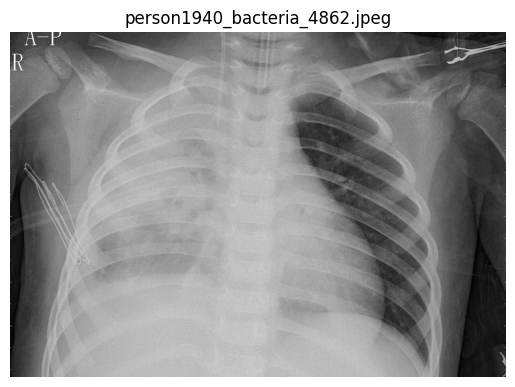

In [ ]:
# Define dataset path and image filename
dataset_path = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray"
image_filename = "person1940_bacteria_4862.jpeg"

# Search for the image in the dataset directory
image_path = None
for root, dirs, files in os.walk(dataset_path):
    if image_filename in files:
        image_path = os.path.join(root, image_filename)
        break  # Stop searching once found

# If image is found, display image and check dimensions
if image_path:
    with Image.open(image_path) as img:
        width, height = img.size
        print(f"Image: {image_filename}")
        print(f"Width: {width}, Height: {height}")

        # Display image using matplotlib
        plt.imshow(img, cmap='gray')
        plt.axis('off')  # Hide axes
        plt.title(image_filename)
        plt.show()

        # Alternatively, to open in default image viewer (optional)
        # img.show()
else:
    print(f"Image '{image_filename}' not found in dataset.")

## PREPROCESS


In [4]:
def val_split(train_data, pcnt):
    i = int(len(train_data) * pcnt)
    return train_data[:i], train_data[i:] # train, val

In [5]:
def train_test_val_images(all_images, n_train, test_set, val_ratio=0.9, seed= None):
    data = {}
    data['normal'] = {}
    data['pneumonia'] = {}

    rng = np.random.default_rng(seed)

    all_norm = rng.permutation(all_images['all_normal_images'])
    all_pnm  = rng.permutation(all_images['all_pneumonia_images'])

    train_val_norm = all_images['all_normal_images'][:n_train//2]
    data['trn_norm_x'], data['val_norm_x'] = val_split(train_val_norm, val_ratio)
    data['tst_norm_x'] = test_set['normal']

    train_val_pnm = all_images['all_pneumonia_images'][:n_train//2]
    data['trn_pnm_x'], data['val_pnm_x'] = val_split(train_val_pnm, val_ratio)
    data['tst_pnm_x'] = test_set['pneumonia']

    data['normal']['labels'] = {
        'train': np.array(['normal']*len(data['trn_norm_x'])),
        'test': np.array(['normal']*len(data['tst_norm_x'])),
        'val': np.array(['normal']*len(data['val_norm_x']))
    }
    data['pneumonia']['labels'] = {
        'train': np.array(['pneumonia']*len(data['trn_pnm_x'])),
        'test': np.array(['pneumonia']*len(data['tst_pnm_x'])),
        'val': np.array(['pneumonia']*len(data['val_pnm_x']))
    }

    return data

In [6]:
def get_imgs(files, im_size):
    print(files[0],'...')
    images = np.zeros((len(files), im_size, im_size, 3), dtype='float32')
    for i, img_file in enumerate(files):
        img = np.array(Image.open(img_file).resize((im_size, im_size)).convert("RGB"))
        images[i] = img
    return images

## EVALUATION

In [7]:
def save_results(results_file, results):
    all_results = {}
    with open(results_file, 'r') as file:
        try:
            all_results = json.load(file)
        except json.JSONDecodeError:
            all_results = {}
    all_results[str(datetime.datetime.now())] = results
    with open(results_file, 'w') as file:
        print("Saving results to ", results_file, str(datetime.datetime.now()))
        json.dump(all_results, file)
    return

In [8]:
def scores(y_pred, y_test):
    y_pred_labels = np.argmax(y_pred, axis=1)
    y_test_labels = np.argmax(y_test, axis=1)

    # Pneumonia (positive class) = 1, Normal (negative class) = 0
    TP = int(np.sum((y_pred_labels == 1) & (y_test_labels == 1)))
    TN = int(np.sum((y_pred_labels == 0) & (y_test_labels == 0)))
    FP = int(np.sum((y_pred_labels == 1) & (y_test_labels == 0)))
    FN = int(np.sum((y_pred_labels == 0) & (y_test_labels == 1)))

    print(f"TP: {TP}, TN: {TN}, FP: {FP}, FN: {FN}")

    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP) if TP + FP > 0 else 0
    recall = TP / (TP + FN) if TP + FN > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0

    result = {
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": recall,
        "F1 Score": f1_score,
        "TP": TP,
        "TN": TN,
        "FP": FP,
        "FN": FN
    }

    print(result)
    return result

In [9]:
def get_scores(model, n, generator, title, batch_size):
    print(f"Testing with {title}")
    labels = []
    for i in range(0, n // batch_size):
        labels.extend(generator[i][1])
    labels = np.array(labels)

    preds = np.array(model.predict(generator))

    print(f"labels shape: {labels.shape}, preds shape: {preds.shape}")

    return scores(preds[:len(labels)], labels)

## MODEL

In [10]:
def train_xray_model(data, n_gen, gen_label, results_file, gen_normal=None, gen_pnm=None):
    n_normal = len(data['trn_norm_x']) + len(data['val_norm_x'])
    n_pneumo = len(data['trn_pnm_x']) + len(data['val_pnm_x'])
    print(f"For training: {n_normal} normal images, {n_pneumo} pneumonia images")

    im_size = 160

    # Combine original and generated data for training
    trn_norm_x = data['trn_norm_x']
    if gen_normal is not None:
        trn_norm_x = np.append(trn_norm_x, gen_normal, axis=0)
        data['normal']['labels']['train'] = np.append(
            data['normal']['labels']['train'], [data['normal']['labels']['train'][0]] * len(gen_normal))

    trn_pnm_x = data['trn_pnm_x']
    if gen_pnm is not None:
        trn_pnm_x = np.append(trn_pnm_x, gen_pnm, axis=0)
        data['pneumonia']['labels']['train'] = np.append(
            data['pneumonia']['labels']['train'], [data['pneumonia']['labels']['train'][0]] * len(gen_pnm))

    # Prepare training, validation, and testing datasets
    tst_norm_x = data['tst_norm_x']
    tst_pnm_x = data['tst_pnm_x']
    val_norm_x = data['val_norm_x']
    val_pnm_x = data['val_pnm_x']

    x_train = np.append(trn_norm_x, trn_pnm_x, axis=0)
    y_train = np.append(data['normal']['labels']['train'], data['pneumonia']['labels']['train'])
    x_test = np.append(tst_norm_x, tst_pnm_x, axis=0)
    y_test = np.append(data['normal']['labels']['test'], data['pneumonia']['labels']['test'])
    x_val = np.append(val_norm_x, val_pnm_x, axis=0)
    y_val = np.append(data['normal']['labels']['val'], data['pneumonia']['labels']['val'])

    n_train = len(x_train)
    n_test = len(x_test)
    n_val = len(x_val)

    # One-hot encoding for labels
    encoder = OneHotEncoder(sparse_output=False)
    y_train_enc = encoder.fit_transform(y_train.reshape(-1, 1))
    y_test_enc = encoder.transform(y_test.reshape(-1, 1))
    y_val_enc = encoder.transform(y_val.reshape(-1, 1))

    print("\nLabel encoding check:")
    for i, label in enumerate(encoder.categories_[0]):
        one_hot_vector = np.zeros(len(encoder.categories_[0]))
        one_hot_vector[i] = 1
        print(f"Label {label} encoded as {one_hot_vector}")
    print()

    batch_size = min(16, n_train, n_test, n_val)

    # Data augmentation
    train_datagen = ImageDataGenerator(
        rescale=1.0 / 255,
        samplewise_center=True,
        samplewise_std_normalization=True,
        zoom_range=0.2,
        width_shift_range=0.1,
        height_shift_range=0.1)

    val_datagen = ImageDataGenerator(rescale=1.0 / 255, samplewise_center=True, samplewise_std_normalization=True)
    test_datagen = ImageDataGenerator(rescale=1.0 / 255, samplewise_center=True, samplewise_std_normalization=True)

    train_generator = train_datagen.flow(x_train, y_train_enc, batch_size=batch_size)
    val_generator = val_datagen.flow(x_val, y_val_enc, batch_size=batch_size)
    test_generator = test_datagen.flow(x_test, y_test_enc, batch_size=batch_size)

    #####################################################################################################################
    # MODEL #############################################################################################################
    #####################################################################################################################

    epochs = 20
    learning_rate = 1e-3

    start_time = time.time()

    model = tf.keras.Sequential(name='X-ray_CNN')

    model.add(tf.keras.layers.InputLayer(input_shape=(160,160,3)))

    model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=(3, 3)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Activation('relu'))
    model.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

    model.add(tf.keras.layers.Conv2D(filters=64, kernel_size=(3, 3)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Activation('relu'))
    model.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

    model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3, 3)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Activation('relu'))
    model.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

    model.add(tf.keras.layers.Conv2D(filters=128, kernel_size=(3, 3)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Activation('relu'))
    model.add(tf.keras.layers.MaxPool2D(pool_size=(2, 2)))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(units=512, activation='relu'))
    model.add(tf.keras.layers.Dense(units=2, activation='sigmoid'))


    METRICS = ['accuracy', tf.keras.metrics.Precision(name='precision'), tf.keras.metrics.Recall(name='recall')]

    lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
        initial_learning_rate=1e-2,
        decay_steps=10000,
        decay_rate=0.9)

    model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=lr_schedule),
                loss=tf.keras.losses.BinaryCrossentropy(),
                metrics=METRICS)

    hist = model.fit(train_generator,
                      steps_per_epoch=n_train // batch_size,
                      epochs=epochs,
                      validation_data=val_generator,
                      validation_steps=n_val // batch_size)

    print(model.summary())

    end_time = time.time()
    seconds = end_time - start_time
    print(f"Training time: {seconds / 60} m {seconds % 60} s")

    #####################################################################################################################
    # EVALUATION ########################################################################################################
    #####################################################################################################################

    test_scores = get_scores(model, n_test, test_generator, 'Test set', batch_size)
    train_scores = get_scores(model, n_train, train_generator, 'Training set', batch_size)
    val_scores = get_scores(model, n_val, val_generator, 'Validation set', batch_size)

    save_results(results_file, {
        'n_train': n_train,
        'n_test': n_test,
        'n_val': n_val,
        'n_normal': n_normal,
        'n_pneumo': n_pneumo,
        'train_scores': train_scores,
        'test_scores': test_scores,
        'val_scores': val_scores,
        'gen_label': gen_label,
        'n_generated': n_gen,
        'history': {
            'loss': [float(x) for x in hist.history.get('loss', [])],
            'val_loss': [float(x) for x in hist.history.get('val_loss', [])],
            'accuracy': [float(x) for x in hist.history.get('accuracy', [])],
            'val_accuracy': [float(x) for x in hist.history.get('val_accuracy', [])]
        }
    })

    print(f"Test accuracy: {test_scores['Accuracy']}")


## DCGAN

In [11]:
def make_generator_model(img_height, img_width, img_channels):
    model = tf.keras.Sequential()

    model.add(layers.Dense(10*10*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((10, 10, 256)))
    assert model.output_shape == (None, 10, 10, 256)

    # Upsampling blocks
    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 10, 10, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(32, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 20, 20, 32)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(16, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 40, 40, 16)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(8, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 80, 80, 8)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Final layer with tanh activation
    model.add(layers.Conv2DTranspose(img_channels, (5, 5), strides=(2, 2), padding='same',
                                     use_bias=False, activation='tanh'))

    assert model.output_shape == (None, img_height, img_width, img_channels)

    return model

In [12]:
def make_discriminator_model(img_height, img_width, img_channels):
    model = tf.keras.Sequential()

    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                            input_shape=(img_height, img_width, img_channels)))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

In [13]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [14]:
def dcgan(train_images, n_out, label):
    base_dir = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray"
    label_dir = os.path.join(base_dir, label)  # For specific label subdirectory (e.g., "NORMAL/" or "PNEUMONIA/")

    # Optimized image dimensions
    img_height, img_width, img_channels = 160, 160, 3

    print(f"DCGAN {len(train_images)} training images")

    train_images = (train_images - 127.5) / 127.5  # Normalize the images to [-1, 1]

    BUFFER_SIZE = len(train_images)
    BATCH_SIZE = 32  # Optimized batch size

    # Batch and shuffle the data
    train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

    generator = make_generator_model(img_height, img_width, img_channels)
    print("DCGAN made generator")

    noise = tf.random.normal([1, 100])
    generated_image = generator(noise, training=False)

    discriminator = make_discriminator_model(img_height, img_width, img_channels)
    print("DCGAN made discriminator")
    decision = discriminator(generated_image)

    generator_optimizer = tf.keras.optimizers.Adam(1e-4)
    discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

    checkpoint_dir = os.path.join(base_dir, 'models')
    checkpoint_prefix = os.path.join(checkpoint_dir, "dcgan")
    checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                     discriminator_optimizer=discriminator_optimizer,
                                     generator=generator,
                                     discriminator=discriminator)

    EPOCHS = 1001  # Optimized number of epochs
    noise_dim = 100
    num_examples_to_generate = 16

    # Reuse this seed for generating images
    seed = tf.random.normal([num_examples_to_generate, noise_dim])

    @tf.function
    def train_step(images):
        noise = tf.random.normal([BATCH_SIZE, noise_dim])

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            generated_images = generator(noise, training=True)

            real_output = discriminator(images, training=True)
            fake_output = discriminator(generated_images, training=True)

            gen_loss = generator_loss(fake_output)
            disc_loss = discriminator_loss(real_output, fake_output)

        gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

        generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    def generate_and_save_images(model, epoch, test_input):
        output_dir = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/genimages"
        os.makedirs(output_dir, exist_ok=True)
        predictions = model(test_input, training=False)

        num_images = predictions.shape[0]  # Total images
        grid_size = min(16, num_images)

        fig = plt.figure(figsize=(6, 6))

        for i in range(grid_size):
            plt.subplot(4, 4, i + 1)
            plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
            plt.axis('off')

        plt.savefig(f'{output_dir}\{label}_image_at_epoch_{str(int(epoch))}.png')
        plt.show()

    def train(dataset, epochs):
        start = time.time()

        for epoch in range(epochs):
            print(f"Epoch {epoch}")
            for image_batch in dataset:
                train_step(image_batch)

            if epoch % 100 == 0:
                print(f"(Epoch {epoch})")
                generate_and_save_images(generator, epoch, seed)

        total_time = time.time() - start
        print(f'Time for {epochs} epochs is {total_time // 60} min {total_time % 60} sec')

    train(train_dataset, EPOCHS)

    checkpoint.save(file_prefix=checkpoint_prefix)

    # Generate and return images
    seed = tf.random.normal([n_out, noise_dim])
    generate_and_save_images(generator, EPOCHS, seed)
    return generator(seed, training=False)

<>:79: SyntaxWarning: invalid escape sequence '\{'
<>:79: SyntaxWarning: invalid escape sequence '\{'
/tmp/ipython-input-2728614551.py:79: SyntaxWarning: invalid escape sequence '\{'
  plt.savefig(f'{output_dir}\{label}_image_at_epoch_{str(int(epoch))}.png')


## EXPERIMENT


In [15]:
def experiment(n_train, test_set, n_gen, all_images, results_file,
               gen_normal_images=None, gen_pnm_images=None, seed=None):
  if seed is not None:
    rng = np.random.default_rng(seed)
  else:
    rng = np.random.default_rng()

  data = train_test_val_images(all_images, n_train, test_set, seed=seed)

  n_total_train_images = len(data['trn_norm_x']) + len(data['trn_pnm_x']) + len(data['val_norm_x']) + len(data['val_pnm_x'])
  if not (n_train == n_total_train_images):
    print(f"!!! Specified n_train {n_train} doesn't match actual {n_total_train_images}")

  if n_gen == 0:
    print(f"Running baseline experiment with {n_train} real images")
    train_xray_model(
        data, n_gen,
        gen_label=f"No gen, just {n_train} train images",
        results_file=results_file
        )
  else:
    # Sample from pre-generated images
    if gen_normal_images is None or gen_pnm_images is None:
      raise ValueError("Synthetic images not provided.")

    ##replace=False
    idx_norm = rng.choice(gen_normal_images.shape[0], n_gen // 2, replace=False)
    idx_pnm = rng.choice(gen_pnm_images.shape[0], n_gen // 2, replace=False)

    generator_norm = gen_normal_images[idx_norm]
    generator_pnm = gen_pnm_images[idx_pnm]

    print(f"Using {len(generator_norm)} synthetic normal and {len(generator_pnm)} synthetic pneumonia images")

    train_xray_model(
        data, n_gen,
        gen_label=f"{n_train} train images + {n_gen} dcgan images",
        results_file=results_file,
        gen_normal=generator_norm,
        gen_pnm=generator_pnm
        )

In [16]:
base_dir = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/"
save_dir = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/prepared_data"
os.makedirs(save_dir, exist_ok=True)

results_file = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json"

# Image processing constants
im_size = 160
# Split off constant test set
n_test = 500

test_norm_path = os.path.join(save_dir, "test_normal.npy")
test_pnm_path  = os.path.join(save_dir, "test_pneumonia.npy")
train_norm_path = os.path.join(save_dir, "train_norm_remaining.npy")
train_pnm_path  = os.path.join(save_dir, "train_pnm_remaining.npy")

if not (os.path.exists(test_norm_path) and os.path.exists(test_pnm_path)):
  print("Preparing data for the FIRST time...")

  # Load and shuffle image file paths
  all_norm_files = np.array([base_dir + 'NORMAL/' + file for file in os.listdir(base_dir + 'NORMAL/')])
  all_pnm_files = np.array([base_dir + 'PNEUMONIA/' + file for file in os.listdir(base_dir + 'PNEUMONIA/')])[:len(all_norm_files)]
  np.random.shuffle(all_norm_files)
  np.random.shuffle(all_pnm_files)

  # Load images
  all_norm_imgs = get_imgs(all_norm_files, im_size)
  all_pnm_imgs  = get_imgs(all_pnm_files, im_size)

  # Create fixed test set
  test_set = {
      'normal': all_norm_imgs[:n_test // 2],
      'pneumonia': all_pnm_imgs[:n_test // 2]
      }


    # Remaining training pool
  all_images = {
      'all_normal_images': all_norm_imgs[n_test // 2:],
      'all_pneumonia_images': all_pnm_imgs[n_test // 2:]
      }

  # Save to disk
  np.save(test_norm_path, test_set['normal'])
  np.save(test_pnm_path, test_set['pneumonia'])
  np.save(train_norm_path, all_images['all_normal_images'])
  np.save(train_pnm_path, all_images['all_pneumonia_images'])

  print("✅ Saved fixed test set and training pool.")
else:
  print("Reloading previously prepared data...")

  test_set = {
      'normal': np.load(test_norm_path),
      'pneumonia': np.load(test_pnm_path)
      }

  all_images = {
      'all_normal_images': np.load(train_norm_path),
      'all_pneumonia_images': np.load(train_pnm_path)
      }

print('Remaining normal images:', all_images['all_normal_images'].shape)
print('Remaining pneumonia images:', all_images['all_pneumonia_images'].shape)
print('Test normal images:', test_set['normal'].shape)
print('Test pneumonia images:', test_set['pneumonia'].shape)

Reloading previously prepared data...
Remaining normal images: (1091, 160, 160, 3)
Remaining pneumonia images: (1091, 160, 160, 3)
Test normal images: (250, 160, 160, 3)
Test pneumonia images: (250, 160, 160, 3)


Training DCGAN for 'normal' class...
DCGAN 1091 training images
DCGAN made generator
DCGAN made discriminator
Epoch 0
(Epoch 0)


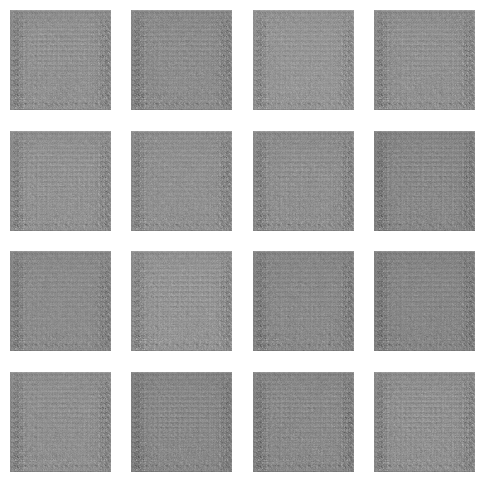

Epoch 1
Epoch 2
Epoch 3
Epoch 4
Epoch 5
Epoch 6
Epoch 7
Epoch 8
Epoch 9
Epoch 10
Epoch 11
Epoch 12
Epoch 13
Epoch 14
Epoch 15
Epoch 16
Epoch 17
Epoch 18
Epoch 19
Epoch 20
Epoch 21
Epoch 22
Epoch 23
Epoch 24
Epoch 25
Epoch 26
Epoch 27
Epoch 28
Epoch 29
Epoch 30
Epoch 31
Epoch 32
Epoch 33
Epoch 34
Epoch 35
Epoch 36
Epoch 37
Epoch 38
Epoch 39
Epoch 40
Epoch 41
Epoch 42
Epoch 43
Epoch 44
Epoch 45
Epoch 46
Epoch 47
Epoch 48
Epoch 49
Epoch 50
Epoch 51
Epoch 52
Epoch 53
Epoch 54
Epoch 55
Epoch 56
Epoch 57
Epoch 58
Epoch 59
Epoch 60
Epoch 61
Epoch 62
Epoch 63
Epoch 64
Epoch 65
Epoch 66
Epoch 67
Epoch 68
Epoch 69
Epoch 70
Epoch 71
Epoch 72
Epoch 73
Epoch 74
Epoch 75
Epoch 76
Epoch 77
Epoch 78
Epoch 79
Epoch 80
Epoch 81
Epoch 82
Epoch 83
Epoch 84
Epoch 85
Epoch 86
Epoch 87
Epoch 88
Epoch 89
Epoch 90
Epoch 91
Epoch 92
Epoch 93
Epoch 94
Epoch 95
Epoch 96
Epoch 97
Epoch 98
Epoch 99
Epoch 100
(Epoch 100)


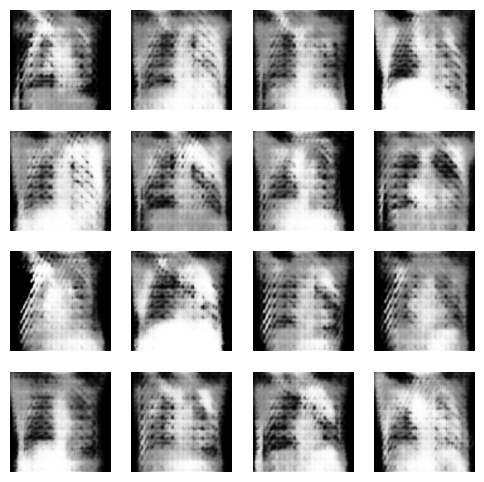

Epoch 101
Epoch 102
Epoch 103
Epoch 104
Epoch 105
Epoch 106
Epoch 107
Epoch 108
Epoch 109
Epoch 110
Epoch 111
Epoch 112
Epoch 113
Epoch 114
Epoch 115
Epoch 116
Epoch 117
Epoch 118
Epoch 119
Epoch 120
Epoch 121
Epoch 122
Epoch 123
Epoch 124
Epoch 125
Epoch 126
Epoch 127
Epoch 128
Epoch 129
Epoch 130
Epoch 131
Epoch 132
Epoch 133
Epoch 134
Epoch 135
Epoch 136
Epoch 137
Epoch 138
Epoch 139
Epoch 140
Epoch 141
Epoch 142
Epoch 143
Epoch 144
Epoch 145
Epoch 146
Epoch 147
Epoch 148
Epoch 149
Epoch 150
Epoch 151
Epoch 152
Epoch 153
Epoch 154
Epoch 155
Epoch 156
Epoch 157
Epoch 158
Epoch 159
Epoch 160
Epoch 161
Epoch 162
Epoch 163
Epoch 164
Epoch 165
Epoch 166
Epoch 167
Epoch 168
Epoch 169
Epoch 170
Epoch 171
Epoch 172
Epoch 173
Epoch 174
Epoch 175
Epoch 176
Epoch 177
Epoch 178
Epoch 179
Epoch 180
Epoch 181
Epoch 182
Epoch 183
Epoch 184
Epoch 185
Epoch 186
Epoch 187
Epoch 188
Epoch 189
Epoch 190
Epoch 191
Epoch 192
Epoch 193
Epoch 194
Epoch 195
Epoch 196
Epoch 197
Epoch 198
Epoch 199
Epoch 200


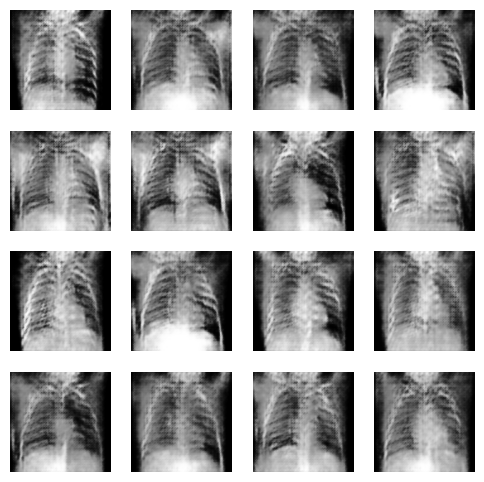

Epoch 201
Epoch 202
Epoch 203
Epoch 204
Epoch 205
Epoch 206
Epoch 207
Epoch 208
Epoch 209
Epoch 210
Epoch 211
Epoch 212
Epoch 213
Epoch 214
Epoch 215
Epoch 216
Epoch 217
Epoch 218
Epoch 219
Epoch 220
Epoch 221
Epoch 222
Epoch 223
Epoch 224
Epoch 225
Epoch 226
Epoch 227
Epoch 228
Epoch 229
Epoch 230
Epoch 231
Epoch 232
Epoch 233
Epoch 234
Epoch 235
Epoch 236
Epoch 237
Epoch 238
Epoch 239
Epoch 240
Epoch 241
Epoch 242
Epoch 243
Epoch 244
Epoch 245
Epoch 246
Epoch 247
Epoch 248
Epoch 249
Epoch 250
Epoch 251
Epoch 252
Epoch 253
Epoch 254
Epoch 255
Epoch 256
Epoch 257
Epoch 258
Epoch 259
Epoch 260
Epoch 261
Epoch 262
Epoch 263
Epoch 264
Epoch 265
Epoch 266
Epoch 267
Epoch 268
Epoch 269
Epoch 270
Epoch 271
Epoch 272
Epoch 273
Epoch 274
Epoch 275
Epoch 276
Epoch 277
Epoch 278
Epoch 279
Epoch 280
Epoch 281
Epoch 282
Epoch 283
Epoch 284
Epoch 285
Epoch 286
Epoch 287
Epoch 288
Epoch 289
Epoch 290
Epoch 291
Epoch 292
Epoch 293
Epoch 294
Epoch 295
Epoch 296
Epoch 297
Epoch 298
Epoch 299
Epoch 300


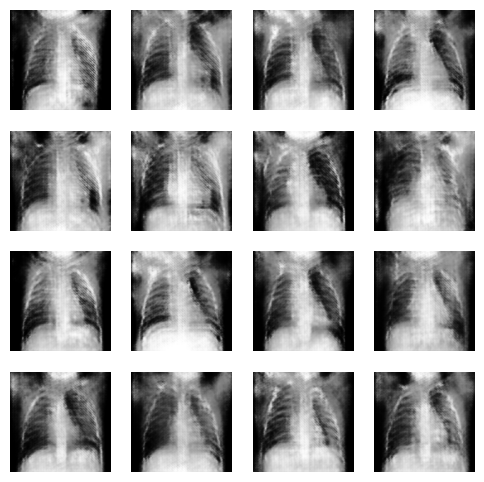

Epoch 301
Epoch 302
Epoch 303
Epoch 304
Epoch 305
Epoch 306
Epoch 307
Epoch 308
Epoch 309
Epoch 310
Epoch 311
Epoch 312
Epoch 313
Epoch 314
Epoch 315
Epoch 316
Epoch 317
Epoch 318
Epoch 319
Epoch 320
Epoch 321
Epoch 322
Epoch 323
Epoch 324
Epoch 325
Epoch 326
Epoch 327
Epoch 328
Epoch 329
Epoch 330
Epoch 331
Epoch 332
Epoch 333
Epoch 334
Epoch 335
Epoch 336
Epoch 337
Epoch 338
Epoch 339
Epoch 340
Epoch 341
Epoch 342
Epoch 343
Epoch 344
Epoch 345
Epoch 346
Epoch 347
Epoch 348
Epoch 349
Epoch 350
Epoch 351
Epoch 352
Epoch 353
Epoch 354
Epoch 355
Epoch 356
Epoch 357
Epoch 358
Epoch 359
Epoch 360
Epoch 361
Epoch 362
Epoch 363
Epoch 364
Epoch 365
Epoch 366
Epoch 367
Epoch 368
Epoch 369
Epoch 370
Epoch 371
Epoch 372
Epoch 373
Epoch 374
Epoch 375
Epoch 376
Epoch 377
Epoch 378
Epoch 379
Epoch 380
Epoch 381
Epoch 382
Epoch 383
Epoch 384
Epoch 385
Epoch 386
Epoch 387
Epoch 388
Epoch 389
Epoch 390
Epoch 391
Epoch 392
Epoch 393
Epoch 394
Epoch 395
Epoch 396
Epoch 397
Epoch 398
Epoch 399
Epoch 400


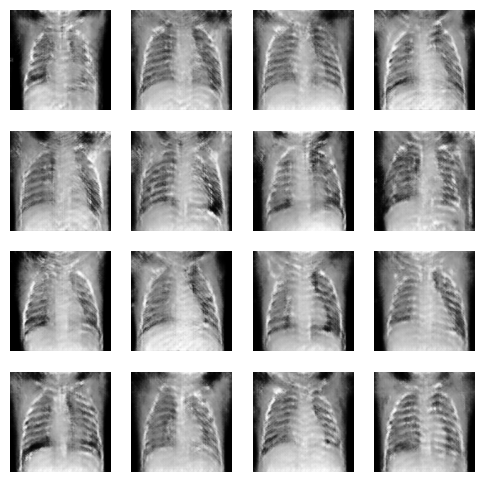

Epoch 401
Epoch 402
Epoch 403
Epoch 404
Epoch 405
Epoch 406
Epoch 407
Epoch 408
Epoch 409
Epoch 410
Epoch 411
Epoch 412
Epoch 413
Epoch 414
Epoch 415
Epoch 416
Epoch 417
Epoch 418
Epoch 419
Epoch 420
Epoch 421
Epoch 422
Epoch 423
Epoch 424
Epoch 425
Epoch 426
Epoch 427
Epoch 428
Epoch 429
Epoch 430
Epoch 431
Epoch 432
Epoch 433
Epoch 434
Epoch 435
Epoch 436
Epoch 437
Epoch 438
Epoch 439
Epoch 440
Epoch 441
Epoch 442
Epoch 443
Epoch 444
Epoch 445
Epoch 446
Epoch 447
Epoch 448
Epoch 449
Epoch 450
Epoch 451
Epoch 452
Epoch 453
Epoch 454
Epoch 455
Epoch 456
Epoch 457
Epoch 458
Epoch 459
Epoch 460
Epoch 461
Epoch 462
Epoch 463
Epoch 464
Epoch 465
Epoch 466
Epoch 467
Epoch 468
Epoch 469
Epoch 470
Epoch 471
Epoch 472
Epoch 473
Epoch 474
Epoch 475
Epoch 476
Epoch 477
Epoch 478
Epoch 479
Epoch 480
Epoch 481
Epoch 482
Epoch 483
Epoch 484
Epoch 485
Epoch 486
Epoch 487
Epoch 488
Epoch 489
Epoch 490
Epoch 491
Epoch 492
Epoch 493
Epoch 494
Epoch 495
Epoch 496
Epoch 497
Epoch 498
Epoch 499
Epoch 500


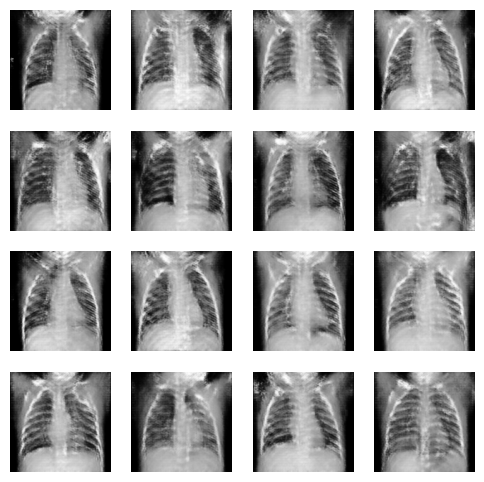

Epoch 501
Epoch 502
Epoch 503
Epoch 504
Epoch 505
Epoch 506
Epoch 507
Epoch 508
Epoch 509
Epoch 510
Epoch 511
Epoch 512
Epoch 513
Epoch 514
Epoch 515
Epoch 516
Epoch 517
Epoch 518
Epoch 519
Epoch 520
Epoch 521
Epoch 522
Epoch 523
Epoch 524
Epoch 525
Epoch 526
Epoch 527
Epoch 528
Epoch 529
Epoch 530
Epoch 531
Epoch 532
Epoch 533
Epoch 534
Epoch 535
Epoch 536
Epoch 537
Epoch 538
Epoch 539
Epoch 540
Epoch 541
Epoch 542
Epoch 543
Epoch 544
Epoch 545
Epoch 546
Epoch 547
Epoch 548
Epoch 549
Epoch 550
Epoch 551
Epoch 552
Epoch 553
Epoch 554
Epoch 555
Epoch 556
Epoch 557
Epoch 558
Epoch 559
Epoch 560
Epoch 561
Epoch 562
Epoch 563
Epoch 564
Epoch 565
Epoch 566
Epoch 567
Epoch 568
Epoch 569
Epoch 570
Epoch 571
Epoch 572
Epoch 573
Epoch 574
Epoch 575
Epoch 576
Epoch 577
Epoch 578
Epoch 579
Epoch 580
Epoch 581
Epoch 582
Epoch 583
Epoch 584
Epoch 585
Epoch 586
Epoch 587
Epoch 588
Epoch 589
Epoch 590
Epoch 591
Epoch 592
Epoch 593
Epoch 594
Epoch 595
Epoch 596
Epoch 597
Epoch 598
Epoch 599
Epoch 600


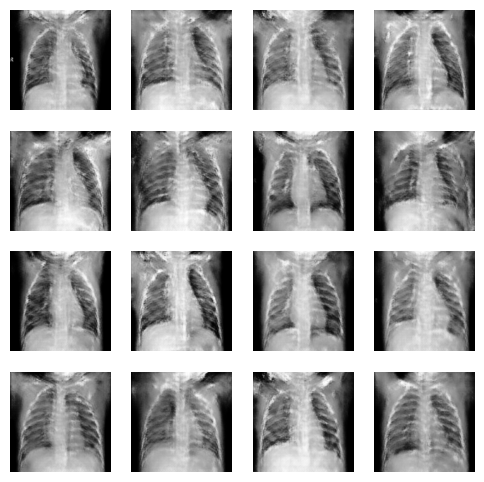

Epoch 601
Epoch 602
Epoch 603
Epoch 604
Epoch 605
Epoch 606
Epoch 607
Epoch 608
Epoch 609
Epoch 610
Epoch 611
Epoch 612
Epoch 613
Epoch 614
Epoch 615
Epoch 616
Epoch 617
Epoch 618
Epoch 619
Epoch 620
Epoch 621
Epoch 622
Epoch 623
Epoch 624
Epoch 625
Epoch 626
Epoch 627
Epoch 628
Epoch 629
Epoch 630
Epoch 631
Epoch 632
Epoch 633
Epoch 634
Epoch 635
Epoch 636
Epoch 637
Epoch 638
Epoch 639
Epoch 640
Epoch 641
Epoch 642
Epoch 643
Epoch 644
Epoch 645
Epoch 646
Epoch 647
Epoch 648
Epoch 649
Epoch 650
Epoch 651
Epoch 652
Epoch 653
Epoch 654
Epoch 655
Epoch 656
Epoch 657
Epoch 658
Epoch 659
Epoch 660
Epoch 661
Epoch 662
Epoch 663
Epoch 664
Epoch 665
Epoch 666
Epoch 667
Epoch 668
Epoch 669
Epoch 670
Epoch 671
Epoch 672
Epoch 673
Epoch 674
Epoch 675
Epoch 676
Epoch 677
Epoch 678
Epoch 679
Epoch 680
Epoch 681
Epoch 682
Epoch 683
Epoch 684
Epoch 685
Epoch 686
Epoch 687
Epoch 688
Epoch 689
Epoch 690
Epoch 691
Epoch 692
Epoch 693
Epoch 694
Epoch 695
Epoch 696
Epoch 697
Epoch 698
Epoch 699
Epoch 700


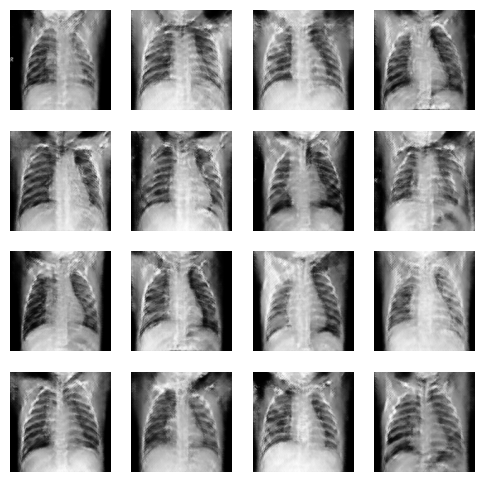

Epoch 701
Epoch 702
Epoch 703
Epoch 704
Epoch 705
Epoch 706
Epoch 707
Epoch 708
Epoch 709
Epoch 710
Epoch 711
Epoch 712
Epoch 713
Epoch 714
Epoch 715
Epoch 716
Epoch 717
Epoch 718
Epoch 719
Epoch 720
Epoch 721
Epoch 722
Epoch 723
Epoch 724
Epoch 725
Epoch 726
Epoch 727
Epoch 728
Epoch 729
Epoch 730
Epoch 731
Epoch 732
Epoch 733
Epoch 734
Epoch 735
Epoch 736
Epoch 737
Epoch 738
Epoch 739
Epoch 740
Epoch 741
Epoch 742
Epoch 743
Epoch 744
Epoch 745
Epoch 746
Epoch 747
Epoch 748
Epoch 749
Epoch 750
Epoch 751
Epoch 752
Epoch 753
Epoch 754
Epoch 755
Epoch 756
Epoch 757
Epoch 758
Epoch 759
Epoch 760
Epoch 761
Epoch 762
Epoch 763
Epoch 764
Epoch 765
Epoch 766
Epoch 767
Epoch 768
Epoch 769
Epoch 770
Epoch 771
Epoch 772
Epoch 773
Epoch 774
Epoch 775
Epoch 776
Epoch 777
Epoch 778
Epoch 779
Epoch 780
Epoch 781
Epoch 782
Epoch 783
Epoch 784
Epoch 785
Epoch 786
Epoch 787
Epoch 788
Epoch 789
Epoch 790
Epoch 791
Epoch 792
Epoch 793
Epoch 794
Epoch 795
Epoch 796
Epoch 797
Epoch 798
Epoch 799
Epoch 800


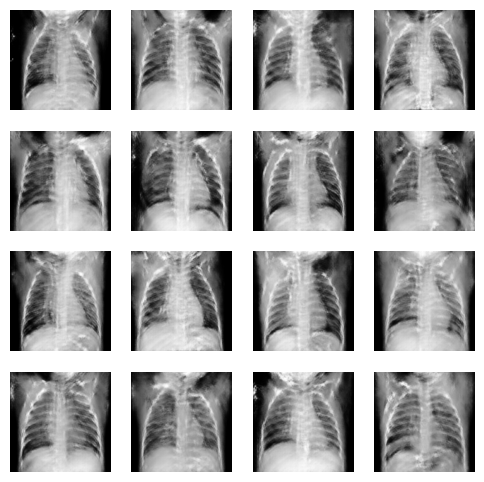

Epoch 801
Epoch 802
Epoch 803
Epoch 804
Epoch 805
Epoch 806
Epoch 807
Epoch 808
Epoch 809
Epoch 810
Epoch 811
Epoch 812
Epoch 813
Epoch 814
Epoch 815
Epoch 816
Epoch 817
Epoch 818
Epoch 819
Epoch 820
Epoch 821
Epoch 822
Epoch 823
Epoch 824
Epoch 825
Epoch 826
Epoch 827
Epoch 828
Epoch 829
Epoch 830
Epoch 831
Epoch 832
Epoch 833
Epoch 834
Epoch 835
Epoch 836
Epoch 837
Epoch 838
Epoch 839
Epoch 840
Epoch 841
Epoch 842
Epoch 843
Epoch 844
Epoch 845
Epoch 846
Epoch 847
Epoch 848
Epoch 849
Epoch 850
Epoch 851
Epoch 852
Epoch 853
Epoch 854
Epoch 855
Epoch 856
Epoch 857
Epoch 858
Epoch 859
Epoch 860
Epoch 861
Epoch 862
Epoch 863
Epoch 864
Epoch 865
Epoch 866
Epoch 867
Epoch 868
Epoch 869
Epoch 870
Epoch 871
Epoch 872
Epoch 873
Epoch 874
Epoch 875
Epoch 876
Epoch 877
Epoch 878
Epoch 879
Epoch 880
Epoch 881
Epoch 882
Epoch 883
Epoch 884
Epoch 885
Epoch 886
Epoch 887
Epoch 888
Epoch 889
Epoch 890
Epoch 891
Epoch 892
Epoch 893
Epoch 894
Epoch 895
Epoch 896
Epoch 897
Epoch 898
Epoch 899
Epoch 900


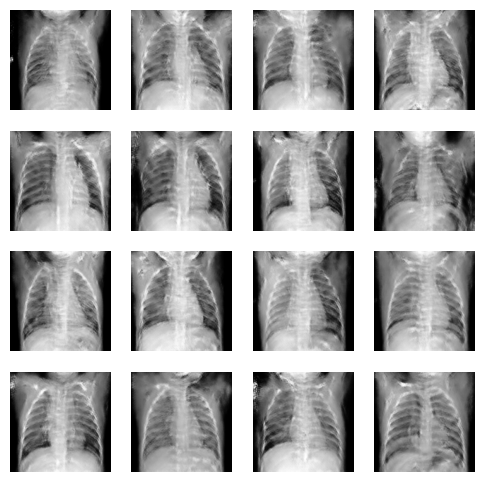

Epoch 901
Epoch 902
Epoch 903
Epoch 904
Epoch 905
Epoch 906
Epoch 907
Epoch 908
Epoch 909
Epoch 910
Epoch 911
Epoch 912
Epoch 913
Epoch 914
Epoch 915
Epoch 916
Epoch 917
Epoch 918
Epoch 919
Epoch 920
Epoch 921
Epoch 922
Epoch 923
Epoch 924
Epoch 925
Epoch 926
Epoch 927
Epoch 928
Epoch 929
Epoch 930
Epoch 931
Epoch 932
Epoch 933
Epoch 934
Epoch 935
Epoch 936
Epoch 937
Epoch 938
Epoch 939
Epoch 940
Epoch 941
Epoch 942
Epoch 943
Epoch 944
Epoch 945
Epoch 946
Epoch 947
Epoch 948
Epoch 949
Epoch 950
Epoch 951
Epoch 952
Epoch 953
Epoch 954
Epoch 955
Epoch 956
Epoch 957
Epoch 958
Epoch 959
Epoch 960
Epoch 961
Epoch 962
Epoch 963
Epoch 964
Epoch 965
Epoch 966
Epoch 967
Epoch 968
Epoch 969
Epoch 970
Epoch 971
Epoch 972
Epoch 973
Epoch 974
Epoch 975
Epoch 976
Epoch 977
Epoch 978
Epoch 979
Epoch 980
Epoch 981
Epoch 982
Epoch 983
Epoch 984
Epoch 985
Epoch 986
Epoch 987
Epoch 988
Epoch 989
Epoch 990
Epoch 991
Epoch 992
Epoch 993
Epoch 994
Epoch 995
Epoch 996
Epoch 997
Epoch 998
Epoch 999
Epoch 1000

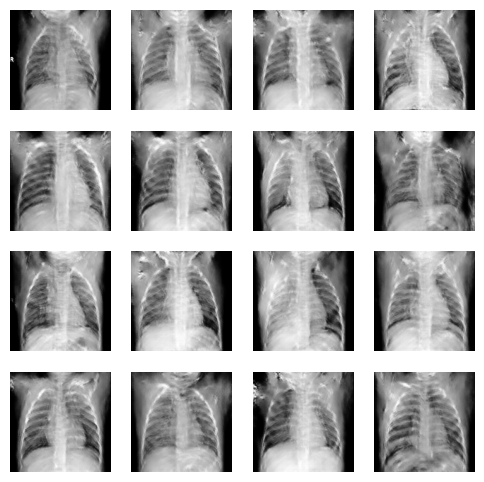

Time for 1001 epochs is 150.0 min 57.41603064537048 sec


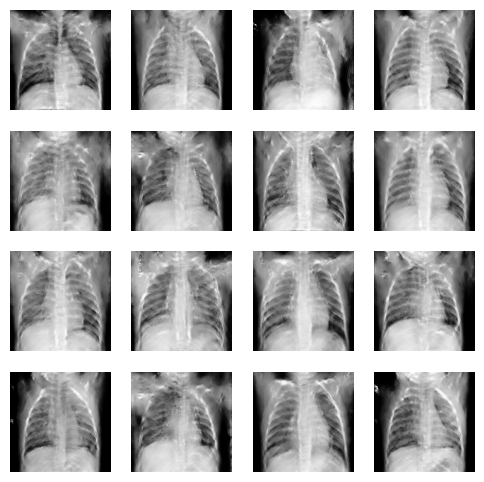

Training DCGAN for 'pneumonia' class...
DCGAN 1091 training images
DCGAN made generator
DCGAN made discriminator
Epoch 0
(Epoch 0)


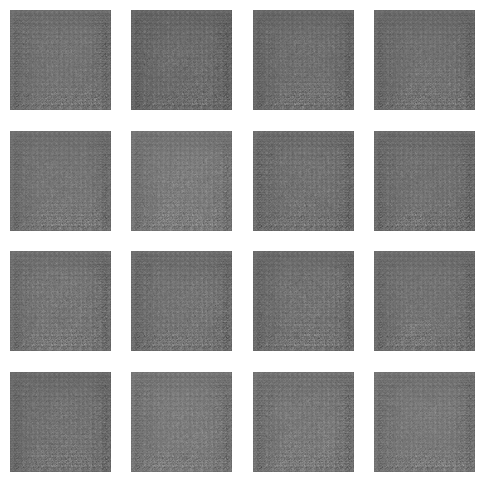

Epoch 1
Epoch 2
Epoch 3
Epoch 4
Epoch 5
Epoch 6
Epoch 7
Epoch 8
Epoch 9
Epoch 10
Epoch 11
Epoch 12
Epoch 13
Epoch 14
Epoch 15
Epoch 16
Epoch 17
Epoch 18
Epoch 19
Epoch 20
Epoch 21
Epoch 22
Epoch 23
Epoch 24
Epoch 25
Epoch 26
Epoch 27
Epoch 28
Epoch 29
Epoch 30
Epoch 31
Epoch 32
Epoch 33
Epoch 34
Epoch 35
Epoch 36
Epoch 37
Epoch 38
Epoch 39
Epoch 40
Epoch 41
Epoch 42
Epoch 43
Epoch 44
Epoch 45
Epoch 46
Epoch 47
Epoch 48
Epoch 49
Epoch 50
Epoch 51
Epoch 52
Epoch 53
Epoch 54
Epoch 55
Epoch 56
Epoch 57
Epoch 58
Epoch 59
Epoch 60
Epoch 61
Epoch 62
Epoch 63
Epoch 64
Epoch 65
Epoch 66
Epoch 67
Epoch 68
Epoch 69
Epoch 70
Epoch 71
Epoch 72
Epoch 73
Epoch 74
Epoch 75
Epoch 76
Epoch 77
Epoch 78
Epoch 79
Epoch 80
Epoch 81
Epoch 82
Epoch 83
Epoch 84
Epoch 85
Epoch 86
Epoch 87
Epoch 88
Epoch 89
Epoch 90
Epoch 91
Epoch 92
Epoch 93
Epoch 94
Epoch 95
Epoch 96
Epoch 97
Epoch 98
Epoch 99
Epoch 100
(Epoch 100)


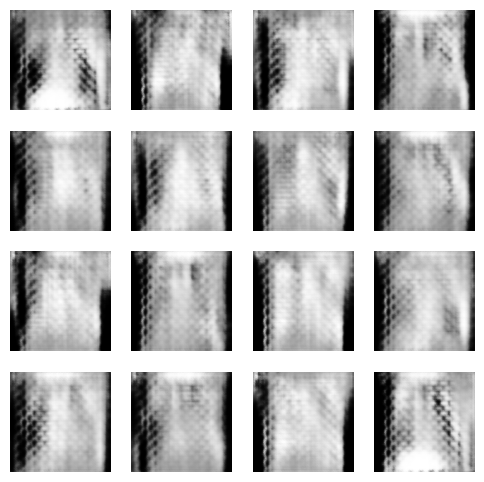

Epoch 101
Epoch 102
Epoch 103
Epoch 104
Epoch 105
Epoch 106
Epoch 107
Epoch 108
Epoch 109
Epoch 110
Epoch 111
Epoch 112
Epoch 113
Epoch 114
Epoch 115
Epoch 116
Epoch 117
Epoch 118
Epoch 119
Epoch 120
Epoch 121
Epoch 122
Epoch 123
Epoch 124
Epoch 125
Epoch 126
Epoch 127
Epoch 128
Epoch 129
Epoch 130
Epoch 131
Epoch 132
Epoch 133
Epoch 134
Epoch 135
Epoch 136
Epoch 137
Epoch 138
Epoch 139
Epoch 140
Epoch 141
Epoch 142
Epoch 143
Epoch 144
Epoch 145
Epoch 146
Epoch 147
Epoch 148
Epoch 149
Epoch 150
Epoch 151
Epoch 152
Epoch 153
Epoch 154
Epoch 155
Epoch 156
Epoch 157
Epoch 158
Epoch 159
Epoch 160
Epoch 161
Epoch 162
Epoch 163
Epoch 164
Epoch 165
Epoch 166
Epoch 167
Epoch 168
Epoch 169
Epoch 170
Epoch 171
Epoch 172
Epoch 173
Epoch 174
Epoch 175
Epoch 176
Epoch 177
Epoch 178
Epoch 179
Epoch 180
Epoch 181
Epoch 182
Epoch 183
Epoch 184
Epoch 185
Epoch 186
Epoch 187
Epoch 188
Epoch 189
Epoch 190
Epoch 191
Epoch 192
Epoch 193
Epoch 194
Epoch 195
Epoch 196
Epoch 197
Epoch 198
Epoch 199
Epoch 200


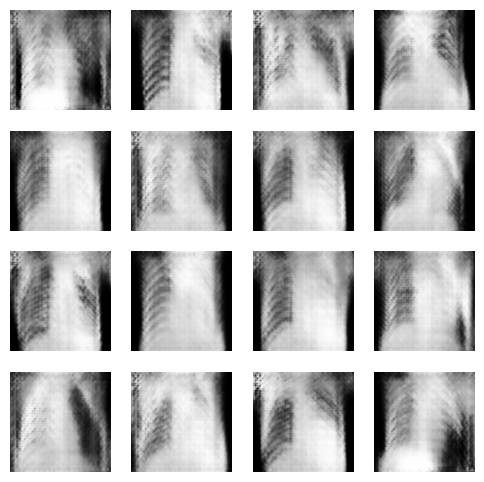

Epoch 201
Epoch 202
Epoch 203
Epoch 204
Epoch 205
Epoch 206
Epoch 207
Epoch 208
Epoch 209
Epoch 210
Epoch 211
Epoch 212
Epoch 213
Epoch 214
Epoch 215
Epoch 216
Epoch 217
Epoch 218
Epoch 219
Epoch 220
Epoch 221
Epoch 222
Epoch 223
Epoch 224
Epoch 225
Epoch 226
Epoch 227
Epoch 228
Epoch 229
Epoch 230
Epoch 231
Epoch 232
Epoch 233
Epoch 234
Epoch 235
Epoch 236
Epoch 237
Epoch 238
Epoch 239
Epoch 240
Epoch 241
Epoch 242
Epoch 243
Epoch 244
Epoch 245
Epoch 246
Epoch 247
Epoch 248
Epoch 249
Epoch 250
Epoch 251
Epoch 252
Epoch 253
Epoch 254
Epoch 255
Epoch 256
Epoch 257
Epoch 258
Epoch 259
Epoch 260
Epoch 261
Epoch 262
Epoch 263
Epoch 264
Epoch 265
Epoch 266
Epoch 267
Epoch 268
Epoch 269
Epoch 270
Epoch 271
Epoch 272
Epoch 273
Epoch 274
Epoch 275
Epoch 276
Epoch 277
Epoch 278
Epoch 279
Epoch 280
Epoch 281
Epoch 282
Epoch 283
Epoch 284
Epoch 285
Epoch 286
Epoch 287
Epoch 288
Epoch 289
Epoch 290
Epoch 291
Epoch 292
Epoch 293
Epoch 294
Epoch 295
Epoch 296
Epoch 297
Epoch 298
Epoch 299
Epoch 300


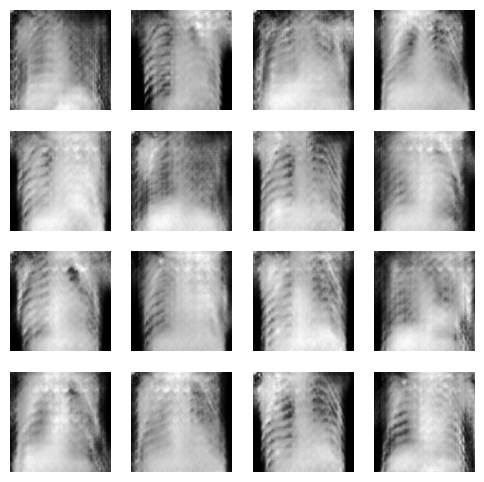

Epoch 301
Epoch 302
Epoch 303
Epoch 304
Epoch 305
Epoch 306
Epoch 307
Epoch 308
Epoch 309
Epoch 310
Epoch 311
Epoch 312
Epoch 313
Epoch 314
Epoch 315
Epoch 316
Epoch 317
Epoch 318
Epoch 319
Epoch 320
Epoch 321
Epoch 322
Epoch 323
Epoch 324
Epoch 325
Epoch 326
Epoch 327
Epoch 328
Epoch 329
Epoch 330
Epoch 331
Epoch 332
Epoch 333
Epoch 334
Epoch 335
Epoch 336
Epoch 337
Epoch 338
Epoch 339
Epoch 340
Epoch 341
Epoch 342
Epoch 343
Epoch 344
Epoch 345
Epoch 346
Epoch 347
Epoch 348
Epoch 349
Epoch 350
Epoch 351
Epoch 352
Epoch 353
Epoch 354
Epoch 355
Epoch 356
Epoch 357
Epoch 358
Epoch 359
Epoch 360
Epoch 361
Epoch 362
Epoch 363
Epoch 364
Epoch 365
Epoch 366
Epoch 367
Epoch 368
Epoch 369
Epoch 370
Epoch 371
Epoch 372
Epoch 373
Epoch 374
Epoch 375
Epoch 376
Epoch 377
Epoch 378
Epoch 379
Epoch 380
Epoch 381
Epoch 382
Epoch 383
Epoch 384
Epoch 385
Epoch 386
Epoch 387
Epoch 388
Epoch 389
Epoch 390
Epoch 391
Epoch 392
Epoch 393
Epoch 394
Epoch 395
Epoch 396
Epoch 397
Epoch 398
Epoch 399
Epoch 400


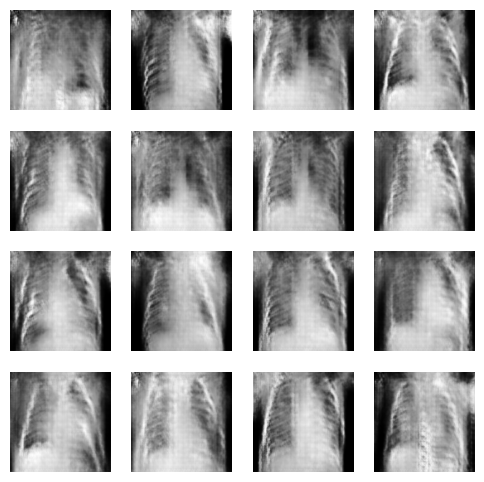

Epoch 401
Epoch 402
Epoch 403
Epoch 404
Epoch 405
Epoch 406
Epoch 407
Epoch 408
Epoch 409
Epoch 410
Epoch 411
Epoch 412
Epoch 413
Epoch 414
Epoch 415
Epoch 416
Epoch 417
Epoch 418
Epoch 419
Epoch 420
Epoch 421
Epoch 422
Epoch 423
Epoch 424
Epoch 425
Epoch 426
Epoch 427
Epoch 428
Epoch 429
Epoch 430
Epoch 431
Epoch 432
Epoch 433
Epoch 434
Epoch 435
Epoch 436
Epoch 437
Epoch 438
Epoch 439
Epoch 440
Epoch 441
Epoch 442
Epoch 443
Epoch 444
Epoch 445
Epoch 446
Epoch 447
Epoch 448
Epoch 449
Epoch 450
Epoch 451
Epoch 452
Epoch 453
Epoch 454
Epoch 455
Epoch 456
Epoch 457
Epoch 458
Epoch 459
Epoch 460
Epoch 461
Epoch 462
Epoch 463
Epoch 464
Epoch 465
Epoch 466
Epoch 467
Epoch 468
Epoch 469
Epoch 470
Epoch 471
Epoch 472
Epoch 473
Epoch 474
Epoch 475
Epoch 476
Epoch 477
Epoch 478
Epoch 479
Epoch 480
Epoch 481
Epoch 482
Epoch 483
Epoch 484
Epoch 485
Epoch 486
Epoch 487
Epoch 488
Epoch 489
Epoch 490
Epoch 491
Epoch 492
Epoch 493
Epoch 494
Epoch 495
Epoch 496
Epoch 497
Epoch 498
Epoch 499
Epoch 500


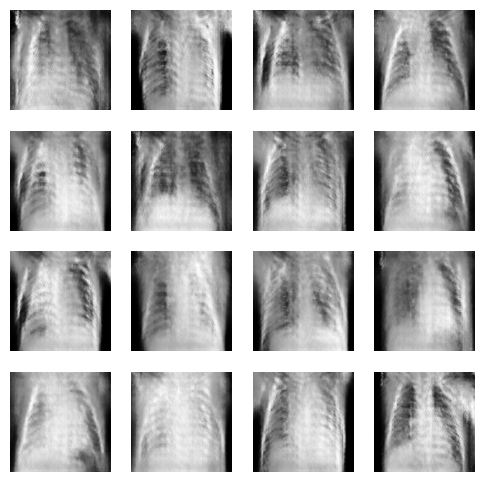

Epoch 501
Epoch 502
Epoch 503
Epoch 504
Epoch 505
Epoch 506
Epoch 507
Epoch 508
Epoch 509
Epoch 510
Epoch 511
Epoch 512
Epoch 513
Epoch 514
Epoch 515
Epoch 516
Epoch 517
Epoch 518
Epoch 519
Epoch 520
Epoch 521
Epoch 522
Epoch 523
Epoch 524
Epoch 525
Epoch 526
Epoch 527
Epoch 528
Epoch 529
Epoch 530
Epoch 531
Epoch 532
Epoch 533
Epoch 534
Epoch 535
Epoch 536
Epoch 537
Epoch 538
Epoch 539
Epoch 540
Epoch 541
Epoch 542
Epoch 543
Epoch 544
Epoch 545
Epoch 546
Epoch 547
Epoch 548
Epoch 549
Epoch 550
Epoch 551
Epoch 552
Epoch 553
Epoch 554
Epoch 555
Epoch 556
Epoch 557
Epoch 558
Epoch 559
Epoch 560
Epoch 561
Epoch 562
Epoch 563
Epoch 564
Epoch 565
Epoch 566
Epoch 567
Epoch 568
Epoch 569
Epoch 570
Epoch 571
Epoch 572
Epoch 573
Epoch 574
Epoch 575
Epoch 576
Epoch 577
Epoch 578
Epoch 579
Epoch 580
Epoch 581
Epoch 582
Epoch 583
Epoch 584
Epoch 585
Epoch 586
Epoch 587
Epoch 588
Epoch 589
Epoch 590
Epoch 591
Epoch 592
Epoch 593
Epoch 594
Epoch 595
Epoch 596
Epoch 597
Epoch 598
Epoch 599
Epoch 600


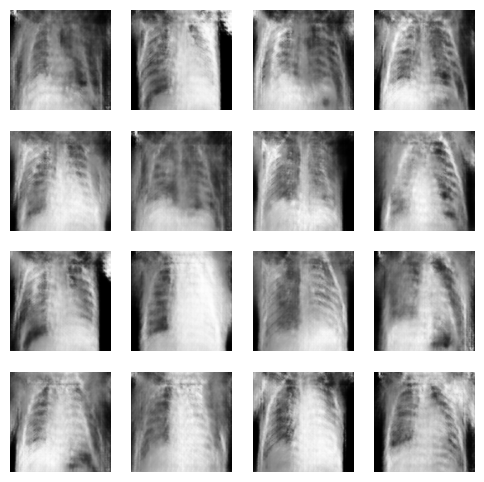

Epoch 601
Epoch 602
Epoch 603
Epoch 604
Epoch 605
Epoch 606
Epoch 607
Epoch 608
Epoch 609
Epoch 610
Epoch 611
Epoch 612
Epoch 613
Epoch 614
Epoch 615
Epoch 616
Epoch 617
Epoch 618
Epoch 619
Epoch 620
Epoch 621
Epoch 622
Epoch 623
Epoch 624
Epoch 625
Epoch 626
Epoch 627
Epoch 628
Epoch 629
Epoch 630
Epoch 631
Epoch 632
Epoch 633
Epoch 634
Epoch 635
Epoch 636
Epoch 637
Epoch 638
Epoch 639
Epoch 640
Epoch 641
Epoch 642
Epoch 643
Epoch 644
Epoch 645
Epoch 646
Epoch 647
Epoch 648
Epoch 649
Epoch 650
Epoch 651
Epoch 652
Epoch 653
Epoch 654
Epoch 655
Epoch 656
Epoch 657
Epoch 658
Epoch 659
Epoch 660
Epoch 661
Epoch 662
Epoch 663
Epoch 664
Epoch 665
Epoch 666
Epoch 667
Epoch 668
Epoch 669
Epoch 670
Epoch 671
Epoch 672
Epoch 673
Epoch 674
Epoch 675
Epoch 676
Epoch 677
Epoch 678
Epoch 679
Epoch 680
Epoch 681
Epoch 682
Epoch 683
Epoch 684
Epoch 685
Epoch 686
Epoch 687
Epoch 688
Epoch 689
Epoch 690
Epoch 691
Epoch 692
Epoch 693
Epoch 694
Epoch 695
Epoch 696
Epoch 697
Epoch 698
Epoch 699
Epoch 700


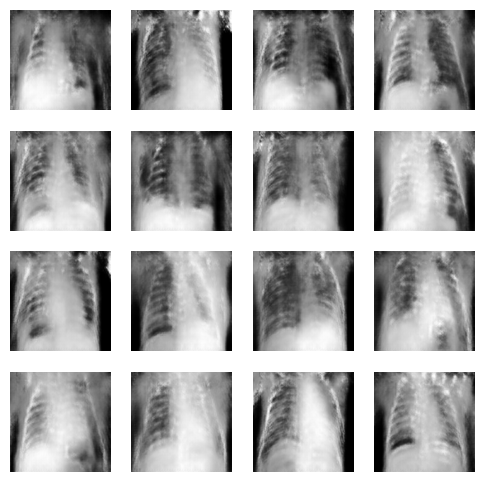

Epoch 701
Epoch 702
Epoch 703
Epoch 704
Epoch 705
Epoch 706
Epoch 707
Epoch 708
Epoch 709
Epoch 710
Epoch 711
Epoch 712
Epoch 713
Epoch 714
Epoch 715
Epoch 716
Epoch 717
Epoch 718
Epoch 719
Epoch 720
Epoch 721
Epoch 722
Epoch 723
Epoch 724
Epoch 725
Epoch 726
Epoch 727
Epoch 728
Epoch 729
Epoch 730
Epoch 731
Epoch 732
Epoch 733
Epoch 734
Epoch 735
Epoch 736
Epoch 737
Epoch 738
Epoch 739
Epoch 740
Epoch 741
Epoch 742
Epoch 743
Epoch 744
Epoch 745
Epoch 746
Epoch 747
Epoch 748
Epoch 749
Epoch 750
Epoch 751
Epoch 752
Epoch 753
Epoch 754
Epoch 755
Epoch 756
Epoch 757
Epoch 758
Epoch 759
Epoch 760
Epoch 761
Epoch 762
Epoch 763
Epoch 764
Epoch 765
Epoch 766
Epoch 767
Epoch 768
Epoch 769
Epoch 770
Epoch 771
Epoch 772
Epoch 773
Epoch 774
Epoch 775
Epoch 776
Epoch 777
Epoch 778
Epoch 779
Epoch 780
Epoch 781
Epoch 782
Epoch 783
Epoch 784
Epoch 785
Epoch 786
Epoch 787
Epoch 788
Epoch 789
Epoch 790
Epoch 791
Epoch 792
Epoch 793
Epoch 794
Epoch 795
Epoch 796
Epoch 797
Epoch 798
Epoch 799
Epoch 800


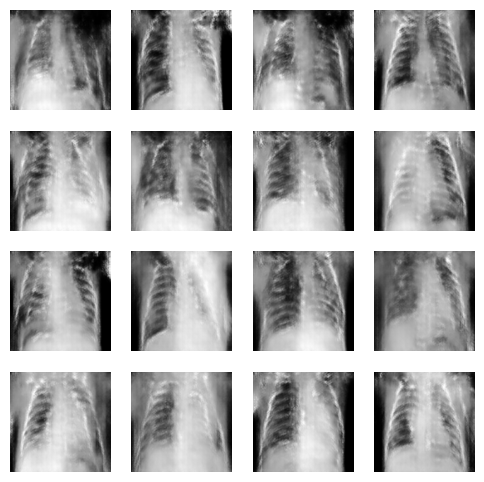

Epoch 801
Epoch 802
Epoch 803
Epoch 804
Epoch 805
Epoch 806
Epoch 807
Epoch 808
Epoch 809
Epoch 810
Epoch 811
Epoch 812
Epoch 813
Epoch 814
Epoch 815
Epoch 816
Epoch 817
Epoch 818
Epoch 819
Epoch 820
Epoch 821
Epoch 822
Epoch 823
Epoch 824
Epoch 825
Epoch 826
Epoch 827
Epoch 828
Epoch 829
Epoch 830
Epoch 831
Epoch 832
Epoch 833
Epoch 834
Epoch 835
Epoch 836
Epoch 837
Epoch 838
Epoch 839
Epoch 840
Epoch 841
Epoch 842
Epoch 843
Epoch 844
Epoch 845
Epoch 846
Epoch 847
Epoch 848
Epoch 849
Epoch 850
Epoch 851
Epoch 852
Epoch 853
Epoch 854
Epoch 855
Epoch 856
Epoch 857
Epoch 858
Epoch 859
Epoch 860
Epoch 861
Epoch 862
Epoch 863
Epoch 864
Epoch 865
Epoch 866
Epoch 867
Epoch 868
Epoch 869
Epoch 870
Epoch 871
Epoch 872
Epoch 873
Epoch 874
Epoch 875
Epoch 876
Epoch 877
Epoch 878
Epoch 879
Epoch 880
Epoch 881
Epoch 882
Epoch 883
Epoch 884
Epoch 885
Epoch 886
Epoch 887
Epoch 888
Epoch 889
Epoch 890
Epoch 891
Epoch 892
Epoch 893
Epoch 894
Epoch 895
Epoch 896
Epoch 897
Epoch 898
Epoch 899
Epoch 900


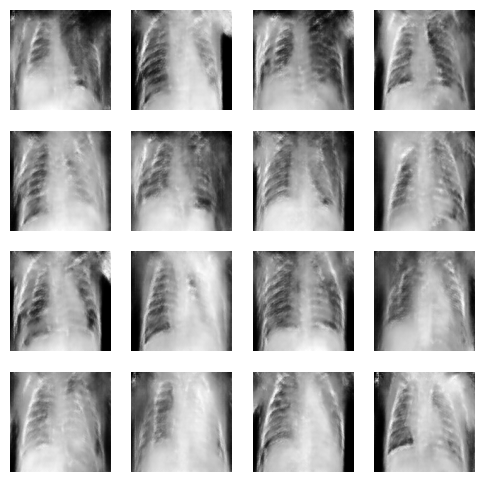

Epoch 901
Epoch 902
Epoch 903
Epoch 904
Epoch 905
Epoch 906
Epoch 907
Epoch 908
Epoch 909
Epoch 910
Epoch 911
Epoch 912
Epoch 913
Epoch 914
Epoch 915
Epoch 916
Epoch 917
Epoch 918
Epoch 919
Epoch 920
Epoch 921
Epoch 922
Epoch 923
Epoch 924
Epoch 925
Epoch 926
Epoch 927
Epoch 928
Epoch 929
Epoch 930
Epoch 931
Epoch 932
Epoch 933
Epoch 934
Epoch 935
Epoch 936
Epoch 937
Epoch 938
Epoch 939
Epoch 940
Epoch 941
Epoch 942
Epoch 943
Epoch 944
Epoch 945
Epoch 946
Epoch 947
Epoch 948
Epoch 949
Epoch 950
Epoch 951
Epoch 952
Epoch 953
Epoch 954
Epoch 955
Epoch 956
Epoch 957
Epoch 958
Epoch 959
Epoch 960
Epoch 961
Epoch 962
Epoch 963
Epoch 964
Epoch 965
Epoch 966
Epoch 967
Epoch 968
Epoch 969
Epoch 970
Epoch 971
Epoch 972
Epoch 973
Epoch 974
Epoch 975
Epoch 976
Epoch 977
Epoch 978
Epoch 979
Epoch 980
Epoch 981
Epoch 982
Epoch 983
Epoch 984
Epoch 985
Epoch 986
Epoch 987
Epoch 988
Epoch 989
Epoch 990
Epoch 991
Epoch 992
Epoch 993
Epoch 994
Epoch 995
Epoch 996
Epoch 997
Epoch 998
Epoch 999
Epoch 1000

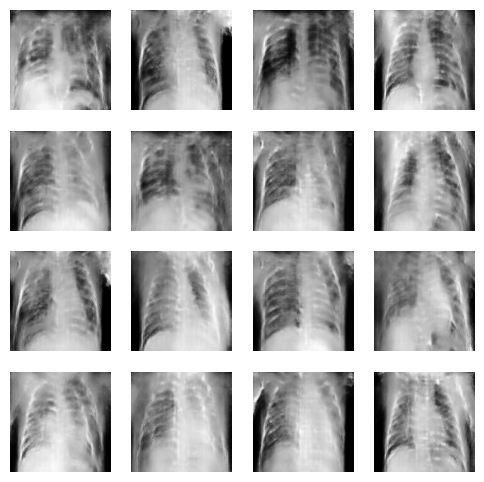

Time for 1001 epochs is 150.0 min 39.366859436035156 sec


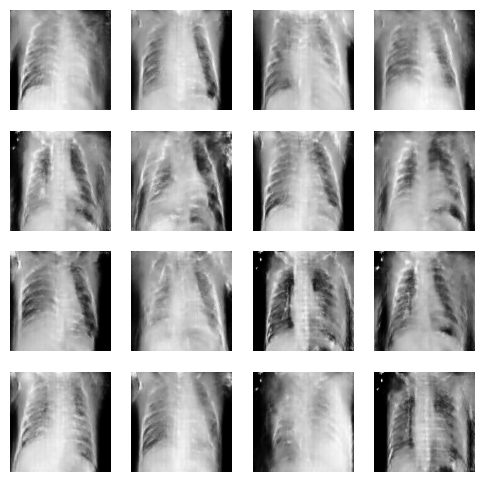

In [ ]:
# Generate synthetic images just once
n_gen_total = 1000  # or set a fixed large number

print("Training DCGAN for 'normal' class...")
gen_normal_images = dcgan(all_images['all_normal_images'], n_gen_total, 'normal').numpy()

print("Training DCGAN for 'pneumonia' class...")
gen_pnm_images = dcgan(all_images['all_pneumonia_images'], n_gen_total, 'pneumonia').numpy()

np.save("gen_normal.npy", gen_normal_images)
np.save("gen_pnm.npy", gen_pnm_images)

In [17]:
gen_normal_images = np.load("/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/gen_normal.npy")
gen_pnm_images = np.load("/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/gen_pnm.npy")

In [ ]:
train_sizes = list(range(100, 201, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
train_sizes = list(range(210, 241, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 210 (baseline)
Running baseline experiment with 210 real images
For training: 105 normal images, 105 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 9s 443ms/step - accuracy: 0.6077 - loss: 0.9241 - precision: 0.5472 - recall: 0.5466 - val_accuracy: 0.4375 - val_loss: 0.6801 - val_precision: 0.4667 - val_recall: 0.4375
Epoch 2/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2500 - loss: 1.5836 - precision: 0.2500 - recall: 0.2500 - val_accuracy: 0.5000 - val_loss: 0.6909 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/11 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 0.5000 - loss: 2.6352 - precision: 0.5000 - recall: 0.5000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.7325 - loss: 0.9849 - precision: 0.7264 - recall: 0.7348 - val_accuracy: 0.5000 - val_loss: 0.6953 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.9167 - loss: 0.3665 - precision: 0.9167 - recall: 0.9167 - val_accuracy: 0.4375 - val_loss: 0.7267 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8960 - loss: 0.2709 - precision: 0.8933 - recall: 0.8870 - val_accuracy: 0.6250 - val_loss: 0.6460 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8750 - loss: 0.3369 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8020 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8514 - loss: 0.2962 - precision: 0.8478 - recall: 0.8459 - val_accuracy: 0.4375 - val_loss: 0.8845 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_440 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_440         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_440 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_440               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_441 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_441         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_441 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_441               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_442 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_442         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_442 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_442               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_443 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_443         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_443 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_443               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_110 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_220 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_221 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3225936730702718 m 19.35562038421631 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 123ms/step
labels shape: (176, 2), preds shape: (188, 2)
TP: 89, TN: 0, FP: 87, FN: 0
{'Accuracy': 0.5056818181818182, 'Precision': 0.5056818181818182, 'Recall': 1.0, 'F1 Score': 0.6716981132075471, 'TP': 89, 'TN': 0, 'FP': 87, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 10, TN: 0, FP: 6, FN: 0
{'Accuracy': 0.625, 'Precision': 0.625, 'Recall': 1.0, 'F1 Score': 0.7692307692307693, 'TP': 10, 'TN': 0, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-0

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 249ms/step - accuracy: 0.6335 - loss: 1.0890 - precision: 0.6454 - recall: 0.6659 - val_accuracy: 0.4375 - val_loss: 0.7148 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3165 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7038 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8750 - loss: 0.3885 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8146 - loss: 0.4819 - precision: 0.8190 - recall: 0.8047 - val_accuracy: 0.5000 - val_loss: 0.8496 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3627 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.9828 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8581 - loss: 0.3533 - precision: 0.8510 - recall: 0.8539 - val_accuracy: 0.4375 - val_loss: 1.0776 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 0.6528 - precision: 0.4667 - recall: 0.4375 - val_accuracy: 0.5000 - val_loss: 1.3110 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8832 - loss: 0.2810 - precision: 0.8751 - recall: 0.8868 - val_accuracy: 0.5000 - val_loss: 1.2981 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_444 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_444         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_444 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_444               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_445 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_445         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_445 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_445               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_446 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_446         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_446 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_446               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_447 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_447         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_447 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_447               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_111 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_222 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_223 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.521079170703888 m 31.264750242233276 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 16, FP: 232, FN: 0
{'Accuracy': 0.532258064516129, 'Precision': 0.5166666666666667, 'Recall': 1.0, 'F1 Score': 0.6813186813186815, 'TP': 248, 'TN': 16, 'FP': 232, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step
labels shape: (384, 2), preds shape: (398, 2)
TP: 193, TN: 5, FP: 186, FN: 0
{'Accuracy': 0.515625, 'Precision': 0.5092348284960422, 'Recall': 1.0, 'F1 Score': 0.6748251748251748, 'TP': 193, 'TN': 5, 'FP': 186, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 7, TN: 1, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.4666666666666667, 'Recall': 1.0, 'F1 Score': 0.6363636363636364, 'TP': 7, 'TN': 1, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/te

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 9s 448ms/step - accuracy: 0.6078 - loss: 1.2525 - precision: 0.5441 - recall: 0.6090 - val_accuracy: 0.5625 - val_loss: 0.6602 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6250 - loss: 0.6411 - precision: 0.5882 - recall: 0.6250 - val_accuracy: 0.8125 - val_loss: 0.6614 - val_precision: 0.8667 - val_recall: 0.8125
Epoch 3/20
 1/11 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 0.8125 - loss: 0.5469 - precision: 0.7222 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step - accuracy: 0.8018 - loss: 0.4605 - precision: 0.7967 - recall: 0.8010 - val_accuracy: 0.6250 - val_loss: 0.6259 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8333 - loss: 0.3578 - precision: 0.8333 - recall: 0.8333 - val_accuracy: 0.5000 - val_loss: 0.6908 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8210 - loss: 0.4270 - precision: 0.8392 - recall: 0.8260 - val_accuracy: 0.5000 - val_loss: 0.7641 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.9375 - loss: 0.3027 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7630 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8617 - loss: 0.3210 - precision: 0.8657 - recall: 0.8611 - val_accuracy: 0.5000 - val_loss: 0.8141 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_448 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_448         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_448 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_448               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_449 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_449         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_449 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_449               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_450 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_450         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_450 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_450               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_451 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_451         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_451 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_451               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_112 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_224 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_225 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.322412916024526 m 19.344774961471558 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 123ms/step
labels shape: (176, 2), preds shape: (188, 2)
TP: 86, TN: 0, FP: 90, FN: 0
{'Accuracy': 0.48863636363636365, 'Precision': 0.48863636363636365, 'Recall': 1.0, 'F1 Score': 0.6564885496183206, 'TP': 86, 'TN': 0, 'FP': 90, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 253ms/step - accuracy: 0.5688 - loss: 1.2194 - precision: 0.5520 - recall: 0.5462 - val_accuracy: 0.5625 - val_loss: 0.6458 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6250 - loss: 0.6803 - precision: 0.6923 - recall: 0.5625 - val_accuracy: 0.5000 - val_loss: 0.6749 - val_precision: 0.4706 - val_recall: 0.5000
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.9375 - loss: 0.2565 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8524 - loss: 0.3402 - precision: 0.8514 - recall: 0.8520 - val_accuracy: 0.4375 - val_loss: 0.8579 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2966 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7302 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8030 - loss: 0.3928 - precision: 0.8050 - recall: 0.8047 - val_accuracy: 0.5000 - val_loss: 1.1972 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.7455 - precision: 0.6000 - recall: 0.5625 - val_accuracy: 0.4375 - val_loss: 0.9414 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8504 - loss: 0.3943 - precision: 0.8575 - recall: 0.8686 - val_accuracy: 0.5625 - val_loss: 0.8317 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_452 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_452         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_452 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_452               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_453 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_453         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_453 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_453               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_454 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_454         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_454 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_454               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_455 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_455         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_455 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_455               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_113 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_226 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_227 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5158947706222534 m 30.953686237335205 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 25, FP: 221, FN: 0
{'Accuracy': 0.5544354838709677, 'Precision': 0.5307855626326964, 'Recall': 1.0, 'F1 Score': 0.6934812760055479, 'TP': 250, 'TN': 25, 'FP': 221, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step
labels shape: (384, 2), preds shape: (398, 2)
TP: 191, TN: 6, FP: 187, FN: 0
{'Accuracy': 0.5130208333333334, 'Precision': 0.5052910052910053, 'Recall': 1.0, 'F1 Score': 0.671353251318102, 'TP': 191, 'TN': 6, 'FP': 187, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 10, TN: 0, FP: 6, FN: 0
{'Accuracy': 0.625, 'Precision': 0.625, 'Recall': 1.0, 'F1 Score': 0.7692307692307693, 'TP': 10, 'TN': 0, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 9s 450ms/step - accuracy: 0.5347 - loss: 1.0289 - precision: 0.5554 - recall: 0.5476 - val_accuracy: 0.6875 - val_loss: 0.6418 - val_precision: 0.9000 - val_recall: 0.5625
Epoch 2/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6875 - loss: 1.0278 - precision: 0.6667 - recall: 0.2500 - val_accuracy: 0.6875 - val_loss: 0.6582 - val_precision: 0.7619 - val_recall: 1.0000
Epoch 3/20
 1/11 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.6875 - loss: 0.8928 - precision: 0.5926 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.7477 - loss: 0.7037 - precision: 0.6933 - recall: 0.7590 - val_accuracy: 0.5000 - val_loss: 0.6546 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 4/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.9375 - loss: 0.3489 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6610 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 5/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8059 - loss: 0.4034 - precision: 0.8251 - recall: 0.7798 - val_accuracy: 0.5000 - val_loss: 0.6646 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8750 - loss: 0.3376 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6852 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.9278 - loss: 0.2794 - precision: 0.9248 - recall: 0.9212 - val_accuracy: 0.5000 - val_loss: 0.7348 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_456 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_456         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_456 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_456               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_457 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_457         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_457 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_457               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_458 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_458         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_458 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_458               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_459 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_459         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_459 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_459               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_114 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_228 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_229 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.32380013465881347 m 19.42800807952881 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 122ms/step
labels shape: (176, 2), preds shape: (188, 2)
TP: 87, TN: 0, FP: 89, FN: 0
{'Accuracy': 0.4943181818181818, 'Precision': 0.4943181818181818, 'Recall': 1.0, 'F1 Score': 0.6615969581749049, 'TP': 87, 'TN': 0, 'FP': 89, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 253ms/step - accuracy: 0.5989 - loss: 1.0968 - precision: 0.5995 - recall: 0.5973 - val_accuracy: 0.5625 - val_loss: 0.6444 - val_precision: 0.7500 - val_recall: 0.5625
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3296 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6755 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.6875 - loss: 0.5080 - precision: 0.7059 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8731 - loss: 0.3562 - precision: 0.8647 - recall: 0.8452 - val_accuracy: 0.6250 - val_loss: 0.6192 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2859 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.6250 - val_loss: 0.5918 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.7987 - loss: 0.4531 - precision: 0.7918 - recall: 0.7900 - val_accuracy: 0.5625 - val_loss: 0.7128 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1263 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8200 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8938 - loss: 0.2757 - precision: 0.8892 - recall: 0.8945 - val_accuracy: 0.4375 - val_loss: 1.1652 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_460 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_460         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_460 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_460               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_461 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_461         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_461 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_461               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_462 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_462         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_462 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_462               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_463 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_463         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_463 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_463               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_115 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_230 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_231 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5171989798545837 m 31.031938791275024 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 37, FP: 210, FN: 0
{'Accuracy': 0.5766129032258065, 'Precision': 0.5424836601307189, 'Recall': 1.0, 'F1 Score': 0.7033898305084746, 'TP': 249, 'TN': 37, 'FP': 210, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step
labels shape: (384, 2), preds shape: (398, 2)
TP: 194, TN: 6, FP: 184, FN: 0
{'Accuracy': 0.5208333333333334, 'Precision': 0.5132275132275133, 'Recall': 1.0, 'F1 Score': 0.6783216783216783, 'TP': 194, 'TN': 6, 'FP': 184, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 9s 440ms/step - accuracy: 0.5768 - loss: 1.0257 - precision: 0.5888 - recall: 0.5843 - val_accuracy: 0.4375 - val_loss: 0.6936 - val_precision: 0.5000 - val_recall: 1.0000
Epoch 2/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.8542 - precision: 0.5556 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6682 - val_precision: 0.6667 - val_recall: 0.1250
Epoch 3/20
 1/11 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.8125 - loss: 1.3592 - precision: 0.7500 - recall: 0.1875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.7620 - loss: 0.8251 - precision: 0.7477 - recall: 0.6354 - val_accuracy: 0.6250 - val_loss: 0.6280 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.9375 - loss: 0.3086 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6302 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.9339 - loss: 0.2627 - precision: 0.9104 - recall: 0.9200 - val_accuracy: 0.5625 - val_loss: 0.6644 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.2943 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6616 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8522 - loss: 0.3284 - precision: 0.8426 - recall: 0.8307 - val_accuracy: 0.4375 - val_loss: 0.8937 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_464 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_464         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_464 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_464               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_465 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_465         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_465 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_465               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_466 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_466         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_466 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_466               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_467 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_467         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_467 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_467               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_116 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_232 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_233 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3223850727081299 m 19.343104362487793 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 123ms/step
labels shape: (176, 2), preds shape: (188, 2)
TP: 84, TN: 0, FP: 92, FN: 0
{'Accuracy': 0.4772727272727273, 'Precision': 0.4772727272727273, 'Recall': 1.0, 'F1 Score': 0.6461538461538462, 'TP': 84, 'TN': 0, 'FP': 92, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 257ms/step - accuracy: 0.6460 - loss: 1.0821 - precision: 0.6002 - recall: 0.6045 - val_accuracy: 0.4375 - val_loss: 0.6848 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3988 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6778 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8750 - loss: 0.4351 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8819 - loss: 0.3517 - precision: 0.8775 - recall: 0.8744 - val_accuracy: 0.5000 - val_loss: 0.8220 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2584 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.6250 - val_loss: 0.6868 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8129 - loss: 0.4272 - precision: 0.8128 - recall: 0.8059 - val_accuracy: 0.6250 - val_loss: 0.7065 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0968 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 1.0769 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8803 - loss: 0.2851 - precision: 0.8764 - recall: 0.8840 - val_accuracy: 0.5000 - val_loss: 1.0878 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_468 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_468         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_468 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_468               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_469 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_469         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_469 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_469               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_470 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_470         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_470 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_470               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_471 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_471         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_471 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_471               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_117 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_234 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_235 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5193745533625285 m 31.16247320175171 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 51, FP: 197, FN: 0
{'Accuracy': 0.6028225806451613, 'Precision': 0.5573033707865168, 'Recall': 1.0, 'F1 Score': 0.7157287157287158, 'TP': 248, 'TN': 51, 'FP': 197, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step
labels shape: (384, 2), preds shape: (398, 2)
TP: 194, TN: 6, FP: 184, FN: 0
{'Accuracy': 0.5208333333333334, 'Precision': 0.5132275132275133, 'Recall': 1.0, 'F1 Score': 0.6783216783216783, 'TP': 194, 'TN': 6, 'FP': 184, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 5, TN: 3, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.38461538461538464, 'Recall': 1.0, 'F1 Score': 0.5555555555555556, 'TP': 5, 'TN': 3, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_x

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 9s 441ms/step - accuracy: 0.5695 - loss: 1.1860 - precision: 0.5826 - recall: 0.5600 - val_accuracy: 0.7500 - val_loss: 0.6633 - val_precision: 1.0000 - val_recall: 0.4375
Epoch 2/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.5332 - precision: 0.9000 - recall: 0.5625 - val_accuracy: 0.5625 - val_loss: 0.6536 - val_precision: 0.5882 - val_recall: 0.6250
Epoch 3/20
 1/11 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 0.8750 - loss: 0.3372 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8670 - loss: 0.3833 - precision: 0.8593 - recall: 0.8591 - val_accuracy: 0.6250 - val_loss: 0.6463 - val_precision: 0.6429 - val_recall: 0.5625
Epoch 4/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6875 - loss: 0.7172 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.3750 - val_loss: 0.7191 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8443 - loss: 0.3914 - precision: 0.8471 - recall: 0.8317 - val_accuracy: 0.5000 - val_loss: 0.6990 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.9375 - loss: 0.2855 - precision: 0.8421 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6710 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8136 - loss: 0.4067 - precision: 0.8408 - recall: 0.8284 - val_accuracy: 0.5000 - val_loss: 0.7417 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_472 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_472         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_472 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_472               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_473 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_473         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_473 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_473               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_474 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_474         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_474 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_474               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_475 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_475         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_475 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_475               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_118 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_236 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_237 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3211741089820862 m 19.27044653892517 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 123ms/step
labels shape: (176, 2), preds shape: (188, 2)
TP: 87, TN: 0, FP: 89, FN: 0
{'Accuracy': 0.4943181818181818, 'Precision': 0.4943181818181818, 'Recall': 1.0, 'F1 Score': 0.6615969581749049, 'TP': 87, 'TN': 0, 'FP': 89, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 252ms/step - accuracy: 0.5781 - loss: 1.3573 - precision: 0.5480 - recall: 0.5156 - val_accuracy: 0.4375 - val_loss: 0.6777 - val_precision: 0.5000 - val_recall: 0.5625
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.6306 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6760 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.6875 - loss: 0.5138 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.7901 - loss: 0.4227 - precision: 0.7994 - recall: 0.7957 - val_accuracy: 0.5000 - val_loss: 0.7257 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2115 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7205 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8509 - loss: 0.3382 - precision: 0.8521 - recall: 0.8624 - val_accuracy: 0.5625 - val_loss: 0.7640 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3375 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9424 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8883 - loss: 0.2938 - precision: 0.8821 - recall: 0.8875 - val_accuracy: 0.5000 - val_loss: 1.1221 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_476 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_476         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_476 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_476               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_477 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_477         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_477 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_477               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_478 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_478         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_478 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_478               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_479 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_479         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_479 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_479               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_119 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_238 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_239 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5179848591486613 m 31.079091548919678 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 29, FP: 218, FN: 0
{'Accuracy': 0.5604838709677419, 'Precision': 0.5331905781584583, 'Recall': 1.0, 'F1 Score': 0.6955307262569833, 'TP': 249, 'TN': 29, 'FP': 218, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step
labels shape: (384, 2), preds shape: (398, 2)
TP: 190, TN: 8, FP: 185, FN: 1
{'Accuracy': 0.515625, 'Precision': 0.5066666666666667, 'Recall': 0.9947643979057592, 'F1 Score': 0.6713780918727917, 'TP': 190, 'TN': 8, 'FP': 185, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 9, TN: 1, FP: 6, FN: 0
{'Accuracy': 0.625, 'Precision': 0.6, 'Recall': 1.0, 'F1 Score': 0.7499999999999999, 'TP': 9, 'TN': 1, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/trai

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 455ms/step - accuracy: 0.6611 - loss: 1.0200 - precision: 0.6023 - recall: 0.6281 - val_accuracy: 0.8125 - val_loss: 0.6561 - val_precision: 0.7222 - val_recall: 0.8125
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.5313 - precision: 0.7857 - recall: 0.6875 - val_accuracy: 0.8750 - val_loss: 0.6527 - val_precision: 0.8333 - val_recall: 0.9375
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 0.8125 - loss: 0.2911 - precision: 0.9286 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.7429 - loss: 0.4909 - precision: 0.7844 - recall: 0.7506 - val_accuracy: 0.5000 - val_loss: 0.6823 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.2519 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.6906 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8786 - loss: 0.3877 - precision: 0.8573 - recall: 0.8740 - val_accuracy: 0.5000 - val_loss: 0.6865 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.3661 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.8224 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8642 - loss: 0.3402 - precision: 0.8585 - recall: 0.8365 - val_accuracy: 0.5000 - val_loss: 0.8276 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_480 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_480         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_480 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_480               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_481 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_481         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_481 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_481               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_482 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_482         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_482 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_482               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_483 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_483         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_483 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_483               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_120 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_240 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_241 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3392864465713501 m 20.357186794281006 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 116ms/step
labels shape: (192, 2), preds shape: (198, 2)
TP: 96, TN: 0, FP: 96, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 96, 'TN': 0, 'FP': 96, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 14:31:03

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 10s 229ms/step - accuracy: 0.5665 - loss: 1.3251 - precision: 0.5696 - recall: 0.5927 - val_accuracy: 0.4375 - val_loss: 0.7170 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.3750 - loss: 0.9442 - precision: 0.4444 - recall: 0.5000 - val_accuracy: 0.8125 - val_loss: 0.6456 - val_precision: 0.7500 - val_recall: 0.7500
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.7500 - loss: 0.4685 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.7900 - loss: 0.4768 - precision: 0.7848 - recall: 0.7824 - val_accuracy: 0.4375 - val_loss: 0.8049 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1756 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.8260 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8675 - loss: 0.3193 - precision: 0.8700 - recall: 0.8695 - val_accuracy: 0.5000 - val_loss: 0.8671 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2215 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8238 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.7379 - loss: 0.6168 - precision: 0.7540 - recall: 0.7582 - val_accuracy: 0.4375 - val_loss: 1.1672 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_484 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_484         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_484 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_484               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_485 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_485         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_485 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_485               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_486 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_486         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_486 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_486               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_487 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_487         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_487 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_487               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_121 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_242 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_243 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5408700982729594 m 32.45220589637756 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 211, FP: 36, FN: 6
{'Accuracy': 0.9153225806451613, 'Precision': 0.8709677419354839, 'Recall': 0.9759036144578314, 'F1 Score': 0.9204545454545455, 'TP': 243, 'TN': 211, 'FP': 36, 'FN': 6}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step
labels shape: (416, 2), preds shape: (418, 2)
TP: 206, TN: 102, FP: 107, FN: 1
{'Accuracy': 0.7403846153846154, 'Precision': 0.65814696485623, 'Recall': 0.9951690821256038, 'F1 Score': 0.7923076923076924, 'TP': 206, 'TN': 102, 'FP': 107, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 9, TN: 7, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 9, 'TN': 7, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 447ms/step - accuracy: 0.5578 - loss: 1.5300 - precision: 0.5355 - recall: 0.6062 - val_accuracy: 0.8125 - val_loss: 0.6652 - val_precision: 0.8000 - val_recall: 0.7500
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.3134 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.8750 - val_loss: 0.6447 - val_precision: 0.8824 - val_recall: 0.9375
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 0.6250 - loss: 0.6362 - precision: 0.6471 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.7371 - loss: 0.5383 - precision: 0.7439 - recall: 0.7390 - val_accuracy: 0.5625 - val_loss: 0.6393 - val_precision: 0.6111 - val_recall: 0.6875
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.1683 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.6374 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8698 - loss: 0.3729 - precision: 0.8676 - recall: 0.8579 - val_accuracy: 0.5625 - val_loss: 0.6653 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.3803 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.7403 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8345 - loss: 0.3830 - precision: 0.8523 - recall: 0.8193 - val_accuracy: 0.5000 - val_loss: 0.7385 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_488 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_488         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_488 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_488               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_489 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_489         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_489 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_489               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_490 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_490         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_490 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_490               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_491 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_491         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_491 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_491               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_122 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_244 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_245 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3393442074457804 m 20.360652446746826 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 118ms/step
labels shape: (192, 2), preds shape: (198, 2)
TP: 97, TN: 0, FP: 95, FN: 0
{'Accuracy': 0.5052083333333334, 'Precision': 0.5052083333333334, 'Recall': 1.0, 'F1 Score': 0.671280276816609, 'TP': 97, 'TN': 0, 'FP': 95, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 14

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 10s 226ms/step - accuracy: 0.6500 - loss: 1.2016 - precision: 0.6322 - recall: 0.6734 - val_accuracy: 0.5000 - val_loss: 0.6801 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4006 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.3750 - val_loss: 0.7057 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.6875 - loss: 0.5320 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.7972 - loss: 0.4160 - precision: 0.7926 - recall: 0.8110 - val_accuracy: 0.5000 - val_loss: 0.8546 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4861 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 1.0507 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8626 - loss: 0.3402 - precision: 0.8513 - recall: 0.8543 - val_accuracy: 0.5000 - val_loss: 1.2134 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1180 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1857 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8889 - loss: 0.2756 - precision: 0.8929 - recall: 0.8727 - val_accuracy: 0.3750 - val_loss: 1.5481 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_492 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_492         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_492 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_492               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_493 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_493         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_493 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_493               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_494 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_494         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_494 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_494               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_495 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_495         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_495 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_495               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_123 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_246 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_247 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5363292376200358 m 32.17975425720215 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 24, TN: 248, FP: 0, FN: 224
{'Accuracy': 0.5483870967741935, 'Precision': 1.0, 'Recall': 0.0967741935483871, 'F1 Score': 0.17647058823529413, 'TP': 24, 'TN': 248, 'FP': 0, 'FN': 224}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (416, 2), preds shape: (418, 2)
TP: 26, TN: 207, FP: 0, FN: 183
{'Accuracy': 0.5600961538461539, 'Precision': 1.0, 'Recall': 0.12440191387559808, 'F1 Score': 0.22127659574468084, 'TP': 26, 'TN': 207, 'FP': 0, 'FN': 183}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 1, TN: 8, FP: 0, FN: 7
{'Accuracy': 0.5625, 'Precision': 1.0, 'Recall': 0.125, 'F1 Score': 0.2222222222222222, 'TP': 1, 'TN': 8, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 443ms/step - accuracy: 0.6379 - loss: 1.1179 - precision: 0.6408 - recall: 0.6654 - val_accuracy: 0.7500 - val_loss: 0.6609 - val_precision: 0.5833 - val_recall: 0.8750
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.4456 - precision: 0.6818 - recall: 0.9375 - val_accuracy: 0.8750 - val_loss: 0.6422 - val_precision: 0.9231 - val_recall: 0.7500
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.9375 - loss: 0.3063 - precision: 1.0000 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8853 - loss: 0.3759 - precision: 0.8910 - recall: 0.8263 - val_accuracy: 0.5000 - val_loss: 0.6467 - val_precision: 0.5385 - val_recall: 0.4375
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.6552 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.6875 - val_loss: 0.5774 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step - accuracy: 0.8330 - loss: 0.3503 - precision: 0.8311 - recall: 0.8395 - val_accuracy: 0.4375 - val_loss: 0.7157 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.1484 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6991 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8734 - loss: 0.3070 - precision: 0.8721 - recall: 0.9103 - val_accuracy: 0.5625 - val_loss: 0.6214 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_496 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_496         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_496 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_496               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_497 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_497         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_497 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_497               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_498 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_498         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_498 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_498               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_499 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_499         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_499 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_499               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_124 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_248 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_249 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.33797701994578044 m 20.278621196746826 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 118ms/step
labels shape: (192, 2), preds shape: (198, 2)
TP: 96, TN: 0, FP: 96, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 96, 'TN': 0, 'FP': 96, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 14:33:14.090682
Test accuracy:

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 10s 225ms/step - accuracy: 0.6198 - loss: 1.0635 - precision: 0.6352 - recall: 0.6001 - val_accuracy: 0.4375 - val_loss: 0.6931 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3537 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.6875 - val_loss: 0.5858 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.9375 - loss: 0.2728 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8907 - loss: 0.3145 - precision: 0.8805 - recall: 0.8713 - val_accuracy: 0.5000 - val_loss: 1.0052 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5384 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.8369 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8718 - loss: 0.3272 - precision: 0.8643 - recall: 0.8777 - val_accuracy: 0.5000 - val_loss: 1.3274 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2131 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.2930 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9097 - loss: 0.2409 - precision: 0.9135 - recall: 0.8934 - val_accuracy: 0.5000 - val_loss: 1.2979 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_500 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_500         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_500 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_500               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_501 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_501         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_501 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_501               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_502 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_502         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_502 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_502               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_503 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_503         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_503 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_503               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_125 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_250 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_251 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5342271645863851 m 32.053629875183105 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 18, FP: 231, FN: 0
{'Accuracy': 0.5342741935483871, 'Precision': 0.5167364016736402, 'Recall': 1.0, 'F1 Score': 0.6813793103448276, 'TP': 247, 'TN': 18, 'FP': 231, 'FN': 0}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (416, 2), preds shape: (418, 2)
TP: 207, TN: 3, FP: 206, FN: 0
{'Accuracy': 0.5048076923076923, 'Precision': 0.5012106537530266, 'Recall': 1.0, 'F1 Score': 0.667741935483871, 'TP': 207, 'TN': 3, 'FP': 206, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 446ms/step - accuracy: 0.5424 - loss: 1.4038 - precision: 0.5429 - recall: 0.5443 - val_accuracy: 0.3750 - val_loss: 0.6806 - val_precision: 0.5652 - val_recall: 0.8125
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.6875 - loss: 0.5888 - precision: 0.6522 - recall: 0.9375 - val_accuracy: 1.0000 - val_loss: 0.6517 - val_precision: 1.0000 - val_recall: 0.3750
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.8125 - loss: 0.5878 - precision: 1.0000 - recall: 0.3750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step - accuracy: 0.8626 - loss: 0.4399 - precision: 0.8613 - recall: 0.7449 - val_accuracy: 0.5000 - val_loss: 0.6787 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8333 - loss: 0.3017 - precision: 0.8333 - recall: 0.8333 - val_accuracy: 0.4375 - val_loss: 0.7139 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8557 - loss: 0.3524 - precision: 0.8679 - recall: 0.8557 - val_accuracy: 0.5625 - val_loss: 0.6768 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8750 - loss: 0.3857 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6684 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.7644 - loss: 0.4926 - precision: 0.7835 - recall: 0.7637 - val_accuracy: 0.5000 - val_loss: 0.8127 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_504 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_504         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_504 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_504               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_505 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_505         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_505 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_505               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_506 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_506         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_506 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_506               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_507 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_507         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_507 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_507               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_126 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_252 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_253 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3402640461921692 m 20.41584277153015 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 117ms/step
labels shape: (192, 2), preds shape: (198, 2)
TP: 96, TN: 0, FP: 96, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 96, 'TN': 0, 'FP': 96, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 14:34:19.276163
Test accuracy: 0

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 10s 226ms/step - accuracy: 0.5775 - loss: 1.2678 - precision: 0.5717 - recall: 0.5786 - val_accuracy: 0.5625 - val_loss: 0.6530 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.6499 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.8125 - val_loss: 0.6151 - val_precision: 0.7647 - val_recall: 0.8125
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.6875 - loss: 0.8562 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8242 - loss: 0.4403 - precision: 0.8284 - recall: 0.8249 - val_accuracy: 0.4375 - val_loss: 0.7307 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2978 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7232 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8857 - loss: 0.3039 - precision: 0.8897 - recall: 0.8875 - val_accuracy: 0.5625 - val_loss: 0.7101 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.6666 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 1.0280 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8514 - loss: 0.3307 - precision: 0.8566 - recall: 0.8621 - val_accuracy: 0.5000 - val_loss: 0.9352 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_508 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_508         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_508 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_508               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_509 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_509         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_509 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_509               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_510 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_510         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_510 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_510               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_511 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_511         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_511 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_511               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_127 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_254 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_255 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5338201284408569 m 32.029207706451416 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 110, FP: 139, FN: 0
{'Accuracy': 0.719758064516129, 'Precision': 0.6398963730569949, 'Recall': 1.0, 'F1 Score': 0.7804107424960506, 'TP': 247, 'TN': 110, 'FP': 139, 'FN': 0}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (416, 2), preds shape: (418, 2)
TP: 206, TN: 37, FP: 172, FN: 1
{'Accuracy': 0.5841346153846154, 'Precision': 0.544973544973545, 'Recall': 0.9951690821256038, 'F1 Score': 0.7042735042735042, 'TP': 206, 'TN': 37, 'FP': 172, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 9, TN: 3, FP: 4, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6923076923076923, 'Recall': 1.0, 'F1 Score': 0.8181818181818181, 'TP': 9, 'TN': 3, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 454ms/step - accuracy: 0.6400 - loss: 2.2821 - precision: 0.5078 - recall: 0.3956 - val_accuracy: 0.7500 - val_loss: 0.6577 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.7500 - loss: 0.5092 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6747 - val_precision: 0.8571 - val_recall: 0.3750
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 0.4375 - loss: 0.7602 - precision: 0.5625 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.6897 - loss: 0.5581 - precision: 0.7239 - recall: 0.7438 - val_accuracy: 0.5625 - val_loss: 0.6465 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.4476 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.6250 - val_loss: 0.6546 - val_precision: 0.8000 - val_recall: 0.5000
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8673 - loss: 0.3895 - precision: 0.8667 - recall: 0.8441 - val_accuracy: 0.5625 - val_loss: 0.6302 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.3650 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7248 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.9121 - loss: 0.2531 - precision: 0.9105 - recall: 0.8998 - val_accuracy: 0.5625 - val_loss: 0.6762 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_512 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_512         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_512 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_512               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_513 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_513         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_513 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_513               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_514 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_514         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_514 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_514               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_515 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_515         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_515 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_515               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_128 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_256 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_257 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3413290540377299 m 20.479743242263794 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 117ms/step
labels shape: (192, 2), preds shape: (198, 2)
TP: 96, TN: 0, FP: 96, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 96, 'TN': 0, 'FP': 96, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 10, TN: 0, FP: 6, FN: 0
{'Accuracy': 0.625, 'Precision': 0.625, 'Recall': 1.0, 'F1 Score': 0.7692307692307693, 'TP': 10, 'TN': 0, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 14:35:24.447529
Test accu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 10s 226ms/step - accuracy: 0.6171 - loss: 1.1420 - precision: 0.6359 - recall: 0.5933 - val_accuracy: 0.5000 - val_loss: 0.6468 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4623 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.3750 - val_loss: 0.7195 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.7500 - loss: 0.4653 - precision: 0.7059 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8661 - loss: 0.3360 - precision: 0.8605 - recall: 0.8616 - val_accuracy: 0.5625 - val_loss: 0.6932 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1697 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7393 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9000 - loss: 0.2392 - precision: 0.9017 - recall: 0.8915 - val_accuracy: 0.4375 - val_loss: 1.1297 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2391 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.8803 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8989 - loss: 0.2781 - precision: 0.9006 - recall: 0.8835 - val_accuracy: 0.6875 - val_loss: 0.7093 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_516 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_516         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_516 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_516               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_517 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_517         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_517 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_517               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_518 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_518         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_518 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_518               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_519 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_519         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_519 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_519               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_129 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_258 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_259 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5332827726999919 m 31.99696636199951 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 47, FP: 201, FN: 0
{'Accuracy': 0.594758064516129, 'Precision': 0.5523385300668151, 'Recall': 1.0, 'F1 Score': 0.7116212338593974, 'TP': 248, 'TN': 47, 'FP': 201, 'FN': 0}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (416, 2), preds shape: (418, 2)
TP: 207, TN: 22, FP: 187, FN: 0
{'Accuracy': 0.5504807692307693, 'Precision': 0.5253807106598984, 'Recall': 1.0, 'F1 Score': 0.6888519134775374, 'TP': 207, 'TN': 22, 'FP': 187, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
labels shape: (16, 2), preds shape: (22, 2)
TP: 8, TN: 1, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5333333333333333, 'Recall': 1.0, 'F1 Score': 0.6956521739130436, 'TP': 8, 'TN': 1, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ches

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 433ms/step - accuracy: 0.6613 - loss: 1.3315 - precision: 0.5621 - recall: 0.6034 - val_accuracy: 0.6250 - val_loss: 0.6669 - val_precision: 0.7059 - val_recall: 0.7500
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5625 - loss: 0.6719 - precision: 0.5789 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6587 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 114ms/step - accuracy: 0.4375 - loss: 1.4498 - precision: 0.4667 - recall: 0.4375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.5600 - loss: 0.9861 - precision: 0.5511 - recall: 0.5443 - val_accuracy: 0.5000 - val_loss: 0.6697 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.3108 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6690 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.9022 - loss: 0.2922 - precision: 0.8970 - recall: 0.9143 - val_accuracy: 0.5000 - val_loss: 0.7145 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.1846 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6565 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8907 - loss: 0.2539 - precision: 0.9035 - recall: 0.8846 - val_accuracy: 0.5000 - val_loss: 0.7354 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_520 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_520         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_520 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_520               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_521 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_521         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_521 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_521               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_522 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_522         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_522 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_522               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_523 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_523         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_523 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_523               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_130 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_260 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_261 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.34229406118392947 m 20.537643671035767 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 132ms/step
labels shape: (192, 2), preds shape: (206, 2)
TP: 95, TN: 0, FP: 97, FN: 0
{'Accuracy': 0.4947916666666667, 'Precision': 0.4947916666666667, 'Recall': 1.0, 'F1 Score': 0.662020905923345, 'TP': 95, 'TN': 0, 'FP': 97, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 10s 233ms/step - accuracy: 0.5702 - loss: 1.1931 - precision: 0.5853 - recall: 0.5819 - val_accuracy: 0.5000 - val_loss: 0.6535 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3056 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6604 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 1.0000 - loss: 0.1910 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8816 - loss: 0.2974 - precision: 0.8748 - recall: 0.8923 - val_accuracy: 0.5625 - val_loss: 0.7367 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1643 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.9597 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7519 - loss: 0.5615 - precision: 0.7478 - recall: 0.7693 - val_accuracy: 0.5000 - val_loss: 0.9847 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2134 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1455 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9059 - loss: 0.3084 - precision: 0.8904 - recall: 0.8970 - val_accuracy: 0.5625 - val_loss: 1.1201 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_524 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_524         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_524 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_524               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_525 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_525         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_525 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_525               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_526 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_526         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_526 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_526               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_527 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_527         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_527 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_527               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_131 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_262 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_263 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5536616404851278 m 33.219698429107666 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 155, FP: 92, FN: 2
{'Accuracy': 0.8104838709677419, 'Precision': 0.7286135693215339, 'Recall': 0.9919678714859438, 'F1 Score': 0.8401360544217685, 'TP': 247, 'TN': 155, 'FP': 92, 'FN': 2}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (432, 2), preds shape: (436, 2)
TP: 216, TN: 80, FP: 135, FN: 1
{'Accuracy': 0.6851851851851852, 'Precision': 0.6153846153846154, 'Recall': 0.9953917050691244, 'F1 Score': 0.7605633802816901, 'TP': 216, 'TN': 80, 'FP': 135, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 9, TN: 5, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8181818181818182, 'Recall': 1.0, 'F1 Score': 0.9, 'TP': 9, 'TN': 5, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 431ms/step - accuracy: 0.6478 - loss: 1.2216 - precision: 0.5705 - recall: 0.5999 - val_accuracy: 0.9375 - val_loss: 0.6442 - val_precision: 0.8889 - val_recall: 1.0000
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.3244 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.8125 - val_loss: 0.6618 - val_precision: 0.6364 - val_recall: 0.8750
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 1.0000 - loss: 0.1983 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step - accuracy: 0.8602 - loss: 0.3547 - precision: 0.8583 - recall: 0.8716 - val_accuracy: 0.3750 - val_loss: 0.6788 - val_precision: 0.4737 - val_recall: 0.5625
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.2609 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6786 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8498 - loss: 0.4338 - precision: 0.8203 - recall: 0.8411 - val_accuracy: 0.5000 - val_loss: 0.7410 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.1317 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.7989 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8824 - loss: 0.2523 - precision: 0.8842 - recall: 0.8889 - val_accuracy: 0.3750 - val_loss: 0.9450 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_528 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_528         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_528 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_528               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_529 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_529         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_529 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_529               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_530 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_530         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_530 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_530               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_531 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_531         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_531 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_531               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_132 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_264 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_265 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3471252163251241 m 20.827512979507446 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 134ms/step
labels shape: (192, 2), preds shape: (206, 2)
TP: 97, TN: 0, FP: 95, FN: 0
{'Accuracy': 0.5052083333333334, 'Precision': 0.5052083333333334, 'Recall': 1.0, 'F1 Score': 0.671280276816609, 'TP': 97, 'TN': 0, 'FP': 95, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 1

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 10s 233ms/step - accuracy: 0.6680 - loss: 1.0887 - precision: 0.5903 - recall: 0.5658 - val_accuracy: 0.5625 - val_loss: 0.6496 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3149 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7531 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 113ms/step - accuracy: 0.8125 - loss: 0.3703 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8474 - loss: 0.3680 - precision: 0.8540 - recall: 0.8395 - val_accuracy: 0.4375 - val_loss: 0.9429 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3626 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.7910 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8944 - loss: 0.2824 - precision: 0.8887 - recall: 0.8913 - val_accuracy: 0.6250 - val_loss: 0.7469 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2445 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.1999 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8858 - loss: 0.2303 - precision: 0.8959 - recall: 0.8923 - val_accuracy: 0.4375 - val_loss: 1.6956 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_532 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_532         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_532 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_532               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_533 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_533         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_533 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_533               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_534 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_534         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_534 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_534               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_535 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_535         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_535 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_535               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_133 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_266 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_267 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5575023015340169 m 33.450138092041016 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 123, FP: 125, FN: 0
{'Accuracy': 0.7479838709677419, 'Precision': 0.6648793565683646, 'Recall': 1.0, 'F1 Score': 0.7987117552334944, 'TP': 248, 'TN': 123, 'FP': 125, 'FN': 0}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (432, 2), preds shape: (436, 2)
TP: 215, TN: 46, FP: 171, FN: 0
{'Accuracy': 0.6041666666666666, 'Precision': 0.5569948186528497, 'Recall': 1.0, 'F1 Score': 0.7154742096505824, 'TP': 215, 'TN': 46, 'FP': 171, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 7, TN: 4, FP: 5, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.5833333333333334, 'Recall': 1.0, 'F1 Score': 0.7368421052631579, 'TP': 7, 'TN': 4, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 432ms/step - accuracy: 0.5919 - loss: 1.2584 - precision: 0.6117 - recall: 0.6242 - val_accuracy: 0.5625 - val_loss: 0.6608 - val_precision: 0.6111 - val_recall: 0.6875
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.9375 - loss: 0.3651 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6434 - val_precision: 0.5714 - val_recall: 0.7500
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.6875 - loss: 0.6352 - precision: 0.6667 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step - accuracy: 0.7845 - loss: 0.5125 - precision: 0.7646 - recall: 0.7609 - val_accuracy: 0.4375 - val_loss: 0.6544 - val_precision: 0.5000 - val_recall: 0.4375
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.3828 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.8125 - val_loss: 0.6294 - val_precision: 0.8667 - val_recall: 0.8125
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8555 - loss: 0.3448 - precision: 0.8441 - recall: 0.8673 - val_accuracy: 0.5000 - val_loss: 0.6838 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.1703 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.7029 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.9045 - loss: 0.3302 - precision: 0.8979 - recall: 0.8664 - val_accuracy: 0.4375 - val_loss: 0.8269 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_536 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_536         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_536 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_536               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_537 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_537         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_537 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_537               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_538 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_538         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_538 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_538               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_539 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_539         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_539 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_539               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_134 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_268 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_269 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.34306130011876423 m 20.583678007125854 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 134ms/step
labels shape: (192, 2), preds shape: (206, 2)
TP: 97, TN: 0, FP: 95, FN: 0
{'Accuracy': 0.5052083333333334, 'Precision': 0.5052083333333334, 'Recall': 1.0, 'F1 Score': 0.671280276816609, 'TP': 97, 'TN': 0, 'FP': 95, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 10s 235ms/step - accuracy: 0.6054 - loss: 1.1818 - precision: 0.6005 - recall: 0.5900 - val_accuracy: 0.5000 - val_loss: 0.6829 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2978 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6352 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.9375 - loss: 0.1578 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8830 - loss: 0.3394 - precision: 0.8726 - recall: 0.8807 - val_accuracy: 0.5000 - val_loss: 0.9537 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2913 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9097 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9076 - loss: 0.2513 - precision: 0.8918 - recall: 0.8956 - val_accuracy: 0.6250 - val_loss: 0.9201 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1710 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 1.4404 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9183 - loss: 0.2475 - precision: 0.9269 - recall: 0.9113 - val_accuracy: 0.5625 - val_loss: 1.4051 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_540 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_540         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_540 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_540               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_541 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_541         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_541 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_541               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_542 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_542         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_542 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_542               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_543 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_543         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_543 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_543               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_135 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_270 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_271 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5581403454144795 m 33.488420724868774 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 8, FP: 241, FN: 0
{'Accuracy': 0.5141129032258065, 'Precision': 0.5061475409836066, 'Recall': 1.0, 'F1 Score': 0.672108843537415, 'TP': 247, 'TN': 8, 'FP': 241, 'FN': 0}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (432, 2), preds shape: (436, 2)
TP: 215, TN: 0, FP: 217, FN: 0
{'Accuracy': 0.4976851851851852, 'Precision': 0.4976851851851852, 'Recall': 1.0, 'F1 Score': 0.6646058732612056, 'TP': 215, 'TN': 0, 'FP': 217, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/tes

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 9s 427ms/step - accuracy: 0.5884 - loss: 1.2633 - precision: 0.5801 - recall: 0.5523 - val_accuracy: 0.5625 - val_loss: 0.6552 - val_precision: 0.6087 - val_recall: 0.8750
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.5373 - precision: 0.6667 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6265 - val_precision: 0.6000 - val_recall: 0.5625
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 0.8125 - loss: 0.6205 - precision: 0.8462 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8483 - loss: 0.4689 - precision: 0.8299 - recall: 0.8042 - val_accuracy: 0.5625 - val_loss: 0.6299 - val_precision: 0.6316 - val_recall: 0.7500
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.2478 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6533 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8394 - loss: 0.4066 - precision: 0.8314 - recall: 0.8369 - val_accuracy: 0.5000 - val_loss: 0.6587 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.2302 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6884 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8843 - loss: 0.3420 - precision: 0.8622 - recall: 0.8668 - val_accuracy: 0.6250 - val_loss: 0.6512 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_544 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_544         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_544 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_544               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_545 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_545         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_545 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_545               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_546 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_546         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_546 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_546               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_547 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_547         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_547 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_547               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_136 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_272 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_273 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.34349633057912193 m 20.609779834747314 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 137ms/step
labels shape: (192, 2), preds shape: (206, 2)
TP: 94, TN: 0, FP: 98, FN: 0
{'Accuracy': 0.4895833333333333, 'Precision': 0.4895833333333333, 'Recall': 1.0, 'F1 Score': 0.6573426573426574, 'TP': 94, 'TN': 0, 'FP': 98, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results1

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


27/27 ━━━━━━━━━━━━━━━━━━━━ 11s 236ms/step - accuracy: 0.5711 - loss: 1.1936 - precision: 0.5757 - recall: 0.5615 - val_accuracy: 0.5000 - val_loss: 0.6718 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3555 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6578 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 3s 118ms/step - accuracy: 0.8125 - loss: 0.3246 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8040 - loss: 0.4154 - precision: 0.7983 - recall: 0.8162 - val_accuracy: 0.3750 - val_loss: 0.8593 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3055 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7491 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8468 - loss: 0.3815 - precision: 0.8470 - recall: 0.8444 - val_accuracy: 0.5000 - val_loss: 0.9275 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1883 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 1.2289 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8935 - loss: 0.2935 - precision: 0.9014 - recall: 0.8701 - val_accuracy: 0.3750 - val_loss: 1.5281 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_548 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_548         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_548 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_548               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_549 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_549         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_549 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_549               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_550 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_550         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_550 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_550               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_551 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_551         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_551 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_551               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_137 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_274 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_275 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5915436506271362 m 35.492619037628174 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 48, FP: 201, FN: 0
{'Accuracy': 0.594758064516129, 'Precision': 0.5513392857142857, 'Recall': 1.0, 'F1 Score': 0.7107913669064748, 'TP': 247, 'TN': 48, 'FP': 201, 'FN': 0}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (432, 2), preds shape: (436, 2)
TP: 216, TN: 6, FP: 210, FN: 0
{'Accuracy': 0.5138888888888888, 'Precision': 0.5070422535211268, 'Recall': 1.0, 'F1 Score': 0.6728971962616822, 'TP': 216, 'TN': 6, 'FP': 210, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 8, TN: 1, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5333333333333333, 'Recall': 1.0, 'F1 Score': 0.6956521739130436, 'TP': 8, 'TN': 1, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 6s 189ms/step - accuracy: 0.5659 - loss: 1.4030 - precision: 0.5640 - recall: 0.5126 - val_accuracy: 0.7500 - val_loss: 0.6463 - val_precision: 0.7647 - val_recall: 0.8125
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.3571 - loss: 0.9188 - precision: 0.4667 - recall: 0.5000 - val_accuracy: 0.5625 - val_loss: 0.6648 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/12 ━━━━━━━━━━━━━━━━━━━━ 1s 116ms/step - accuracy: 0.5625 - loss: 0.6731 - precision: 0.5333 - recall: 0.5000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step - accuracy: 0.7689 - loss: 0.4728 - precision: 0.7617 - recall: 0.7601 - val_accuracy: 0.3750 - val_loss: 0.6874 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.4375 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6502 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8010 - loss: 0.4347 - precision: 0.7971 - recall: 0.8050 - val_accuracy: 0.4375 - val_loss: 0.7071 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.5120 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.6484 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 7/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8846 - loss: 0.3170 - precision: 0.8971 - recall: 0.8793 - val_accuracy: 0.5000 - val_loss: 0.6487 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_552 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_552         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_552 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_552               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_553 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_553         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_553 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_553               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_554 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_554         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_554 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_554               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_555 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_555         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_555 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_555               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_138 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_276 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_277 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.34981556336085 m 20.988933801651 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 0, FP: 246, FN: 0
{'Accuracy': 0.5040322580645161, 'Precision': 0.5040322580645161, 'Recall': 1.0, 'F1 Score': 0.6702412868632708, 'TP': 250, 'TN': 0, 'FP': 246, 'FN': 0}
Testing with Training set
13/13 ━━━━━━━━━━━━━━━━━━━━ 2s 133ms/step
labels shape: (192, 2), preds shape: (206, 2)
TP: 94, TN: 0, FP: 98, FN: 0
{'Accuracy': 0.4895833333333333, 'Precision': 0.4895833333333333, 'Recall': 1.0, 'F1 Score': 0.6573426573426574, 'TP': 94, 'TN': 0, 'FP': 98, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 10s 234ms/step - accuracy: 0.6212 - loss: 0.8990 - precision: 0.5992 - recall: 0.5902 - val_accuracy: 0.5625 - val_loss: 0.6560 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5000 - loss: 0.8008 - precision: 0.5625 - recall: 0.5625 - val_accuracy: 0.8125 - val_loss: 0.6233 - val_precision: 0.8462 - val_recall: 0.6875
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 3s 120ms/step - accuracy: 0.7500 - loss: 0.3228 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8643 - loss: 0.3328 - precision: 0.8582 - recall: 0.8736 - val_accuracy: 0.5625 - val_loss: 0.7225 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1287 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7804 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8577 - loss: 0.3193 - precision: 0.8590 - recall: 0.8696 - val_accuracy: 0.5625 - val_loss: 0.8522 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3444 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.3750 - val_loss: 1.4631 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8323 - loss: 0.3769 - precision: 0.8465 - recall: 0.8274 - val_accuracy: 0.3750 - val_loss: 1.3436 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_556 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_556         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_556 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_556               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_557 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_557         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_557 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_557               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_558 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_558         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_558 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_558               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_559 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_559         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_559 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_559               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_139 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_278 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_279 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.55929620663325 m 33.557772397994995 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 93, FP: 155, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.6153846153846154, 'Recall': 1.0, 'F1 Score': 0.761904761904762, 'TP': 248, 'TN': 93, 'FP': 155, 'FN': 0}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step
labels shape: (432, 2), preds shape: (436, 2)
TP: 215, TN: 32, FP: 185, FN: 0
{'Accuracy': 0.5717592592592593, 'Precision': 0.5375, 'Recall': 1.0, 'F1 Score': 0.6991869918699186, 'TP': 215, 'TN': 32, 'FP': 185, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 7, TN: 3, FP: 6, FN: 0
{'Accuracy': 0.625, 'Precision': 0.5384615384615384, 'Recall': 1.0, 'F1 Score': 0.7000000000000001, 'TP': 7, 'TN': 3, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 10s 438ms/step - accuracy: 0.6024 - loss: 1.0747 - precision: 0.5916 - recall: 0.6727 - val_accuracy: 0.8125 - val_loss: 0.6648 - val_precision: 0.7647 - val_recall: 0.8125
Epoch 2/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5000 - loss: 0.7848 - precision: 0.4706 - recall: 0.5000 - val_accuracy: 0.5625 - val_loss: 0.6689 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/13 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.6250 - loss: 0.8347 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.7567 - loss: 0.6083 - precision: 0.7494 - recall: 0.7326 - val_accuracy: 0.5000 - val_loss: 0.6966 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.4531 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.6250 - val_loss: 0.6455 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 5/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.7413 - loss: 0.7093 - precision: 0.7287 - recall: 0.7239 - val_accuracy: 0.6250 - val_loss: 0.6475 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.4019 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.6861 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8744 - loss: 0.3700 - precision: 0.8636 - recall: 0.8739 - val_accuracy: 0.5625 - val_loss: 0.6899 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_560 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_560         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_560 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_560               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_561 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_561         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_561 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_561               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_562 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_562         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_562 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_562               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_563 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_563         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_563 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_563               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_140 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_280 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_281 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3645490248998006 m 21.872941493988037 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 127ms/step
labels shape: (208, 2), preds shape: (216, 2)
TP: 103, TN: 0, FP: 105, FN: 0
{'Accuracy': 0.4951923076923077, 'Precision': 0.4951923076923077, 'Recall': 1.0, 'F1 Score': 0.662379421221865, 'TP': 103, 'TN': 0, 'FP': 105, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 202

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 243ms/step - accuracy: 0.6220 - loss: 1.1456 - precision: 0.6113 - recall: 0.6048 - val_accuracy: 0.5625 - val_loss: 0.6629 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3155 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7073 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 3s 114ms/step - accuracy: 0.9375 - loss: 0.3081 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8272 - loss: 0.4036 - precision: 0.8245 - recall: 0.8264 - val_accuracy: 0.5000 - val_loss: 0.8086 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5270 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7874 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8666 - loss: 0.3026 - precision: 0.8683 - recall: 0.8826 - val_accuracy: 0.4375 - val_loss: 1.0597 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3643 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.3750 - val_loss: 1.2425 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.9466 - loss: 0.1768 - precision: 0.9469 - recall: 0.9418 - val_accuracy: 0.4375 - val_loss: 1.2125 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_564 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_564         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_564 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_564               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_565 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_565         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_565 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_565               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_566 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_566         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_566 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_566               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_567 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_567         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_567 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_567               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_141 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_282 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_283 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5842030763626098 m 35.05218458175659 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 135, FP: 112, FN: 3
{'Accuracy': 0.7681451612903226, 'Precision': 0.6871508379888268, 'Recall': 0.9879518072289156, 'F1 Score': 0.8105436573311368, 'TP': 246, 'TN': 135, 'FP': 112, 'FN': 3}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step
labels shape: (448, 2), preds shape: (456, 2)
TP: 225, TN: 39, FP: 184, FN: 0
{'Accuracy': 0.5892857142857143, 'Precision': 0.5501222493887531, 'Recall': 1.0, 'F1 Score': 0.7097791798107256, 'TP': 225, 'TN': 39, 'FP': 184, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 9, TN: 3, FP: 4, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6923076923076923, 'Recall': 1.0, 'F1 Score': 0.8181818181818181, 'TP': 9, 'TN': 3, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 10s 447ms/step - accuracy: 0.5374 - loss: 1.2707 - precision: 0.5284 - recall: 0.5499 - val_accuracy: 0.5000 - val_loss: 0.6710 - val_precision: 0.6087 - val_recall: 0.8750
Epoch 2/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.4043 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.6875 - val_loss: 0.6726 - val_precision: 0.6667 - val_recall: 0.8750
Epoch 3/20
 1/13 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - accuracy: 0.8750 - loss: 0.2596 - precision: 1.0000 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step - accuracy: 0.8564 - loss: 0.3462 - precision: 0.8744 - recall: 0.8626 - val_accuracy: 0.5000 - val_loss: 0.6888 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8750 - loss: 0.4960 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6830 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8295 - loss: 0.3749 - precision: 0.8266 - recall: 0.8469 - val_accuracy: 0.3125 - val_loss: 0.7706 - val_precision: 0.3125 - val_recall: 0.3125
Epoch 6/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.1055 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.7116 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.9041 - loss: 0.2633 - precision: 0.9182 - recall: 0.9065 - val_accuracy: 0.5000 - val_loss: 0.7576 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_568 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_568         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_568 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_568               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_569 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_569         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_569 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_569               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_570 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_570         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_570 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_570               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_571 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_571         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_571 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_571               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_142 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_284 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_285 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.36521336634953816 m 21.91280198097229 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 125ms/step
labels shape: (208, 2), preds shape: (216, 2)
TP: 104, TN: 0, FP: 104, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 104, 'TN': 0, 'FP': 104, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 14:43:21.605043
Test accura

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 248ms/step - accuracy: 0.6095 - loss: 1.1487 - precision: 0.6288 - recall: 0.5938 - val_accuracy: 0.5000 - val_loss: 0.6999 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4052 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6932 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.6875 - loss: 0.5509 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8244 - loss: 0.4151 - precision: 0.8211 - recall: 0.8307 - val_accuracy: 0.4375 - val_loss: 0.9158 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4946 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.8077 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8818 - loss: 0.3013 - precision: 0.8743 - recall: 0.8768 - val_accuracy: 0.5000 - val_loss: 1.1299 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2299 - precision: 0.8421 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0756 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8874 - loss: 0.2734 - precision: 0.8947 - recall: 0.8851 - val_accuracy: 0.5000 - val_loss: 1.3362 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_572 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_572         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_572 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_572               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_573 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_573         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_573 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_573               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_574 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_574         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_574 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_574               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_575 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_575         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_575 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_575               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_143 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_286 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_287 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5860017538070679 m 35.16010522842407 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 162, FP: 87, FN: 3
{'Accuracy': 0.8185483870967742, 'Precision': 0.7371601208459214, 'Recall': 0.9878542510121457, 'F1 Score': 0.8442906574394463, 'TP': 244, 'TN': 162, 'FP': 87, 'FN': 3}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (448, 2), preds shape: (456, 2)
TP: 224, TN: 43, FP: 181, FN: 0
{'Accuracy': 0.5959821428571429, 'Precision': 0.5530864197530864, 'Recall': 1.0, 'F1 Score': 0.712241653418124, 'TP': 224, 'TN': 43, 'FP': 181, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 9, TN: 5, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8181818181818182, 'Recall': 1.0, 'F1 Score': 0.9, 'TP': 9, 'TN': 5, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 9s 431ms/step - accuracy: 0.6085 - loss: 1.2460 - precision: 0.5916 - recall: 0.6223 - val_accuracy: 0.7500 - val_loss: 0.6514 - val_precision: 0.8462 - val_recall: 0.6875
Epoch 2/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6250 - loss: 0.8115 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.6250 - val_loss: 0.6294 - val_precision: 0.7500 - val_recall: 0.5625
Epoch 3/20
 1/13 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 0.8750 - loss: 0.3643 - precision: 0.8571 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8253 - loss: 0.4351 - precision: 0.8168 - recall: 0.8186 - val_accuracy: 0.5625 - val_loss: 0.6635 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.3533 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6636 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 5/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8353 - loss: 0.4657 - precision: 0.8179 - recall: 0.8568 - val_accuracy: 0.5000 - val_loss: 0.7614 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.2247 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 0.8990 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.9077 - loss: 0.2616 - precision: 0.9147 - recall: 0.8882 - val_accuracy: 0.5000 - val_loss: 0.8551 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_576 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_576         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_576 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_576               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_577 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_577         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_577 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_577               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_578 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_578         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_578 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_578               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_579 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_579         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_579 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_579               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_144 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_288 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_289 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3606670618057251 m 21.640023708343506 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 127ms/step
labels shape: (208, 2), preds shape: (216, 2)
TP: 105, TN: 0, FP: 103, FN: 0
{'Accuracy': 0.5048076923076923, 'Precision': 0.5048076923076923, 'Recall': 1.0, 'F1 Score': 0.6709265175718849, 'TP': 105, 'TN': 0, 'FP': 103, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 20

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 241ms/step - accuracy: 0.6340 - loss: 1.2194 - precision: 0.6109 - recall: 0.6190 - val_accuracy: 0.5625 - val_loss: 0.6530 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2726 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7123 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.9375 - loss: 0.2298 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8758 - loss: 0.3573 - precision: 0.8572 - recall: 0.8659 - val_accuracy: 0.3750 - val_loss: 1.1162 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3126 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.7729 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9310 - loss: 0.2557 - precision: 0.9210 - recall: 0.9246 - val_accuracy: 0.3750 - val_loss: 1.0792 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1473 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.9315 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8794 - loss: 0.2968 - precision: 0.8887 - recall: 0.8853 - val_accuracy: 0.4375 - val_loss: 0.8680 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_580 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_580         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_580 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_580               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_581 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_581         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_581 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_581               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_582 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_582         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_582 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_582               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_583 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_583         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_583 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_583               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_145 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_290 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_291 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5812781055768331 m 34.876686334609985 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 221, FP: 26, FN: 15
{'Accuracy': 0.9173387096774194, 'Precision': 0.9, 'Recall': 0.9397590361445783, 'F1 Score': 0.9194499017681729, 'TP': 234, 'TN': 221, 'FP': 26, 'FN': 15}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (448, 2), preds shape: (456, 2)
TP: 220, TN: 141, FP: 81, FN: 6
{'Accuracy': 0.8058035714285714, 'Precision': 0.7308970099667774, 'Recall': 0.9734513274336283, 'F1 Score': 0.8349146110056925, 'TP': 220, 'TN': 141, 'FP': 81, 'FN': 6}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 9, TN: 6, FP: 1, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.9, 'Recall': 1.0, 'F1 Score': 0.9473684210526316, 'TP': 9, 'TN': 6, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 10s 432ms/step - accuracy: 0.5625 - loss: 1.2341 - precision: 0.5955 - recall: 0.6176 - val_accuracy: 0.5625 - val_loss: 0.6652 - val_precision: 0.6000 - val_recall: 0.5625
Epoch 2/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6875 - loss: 0.5485 - precision: 0.6667 - recall: 0.6250 - val_accuracy: 0.8125 - val_loss: 0.6624 - val_precision: 0.7857 - val_recall: 0.6875
Epoch 3/20
 1/13 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.9375 - loss: 0.3107 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8928 - loss: 0.3474 - precision: 0.8842 - recall: 0.8738 - val_accuracy: 0.3750 - val_loss: 0.7041 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.3164 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.6875 - val_loss: 0.6044 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 5/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.7666 - loss: 0.4333 - precision: 0.7770 - recall: 0.7890 - val_accuracy: 0.5000 - val_loss: 0.6797 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.1841 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6488 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8662 - loss: 0.3654 - precision: 0.8460 - recall: 0.8686 - val_accuracy: 0.5000 - val_loss: 0.6872 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_584 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_584         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_584 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_584               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_585 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_585         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_585 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_585               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_586 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_586         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_586 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_586               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_587 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_587         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_587 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_587               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_146 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_292 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_293 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3607987880706787 m 21.647927284240723 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 130ms/step
labels shape: (208, 2), preds shape: (216, 2)
TP: 105, TN: 0, FP: 103, FN: 0
{'Accuracy': 0.5048076923076923, 'Precision': 0.5048076923076923, 'Recall': 1.0, 'F1 Score': 0.6709265175718849, 'TP': 105, 'TN': 0, 'FP': 103, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 20

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 242ms/step - accuracy: 0.6124 - loss: 1.1150 - precision: 0.5776 - recall: 0.5965 - val_accuracy: 0.4375 - val_loss: 0.6852 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1733 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6771 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 3s 115ms/step - accuracy: 0.8750 - loss: 0.2885 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8493 - loss: 0.3308 - precision: 0.8530 - recall: 0.8531 - val_accuracy: 0.5625 - val_loss: 0.6908 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5498 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.7553 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9196 - loss: 0.2454 - precision: 0.9321 - recall: 0.9093 - val_accuracy: 0.4375 - val_loss: 0.9896 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3016 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7972 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8974 - loss: 0.2696 - precision: 0.8981 - recall: 0.8863 - val_accuracy: 0.5625 - val_loss: 1.0537 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_588 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_588         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_588 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_588               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_589 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_589         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_589 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_589               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_590 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_590         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_590 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_590               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_591 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_591         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_591 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_591               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_147 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_294 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_295 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5802763104438782 m 34.81657862663269 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 141, FP: 106, FN: 2
{'Accuracy': 0.782258064516129, 'Precision': 0.6997167138810199, 'Recall': 0.9919678714859438, 'F1 Score': 0.8205980066445182, 'TP': 247, 'TN': 141, 'FP': 106, 'FN': 2}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step
labels shape: (448, 2), preds shape: (456, 2)
TP: 221, TN: 39, FP: 186, FN: 2
{'Accuracy': 0.5803571428571429, 'Precision': 0.542997542997543, 'Recall': 0.9910313901345291, 'F1 Score': 0.7015873015873015, 'TP': 221, 'TN': 39, 'FP': 186, 'FN': 2}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 7, TN: 5, FP: 4, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6363636363636364, 'Recall': 1.0, 'F1 Score': 0.7777777777777778, 'TP': 7, 'TN': 5, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 10s 438ms/step - accuracy: 0.5527 - loss: 1.3508 - precision: 0.5511 - recall: 0.5911 - val_accuracy: 0.7500 - val_loss: 0.6633 - val_precision: 0.7000 - val_recall: 0.8750
Epoch 2/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6250 - loss: 0.8170 - precision: 0.6000 - recall: 0.7500 - val_accuracy: 0.6250 - val_loss: 0.6424 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 3/20
 1/13 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.6250 - loss: 0.7032 - precision: 0.6364 - recall: 0.4375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.7757 - loss: 0.4963 - precision: 0.7853 - recall: 0.7503 - val_accuracy: 0.5625 - val_loss: 0.6587 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.3197 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6892 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.7802 - loss: 0.4876 - precision: 0.7760 - recall: 0.7848 - val_accuracy: 0.3125 - val_loss: 0.8624 - val_precision: 0.3125 - val_recall: 0.3125
Epoch 6/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.1386 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7619 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.9063 - loss: 0.2931 - precision: 0.8810 - recall: 0.8937 - val_accuracy: 0.5625 - val_loss: 0.7106 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_592 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_592         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_592 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_592               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_593 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_593         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_593 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_593               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_594 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_594         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_594 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_594               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_595 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_595         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_595 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_595               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_148 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_296 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_297 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3621822237968445 m 21.73093342781067 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 125ms/step
labels shape: (208, 2), preds shape: (216, 2)
TP: 104, TN: 0, FP: 104, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 104, 'TN': 0, 'FP': 104, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 242ms/step - accuracy: 0.6028 - loss: 1.1724 - precision: 0.6347 - recall: 0.5939 - val_accuracy: 0.5000 - val_loss: 0.6835 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2187 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.6875 - val_loss: 0.6124 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 1.0000 - loss: 0.1798 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8604 - loss: 0.3523 - precision: 0.8738 - recall: 0.8544 - val_accuracy: 0.6250 - val_loss: 0.6624 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1310 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.9181 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8769 - loss: 0.2733 - precision: 0.8820 - recall: 0.8741 - val_accuracy: 0.5625 - val_loss: 0.8700 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2123 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0989 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9256 - loss: 0.2106 - precision: 0.9114 - recall: 0.9192 - val_accuracy: 0.4375 - val_loss: 1.4995 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_596 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_596         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_596 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_596               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_597 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_597         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_597 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_597               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_598 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_598         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_598 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_598               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_599 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_599         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_599 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_599               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_149 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_298 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_299 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5821516036987304 m 34.92909622192383 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 68, FP: 181, FN: 1
{'Accuracy': 0.6330645161290323, 'Precision': 0.5761124121779859, 'Recall': 0.9959514170040485, 'F1 Score': 0.7299703264094956, 'TP': 246, 'TN': 68, 'FP': 181, 'FN': 1}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (448, 2), preds shape: (456, 2)
TP: 223, TN: 11, FP: 214, FN: 0
{'Accuracy': 0.5223214285714286, 'Precision': 0.5102974828375286, 'Recall': 1.0, 'F1 Score': 0.6757575757575758, 'TP': 223, 'TN': 11, 'FP': 214, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (24, 2)
TP: 8, TN: 2, FP: 6, FN: 0
{'Accuracy': 0.625, 'Precision': 0.5714285714285714, 'Recall': 1.0, 'F1 Score': 0.7272727272727273, 'TP': 8, 'TN': 2, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

In [ ]:
train_sizes = list(range(250, 291, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 250 (baseline)
Running baseline experiment with 250 real images
For training: 125 normal images, 125 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 170ms/step - accuracy: 0.5355 - loss: 1.3189 - precision: 0.5528 - recall: 0.5198 - val_accuracy: 0.3125 - val_loss: 0.6900 - val_precision: 0.3333 - val_recall: 0.3125
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.7857 - loss: 0.5286 - precision: 0.7786 - recall: 0.7571 - val_accuracy: 0.5000 - val_loss: 0.6395 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8800 - loss: 0.2994 - precision: 0.8817 - recall: 0.9122 - val_accuracy: 0.5000 - val_loss: 0.6708 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8832 - loss: 0.3001 - precision: 0.8684 - recall: 0.8665 - val_accuracy: 0.5625 - val_loss: 0.6611 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.9115 - loss: 0.2459 - precision: 0.9050 - recall: 0.9066 - val_accuracy: 0.3750 - val_loss: 0.9552

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_600 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_600         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_600 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_600               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_601 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_601         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_601 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_601               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_602 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_602         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_602 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_602               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_603 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_603         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_603 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_603               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_150 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_300 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_301 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5312517881393433 m 31.875107288360596 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 186, FP: 62, FN: 2
{'Accuracy': 0.8709677419354839, 'Precision': 0.7987012987012987, 'Recall': 0.9919354838709677, 'F1 Score': 0.8848920863309353, 'TP': 246, 'TN': 186, 'FP': 62, 'FN': 2}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step
labels shape: (224, 2), preds shape: (224, 2)
TP: 111, TN: 56, FP: 56, FN: 1
{'Accuracy': 0.7455357142857143, 'Precision': 0.6646706586826348, 'Recall': 0.9910714285714286, 'F1 Score': 0.7956989247311828, 'TP': 111, 'TN': 56, 'FP': 56, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 6, TN: 9, FP: 1, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8571428571428571, 'Recall': 1.0, 'F1 Score': 0.923076923076923, 'TP': 6, 'TN': 9, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 211ms/step - accuracy: 0.6324 - loss: 1.1250 - precision: 0.6032 - recall: 0.6001 - val_accuracy: 0.5000 - val_loss: 0.6511 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2566 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.6250 - val_loss: 0.6212 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 123ms/step - accuracy: 0.7500 - loss: 0.6361 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8267 - loss: 0.4064 - precision: 0.8325 - recall: 0.8203 - val_accuracy: 0.5625 - val_loss: 0.7634 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2395 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.3750 - val_loss: 0.9428 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8560 - loss: 0.3814 - precision: 0.8517 - recall: 0.8427 - val_accuracy: 0.5625 - val_loss: 1.0037 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4494 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9841 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9082 - loss: 0.2600 - precision: 0.9073 - recall: 0.9056 - val_accuracy: 0.4375 - val_loss: 1.3542 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_604 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_604         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_604 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_604               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_605 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_605         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_605 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_605               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_606 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_606         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_606 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_606               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_607 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_607         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_607 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_607               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_151 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_302 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_303 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.579325278600057 m 34.75951671600342 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 58, FP: 188, FN: 0
{'Accuracy': 0.6209677419354839, 'Precision': 0.5707762557077626, 'Recall': 1.0, 'F1 Score': 0.7267441860465117, 'TP': 250, 'TN': 58, 'FP': 188, 'FN': 0}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (464, 2), preds shape: (474, 2)
TP: 233, TN: 8, FP: 223, FN: 0
{'Accuracy': 0.5193965517241379, 'Precision': 0.5109649122807017, 'Recall': 1.0, 'F1 Score': 0.6763425253991292, 'TP': 233, 'TN': 8, 'FP': 223, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 10, TN: 2, FP: 4, FN: 0
{'Accuracy': 0.75, 'Precision': 0.7142857142857143, 'Recall': 1.0, 'F1 Score': 0.8333333333333333, 'TP': 10, 'TN': 2, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 171ms/step - accuracy: 0.5701 - loss: 1.1271 - precision: 0.5767 - recall: 0.6584 - val_accuracy: 0.5625 - val_loss: 0.6687 - val_precision: 0.6667 - val_recall: 0.3750
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8329 - loss: 0.3923 - precision: 0.8304 - recall: 0.8265 - val_accuracy: 0.6250 - val_loss: 0.6074 - val_precision: 0.7500 - val_recall: 0.5625
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8741 - loss: 0.3406 - precision: 0.8597 - recall: 0.8783 - val_accuracy: 0.6250 - val_loss: 0.6159 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8438 - loss: 0.3332 - precision: 0.8644 - recall: 0.8369 - val_accuracy: 0.5000 - val_loss: 0.8025 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8777 - loss: 0.3001 - precision: 0.8896 - recall: 0.8746 - val_accuracy: 0.4375 - val_loss: 0.9041

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_608 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_608         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_608 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_608               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_609 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_609         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_609 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_609               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_610 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_610         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_610 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_610               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_611 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_611         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_611 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_611               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_152 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_304 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_305 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5310297250747681 m 31.861783504486084 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 220, FP: 29, FN: 7
{'Accuracy': 0.9274193548387096, 'Precision': 0.8921933085501859, 'Recall': 0.97165991902834, 'F1 Score': 0.9302325581395348, 'TP': 240, 'TN': 220, 'FP': 29, 'FN': 7}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step
labels shape: (224, 2), preds shape: (224, 2)
TP: 111, TN: 70, FP: 42, FN: 1
{'Accuracy': 0.8080357142857143, 'Precision': 0.7254901960784313, 'Recall': 0.9910714285714286, 'F1 Score': 0.8377358490566038, 'TP': 111, 'TN': 70, 'FP': 42, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 8, TN: 8, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 8, 'TN': 8, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 210ms/step - accuracy: 0.6062 - loss: 1.2354 - precision: 0.5633 - recall: 0.5779 - val_accuracy: 0.5625 - val_loss: 0.6548 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4747 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7065 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 113ms/step - accuracy: 0.6250 - loss: 0.6182 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8204 - loss: 0.3847 - precision: 0.8255 - recall: 0.8192 - val_accuracy: 0.5000 - val_loss: 0.7554 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8000 - loss: 0.3677 - precision: 0.8182 - recall: 0.9000 - val_accuracy: 0.4375 - val_loss: 0.8792 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8608 - loss: 0.3391 - precision: 0.8515 - recall: 0.8560 - val_accuracy: 0.3750 - val_loss: 1.3399 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4709 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9231 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9179 - loss: 0.2391 - precision: 0.9192 - recall: 0.9213 - val_accuracy: 0.6250 - val_loss: 0.7768 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_612 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_612         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_612 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_612               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_613 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_613         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_613 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_613               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_614 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_614         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_614 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_614               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_615 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_615         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_615 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_615               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_153 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_306 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_307 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5800342480341594 m 34.80205488204956 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 100, FP: 148, FN: 1
{'Accuracy': 0.6995967741935484, 'Precision': 0.6253164556962025, 'Recall': 0.9959677419354839, 'F1 Score': 0.7682737169517885, 'TP': 247, 'TN': 100, 'FP': 148, 'FN': 1}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (464, 2), preds shape: (474, 2)
TP: 230, TN: 36, FP: 198, FN: 0
{'Accuracy': 0.5732758620689655, 'Precision': 0.5373831775700935, 'Recall': 1.0, 'F1 Score': 0.6990881458966566, 'TP': 230, 'TN': 36, 'FP': 198, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 9, TN: 4, FP: 3, FN: 0
{'Accuracy': 0.8125, 'Precision': 0.75, 'Recall': 1.0, 'F1 Score': 0.8571428571428571, 'TP': 9, 'TN': 4, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 9s 334ms/step - accuracy: 0.6257 - loss: 0.9936 - precision: 0.6254 - recall: 0.6508 - val_accuracy: 0.8750 - val_loss: 0.6496 - val_precision: 0.8125 - val_recall: 0.8125
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step - accuracy: 0.8416 - loss: 0.4174 - precision: 0.8377 - recall: 0.8267 - val_accuracy: 0.4375 - val_loss: 0.6906 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8469 - loss: 0.3505 - precision: 0.8562 - recall: 0.8580 - val_accuracy: 0.4375 - val_loss: 0.7307 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step - accuracy: 0.8027 - loss: 0.3884 - precision: 0.8070 - recall: 0.7987 - val_accuracy: 0.6875 - val_loss: 0.5752 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.9021 - loss: 0.2688 - precision: 0.8952 - recall: 0.9007 - val_accuracy: 0.5625 - val_loss: 0.8400

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_616 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_616         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_616 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_616               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_617 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_617         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_617 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_617               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_618 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_618         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_618 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_618               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_619 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_619         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_619 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_619               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_154 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_308 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_309 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5676203449567159 m 34.057220697402954 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 87, FP: 160, FN: 1
{'Accuracy': 0.6754032258064516, 'Precision': 0.6078431372549019, 'Recall': 0.9959839357429718, 'F1 Score': 0.7549467275494672, 'TP': 248, 'TN': 87, 'FP': 160, 'FN': 1}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step
labels shape: (224, 2), preds shape: (224, 2)
TP: 112, TN: 20, FP: 92, FN: 0
{'Accuracy': 0.5892857142857143, 'Precision': 0.5490196078431373, 'Recall': 1.0, 'F1 Score': 0.7088607594936709, 'TP': 112, 'TN': 20, 'FP': 92, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 7, TN: 4, FP: 5, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.5833333333333334, 'Recall': 1.0, 'F1 Score': 0.7368421052631579, 'TP': 7, 'TN': 4, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 215ms/step - accuracy: 0.5916 - loss: 1.3132 - precision: 0.6014 - recall: 0.6388 - val_accuracy: 0.3750 - val_loss: 0.7097 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4669 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.7223 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8750 - loss: 0.4109 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.7998 - loss: 0.3938 - precision: 0.8072 - recall: 0.7902 - val_accuracy: 0.5000 - val_loss: 0.9038 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1577 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8864 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8116 - loss: 0.3778 - precision: 0.8284 - recall: 0.8089 - val_accuracy: 0.4375 - val_loss: 1.2680 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3401 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 1.4996 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9190 - loss: 0.2512 - precision: 0.9107 - recall: 0.9006 - val_accuracy: 0.5625 - val_loss: 1.2159 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_620 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_620         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_620 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_620               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_621 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_621         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_621 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_621               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_622 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_622         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_622 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_622               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_623 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_623         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_623 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_623               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_155 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_310 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_311 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.586463205019633 m 35.18779230117798 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 148, FP: 102, FN: 2
{'Accuracy': 0.7903225806451613, 'Precision': 0.7052023121387283, 'Recall': 0.991869918699187, 'F1 Score': 0.8243243243243242, 'TP': 244, 'TN': 148, 'FP': 102, 'FN': 2}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (464, 2), preds shape: (474, 2)
TP: 231, TN: 52, FP: 181, FN: 0
{'Accuracy': 0.6099137931034483, 'Precision': 0.5606796116504854, 'Recall': 1.0, 'F1 Score': 0.71850699844479, 'TP': 231, 'TN': 52, 'FP': 181, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 8, TN: 5, FP: 3, FN: 0
{'Accuracy': 0.8125, 'Precision': 0.7272727272727273, 'Recall': 1.0, 'F1 Score': 0.8421052631578948, 'TP': 8, 'TN': 5, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 174ms/step - accuracy: 0.5987 - loss: 1.1557 - precision: 0.6259 - recall: 0.5887 - val_accuracy: 0.8125 - val_loss: 0.6564 - val_precision: 1.0000 - val_recall: 0.5000
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8041 - loss: 0.3977 - precision: 0.8176 - recall: 0.7827 - val_accuracy: 0.6250 - val_loss: 0.5996 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step - accuracy: 0.9292 - loss: 0.2261 - precision: 0.9356 - recall: 0.9229 - val_accuracy: 0.5000 - val_loss: 0.7068 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step - accuracy: 0.9177 - loss: 0.2571 - precision: 0.8936 - recall: 0.9150 - val_accuracy: 0.5000 - val_loss: 0.8812 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step - accuracy: 0.8429 - loss: 0.3887 - precision: 0.8328 - recall: 0.8480 - val_accuracy: 0.4375 - val_loss: 0.9795

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_624 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_624         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_624 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_624               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_625 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_625         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_625 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_625               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_626 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_626         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_626 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_626               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_627 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_627         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_627 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_627               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_156 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_312 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_313 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.533958637714386 m 32.03751826286316 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 140, FP: 108, FN: 1
{'Accuracy': 0.780241935483871, 'Precision': 0.6957746478873239, 'Recall': 0.9959677419354839, 'F1 Score': 0.8192371475953565, 'TP': 247, 'TN': 140, 'FP': 108, 'FN': 1}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step
labels shape: (224, 2), preds shape: (224, 2)
TP: 112, TN: 32, FP: 80, FN: 0
{'Accuracy': 0.6428571428571429, 'Precision': 0.5833333333333334, 'Recall': 1.0, 'F1 Score': 0.7368421052631579, 'TP': 112, 'TN': 32, 'FP': 80, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 9, TN: 5, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8181818181818182, 'Recall': 1.0, 'F1 Score': 0.9, 'TP': 9, 'TN': 5, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_x

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 212ms/step - accuracy: 0.5667 - loss: 1.3269 - precision: 0.5909 - recall: 0.5612 - val_accuracy: 0.5000 - val_loss: 0.7081 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.6520 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6647 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.6875 - loss: 1.0253 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8281 - loss: 0.4384 - precision: 0.8236 - recall: 0.8151 - val_accuracy: 0.4375 - val_loss: 1.0256 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.6149 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5625 - val_loss: 0.7272 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8764 - loss: 0.3065 - precision: 0.8821 - recall: 0.8802 - val_accuracy: 0.5000 - val_loss: 0.8555 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2220 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9229 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9128 - loss: 0.2139 - precision: 0.9215 - recall: 0.9170 - val_accuracy: 0.5000 - val_loss: 1.0023 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_628 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_628         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_628 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_628               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_629 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_629         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_629 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_629               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_630 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_630         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_630 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_630               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_631 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_631         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_631 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_631               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_157 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_314 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_315 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5841007471084595 m 35.04604482650757 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 203, FP: 45, FN: 5
{'Accuracy': 0.8991935483870968, 'Precision': 0.84375, 'Recall': 0.9798387096774194, 'F1 Score': 0.9067164179104478, 'TP': 243, 'TN': 203, 'FP': 45, 'FN': 5}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (464, 2), preds shape: (474, 2)
TP: 234, TN: 86, FP: 144, FN: 0
{'Accuracy': 0.6896551724137931, 'Precision': 0.6190476190476191, 'Recall': 1.0, 'F1 Score': 0.7647058823529412, 'TP': 234, 'TN': 86, 'FP': 144, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 8, TN: 6, FP: 1, FN: 1
{'Accuracy': 0.875, 'Precision': 0.8888888888888888, 'Recall': 0.8888888888888888, 'F1 Score': 0.8888888888888888, 'TP': 8, 'TN': 6, 'FP': 1, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 7s 172ms/step - accuracy: 0.6457 - loss: 1.1433 - precision: 0.5917 - recall: 0.6087 - val_accuracy: 0.9375 - val_loss: 0.6413 - val_precision: 0.8824 - val_recall: 0.9375
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8671 - loss: 0.3585 - precision: 0.8565 - recall: 0.8546 - val_accuracy: 0.5000 - val_loss: 0.6958 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8451 - loss: 0.4220 - precision: 0.8401 - recall: 0.8443 - val_accuracy: 0.6250 - val_loss: 0.6209 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 97ms/step - accuracy: 0.7969 - loss: 0.4963 - precision: 0.7817 - recall: 0.7969 - val_accuracy: 0.5000 - val_loss: 0.7793 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.9145 - loss: 0.2606 - precision: 0.9065 - recall: 0.8946 - val_accuracy: 0.5000 - val_loss: 0.9205

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_632 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_632         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_632 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_632               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_633 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_633         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_633 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_633               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_634 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_634         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_634 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_634               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_635 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_635         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_635 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_635               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_158 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_316 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_317 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5335767269134521 m 32.01460361480713 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 167, FP: 83, FN: 3
{'Accuracy': 0.8266129032258065, 'Precision': 0.745398773006135, 'Recall': 0.9878048780487805, 'F1 Score': 0.8496503496503498, 'TP': 243, 'TN': 167, 'FP': 83, 'FN': 3}
Testing with Training set
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step
labels shape: (224, 2), preds shape: (224, 2)
TP: 112, TN: 33, FP: 79, FN: 0
{'Accuracy': 0.6473214285714286, 'Precision': 0.5863874345549738, 'Recall': 1.0, 'F1 Score': 0.7392739273927392, 'TP': 112, 'TN': 33, 'FP': 79, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 7, TN: 6, FP: 3, FN: 0
{'Accuracy': 0.8125, 'Precision': 0.7, 'Recall': 1.0, 'F1 Score': 0.8235294117647058, 'TP': 7, 'TN': 6, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_x

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 10s 210ms/step - accuracy: 0.5818 - loss: 1.3792 - precision: 0.5769 - recall: 0.5775 - val_accuracy: 0.6250 - val_loss: 0.6406 - val_precision: 0.9000 - val_recall: 0.5625
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4784 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6661 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.8125 - loss: 0.4374 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8626 - loss: 0.3447 - precision: 0.8514 - recall: 0.8539 - val_accuracy: 0.5625 - val_loss: 0.7088 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3243 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.8259 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9072 - loss: 0.2739 - precision: 0.8998 - recall: 0.9016 - val_accuracy: 0.5625 - val_loss: 0.8800 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1659 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.6250 - val_loss: 0.7645 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9105 - loss: 0.2163 - precision: 0.9162 - recall: 0.8999 - val_accuracy: 0.5000 - val_loss: 1.2897 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_636 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_636         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_636 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_636               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_637 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_637         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_637 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_637               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_638 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_638         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_638 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_638               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_639 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_639         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_639 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_639               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_159 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_318 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_319 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5824782093365987 m 34.94869256019592 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 113, FP: 134, FN: 1
{'Accuracy': 0.7278225806451613, 'Precision': 0.6492146596858639, 'Recall': 0.9959839357429718, 'F1 Score': 0.7860538827258321, 'TP': 248, 'TN': 113, 'FP': 134, 'FN': 1}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (464, 2), preds shape: (474, 2)
TP: 233, TN: 50, FP: 181, FN: 0
{'Accuracy': 0.6099137931034483, 'Precision': 0.5628019323671497, 'Recall': 1.0, 'F1 Score': 0.7202472952086554, 'TP': 233, 'TN': 50, 'FP': 181, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 7, TN: 4, FP: 5, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.5833333333333334, 'Recall': 1.0, 'F1 Score': 0.7368421052631579, 'TP': 7, 'TN': 4, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 9s 355ms/step - accuracy: 0.5824 - loss: 1.4950 - precision: 0.5452 - recall: 0.4853 - val_accuracy: 0.6250 - val_loss: 0.6548 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.6556 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.6250 - val_loss: 0.6616 - val_precision: 0.7273 - val_recall: 0.5000
Epoch 3/20
 1/14 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.9375 - loss: 0.1924 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8714 - loss: 0.3595 - precision: 0.8779 - recall: 0.8691 - val_accuracy: 0.4375 - val_loss: 0.7724 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9375 - loss: 0.1829 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 0.7950 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.9061 - loss: 0.3081 - precision: 0.8865 - recall: 0.8820 - val_accuracy: 0.5625 - val_loss: 0.7356 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.1695 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.6250 - val_loss: 0.6563 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8436 - loss: 0.3551 - precision: 0.8252 - recall: 0.8342 - val_accuracy: 0.5000 - val_loss: 1.0356 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_640 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_640         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_640 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_640               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_641 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_641         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_641 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_641               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_642 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_642         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_642 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_642               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_643 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_643         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_643 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_643               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_160 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_320 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_321 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3640998522440592 m 21.845991134643555 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 115ms/step
labels shape: (224, 2), preds shape: (234, 2)
TP: 110, TN: 0, FP: 114, FN: 0
{'Accuracy': 0.49107142857142855, 'Precision': 0.49107142857142855, 'Recall': 1.0, 'F1 Score': 0.6586826347305389, 'TP': 110, 'TN': 0, 'FP': 114, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 217ms/step - accuracy: 0.6772 - loss: 0.9721 - precision: 0.6108 - recall: 0.5915 - val_accuracy: 0.3125 - val_loss: 0.7788 - val_precision: 0.3125 - val_recall: 0.3125
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1382 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.6511 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 112ms/step - accuracy: 0.9375 - loss: 0.2475 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8471 - loss: 0.3326 - precision: 0.8518 - recall: 0.8390 - val_accuracy: 0.5000 - val_loss: 0.8621 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1903 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8511 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8892 - loss: 0.2862 - precision: 0.8988 - recall: 0.8830 - val_accuracy: 0.4375 - val_loss: 1.2994 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2388 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.9871 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.9127 - loss: 0.2355 - precision: 0.8950 - recall: 0.9048 - val_accuracy: 0.5625 - val_loss: 1.2763 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_644 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_644         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_644 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_644               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_645 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_645         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_645 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_645               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_646 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_646         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_646 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_646               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_647 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_647         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_647 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_647               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_161 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_322 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_323 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6054057200749715 m 36.32434320449829 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 108, FP: 141, FN: 2
{'Accuracy': 0.7116935483870968, 'Precision': 0.6347150259067358, 'Recall': 0.9919028340080972, 'F1 Score': 0.7740916271721959, 'TP': 245, 'TN': 108, 'FP': 141, 'FN': 2}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 104ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 240, TN: 31, FP: 208, FN: 1
{'Accuracy': 0.5645833333333333, 'Precision': 0.5357142857142857, 'Recall': 0.995850622406639, 'F1 Score': 0.6966618287373004, 'TP': 240, 'TN': 31, 'FP': 208, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 7, TN: 3, FP: 6, FN: 0
{'Accuracy': 0.625, 'Precision': 0.5384615384615384, 'Recall': 1.0, 'F1 Score': 0.7000000000000001, 'TP': 7, 'TN': 3, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 9s 357ms/step - accuracy: 0.5838 - loss: 1.1198 - precision: 0.5918 - recall: 0.5930 - val_accuracy: 0.4375 - val_loss: 0.6790 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5625 - loss: 0.5494 - precision: 0.6429 - recall: 0.5625 - val_accuracy: 0.8750 - val_loss: 0.6683 - val_precision: 0.8000 - val_recall: 1.0000
Epoch 3/20
 1/14 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.9375 - loss: 0.3086 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8373 - loss: 0.3957 - precision: 0.8297 - recall: 0.8475 - val_accuracy: 0.5000 - val_loss: 0.7010 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6875 - loss: 0.5495 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.6478 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8437 - loss: 0.3915 - precision: 0.8448 - recall: 0.8767 - val_accuracy: 0.5000 - val_loss: 0.7209 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.1671 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7479 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8737 - loss: 0.3031 - precision: 0.8718 - recall: 0.8611 - val_accuracy: 0.5000 - val_loss: 0.7569 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_648 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_648         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_648 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_648               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_649 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_649         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_649 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_649               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_650 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_650         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_650 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_650               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_651 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_651         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_651 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_651               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_162 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_324 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_325 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3662604014078776 m 21.975624084472656 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (224, 2), preds shape: (234, 2)
TP: 111, TN: 0, FP: 113, FN: 0
{'Accuracy': 0.4955357142857143, 'Precision': 0.4955357142857143, 'Recall': 1.0, 'F1 Score': 0.6626865671641791, 'TP': 111, 'TN': 0, 'FP': 113, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 11, TN: 0, FP: 5, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.6875, 'Recall': 1.0, 'F1 Score': 0.8148148148148148, 'TP': 11, 'TN': 0, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 219ms/step - accuracy: 0.6377 - loss: 1.1298 - precision: 0.5868 - recall: 0.6010 - val_accuracy: 0.5625 - val_loss: 0.6963 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3537 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.7949 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.5625 - loss: 0.5516 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.7861 - loss: 0.3772 - precision: 0.8047 - recall: 0.8021 - val_accuracy: 0.4375 - val_loss: 1.0323 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.6454 - precision: 0.7143 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.8356 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8962 - loss: 0.2698 - precision: 0.8992 - recall: 0.8927 - val_accuracy: 0.3750 - val_loss: 1.4180 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2981 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.3750 - val_loss: 1.5759 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8988 - loss: 0.2458 - precision: 0.9068 - recall: 0.8937 - val_accuracy: 0.6250 - val_loss: 1.0223 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_652 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_652         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_652 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_652               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_653 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_653         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_653 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_653               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_654 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_654         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_654 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_654               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_655 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_655         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_655 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_655               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_163 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_326 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_327 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6062883019447327 m 36.37729811668396 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 210, FP: 38, FN: 9
{'Accuracy': 0.905241935483871, 'Precision': 0.8628158844765343, 'Recall': 0.9637096774193549, 'F1 Score': 0.9104761904761907, 'TP': 239, 'TN': 210, 'FP': 38, 'FN': 9}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 104ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 239, TN: 96, FP: 144, FN: 1
{'Accuracy': 0.6979166666666666, 'Precision': 0.6240208877284595, 'Recall': 0.9958333333333333, 'F1 Score': 0.7672552166934189, 'TP': 239, 'TN': 96, 'FP': 144, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 9, TN: 5, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8181818181818182, 'Recall': 1.0, 'F1 Score': 0.9, 'TP': 9, 'TN': 5, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 9s 353ms/step - accuracy: 0.5393 - loss: 1.9089 - precision: 0.5311 - recall: 0.5246 - val_accuracy: 0.8125 - val_loss: 0.6744 - val_precision: 0.6667 - val_recall: 0.8750
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.2517 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.8125 - val_loss: 0.6698 - val_precision: 0.6000 - val_recall: 0.9375
Epoch 3/20
 1/14 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.8125 - loss: 0.3867 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8147 - loss: 0.4263 - precision: 0.8078 - recall: 0.8496 - val_accuracy: 0.4375 - val_loss: 0.7636 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6875 - loss: 0.5445 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.4375 - val_loss: 0.7053 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8083 - loss: 0.4309 - precision: 0.8111 - recall: 0.8193 - val_accuracy: 0.4375 - val_loss: 0.7606 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.4797 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7749 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8875 - loss: 0.2801 - precision: 0.8875 - recall: 0.8835 - val_accuracy: 0.5625 - val_loss: 0.7950 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_656 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_656         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_656 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_656               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_657 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_657         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_657 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_657               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_658 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_658         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_658 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_658               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_659 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_659         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_659 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_659               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_164 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_328 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_329 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.36391361951828005 m 21.8348171710968 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (224, 2), preds shape: (234, 2)
TP: 114, TN: 0, FP: 110, FN: 0
{'Accuracy': 0.5089285714285714, 'Precision': 0.5089285714285714, 'Recall': 1.0, 'F1 Score': 0.6745562130177515, 'TP': 114, 'TN': 0, 'FP': 110, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/result

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 217ms/step - accuracy: 0.6603 - loss: 1.0150 - precision: 0.6625 - recall: 0.6324 - val_accuracy: 0.4375 - val_loss: 0.7604 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1747 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7796 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.7500 - loss: 0.5408 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8099 - loss: 0.4331 - precision: 0.8160 - recall: 0.8176 - val_accuracy: 0.5000 - val_loss: 1.0046 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2431 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.0726 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9038 - loss: 0.2517 - precision: 0.9053 - recall: 0.9162 - val_accuracy: 0.4375 - val_loss: 1.4478 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3012 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.9968 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8793 - loss: 0.2781 - precision: 0.8830 - recall: 0.8976 - val_accuracy: 0.5000 - val_loss: 1.4599 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_660 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_660         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_660 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_660               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_661 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_661         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_661 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_661               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_662 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_662         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_662 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_662               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_663 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_663         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_663 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_663               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_165 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_330 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_331 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6054008603096008 m 36.32405161857605 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 177, FP: 71, FN: 6
{'Accuracy': 0.844758064516129, 'Precision': 0.7731629392971247, 'Recall': 0.9758064516129032, 'F1 Score': 0.8627450980392157, 'TP': 242, 'TN': 177, 'FP': 71, 'FN': 6}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 240, TN: 81, FP: 159, FN: 0
{'Accuracy': 0.66875, 'Precision': 0.6015037593984962, 'Recall': 1.0, 'F1 Score': 0.7511737089201878, 'TP': 240, 'TN': 81, 'FP': 159, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 7, TN: 6, FP: 3, FN: 0
{'Accuracy': 0.8125, 'Precision': 0.7, 'Recall': 1.0, 'F1 Score': 0.8235294117647058, 'TP': 7, 'TN': 6, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/trai

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 9s 369ms/step - accuracy: 0.6278 - loss: 1.5753 - precision: 0.5849 - recall: 0.5768 - val_accuracy: 0.6250 - val_loss: 0.6327 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.3750 - loss: 2.2268 - precision: 0.3750 - recall: 0.3750 - val_accuracy: 0.8750 - val_loss: 0.6655 - val_precision: 0.7647 - val_recall: 0.8125
Epoch 3/20
 1/14 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.7500 - loss: 0.6671 - precision: 0.7692 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8347 - loss: 0.4145 - precision: 0.8535 - recall: 0.8027 - val_accuracy: 0.5625 - val_loss: 0.6738 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7500 - loss: 0.4409 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.3750 - val_loss: 0.8125 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8044 - loss: 0.3577 - precision: 0.8327 - recall: 0.8285 - val_accuracy: 0.5000 - val_loss: 0.7984 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.2338 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6967 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8372 - loss: 0.3897 - precision: 0.8342 - recall: 0.8115 - val_accuracy: 0.4375 - val_loss: 0.9971 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_664 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_664         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_664 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_664               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_665 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_665         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_665 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_665               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_666 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_666         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_666 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_666               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_667 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_667         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_667 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_667               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_166 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_332 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_333 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.36626552740732826 m 21.975931644439697 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (224, 2), preds shape: (234, 2)
TP: 110, TN: 0, FP: 114, FN: 0
{'Accuracy': 0.49107142857142855, 'Precision': 0.49107142857142855, 'Recall': 1.0, 'F1 Score': 0.6586826347305389, 'TP': 110, 'TN': 0, 'FP': 114, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 219ms/step - accuracy: 0.6351 - loss: 1.0616 - precision: 0.5976 - recall: 0.6125 - val_accuracy: 0.3750 - val_loss: 0.7504 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4600 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.3750 - val_loss: 0.7319 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.6875 - loss: 0.7153 - precision: 0.6667 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8440 - loss: 0.3893 - precision: 0.8400 - recall: 0.8345 - val_accuracy: 0.5000 - val_loss: 0.9584 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3049 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.0118 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8577 - loss: 0.3112 - precision: 0.8632 - recall: 0.8681 - val_accuracy: 0.5625 - val_loss: 0.9781 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1712 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 1.3113 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9361 - loss: 0.2238 - precision: 0.9303 - recall: 0.9154 - val_accuracy: 0.5000 - val_loss: 1.5335 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_668 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_668         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_668 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_668               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_669 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_669         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_669 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_669               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_670 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_670         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_670 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_670               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_671 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_671         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_671 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_671               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_167 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_334 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_335 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6064923485120137 m 36.389540910720825 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 214, FP: 33, FN: 13
{'Accuracy': 0.907258064516129, 'Precision': 0.8773234200743495, 'Recall': 0.9477911646586346, 'F1 Score': 0.9111969111969113, 'TP': 236, 'TN': 214, 'FP': 33, 'FN': 13}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 237, TN: 124, FP: 117, FN: 2
{'Accuracy': 0.7520833333333333, 'Precision': 0.6694915254237288, 'Recall': 0.9916317991631799, 'F1 Score': 0.7993254637436761, 'TP': 237, 'TN': 124, 'FP': 117, 'FN': 2}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 6, TN: 8, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.75, 'Recall': 1.0, 'F1 Score': 0.8571428571428571, 'TP': 6, 'TN': 8, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 9s 363ms/step - accuracy: 0.6379 - loss: 0.9355 - precision: 0.6310 - recall: 0.7013 - val_accuracy: 0.6250 - val_loss: 0.6296 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.3750 - loss: 1.3553 - precision: 0.3750 - recall: 0.3750 - val_accuracy: 0.3750 - val_loss: 0.7003 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/14 ━━━━━━━━━━━━━━━━━━━━ 1s 115ms/step - accuracy: 0.5625 - loss: 0.8243 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.7362 - loss: 0.5408 - precision: 0.7559 - recall: 0.7434 - val_accuracy: 0.6250 - val_loss: 0.6174 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.3482 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7055 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8982 - loss: 0.2695 - precision: 0.9003 - recall: 0.9107 - val_accuracy: 0.5000 - val_loss: 0.7889 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6875 - loss: 0.4539 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.6250 - val_loss: 0.6341 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8441 - loss: 0.4223 - precision: 0.8277 - recall: 0.8218 - val_accuracy: 0.5000 - val_loss: 0.7820 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_672 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_672         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_672 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_672               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_673 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_673         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_673 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_673               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_674 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_674         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_674 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_674               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_675 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_675         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_675 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_675               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_168 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_336 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_337 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.366083029905955 m 21.9649817943573 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (224, 2), preds shape: (234, 2)
TP: 111, TN: 0, FP: 113, FN: 0
{'Accuracy': 0.4955357142857143, 'Precision': 0.4955357142857143, 'Recall': 1.0, 'F1 Score': 0.6626865671641791, 'TP': 111, 'TN': 0, 'FP': 113, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 222ms/step - accuracy: 0.6205 - loss: 1.1369 - precision: 0.6126 - recall: 0.5938 - val_accuracy: 0.4375 - val_loss: 0.7209 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.7542 - precision: 0.6429 - recall: 0.5625 - val_accuracy: 0.5000 - val_loss: 0.6630 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.8750 - loss: 0.3748 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8491 - loss: 0.3520 - precision: 0.8507 - recall: 0.8550 - val_accuracy: 0.3125 - val_loss: 0.9508 - val_precision: 0.3125 - val_recall: 0.3125
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2044 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7507 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9040 - loss: 0.3074 - precision: 0.8932 - recall: 0.9092 - val_accuracy: 0.4375 - val_loss: 1.2514 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8571 - loss: 0.2695 - precision: 0.8571 - recall: 0.8571 - val_accuracy: 0.5625 - val_loss: 1.0413 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8396 - loss: 0.3158 - precision: 0.8408 - recall: 0.8541 - val_accuracy: 0.5000 - val_loss: 1.2789 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_676 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_676         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_676 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_676               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_677 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_677         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_677 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_677               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_678 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_678         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_678 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_678               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_679 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_679         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_679 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_679               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_169 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_338 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_339 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6080178380012512 m 36.48107028007507 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 34, FP: 214, FN: 0
{'Accuracy': 0.5685483870967742, 'Precision': 0.5367965367965368, 'Recall': 1.0, 'F1 Score': 0.6985915492957747, 'TP': 248, 'TN': 34, 'FP': 214, 'FN': 0}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 240, TN: 7, FP: 233, FN: 0
{'Accuracy': 0.5145833333333333, 'Precision': 0.507399577167019, 'Recall': 1.0, 'F1 Score': 0.6732117812061711, 'TP': 240, 'TN': 7, 'FP': 233, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step
labels shape: (16, 2), preds shape: (26, 2)
TP: 8, TN: 1, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5333333333333333, 'Recall': 1.0, 'F1 Score': 0.6956521739130436, 'TP': 8, 'TN': 1, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 333ms/step - accuracy: 0.5737 - loss: 1.4291 - precision: 0.5540 - recall: 0.5487 - val_accuracy: 0.8750 - val_loss: 0.6473 - val_precision: 0.7778 - val_recall: 0.8750
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.2550 - precision: 0.8421 - recall: 1.0000 - val_accuracy: 0.7500 - val_loss: 0.6574 - val_precision: 0.8889 - val_recall: 0.5000
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 117ms/step - accuracy: 0.6875 - loss: 0.6177 - precision: 0.7857 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.7975 - loss: 0.4399 - precision: 0.8258 - recall: 0.7882 - val_accuracy: 0.4375 - val_loss: 0.6854 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.4329 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6471 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8934 - loss: 0.3012 - precision: 0.8588 - recall: 0.8747 - val_accuracy: 0.4375 - val_loss: 0.6860 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3300 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.7215 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 85ms/step - accuracy: 0.9110 - loss: 0.3096 - precision: 0.9183 - recall: 0.9040 - val_accuracy: 0.5000 - val_loss: 0.7734 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_680 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_680         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_680 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_680               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_681 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_681         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_681 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_681               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_682 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_682         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_682 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_682               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_683 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_683         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_683 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_683               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_170 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_340 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_341 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.37214648723602295 m 22.328789234161377 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 1, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.501010101010101, 'Recall': 1.0, 'F1 Score': 0.6675639300134589, 'TP': 248, 'TN': 1, 'FP': 247, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step
labels shape: (240, 2), preds shape: (242, 2)
TP: 118, TN: 1, FP: 120, FN: 1
{'Accuracy': 0.49583333333333335, 'Precision': 0.4957983193277311, 'Recall': 0.9915966386554622, 'F1 Score': 0.6610644257703081, 'TP': 118, 'TN': 1, 'FP': 120, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 123ms/step - accuracy: 0.7080 - loss: 0.9080 - precision: 0.6664 - recall: 0.6916 - val_accuracy: 0.6250 - val_loss: 0.6372 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8625 - loss: 0.3235 - precision: 0.8540 - recall: 0.8639 - val_accuracy: 0.5000 - val_loss: 0.9645 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.7868 - loss: 0.4142 - precision: 0.7888 - recall: 0.8043 - val_accuracy: 0.5000 - val_loss: 1.0828 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9216 - loss: 0.2283 - precision: 0.9231 - recall: 0.9167 - val_accuracy: 0.5000 - val_loss: 1.4905 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9071 - loss: 0.2085 - precision: 0.9096 - recall: 0.9096 - val_accuracy: 0.5625 - val_loss: 1.6106

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_684 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_684         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_684 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_684               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_685 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_685         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_685 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_685               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_686 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_686         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_686 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_686               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_687 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_687         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_687 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_687               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_171 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_342 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_343 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0591792543729146 m 3.550755262374878 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 238, FP: 9, FN: 34
{'Accuracy': 0.9133064516129032, 'Precision': 0.9598214285714286, 'Recall': 0.8634538152610441, 'F1 Score': 0.9090909090909092, 'TP': 215, 'TN': 238, 'FP': 9, 'FN': 34}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 249, TN: 249, FP: 7, FN: 7
{'Accuracy': 0.97265625, 'Precision': 0.97265625, 'Recall': 0.97265625, 'F1 Score': 0.97265625, 'TP': 249, 'TN': 249, 'FP': 7, 'FN': 7}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 8, TN: 8, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 8, 'TN': 8, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 334ms/step - accuracy: 0.5583 - loss: 1.3728 - precision: 0.5512 - recall: 0.5780 - val_accuracy: 0.9375 - val_loss: 0.6516 - val_precision: 0.8824 - val_recall: 0.9375
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3770 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.6875 - val_loss: 0.6500 - val_precision: 0.6842 - val_recall: 0.8125
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.6875 - loss: 0.5853 - precision: 0.6923 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8105 - loss: 0.4182 - precision: 0.8298 - recall: 0.7894 - val_accuracy: 0.4375 - val_loss: 0.6770 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3626 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.6250 - val_loss: 0.6120 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8580 - loss: 0.3992 - precision: 0.8436 - recall: 0.8462 - val_accuracy: 0.3750 - val_loss: 0.7175 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.4731 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6711 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8988 - loss: 0.3215 - precision: 0.8962 - recall: 0.8710 - val_accuracy: 0.5000 - val_loss: 0.6990 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_688 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_688         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_688 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_688               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_689 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_689         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_689 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_689               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_690 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_690         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_690 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_690               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_691 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_691         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_691 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_691               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_172 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_344 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_345 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3721087574958801 m 22.326525449752808 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step
labels shape: (240, 2), preds shape: (242, 2)
TP: 120, TN: 0, FP: 120, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 120, 'TN': 0, 'FP': 120, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 123ms/step - accuracy: 0.6889 - loss: 0.9194 - precision: 0.6840 - recall: 0.6932 - val_accuracy: 0.6250 - val_loss: 0.6254 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8427 - loss: 0.3564 - precision: 0.8411 - recall: 0.8505 - val_accuracy: 0.5625 - val_loss: 0.7519 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9001 - loss: 0.2552 - precision: 0.8994 - recall: 0.8911 - val_accuracy: 0.4375 - val_loss: 1.1597 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9203 - loss: 0.2264 - precision: 0.9115 - recall: 0.9240 - val_accuracy: 0.4375 - val_loss: 1.4564 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8890 - loss: 0.2196 - precision: 0.8991 - recall: 0.8830 - val_accuracy: 0.3750 - val_loss: 2.0183

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_692 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_692         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_692 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_692               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_693 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_693         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_693 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_693               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_694 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_694         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_694 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_694               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_695 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_695         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_695 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_695               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_173 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_346 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_347 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.064056126276652 m 3.843367576599121 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 218, FP: 29, FN: 6
{'Accuracy': 0.9294354838709677, 'Precision': 0.8933823529411765, 'Recall': 0.9759036144578314, 'F1 Score': 0.9328214971209213, 'TP': 243, 'TN': 218, 'FP': 29, 'FN': 6}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 256, TN: 177, FP: 79, FN: 0
{'Accuracy': 0.845703125, 'Precision': 0.764179104477612, 'Recall': 1.0, 'F1 Score': 0.8663282571912014, 'TP': 256, 'TN': 177, 'FP': 79, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 6, FP: 1, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.9, 'Recall': 1.0, 'F1 Score': 0.9473684210526316, 'TP': 9, 'TN': 6, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 12s 355ms/step - accuracy: 0.5723 - loss: 1.3273 - precision: 0.6142 - recall: 0.6834 - val_accuracy: 0.7500 - val_loss: 0.6335 - val_precision: 0.8462 - val_recall: 0.6875
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.7622 - precision: 0.7143 - recall: 0.6250 - val_accuracy: 0.3750 - val_loss: 0.6892 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.6250 - loss: 0.7828 - precision: 0.6000 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.7363 - loss: 0.5978 - precision: 0.7278 - recall: 0.7354 - val_accuracy: 0.5625 - val_loss: 0.6250 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3225 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7474 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8460 - loss: 0.4323 - precision: 0.8603 - recall: 0.8456 - val_accuracy: 0.5625 - val_loss: 0.7189 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3057 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.6250 - val_loss: 0.6214 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8812 - loss: 0.2793 - precision: 0.8699 - recall: 0.8686 - val_accuracy: 0.5000 - val_loss: 0.7948 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_696 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_696         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_696 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_696               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_697 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_697         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_697 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_697               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_698 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_698         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_698 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_698               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_699 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_699         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_699 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_699               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_174 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_348 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_349 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.42080100774765017 m 25.24806046485901 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step
labels shape: (240, 2), preds shape: (242, 2)
TP: 120, TN: 0, FP: 120, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 120, 'TN': 0, 'FP': 120, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:0

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 125ms/step - accuracy: 0.6188 - loss: 1.0964 - precision: 0.5928 - recall: 0.5965 - val_accuracy: 0.5625 - val_loss: 0.6691 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8387 - loss: 0.3774 - precision: 0.8420 - recall: 0.8308 - val_accuracy: 0.5000 - val_loss: 0.8621 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9107 - loss: 0.2853 - precision: 0.9124 - recall: 0.8962 - val_accuracy: 0.3750 - val_loss: 1.4791 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8723 - loss: 0.2968 - precision: 0.8707 - recall: 0.8865 - val_accuracy: 0.5625 - val_loss: 1.2578 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.9127 - loss: 0.2304 - precision: 0.9050 - recall: 0.9108 - val_accuracy: 0.5000 - val_loss: 1.3296

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_700 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_700         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_700 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_700               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_701 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_701         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_701 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_701               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_702 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_702         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_702 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_702               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_703 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_703         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_703 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_703               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_175 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_350 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_351 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.067574675877889 m 4.05448055267334 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 230, FP: 19, FN: 5
{'Accuracy': 0.9516129032258065, 'Precision': 0.9272030651340997, 'Recall': 0.979757085020243, 'F1 Score': 0.9527559055118111, 'TP': 242, 'TN': 230, 'FP': 19, 'FN': 5}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 252, TN: 208, FP: 48, FN: 4
{'Accuracy': 0.8984375, 'Precision': 0.84, 'Recall': 0.984375, 'F1 Score': 0.9064748201438849, 'TP': 252, 'TN': 208, 'FP': 48, 'FN': 4}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 7, TN: 7, FP: 1, FN: 1
{'Accuracy': 0.875, 'Precision': 0.875, 'Recall': 0.875, 'F1 Score': 0.875, 'TP': 7, 'TN': 7, 'FP': 1, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results1

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 337ms/step - accuracy: 0.6418 - loss: 1.0283 - precision: 0.6025 - recall: 0.6352 - val_accuracy: 0.5000 - val_loss: 0.6544 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2357 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6602 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 1.0000 - loss: 0.1649 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8439 - loss: 0.4445 - precision: 0.8325 - recall: 0.8304 - val_accuracy: 0.4375 - val_loss: 0.7320 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.1163 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.7603 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8308 - loss: 0.3835 - precision: 0.8426 - recall: 0.8405 - val_accuracy: 0.4375 - val_loss: 0.8881 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.1712 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.6250 - val_loss: 0.7286 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8828 - loss: 0.3301 - precision: 0.8779 - recall: 0.8825 - val_accuracy: 0.5000 - val_loss: 0.8897 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_704 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_704         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_704 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_704               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_705 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_705         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_705 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_705               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_706 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_706         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_706 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_706               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_707 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_707         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_707 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_707               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_176 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_352 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_353 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3763401468594869 m 22.580408811569214 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step
labels shape: (240, 2), preds shape: (242, 2)
TP: 121, TN: 0, FP: 119, FN: 0
{'Accuracy': 0.5041666666666667, 'Precision': 0.5041666666666667, 'Recall': 1.0, 'F1 Score': 0.6703601108033241, 'TP': 121, 'TN': 0, 'FP': 119, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 124ms/step - accuracy: 0.6590 - loss: 1.3584 - precision: 0.6189 - recall: 0.6053 - val_accuracy: 0.7500 - val_loss: 0.6686 - val_precision: 0.6429 - val_recall: 0.5625
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8023 - loss: 0.4968 - precision: 0.7960 - recall: 0.8008 - val_accuracy: 0.6250 - val_loss: 0.6361 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9227 - loss: 0.2416 - precision: 0.9228 - recall: 0.9302 - val_accuracy: 0.5000 - val_loss: 0.9252 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.9349 - loss: 0.2122 - precision: 0.9272 - recall: 0.9287 - val_accuracy: 0.5000 - val_loss: 1.1313 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8908 - loss: 0.2391 - precision: 0.8976 - recall: 0.8916 - val_accuracy: 0.5625 - val_loss: 1.1648

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_708 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_708         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_708 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_708               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_709 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_709         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_709 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_709               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_710 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_710         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_710 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_710               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_711 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_711         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_711 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_711               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_177 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_354 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_355 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0680285135904948 m 4.0817108154296875 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 240, FP: 7, FN: 28
{'Accuracy': 0.9294354838709677, 'Precision': 0.9692982456140351, 'Recall': 0.8875502008032129, 'F1 Score': 0.9266247379454928, 'TP': 221, 'TN': 240, 'FP': 7, 'FN': 28}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 249, TN: 251, FP: 5, FN: 7
{'Accuracy': 0.9765625, 'Precision': 0.9803149606299213, 'Recall': 0.97265625, 'F1 Score': 0.9764705882352941, 'TP': 249, 'TN': 251, 'FP': 5, 'FN': 7}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 7, TN: 8, FP: 0, FN: 1
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 7, 'TN': 8, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 344ms/step - accuracy: 0.6469 - loss: 1.2929 - precision: 0.6048 - recall: 0.4910 - val_accuracy: 0.5000 - val_loss: 0.6585 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3043 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6671 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step - accuracy: 0.8125 - loss: 0.4792 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.7906 - loss: 0.4758 - precision: 0.7713 - recall: 0.7529 - val_accuracy: 0.5000 - val_loss: 0.7176 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.4574 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7554 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8311 - loss: 0.4094 - precision: 0.8204 - recall: 0.8321 - val_accuracy: 0.4375 - val_loss: 0.8307 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.6008 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.6250 - val_loss: 0.6379 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8684 - loss: 0.3392 - precision: 0.8634 - recall: 0.8433 - val_accuracy: 0.4375 - val_loss: 1.0254 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_712 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_712         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_712 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_712               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_713 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_713         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_713 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_713               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_714 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_714         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_714 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_714               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_715 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_715         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_715 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_715               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_178 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_356 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_357 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3772398829460144 m 22.634392976760864 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (240, 2), preds shape: (242, 2)
TP: 120, TN: 0, FP: 120, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 120, 'TN': 0, 'FP': 120, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:10:06.520793
Test accuracy: 0.5

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 123ms/step - accuracy: 0.6677 - loss: 0.9445 - precision: 0.6500 - recall: 0.6784 - val_accuracy: 0.5625 - val_loss: 0.6526 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8158 - loss: 0.4432 - precision: 0.8205 - recall: 0.7959 - val_accuracy: 0.5625 - val_loss: 0.8258 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8407 - loss: 0.4024 - precision: 0.8401 - recall: 0.8342 - val_accuracy: 0.6250 - val_loss: 1.0187 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8833 - loss: 0.2758 - precision: 0.8735 - recall: 0.8914 - val_accuracy: 0.5625 - val_loss: 1.2128 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.9029 - loss: 0.2344 - precision: 0.9045 - recall: 0.9043 - val_accuracy: 0.5000 - val_loss: 1.9899

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_716 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_716         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_716 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_716               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_717 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_717         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_717 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_717               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_718 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_718         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_718 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_718               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_719 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_719         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_719 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_719               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_179 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_358 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_359 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0688332796096802 m 4.1299967765808105 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 209, TN: 237, FP: 11, FN: 39
{'Accuracy': 0.8991935483870968, 'Precision': 0.95, 'Recall': 0.842741935483871, 'F1 Score': 0.8931623931623931, 'TP': 209, 'TN': 237, 'FP': 11, 'FN': 39}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 247, TN: 249, FP: 7, FN: 9
{'Accuracy': 0.96875, 'Precision': 0.9724409448818898, 'Recall': 0.96484375, 'F1 Score': 0.9686274509803922, 'TP': 247, 'TN': 249, 'FP': 7, 'FN': 9}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 6, TN: 10, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 6, 'TN': 10, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 343ms/step - accuracy: 0.6199 - loss: 1.0825 - precision: 0.6231 - recall: 0.6188 - val_accuracy: 0.5625 - val_loss: 0.6605 - val_precision: 0.7273 - val_recall: 0.5000
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.3009 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.6250 - val_loss: 0.6501 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 0.8125 - loss: 0.3055 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8585 - loss: 0.3746 - precision: 0.8569 - recall: 0.8247 - val_accuracy: 0.5625 - val_loss: 0.6587 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5625 - loss: 0.6799 - precision: 0.6111 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6564 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.7820 - loss: 0.5222 - precision: 0.7625 - recall: 0.7714 - val_accuracy: 0.5000 - val_loss: 0.7101 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2470 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.7133 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step - accuracy: 0.8510 - loss: 0.3697 - precision: 0.8345 - recall: 0.8271 - val_accuracy: 0.5000 - val_loss: 0.8094 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_720 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_720         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_720 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_720               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_721 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_721         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_721 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_721               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_722 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_722         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_722 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_722               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_723 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_723         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_723 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_723               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_180 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_360 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_361 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3840094208717346 m 23.040565252304077 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (240, 2), preds shape: (252, 2)
TP: 119, TN: 0, FP: 121, FN: 0
{'Accuracy': 0.49583333333333335, 'Precision': 0.49583333333333335, 'Recall': 1.0, 'F1 Score': 0.6629526462395543, 'TP': 119, 'TN': 0, 'FP': 121, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 11s 205ms/step - accuracy: 0.6036 - loss: 0.9597 - precision: 0.6208 - recall: 0.6277 - val_accuracy: 0.5000 - val_loss: 0.6567 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.7405 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5625 - val_loss: 0.6560 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.7500 - loss: 0.4716 - precision: 0.7059 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8435 - loss: 0.3621 - precision: 0.8414 - recall: 0.8475 - val_accuracy: 0.5625 - val_loss: 0.7498 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1621 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.3750 - val_loss: 0.9583 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9171 - loss: 0.2202 - precision: 0.9110 - recall: 0.9186 - val_accuracy: 0.3125 - val_loss: 1.3330 - val_precision: 0.3125 - val_recall: 0.3125
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1541 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 1.2488 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9223 - loss: 0.2062 - precision: 0.9087 - recall: 0.9188 - val_accuracy: 0.5000 - val_loss: 1.4496 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_724 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_724         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_724 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_724               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_725 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_725         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_725 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_725               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_726 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_726         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_726 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_726               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_727 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_727         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_727 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_727               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_181 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_362 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_363 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.64566597143809 m 38.7399582862854 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 135, FP: 113, FN: 3
{'Accuracy': 0.7661290322580645, 'Precision': 0.6843575418994413, 'Recall': 0.9879032258064516, 'F1 Score': 0.8085808580858086, 'TP': 245, 'TN': 135, 'FP': 113, 'FN': 3}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (528, 2), preds shape: (532, 2)
TP: 263, TN: 39, FP: 226, FN: 0
{'Accuracy': 0.571969696969697, 'Precision': 0.5378323108384458, 'Recall': 1.0, 'F1 Score': 0.6994680851063829, 'TP': 263, 'TN': 39, 'FP': 226, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 8, TN: 4, FP: 4, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6666666666666666, 'Recall': 1.0, 'F1 Score': 0.8, 'TP': 8, 'TN': 4, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 345ms/step - accuracy: 0.6177 - loss: 1.0700 - precision: 0.6165 - recall: 0.5647 - val_accuracy: 0.6875 - val_loss: 0.6426 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.4930 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6731 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step - accuracy: 0.8750 - loss: 0.3215 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8310 - loss: 0.3758 - precision: 0.8220 - recall: 0.8337 - val_accuracy: 0.5000 - val_loss: 0.6880 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.5974 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.3750 - val_loss: 0.8162 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8947 - loss: 0.3112 - precision: 0.9016 - recall: 0.8830 - val_accuracy: 0.6250 - val_loss: 0.6276 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.6008 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.7137 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8923 - loss: 0.2848 - precision: 0.8732 - recall: 0.8900 - val_accuracy: 0.3750 - val_loss: 0.9723 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_728 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_728         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_728 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_728               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_729 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_729         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_729 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_729               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_730 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_730         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_730 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_730               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_731 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_731         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_731 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_731               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_182 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_364 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_365 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3849141558011373 m 23.094849348068237 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 113ms/step
labels shape: (240, 2), preds shape: (252, 2)
TP: 123, TN: 0, FP: 117, FN: 0
{'Accuracy': 0.5125, 'Precision': 0.5125, 'Recall': 1.0, 'F1 Score': 0.6776859504132231, 'TP': 123, 'TN': 0, 'FP': 117, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:13:03.608706

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 11s 204ms/step - accuracy: 0.6396 - loss: 1.0047 - precision: 0.6337 - recall: 0.6117 - val_accuracy: 0.5000 - val_loss: 0.7348 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.7872 - precision: 0.5882 - recall: 0.6250 - val_accuracy: 0.3750 - val_loss: 0.7415 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.7500 - loss: 0.3370 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.7842 - loss: 0.4200 - precision: 0.7908 - recall: 0.7863 - val_accuracy: 0.4375 - val_loss: 0.8974 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2830 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.6250 - val_loss: 0.7433 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8847 - loss: 0.2750 - precision: 0.8850 - recall: 0.8932 - val_accuracy: 0.4375 - val_loss: 1.6203 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4811 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.6875 - val_loss: 0.7316 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8993 - loss: 0.2920 - precision: 0.8945 - recall: 0.8835 - val_accuracy: 0.5000 - val_loss: 1.4446 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_732 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_732         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_732 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_732               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_733 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_733         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_733 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_733               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_734 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_734         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_734 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_734               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_735 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_735         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_735 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_735               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_183 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_366 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_367 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6440432031949361 m 38.64259219169617 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 176, FP: 73, FN: 0
{'Accuracy': 0.8528225806451613, 'Precision': 0.771875, 'Recall': 1.0, 'F1 Score': 0.8712522045855379, 'TP': 247, 'TN': 176, 'FP': 73, 'FN': 0}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (528, 2), preds shape: (532, 2)
TP: 262, TN: 73, FP: 192, FN: 1
{'Accuracy': 0.634469696969697, 'Precision': 0.5770925110132159, 'Recall': 0.9961977186311787, 'F1 Score': 0.7308228730822873, 'TP': 262, 'TN': 73, 'FP': 192, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 10, TN: 4, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8333333333333334, 'Recall': 1.0, 'F1 Score': 0.9090909090909091, 'TP': 10, 'TN': 4, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 339ms/step - accuracy: 0.6513 - loss: 1.2183 - precision: 0.6062 - recall: 0.5645 - val_accuracy: 0.8750 - val_loss: 0.6430 - val_precision: 0.8824 - val_recall: 0.9375
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.4571 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.6250 - val_loss: 0.6409 - val_precision: 0.6500 - val_recall: 0.8125
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.7500 - loss: 0.5160 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8378 - loss: 0.3974 - precision: 0.8427 - recall: 0.8403 - val_accuracy: 0.8125 - val_loss: 0.6267 - val_precision: 0.8667 - val_recall: 0.8125
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6875 - loss: 0.4897 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.6250 - val_loss: 0.6037 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step - accuracy: 0.8952 - loss: 0.2921 - precision: 0.8899 - recall: 0.8918 - val_accuracy: 0.4375 - val_loss: 0.6699 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9167 - loss: 0.2132 - precision: 0.9091 - recall: 0.8333 - val_accuracy: 0.5000 - val_loss: 0.6826 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.7721 - loss: 0.4403 - precision: 0.7694 - recall: 0.7696 - val_accuracy: 0.5625 - val_loss: 0.6365 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_736 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_736         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_736 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_736               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_737 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_737         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_737 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_737               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_738 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_738         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_738 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_738               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_739 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_739         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_739 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_739               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_184 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_368 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_369 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3828910231590271 m 22.973461389541626 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 113ms/step
labels shape: (240, 2), preds shape: (252, 2)
TP: 119, TN: 0, FP: 121, FN: 0
{'Accuracy': 0.49583333333333335, 'Precision': 0.49583333333333335, 'Recall': 1.0, 'F1 Score': 0.6629526462395543, 'TP': 119, 'TN': 0, 'FP': 121, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 11s 204ms/step - accuracy: 0.6194 - loss: 1.0397 - precision: 0.6109 - recall: 0.6073 - val_accuracy: 0.4375 - val_loss: 0.7000 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3807 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.3750 - val_loss: 0.7790 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8750 - loss: 0.2881 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8341 - loss: 0.3501 - precision: 0.8453 - recall: 0.8419 - val_accuracy: 0.5000 - val_loss: 0.9749 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4100 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6814 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8236 - loss: 0.3810 - precision: 0.8234 - recall: 0.8324 - val_accuracy: 0.6875 - val_loss: 0.8134 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2825 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.3750 - val_loss: 1.4899 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9173 - loss: 0.2331 - precision: 0.9277 - recall: 0.9101 - val_accuracy: 0.5000 - val_loss: 1.3123 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_740 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_740         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_740 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_740               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_741 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_741         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_741 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_741               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_742 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_742         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_742 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_742               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_743 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_743         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_743 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_743               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_185 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_370 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_371 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6439716577529907 m 38.63829946517944 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 232, FP: 15, FN: 23
{'Accuracy': 0.9233870967741935, 'Precision': 0.9377593360995851, 'Recall': 0.9076305220883534, 'F1 Score': 0.9224489795918367, 'TP': 226, 'TN': 232, 'FP': 15, 'FN': 23}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (528, 2), preds shape: (532, 2)
TP: 255, TN: 221, FP: 41, FN: 11
{'Accuracy': 0.9015151515151515, 'Precision': 0.8614864864864865, 'Recall': 0.9586466165413534, 'F1 Score': 0.907473309608541, 'TP': 255, 'TN': 221, 'FP': 41, 'FN': 11}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 7, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 9, 'TN': 7, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ches

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 345ms/step - accuracy: 0.6403 - loss: 1.0217 - precision: 0.6203 - recall: 0.6486 - val_accuracy: 0.8750 - val_loss: 0.6343 - val_precision: 0.9231 - val_recall: 0.7500
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.2909 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.8125 - val_loss: 0.6422 - val_precision: 0.8571 - val_recall: 0.7500
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 121ms/step - accuracy: 0.6875 - loss: 0.3141 - precision: 0.7222 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8258 - loss: 0.3624 - precision: 0.8288 - recall: 0.8545 - val_accuracy: 0.6875 - val_loss: 0.6122 - val_precision: 0.7857 - val_recall: 0.6875
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.5000 - loss: 1.4121 - precision: 0.5000 - recall: 0.5625 - val_accuracy: 0.5625 - val_loss: 0.6617 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.9042 - loss: 0.2663 - precision: 0.8878 - recall: 0.9035 - val_accuracy: 0.4375 - val_loss: 0.8477 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8125 - loss: 0.3290 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7102 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8652 - loss: 0.3591 - precision: 0.8747 - recall: 0.8646 - val_accuracy: 0.5625 - val_loss: 0.7145 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_744 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_744         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_744 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_744               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_745 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_745         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_745 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_745               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_746 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_746         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_746 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_746               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_747 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_747         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_747 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_747               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_186 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_372 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_373 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.38744237820307414 m 23.24654269218445 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 116ms/step
labels shape: (240, 2), preds shape: (252, 2)
TP: 121, TN: 0, FP: 119, FN: 0
{'Accuracy': 0.5041666666666667, 'Precision': 0.5041666666666667, 'Recall': 1.0, 'F1 Score': 0.6703601108033241, 'TP': 121, 'TN': 0, 'FP': 119, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 20

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 11s 205ms/step - accuracy: 0.6811 - loss: 1.0666 - precision: 0.6234 - recall: 0.6010 - val_accuracy: 0.5625 - val_loss: 0.6588 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2251 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 0.7033 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 113ms/step - accuracy: 0.6875 - loss: 0.7025 - precision: 0.6667 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.7947 - loss: 0.4455 - precision: 0.7954 - recall: 0.8137 - val_accuracy: 0.5625 - val_loss: 0.7575 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4379 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9632 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8892 - loss: 0.2667 - precision: 0.8705 - recall: 0.8757 - val_accuracy: 0.5625 - val_loss: 1.0415 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3903 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.5220 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9180 - loss: 0.2410 - precision: 0.9227 - recall: 0.9174 - val_accuracy: 0.4375 - val_loss: 1.7267 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_748 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_748         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_748 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_748               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_749 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_749         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_749 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_749               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_750 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_750         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_750 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_750               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_751 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_751         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_751 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_751               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_187 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_374 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_375 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.646202003955841 m 38.772120237350464 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 200, FP: 49, FN: 4
{'Accuracy': 0.8931451612903226, 'Precision': 0.8321917808219178, 'Recall': 0.9838056680161943, 'F1 Score': 0.9016697588126159, 'TP': 243, 'TN': 200, 'FP': 49, 'FN': 4}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step
labels shape: (528, 2), preds shape: (532, 2)
TP: 261, TN: 115, FP: 151, FN: 1
{'Accuracy': 0.7121212121212122, 'Precision': 0.633495145631068, 'Recall': 0.9961832061068703, 'F1 Score': 0.7744807121661721, 'TP': 261, 'TN': 115, 'FP': 151, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 6, FP: 1, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.9, 'Recall': 1.0, 'F1 Score': 0.9473684210526316, 'TP': 9, 'TN': 6, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 349ms/step - accuracy: 0.6158 - loss: 0.8373 - precision: 0.6250 - recall: 0.6016 - val_accuracy: 0.6250 - val_loss: 0.6584 - val_precision: 0.6429 - val_recall: 0.5625
Epoch 2/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2145 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6799 - val_precision: 0.4000 - val_recall: 0.3750
Epoch 3/20
 1/15 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.8125 - loss: 0.5166 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8102 - loss: 0.4432 - precision: 0.7784 - recall: 0.7976 - val_accuracy: 0.5000 - val_loss: 0.7363 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3793 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7166 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8673 - loss: 0.3349 - precision: 0.8613 - recall: 0.8682 - val_accuracy: 0.5625 - val_loss: 0.7432 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2817 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.8966 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.8402 - loss: 0.3646 - precision: 0.8443 - recall: 0.8286 - val_accuracy: 0.5000 - val_loss: 0.8572 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_752 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_752         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_752 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_752               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_753 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_753         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_753 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_753               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_754 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_754         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_754 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_754               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_755 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_755         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_755 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_755               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_188 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_376 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_377 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3862895091374715 m 23.17737054824829 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
16/16 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (240, 2), preds shape: (252, 2)
TP: 120, TN: 0, FP: 120, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 120, 'TN': 0, 'FP': 120, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:16:51.533592
Test accurac

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 11s 204ms/step - accuracy: 0.5894 - loss: 1.1995 - precision: 0.5739 - recall: 0.5972 - val_accuracy: 0.5000 - val_loss: 0.7304 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1752 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7307 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.9375 - loss: 0.1684 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8506 - loss: 0.3512 - precision: 0.8561 - recall: 0.8497 - val_accuracy: 0.3750 - val_loss: 1.3104 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1540 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1288 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9079 - loss: 0.2754 - precision: 0.8997 - recall: 0.9067 - val_accuracy: 0.4375 - val_loss: 1.8588 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5293 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 1.2580 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9206 - loss: 0.2615 - precision: 0.9116 - recall: 0.8988 - val_accuracy: 0.6250 - val_loss: 1.2957 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_756 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_756         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_756 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_756               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_757 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_757         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_757 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_757               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_758 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_758         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_758 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_758               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_759 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_759         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_759 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_759               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_189 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_378 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_379 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6432272831598917 m 38.593636989593506 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 214, FP: 35, FN: 9
{'Accuracy': 0.9112903225806451, 'Precision': 0.8717948717948718, 'Recall': 0.9635627530364372, 'F1 Score': 0.9153846153846155, 'TP': 238, 'TN': 214, 'FP': 35, 'FN': 9}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step
labels shape: (528, 2), preds shape: (532, 2)
TP: 261, TN: 134, FP: 131, FN: 2
{'Accuracy': 0.7481060606060606, 'Precision': 0.6658163265306123, 'Recall': 0.9923954372623575, 'F1 Score': 0.7969465648854962, 'TP': 261, 'TN': 134, 'FP': 131, 'FN': 2}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step
labels shape: (16, 2), preds shape: (28, 2)
TP: 9, TN: 5, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8181818181818182, 'Recall': 1.0, 'F1 Score': 0.9, 'TP': 9, 'TN': 5, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 10s 354ms/step - accuracy: 0.6679 - loss: 1.1779 - precision: 0.5964 - recall: 0.7143 - val_accuracy: 0.5000 - val_loss: 0.6499 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3035 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.6875 - val_loss: 0.6310 - val_precision: 0.6364 - val_recall: 0.8750
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 120ms/step - accuracy: 0.7500 - loss: 0.4218 - precision: 0.7778 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8175 - loss: 0.4956 - precision: 0.8201 - recall: 0.8415 - val_accuracy: 0.3750 - val_loss: 0.7254 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.2504 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6345 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8715 - loss: 0.3362 - precision: 0.8663 - recall: 0.8740 - val_accuracy: 0.5000 - val_loss: 0.7029 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2206 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6339 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.9280 - loss: 0.2734 - precision: 0.9145 - recall: 0.9137 - val_accuracy: 0.5000 - val_loss: 0.6936 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_760 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_760         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_760 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_760               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_761 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_761         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_761 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_761               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_762 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_762         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_762 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_762               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_763 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_763         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_763 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_763               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_190 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_380 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_381 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.399011751015981 m 23.940705060958862 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 1, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.501010101010101, 'Recall': 1.0, 'F1 Score': 0.6675639300134589, 'TP': 248, 'TN': 1, 'FP': 247, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 84ms/step
labels shape: (256, 2), preds shape: (260, 2)
TP: 129, TN: 0, FP: 127, FN: 0
{'Accuracy': 0.50390625, 'Precision': 0.50390625, 'Recall': 1.0, 'F1 Score': 0.6701298701298701, 'TP': 129, 'TN': 0, 'FP': 127, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 206ms/step - accuracy: 0.6240 - loss: 1.3000 - precision: 0.6169 - recall: 0.5977 - val_accuracy: 0.5000 - val_loss: 0.6336 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.7699 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6980 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.8750 - loss: 0.2348 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8736 - loss: 0.3190 - precision: 0.8832 - recall: 0.8573 - val_accuracy: 0.5000 - val_loss: 0.8776 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2700 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8994 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8890 - loss: 0.2909 - precision: 0.8909 - recall: 0.8899 - val_accuracy: 0.4375 - val_loss: 1.3587 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2999 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 1.6575 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8482 - loss: 0.3658 - precision: 0.8524 - recall: 0.8449 - val_accuracy: 0.6250 - val_loss: 1.3180 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_764 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_764         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_764 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_764               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_765 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_765         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_765 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_765               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_766 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_766         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_766 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_766               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_767 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_767         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_767 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_767               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_191 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_382 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_383 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6636473576227824 m 39.81884145736694 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 212, FP: 35, FN: 7
{'Accuracy': 0.9153225806451613, 'Precision': 0.8736462093862816, 'Recall': 0.9718875502008032, 'F1 Score': 0.9201520912547527, 'TP': 242, 'TN': 212, 'FP': 35, 'FN': 7}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (544, 2), preds shape: (550, 2)
TP: 269, TN: 106, FP: 166, FN: 3
{'Accuracy': 0.6893382352941176, 'Precision': 0.6183908045977011, 'Recall': 0.9889705882352942, 'F1 Score': 0.7609618104667609, 'TP': 269, 'TN': 106, 'FP': 166, 'FN': 3}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 6, TN: 8, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.75, 'Recall': 1.0, 'F1 Score': 0.8571428571428571, 'TP': 6, 'TN': 8, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 337ms/step - accuracy: 0.5724 - loss: 0.9729 - precision: 0.6023 - recall: 0.5845 - val_accuracy: 0.5625 - val_loss: 0.6617 - val_precision: 0.5714 - val_recall: 0.5000
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.1362 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6581 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.9375 - loss: 0.2865 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8073 - loss: 0.4760 - precision: 0.7882 - recall: 0.7844 - val_accuracy: 0.6875 - val_loss: 0.5887 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.1156 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.6482 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8373 - loss: 0.3758 - precision: 0.8238 - recall: 0.8459 - val_accuracy: 0.5000 - val_loss: 0.7074 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.1442 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.3750 - val_loss: 0.8458 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step - accuracy: 0.8788 - loss: 0.2784 - precision: 0.8589 - recall: 0.8778 - val_accuracy: 0.5000 - val_loss: 0.7119 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_768 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_768         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_768 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_768               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_769 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_769         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_769 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_769               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_770 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_770         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_770 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_770               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_771 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_771         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_771 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_771               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_192 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_384 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_385 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3942951838175456 m 23.657711029052734 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 82ms/step
labels shape: (256, 2), preds shape: (260, 2)
TP: 130, TN: 0, FP: 126, FN: 0
{'Accuracy': 0.5078125, 'Precision': 0.5078125, 'Recall': 1.0, 'F1 Score': 0.6735751295336787, 'TP': 130, 'TN': 0, 'FP': 126, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:19:26.982295

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 207ms/step - accuracy: 0.6547 - loss: 0.9583 - precision: 0.6369 - recall: 0.6409 - val_accuracy: 0.5000 - val_loss: 0.6885 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2304 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 0.7538 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.6875 - loss: 0.6230 - precision: 0.6667 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8041 - loss: 0.4063 - precision: 0.7957 - recall: 0.7976 - val_accuracy: 0.4375 - val_loss: 1.1206 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1793 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 1.1345 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8677 - loss: 0.3063 - precision: 0.8705 - recall: 0.8609 - val_accuracy: 0.5625 - val_loss: 1.1446 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1017 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 1.1885 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9164 - loss: 0.2078 - precision: 0.9232 - recall: 0.9234 - val_accuracy: 0.6250 - val_loss: 1.1556 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_772 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_772         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_772 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_772               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_773 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_773         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_773 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_773               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_774 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_774         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_774 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_774               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_775 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_775         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_775 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_775               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_193 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_386 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_387 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6674012462298076 m 40.04407477378845 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 235, FP: 12, FN: 21
{'Accuracy': 0.9334677419354839, 'Precision': 0.95, 'Recall': 0.9156626506024096, 'F1 Score': 0.9325153374233127, 'TP': 228, 'TN': 235, 'FP': 12, 'FN': 21}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (544, 2), preds shape: (550, 2)
TP: 259, TN: 223, FP: 51, FN: 11
{'Accuracy': 0.8860294117647058, 'Precision': 0.8354838709677419, 'Recall': 0.9592592592592593, 'F1 Score': 0.893103448275862, 'TP': 259, 'TN': 223, 'FP': 51, 'FN': 11}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 8, TN: 8, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 8, 'TN': 8, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 339ms/step - accuracy: 0.5502 - loss: 1.3835 - precision: 0.5649 - recall: 0.5207 - val_accuracy: 0.6875 - val_loss: 0.6484 - val_precision: 0.7222 - val_recall: 0.8125
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3356 - precision: 1.0000 - recall: 0.8125 - val_accuracy: 0.3750 - val_loss: 0.6714 - val_precision: 0.5000 - val_recall: 0.6250
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.8125 - loss: 0.5462 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8672 - loss: 0.4009 - precision: 0.8495 - recall: 0.8530 - val_accuracy: 0.5625 - val_loss: 0.6549 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2100 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6907 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8901 - loss: 0.2915 - precision: 0.8851 - recall: 0.8809 - val_accuracy: 0.5000 - val_loss: 0.7366 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.2726 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6921 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8744 - loss: 0.2938 - precision: 0.8784 - recall: 0.8863 - val_accuracy: 0.6250 - val_loss: 0.7141 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_776 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_776         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_776 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_776               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_777 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_777         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_777 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_777               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_778 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_778         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_778 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_778               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_779 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_779         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_779 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_779               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_194 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_388 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_389 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.395742392539978 m 23.74454355239868 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 85ms/step
labels shape: (256, 2), preds shape: (260, 2)
TP: 129, TN: 0, FP: 127, FN: 0
{'Accuracy': 0.50390625, 'Precision': 0.50390625, 'Recall': 1.0, 'F1 Score': 0.6701298701298701, 'TP': 129, 'TN': 0, 'FP': 127, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 11, TN: 0, FP: 5, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.6875, 'Recall': 1.0, 'F1 Score': 0.8148148148148148, 'TP': 11, 'TN': 0, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results1

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 14s 209ms/step - accuracy: 0.6148 - loss: 1.0225 - precision: 0.5862 - recall: 0.5796 - val_accuracy: 0.5625 - val_loss: 0.6522 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3672 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.3750 - val_loss: 0.7350 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 113ms/step - accuracy: 0.9375 - loss: 0.3933 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8403 - loss: 0.3897 - precision: 0.8287 - recall: 0.8216 - val_accuracy: 0.5000 - val_loss: 0.8355 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3826 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8380 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9020 - loss: 0.2667 - precision: 0.8927 - recall: 0.8963 - val_accuracy: 0.6250 - val_loss: 0.8897 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1888 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.1802 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8484 - loss: 0.3447 - precision: 0.8611 - recall: 0.8585 - val_accuracy: 0.4375 - val_loss: 1.5290 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_780 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_780         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_780 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_780               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_781 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_781         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_781 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_781               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_782 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_782         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_782 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_782               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_783 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_783         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_783 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_783               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_195 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_390 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_391 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7163715799649556 m 42.98229479789734 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 198, FP: 50, FN: 5
{'Accuracy': 0.8891129032258065, 'Precision': 0.8293515358361775, 'Recall': 0.9798387096774194, 'F1 Score': 0.8983364140480592, 'TP': 243, 'TN': 198, 'FP': 50, 'FN': 5}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (544, 2), preds shape: (550, 2)
TP: 273, TN: 91, FP: 180, FN: 0
{'Accuracy': 0.6691176470588235, 'Precision': 0.6026490066225165, 'Recall': 1.0, 'F1 Score': 0.7520661157024793, 'TP': 273, 'TN': 91, 'FP': 180, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 7, TN: 7, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.7777777777777778, 'Recall': 1.0, 'F1 Score': 0.8750000000000001, 'TP': 7, 'TN': 7, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 10s 344ms/step - accuracy: 0.6017 - loss: 1.3743 - precision: 0.6070 - recall: 0.6291 - val_accuracy: 0.9375 - val_loss: 0.6458 - val_precision: 0.9091 - val_recall: 0.6250
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.4503 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.8750 - val_loss: 0.6535 - val_precision: 1.0000 - val_recall: 0.7500
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 114ms/step - accuracy: 0.7500 - loss: 0.4881 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8439 - loss: 0.3993 - precision: 0.8318 - recall: 0.8244 - val_accuracy: 0.7500 - val_loss: 0.6059 - val_precision: 0.7692 - val_recall: 0.6250
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2562 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.6550 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8702 - loss: 0.3044 - precision: 0.8844 - recall: 0.9010 - val_accuracy: 0.4375 - val_loss: 0.6618 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.8096 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.6250 - val_loss: 0.5989 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.8794 - loss: 0.2938 - precision: 0.8832 - recall: 0.9026 - val_accuracy: 0.5000 - val_loss: 0.7235 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_784 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_784         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_784 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_784               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_785 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_785         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_785 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_785               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_786 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_786         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_786 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_786               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_787 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_787         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_787 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_787               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_196 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_392 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_393 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.399799644947052 m 23.98797869682312 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 82ms/step
labels shape: (256, 2), preds shape: (260, 2)
TP: 128, TN: 0, FP: 128, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 128, 'TN': 0, 'FP': 128, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:22:08.157037
Test ac

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 207ms/step - accuracy: 0.6620 - loss: 1.0193 - precision: 0.6346 - recall: 0.6057 - val_accuracy: 0.3750 - val_loss: 0.8103 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4431 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.6250 - val_loss: 0.6497 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8750 - loss: 0.3108 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8141 - loss: 0.3854 - precision: 0.8110 - recall: 0.8181 - val_accuracy: 0.5625 - val_loss: 0.8753 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0915 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0125 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9167 - loss: 0.2487 - precision: 0.9095 - recall: 0.9022 - val_accuracy: 0.4375 - val_loss: 1.6293 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3528 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 1.1200 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9032 - loss: 0.2559 - precision: 0.9018 - recall: 0.8975 - val_accuracy: 0.5000 - val_loss: 1.7739 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_788 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_788         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_788 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_788               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_789 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_789         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_789 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_789               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_790 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_790         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_790 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_790               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_791 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_791         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_791 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_791               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_197 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_394 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_395 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6657310207684835 m 39.94386124610901 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 225, FP: 22, FN: 15
{'Accuracy': 0.9254032258064516, 'Precision': 0.9140625, 'Recall': 0.9397590361445783, 'F1 Score': 0.9267326732673267, 'TP': 234, 'TN': 225, 'FP': 22, 'FN': 15}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (544, 2), preds shape: (550, 2)
TP: 271, TN: 142, FP: 129, FN: 2
{'Accuracy': 0.7591911764705882, 'Precision': 0.6775, 'Recall': 0.9926739926739927, 'F1 Score': 0.8053491827637443, 'TP': 271, 'TN': 142, 'FP': 129, 'FN': 2}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 10, TN: 5, FP: 1, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.9090909090909091, 'Recall': 1.0, 'F1 Score': 0.9523809523809523, 'TP': 10, 'TN': 5, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 341ms/step - accuracy: 0.6437 - loss: 1.1035 - precision: 0.5803 - recall: 0.6162 - val_accuracy: 0.4375 - val_loss: 0.6765 - val_precision: 0.4706 - val_recall: 0.5000
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.4076 - precision: 0.7895 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6485 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.7500 - loss: 0.4927 - precision: 0.7059 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8366 - loss: 0.4231 - precision: 0.8009 - recall: 0.8202 - val_accuracy: 0.3750 - val_loss: 0.7859 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.1861 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.2500 - val_loss: 0.8894 - val_precision: 0.2500 - val_recall: 0.2500
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8491 - loss: 0.3349 - precision: 0.8554 - recall: 0.8444 - val_accuracy: 0.5625 - val_loss: 0.7211 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6875 - loss: 0.7423 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.8350 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8574 - loss: 0.3465 - precision: 0.8769 - recall: 0.8233 - val_accuracy: 0.3750 - val_loss: 1.0257 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_792 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_792         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_792 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_792               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_793 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_793         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_793 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_793               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_794 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_794         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_794 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_794               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_795 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_795         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_795 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_795               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_198 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_396 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_397 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.39857989152272544 m 23.914793491363525 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step
labels shape: (256, 2), preds shape: (260, 2)
TP: 127, TN: 0, FP: 129, FN: 0
{'Accuracy': 0.49609375, 'Precision': 0.49609375, 'Recall': 1.0, 'F1 Score': 0.6631853785900783, 'TP': 127, 'TN': 0, 'FP': 129, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 6, TN: 0, FP: 10, FN: 0
{'Accuracy': 0.375, 'Precision': 0.375, 'Recall': 1.0, 'F1 Score': 0.5454545454545454, 'TP': 6, 'TN': 0, 'FP': 10, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/result

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 208ms/step - accuracy: 0.6331 - loss: 0.9874 - precision: 0.5963 - recall: 0.5886 - val_accuracy: 0.5625 - val_loss: 0.6670 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1432 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.3750 - val_loss: 0.7964 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8750 - loss: 0.3252 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.7874 - loss: 0.4746 - precision: 0.7882 - recall: 0.7912 - val_accuracy: 0.4375 - val_loss: 0.9802 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2055 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 1.0349 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8538 - loss: 0.3423 - precision: 0.8571 - recall: 0.8349 - val_accuracy: 0.3125 - val_loss: 1.7044 - val_precision: 0.3125 - val_recall: 0.3125
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6667 - loss: 0.6749 - precision: 0.6667 - recall: 0.6667 - val_accuracy: 0.5000 - val_loss: 0.9990 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8610 - loss: 0.2931 - precision: 0.8660 - recall: 0.8546 - val_accuracy: 0.3750 - val_loss: 1.7377 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_796 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_796         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_796 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_796               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_797 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_797         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_797 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_797               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_798 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_798         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_798 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_798               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_799 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_799         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_799 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_799               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_199 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_398 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_399 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.664643653233846 m 39.87861919403076 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 161, FP: 86, FN: 1
{'Accuracy': 0.8245967741935484, 'Precision': 0.7425149700598802, 'Recall': 0.9959839357429718, 'F1 Score': 0.8507718696397941, 'TP': 248, 'TN': 161, 'FP': 86, 'FN': 1}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (544, 2), preds shape: (550, 2)
TP: 271, TN: 85, FP: 188, FN: 0
{'Accuracy': 0.6544117647058824, 'Precision': 0.5904139433551199, 'Recall': 1.0, 'F1 Score': 0.7424657534246576, 'TP': 271, 'TN': 85, 'FP': 188, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 576ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 7, TN: 7, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.7777777777777778, 'Recall': 1.0, 'F1 Score': 0.8750000000000001, 'TP': 7, 'TN': 7, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPL

In [ ]:
train_sizes = list(range(300, 351, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 300 (baseline)
Running baseline experiment with 300 real images
For training: 150 normal images, 150 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 17s 504ms/step - accuracy: 0.5498 - loss: 1.2239 - precision: 0.5359 - recall: 0.5152 - val_accuracy: 1.0000 - val_loss: 0.6461 - val_precision: 0.7273 - val_recall: 1.0000
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2673 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6638 - val_precision: 0.5556 - val_recall: 0.6250
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step - accuracy: 0.8125 - loss: 0.5347 - precision: 0.7143 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8215 - loss: 0.4791 - precision: 0.7938 - recall: 0.7777 - val_accuracy: 0.5000 - val_loss: 0.6647 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3170 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6330 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8728 - loss: 0.3283 - precision: 0.8841 - recall: 0.8635 - val_accuracy: 0.4375 - val_loss: 0.7213 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.4025 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6814 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8926 - loss: 0.2987 - precision: 0.8877 - recall: 0.9057 - val_accuracy: 0.5000 - val_loss: 0.7339 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5697801828384399 m 34.1868109703064 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 68ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 3, FP: 244, FN: 0
{'Accuracy': 0.5080645161290323, 'Precision': 0.5050709939148073, 'Recall': 1.0, 'F1 Score': 0.6711590296495956, 'TP': 249, 'TN': 3, 'FP': 244, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step
labels shape: (256, 2), preds shape: (270, 2)
TP: 126, TN: 0, FP: 130, FN: 0
{'Accuracy': 0.4921875, 'Precision': 0.4921875, 'Recall': 1.0, 'F1 Score': 0.6596858638743456, 'TP': 126, 'TN': 0, 'FP': 130, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.jso

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 13s 273ms/step - accuracy: 0.6091 - loss: 0.9559 - precision: 0.6357 - recall: 0.6623 - val_accuracy: 0.3125 - val_loss: 0.7087 - val_precision: 0.3529 - val_recall: 0.3750
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 1.3097 - precision: 0.5882 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.7382 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/35 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.7500 - loss: 0.6388 - precision: 0.7333 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8263 - loss: 0.3935 - precision: 0.8214 - recall: 0.8286 - val_accuracy: 0.4375 - val_loss: 0.9099 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2997 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 1.1418 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8832 - loss: 0.3054 - precision: 0.8826 - recall: 0.8825 - val_accuracy: 0.3750 - val_loss: 1.4482 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2061 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 1.0486 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8863 - loss: 0.2598 - precision: 0.8883 - recall: 0.8912 - val_accuracy: 0.5000 - val_loss: 1.4389 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.710374899705251 m 42.62249398231506 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 232, FP: 18, FN: 15
{'Accuracy': 0.9334677419354839, 'Precision': 0.927710843373494, 'Recall': 0.9390243902439024, 'F1 Score': 0.9333333333333333, 'TP': 231, 'TN': 232, 'FP': 18, 'FN': 15}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step
labels shape: (560, 2), preds shape: (570, 2)
TP: 271, TN: 196, FP: 86, FN: 7
{'Accuracy': 0.8339285714285715, 'Precision': 0.7591036414565826, 'Recall': 0.9748201438848921, 'F1 Score': 0.8535433070866142, 'TP': 271, 'TN': 196, 'FP': 86, 'FN': 7}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 8, TN: 7, FP: 1, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 8, 'TN': 7, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 324ms/step - accuracy: 0.5971 - loss: 1.2411 - precision: 0.5845 - recall: 0.6230 - val_accuracy: 0.6875 - val_loss: 0.6492 - val_precision: 0.6667 - val_recall: 0.8750
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.5482 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6612 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.7500 - loss: 0.4797 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8297 - loss: 0.3769 - precision: 0.8032 - recall: 0.8119 - val_accuracy: 0.4375 - val_loss: 0.7521 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.4368 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7161 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8934 - loss: 0.3157 - precision: 0.8776 - recall: 0.8765 - val_accuracy: 0.5000 - val_loss: 0.8953 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.1202 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.6875 - val_loss: 0.6210 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8812 - loss: 0.2916 - precision: 0.8979 - recall: 0.8715 - val_accuracy: 0.4375 - val_loss: 1.0949 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.39627466996510824 m 23.776480197906494 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step
labels shape: (256, 2), preds shape: (270, 2)
TP: 128, TN: 0, FP: 128, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 128, 'TN': 0, 'FP': 128, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 9, TN: 0, FP: 7, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 9, 'TN': 0, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:4

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 200ms/step - accuracy: 0.6308 - loss: 1.0166 - precision: 0.6068 - recall: 0.6149 - val_accuracy: 0.5625 - val_loss: 0.6236 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2797 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.3750 - val_loss: 0.7245 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 3/20
 1/35 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.8125 - loss: 0.3911 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8066 - loss: 0.4163 - precision: 0.8027 - recall: 0.7985 - val_accuracy: 0.5625 - val_loss: 0.7543 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2521 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.7639 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9084 - loss: 0.2402 - precision: 0.9079 - recall: 0.8967 - val_accuracy: 0.3750 - val_loss: 0.9562 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.8439 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.3750 - val_loss: 1.5987 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8761 - loss: 0.3336 - precision: 0.8758 - recall: 0.8804 - val_accuracy: 0.5625 - val_loss: 0.9834 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6702582160631816 m 40.215492963790894 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 225, FP: 23, FN: 7
{'Accuracy': 0.9395161290322581, 'Precision': 0.9128787878787878, 'Recall': 0.9717741935483871, 'F1 Score': 0.9414062499999999, 'TP': 241, 'TN': 225, 'FP': 23, 'FN': 7}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step
labels shape: (560, 2), preds shape: (570, 2)
TP: 276, TN: 158, FP: 124, FN: 2
{'Accuracy': 0.775, 'Precision': 0.69, 'Recall': 0.9928057553956835, 'F1 Score': 0.8141592920353982, 'TP': 276, 'TN': 158, 'FP': 124, 'FN': 2}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 8, TN: 8, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 8, 'TN': 8, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 319ms/step - accuracy: 0.5766 - loss: 1.3333 - precision: 0.5448 - recall: 0.6057 - val_accuracy: 0.5000 - val_loss: 0.6519 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.3438 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6673 - val_precision: 0.5385 - val_recall: 0.4375
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 98ms/step - accuracy: 0.7143 - loss: 0.4637 - precision: 0.7692 - recall: 0.7143

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.7823 - loss: 0.4412 - precision: 0.7899 - recall: 0.7843 - val_accuracy: 0.4375 - val_loss: 0.7229 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2586 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7381 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step - accuracy: 0.9100 - loss: 0.2982 - precision: 0.9085 - recall: 0.8897 - val_accuracy: 0.5625 - val_loss: 0.7399 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2402 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7786 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8501 - loss: 0.3325 - precision: 0.8601 - recall: 0.8663 - val_accuracy: 0.4375 - val_loss: 0.9539 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3914687395095825 m 23.48812437057495 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step
labels shape: (256, 2), preds shape: (270, 2)
TP: 130, TN: 0, FP: 126, FN: 0
{'Accuracy': 0.5078125, 'Precision': 0.5078125, 'Recall': 1.0, 'F1 Score': 0.6735751295336787, 'TP': 130, 'TN': 0, 'FP': 126, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 6, TN: 0, FP: 10, FN: 0
{'Accuracy': 0.375, 'Precision': 0.375, 'Recall': 1.0, 'F1 Score': 0.5454545454545454, 'TP': 6, 'TN': 0, 'FP': 10, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 200ms/step - accuracy: 0.6342 - loss: 0.9370 - precision: 0.6127 - recall: 0.6259 - val_accuracy: 0.5000 - val_loss: 0.7151 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.5948 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7796 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/35 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step - accuracy: 0.8750 - loss: 0.2761 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8462 - loss: 0.3351 - precision: 0.8378 - recall: 0.8443 - val_accuracy: 0.6250 - val_loss: 0.7541 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4375 - loss: 0.8872 - precision: 0.5000 - recall: 0.5625 - val_accuracy: 0.6250 - val_loss: 0.8185 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9159 - loss: 0.2502 - precision: 0.9077 - recall: 0.9207 - val_accuracy: 0.5625 - val_loss: 1.1941 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1647 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.6250 - val_loss: 1.0696 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8901 - loss: 0.2704 - precision: 0.8904 - recall: 0.8843 - val_accuracy: 0.4375 - val_loss: 2.0148 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6696757117907206 m 40.18054270744324 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 185, FP: 63, FN: 3
{'Accuracy': 0.8669354838709677, 'Precision': 0.7954545454545454, 'Recall': 0.9879032258064516, 'F1 Score': 0.8812949640287769, 'TP': 245, 'TN': 185, 'FP': 63, 'FN': 3}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step
labels shape: (560, 2), preds shape: (570, 2)
TP: 276, TN: 94, FP: 188, FN: 2
{'Accuracy': 0.6607142857142857, 'Precision': 0.5948275862068966, 'Recall': 0.9928057553956835, 'F1 Score': 0.7439353099730458, 'TP': 276, 'TN': 94, 'FP': 188, 'FN': 2}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 7, TN: 7, FP: 2, FN: 0
{'Accuracy': 0.875, 'Precision': 0.7777777777777778, 'Recall': 1.0, 'F1 Score': 0.8750000000000001, 'TP': 7, 'TN': 7, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 341ms/step - accuracy: 0.6254 - loss: 1.3143 - precision: 0.5565 - recall: 0.5571 - val_accuracy: 0.6250 - val_loss: 0.6539 - val_precision: 0.5882 - val_recall: 0.6250
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2353 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8750 - val_loss: 0.6528 - val_precision: 0.8462 - val_recall: 0.6875
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.9375 - loss: 0.2390 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8132 - loss: 0.4801 - precision: 0.8214 - recall: 0.8160 - val_accuracy: 0.4375 - val_loss: 0.7333 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3587 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 0.7346 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8557 - loss: 0.3179 - precision: 0.8616 - recall: 0.8608 - val_accuracy: 0.5000 - val_loss: 0.8369 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.1202 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.6250 - val_loss: 0.6762 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step - accuracy: 0.8989 - loss: 0.2837 - precision: 0.8798 - recall: 0.8942 - val_accuracy: 0.4375 - val_loss: 1.0099 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.395601495107015 m 23.7360897064209 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 116ms/step
labels shape: (256, 2), preds shape: (270, 2)
TP: 129, TN: 0, FP: 127, FN: 0
{'Accuracy': 0.50390625, 'Precision': 0.50390625, 'Recall': 1.0, 'F1 Score': 0.6701298701298701, 'TP': 129, 'TN': 0, 'FP': 127, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 8, TN: 0, FP: 8, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 8, 'TN': 0, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:44:50.839329


/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 204ms/step - accuracy: 0.6461 - loss: 1.1201 - precision: 0.6398 - recall: 0.6153 - val_accuracy: 0.4375 - val_loss: 0.6766 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3183 - precision: 0.7895 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6146 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/35 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.8750 - loss: 0.2745 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8665 - loss: 0.3251 - precision: 0.8520 - recall: 0.8572 - val_accuracy: 0.5000 - val_loss: 0.8943 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4510 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0766 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8910 - loss: 0.2619 - precision: 0.8859 - recall: 0.8874 - val_accuracy: 0.4375 - val_loss: 1.7082 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3739 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 1.0453 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9271 - loss: 0.2107 - precision: 0.9241 - recall: 0.9290 - val_accuracy: 0.4375 - val_loss: 1.9624 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6746204217274984 m 40.4772253036499 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 210, FP: 37, FN: 6
{'Accuracy': 0.9133064516129032, 'Precision': 0.8678571428571429, 'Recall': 0.9759036144578314, 'F1 Score': 0.9187145557655955, 'TP': 243, 'TN': 210, 'FP': 37, 'FN': 6}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step
labels shape: (560, 2), preds shape: (570, 2)
TP: 279, TN: 115, FP: 165, FN: 1
{'Accuracy': 0.7035714285714286, 'Precision': 0.6283783783783784, 'Recall': 0.9964285714285714, 'F1 Score': 0.7707182320441989, 'TP': 279, 'TN': 115, 'FP': 165, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 9, TN: 6, FP: 1, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.9, 'Recall': 1.0, 'F1 Score': 0.9473684210526316, 'TP': 9, 'TN': 6, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 9s 322ms/step - accuracy: 0.6002 - loss: 1.3982 - precision: 0.5712 - recall: 0.5961 - val_accuracy: 0.8125 - val_loss: 0.6349 - val_precision: 0.8667 - val_recall: 0.8125
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3972 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.9375 - val_loss: 0.6066 - val_precision: 0.9333 - val_recall: 0.8750
Epoch 3/20
 1/16 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 0.9375 - loss: 0.2197 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8880 - loss: 0.3353 - precision: 0.8831 - recall: 0.8777 - val_accuracy: 0.4375 - val_loss: 0.6748 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.4739 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6854 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - accuracy: 0.8514 - loss: 0.3567 - precision: 0.8330 - recall: 0.8529 - val_accuracy: 0.5625 - val_loss: 0.6183 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.4743 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6573 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step - accuracy: 0.8653 - loss: 0.3285 - precision: 0.8791 - recall: 0.8681 - val_accuracy: 0.3125 - val_loss: 0.8688 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.3936622937520345 m 23.61973762512207 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 5, FP: 241, FN: 0
{'Accuracy': 0.5141129032258065, 'Precision': 0.5091649694501018, 'Recall': 1.0, 'F1 Score': 0.6747638326585695, 'TP': 250, 'TN': 5, 'FP': 241, 'FN': 0}
Testing with Training set
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step
labels shape: (256, 2), preds shape: (270, 2)
TP: 129, TN: 2, FP: 125, FN: 0
{'Accuracy': 0.51171875, 'Precision': 0.5078740157480315, 'Recall': 1.0, 'F1 Score': 0.6736292428198434, 'TP': 129, 'TN': 2, 'FP': 125, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 7, TN: 0, FP: 9, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 7, 'TN': 0, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/r

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 199ms/step - accuracy: 0.7161 - loss: 0.6801 - precision: 0.6959 - recall: 0.7080 - val_accuracy: 0.5625 - val_loss: 0.6569 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2193 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.3125 - val_loss: 0.8325 - val_precision: 0.3125 - val_recall: 0.3125
Epoch 3/20
 1/35 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.8750 - loss: 0.3124 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8677 - loss: 0.3413 - precision: 0.8558 - recall: 0.8611 - val_accuracy: 0.5625 - val_loss: 0.8622 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1049 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9790 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8874 - loss: 0.2748 - precision: 0.8900 - recall: 0.8824 - val_accuracy: 0.5000 - val_loss: 1.0619 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3749 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 1.0609 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8973 - loss: 0.2212 - precision: 0.9041 - recall: 0.8910 - val_accuracy: 0.5000 - val_loss: 1.6209 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6718717773755392 m 40.31230664253235 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 196, FP: 52, FN: 6
{'Accuracy': 0.8830645161290323, 'Precision': 0.8231292517006803, 'Recall': 0.9758064516129032, 'F1 Score': 0.892988929889299, 'TP': 242, 'TN': 196, 'FP': 52, 'FN': 6}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step
labels shape: (560, 2), preds shape: (570, 2)
TP: 279, TN: 112, FP: 168, FN: 1
{'Accuracy': 0.6982142857142857, 'Precision': 0.6241610738255033, 'Recall': 0.9964285714285714, 'F1 Score': 0.7675378266850068, 'TP': 279, 'TN': 112, 'FP': 168, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step
labels shape: (16, 2), preds shape: (30, 2)
TP: 9, TN: 7, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 9, 'TN': 7, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 12s 478ms/step - accuracy: 0.6295 - loss: 1.1047 - precision: 0.6075 - recall: 0.5665 - val_accuracy: 0.8750 - val_loss: 0.6517 - val_precision: 0.8710 - val_recall: 0.8438
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6875 - loss: 0.5659 - precision: 0.6667 - recall: 0.6250 - val_accuracy: 0.6562 - val_loss: 0.6548 - val_precision: 0.6774 - val_recall: 0.6562
Epoch 3/20
 1/17 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step - accuracy: 0.9375 - loss: 0.2425 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8124 - loss: 0.4477 - precision: 0.8151 - recall: 0.8173 - val_accuracy: 0.5000 - val_loss: 0.6632 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.1835 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6593 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8522 - loss: 0.3676 - precision: 0.8573 - recall: 0.8463 - val_accuracy: 0.5000 - val_loss: 0.7228 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.2674 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7267 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8500 - loss: 0.3589 - precision: 0.8430 - recall: 0.8452 - val_accuracy: 0.5000 - val_loss: 0.8371 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4494438370068868 m 26.966630220413208 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step
labels shape: (272, 2), preds shape: (278, 2)
TP: 134, TN: 0, FP: 138, FN: 0
{'Accuracy': 0.49264705882352944, 'Precision': 0.49264705882352944, 'Recall': 1.0, 'F1 Score': 0.6600985221674877, 'TP': 134, 'TN': 0, 'FP': 138, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 14s 268ms/step - accuracy: 0.6985 - loss: 0.8839 - precision: 0.6697 - recall: 0.6605 - val_accuracy: 0.5000 - val_loss: 0.7338 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2531 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7446 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.9375 - loss: 0.1549 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8815 - loss: 0.3061 - precision: 0.8724 - recall: 0.8703 - val_accuracy: 0.5000 - val_loss: 1.0506 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2557 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0352 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8806 - loss: 0.2935 - precision: 0.8900 - recall: 0.8880 - val_accuracy: 0.5000 - val_loss: 1.1460 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3418 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.1242 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8785 - loss: 0.2771 - precision: 0.8629 - recall: 0.8845 - val_accuracy: 0.5000 - val_loss: 1.4332 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7375738382339477 m 44.254430294036865 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 237, FP: 13, FN: 27
{'Accuracy': 0.9193548387096774, 'Precision': 0.9439655172413793, 'Recall': 0.8902439024390244, 'F1 Score': 0.9163179916317992, 'TP': 219, 'TN': 237, 'FP': 13, 'FN': 27}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (576, 2), preds shape: (588, 2)
TP: 277, TN: 245, FP: 45, FN: 9
{'Accuracy': 0.90625, 'Precision': 0.860248447204969, 'Recall': 0.9685314685314685, 'F1 Score': 0.9111842105263158, 'TP': 277, 'TN': 245, 'FP': 45, 'FN': 9}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 13, TN: 16, FP: 0, FN: 3
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8125, 'F1 Score': 0.896551724137931, 'TP': 13, 'TN': 16, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 9s 329ms/step - accuracy: 0.6533 - loss: 1.0608 - precision: 0.5932 - recall: 0.6019 - val_accuracy: 0.8750 - val_loss: 0.6424 - val_precision: 0.9000 - val_recall: 0.8438
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.5417 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.6548 - val_precision: 0.5588 - val_recall: 0.5938
Epoch 3/20
 1/17 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.7500 - loss: 0.4853 - precision: 0.7368 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8636 - loss: 0.3165 - precision: 0.8634 - recall: 0.8849 - val_accuracy: 0.5000 - val_loss: 0.6531 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.6737 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7604 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8575 - loss: 0.3511 - precision: 0.8396 - recall: 0.8615 - val_accuracy: 0.5000 - val_loss: 0.7893 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.4266 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.8474 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9228 - loss: 0.2042 - precision: 0.9187 - recall: 0.9223 - val_accuracy: 0.5000 - val_loss: 1.0493 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.40942952235539753 m 24.565771341323853 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step
labels shape: (272, 2), preds shape: (278, 2)
TP: 136, TN: 0, FP: 136, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 136, 'TN': 0, 'FP': 136, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 15:48:57.767861
Test a

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 11s 192ms/step - accuracy: 0.6431 - loss: 1.1089 - precision: 0.6107 - recall: 0.5875 - val_accuracy: 0.5000 - val_loss: 0.7130 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.2430 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7167 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.8125 - loss: 0.5844 - precision: 0.7059 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8262 - loss: 0.4026 - precision: 0.8210 - recall: 0.8207 - val_accuracy: 0.5000 - val_loss: 1.1035 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2981 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1588 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8227 - loss: 0.3709 - precision: 0.8339 - recall: 0.8265 - val_accuracy: 0.5000 - val_loss: 1.6293 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2199 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3718 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9142 - loss: 0.2224 - precision: 0.9180 - recall: 0.9178 - val_accuracy: 0.5000 - val_loss: 2.1660 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.688216483592987 m 41.292989015579224 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 169, FP: 78, FN: 4
{'Accuracy': 0.8346774193548387, 'Precision': 0.7585139318885449, 'Recall': 0.9839357429718876, 'F1 Score': 0.8566433566433566, 'TP': 245, 'TN': 169, 'FP': 78, 'FN': 4}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (576, 2), preds shape: (588, 2)
TP: 289, TN: 66, FP: 220, FN: 1
{'Accuracy': 0.6163194444444444, 'Precision': 0.5677799607072691, 'Recall': 0.996551724137931, 'F1 Score': 0.7234042553191489, 'TP': 289, 'TN': 66, 'FP': 220, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 14, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 9s 324ms/step - accuracy: 0.6004 - loss: 0.9760 - precision: 0.6053 - recall: 0.5935 - val_accuracy: 0.5938 - val_loss: 0.6513 - val_precision: 0.6000 - val_recall: 0.7500
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.1428 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.6562 - val_loss: 0.6477 - val_precision: 0.6316 - val_recall: 0.7500
Epoch 3/20
 1/17 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step - accuracy: 1.0000 - loss: 0.1170 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step - accuracy: 0.8674 - loss: 0.3579 - precision: 0.8566 - recall: 0.8676 - val_accuracy: 0.5000 - val_loss: 0.7240 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.3078 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7419 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8269 - loss: 0.4473 - precision: 0.8062 - recall: 0.8234 - val_accuracy: 0.5000 - val_loss: 0.7279 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.2183 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7477 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9022 - loss: 0.3173 - precision: 0.8791 - recall: 0.8897 - val_accuracy: 0.5000 - val_loss: 0.9105 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.40717884302139284 m 24.43073058128357 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step
labels shape: (272, 2), preds shape: (278, 2)
TP: 136, TN: 0, FP: 136, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 136, 'TN': 0, 'FP': 136, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 202

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 11s 191ms/step - accuracy: 0.6203 - loss: 1.2286 - precision: 0.6458 - recall: 0.6601 - val_accuracy: 0.5000 - val_loss: 0.7653 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1367 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7725 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.9375 - loss: 0.2721 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8702 - loss: 0.3042 - precision: 0.8680 - recall: 0.8615 - val_accuracy: 0.5000 - val_loss: 1.1003 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9167 - loss: 0.2803 - precision: 0.8462 - recall: 0.9167 - val_accuracy: 0.5000 - val_loss: 1.0524 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9050 - loss: 0.2873 - precision: 0.9001 - recall: 0.8931 - val_accuracy: 0.5000 - val_loss: 1.3509 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1576 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4510 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8970 - loss: 0.2528 - precision: 0.8952 - recall: 0.8942 - val_accuracy: 0.5000 - val_loss: 1.5712 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6838541348775228 m 41.03124809265137 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 232, FP: 16, FN: 17
{'Accuracy': 0.9334677419354839, 'Precision': 0.9352226720647774, 'Recall': 0.9314516129032258, 'F1 Score': 0.9333333333333333, 'TP': 231, 'TN': 232, 'FP': 16, 'FN': 17}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (576, 2), preds shape: (588, 2)
TP: 282, TN: 220, FP: 69, FN: 5
{'Accuracy': 0.8715277777777778, 'Precision': 0.8034188034188035, 'Recall': 0.9825783972125436, 'F1 Score': 0.8840125391849529, 'TP': 282, 'TN': 220, 'FP': 69, 'FN': 5}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 15, TN: 16, FP: 0, FN: 1
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9375, 'F1 Score': 0.967741935483871, 'TP': 15, 'TN': 16, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 10s 328ms/step - accuracy: 0.6767 - loss: 1.0243 - precision: 0.6383 - recall: 0.6706 - val_accuracy: 0.8125 - val_loss: 0.6498 - val_precision: 0.7317 - val_recall: 0.9375
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6875 - loss: 0.6688 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.7812 - val_loss: 0.6535 - val_precision: 0.7297 - val_recall: 0.8438
Epoch 3/20
 1/17 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.9375 - loss: 0.2722 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.7567 - loss: 0.5561 - precision: 0.7382 - recall: 0.7325 - val_accuracy: 0.5000 - val_loss: 0.6989 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.4971 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.7162 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8286 - loss: 0.3700 - precision: 0.8267 - recall: 0.8075 - val_accuracy: 0.5000 - val_loss: 0.8168 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.6429 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9271 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8298 - loss: 0.4042 - precision: 0.8382 - recall: 0.8062 - val_accuracy: 0.5000 - val_loss: 0.9058 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4156330466270447 m 24.93798279762268 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step
labels shape: (272, 2), preds shape: (278, 2)
TP: 137, TN: 0, FP: 135, FN: 0
{'Accuracy': 0.5036764705882353, 'Precision': 0.5036764705882353, 'Recall': 1.0, 'F1 Score': 0.6699266503667481, 'TP': 137, 'TN': 0, 'FP': 135, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 11s 190ms/step - accuracy: 0.6777 - loss: 0.9557 - precision: 0.6204 - recall: 0.6480 - val_accuracy: 0.5000 - val_loss: 0.6692 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.5429 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7380 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.6875 - loss: 0.5695 - precision: 0.7333 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8169 - loss: 0.3980 - precision: 0.8227 - recall: 0.8086 - val_accuracy: 0.5000 - val_loss: 0.9734 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3516 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.8987 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9168 - loss: 0.2284 - precision: 0.9110 - recall: 0.9189 - val_accuracy: 0.5000 - val_loss: 1.4780 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2144 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4029 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9223 - loss: 0.2333 - precision: 0.9216 - recall: 0.9235 - val_accuracy: 0.5000 - val_loss: 1.8091 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6845373551050822 m 41.07224130630493 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 212, FP: 37, FN: 8
{'Accuracy': 0.9092741935483871, 'Precision': 0.8659420289855072, 'Recall': 0.9676113360323887, 'F1 Score': 0.9139579349904398, 'TP': 239, 'TN': 212, 'FP': 37, 'FN': 8}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (576, 2), preds shape: (588, 2)
TP: 286, TN: 125, FP: 164, FN: 1
{'Accuracy': 0.7135416666666666, 'Precision': 0.6355555555555555, 'Recall': 0.9965156794425087, 'F1 Score': 0.7761194029850746, 'TP': 286, 'TN': 125, 'FP': 164, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 14, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 9s 326ms/step - accuracy: 0.6304 - loss: 1.1028 - precision: 0.6077 - recall: 0.6134 - val_accuracy: 0.9062 - val_loss: 0.6498 - val_precision: 0.8529 - val_recall: 0.9062
Epoch 2/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.5107 - precision: 0.9167 - recall: 0.6875 - val_accuracy: 0.5312 - val_loss: 0.6546 - val_precision: 0.5556 - val_recall: 0.6250
Epoch 3/20
 1/17 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8333 - loss: 0.3763 - precision: 0.8333 - recall: 0.8333

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.7629 - loss: 0.5330 - precision: 0.7621 - recall: 0.7750 - val_accuracy: 0.5000 - val_loss: 0.6581 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3505 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6684 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8064 - loss: 0.4347 - precision: 0.7943 - recall: 0.7803 - val_accuracy: 0.5000 - val_loss: 0.7186 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.1260 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7470 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
17/17 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8810 - loss: 0.2747 - precision: 0.8676 - recall: 0.8813 - val_accuracy: 0.5000 - val_loss: 0.7756 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.40654672781626383 m 24.39280366897583 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 1, FP: 246, FN: 0
{'Accuracy': 0.5040322580645161, 'Precision': 0.503030303030303, 'Recall': 1.0, 'F1 Score': 0.6693548387096775, 'TP': 249, 'TN': 1, 'FP': 246, 'FN': 0}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step
labels shape: (272, 2), preds shape: (278, 2)
TP: 134, TN: 1, FP: 137, FN: 0
{'Accuracy': 0.4963235294117647, 'Precision': 0.4944649446494465, 'Recall': 1.0, 'F1 Score': 0.6617283950617284, 'TP': 134, 'TN': 1, 'FP': 137, 'FN': 0}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 11s 190ms/step - accuracy: 0.6470 - loss: 1.2230 - precision: 0.6062 - recall: 0.6122 - val_accuracy: 0.5000 - val_loss: 0.7001 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2458 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6906 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 1.0000 - loss: 0.1637 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8537 - loss: 0.3345 - precision: 0.8400 - recall: 0.8548 - val_accuracy: 0.5000 - val_loss: 1.1394 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3907 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9357 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8976 - loss: 0.2509 - precision: 0.9005 - recall: 0.9009 - val_accuracy: 0.5000 - val_loss: 1.1747 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5185 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.4094 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8935 - loss: 0.2667 - precision: 0.8923 - recall: 0.8987 - val_accuracy: 0.5000 - val_loss: 1.2690 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.684155257542928 m 41.049315452575684 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 227, FP: 20, FN: 8
{'Accuracy': 0.9435483870967742, 'Precision': 0.9233716475095786, 'Recall': 0.9678714859437751, 'F1 Score': 0.9450980392156862, 'TP': 241, 'TN': 227, 'FP': 20, 'FN': 8}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (576, 2), preds shape: (588, 2)
TP: 283, TN: 211, FP: 79, FN: 3
{'Accuracy': 0.8576388888888888, 'Precision': 0.7817679558011049, 'Recall': 0.9895104895104895, 'F1 Score': 0.8734567901234568, 'TP': 283, 'TN': 211, 'FP': 79, 'FN': 3}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ches

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 7s 151ms/step - accuracy: 0.6179 - loss: 1.2375 - precision: 0.5971 - recall: 0.5970 - val_accuracy: 0.4375 - val_loss: 0.6788 - val_precision: 0.5556 - val_recall: 0.7812
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7992 - loss: 0.4347 - precision: 0.7971 - recall: 0.7973 - val_accuracy: 0.5000 - val_loss: 0.7345 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8682 - loss: 0.3031 - precision: 0.8608 - recall: 0.8665 - val_accuracy: 0.5000 - val_loss: 0.8419 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8697 - loss: 0.3112 - precision: 0.8609 - recall: 0.8474 - val_accuracy: 0.5000 - val_loss: 0.8649 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8769 - loss: 0.2720 - precision: 0.8683 - recall: 0.8883 - val_accuracy: 0.5000 - val_loss: 1.0525

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6449635624885559 m 38.697813749313354 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 241, FP: 9, FN: 21
{'Accuracy': 0.9395161290322581, 'Precision': 0.9615384615384616, 'Recall': 0.9146341463414634, 'F1 Score': 0.9375000000000001, 'TP': 225, 'TN': 241, 'FP': 9, 'FN': 21}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step
labels shape: (288, 2), preds shape: (288, 2)
TP: 138, TN: 135, FP: 9, FN: 6
{'Accuracy': 0.9479166666666666, 'Precision': 0.9387755102040817, 'Recall': 0.9583333333333334, 'F1 Score': 0.9484536082474228, 'TP': 138, 'TN': 135, 'FP': 9, 'FN': 6}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 14, TN: 15, FP: 1, FN: 2
{'Accuracy': 0.90625, 'Precision': 0.9333333333333333, 'Recall': 0.875, 'F1 Score': 0.9032258064516129, 'TP': 14, 'TN': 15, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 9s 130ms/step - accuracy: 0.6601 - loss: 1.0242 - precision: 0.6118 - recall: 0.6243 - val_accuracy: 0.5000 - val_loss: 0.7111 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8464 - loss: 0.3374 - precision: 0.8421 - recall: 0.8470 - val_accuracy: 0.5000 - val_loss: 0.8887 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8637 - loss: 0.3081 - precision: 0.8611 - recall: 0.8640 - val_accuracy: 0.5000 - val_loss: 1.0752 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9134 - loss: 0.2625 - precision: 0.8976 - recall: 0.8985 - val_accuracy: 0.5000 - val_loss: 1.6687 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8889 - loss: 0.2831 - precision: 0.8888 - recall: 0.8763 - val_accuracy: 0.5000 - val_loss: 1.5889

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2337497313817343 m 14.024983882904053 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 196, TN: 245, FP: 5, FN: 50
{'Accuracy': 0.8891129032258065, 'Precision': 0.9751243781094527, 'Recall': 0.7967479674796748, 'F1 Score': 0.8769574944071589, 'TP': 196, 'TN': 245, 'FP': 5, 'FN': 50}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (608, 2), preds shape: (608, 2)
TP: 288, TN: 301, FP: 3, FN: 16
{'Accuracy': 0.96875, 'Precision': 0.9896907216494846, 'Recall': 0.9473684210526315, 'F1 Score': 0.9680672268907563, 'TP': 288, 'TN': 301, 'FP': 3, 'FN': 16}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 9, TN: 16, FP: 0, FN: 7
{'Accuracy': 0.78125, 'Precision': 1.0, 'Recall': 0.5625, 'F1 Score': 0.72, 'TP': 9, 'TN': 16, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 7s 152ms/step - accuracy: 0.6393 - loss: 1.5527 - precision: 0.6187 - recall: 0.5934 - val_accuracy: 0.7188 - val_loss: 0.6612 - val_precision: 0.7600 - val_recall: 0.5938
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 93ms/step - accuracy: 0.8061 - loss: 0.4433 - precision: 0.8147 - recall: 0.8330 - val_accuracy: 0.5000 - val_loss: 0.6704 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8995 - loss: 0.2940 - precision: 0.8707 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7196 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8991 - loss: 0.2673 - precision: 0.8977 - recall: 0.9023 - val_accuracy: 0.5000 - val_loss: 0.7890 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 93ms/step - accuracy: 0.9158 - loss: 0.2295 - precision: 0.8964 - recall: 0.9235 - val_accuracy: 0.5000 - val_loss: 0.9300

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6483754793802897 m 38.90252876281738 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 237, FP: 11, FN: 18
{'Accuracy': 0.9415322580645161, 'Precision': 0.9543568464730291, 'Recall': 0.9274193548387096, 'F1 Score': 0.9406952965235175, 'TP': 230, 'TN': 237, 'FP': 11, 'FN': 18}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step
labels shape: (288, 2), preds shape: (288, 2)
TP: 137, TN: 129, FP: 15, FN: 7
{'Accuracy': 0.9236111111111112, 'Precision': 0.9013157894736842, 'Recall': 0.9513888888888888, 'F1 Score': 0.9256756756756757, 'TP': 137, 'TN': 129, 'FP': 15, 'FN': 7}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 15, TN: 15, FP: 1, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 15, 'TN': 15, 'FP': 1, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 8s 115ms/step - accuracy: 0.6245 - loss: 1.1512 - precision: 0.6071 - recall: 0.5900 - val_accuracy: 0.5000 - val_loss: 0.7093 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8508 - loss: 0.3455 - precision: 0.8498 - recall: 0.8626 - val_accuracy: 0.5000 - val_loss: 1.0784 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8856 - loss: 0.2556 - precision: 0.8817 - recall: 0.8796 - val_accuracy: 0.5000 - val_loss: 1.3769 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9328 - loss: 0.2042 - precision: 0.9212 - recall: 0.9280 - val_accuracy: 0.5000 - val_loss: 1.8789 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9151 - loss: 0.2152 - precision: 0.9097 - recall: 0.9054 - val_accuracy: 0.5000 - val_loss: 1.4363

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2259416580200195 m 13.556499481201172 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 169, TN: 247, FP: 0, FN: 80
{'Accuracy': 0.8387096774193549, 'Precision': 1.0, 'Recall': 0.678714859437751, 'F1 Score': 0.8086124401913876, 'TP': 169, 'TN': 247, 'FP': 0, 'FN': 80}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (608, 2), preds shape: (608, 2)
TP: 259, TN: 304, FP: 0, FN: 45
{'Accuracy': 0.9259868421052632, 'Precision': 1.0, 'Recall': 0.8519736842105263, 'F1 Score': 0.9200710479573713, 'TP': 259, 'TN': 304, 'FP': 0, 'FN': 45}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 10, TN: 16, FP: 0, FN: 6
{'Accuracy': 0.8125, 'Precision': 1.0, 'Recall': 0.625, 'F1 Score': 0.7692307692307693, 'TP': 10, 'TN': 16, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 7s 150ms/step - accuracy: 0.5911 - loss: 1.3356 - precision: 0.6086 - recall: 0.5684 - val_accuracy: 0.5000 - val_loss: 0.6678 - val_precision: 0.5161 - val_recall: 0.5000
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8377 - loss: 0.3824 - precision: 0.8424 - recall: 0.8162 - val_accuracy: 0.5000 - val_loss: 0.7182 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8348 - loss: 0.4030 - precision: 0.8199 - recall: 0.8285 - val_accuracy: 0.5000 - val_loss: 0.7862 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8924 - loss: 0.2981 - precision: 0.8815 - recall: 0.8693 - val_accuracy: 0.5000 - val_loss: 0.8552 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8900 - loss: 0.3188 - precision: 0.8877 - recall: 0.8916 - val_accuracy: 0.5000 - val_loss: 0.8677

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6467453360557556 m 38.80472016334534 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 224, FP: 22, FN: 7
{'Accuracy': 0.9415322580645161, 'Precision': 0.9169811320754717, 'Recall': 0.972, 'F1 Score': 0.9436893203883495, 'TP': 243, 'TN': 224, 'FP': 22, 'FN': 7}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step
labels shape: (288, 2), preds shape: (288, 2)
TP: 143, TN: 102, FP: 42, FN: 1
{'Accuracy': 0.8506944444444444, 'Precision': 0.772972972972973, 'Recall': 0.9930555555555556, 'F1 Score': 0.8693009118541034, 'TP': 143, 'TN': 102, 'FP': 42, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 13, FP: 3, FN: 0
{'Accuracy': 0.90625, 'Precision': 0.8421052631578947, 'Recall': 1.0, 'F1 Score': 0.9142857142857143, 'TP': 16, 'TN': 13, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 8s 116ms/step - accuracy: 0.6831 - loss: 0.9658 - precision: 0.6396 - recall: 0.6502 - val_accuracy: 0.5000 - val_loss: 0.7630 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8707 - loss: 0.3454 - precision: 0.8522 - recall: 0.8617 - val_accuracy: 0.5000 - val_loss: 1.0108 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9134 - loss: 0.2157 - precision: 0.9109 - recall: 0.9024 - val_accuracy: 0.5000 - val_loss: 1.5078 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9347 - loss: 0.1732 - precision: 0.9345 - recall: 0.9336 - val_accuracy: 0.5000 - val_loss: 1.8057 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9322 - loss: 0.1971 - precision: 0.9358 - recall: 0.9294 - val_accuracy: 0.5000 - val_loss: 1.9285

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2313714265823363 m 13.882285594940186 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 222, TN: 237, FP: 11, FN: 26
{'Accuracy': 0.9254032258064516, 'Precision': 0.9527896995708155, 'Recall': 0.8951612903225806, 'F1 Score': 0.9230769230769231, 'TP': 222, 'TN': 237, 'FP': 11, 'FN': 26}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (608, 2), preds shape: (608, 2)
TP: 297, TN: 286, FP: 18, FN: 7
{'Accuracy': 0.9588815789473685, 'Precision': 0.9428571428571428, 'Recall': 0.9769736842105263, 'F1 Score': 0.9596122778675282, 'TP': 297, 'TN': 286, 'FP': 18, 'FN': 7}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 15, TN: 13, FP: 3, FN: 1
{'Accuracy': 0.875, 'Precision': 0.8333333333333334, 'Recall': 0.9375, 'F1 Score': 0.8823529411764706, 'TP': 15, 'TN': 13, 'FP': 3, 'FN': 1}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 7s 153ms/step - accuracy: 0.6226 - loss: 1.4639 - precision: 0.5661 - recall: 0.5586 - val_accuracy: 0.6875 - val_loss: 0.6618 - val_precision: 0.5714 - val_recall: 0.6250
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8580 - loss: 0.3871 - precision: 0.8301 - recall: 0.8368 - val_accuracy: 0.5000 - val_loss: 0.7147 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8243 - loss: 0.3866 - precision: 0.8320 - recall: 0.8073 - val_accuracy: 0.5000 - val_loss: 0.7439 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8588 - loss: 0.3232 - precision: 0.8562 - recall: 0.8551 - val_accuracy: 0.5000 - val_loss: 0.9032 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.9239 - loss: 0.2174 - precision: 0.9250 - recall: 0.9352 - val_accuracy: 0.5000 - val_loss: 1.0089

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6502013842264811 m 39.01208305358887 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 208, FP: 39, FN: 1
{'Accuracy': 0.9193548387096774, 'Precision': 0.8641114982578397, 'Recall': 0.9959839357429718, 'F1 Score': 0.9253731343283581, 'TP': 248, 'TN': 208, 'FP': 39, 'FN': 1}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step
labels shape: (288, 2), preds shape: (288, 2)
TP: 143, TN: 86, FP: 58, FN: 1
{'Accuracy': 0.7951388888888888, 'Precision': 0.7114427860696517, 'Recall': 0.9930555555555556, 'F1 Score': 0.8289855072463768, 'TP': 143, 'TN': 86, 'FP': 58, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 12, FP: 4, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8, 'Recall': 1.0, 'F1 Score': 0.888888888888889, 'TP': 16, 'TN': 12, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 9s 118ms/step - accuracy: 0.6390 - loss: 1.1116 - precision: 0.6091 - recall: 0.6074 - val_accuracy: 0.5000 - val_loss: 0.7209 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8641 - loss: 0.3416 - precision: 0.8522 - recall: 0.8708 - val_accuracy: 0.5000 - val_loss: 1.0164 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8866 - loss: 0.2979 - precision: 0.8934 - recall: 0.8910 - val_accuracy: 0.5000 - val_loss: 1.4906 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8792 - loss: 0.3109 - precision: 0.8754 - recall: 0.8707 - val_accuracy: 0.5000 - val_loss: 1.7782 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8734 - loss: 0.2620 - precision: 0.8673 - recall: 0.8805 - val_accuracy: 0.5000 - val_loss: 2.0862

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2451894998550415 m 14.71136999130249 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 238, FP: 9, FN: 23
{'Accuracy': 0.9354838709677419, 'Precision': 0.9617021276595744, 'Recall': 0.9076305220883534, 'F1 Score': 0.933884297520661, 'TP': 226, 'TN': 238, 'FP': 9, 'FN': 23}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step
labels shape: (608, 2), preds shape: (608, 2)
TP: 298, TN: 265, FP: 39, FN: 6
{'Accuracy': 0.9259868421052632, 'Precision': 0.884272997032641, 'Recall': 0.9802631578947368, 'F1 Score': 0.9297971918876755, 'TP': 298, 'TN': 265, 'FP': 39, 'FN': 6}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 12, TN: 15, FP: 1, FN: 4
{'Accuracy': 0.84375, 'Precision': 0.9230769230769231, 'Recall': 0.75, 'F1 Score': 0.8275862068965517, 'TP': 12, 'TN': 15, 'FP': 1, 'FN': 4}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 7s 154ms/step - accuracy: 0.5985 - loss: 1.0727 - precision: 0.5808 - recall: 0.5871 - val_accuracy: 0.5625 - val_loss: 0.6660 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8370 - loss: 0.4424 - precision: 0.8233 - recall: 0.8275 - val_accuracy: 0.5000 - val_loss: 0.6890 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8551 - loss: 0.3100 - precision: 0.8520 - recall: 0.8452 - val_accuracy: 0.5000 - val_loss: 0.7747 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.9341 - loss: 0.2333 - precision: 0.9292 - recall: 0.9107 - val_accuracy: 0.5000 - val_loss: 0.8273 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9162 - loss: 0.2405 - precision: 0.9148 - recall: 0.9004 - val_accuracy: 0.5000 - val_loss: 1.0342

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6474632143974304 m 38.847792863845825 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 215, FP: 33, FN: 5
{'Accuracy': 0.9233870967741935, 'Precision': 0.8804347826086957, 'Recall': 0.9798387096774194, 'F1 Score': 0.9274809160305344, 'TP': 243, 'TN': 215, 'FP': 33, 'FN': 5}
Testing with Training set
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step
labels shape: (288, 2), preds shape: (288, 2)
TP: 143, TN: 98, FP: 46, FN: 1
{'Accuracy': 0.8368055555555556, 'Precision': 0.7566137566137566, 'Recall': 0.9930555555555556, 'F1 Score': 0.8588588588588589, 'TP': 143, 'TN': 98, 'FP': 46, 'FN': 1}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 16, TN: 12, FP: 4, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8, 'Recall': 1.0, 'F1 Score': 0.888888888888889, 'TP': 16, 'TN': 12, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 8s 115ms/step - accuracy: 0.6698 - loss: 1.0054 - precision: 0.6447 - recall: 0.6726 - val_accuracy: 0.5000 - val_loss: 0.7289 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8646 - loss: 0.3180 - precision: 0.8709 - recall: 0.8638 - val_accuracy: 0.5000 - val_loss: 0.9515 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9081 - loss: 0.2514 - precision: 0.9004 - recall: 0.9009 - val_accuracy: 0.5000 - val_loss: 0.9779 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9101 - loss: 0.2184 - precision: 0.9122 - recall: 0.9024 - val_accuracy: 0.5000 - val_loss: 1.6285 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9469 - loss: 0.1502 - precision: 0.9435 - recall: 0.9459 - val_accuracy: 0.5000 - val_loss: 1.6162

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2300122777620952 m 13.800736665725708 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 241, FP: 8, FN: 26
{'Accuracy': 0.9314516129032258, 'Precision': 0.9650655021834061, 'Recall': 0.8947368421052632, 'F1 Score': 0.9285714285714286, 'TP': 221, 'TN': 241, 'FP': 8, 'FN': 26}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (608, 2), preds shape: (608, 2)
TP: 296, TN: 286, FP: 18, FN: 8
{'Accuracy': 0.9572368421052632, 'Precision': 0.9426751592356688, 'Recall': 0.9736842105263158, 'F1 Score': 0.9579288025889969, 'TP': 296, 'TN': 286, 'FP': 18, 'FN': 8}
Testing with Validation set
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
labels shape: (32, 2), preds shape: (32, 2)
TP: 13, TN: 15, FP: 1, FN: 3
{'Accuracy': 0.875, 'Precision': 0.9285714285714286, 'Recall': 0.8125, 'F1 Score': 0.8666666666666666, 'TP': 13, 'TN': 15, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 12s 465ms/step - accuracy: 0.6378 - loss: 1.0329 - precision: 0.6078 - recall: 0.5320 - val_accuracy: 0.6562 - val_loss: 0.6581 - val_precision: 0.6364 - val_recall: 0.6562
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.4643 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.6664 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/18 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 1.0000 - loss: 0.1760 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8315 - loss: 0.4161 - precision: 0.8208 - recall: 0.8355 - val_accuracy: 0.5000 - val_loss: 0.7120 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.5327 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 0.7134 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8569 - loss: 0.3098 - precision: 0.8657 - recall: 0.8811 - val_accuracy: 0.5000 - val_loss: 0.7715 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.4345 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.7539 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8947 - loss: 0.2895 - precision: 0.8945 - recall: 0.8949 - val_accuracy: 0.4688 - val_loss: 0.7082 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.46727781693140663 m 28.0366690158844 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (288, 2), preds shape: (296, 2)
TP: 143, TN: 0, FP: 145, FN: 0
{'Accuracy': 0.4965277777777778, 'Precision': 0.4965277777777778, 'Recall': 1.0, 'F1 Score': 0.6635730858468678, 'TP': 143, 'TN': 0, 'FP': 145, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 384ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 213ms/step - accuracy: 0.5998 - loss: 1.2214 - precision: 0.6262 - recall: 0.5808 - val_accuracy: 0.5000 - val_loss: 0.6856 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3607 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.6475 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8750 - loss: 0.3683 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8678 - loss: 0.3379 - precision: 0.8560 - recall: 0.8754 - val_accuracy: 0.5000 - val_loss: 0.9376 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0769 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0159 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9007 - loss: 0.2882 - precision: 0.8926 - recall: 0.9016 - val_accuracy: 0.5000 - val_loss: 1.4438 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0839 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 1.7403 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8937 - loss: 0.2568 - precision: 0.8944 - recall: 0.8933 - val_accuracy: 0.5000 - val_loss: 1.5533 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7396992246309916 m 44.3819534778595 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 238, FP: 9, FN: 36
{'Accuracy': 0.9092741935483871, 'Precision': 0.9594594594594594, 'Recall': 0.8554216867469879, 'F1 Score': 0.9044585987261146, 'TP': 213, 'TN': 238, 'FP': 9, 'FN': 36}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (624, 2), preds shape: (626, 2)
TP: 295, TN: 293, FP: 19, FN: 17
{'Accuracy': 0.9423076923076923, 'Precision': 0.9394904458598726, 'Recall': 0.9455128205128205, 'F1 Score': 0.9424920127795527, 'TP': 295, 'TN': 293, 'FP': 19, 'FN': 17}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 12, TN: 15, FP: 0, FN: 5
{'Accuracy': 0.84375, 'Precision': 1.0, 'Recall': 0.7058823529411765, 'F1 Score': 0.8275862068965517, 'TP': 12, 'TN': 15, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 10s 322ms/step - accuracy: 0.5679 - loss: 1.1639 - precision: 0.5849 - recall: 0.6196 - val_accuracy: 0.7500 - val_loss: 0.6544 - val_precision: 1.0000 - val_recall: 0.4062
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.6565 - precision: 0.7500 - recall: 0.5625 - val_accuracy: 0.5625 - val_loss: 0.6540 - val_precision: 0.5455 - val_recall: 0.5625
Epoch 3/20
 1/18 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.8750 - loss: 0.2211 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8646 - loss: 0.3542 - precision: 0.8497 - recall: 0.8518 - val_accuracy: 0.5000 - val_loss: 0.7015 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3760 - precision: 0.9167 - recall: 0.6875 - val_accuracy: 0.4688 - val_loss: 0.7277 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8891 - loss: 0.2896 - precision: 0.8758 - recall: 0.8698 - val_accuracy: 0.5000 - val_loss: 0.8320 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2435 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.9716 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8029 - loss: 0.4458 - precision: 0.7917 - recall: 0.7618 - val_accuracy: 0.5000 - val_loss: 0.9253 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.425046702226003 m 25.50280213356018 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 115ms/step
labels shape: (288, 2), preds shape: (296, 2)
TP: 143, TN: 0, FP: 145, FN: 0
{'Accuracy': 0.4965277777777778, 'Precision': 0.4965277777777778, 'Recall': 1.0, 'F1 Score': 0.6635730858468678, 'TP': 143, 'TN': 0, 'FP': 145, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 175ms/step - accuracy: 0.6469 - loss: 0.9879 - precision: 0.6182 - recall: 0.6108 - val_accuracy: 0.5000 - val_loss: 0.7414 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2535 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.7203 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.7500 - loss: 0.4442 - precision: 0.7059 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8820 - loss: 0.3122 - precision: 0.8751 - recall: 0.8698 - val_accuracy: 0.5312 - val_loss: 1.0928 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2767 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.9471 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8922 - loss: 0.2856 - precision: 0.8835 - recall: 0.8844 - val_accuracy: 0.5000 - val_loss: 1.1372 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2210 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1633 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8984 - loss: 0.3006 - precision: 0.8863 - recall: 0.8900 - val_accuracy: 0.5000 - val_loss: 1.3421 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7170795599619547 m 43.024773597717285 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 234, FP: 15, FN: 16
{'Accuracy': 0.9375, 'Precision': 0.9390243902439024, 'Recall': 0.9352226720647774, 'F1 Score': 0.9371196754563895, 'TP': 231, 'TN': 234, 'FP': 15, 'FN': 16}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (624, 2), preds shape: (626, 2)
TP: 304, TN: 270, FP: 42, FN: 8
{'Accuracy': 0.9198717948717948, 'Precision': 0.8786127167630058, 'Recall': 0.9743589743589743, 'F1 Score': 0.9240121580547113, 'TP': 304, 'TN': 270, 'FP': 42, 'FN': 8}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 14, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 10s 324ms/step - accuracy: 0.5438 - loss: 1.2381 - precision: 0.5872 - recall: 0.6388 - val_accuracy: 0.5625 - val_loss: 0.6630 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2965 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6625 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/18 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step - accuracy: 0.9375 - loss: 0.2121 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8902 - loss: 0.3046 - precision: 0.8873 - recall: 0.8789 - val_accuracy: 0.5000 - val_loss: 0.7147 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.4201 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7831 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7897 - loss: 0.4615 - precision: 0.8006 - recall: 0.8048 - val_accuracy: 0.4688 - val_loss: 0.8599 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2814 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7780 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8508 - loss: 0.3204 - precision: 0.8450 - recall: 0.8410 - val_accuracy: 0.4688 - val_loss: 0.9108 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.44040306806564333 m 26.4241840839386 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 6, FP: 243, FN: 0
{'Accuracy': 0.5100806451612904, 'Precision': 0.5040816326530613, 'Recall': 1.0, 'F1 Score': 0.6702849389416554, 'TP': 247, 'TN': 6, 'FP': 243, 'FN': 0}
Testing with Training set
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 113ms/step
labels shape: (288, 2), preds shape: (296, 2)
TP: 143, TN: 1, FP: 144, FN: 0
{'Accuracy': 0.5, 'Precision': 0.49825783972125437, 'Recall': 1.0, 'F1 Score': 0.6651162790697674, 'TP': 143, 'TN': 1, 'FP': 144, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 235ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 1, FP: 15, FN: 0
{'Accuracy': 0.53125, 'Precision': 0.5161290322580645, 'Recall': 1.0, 'F1 Score': 0.6808510638297872, 'TP': 16, 'TN': 1, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 178ms/step - accuracy: 0.6584 - loss: 0.8766 - precision: 0.6497 - recall: 0.6689 - val_accuracy: 0.4688 - val_loss: 0.7606 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1409 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.7279 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 119ms/step - accuracy: 0.9375 - loss: 0.1354 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8622 - loss: 0.3538 - precision: 0.8610 - recall: 0.8511 - val_accuracy: 0.4688 - val_loss: 0.9842 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1549 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9043 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8772 - loss: 0.2858 - precision: 0.8806 - recall: 0.8787 - val_accuracy: 0.5312 - val_loss: 1.3240 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2472 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.5002 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9181 - loss: 0.2317 - precision: 0.9243 - recall: 0.9179 - val_accuracy: 0.5312 - val_loss: 1.6660 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7209592858950297 m 43.25755715370178 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 232, FP: 15, FN: 20
{'Accuracy': 0.9294354838709677, 'Precision': 0.9385245901639344, 'Recall': 0.9196787148594378, 'F1 Score': 0.9290060851926978, 'TP': 229, 'TN': 232, 'FP': 15, 'FN': 20}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (624, 2), preds shape: (626, 2)
TP: 302, TN: 246, FP: 66, FN: 10
{'Accuracy': 0.8782051282051282, 'Precision': 0.8206521739130435, 'Recall': 0.967948717948718, 'F1 Score': 0.888235294117647, 'TP': 302, 'TN': 246, 'FP': 66, 'FN': 10}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 13, TN: 14, FP: 2, FN: 3
{'Accuracy': 0.84375, 'Precision': 0.8666666666666667, 'Recall': 0.8125, 'F1 Score': 0.8387096774193549, 'TP': 13, 'TN': 14, 'FP': 2, 'FN': 3}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 10s 298ms/step - accuracy: 0.5174 - loss: 1.7845 - precision: 0.5047 - recall: 0.5057 - val_accuracy: 0.8125 - val_loss: 0.6561 - val_precision: 0.7073 - val_recall: 0.9062
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.5779 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.6587 - val_precision: 0.5714 - val_recall: 0.5000
Epoch 3/20
 1/18 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.8750 - loss: 0.2906 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8823 - loss: 0.3503 - precision: 0.8599 - recall: 0.8693 - val_accuracy: 0.5000 - val_loss: 0.6930 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3748 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.6607 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8456 - loss: 0.3511 - precision: 0.8389 - recall: 0.8587 - val_accuracy: 0.5000 - val_loss: 0.7386 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 1.0000 - loss: 0.2070 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 0.7374 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8249 - loss: 0.3412 - precision: 0.8569 - recall: 0.8533 - val_accuracy: 0.4688 - val_loss: 0.9322 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.42879130442937213 m 25.72747826576233 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 115ms/step
labels shape: (288, 2), preds shape: (296, 2)
TP: 142, TN: 0, FP: 146, FN: 0
{'Accuracy': 0.4930555555555556, 'Precision': 0.4930555555555556, 'Recall': 1.0, 'F1 Score': 0.6604651162790698, 'TP': 142, 'TN': 0, 'FP': 146, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/tes

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 176ms/step - accuracy: 0.6640 - loss: 1.0764 - precision: 0.6392 - recall: 0.6177 - val_accuracy: 0.5312 - val_loss: 0.6750 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2670 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7357 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8750 - loss: 0.3875 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8423 - loss: 0.3676 - precision: 0.8420 - recall: 0.8509 - val_accuracy: 0.4688 - val_loss: 0.9370 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.5106 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9620 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8674 - loss: 0.2948 - precision: 0.8636 - recall: 0.8808 - val_accuracy: 0.5312 - val_loss: 0.7994 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2568 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.9172 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9100 - loss: 0.2356 - precision: 0.9169 - recall: 0.9182 - val_accuracy: 0.4688 - val_loss: 1.6720 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7197107752164205 m 43.18264651298523 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 234, FP: 14, FN: 16
{'Accuracy': 0.9395161290322581, 'Precision': 0.943089430894309, 'Recall': 0.9354838709677419, 'F1 Score': 0.9392712550607287, 'TP': 232, 'TN': 234, 'FP': 14, 'FN': 16}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (624, 2), preds shape: (626, 2)
TP: 306, TN: 247, FP: 65, FN: 6
{'Accuracy': 0.8862179487179487, 'Precision': 0.8247978436657682, 'Recall': 0.9807692307692307, 'F1 Score': 0.8960468521229868, 'TP': 306, 'TN': 247, 'FP': 65, 'FN': 6}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 15, TN: 14, FP: 2, FN: 1
{'Accuracy': 0.90625, 'Precision': 0.8823529411764706, 'Recall': 0.9375, 'F1 Score': 0.9090909090909091, 'TP': 15, 'TN': 14, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 10s 328ms/step - accuracy: 0.6141 - loss: 0.9310 - precision: 0.6198 - recall: 0.6388 - val_accuracy: 0.7812 - val_loss: 0.6325 - val_precision: 0.7667 - val_recall: 0.7188
Epoch 2/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3011 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7500 - val_loss: 0.6381 - val_precision: 0.7576 - val_recall: 0.7812
Epoch 3/20
 1/18 ━━━━━━━━━━━━━━━━━━━━ 2s 122ms/step - accuracy: 0.9375 - loss: 0.2727 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8563 - loss: 0.3790 - precision: 0.8383 - recall: 0.8305 - val_accuracy: 0.5000 - val_loss: 0.6886 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1706 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.6616 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8634 - loss: 0.2995 - precision: 0.8655 - recall: 0.8756 - val_accuracy: 0.5000 - val_loss: 0.8056 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3540 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7084 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8782 - loss: 0.2657 - precision: 0.8791 - recall: 0.8751 - val_accuracy: 0.5000 - val_loss: 0.9697 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.42898077964782716 m 25.73884677886963 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 34, FP: 215, FN: 0
{'Accuracy': 0.5665322580645161, 'Precision': 0.5346320346320347, 'Recall': 1.0, 'F1 Score': 0.6967559943582511, 'TP': 247, 'TN': 34, 'FP': 215, 'FN': 0}
Testing with Training set
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step
labels shape: (288, 2), preds shape: (296, 2)
TP: 144, TN: 5, FP: 139, FN: 0
{'Accuracy': 0.5173611111111112, 'Precision': 0.508833922261484, 'Recall': 1.0, 'F1 Score': 0.6744730679156907, 'TP': 144, 'TN': 5, 'FP': 139, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 4, FP: 12, FN: 0
{'Accuracy': 0.625, 'Precision': 0.5714285714285714, 'Recall': 1.0, 'F1 Score': 0.7272727272727273, 'TP': 16, 'TN': 4, 'FP': 12, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 178ms/step - accuracy: 0.6023 - loss: 1.1422 - precision: 0.5971 - recall: 0.6002 - val_accuracy: 0.5000 - val_loss: 0.6737 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5485 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7085 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.8125 - loss: 0.3746 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8191 - loss: 0.3910 - precision: 0.8111 - recall: 0.8046 - val_accuracy: 0.5312 - val_loss: 0.7527 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2492 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.8074 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8869 - loss: 0.2883 - precision: 0.8846 - recall: 0.8831 - val_accuracy: 0.5312 - val_loss: 1.0341 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.0791 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1775 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9052 - loss: 0.2149 - precision: 0.8993 - recall: 0.9113 - val_accuracy: 0.5000 - val_loss: 1.3186 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7185318986574809 m 43.11191391944885 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 215, FP: 31, FN: 7
{'Accuracy': 0.9233870967741935, 'Precision': 0.8868613138686131, 'Recall': 0.972, 'F1 Score': 0.9274809160305344, 'TP': 243, 'TN': 215, 'FP': 31, 'FN': 7}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (624, 2), preds shape: (626, 2)
TP: 310, TN: 134, FP: 178, FN: 2
{'Accuracy': 0.7115384615384616, 'Precision': 0.6352459016393442, 'Recall': 0.9935897435897436, 'F1 Score': 0.775, 'TP': 310, 'TN': 134, 'FP': 178, 'FN': 2}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 13, FP: 3, FN: 0
{'Accuracy': 0.90625, 'Precision': 0.8421052631578947, 'Recall': 1.0, 'F1 Score': 0.9142857142857143, 'TP': 16, 'TN': 13, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 9s 274ms/step - accuracy: 0.6730 - loss: 0.9235 - precision: 0.6000 - recall: 0.6036 - val_accuracy: 0.6875 - val_loss: 0.6643 - val_precision: 0.7895 - val_recall: 0.4688
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4425 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.7500 - val_loss: 0.6615 - val_precision: 0.8000 - val_recall: 0.6250
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step - accuracy: 0.8750 - loss: 0.3809 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8620 - loss: 0.3430 - precision: 0.8628 - recall: 0.8548 - val_accuracy: 0.5312 - val_loss: 0.6709 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1106 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6784 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7884 - loss: 0.4443 - precision: 0.7788 - recall: 0.7877 - val_accuracy: 0.4688 - val_loss: 0.7537 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3276 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7643 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9094 - loss: 0.2718 - precision: 0.9036 - recall: 0.8997 - val_accuracy: 0.5312 - val_loss: 0.6700 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4272562066713969 m 25.635372400283813 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 4, FP: 245, FN: 0
{'Accuracy': 0.5060483870967742, 'Precision': 0.5020325203252033, 'Recall': 1.0, 'F1 Score': 0.668470906630582, 'TP': 247, 'TN': 4, 'FP': 245, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step
labels shape: (304, 2), preds shape: (306, 2)
TP: 152, TN: 1, FP: 151, FN: 0
{'Accuracy': 0.5032894736842105, 'Precision': 0.5016501650165016, 'Recall': 1.0, 'F1 Score': 0.6681318681318682, 'TP': 152, 'TN': 1, 'FP': 151, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 12s 187ms/step - accuracy: 0.6310 - loss: 1.0128 - precision: 0.5899 - recall: 0.5985 - val_accuracy: 0.5312 - val_loss: 0.7244 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3895 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.6861 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.5000 - loss: 0.9597 - precision: 0.5000 - recall: 0.5000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8023 - loss: 0.4339 - precision: 0.8073 - recall: 0.7993 - val_accuracy: 0.5000 - val_loss: 0.9749 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1628 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.9962 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9346 - loss: 0.2077 - precision: 0.9260 - recall: 0.9344 - val_accuracy: 0.5312 - val_loss: 1.1079 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2254 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3499 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8884 - loss: 0.2776 - precision: 0.8788 - recall: 0.8762 - val_accuracy: 0.5000 - val_loss: 1.6736 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7591493368148804 m 45.54896020889282 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 233, FP: 13, FN: 20
{'Accuracy': 0.9334677419354839, 'Precision': 0.9465020576131687, 'Recall': 0.92, 'F1 Score': 0.9330628803245435, 'TP': 230, 'TN': 233, 'FP': 13, 'FN': 20}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (640, 2), preds shape: (646, 2)
TP: 312, TN: 281, FP: 39, FN: 8
{'Accuracy': 0.9265625, 'Precision': 0.8888888888888888, 'Recall': 0.975, 'F1 Score': 0.9299552906110282, 'TP': 312, 'TN': 281, 'FP': 39, 'FN': 8}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 15, TN: 15, FP: 0, FN: 2
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8823529411764706, 'F1 Score': 0.9375, 'TP': 15, 'TN': 15, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 9s 278ms/step - accuracy: 0.6216 - loss: 1.2185 - precision: 0.6256 - recall: 0.5754 - val_accuracy: 0.6250 - val_loss: 0.6688 - val_precision: 0.6389 - val_recall: 0.7188
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.3632 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6697 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.6875 - loss: 0.4681 - precision: 0.7222 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.7431 - loss: 0.5763 - precision: 0.7424 - recall: 0.7373 - val_accuracy: 0.5000 - val_loss: 0.7199 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3234 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.7027 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.7924 - loss: 0.4337 - precision: 0.7812 - recall: 0.8077 - val_accuracy: 0.5312 - val_loss: 0.7401 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.1888 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7735 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8948 - loss: 0.2874 - precision: 0.8864 - recall: 0.9111 - val_accuracy: 0.5312 - val_loss: 0.8211 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.43100361824035643 m 25.860217094421387 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 39, FP: 210, FN: 0
{'Accuracy': 0.5766129032258065, 'Precision': 0.5404814004376368, 'Recall': 1.0, 'F1 Score': 0.7017045454545455, 'TP': 247, 'TN': 39, 'FP': 210, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step
labels shape: (304, 2), preds shape: (306, 2)
TP: 152, TN: 6, FP: 146, FN: 0
{'Accuracy': 0.5197368421052632, 'Precision': 0.5100671140939598, 'Recall': 1.0, 'F1 Score': 0.6755555555555556, 'TP': 152, 'TN': 6, 'FP': 146, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 17, TN: 2, FP: 13, FN: 0
{'Accuracy': 0.59375, 'Precision': 0.5666666666666667, 'Recall': 1.0, 'F1 Score': 0.7234042553191489, 'TP': 17, 'TN': 2, 'FP': 13, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 11s 187ms/step - accuracy: 0.6813 - loss: 0.8465 - precision: 0.6596 - recall: 0.6422 - val_accuracy: 0.5000 - val_loss: 0.6985 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5349 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.7153 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.9375 - loss: 0.2529 - precision: 0.9286 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9036 - loss: 0.2942 - precision: 0.9007 - recall: 0.8833 - val_accuracy: 0.4688 - val_loss: 1.1211 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3040 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.2584 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8969 - loss: 0.2594 - precision: 0.8900 - recall: 0.8771 - val_accuracy: 0.4688 - val_loss: 1.3927 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3870 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.1743 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8900 - loss: 0.2352 - precision: 0.8878 - recall: 0.8838 - val_accuracy: 0.5312 - val_loss: 1.5326 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7464675744374593 m 44.78805446624756 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 223, TN: 237, FP: 11, FN: 25
{'Accuracy': 0.9274193548387096, 'Precision': 0.9529914529914529, 'Recall': 0.8991935483870968, 'F1 Score': 0.925311203319502, 'TP': 223, 'TN': 237, 'FP': 11, 'FN': 25}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (640, 2), preds shape: (646, 2)
TP: 312, TN: 277, FP: 43, FN: 8
{'Accuracy': 0.9203125, 'Precision': 0.8788732394366198, 'Recall': 0.975, 'F1 Score': 0.9244444444444445, 'TP': 312, 'TN': 277, 'FP': 43, 'FN': 8}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 14, TN: 14, FP: 1, FN: 3
{'Accuracy': 0.875, 'Precision': 0.9333333333333333, 'Recall': 0.8235294117647058, 'F1 Score': 0.8749999999999999, 'TP': 14, 'TN': 14, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 9s 276ms/step - accuracy: 0.6043 - loss: 1.1940 - precision: 0.6297 - recall: 0.5680 - val_accuracy: 0.5000 - val_loss: 0.6741 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4739 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.6586 - val_precision: 0.5882 - val_recall: 0.6250
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.8750 - loss: 0.2510 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8340 - loss: 0.4377 - precision: 0.8193 - recall: 0.8362 - val_accuracy: 0.5312 - val_loss: 0.7016 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2190 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7398 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8896 - loss: 0.3130 - precision: 0.8880 - recall: 0.8877 - val_accuracy: 0.4688 - val_loss: 0.9528 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.5830 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9993 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8931 - loss: 0.2585 - precision: 0.8967 - recall: 0.9134 - val_accuracy: 0.5000 - val_loss: 1.1664 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.42648401657740276 m 25.589040994644165 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 0, FP: 250, FN: 0
{'Accuracy': 0.4959677419354839, 'Precision': 0.4959677419354839, 'Recall': 1.0, 'F1 Score': 0.6630727762803234, 'TP': 246, 'TN': 0, 'FP': 250, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step
labels shape: (304, 2), preds shape: (306, 2)
TP: 152, TN: 0, FP: 152, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 152, 'TN': 0, 'FP': 152, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 15, TN: 0, FP: 17, FN: 0
{'Accuracy': 0.46875, 'Precision': 0.46875, 'Recall': 1.0, 'F1 Score': 0.6382978723404256, 'TP': 15, 'TN': 0, 'FP': 17, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 11s 185ms/step - accuracy: 0.6663 - loss: 0.9301 - precision: 0.6541 - recall: 0.6459 - val_accuracy: 0.5000 - val_loss: 0.6916 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3666 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7497 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 2s 54ms/step - accuracy: 1.0000 - loss: 0.1769 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8859 - loss: 0.2994 - precision: 0.8798 - recall: 0.8887 - val_accuracy: 0.5000 - val_loss: 1.3011 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4390 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.1485 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8792 - loss: 0.3204 - precision: 0.8746 - recall: 0.8823 - val_accuracy: 0.5312 - val_loss: 1.4635 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3408 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.4576 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9182 - loss: 0.2412 - precision: 0.9093 - recall: 0.9062 - val_accuracy: 0.5000 - val_loss: 2.0325 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7433307290077209 m 44.59984374046326 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 205, FP: 44, FN: 6
{'Accuracy': 0.8991935483870968, 'Precision': 0.8456140350877193, 'Recall': 0.9757085020242915, 'F1 Score': 0.9060150375939849, 'TP': 241, 'TN': 205, 'FP': 44, 'FN': 6}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (640, 2), preds shape: (646, 2)
TP: 320, TN: 145, FP: 174, FN: 1
{'Accuracy': 0.7265625, 'Precision': 0.6477732793522267, 'Recall': 0.9968847352024922, 'F1 Score': 0.7852760736196319, 'TP': 320, 'TN': 145, 'FP': 174, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 14, TN: 13, FP: 4, FN: 1
{'Accuracy': 0.84375, 'Precision': 0.7777777777777778, 'Recall': 0.9333333333333333, 'F1 Score': 0.8484848484848485, 'TP': 14, 'TN': 13, 'FP': 4, 'FN': 1}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 9s 273ms/step - accuracy: 0.5876 - loss: 1.4210 - precision: 0.5584 - recall: 0.6177 - val_accuracy: 0.7188 - val_loss: 0.6573 - val_precision: 0.7407 - val_recall: 0.6250
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3708 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6543 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step - accuracy: 0.5625 - loss: 0.7010 - precision: 0.5333 - recall: 0.5000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.7983 - loss: 0.4305 - precision: 0.7847 - recall: 0.7909 - val_accuracy: 0.5938 - val_loss: 0.6294 - val_precision: 0.6000 - val_recall: 0.5625
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0673 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6503 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8355 - loss: 0.3922 - precision: 0.7918 - recall: 0.8376 - val_accuracy: 0.5000 - val_loss: 0.6635 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3094 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7461 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8486 - loss: 0.3515 - precision: 0.8458 - recall: 0.8528 - val_accuracy: 0.5312 - val_loss: 0.6992 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.42577509085337323 m 25.546505451202393 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 64, FP: 182, FN: 0
{'Accuracy': 0.6330645161290323, 'Precision': 0.5787037037037037, 'Recall': 1.0, 'F1 Score': 0.7331378299120235, 'TP': 250, 'TN': 64, 'FP': 182, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step
labels shape: (304, 2), preds shape: (306, 2)
TP: 153, TN: 21, FP: 130, FN: 0
{'Accuracy': 0.5723684210526315, 'Precision': 0.5406360424028268, 'Recall': 1.0, 'F1 Score': 0.7018348623853211, 'TP': 153, 'TN': 21, 'FP': 130, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 15, TN: 6, FP: 11, FN: 0
{'Accuracy': 0.65625, 'Precision': 0.5769230769230769, 'Recall': 1.0, 'F1 Score': 0.7317073170731707, 'TP': 15, 'TN': 6, 'FP': 11, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 11s 186ms/step - accuracy: 0.6395 - loss: 1.1755 - precision: 0.6312 - recall: 0.6361 - val_accuracy: 0.5312 - val_loss: 0.6767 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4467 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.7017 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.6875 - loss: 0.6944 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8325 - loss: 0.3723 - precision: 0.8271 - recall: 0.8368 - val_accuracy: 0.5000 - val_loss: 0.8494 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1536 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8013 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8965 - loss: 0.2960 - precision: 0.8957 - recall: 0.8907 - val_accuracy: 0.5000 - val_loss: 1.3019 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1448 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1785 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9377 - loss: 0.2014 - precision: 0.9328 - recall: 0.9382 - val_accuracy: 0.4688 - val_loss: 1.4729 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7439282735188802 m 44.63569641113281 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 234, FP: 13, FN: 20
{'Accuracy': 0.9334677419354839, 'Precision': 0.9462809917355371, 'Recall': 0.9196787148594378, 'F1 Score': 0.9327902240325866, 'TP': 229, 'TN': 234, 'FP': 13, 'FN': 20}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (640, 2), preds shape: (646, 2)
TP: 312, TN: 272, FP: 46, FN: 10
{'Accuracy': 0.9125, 'Precision': 0.8715083798882681, 'Recall': 0.968944099378882, 'F1 Score': 0.9176470588235295, 'TP': 312, 'TN': 272, 'FP': 46, 'FN': 10}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 10, TN: 13, FP: 3, FN: 6
{'Accuracy': 0.71875, 'Precision': 0.7692307692307693, 'Recall': 0.625, 'F1 Score': 0.6896551724137931, 'TP': 10, 'TN': 13, 'FP': 3, 'FN': 6}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 9s 275ms/step - accuracy: 0.5939 - loss: 1.2507 - precision: 0.5784 - recall: 0.5440 - val_accuracy: 0.7188 - val_loss: 0.6566 - val_precision: 0.6579 - val_recall: 0.7812
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.3936 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.7188 - val_loss: 0.6519 - val_precision: 0.6486 - val_recall: 0.7500
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step - accuracy: 0.8125 - loss: 0.3345 - precision: 0.9167 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8258 - loss: 0.4056 - precision: 0.8472 - recall: 0.7921 - val_accuracy: 0.4688 - val_loss: 0.7019 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.2005 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6668 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8710 - loss: 0.3163 - precision: 0.8642 - recall: 0.8877 - val_accuracy: 0.5000 - val_loss: 0.7323 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1527 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7092 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9054 - loss: 0.2205 - precision: 0.9034 - recall: 0.9171 - val_accuracy: 0.4688 - val_loss: 0.9043 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4270702878634135 m 25.62421727180481 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 3, FP: 244, FN: 0
{'Accuracy': 0.5080645161290323, 'Precision': 0.5050709939148073, 'Recall': 1.0, 'F1 Score': 0.6711590296495956, 'TP': 249, 'TN': 3, 'FP': 244, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step
labels shape: (304, 2), preds shape: (306, 2)
TP: 153, TN: 3, FP: 148, FN: 0
{'Accuracy': 0.5131578947368421, 'Precision': 0.5083056478405316, 'Recall': 1.0, 'F1 Score': 0.6740088105726872, 'TP': 153, 'TN': 3, 'FP': 148, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (32, 2), preds shape: (34, 2)
TP: 15, TN: 0, FP: 17, FN: 0
{'Accuracy': 0.46875, 'Precision': 0.46875, 'Recall': 1.0, 'F1 Score': 0.6382978723404256, 'TP': 15, 'TN': 0, 'FP': 17, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 12s 208ms/step - accuracy: 0.6721 - loss: 0.9166 - precision: 0.6844 - recall: 0.7288 - val_accuracy: 0.5000 - val_loss: 0.7241 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1177 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 0.7548 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.9375 - loss: 0.1185 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8979 - loss: 0.2830 - precision: 0.8874 - recall: 0.9040 - val_accuracy: 0.4688 - val_loss: 1.1433 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1979 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 1.0822 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8862 - loss: 0.2634 - precision: 0.8981 - recall: 0.8927 - val_accuracy: 0.5312 - val_loss: 1.3205 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0604 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.4415 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9337 - loss: 0.1814 - precision: 0.9344 - recall: 0.9394 - val_accuracy: 0.5000 - val_loss: 1.4245 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7596714456876119 m 45.580286741256714 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 224, FP: 23, FN: 9
{'Accuracy': 0.9354838709677419, 'Precision': 0.9125475285171103, 'Recall': 0.963855421686747, 'F1 Score': 0.9375, 'TP': 240, 'TN': 224, 'FP': 23, 'FN': 9}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (640, 2), preds shape: (646, 2)
TP: 318, TN: 196, FP: 125, FN: 1
{'Accuracy': 0.803125, 'Precision': 0.7178329571106095, 'Recall': 0.9968652037617555, 'F1 Score': 0.8346456692913385, 'TP': 318, 'TN': 196, 'FP': 125, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
labels shape: (32, 2), preds shape: (34, 2)
TP: 14, TN: 12, FP: 4, FN: 2
{'Accuracy': 0.8125, 'Precision': 0.7777777777777778, 'Recall': 0.875, 'F1 Score': 0.823529411764706, 'TP': 14, 'TN': 12, 'FP': 4, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 10s 301ms/step - accuracy: 0.6441 - loss: 0.9586 - precision: 0.6682 - recall: 0.5968 - val_accuracy: 0.5312 - val_loss: 0.6669 - val_precision: 0.6818 - val_recall: 0.4688
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3117 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6570 - val_precision: 0.7273 - val_recall: 0.5000
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step - accuracy: 0.8750 - loss: 0.2820 - precision: 0.8333 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8637 - loss: 0.3476 - precision: 0.8388 - recall: 0.8688 - val_accuracy: 0.5000 - val_loss: 0.7256 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.3087 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6989 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8502 - loss: 0.4227 - precision: 0.8351 - recall: 0.8300 - val_accuracy: 0.5312 - val_loss: 0.6898 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1280 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7383 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 93ms/step - accuracy: 0.8815 - loss: 0.2874 - precision: 0.8800 - recall: 0.8581 - val_accuracy: 0.5312 - val_loss: 0.8105 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_200 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_200         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_200 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_200               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_201 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_201         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_201 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_201               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_202 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_202         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_202 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_202               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_203 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_203         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_203 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_203               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_50 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.44307209650675455 m 26.584325790405273 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 13, FP: 235, FN: 0
{'Accuracy': 0.5262096774193549, 'Precision': 0.5134575569358178, 'Recall': 1.0, 'F1 Score': 0.6785225718194255, 'TP': 248, 'TN': 13, 'FP': 235, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 3s 127ms/step
labels shape: (304, 2), preds shape: (314, 2)
TP: 151, TN: 1, FP: 152, FN: 0
{'Accuracy': 0.5, 'Precision': 0.49834983498349833, 'Recall': 1.0, 'F1 Score': 0.6651982378854625, 'TP': 151, 'TN': 1, 'FP': 152, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 14, TN: 1, FP: 17, FN: 0
{'Accuracy': 0.46875, 'Precision': 0.45161290322580644, 'Recall': 1.0, 'F1 Score': 0.6222222222222222, 'TP': 14, 'TN': 1, 'FP': 17, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 12s 187ms/step - accuracy: 0.7182 - loss: 0.9060 - precision: 0.6911 - recall: 0.6866 - val_accuracy: 0.5000 - val_loss: 0.7316 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3535 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.7088 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.8125 - loss: 0.2896 - precision: 0.7778 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8362 - loss: 0.3706 - precision: 0.8390 - recall: 0.8271 - val_accuracy: 0.4688 - val_loss: 1.1804 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3352 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9387 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8900 - loss: 0.2786 - precision: 0.8853 - recall: 0.8831 - val_accuracy: 0.5312 - val_loss: 1.0121 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1765 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2994 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9227 - loss: 0.2083 - precision: 0.9197 - recall: 0.9149 - val_accuracy: 0.4688 - val_loss: 1.6580 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_204 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_204         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_204 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_204               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_205 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_205         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_205 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_205               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_206 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_206         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_206 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_206               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_207 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_207         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_207 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_207               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_51 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7641081174214681 m 45.846487045288086 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 222, FP: 27, FN: 8
{'Accuracy': 0.9294354838709677, 'Precision': 0.8984962406015038, 'Recall': 0.9676113360323887, 'F1 Score': 0.9317738791423003, 'TP': 239, 'TN': 222, 'FP': 27, 'FN': 8}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step
labels shape: (656, 2), preds shape: (664, 2)
TP: 329, TN: 146, FP: 180, FN: 1
{'Accuracy': 0.7240853658536586, 'Precision': 0.6463654223968566, 'Recall': 0.996969696969697, 'F1 Score': 0.7842669845053636, 'TP': 329, 'TN': 146, 'FP': 180, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 16, TN: 14, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 10s 299ms/step - accuracy: 0.6076 - loss: 0.9335 - precision: 0.6101 - recall: 0.5720 - val_accuracy: 0.8125 - val_loss: 0.6424 - val_precision: 0.8438 - val_recall: 0.8438
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6250 - loss: 0.7676 - precision: 0.7143 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.6620 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.8750 - loss: 0.2901 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8980 - loss: 0.3180 - precision: 0.8773 - recall: 0.8995 - val_accuracy: 0.5000 - val_loss: 0.6719 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.3399 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6887 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 93ms/step - accuracy: 0.8467 - loss: 0.3569 - precision: 0.8363 - recall: 0.8289 - val_accuracy: 0.4688 - val_loss: 0.7891 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3162 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7663 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8852 - loss: 0.2925 - precision: 0.8751 - recall: 0.8844 - val_accuracy: 0.4688 - val_loss: 0.9569 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_208 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_208         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_208 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_208               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_209 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_209         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_209 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_209               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_210 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_210         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_210 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_210               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_211 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_211         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_211 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_211               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_52 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.44412026007970173 m 26.647215604782104 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 124ms/step
labels shape: (304, 2), preds shape: (314, 2)
TP: 151, TN: 0, FP: 153, FN: 0
{'Accuracy': 0.4967105263157895, 'Precision': 0.4967105263157895, 'Recall': 1.0, 'F1 Score': 0.6637362637362638, 'TP': 151, 'TN': 0, 'FP': 153, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (36, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/te

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 12s 192ms/step - accuracy: 0.6261 - loss: 1.0737 - precision: 0.6319 - recall: 0.6211 - val_accuracy: 0.5000 - val_loss: 0.6962 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.3899 - precision: 0.7368 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6607 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.7500 - loss: 0.3844 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8339 - loss: 0.3708 - precision: 0.8303 - recall: 0.8323 - val_accuracy: 0.4688 - val_loss: 1.0213 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1331 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.0124 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9130 - loss: 0.2535 - precision: 0.9117 - recall: 0.9076 - val_accuracy: 0.5000 - val_loss: 1.2591 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4334 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 1.0054 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9009 - loss: 0.2350 - precision: 0.9096 - recall: 0.9094 - val_accuracy: 0.4688 - val_loss: 1.3380 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_212 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_212         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_212 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_212               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_213 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_213         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_213 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_213               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_214 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_214         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_214 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_214               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_215 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_215         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_215 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_215               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_53 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7688315272331238 m 46.12989163398743 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 208, FP: 39, FN: 2
{'Accuracy': 0.9173387096774194, 'Precision': 0.8636363636363636, 'Recall': 0.9919678714859438, 'F1 Score': 0.9233644859813085, 'TP': 247, 'TN': 208, 'FP': 39, 'FN': 2}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (656, 2), preds shape: (664, 2)
TP: 329, TN: 165, FP: 161, FN: 1
{'Accuracy': 0.7530487804878049, 'Precision': 0.6714285714285714, 'Recall': 0.996969696969697, 'F1 Score': 0.8024390243902438, 'TP': 329, 'TN': 165, 'FP': 161, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 14, TN: 15, FP: 3, FN: 0
{'Accuracy': 0.90625, 'Precision': 0.8235294117647058, 'Recall': 1.0, 'F1 Score': 0.9032258064516129, 'TP': 14, 'TN': 15, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 10s 301ms/step - accuracy: 0.7097 - loss: 1.1621 - precision: 0.6191 - recall: 0.6613 - val_accuracy: 0.5000 - val_loss: 0.6589 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.4246 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6612 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step - accuracy: 0.7500 - loss: 0.5830 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8507 - loss: 0.3716 - precision: 0.8472 - recall: 0.8455 - val_accuracy: 0.5000 - val_loss: 0.7686 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.5973 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5312 - val_loss: 0.6709 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.7450 - loss: 0.5049 - precision: 0.7383 - recall: 0.7237 - val_accuracy: 0.5000 - val_loss: 0.8286 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.4926 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.9286 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9422 - loss: 0.2273 - precision: 0.9443 - recall: 0.9285 - val_accuracy: 0.5000 - val_loss: 0.9315 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_216 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_216         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_216 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_216               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_217 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_217         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_217 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_217               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_218 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_218         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_218 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_218               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_219 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_219         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_219 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_219               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_54 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4438133716583252 m 26.62880229949951 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 1, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.501010101010101, 'Recall': 1.0, 'F1 Score': 0.6675639300134589, 'TP': 248, 'TN': 1, 'FP': 247, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 124ms/step
labels shape: (304, 2), preds shape: (314, 2)
TP: 153, TN: 0, FP: 151, FN: 0
{'Accuracy': 0.5032894736842105, 'Precision': 0.5032894736842105, 'Recall': 1.0, 'F1 Score': 0.6695842450765863, 'TP': 153, 'TN': 0, 'FP': 151, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 14, TN: 0, FP: 18, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 14, 'TN': 0, 'FP': 18, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 12s 192ms/step - accuracy: 0.6401 - loss: 1.0812 - precision: 0.6327 - recall: 0.6353 - val_accuracy: 0.5000 - val_loss: 0.7791 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2054 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.7885 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.7500 - loss: 0.4144 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8698 - loss: 0.3138 - precision: 0.8717 - recall: 0.8685 - val_accuracy: 0.5000 - val_loss: 1.1606 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3211 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.2634 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8979 - loss: 0.2935 - precision: 0.8906 - recall: 0.8870 - val_accuracy: 0.5000 - val_loss: 1.5690 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3128 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.4041 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9101 - loss: 0.2773 - precision: 0.9009 - recall: 0.9000 - val_accuracy: 0.5000 - val_loss: 1.9003 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_220 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_220         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_220 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_220               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_221 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_221         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_221 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_221               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_222 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_222         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_222 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_222               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_223 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_223         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_223 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_223               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_55 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_110 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_111 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7709885358810424 m 46.25931215286255 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 229, FP: 20, FN: 9
{'Accuracy': 0.9415322580645161, 'Precision': 0.9224806201550387, 'Recall': 0.9635627530364372, 'F1 Score': 0.9425742574257426, 'TP': 238, 'TN': 229, 'FP': 20, 'FN': 9}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (656, 2), preds shape: (664, 2)
TP: 325, TN: 210, FP: 119, FN: 2
{'Accuracy': 0.8155487804878049, 'Precision': 0.7319819819819819, 'Recall': 0.9938837920489296, 'F1 Score': 0.8430609597924773, 'TP': 325, 'TN': 210, 'FP': 119, 'FN': 2}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (36, 2)
TP: 16, TN: 14, FP: 1, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9411764705882353, 'Recall': 0.9411764705882353, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 1, 'FN': 1}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 10s 298ms/step - accuracy: 0.6139 - loss: 0.9466 - precision: 0.6103 - recall: 0.6226 - val_accuracy: 0.5000 - val_loss: 0.6740 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2611 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.6812 - val_precision: 0.5278 - val_recall: 0.5938
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8219 - loss: 0.3714 - precision: 0.8429 - recall: 0.8455 - val_accuracy: 0.4375 - val_loss: 0.7053 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8125 - loss: 0.4620 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7258 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7541 - loss: 0.4905 - precision: 0.7473 - recall: 0.7558 - val_accuracy: 0.5000 - val_loss: 0.7701 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1850 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7895 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9119 - loss: 0.2156 - precision: 0.9221 - recall: 0.9097 - val_accuracy: 0.5000 - val_loss: 0.9887 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_224 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_224         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_224 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_224               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_225 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_225         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_225 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_225               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_226 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_226         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_226 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_226               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_227 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_227         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_227 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_227               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_56 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_112 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_113 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.44214584430058795 m 26.52875065803528 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 4, FP: 243, FN: 0
{'Accuracy': 0.5100806451612904, 'Precision': 0.5060975609756098, 'Recall': 1.0, 'F1 Score': 0.6720647773279352, 'TP': 249, 'TN': 4, 'FP': 243, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 3s 126ms/step
labels shape: (304, 2), preds shape: (314, 2)
TP: 149, TN: 1, FP: 154, FN: 0
{'Accuracy': 0.4934210526315789, 'Precision': 0.49174917491749176, 'Recall': 1.0, 'F1 Score': 0.6592920353982301, 'TP': 149, 'TN': 1, 'FP': 154, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 17, TN: 0, FP: 15, FN: 0
{'Accuracy': 0.53125, 'Precision': 0.53125, 'Recall': 1.0, 'F1 Score': 0.6938775510204082, 'TP': 17, 'TN': 0, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 12s 187ms/step - accuracy: 0.6593 - loss: 1.0165 - precision: 0.6385 - recall: 0.6557 - val_accuracy: 0.5000 - val_loss: 0.7291 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1428 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7234 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.8750 - loss: 0.2688 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8815 - loss: 0.3124 - precision: 0.8772 - recall: 0.8736 - val_accuracy: 0.4688 - val_loss: 1.0293 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1984 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 1.0412 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8837 - loss: 0.2826 - precision: 0.8852 - recall: 0.8755 - val_accuracy: 0.5000 - val_loss: 1.2959 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0398 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 1.4754 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8948 - loss: 0.2645 - precision: 0.8880 - recall: 0.8944 - val_accuracy: 0.5312 - val_loss: 1.2983 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_228 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_228         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_228 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_228               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_229 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_229         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_229 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_229               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_230 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_230         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_230 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_230               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_231 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_231         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_231 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_231               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_57 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7660610953966777 m 45.96366572380066 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 215, FP: 33, FN: 5
{'Accuracy': 0.9233870967741935, 'Precision': 0.8804347826086957, 'Recall': 0.9798387096774194, 'F1 Score': 0.9274809160305344, 'TP': 243, 'TN': 215, 'FP': 33, 'FN': 5}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step
labels shape: (656, 2), preds shape: (664, 2)
TP: 328, TN: 171, FP: 157, FN: 0
{'Accuracy': 0.760670731707317, 'Precision': 0.6762886597938145, 'Recall': 1.0, 'F1 Score': 0.8068880688806889, 'TP': 328, 'TN': 171, 'FP': 157, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 15, TN: 14, FP: 3, FN: 0
{'Accuracy': 0.90625, 'Precision': 0.8333333333333334, 'Recall': 1.0, 'F1 Score': 0.9090909090909091, 'TP': 15, 'TN': 14, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 11s 308ms/step - accuracy: 0.5554 - loss: 1.2631 - precision: 0.5510 - recall: 0.5546 - val_accuracy: 0.5000 - val_loss: 0.6685 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 2/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7500 - loss: 0.3833 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.7812 - val_loss: 0.6475 - val_precision: 0.7297 - val_recall: 0.8438
Epoch 3/20
 1/19 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step - accuracy: 0.6250 - loss: 0.6142 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.7878 - loss: 0.4326 - precision: 0.7992 - recall: 0.8065 - val_accuracy: 0.4688 - val_loss: 0.6856 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.2037 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6605 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8902 - loss: 0.2918 - precision: 0.8928 - recall: 0.8949 - val_accuracy: 0.5312 - val_loss: 0.8013 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9375 - loss: 0.1655 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.9009 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 96ms/step - accuracy: 0.8847 - loss: 0.2906 - precision: 0.8833 - recall: 0.8726 - val_accuracy: 0.4688 - val_loss: 0.8589 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_232 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_232         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_232 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_232               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_233 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_233         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_233 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_233               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_234 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_234         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_234 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_234               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_235 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_235         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_235 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_235               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_58 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_116 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_117 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.46472094853719076 m 27.883256912231445 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 31, FP: 216, FN: 0
{'Accuracy': 0.5645161290322581, 'Precision': 0.535483870967742, 'Recall': 1.0, 'F1 Score': 0.6974789915966386, 'TP': 249, 'TN': 31, 'FP': 216, 'FN': 0}
Testing with Training set
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 124ms/step
labels shape: (304, 2), preds shape: (314, 2)
TP: 152, TN: 12, FP: 140, FN: 0
{'Accuracy': 0.5394736842105263, 'Precision': 0.5205479452054794, 'Recall': 1.0, 'F1 Score': 0.6846846846846847, 'TP': 152, 'TN': 12, 'FP': 140, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (36, 2)
TP: 14, TN: 2, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.4666666666666667, 'Recall': 1.0, 'F1 Score': 0.6363636363636364, 'TP': 14, 'TN': 2, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 12s 191ms/step - accuracy: 0.6647 - loss: 0.8978 - precision: 0.6487 - recall: 0.6168 - val_accuracy: 0.5312 - val_loss: 0.6757 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1098 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6926 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.9375 - loss: 0.3013 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8389 - loss: 0.3481 - precision: 0.8424 - recall: 0.8497 - val_accuracy: 0.4375 - val_loss: 1.1656 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.2404 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.0411 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9015 - loss: 0.2355 - precision: 0.8937 - recall: 0.9053 - val_accuracy: 0.5312 - val_loss: 1.0908 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2676 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2732 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9099 - loss: 0.2405 - precision: 0.9058 - recall: 0.9057 - val_accuracy: 0.4688 - val_loss: 1.4285 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_236 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_236         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_236 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_236               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_237 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_237         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_237 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_237               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_238 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_238         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_238 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_238               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_239 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_239         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_239 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_239               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_59 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_118 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_119 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7672322471936543 m 46.03393483161926 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 200, TN: 242, FP: 6, FN: 48
{'Accuracy': 0.8911290322580645, 'Precision': 0.970873786407767, 'Recall': 0.8064516129032258, 'F1 Score': 0.8810572687224669, 'TP': 200, 'TN': 242, 'FP': 6, 'FN': 48}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (656, 2), preds shape: (664, 2)
TP: 307, TN: 318, FP: 11, FN: 20
{'Accuracy': 0.9527439024390244, 'Precision': 0.9654088050314465, 'Recall': 0.9388379204892966, 'F1 Score': 0.951937984496124, 'TP': 307, 'TN': 318, 'FP': 11, 'FN': 20}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (36, 2)
TP: 11, TN: 16, FP: 0, FN: 5
{'Accuracy': 0.84375, 'Precision': 1.0, 'Recall': 0.6875, 'F1 Score': 0.8148148148148148, 'TP': 11, 'TN': 16, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIPLOMSK

In [ ]:
train_sizes = list(range(360, 391, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 360 (baseline)
Running baseline experiment with 360 real images
For training: 180 normal images, 180 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 12s 384ms/step - accuracy: 0.5778 - loss: 1.2941 - precision: 0.5548 - recall: 0.6137 - val_accuracy: 0.5000 - val_loss: 0.6746 - val_precision: 0.4839 - val_recall: 0.4688
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.4145 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6650 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.9375 - loss: 0.2015 - precision: 0.8889 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8348 - loss: 0.4093 - precision: 0.8172 - recall: 0.8454 - val_accuracy: 0.5000 - val_loss: 0.7120 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.5459 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.6965 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8802 - loss: 0.3037 - precision: 0.8871 - recall: 0.8899 - val_accuracy: 0.4688 - val_loss: 0.8603 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.4846 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5312 - val_loss: 0.6976 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8452 - loss: 0.3349 - precision: 0.8401 - recall: 0.8444 - val_accuracy: 0.5312 - val_loss: 0.6563 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_240 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_240         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_240 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_240               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_241 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_241         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_241 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_241               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_242 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_242         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_242 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_242               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_243 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_243         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_243 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_243               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_60 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_120 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_121 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.47731093962987264 m 28.63865637779236 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 82ms/step
labels shape: (320, 2), preds shape: (324, 2)
TP: 161, TN: 0, FP: 159, FN: 0
{'Accuracy': 0.503125, 'Precision': 0.503125, 'Recall': 1.0, 'F1 Score': 0.6694386694386695, 'TP': 161, 'TN': 0, 'FP': 159, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 16:36:10.94855

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 174ms/step - accuracy: 0.6310 - loss: 1.0359 - precision: 0.6551 - recall: 0.6527 - val_accuracy: 0.5312 - val_loss: 0.7078 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3683 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6926 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.8750 - loss: 0.4383 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8840 - loss: 0.3142 - precision: 0.8844 - recall: 0.8883 - val_accuracy: 0.5000 - val_loss: 0.9593 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1269 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.0949 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9099 - loss: 0.2535 - precision: 0.9086 - recall: 0.9043 - val_accuracy: 0.4375 - val_loss: 1.6726 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2395 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 1.5464 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9135 - loss: 0.2176 - precision: 0.9205 - recall: 0.9077 - val_accuracy: 0.5000 - val_loss: 1.9037 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_244 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_244         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_244 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_244               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_245 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_245         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_245 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_245               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_246 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_246         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_246 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_246               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_247 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_247         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_247 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_247               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_61 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_122 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_123 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7657866915067036 m 45.94720149040222 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 234, FP: 14, FN: 29
{'Accuracy': 0.9133064516129032, 'Precision': 0.9399141630901288, 'Recall': 0.8830645161290323, 'F1 Score': 0.9106029106029107, 'TP': 219, 'TN': 234, 'FP': 14, 'FN': 29}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 325, TN: 300, FP: 34, FN: 13
{'Accuracy': 0.9300595238095238, 'Precision': 0.9052924791086351, 'Recall': 0.9615384615384616, 'F1 Score': 0.9325681492109038, 'TP': 325, 'TN': 300, 'FP': 34, 'FN': 13}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 14, TN: 15, FP: 1, FN: 2
{'Accuracy': 0.90625, 'Precision': 0.9333333333333333, 'Recall': 0.875, 'F1 Score': 0.9032258064516129, 'TP': 14, 'TN': 15, 'FP': 1, 'FN': 2}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 292ms/step - accuracy: 0.6024 - loss: 1.0568 - precision: 0.6391 - recall: 0.6527 - val_accuracy: 0.5938 - val_loss: 0.6632 - val_precision: 0.5758 - val_recall: 0.5938
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2757 - precision: 1.0000 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6540 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.8750 - loss: 0.3444 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8385 - loss: 0.3978 - precision: 0.8235 - recall: 0.8110 - val_accuracy: 0.4375 - val_loss: 0.7128 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3835 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7260 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8512 - loss: 0.3791 - precision: 0.8587 - recall: 0.8781 - val_accuracy: 0.5312 - val_loss: 0.7702 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2496 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.8934 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8697 - loss: 0.2967 - precision: 0.8819 - recall: 0.8827 - val_accuracy: 0.4375 - val_loss: 1.1022 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_248 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_248         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_248 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_248               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_249 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_249         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_249 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_249               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_250 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_250         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_250 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_250               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_251 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_251         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_251 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_251               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_62 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_124 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_125 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4475700259208679 m 26.854201555252075 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 13, FP: 236, FN: 0
{'Accuracy': 0.5241935483870968, 'Precision': 0.5113871635610766, 'Recall': 1.0, 'F1 Score': 0.6767123287671233, 'TP': 247, 'TN': 13, 'FP': 236, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 84ms/step
labels shape: (320, 2), preds shape: (324, 2)
TP: 159, TN: 0, FP: 161, FN: 0
{'Accuracy': 0.496875, 'Precision': 0.496875, 'Recall': 1.0, 'F1 Score': 0.6638830897703549, 'TP': 159, 'TN': 0, 'FP': 161, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 17, TN: 0, FP: 15, FN: 0
{'Accuracy': 0.53125, 'Precision': 0.53125, 'Recall': 1.0, 'F1 Score': 0.6938775510204082, 'TP': 17, 'TN': 0, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/resul

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 177ms/step - accuracy: 0.6757 - loss: 0.9462 - precision: 0.6478 - recall: 0.6811 - val_accuracy: 0.4688 - val_loss: 0.8435 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2332 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8382 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8333 - loss: 0.3735 - precision: 0.8333 - recall: 0.8333

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8516 - loss: 0.3671 - precision: 0.8537 - recall: 0.8574 - val_accuracy: 0.5000 - val_loss: 1.3181 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4221 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.2395 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9086 - loss: 0.2436 - precision: 0.9089 - recall: 0.9013 - val_accuracy: 0.4688 - val_loss: 1.5739 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1598 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5105 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9430 - loss: 0.1815 - precision: 0.9456 - recall: 0.9405 - val_accuracy: 0.4688 - val_loss: 2.1665 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_252 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_252         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_252 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_252               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_253 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_253         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_253 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_253               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_254 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_254         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_254 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_254               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_255 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_255         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_255 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_255               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_63 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_126 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_127 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7667612473169962 m 46.005674839019775 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 229, FP: 18, FN: 11
{'Accuracy': 0.9415322580645161, 'Precision': 0.9296875, 'Recall': 0.9558232931726908, 'F1 Score': 0.9425742574257426, 'TP': 238, 'TN': 229, 'FP': 18, 'FN': 11}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 331, TN: 199, FP: 139, FN: 3
{'Accuracy': 0.7886904761904762, 'Precision': 0.7042553191489361, 'Recall': 0.9910179640718563, 'F1 Score': 0.8233830845771144, 'TP': 331, 'TN': 199, 'FP': 139, 'FN': 3}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 15, TN: 15, FP: 1, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 15, 'TN': 15, 'FP': 1, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 293ms/step - accuracy: 0.6348 - loss: 1.0802 - precision: 0.6064 - recall: 0.5635 - val_accuracy: 0.5938 - val_loss: 0.6582 - val_precision: 0.6538 - val_recall: 0.5312
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.5815 - precision: 0.8462 - recall: 0.6875 - val_accuracy: 0.4688 - val_loss: 0.6766 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step - accuracy: 0.8750 - loss: 0.3671 - precision: 0.7895 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.7785 - loss: 0.4806 - precision: 0.7529 - recall: 0.7789 - val_accuracy: 0.5000 - val_loss: 0.7260 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1523 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.6826 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8972 - loss: 0.2811 - precision: 0.9077 - recall: 0.8831 - val_accuracy: 0.5312 - val_loss: 0.7506 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1746 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7705 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8955 - loss: 0.2889 - precision: 0.8912 - recall: 0.8973 - val_accuracy: 0.5000 - val_loss: 0.8464 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_256 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_256         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_256 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_256               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_257 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_257         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_257 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_257               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_258 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_258         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_258 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_258               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_259 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_259         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_259 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_259               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_64 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_128 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_129 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4488963802655538 m 26.933782815933228 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 81ms/step
labels shape: (320, 2), preds shape: (324, 2)
TP: 160, TN: 0, FP: 160, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 160, 'TN': 0, 'FP': 160, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 174ms/step - accuracy: 0.6824 - loss: 0.9131 - precision: 0.6625 - recall: 0.6408 - val_accuracy: 0.4688 - val_loss: 0.8442 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6250 - loss: 0.6940 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.5312 - val_loss: 0.6919 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.8750 - loss: 0.2563 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step - accuracy: 0.8316 - loss: 0.3752 - precision: 0.8265 - recall: 0.8429 - val_accuracy: 0.5000 - val_loss: 1.0939 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1607 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.1447 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9153 - loss: 0.2355 - precision: 0.9145 - recall: 0.9090 - val_accuracy: 0.5312 - val_loss: 1.4469 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3871 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.7810 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9169 - loss: 0.2038 - precision: 0.9167 - recall: 0.9240 - val_accuracy: 0.5312 - val_loss: 1.8644 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_260 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_260         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_260 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_260               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_261 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_261         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_261 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_261               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_262 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_262         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_262 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_262               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_263 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_263         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_263 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_263               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_65 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_130 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_131 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7648539741834005 m 45.89123845100403 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 233, FP: 16, FN: 14
{'Accuracy': 0.9395161290322581, 'Precision': 0.9357429718875502, 'Recall': 0.9433198380566802, 'F1 Score': 0.9395161290322581, 'TP': 233, 'TN': 233, 'FP': 16, 'FN': 14}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 329, TN: 257, FP: 83, FN: 3
{'Accuracy': 0.8720238095238095, 'Precision': 0.7985436893203883, 'Recall': 0.9909638554216867, 'F1 Score': 0.8844086021505377, 'TP': 329, 'TN': 257, 'FP': 83, 'FN': 3}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 14, TN: 17, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9333333333333333, 'Recall': 1.0, 'F1 Score': 0.9655172413793104, 'TP': 14, 'TN': 17, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 290ms/step - accuracy: 0.6141 - loss: 1.1367 - precision: 0.6339 - recall: 0.6247 - val_accuracy: 0.5625 - val_loss: 0.6374 - val_precision: 0.5789 - val_recall: 0.6875
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3142 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.6562 - val_loss: 0.6455 - val_precision: 0.6500 - val_recall: 0.8125
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.9375 - loss: 0.3120 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8405 - loss: 0.3906 - precision: 0.8424 - recall: 0.8435 - val_accuracy: 0.5000 - val_loss: 0.6593 - val_precision: 0.5000 - val_recall: 0.5312
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2051 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.6873 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8941 - loss: 0.2840 - precision: 0.8872 - recall: 0.8858 - val_accuracy: 0.5000 - val_loss: 0.7027 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.4708 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7585 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8696 - loss: 0.3185 - precision: 0.8750 - recall: 0.8434 - val_accuracy: 0.5000 - val_loss: 0.8560 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_264 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_264         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_264 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_264               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_265 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_265         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_265 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_265               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_266 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_266         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_266 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_266               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_267 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_267         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_267 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_267               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_66 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_132 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_133 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.44902300437291465 m 26.941380262374878 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 75, FP: 172, FN: 1
{'Accuracy': 0.6512096774193549, 'Precision': 0.5904761904761905, 'Recall': 0.9959839357429718, 'F1 Score': 0.7414050822122571, 'TP': 248, 'TN': 75, 'FP': 172, 'FN': 1}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 81ms/step
labels shape: (320, 2), preds shape: (324, 2)
TP: 159, TN: 33, FP: 127, FN: 1
{'Accuracy': 0.6, 'Precision': 0.5559440559440559, 'Recall': 0.99375, 'F1 Score': 0.7130044843049328, 'TP': 159, 'TN': 33, 'FP': 127, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 17, TN: 3, FP: 12, FN: 0
{'Accuracy': 0.625, 'Precision': 0.5862068965517241, 'Recall': 1.0, 'F1 Score': 0.7391304347826086, 'TP': 17, 'TN': 3, 'FP': 12, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 176ms/step - accuracy: 0.6616 - loss: 1.0855 - precision: 0.6308 - recall: 0.6369 - val_accuracy: 0.4375 - val_loss: 0.7151 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4481 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7700 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.6875 - loss: 0.5641 - precision: 0.6667 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8539 - loss: 0.3879 - precision: 0.8473 - recall: 0.8450 - val_accuracy: 0.4688 - val_loss: 1.1771 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1612 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 1.0810 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9039 - loss: 0.2667 - precision: 0.9023 - recall: 0.8937 - val_accuracy: 0.4688 - val_loss: 1.6435 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1780 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4452 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9065 - loss: 0.2318 - precision: 0.8938 - recall: 0.9081 - val_accuracy: 0.5312 - val_loss: 1.2249 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_268 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_268         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_268 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_268               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_269 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_269         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_269 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_269               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_270 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_270         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_270 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_270               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_271 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_271         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_271 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_271               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_67 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_134 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_135 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7693202932675679 m 46.15921759605408 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 229, FP: 19, FN: 9
{'Accuracy': 0.9435483870967742, 'Precision': 0.9263565891472868, 'Recall': 0.9637096774193549, 'F1 Score': 0.9446640316205533, 'TP': 239, 'TN': 229, 'FP': 19, 'FN': 9}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 333, TN: 245, FP: 91, FN: 3
{'Accuracy': 0.8601190476190477, 'Precision': 0.785377358490566, 'Recall': 0.9910714285714286, 'F1 Score': 0.8763157894736843, 'TP': 333, 'TN': 245, 'FP': 91, 'FN': 3}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 15, TN: 14, FP: 2, FN: 1
{'Accuracy': 0.90625, 'Precision': 0.8823529411764706, 'Recall': 0.9375, 'F1 Score': 0.9090909090909091, 'TP': 15, 'TN': 14, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 11s 293ms/step - accuracy: 0.6323 - loss: 1.0125 - precision: 0.5978 - recall: 0.6049 - val_accuracy: 0.4688 - val_loss: 0.6917 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3770 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.6708 - val_precision: 0.5455 - val_recall: 0.5625
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.8750 - loss: 0.5183 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8408 - loss: 0.4092 - precision: 0.8474 - recall: 0.8247 - val_accuracy: 0.5312 - val_loss: 0.7365 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.2616 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7506 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8499 - loss: 0.3194 - precision: 0.8508 - recall: 0.8509 - val_accuracy: 0.4375 - val_loss: 1.0301 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1583 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9657 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8760 - loss: 0.3291 - precision: 0.8659 - recall: 0.8605 - val_accuracy: 0.4375 - val_loss: 1.2107 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_272 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_272         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_272 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_272               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_273 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_273         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_273 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_273               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_274 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_274         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_274 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_274               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_275 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_275         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_275 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_275               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_68 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_136 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_137 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.46830615202585857 m 28.098369121551514 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 0, FP: 250, FN: 0
{'Accuracy': 0.4959677419354839, 'Precision': 0.4959677419354839, 'Recall': 1.0, 'F1 Score': 0.6630727762803234, 'TP': 246, 'TN': 0, 'FP': 250, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 82ms/step
labels shape: (320, 2), preds shape: (324, 2)
TP: 159, TN: 0, FP: 161, FN: 0
{'Accuracy': 0.496875, 'Precision': 0.496875, 'Recall': 1.0, 'F1 Score': 0.6638830897703549, 'TP': 159, 'TN': 0, 'FP': 161, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 16, TN: 0, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 16, 'TN': 0, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 12s 179ms/step - accuracy: 0.6856 - loss: 0.9793 - precision: 0.6593 - recall: 0.6628 - val_accuracy: 0.5000 - val_loss: 0.8161 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.3750 - loss: 0.8342 - precision: 0.3750 - recall: 0.3750 - val_accuracy: 0.4688 - val_loss: 0.7227 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8125 - loss: 0.4579 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8684 - loss: 0.3260 - precision: 0.8690 - recall: 0.8665 - val_accuracy: 0.5312 - val_loss: 1.1390 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2313 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1751 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8785 - loss: 0.2862 - precision: 0.8865 - recall: 0.8915 - val_accuracy: 0.5312 - val_loss: 1.5140 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2578 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.5107 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9021 - loss: 0.2339 - precision: 0.9018 - recall: 0.8974 - val_accuracy: 0.5000 - val_loss: 1.6750 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_276 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_276         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_276 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_276               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_277 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_277         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_277 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_277               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_278 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_278         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_278 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_278               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_279 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_279         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_279 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_279               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_69 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_138 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_139 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7770044247309367 m 46.6202654838562 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 222, TN: 235, FP: 14, FN: 25
{'Accuracy': 0.9213709677419355, 'Precision': 0.940677966101695, 'Recall': 0.8987854251012146, 'F1 Score': 0.9192546583850932, 'TP': 222, 'TN': 235, 'FP': 14, 'FN': 25}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 320, TN: 291, FP: 45, FN: 16
{'Accuracy': 0.9092261904761905, 'Precision': 0.8767123287671232, 'Recall': 0.9523809523809523, 'F1 Score': 0.912981455064194, 'TP': 320, 'TN': 291, 'FP': 45, 'FN': 16}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (36, 2)
TP: 15, TN: 16, FP: 0, FN: 1
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9375, 'F1 Score': 0.967741935483871, 'TP': 15, 'TN': 16, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 9s 278ms/step - accuracy: 0.6010 - loss: 1.1953 - precision: 0.5658 - recall: 0.5639 - val_accuracy: 0.5938 - val_loss: 0.6511 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.4898 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.6250 - val_loss: 0.6437 - val_precision: 0.6552 - val_recall: 0.5938
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.9375 - loss: 0.2362 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8530 - loss: 0.3238 - precision: 0.8539 - recall: 0.8595 - val_accuracy: 0.4688 - val_loss: 0.6877 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4200 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7060 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8824 - loss: 0.2963 - precision: 0.8677 - recall: 0.8748 - val_accuracy: 0.5625 - val_loss: 0.7858 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.6747 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 0.7723 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8800 - loss: 0.2795 - precision: 0.8868 - recall: 0.8915 - val_accuracy: 0.5000 - val_loss: 0.8166 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_280 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_280         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_280 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_280               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_281 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_281         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_281 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_281               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_282 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_282         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_282 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_282               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_283 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_283         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_283 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_283               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_70 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_140 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_141 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.451865017414093 m 27.11190104484558 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 66, FP: 182, FN: 0
{'Accuracy': 0.6330645161290323, 'Precision': 0.5767441860465117, 'Recall': 1.0, 'F1 Score': 0.7315634218289085, 'TP': 248, 'TN': 66, 'FP': 182, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step
labels shape: (320, 2), preds shape: (332, 2)
TP: 159, TN: 13, FP: 147, FN: 1
{'Accuracy': 0.5375, 'Precision': 0.5196078431372549, 'Recall': 0.99375, 'F1 Score': 0.6824034334763949, 'TP': 159, 'TN': 13, 'FP': 147, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 15, TN: 2, FP: 15, FN: 0
{'Accuracy': 0.53125, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 15, 'TN': 2, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 11s 170ms/step - accuracy: 0.6903 - loss: 0.8672 - precision: 0.6720 - recall: 0.6633 - val_accuracy: 0.5000 - val_loss: 0.7935 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4879 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5312 - val_loss: 0.7151 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/43 ━━━━━━━━━━━━━━━━━━━━ 5s 128ms/step - accuracy: 0.5625 - loss: 0.8967 - precision: 0.6316 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.7545 - loss: 0.5316 - precision: 0.7544 - recall: 0.7652 - val_accuracy: 0.5000 - val_loss: 1.0281 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0767 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.0141 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9011 - loss: 0.2994 - precision: 0.8976 - recall: 0.8874 - val_accuracy: 0.5000 - val_loss: 1.2521 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9286 - loss: 0.1813 - precision: 0.9286 - recall: 0.9286 - val_accuracy: 0.5312 - val_loss: 1.1753 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9073 - loss: 0.2351 - precision: 0.9134 - recall: 0.8975 - val_accuracy: 0.5312 - val_loss: 1.4516 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_284 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_284         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_284 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_284               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_285 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_285         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_285 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_285               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_286 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_286         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_286 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_286               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_287 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_287         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_287 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_287               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_71 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_142 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_143 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7843376835187276 m 47.06026101112366 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 206, FP: 42, FN: 3
{'Accuracy': 0.9092741935483871, 'Precision': 0.8536585365853658, 'Recall': 0.9879032258064516, 'F1 Score': 0.9158878504672896, 'TP': 245, 'TN': 206, 'FP': 42, 'FN': 3}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 341, TN: 141, FP: 205, FN: 1
{'Accuracy': 0.7005813953488372, 'Precision': 0.6245421245421245, 'Recall': 0.9970760233918129, 'F1 Score': 0.7680180180180181, 'TP': 341, 'TN': 141, 'FP': 205, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 16, TN: 15, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9411764705882353, 'Recall': 1.0, 'F1 Score': 0.9696969696969697, 'TP': 16, 'TN': 15, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 280ms/step - accuracy: 0.6348 - loss: 1.2024 - precision: 0.5678 - recall: 0.5525 - val_accuracy: 0.6875 - val_loss: 0.6539 - val_precision: 0.6923 - val_recall: 0.8438
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3834 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.6733 - val_precision: 0.4848 - val_recall: 0.5000
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8125 - loss: 0.3827 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8536 - loss: 0.3889 - precision: 0.8369 - recall: 0.8410 - val_accuracy: 0.5312 - val_loss: 0.6700 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2083 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.7493 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8879 - loss: 0.2630 - precision: 0.8847 - recall: 0.8915 - val_accuracy: 0.5000 - val_loss: 0.7577 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8750 - loss: 0.2571 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.8076 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8780 - loss: 0.2611 - precision: 0.8896 - recall: 0.8781 - val_accuracy: 0.4375 - val_loss: 0.9416 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_288 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_288         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_288 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_288               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_289 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_289         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_289 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_289               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_290 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_290         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_290 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_290               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_291 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_291         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_291 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_291               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_72 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_144 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_145 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4531296094258626 m 27.187776565551758 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 6, FP: 240, FN: 0
{'Accuracy': 0.5161290322580645, 'Precision': 0.5102040816326531, 'Recall': 1.0, 'F1 Score': 0.6756756756756758, 'TP': 250, 'TN': 6, 'FP': 240, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step
labels shape: (320, 2), preds shape: (332, 2)
TP: 157, TN: 1, FP: 162, FN: 0
{'Accuracy': 0.49375, 'Precision': 0.49216300940438873, 'Recall': 1.0, 'F1 Score': 0.6596638655462185, 'TP': 157, 'TN': 1, 'FP': 162, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 15, TN: 0, FP: 17, FN: 0
{'Accuracy': 0.46875, 'Precision': 0.46875, 'Recall': 1.0, 'F1 Score': 0.6382978723404256, 'TP': 15, 'TN': 0, 'FP': 17, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 11s 169ms/step - accuracy: 0.7006 - loss: 0.9417 - precision: 0.6759 - recall: 0.7014 - val_accuracy: 0.5312 - val_loss: 0.7517 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3751 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7243 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/43 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step - accuracy: 0.8750 - loss: 0.3061 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8512 - loss: 0.3587 - precision: 0.8447 - recall: 0.8421 - val_accuracy: 0.5000 - val_loss: 1.5581 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.8891 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 1.0245 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8706 - loss: 0.3476 - precision: 0.8630 - recall: 0.8589 - val_accuracy: 0.5000 - val_loss: 1.5473 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2241 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 1.4794 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9296 - loss: 0.2098 - precision: 0.9288 - recall: 0.9298 - val_accuracy: 0.5312 - val_loss: 2.1467 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_292 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_292         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_292 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_292               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_293 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_293         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_293 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_293               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_294 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_294         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_294 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_294               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_295 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_295         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_295 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_295               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_73 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_146 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_147 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7873547275861105 m 47.241283655166626 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 231, FP: 17, FN: 23
{'Accuracy': 0.9193548387096774, 'Precision': 0.9297520661157025, 'Recall': 0.907258064516129, 'F1 Score': 0.9183673469387756, 'TP': 225, 'TN': 231, 'FP': 17, 'FN': 23}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 334, TN: 281, FP: 64, FN: 9
{'Accuracy': 0.8938953488372093, 'Precision': 0.8391959798994975, 'Recall': 0.9737609329446064, 'F1 Score': 0.9014844804318488, 'TP': 334, 'TN': 281, 'FP': 64, 'FN': 9}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 11, TN: 18, FP: 0, FN: 3
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.7857142857142857, 'F1 Score': 0.88, 'TP': 11, 'TN': 18, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 10s 283ms/step - accuracy: 0.5938 - loss: 1.2565 - precision: 0.5845 - recall: 0.5885 - val_accuracy: 0.5625 - val_loss: 0.6468 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2080 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6620 - val_precision: 0.5429 - val_recall: 0.5938
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8125 - loss: 0.3682 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7592 - loss: 0.4749 - precision: 0.7661 - recall: 0.7687 - val_accuracy: 0.4688 - val_loss: 0.6824 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2485 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6583 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8701 - loss: 0.2868 - precision: 0.8727 - recall: 0.8819 - val_accuracy: 0.5000 - val_loss: 0.6820 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8333 - loss: 0.2309 - precision: 0.9167 - recall: 0.9167 - val_accuracy: 0.5000 - val_loss: 0.6614 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9100 - loss: 0.2371 - precision: 0.9121 - recall: 0.9136 - val_accuracy: 0.5000 - val_loss: 0.6380 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_296 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_296         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_296 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_296               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_297 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_297         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_297 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_297               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_298 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_298         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_298 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_298               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_299 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_299         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_299 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_299               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_74 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_148 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_149 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.45257691939671835 m 27.1546151638031 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 2, FP: 246, FN: 0
{'Accuracy': 0.5040322580645161, 'Precision': 0.5020242914979757, 'Recall': 1.0, 'F1 Score': 0.6684636118598383, 'TP': 248, 'TN': 2, 'FP': 246, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step
labels shape: (320, 2), preds shape: (332, 2)
TP: 158, TN: 0, FP: 162, FN: 0
{'Accuracy': 0.49375, 'Precision': 0.49375, 'Recall': 1.0, 'F1 Score': 0.6610878661087867, 'TP': 158, 'TN': 0, 'FP': 162, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 14, TN: 0, FP: 18, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 14, 'TN': 0, 'FP': 18, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 11s 170ms/step - accuracy: 0.6930 - loss: 0.8221 - precision: 0.6786 - recall: 0.6637 - val_accuracy: 0.5312 - val_loss: 0.6920 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5221 - precision: 0.7692 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.7777 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/43 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.8125 - loss: 0.6008 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8830 - loss: 0.3207 - precision: 0.8769 - recall: 0.8804 - val_accuracy: 0.5000 - val_loss: 0.9665 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1537 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.8829 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9117 - loss: 0.2560 - precision: 0.9063 - recall: 0.9073 - val_accuracy: 0.4688 - val_loss: 1.3939 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1442 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 1.6081 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9394 - loss: 0.1737 - precision: 0.9400 - recall: 0.9406 - val_accuracy: 0.4688 - val_loss: 1.6382 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_300 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_300         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_300 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_300               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_301 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_301         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_301 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_301               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_302 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_302         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_302 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_302               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_303 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_303         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_303 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_303               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_75 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_150 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_151 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7852969288825988 m 47.11781573295593 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 158, FP: 91, FN: 3
{'Accuracy': 0.8104838709677419, 'Precision': 0.7283582089552239, 'Recall': 0.9878542510121457, 'F1 Score': 0.838487972508591, 'TP': 244, 'TN': 158, 'FP': 91, 'FN': 3}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 344, TN: 80, FP: 264, FN: 0
{'Accuracy': 0.6162790697674418, 'Precision': 0.5657894736842105, 'Recall': 1.0, 'F1 Score': 0.7226890756302521, 'TP': 344, 'TN': 80, 'FP': 264, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 15, TN: 10, FP: 7, FN: 0
{'Accuracy': 0.78125, 'Precision': 0.6818181818181818, 'Recall': 1.0, 'F1 Score': 0.8108108108108109, 'TP': 15, 'TN': 10, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 9s 280ms/step - accuracy: 0.6064 - loss: 1.2680 - precision: 0.5614 - recall: 0.5759 - val_accuracy: 0.5625 - val_loss: 0.6601 - val_precision: 0.6296 - val_recall: 0.5312
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2089 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5938 - val_loss: 0.6484 - val_precision: 0.6552 - val_recall: 0.5938
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.8750 - loss: 0.3135 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8526 - loss: 0.3864 - precision: 0.8368 - recall: 0.8531 - val_accuracy: 0.4062 - val_loss: 0.7620 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1252 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7384 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8180 - loss: 0.3789 - precision: 0.8159 - recall: 0.8232 - val_accuracy: 0.4688 - val_loss: 0.8036 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3040 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7855 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9167 - loss: 0.2308 - precision: 0.9146 - recall: 0.9076 - val_accuracy: 0.5312 - val_loss: 0.9226 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_304 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_304         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_304 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_304               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_305 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_305         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_305 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_305               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_306 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_306         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_306 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_306               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_307 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_307         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_307 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_307               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_76 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_152 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_153 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.451593824227651 m 27.095629453659058 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 8, FP: 241, FN: 0
{'Accuracy': 0.5141129032258065, 'Precision': 0.5061475409836066, 'Recall': 1.0, 'F1 Score': 0.672108843537415, 'TP': 247, 'TN': 8, 'FP': 241, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step
labels shape: (320, 2), preds shape: (332, 2)
TP: 161, TN: 4, FP: 155, FN: 0
{'Accuracy': 0.515625, 'Precision': 0.509493670886076, 'Recall': 1.0, 'F1 Score': 0.6750524109014675, 'TP': 161, 'TN': 4, 'FP': 155, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 17, TN: 0, FP: 15, FN: 0
{'Accuracy': 0.53125, 'Precision': 0.53125, 'Recall': 1.0, 'F1 Score': 0.6938775510204082, 'TP': 17, 'TN': 0, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_dat

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 11s 168ms/step - accuracy: 0.6696 - loss: 0.9022 - precision: 0.6589 - recall: 0.6735 - val_accuracy: 0.5312 - val_loss: 0.7666 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2658 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.8031 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/43 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.7500 - loss: 0.4055 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8240 - loss: 0.3835 - precision: 0.8298 - recall: 0.8298 - val_accuracy: 0.4375 - val_loss: 1.6599 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.6269 - precision: 0.6000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.0442 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9059 - loss: 0.2399 - precision: 0.9069 - recall: 0.9062 - val_accuracy: 0.5000 - val_loss: 1.6637 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2291 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.9551 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9256 - loss: 0.2061 - precision: 0.9243 - recall: 0.9205 - val_accuracy: 0.4375 - val_loss: 2.7234 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_308 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_308         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_308 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_308               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_309 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_309         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_309 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_309               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_310 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_310         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_310 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_310               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_311 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_311         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_311 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_311               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_77 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_154 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_155 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7843037883440653 m 47.05822730064392 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 233, FP: 14, FN: 14
{'Accuracy': 0.9435483870967742, 'Precision': 0.9437751004016064, 'Recall': 0.9437751004016064, 'F1 Score': 0.9437751004016064, 'TP': 235, 'TN': 233, 'FP': 14, 'FN': 14}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 335, TN: 281, FP: 63, FN: 9
{'Accuracy': 0.8953488372093024, 'Precision': 0.8417085427135679, 'Recall': 0.9738372093023255, 'F1 Score': 0.9029649595687331, 'TP': 335, 'TN': 281, 'FP': 63, 'FN': 9}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 13, TN: 16, FP: 1, FN: 2
{'Accuracy': 0.90625, 'Precision': 0.9285714285714286, 'Recall': 0.8666666666666667, 'F1 Score': 0.896551724137931, 'TP': 13, 'TN': 16, 'FP': 1, 'FN': 2}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 7s 145ms/step - accuracy: 0.6062 - loss: 1.0888 - precision: 0.6302 - recall: 0.5539 - val_accuracy: 0.5000 - val_loss: 0.6699 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 2/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.7500 - loss: 0.4897 - precision: 0.7273 - recall: 0.6667 - val_accuracy: 0.8125 - val_loss: 0.6516 - val_precision: 0.8000 - val_recall: 0.8750
Epoch 3/20
 1/20 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.6875 - loss: 1.1063 - precision: 0.6667 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.7705 - loss: 0.5776 - precision: 0.7504 - recall: 0.7499 - val_accuracy: 0.4375 - val_loss: 0.7599 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2951 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.7197 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8408 - loss: 0.3314 - precision: 0.8396 - recall: 0.8314 - val_accuracy: 0.4688 - val_loss: 0.8418 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9167 - loss: 0.2133 - precision: 1.0000 - recall: 0.9167 - val_accuracy: 0.4688 - val_loss: 0.9134 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8902 - loss: 0.2514 - precision: 0.8644 - recall: 0.8766 - val_accuracy: 0.5000 - val_loss: 0.8794 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_312 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_312         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_312 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_312               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_313 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_313         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_313 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_313               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_314 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_314         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_314 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_314               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_315 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_315         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_315 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_315               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_78 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_156 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_157 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4570201555887858 m 27.42120933532715 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 39, FP: 209, FN: 0
{'Accuracy': 0.5786290322580645, 'Precision': 0.5426695842450766, 'Recall': 1.0, 'F1 Score': 0.7035460992907802, 'TP': 248, 'TN': 39, 'FP': 209, 'FN': 0}
Testing with Training set
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step
labels shape: (320, 2), preds shape: (332, 2)
TP: 160, TN: 14, FP: 146, FN: 0
{'Accuracy': 0.54375, 'Precision': 0.5228758169934641, 'Recall': 1.0, 'F1 Score': 0.6866952789699572, 'TP': 160, 'TN': 14, 'FP': 146, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 15, TN: 2, FP: 15, FN: 0
{'Accuracy': 0.53125, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 15, 'TN': 2, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_da

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


43/43 ━━━━━━━━━━━━━━━━━━━━ 12s 171ms/step - accuracy: 0.6384 - loss: 0.8929 - precision: 0.6399 - recall: 0.6356 - val_accuracy: 0.4688 - val_loss: 0.7827 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2514 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.8690 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/43 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.8750 - loss: 0.2764 - precision: 0.8333 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8631 - loss: 0.3198 - precision: 0.8550 - recall: 0.8623 - val_accuracy: 0.4688 - val_loss: 1.3915 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0740 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 1.4110 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9149 - loss: 0.2192 - precision: 0.9082 - recall: 0.9049 - val_accuracy: 0.4375 - val_loss: 2.3049 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2689 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 1.8480 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9145 - loss: 0.2006 - precision: 0.9109 - recall: 0.9205 - val_accuracy: 0.5312 - val_loss: 1.9829 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_316 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_316         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_316 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_316               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_317 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_317         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_317 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_317               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_318 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_318         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_318 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_318               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_319 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_319         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_319 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_319               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_79 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_158 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_159 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8064403255780538 m 48.38641953468323 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 236, FP: 12, FN: 20
{'Accuracy': 0.9354838709677419, 'Precision': 0.95, 'Recall': 0.9193548387096774, 'F1 Score': 0.9344262295081968, 'TP': 228, 'TN': 236, 'FP': 12, 'FN': 20}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 334, TN: 311, FP: 35, FN: 8
{'Accuracy': 0.9375, 'Precision': 0.9051490514905149, 'Recall': 0.9766081871345029, 'F1 Score': 0.939521800281294, 'TP': 334, 'TN': 311, 'FP': 35, 'FN': 8}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 13, TN: 17, FP: 0, FN: 2
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8666666666666667, 'F1 Score': 0.9285714285714286, 'TP': 13, 'TN': 17, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 10s 278ms/step - accuracy: 0.5393 - loss: 1.0880 - precision: 0.6267 - recall: 0.5756 - val_accuracy: 0.5000 - val_loss: 0.6678 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2752 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6581 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.9375 - loss: 0.2066 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.7974 - loss: 0.4508 - precision: 0.7815 - recall: 0.7732 - val_accuracy: 0.4688 - val_loss: 0.6897 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4656 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6786 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8451 - loss: 0.3796 - precision: 0.8413 - recall: 0.8390 - val_accuracy: 0.5000 - val_loss: 0.7628 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2248 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7461 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8649 - loss: 0.3068 - precision: 0.8847 - recall: 0.8582 - val_accuracy: 0.5000 - val_loss: 0.9448 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_320 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_320         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_320 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_320               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_321 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_321         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_321 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_321               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_322 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_322         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_322 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_322               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_323 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_323         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_323 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_323               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_80 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_160 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_161 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4682077924410502 m 28.092467546463013 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 72, FP: 177, FN: 0
{'Accuracy': 0.6431451612903226, 'Precision': 0.5825471698113207, 'Recall': 1.0, 'F1 Score': 0.736214605067064, 'TP': 247, 'TN': 72, 'FP': 177, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 102ms/step
labels shape: (336, 2), preds shape: (342, 2)
TP: 166, TN: 17, FP: 152, FN: 1
{'Accuracy': 0.5446428571428571, 'Precision': 0.5220125786163522, 'Recall': 0.9940119760479041, 'F1 Score': 0.6845360824742268, 'TP': 166, 'TN': 17, 'FP': 152, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 18, TN: 4, FP: 10, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.6428571428571429, 'Recall': 1.0, 'F1 Score': 0.782608695652174, 'TP': 18, 'TN': 4, 'FP': 10, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 11s 164ms/step - accuracy: 0.7424 - loss: 0.8187 - precision: 0.6904 - recall: 0.6989 - val_accuracy: 0.5000 - val_loss: 0.7561 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2701 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6973 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 2/45 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9444 - loss: 0.2070 - precision: 0.9444 - recall: 0.9444

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8693 - loss: 0.3380 - precision: 0.8592 - recall: 0.8725 - val_accuracy: 0.5000 - val_loss: 1.1333 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.2067 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 1.0405 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8876 - loss: 0.2944 - precision: 0.8941 - recall: 0.8916 - val_accuracy: 0.5625 - val_loss: 1.3529 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1467 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5231 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step - accuracy: 0.8972 - loss: 0.2673 - precision: 0.8947 - recall: 0.8927 - val_accuracy: 0.5625 - val_loss: 1.1630 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_324 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_324         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_324 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_324               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_325 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_325         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_325 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_325               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_326 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_326         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_326 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_326               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_327 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_327         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_327 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_327               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_81 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_162 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_163 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.803490138053894 m 48.20940828323364 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 233, FP: 15, FN: 18
{'Accuracy': 0.9334677419354839, 'Precision': 0.9387755102040817, 'Recall': 0.9274193548387096, 'F1 Score': 0.9330628803245435, 'TP': 230, 'TN': 233, 'FP': 15, 'FN': 18}
Testing with Training set
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step
labels shape: (720, 2), preds shape: (722, 2)
TP: 355, TN: 267, FP: 92, FN: 6
{'Accuracy': 0.8638888888888889, 'Precision': 0.7941834451901566, 'Recall': 0.9833795013850416, 'F1 Score': 0.8787128712871287, 'TP': 355, 'TN': 267, 'FP': 92, 'FN': 6}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 15, TN: 17, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 15, 'TN': 17, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 10s 277ms/step - accuracy: 0.6747 - loss: 0.9737 - precision: 0.6375 - recall: 0.6176 - val_accuracy: 0.5000 - val_loss: 0.6537 - val_precision: 0.5278 - val_recall: 0.5938
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5000 - loss: 2.0959 - precision: 0.5000 - recall: 0.5000 - val_accuracy: 0.5312 - val_loss: 0.6604 - val_precision: 0.5714 - val_recall: 0.6250
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8750 - loss: 0.4918 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8616 - loss: 0.3700 - precision: 0.8655 - recall: 0.8521 - val_accuracy: 0.4688 - val_loss: 0.7298 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3191 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7378 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8078 - loss: 0.4031 - precision: 0.8139 - recall: 0.8281 - val_accuracy: 0.5312 - val_loss: 0.8361 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.4166 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.7670 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8872 - loss: 0.3321 - precision: 0.8935 - recall: 0.8729 - val_accuracy: 0.5000 - val_loss: 1.0661 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_328 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_328         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_328 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_328               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_329 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_329         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_329 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_329               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_330 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_330         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_330 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_330               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_331 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_331         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_331 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_331               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_82 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_164 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_165 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.46565349102020265 m 27.939209461212158 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 61, FP: 188, FN: 0
{'Accuracy': 0.6209677419354839, 'Precision': 0.5678160919540229, 'Recall': 1.0, 'F1 Score': 0.7243401759530791, 'TP': 247, 'TN': 61, 'FP': 188, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 102ms/step
labels shape: (336, 2), preds shape: (342, 2)
TP: 167, TN: 21, FP: 148, FN: 0
{'Accuracy': 0.5595238095238095, 'Precision': 0.5301587301587302, 'Recall': 1.0, 'F1 Score': 0.6929460580912864, 'TP': 167, 'TN': 21, 'FP': 148, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (38, 2)
TP: 17, TN: 3, FP: 12, FN: 0
{'Accuracy': 0.625, 'Precision': 0.5862068965517241, 'Recall': 1.0, 'F1 Score': 0.7391304347826086, 'TP': 17, 'TN': 3, 'FP': 12, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 11s 165ms/step - accuracy: 0.6151 - loss: 0.9945 - precision: 0.6507 - recall: 0.6188 - val_accuracy: 0.5625 - val_loss: 0.6617 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.3138 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.7911 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/45 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step - accuracy: 0.9375 - loss: 0.2733 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8820 - loss: 0.3167 - precision: 0.8686 - recall: 0.8719 - val_accuracy: 0.5000 - val_loss: 1.0797 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1787 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.0517 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8956 - loss: 0.2779 - precision: 0.8940 - recall: 0.8915 - val_accuracy: 0.4375 - val_loss: 1.2311 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0601 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 1.1876 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9340 - loss: 0.1989 - precision: 0.9281 - recall: 0.9251 - val_accuracy: 0.5000 - val_loss: 1.5099 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_332 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_332         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_332 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_332               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_333 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_333         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_333 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_333               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_334 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_334         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_334 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_334               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_335 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_335         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_335 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_335               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_83 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_166 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_167 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8081687808036804 m 48.490126848220825 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 160, FP: 88, FN: 0
{'Accuracy': 0.8225806451612904, 'Precision': 0.7380952380952381, 'Recall': 1.0, 'F1 Score': 0.8493150684931507, 'TP': 248, 'TN': 160, 'FP': 88, 'FN': 0}
Testing with Training set
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (720, 2), preds shape: (722, 2)
TP: 359, TN: 96, FP: 265, FN: 0
{'Accuracy': 0.6319444444444444, 'Precision': 0.5753205128205128, 'Recall': 1.0, 'F1 Score': 0.7304170905391658, 'TP': 359, 'TN': 96, 'FP': 265, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 13, TN: 10, FP: 9, FN: 0
{'Accuracy': 0.71875, 'Precision': 0.5909090909090909, 'Recall': 1.0, 'F1 Score': 0.7428571428571429, 'TP': 13, 'TN': 10, 'FP': 9, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 10s 279ms/step - accuracy: 0.6050 - loss: 1.2643 - precision: 0.5833 - recall: 0.5434 - val_accuracy: 0.5312 - val_loss: 0.6607 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3875 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6778 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.8125 - loss: 0.3790 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.7781 - loss: 0.4165 - precision: 0.7881 - recall: 0.7964 - val_accuracy: 0.5312 - val_loss: 0.7167 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1686 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 0.7904 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.7920 - loss: 0.4970 - precision: 0.7894 - recall: 0.7834 - val_accuracy: 0.5312 - val_loss: 0.7891 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1179 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8016 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8562 - loss: 0.3176 - precision: 0.8474 - recall: 0.8790 - val_accuracy: 0.5000 - val_loss: 1.0467 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_336 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_336         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_336 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_336               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_337 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_337         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_337 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_337               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_338 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_338         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_338 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_338               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_339 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_339         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_339 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_339               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_84 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_168 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_169 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4639338413874308 m 27.83603048324585 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 0, FP: 249, FN: 0
{'Accuracy': 0.49798387096774194, 'Precision': 0.49798387096774194, 'Recall': 1.0, 'F1 Score': 0.664872139973082, 'TP': 247, 'TN': 0, 'FP': 249, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step
labels shape: (336, 2), preds shape: (342, 2)
TP: 168, TN: 1, FP: 167, FN: 0
{'Accuracy': 0.5029761904761905, 'Precision': 0.5014925373134328, 'Recall': 1.0, 'F1 Score': 0.6679920477137177, 'TP': 168, 'TN': 1, 'FP': 167, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 15, TN: 0, FP: 17, FN: 0
{'Accuracy': 0.46875, 'Precision': 0.46875, 'Recall': 1.0, 'F1 Score': 0.6382978723404256, 'TP': 15, 'TN': 0, 'FP': 17, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 11s 164ms/step - accuracy: 0.6933 - loss: 0.8692 - precision: 0.6724 - recall: 0.6559 - val_accuracy: 0.4375 - val_loss: 0.7923 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3687 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7789 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/45 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8750 - loss: 0.4033 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step - accuracy: 0.8533 - loss: 0.3616 - precision: 0.8496 - recall: 0.8450 - val_accuracy: 0.5625 - val_loss: 0.9559 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2680 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2591 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8624 - loss: 0.3296 - precision: 0.8633 - recall: 0.8674 - val_accuracy: 0.5000 - val_loss: 1.3707 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1968 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 1.0240 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step - accuracy: 0.8936 - loss: 0.2998 - precision: 0.8856 - recall: 0.8827 - val_accuracy: 0.5000 - val_loss: 1.4217 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_340 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_340         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_340 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_340               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_341 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_341         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_341 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_341               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_342 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_342         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_342 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_342               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_343 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_343         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_343 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_343               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_85 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_170 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_171 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8038918733596802 m 48.23351240158081 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 224, FP: 24, FN: 7
{'Accuracy': 0.9375, 'Precision': 0.909433962264151, 'Recall': 0.9717741935483871, 'F1 Score': 0.9395711500974661, 'TP': 241, 'TN': 224, 'FP': 24, 'FN': 7}
Testing with Training set
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step
labels shape: (720, 2), preds shape: (722, 2)
TP: 355, TN: 258, FP: 103, FN: 4
{'Accuracy': 0.8513888888888889, 'Precision': 0.7751091703056768, 'Recall': 0.9888579387186629, 'F1 Score': 0.8690330477356181, 'TP': 355, 'TN': 258, 'FP': 103, 'FN': 4}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 17, TN: 15, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 17, 'TN': 15, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 10s 277ms/step - accuracy: 0.6367 - loss: 1.1491 - precision: 0.6049 - recall: 0.5960 - val_accuracy: 0.5000 - val_loss: 0.6771 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4716 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.6773 - val_precision: 0.5000 - val_recall: 0.4688
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.8750 - loss: 0.3064 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8595 - loss: 0.3317 - precision: 0.8661 - recall: 0.8651 - val_accuracy: 0.5000 - val_loss: 0.7351 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.4174 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7798 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8334 - loss: 0.3413 - precision: 0.8316 - recall: 0.8388 - val_accuracy: 0.5000 - val_loss: 0.8660 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1518 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9344 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8906 - loss: 0.2716 - precision: 0.8946 - recall: 0.8778 - val_accuracy: 0.5625 - val_loss: 1.1232 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_344 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_344         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_344 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_344               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_345 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_345         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_345 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_345               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_346 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_346         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_346 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_346               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_347 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_347         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_347 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_347               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_86 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_172 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_173 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.46387393871943156 m 27.832436323165894 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step
labels shape: (336, 2), preds shape: (342, 2)
TP: 168, TN: 1, FP: 167, FN: 0
{'Accuracy': 0.5029761904761905, 'Precision': 0.5014925373134328, 'Recall': 1.0, 'F1 Score': 0.6679920477137177, 'TP': 168, 'TN': 1, 'FP': 167, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 18, TN: 0, FP: 14, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5625, 'Recall': 1.0, 'F1 Score': 0.72, 'TP': 18, 'TN': 0, 'FP': 14, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/r

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 11s 164ms/step - accuracy: 0.6675 - loss: 0.9784 - precision: 0.6527 - recall: 0.6222 - val_accuracy: 0.5312 - val_loss: 0.7714 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6250 - loss: 0.6186 - precision: 0.5882 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.7063 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/45 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step - accuracy: 0.6875 - loss: 0.7561 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8513 - loss: 0.3663 - precision: 0.8483 - recall: 0.8313 - val_accuracy: 0.5625 - val_loss: 0.9433 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1306 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1067 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8964 - loss: 0.2520 - precision: 0.8987 - recall: 0.8870 - val_accuracy: 0.5000 - val_loss: 1.6324 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0158 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.4929 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8818 - loss: 0.3188 - precision: 0.8774 - recall: 0.8743 - val_accuracy: 0.5312 - val_loss: 1.8331 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_348 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_348         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_348 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_348               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_349 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_349         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_349 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_349               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_350 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_350         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_350 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_350               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_351 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_351         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_351 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_351               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_87 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_174 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_175 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8054419318834941 m 48.326515913009644 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 237, FP: 11, FN: 29
{'Accuracy': 0.9193548387096774, 'Precision': 0.9521739130434783, 'Recall': 0.8830645161290323, 'F1 Score': 0.9163179916317992, 'TP': 219, 'TN': 237, 'FP': 11, 'FN': 29}
Testing with Training set
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step
labels shape: (720, 2), preds shape: (722, 2)
TP: 347, TN: 323, FP: 36, FN: 14
{'Accuracy': 0.9305555555555556, 'Precision': 0.9060052219321149, 'Recall': 0.961218836565097, 'F1 Score': 0.9327956989247312, 'TP': 347, 'TN': 323, 'FP': 36, 'FN': 14}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 10s 278ms/step - accuracy: 0.6999 - loss: 1.0117 - precision: 0.6307 - recall: 0.6656 - val_accuracy: 0.8125 - val_loss: 0.6262 - val_precision: 0.8065 - val_recall: 0.7812
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.2694 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.6250 - val_loss: 0.6182 - val_precision: 0.6061 - val_recall: 0.6250
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.6250 - loss: 0.7840 - precision: 0.5882 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8156 - loss: 0.4503 - precision: 0.8054 - recall: 0.8030 - val_accuracy: 0.4688 - val_loss: 0.7098 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2414 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7025 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8879 - loss: 0.2705 - precision: 0.8747 - recall: 0.9057 - val_accuracy: 0.4375 - val_loss: 0.7151 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1380 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7526 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8357 - loss: 0.3232 - precision: 0.8350 - recall: 0.8210 - val_accuracy: 0.5312 - val_loss: 0.7620 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_352 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_352         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_352 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_352               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_353 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_353         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_353 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_353               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_354 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_354         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_354 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_354               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_355 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_355         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_355 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_355               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_88 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_176 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_177 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.46357433398564657 m 27.814460039138794 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 0, FP: 248, FN: 0
{'Accuracy': 0.5, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 248, 'TN': 0, 'FP': 248, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 103ms/step
labels shape: (336, 2), preds shape: (342, 2)
TP: 167, TN: 1, FP: 168, FN: 0
{'Accuracy': 0.5, 'Precision': 0.49850746268656715, 'Recall': 1.0, 'F1 Score': 0.6653386454183267, 'TP': 167, 'TN': 1, 'FP': 168, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (38, 2)
TP: 14, TN: 0, FP: 18, FN: 0
{'Accuracy': 0.4375, 'Precision': 0.4375, 'Recall': 1.0, 'F1 Score': 0.6086956521739131, 'TP': 14, 'TN': 0, 'FP': 18, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/results100-200.json 2025-09-01 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 11s 165ms/step - accuracy: 0.6511 - loss: 0.9915 - precision: 0.6825 - recall: 0.6509 - val_accuracy: 0.5000 - val_loss: 0.7180 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2621 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6852 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/45 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.8125 - loss: 0.7867 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8664 - loss: 0.3754 - precision: 0.8542 - recall: 0.8544 - val_accuracy: 0.4688 - val_loss: 0.9999 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1185 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0474 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8758 - loss: 0.2711 - precision: 0.8812 - recall: 0.8802 - val_accuracy: 0.4688 - val_loss: 1.2086 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1640 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2754 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9077 - loss: 0.2771 - precision: 0.9032 - recall: 0.8932 - val_accuracy: 0.4688 - val_loss: 1.4199 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_356 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_356         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_356 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_356               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_357 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_357         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_357 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_357               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_358 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_358         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_358 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_358               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_359 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_359         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_359 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_359               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_89 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_178 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_179 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8076309005419413 m 48.45785403251648 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 230, FP: 18, FN: 8
{'Accuracy': 0.9475806451612904, 'Precision': 0.9302325581395349, 'Recall': 0.967741935483871, 'F1 Score': 0.9486166007905139, 'TP': 240, 'TN': 230, 'FP': 18, 'FN': 8}
Testing with Training set
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step
labels shape: (720, 2), preds shape: (722, 2)
TP: 356, TN: 258, FP: 102, FN: 4
{'Accuracy': 0.8527777777777777, 'Precision': 0.777292576419214, 'Recall': 0.9888888888888889, 'F1 Score': 0.8704156479217604, 'TP': 356, 'TN': 258, 'FP': 102, 'FN': 4}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
labels shape: (32, 2), preds shape: (38, 2)
TP: 15, TN: 16, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9375, 'Recall': 1.0, 'F1 Score': 0.967741935483871, 'TP': 15, 'TN': 16, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 11s 267ms/step - accuracy: 0.6123 - loss: 0.9680 - precision: 0.6014 - recall: 0.5590 - val_accuracy: 0.5625 - val_loss: 0.6498 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.5038 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6588 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.9375 - loss: 0.2397 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8835 - loss: 0.2944 - precision: 0.8932 - recall: 0.8901 - val_accuracy: 0.5312 - val_loss: 0.7331 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3092 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.7101 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.9072 - loss: 0.2736 - precision: 0.8927 - recall: 0.9009 - val_accuracy: 0.4688 - val_loss: 0.8746 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3811 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.9359 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8491 - loss: 0.3784 - precision: 0.8210 - recall: 0.8352 - val_accuracy: 0.4688 - val_loss: 0.8616 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_360 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_360         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_360 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_360               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_361 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_361         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_361 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_361               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_362 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_362         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_362 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_362               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_363 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_363         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_363 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_363               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_90 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_180 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_181 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4910597602526347 m 29.46358561515808 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 113, FP: 136, FN: 1
{'Accuracy': 0.7237903225806451, 'Precision': 0.643979057591623, 'Recall': 0.9959514170040485, 'F1 Score': 0.7821939586645469, 'TP': 246, 'TN': 113, 'FP': 136, 'FN': 1}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step
labels shape: (336, 2), preds shape: (350, 2)
TP: 167, TN: 41, FP: 127, FN: 1
{'Accuracy': 0.6190476190476191, 'Precision': 0.5680272108843537, 'Recall': 0.9940476190476191, 'F1 Score': 0.7229437229437228, 'TP': 167, 'TN': 41, 'FP': 127, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 285ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 17, TN: 4, FP: 11, FN: 0
{'Accuracy': 0.65625, 'Precision': 0.6071428571428571, 'Recall': 1.0, 'F1 Score': 0.7555555555555554, 'TP': 17, 'TN': 4, 'FP': 11, 'FN': 0}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 12s 175ms/step - accuracy: 0.6595 - loss: 0.9945 - precision: 0.6495 - recall: 0.6096 - val_accuracy: 0.5000 - val_loss: 0.7405 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1814 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 0.7552 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/46 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.8750 - loss: 0.2863 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8709 - loss: 0.3051 - precision: 0.8808 - recall: 0.8808 - val_accuracy: 0.5000 - val_loss: 1.0578 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1197 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 1.0761 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9170 - loss: 0.2302 - precision: 0.9165 - recall: 0.9143 - val_accuracy: 0.6250 - val_loss: 0.7472 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 6/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5893 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 1.3984 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9096 - loss: 0.2486 - precision: 0.9090 - recall: 0.9074 - val_accuracy: 0.4688 - val_loss: 0.9991 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_364 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_364         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_364 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_364               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_365 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_365         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_365 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_365               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_366 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_366         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_366 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_366               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_367 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_367         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_367 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_367               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_91 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_182 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_183 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8313774824142456 m 49.882648944854736 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 234, FP: 13, FN: 18
{'Accuracy': 0.9375, 'Precision': 0.9467213114754098, 'Recall': 0.927710843373494, 'F1 Score': 0.9371196754563895, 'TP': 231, 'TN': 234, 'FP': 13, 'FN': 18}
Testing with Training set
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 85ms/step
labels shape: (736, 2), preds shape: (740, 2)
TP: 360, TN: 318, FP: 49, FN: 9
{'Accuracy': 0.9211956521739131, 'Precision': 0.8801955990220048, 'Recall': 0.975609756097561, 'F1 Score': 0.9254498714652956, 'TP': 360, 'TN': 318, 'FP': 49, 'FN': 9}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 281ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 15, TN: 17, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 15, 'TN': 17, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 10s 270ms/step - accuracy: 0.6649 - loss: 1.1687 - precision: 0.6024 - recall: 0.6159 - val_accuracy: 0.8125 - val_loss: 0.6384 - val_precision: 0.7222 - val_recall: 0.8125
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3412 - precision: 0.9231 - recall: 0.7500 - val_accuracy: 0.8125 - val_loss: 0.6362 - val_precision: 0.6591 - val_recall: 0.9062
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8750 - loss: 0.4739 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8109 - loss: 0.4518 - precision: 0.8025 - recall: 0.7975 - val_accuracy: 0.4375 - val_loss: 0.7427 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1932 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6972 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8349 - loss: 0.3760 - precision: 0.8352 - recall: 0.8558 - val_accuracy: 0.5000 - val_loss: 0.8722 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1794 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.9285 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8929 - loss: 0.2822 - precision: 0.8873 - recall: 0.8870 - val_accuracy: 0.5000 - val_loss: 0.8927 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_368 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_368         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_368 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_368               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_369 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_369         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_369 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_369               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_370 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_370         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_370 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_370               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_371 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_371         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_371 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_371               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_92 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_184 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_185 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.46787433624267577 m 28.072460174560547 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 19, FP: 228, FN: 0
{'Accuracy': 0.5403225806451613, 'Precision': 0.5220125786163522, 'Recall': 1.0, 'F1 Score': 0.6859504132231404, 'TP': 249, 'TN': 19, 'FP': 228, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step
labels shape: (336, 2), preds shape: (350, 2)
TP: 170, TN: 4, FP: 162, FN: 0
{'Accuracy': 0.5178571428571429, 'Precision': 0.5120481927710844, 'Recall': 1.0, 'F1 Score': 0.6772908366533864, 'TP': 170, 'TN': 4, 'FP': 162, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 282ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 15, TN: 1, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.4838709677419355, 'Recall': 1.0, 'F1 Score': 0.6521739130434783, 'TP': 15, 'TN': 1, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 12s 175ms/step - accuracy: 0.6667 - loss: 0.9678 - precision: 0.6672 - recall: 0.6813 - val_accuracy: 0.5000 - val_loss: 0.8164 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2750 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.8151 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/46 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.8750 - loss: 0.1721 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8510 - loss: 0.3482 - precision: 0.8510 - recall: 0.8437 - val_accuracy: 0.5000 - val_loss: 1.5667 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.5427 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 1.3279 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9103 - loss: 0.2692 - precision: 0.9055 - recall: 0.9069 - val_accuracy: 0.4688 - val_loss: 2.1076 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2328 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.8702 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9016 - loss: 0.2640 - precision: 0.8987 - recall: 0.9069 - val_accuracy: 0.5312 - val_loss: 1.5307 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_372 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_372         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_372 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_372               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_373 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_373         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_373 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_373               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_374 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_374         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_374 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_374               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_375 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_375         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_375 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_375               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_93 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_186 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_187 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8345544377962748 m 50.07326626777649 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 241, FP: 9, FN: 21
{'Accuracy': 0.9395161290322581, 'Precision': 0.9615384615384616, 'Recall': 0.9146341463414634, 'F1 Score': 0.9375000000000001, 'TP': 225, 'TN': 241, 'FP': 9, 'FN': 21}
Testing with Training set
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 85ms/step
labels shape: (736, 2), preds shape: (740, 2)
TP: 355, TN: 336, FP: 32, FN: 13
{'Accuracy': 0.938858695652174, 'Precision': 0.917312661498708, 'Recall': 0.9646739130434783, 'F1 Score': 0.9403973509933775, 'TP': 355, 'TN': 336, 'FP': 32, 'FN': 13}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 284ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 13, TN: 18, FP: 0, FN: 1
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9285714285714286, 'F1 Score': 0.962962962962963, 'TP': 13, 'TN': 18, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 9s 260ms/step - accuracy: 0.5916 - loss: 1.0205 - precision: 0.6086 - recall: 0.6307 - val_accuracy: 0.5000 - val_loss: 0.6927 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5625 - loss: 0.8007 - precision: 0.5556 - recall: 0.6250 - val_accuracy: 0.6562 - val_loss: 0.6631 - val_precision: 0.6667 - val_recall: 0.5625
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.5625 - loss: 0.9726 - precision: 0.5000 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7578 - loss: 0.5283 - precision: 0.7415 - recall: 0.7483 - val_accuracy: 0.5312 - val_loss: 0.7307 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2587 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7942 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8754 - loss: 0.3105 - precision: 0.8773 - recall: 0.8765 - val_accuracy: 0.5000 - val_loss: 0.8475 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3811 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.8363 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8693 - loss: 0.3224 - precision: 0.8707 - recall: 0.8726 - val_accuracy: 0.4375 - val_loss: 1.1331 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_376 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_376         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_376 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_376               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_377 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_377         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_377 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_377               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_378 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_378         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_378 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_378               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_379 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_379         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_379 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_379               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_94 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_188 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_189 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4640263875325521 m 27.841583251953125 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 0, FP: 247, FN: 0
{'Accuracy': 0.5020161290322581, 'Precision': 0.5020161290322581, 'Recall': 1.0, 'F1 Score': 0.6684563758389263, 'TP': 249, 'TN': 0, 'FP': 247, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step
labels shape: (336, 2), preds shape: (350, 2)
TP: 167, TN: 1, FP: 168, FN: 0
{'Accuracy': 0.5, 'Precision': 0.49850746268656715, 'Recall': 1.0, 'F1 Score': 0.6653386454183267, 'TP': 167, 'TN': 1, 'FP': 168, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 281ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 15, TN: 1, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.4838709677419355, 'Recall': 1.0, 'F1 Score': 0.6521739130434783, 'TP': 15, 'TN': 1, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/te

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 12s 173ms/step - accuracy: 0.6867 - loss: 0.8907 - precision: 0.6470 - recall: 0.6356 - val_accuracy: 0.4688 - val_loss: 0.7499 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1700 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.7115 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/46 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.9375 - loss: 0.1918 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8816 - loss: 0.2802 - precision: 0.8781 - recall: 0.8857 - val_accuracy: 0.5000 - val_loss: 1.0546 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2332 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.9834 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8824 - loss: 0.2969 - precision: 0.8779 - recall: 0.8832 - val_accuracy: 0.5000 - val_loss: 1.3509 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1803 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.5897 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9339 - loss: 0.2219 - precision: 0.9296 - recall: 0.9346 - val_accuracy: 0.4375 - val_loss: 1.4774 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_380 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_380         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_380 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_380               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_381 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_381         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_381 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_381               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_382 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_382         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_382 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_382               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_383 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_383         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_383 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_383               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_95 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_190 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_191 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8301910758018494 m 49.81146454811096 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 235, FP: 13, FN: 22
{'Accuracy': 0.9294354838709677, 'Precision': 0.9456066945606695, 'Recall': 0.9112903225806451, 'F1 Score': 0.9281314168377823, 'TP': 226, 'TN': 235, 'FP': 13, 'FN': 22}
Testing with Training set
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 85ms/step
labels shape: (736, 2), preds shape: (740, 2)
TP: 354, TN: 316, FP: 54, FN: 12
{'Accuracy': 0.9103260869565217, 'Precision': 0.8676470588235294, 'Recall': 0.9672131147540983, 'F1 Score': 0.9147286821705426, 'TP': 354, 'TN': 316, 'FP': 54, 'FN': 12}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 287ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 14, TN: 17, FP: 0, FN: 1
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9333333333333333, 'F1 Score': 0.9655172413793104, 'TP': 14, 'TN': 17, 'FP': 0, 'FN': 1}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 10s 266ms/step - accuracy: 0.5837 - loss: 1.4007 - precision: 0.5970 - recall: 0.6184 - val_accuracy: 0.5312 - val_loss: 0.6547 - val_precision: 0.5366 - val_recall: 0.6875
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2868 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.6280 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.9375 - loss: 0.2150 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8528 - loss: 0.3665 - precision: 0.8637 - recall: 0.8588 - val_accuracy: 0.4375 - val_loss: 0.7365 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6250 - loss: 0.5320 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.5312 - val_loss: 0.6222 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8868 - loss: 0.2927 - precision: 0.8841 - recall: 0.8747 - val_accuracy: 0.4688 - val_loss: 0.7498 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0768 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7069 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8608 - loss: 0.3284 - precision: 0.8602 - recall: 0.8618 - val_accuracy: 0.4688 - val_loss: 0.6731 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_384 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_384         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_384 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_384               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_385 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_385         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_385 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_385               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_386 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_386         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_386 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_386               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_387 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_387         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_387 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_387               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_96 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_192 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_193 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.47050487995147705 m 28.230292797088623 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 184, FP: 63, FN: 2
{'Accuracy': 0.8689516129032258, 'Precision': 0.7967741935483871, 'Recall': 0.9919678714859438, 'F1 Score': 0.8837209302325582, 'TP': 247, 'TN': 184, 'FP': 63, 'FN': 2}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step
labels shape: (336, 2), preds shape: (350, 2)
TP: 165, TN: 82, FP: 88, FN: 1
{'Accuracy': 0.7351190476190477, 'Precision': 0.6521739130434783, 'Recall': 0.9939759036144579, 'F1 Score': 0.7875894988066825, 'TP': 165, 'TN': 82, 'FP': 88, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 277ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 16, TN: 14, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 12s 177ms/step - accuracy: 0.6629 - loss: 0.9556 - precision: 0.6470 - recall: 0.6289 - val_accuracy: 0.4375 - val_loss: 0.7934 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4315 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7607 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/46 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step - accuracy: 0.8750 - loss: 0.3531 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8521 - loss: 0.3425 - precision: 0.8485 - recall: 0.8412 - val_accuracy: 0.5000 - val_loss: 0.9196 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2804 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.8821 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8736 - loss: 0.2802 - precision: 0.8701 - recall: 0.8817 - val_accuracy: 0.4375 - val_loss: 1.1320 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2455 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.3544 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9478 - loss: 0.1788 - precision: 0.9453 - recall: 0.9496 - val_accuracy: 0.5000 - val_loss: 1.6160 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_388 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_388         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_388 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_388               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_389 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_389         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_389 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_389               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_390 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_390         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_390 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_390               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_391 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_391         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_391 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_391               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_97 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_194 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_195 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.83453342517217 m 50.0720055103302 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 238, FP: 10, FN: 23
{'Accuracy': 0.9334677419354839, 'Precision': 0.9574468085106383, 'Recall': 0.907258064516129, 'F1 Score': 0.9316770186335404, 'TP': 225, 'TN': 238, 'FP': 10, 'FN': 23}
Testing with Training set
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 83ms/step
labels shape: (736, 2), preds shape: (740, 2)
TP: 353, TN: 348, FP: 21, FN: 14
{'Accuracy': 0.9524456521739131, 'Precision': 0.9438502673796791, 'Recall': 0.9618528610354223, 'F1 Score': 0.9527665317139001, 'TP': 353, 'TN': 348, 'FP': 21, 'FN': 14}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 281ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 14, TN: 18, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 14, 'TN': 18, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/che

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 9s 262ms/step - accuracy: 0.5272 - loss: 1.2941 - precision: 0.5821 - recall: 0.5670 - val_accuracy: 0.8125 - val_loss: 0.6463 - val_precision: 0.8333 - val_recall: 0.7812
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3763 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.6250 - val_loss: 0.6360 - val_precision: 0.6452 - val_recall: 0.6250
Epoch 3/20
 1/21 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.7500 - loss: 0.4315 - precision: 0.7857 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8329 - loss: 0.3825 - precision: 0.8426 - recall: 0.8156 - val_accuracy: 0.5000 - val_loss: 0.6958 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1732 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6860 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8790 - loss: 0.3153 - precision: 0.8779 - recall: 0.8766 - val_accuracy: 0.4375 - val_loss: 0.7951 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0551 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.6945 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8994 - loss: 0.2365 - precision: 0.9018 - recall: 0.8984 - val_accuracy: 0.5000 - val_loss: 0.8311 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_392 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_392         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_392 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_392               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_393 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_393         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_393 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_393               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_394 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_394         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_394 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_394               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_395 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_395         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_395 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_395               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_98 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_196 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_197 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4684210260709127 m 28.10526156425476 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 35, FP: 215, FN: 0
{'Accuracy': 0.5665322580645161, 'Precision': 0.5336225596529284, 'Recall': 1.0, 'F1 Score': 0.695898161244696, 'TP': 246, 'TN': 35, 'FP': 215, 'FN': 0}
Testing with Training set
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step
labels shape: (336, 2), preds shape: (350, 2)
TP: 169, TN: 13, FP: 154, FN: 0
{'Accuracy': 0.5416666666666666, 'Precision': 0.5232198142414861, 'Recall': 1.0, 'F1 Score': 0.6869918699186992, 'TP': 169, 'TN': 13, 'FP': 154, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 280ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 16, TN: 1, FP: 15, FN: 0
{'Accuracy': 0.53125, 'Precision': 0.5161290322580645, 'Recall': 1.0, 'F1 Score': 0.6808510638297872, 'TP': 16, 'TN': 1, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 12s 174ms/step - accuracy: 0.6220 - loss: 1.0167 - precision: 0.6259 - recall: 0.5949 - val_accuracy: 0.4375 - val_loss: 0.7754 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1976 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7378 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/46 ━━━━━━━━━━━━━━━━━━━━ 5s 111ms/step - accuracy: 0.8750 - loss: 0.2965 - precision: 0.8333 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8468 - loss: 0.3984 - precision: 0.8354 - recall: 0.8468 - val_accuracy: 0.4688 - val_loss: 1.0887 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1282 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 1.1150 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8978 - loss: 0.2634 - precision: 0.8869 - recall: 0.9001 - val_accuracy: 0.4375 - val_loss: 1.4359 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1897 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.2101 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
46/46 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9298 - loss: 0.2250 - precision: 0.9278 - recall: 0.9226 - val_accuracy: 0.5000 - val_loss: 1.3848 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_396 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_396         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_396 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_396               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_397 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_397         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_397 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_397               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_398 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_398         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_398 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_398               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_399 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_399         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_399 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_399               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_99 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_198 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_199 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8346025824546814 m 50.076154947280884 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 234, FP: 14, FN: 16
{'Accuracy': 0.9395161290322581, 'Precision': 0.943089430894309, 'Recall': 0.9354838709677419, 'F1 Score': 0.9392712550607287, 'TP': 232, 'TN': 234, 'FP': 14, 'FN': 16}
Testing with Training set
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 84ms/step
labels shape: (736, 2), preds shape: (740, 2)
TP: 361, TN: 306, FP: 62, FN: 7
{'Accuracy': 0.90625, 'Precision': 0.8534278959810875, 'Recall': 0.9809782608695652, 'F1 Score': 0.9127686472819216, 'TP': 361, 'TN': 306, 'FP': 62, 'FN': 7}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 285ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 18, TN: 14, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 18, 'TN': 14, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/t

In [ ]:
train_sizes = list(range(400, 441, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 400 (baseline)
Running baseline experiment with 400 real images
For training: 200 normal images, 200 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 10s 277ms/step - accuracy: 0.6516 - loss: 1.2401 - precision: 0.6358 - recall: 0.6012 - val_accuracy: 0.4375 - val_loss: 0.6865 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2794 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.6980 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/22 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - accuracy: 1.0000 - loss: 0.1601 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.7956 - loss: 0.5109 - precision: 0.7907 - recall: 0.7956 - val_accuracy: 0.5312 - val_loss: 0.7505 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3806 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.7177 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8816 - loss: 0.2978 - precision: 0.8896 - recall: 0.8878 - val_accuracy: 0.5625 - val_loss: 0.7908 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2746 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.8078 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9173 - loss: 0.2400 - precision: 0.9177 - recall: 0.9229 - val_accuracy: 0.5000 - val_loss: 0.8765 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_400 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_400         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_400 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_400               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_401 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_401         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_401 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_401               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_402 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_402         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_402 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_402               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_403 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_403         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_403 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_403               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_100 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_200 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_201 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.48098512887954714 m 28.859107732772827 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 69, FP: 177, FN: 0
{'Accuracy': 0.6431451612903226, 'Precision': 0.585480093676815, 'Recall': 1.0, 'F1 Score': 0.7385524372230429, 'TP': 250, 'TN': 69, 'FP': 177, 'FN': 0}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step
labels shape: (352, 2), preds shape: (360, 2)
TP: 174, TN: 17, FP: 161, FN: 0
{'Accuracy': 0.5426136363636364, 'Precision': 0.5194029850746269, 'Recall': 1.0, 'F1 Score': 0.6836935166994106, 'TP': 174, 'TN': 17, 'FP': 161, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (40, 2)
TP: 14, TN: 4, FP: 14, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5, 'Recall': 1.0, 'F1 Score': 0.6666666666666666, 'TP': 14, 'TN': 4, 'FP': 14, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 12s 173ms/step - accuracy: 0.6153 - loss: 0.9963 - precision: 0.6153 - recall: 0.6274 - val_accuracy: 0.5312 - val_loss: 0.6588 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 2/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5558 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5938 - val_loss: 0.6485 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 3/20
 1/47 ━━━━━━━━━━━━━━━━━━━━ 3s 66ms/step - accuracy: 0.8750 - loss: 0.2423 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8651 - loss: 0.3420 - precision: 0.8628 - recall: 0.8474 - val_accuracy: 0.4375 - val_loss: 0.8003 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2689 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9143 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step - accuracy: 0.8946 - loss: 0.2796 - precision: 0.8893 - recall: 0.8924 - val_accuracy: 0.4688 - val_loss: 1.0735 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0763 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 1.1958 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9082 - loss: 0.2571 - precision: 0.9040 - recall: 0.9098 - val_accuracy: 0.5625 - val_loss: 0.6121 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_404 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_404         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_404 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_404               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_405 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_405         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_405 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_405               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_406 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_406         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_406 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_406               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_407 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_407         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_407 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_407               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_101 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_202 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_203 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8404133041699727 m 50.424798250198364 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 231, FP: 16, FN: 15
{'Accuracy': 0.9375, 'Precision': 0.936, 'Recall': 0.9397590361445783, 'F1 Score': 0.9378757515030061, 'TP': 234, 'TN': 231, 'FP': 16, 'FN': 15}
Testing with Training set
48/48 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (752, 2), preds shape: (760, 2)
TP: 370, TN: 289, FP: 88, FN: 5
{'Accuracy': 0.8763297872340425, 'Precision': 0.8078602620087336, 'Recall': 0.9866666666666667, 'F1 Score': 0.8883553421368546, 'TP': 370, 'TN': 289, 'FP': 88, 'FN': 5}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 18, TN: 14, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 18, 'TN': 14, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 10s 278ms/step - accuracy: 0.5837 - loss: 1.2283 - precision: 0.5859 - recall: 0.6222 - val_accuracy: 0.4688 - val_loss: 0.6661 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3940 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6461 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/22 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8125 - loss: 0.4330 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8402 - loss: 0.3635 - precision: 0.8300 - recall: 0.8283 - val_accuracy: 0.5000 - val_loss: 0.7841 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0989 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.8529 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9023 - loss: 0.3040 - precision: 0.8884 - recall: 0.8786 - val_accuracy: 0.5312 - val_loss: 0.7970 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3044 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9082 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8317 - loss: 0.3283 - precision: 0.8569 - recall: 0.8348 - val_accuracy: 0.5312 - val_loss: 0.9885 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_408 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_408         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_408 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_408               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_409 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_409         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_409 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_409               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_410 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_410         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_410 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_410               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_411 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_411         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_411 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_411               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_102 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_204 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_205 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4827899932861328 m 28.96739959716797 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 28, FP: 220, FN: 0
{'Accuracy': 0.5564516129032258, 'Precision': 0.5299145299145299, 'Recall': 1.0, 'F1 Score': 0.6927374301675978, 'TP': 248, 'TN': 28, 'FP': 220, 'FN': 0}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step
labels shape: (352, 2), preds shape: (360, 2)
TP: 176, TN: 6, FP: 169, FN: 1
{'Accuracy': 0.5170454545454546, 'Precision': 0.5101449275362319, 'Recall': 0.9943502824858758, 'F1 Score': 0.6743295019157088, 'TP': 176, 'TN': 6, 'FP': 169, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 15, TN: 3, FP: 14, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5172413793103449, 'Recall': 1.0, 'F1 Score': 0.6818181818181819, 'TP': 15, 'TN': 3, 'FP': 14, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 14s 175ms/step - accuracy: 0.6212 - loss: 1.0307 - precision: 0.6402 - recall: 0.6397 - val_accuracy: 0.5312 - val_loss: 0.6977 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.5716 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.8147 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/47 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - accuracy: 0.6875 - loss: 0.4107 - precision: 0.7059 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8569 - loss: 0.3312 - precision: 0.8526 - recall: 0.8616 - val_accuracy: 0.5312 - val_loss: 1.1000 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.5004 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 1.4798 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8976 - loss: 0.2546 - precision: 0.8948 - recall: 0.8850 - val_accuracy: 0.4688 - val_loss: 1.9352 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3367 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.6131 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9421 - loss: 0.1711 - precision: 0.9353 - recall: 0.9385 - val_accuracy: 0.4062 - val_loss: 2.3247 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_412 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_412         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_412 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_412               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_413 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_413         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_413 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_413               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_414 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_414         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_414 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_414               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_415 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_415         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_415 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_415               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_103 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_206 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_207 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8732937614123026 m 52.39762568473816 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 227, FP: 20, FN: 9
{'Accuracy': 0.9415322580645161, 'Precision': 0.9230769230769231, 'Recall': 0.963855421686747, 'F1 Score': 0.9430255402750491, 'TP': 240, 'TN': 227, 'FP': 20, 'FN': 9}
Testing with Training set
48/48 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (752, 2), preds shape: (760, 2)
TP: 370, TN: 288, FP: 87, FN: 7
{'Accuracy': 0.875, 'Precision': 0.8096280087527352, 'Recall': 0.9814323607427056, 'F1 Score': 0.8872901678657074, 'TP': 370, 'TN': 288, 'FP': 87, 'FN': 7}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (40, 2)
TP: 17, TN: 15, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 17, 'TN': 15, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 10s 280ms/step - accuracy: 0.6869 - loss: 1.1789 - precision: 0.6011 - recall: 0.6142 - val_accuracy: 1.0000 - val_loss: 0.6013 - val_precision: 0.9688 - val_recall: 0.9688
Epoch 2/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4811 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.6310 - val_precision: 0.5294 - val_recall: 0.5625
Epoch 3/20
 1/22 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.9375 - loss: 0.3167 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8560 - loss: 0.3966 - precision: 0.8567 - recall: 0.8394 - val_accuracy: 0.4688 - val_loss: 0.6523 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.2837 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6183 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 5/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8753 - loss: 0.2919 - precision: 0.8703 - recall: 0.8682 - val_accuracy: 0.4688 - val_loss: 0.7766 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3770 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.6743 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8931 - loss: 0.2564 - precision: 0.8991 - recall: 0.8852 - val_accuracy: 0.5312 - val_loss: 0.7164 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_416 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_416         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_416 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_416               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_417 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_417         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_417 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_417               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_418 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_418         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_418 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_418               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_419 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_419         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_419 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_419               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_104 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_208 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_209 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.48479684193929035 m 29.087810516357422 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 16, FP: 231, FN: 0
{'Accuracy': 0.5342741935483871, 'Precision': 0.51875, 'Recall': 1.0, 'F1 Score': 0.6831275720164609, 'TP': 249, 'TN': 16, 'FP': 231, 'FN': 0}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step
labels shape: (352, 2), preds shape: (360, 2)
TP: 176, TN: 2, FP: 174, FN: 0
{'Accuracy': 0.5056818181818182, 'Precision': 0.5028571428571429, 'Recall': 1.0, 'F1 Score': 0.6692015209125476, 'TP': 176, 'TN': 2, 'FP': 174, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (40, 2)
TP: 17, TN: 1, FP: 14, FN: 0
{'Accuracy': 0.5625, 'Precision': 0.5483870967741935, 'Recall': 1.0, 'F1 Score': 0.7083333333333333, 'TP': 17, 'TN': 1, 'FP': 14, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 12s 174ms/step - accuracy: 0.6801 - loss: 0.7972 - precision: 0.6633 - recall: 0.6860 - val_accuracy: 0.4688 - val_loss: 0.7718 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2981 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7314 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/47 ━━━━━━━━━━━━━━━━━━━━ 5s 109ms/step - accuracy: 0.8750 - loss: 0.2874 - precision: 0.9286 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8792 - loss: 0.3245 - precision: 0.8775 - recall: 0.8815 - val_accuracy: 0.5312 - val_loss: 0.8782 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4060 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 1.0467 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8725 - loss: 0.3223 - precision: 0.8679 - recall: 0.8736 - val_accuracy: 0.5312 - val_loss: 0.9511 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3796 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.3637 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9192 - loss: 0.1980 - precision: 0.9173 - recall: 0.9202 - val_accuracy: 0.4688 - val_loss: 1.4272 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_420 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_420         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_420 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_420               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_421 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_421         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_421 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_421               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_422 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_422         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_422 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_422               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_423 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_423         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_423 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_423               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_105 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_210 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_211 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8446298162142436 m 50.677788972854614 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 229, FP: 21, FN: 10
{'Accuracy': 0.9375, 'Precision': 0.9182879377431906, 'Recall': 0.959349593495935, 'F1 Score': 0.9383697813121272, 'TP': 236, 'TN': 229, 'FP': 21, 'FN': 10}
Testing with Training set
48/48 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (752, 2), preds shape: (760, 2)
TP: 373, TN: 238, FP: 136, FN: 5
{'Accuracy': 0.8125, 'Precision': 0.7328094302554028, 'Recall': 0.9867724867724867, 'F1 Score': 0.8410372040586247, 'TP': 373, 'TN': 238, 'FP': 136, 'FN': 5}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 16, TN: 14, FP: 1, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9411764705882353, 'Recall': 0.9411764705882353, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 1, 'FN': 1}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 10s 284ms/step - accuracy: 0.6439 - loss: 0.9675 - precision: 0.6389 - recall: 0.5958 - val_accuracy: 0.8438 - val_loss: 0.6289 - val_precision: 0.9600 - val_recall: 0.7500
Epoch 2/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.8027 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6640 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/22 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.7500 - loss: 0.6363 - precision: 0.6667 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8163 - loss: 0.4238 - precision: 0.8118 - recall: 0.8095 - val_accuracy: 0.5000 - val_loss: 0.7526 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.4278 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.6683 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8657 - loss: 0.3509 - precision: 0.8640 - recall: 0.8621 - val_accuracy: 0.5312 - val_loss: 0.7536 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4351 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 0.8837 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9035 - loss: 0.2339 - precision: 0.9121 - recall: 0.9106 - val_accuracy: 0.5000 - val_loss: 0.7526 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_424 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_424         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_424 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_424               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_425 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_425         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_425 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_425               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_426 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_426         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_426 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_426               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_427 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_427         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_427 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_427               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_106 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_212 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_213 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4855797370274862 m 29.13478422164917 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 16, FP: 234, FN: 0
{'Accuracy': 0.5282258064516129, 'Precision': 0.5125, 'Recall': 1.0, 'F1 Score': 0.6776859504132231, 'TP': 246, 'TN': 16, 'FP': 234, 'FN': 0}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step
labels shape: (352, 2), preds shape: (360, 2)
TP: 177, TN: 6, FP: 169, FN: 0
{'Accuracy': 0.5198863636363636, 'Precision': 0.5115606936416185, 'Recall': 1.0, 'F1 Score': 0.6768642447418738, 'TP': 177, 'TN': 6, 'FP': 169, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 15, TN: 1, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.4838709677419355, 'Recall': 1.0, 'F1 Score': 0.6521739130434783, 'TP': 15, 'TN': 1, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 12s 174ms/step - accuracy: 0.6826 - loss: 0.9493 - precision: 0.6448 - recall: 0.6727 - val_accuracy: 0.5000 - val_loss: 0.7519 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1591 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7555 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/47 ━━━━━━━━━━━━━━━━━━━━ 5s 109ms/step - accuracy: 1.0000 - loss: 0.1042 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8819 - loss: 0.3179 - precision: 0.8722 - recall: 0.8773 - val_accuracy: 0.4375 - val_loss: 1.2747 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3221 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.8839 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9267 - loss: 0.2243 - precision: 0.9209 - recall: 0.9163 - val_accuracy: 0.5000 - val_loss: 1.4178 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3143 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 1.3752 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9238 - loss: 0.2147 - precision: 0.9212 - recall: 0.9263 - val_accuracy: 0.5938 - val_loss: 0.9972 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_428 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_428         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_428 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_428               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_429 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_429         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_429 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_429               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_430 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_430         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_430 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_430               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_431 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_431         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_431 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_431               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_107 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_214 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_215 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8456345876057942 m 50.738075256347656 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 237, FP: 12, FN: 17
{'Accuracy': 0.9415322580645161, 'Precision': 0.9504132231404959, 'Recall': 0.9311740890688259, 'F1 Score': 0.9406952965235175, 'TP': 230, 'TN': 237, 'FP': 12, 'FN': 17}
Testing with Training set
48/48 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (752, 2), preds shape: (760, 2)
TP: 367, TN: 329, FP: 47, FN: 9
{'Accuracy': 0.925531914893617, 'Precision': 0.8864734299516909, 'Recall': 0.976063829787234, 'F1 Score': 0.9291139240506329, 'TP': 367, 'TN': 329, 'FP': 47, 'FN': 9}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (40, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/che

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 10s 286ms/step - accuracy: 0.6250 - loss: 1.0114 - precision: 0.6306 - recall: 0.6569 - val_accuracy: 0.4688 - val_loss: 0.6546 - val_precision: 0.4839 - val_recall: 0.4688
Epoch 2/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3541 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.9375 - val_loss: 0.6226 - val_precision: 0.9355 - val_recall: 0.9062
Epoch 3/20
 1/22 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step - accuracy: 0.8750 - loss: 0.2558 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8195 - loss: 0.4130 - precision: 0.8167 - recall: 0.8085 - val_accuracy: 0.5000 - val_loss: 0.7716 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.8596 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5625 - val_loss: 0.6138 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8842 - loss: 0.3672 - precision: 0.8788 - recall: 0.8874 - val_accuracy: 0.5000 - val_loss: 0.8202 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4902 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.9125 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9133 - loss: 0.2124 - precision: 0.9086 - recall: 0.9031 - val_accuracy: 0.4688 - val_loss: 1.1069 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_432 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_432         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_432 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_432               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_433 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_433         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_433 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_433               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_434 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_434         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_434 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_434               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_435 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_435         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_435 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_435               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_108 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_216 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_217 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.48997114499409994 m 29.398268699645996 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 134, FP: 114, FN: 1
{'Accuracy': 0.7681451612903226, 'Precision': 0.6842105263157895, 'Recall': 0.9959677419354839, 'F1 Score': 0.8111658456486043, 'TP': 247, 'TN': 134, 'FP': 114, 'FN': 1}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step
labels shape: (352, 2), preds shape: (360, 2)
TP: 175, TN: 69, FP: 107, FN: 1
{'Accuracy': 0.6931818181818182, 'Precision': 0.6205673758865248, 'Recall': 0.9943181818181818, 'F1 Score': 0.7641921397379913, 'TP': 175, 'TN': 69, 'FP': 107, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (40, 2)
TP: 16, TN: 8, FP: 8, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6666666666666666, 'Recall': 1.0, 'F1 Score': 0.8, 'TP': 16, 'TN': 8, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 12s 174ms/step - accuracy: 0.6543 - loss: 0.9894 - precision: 0.6453 - recall: 0.6132 - val_accuracy: 0.5000 - val_loss: 0.8453 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.5054 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 0.7738 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/47 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step - accuracy: 0.8125 - loss: 0.3222 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step - accuracy: 0.8307 - loss: 0.3866 - precision: 0.8220 - recall: 0.8211 - val_accuracy: 0.5625 - val_loss: 1.0855 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.3507 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.3445 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9174 - loss: 0.2668 - precision: 0.8947 - recall: 0.9102 - val_accuracy: 0.4688 - val_loss: 1.8181 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1443 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.8827 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9085 - loss: 0.1931 - precision: 0.9018 - recall: 0.9089 - val_accuracy: 0.5000 - val_loss: 1.6705 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_436 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_436         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_436 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_436               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_437 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_437         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_437 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_437               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_438 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_438         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_438 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_438               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_439 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_439         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_439 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_439               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_109 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_218 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_219 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8467164397239685 m 50.80298638343811 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 242, FP: 7, FN: 34
{'Accuracy': 0.9173387096774194, 'Precision': 0.9681818181818181, 'Recall': 0.8623481781376519, 'F1 Score': 0.9122055674518202, 'TP': 213, 'TN': 242, 'FP': 7, 'FN': 34}
Testing with Training set
48/48 ━━━━━━━━━━━━━━━━━━━━ 5s 97ms/step
labels shape: (752, 2), preds shape: (760, 2)
TP: 359, TN: 357, FP: 21, FN: 15
{'Accuracy': 0.9521276595744681, 'Precision': 0.9447368421052632, 'Recall': 0.9598930481283422, 'F1 Score': 0.9522546419098142, 'TP': 359, 'TN': 357, 'FP': 21, 'FN': 15}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (40, 2)
TP: 15, TN: 17, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 15, 'TN': 17, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 7s 136ms/step - accuracy: 0.6170 - loss: 0.9861 - precision: 0.6067 - recall: 0.6014 - val_accuracy: 0.4375 - val_loss: 0.7051 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8491 - loss: 0.3710 - precision: 0.8486 - recall: 0.8365 - val_accuracy: 0.5312 - val_loss: 0.7333 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8874 - loss: 0.3250 - precision: 0.8849 - recall: 0.8836 - val_accuracy: 0.5000 - val_loss: 0.8293 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9034 - loss: 0.2658 - precision: 0.8836 - recall: 0.9042 - val_accuracy: 0.5312 - val_loss: 0.9301 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9074 - loss: 0.2470 - precision: 0.9068 - recall: 0.9097 - val_accuracy: 0.5000 - val_loss: 1.0634

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_440 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_440         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_440 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_440               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_441 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_441         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_441 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_441               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_442 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_442         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_442 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_442               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_443 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_443         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_443 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_443               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_110 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_220 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_221 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7879608432451884 m 47.277650594711304 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 241, FP: 7, FN: 10
{'Accuracy': 0.9657258064516129, 'Precision': 0.9714285714285714, 'Recall': 0.9596774193548387, 'F1 Score': 0.9655172413793104, 'TP': 238, 'TN': 241, 'FP': 7, 'FN': 10}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (368, 2), preds shape: (368, 2)
TP: 180, TN: 169, FP: 15, FN: 4
{'Accuracy': 0.9483695652173914, 'Precision': 0.9230769230769231, 'Recall': 0.9782608695652174, 'F1 Score': 0.9498680738786279, 'TP': 180, 'TN': 169, 'FP': 15, 'FN': 4}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 403ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 17, TN: 15, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 17, 'TN': 15, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 12s 167ms/step - accuracy: 0.6795 - loss: 0.8694 - precision: 0.6728 - recall: 0.6616 - val_accuracy: 0.4375 - val_loss: 0.7995 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3094 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7617 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/48 ━━━━━━━━━━━━━━━━━━━━ 5s 111ms/step - accuracy: 0.9375 - loss: 0.1597 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8540 - loss: 0.3284 - precision: 0.8599 - recall: 0.8532 - val_accuracy: 0.5625 - val_loss: 1.0386 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2836 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0388 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9141 - loss: 0.2301 - precision: 0.9146 - recall: 0.9128 - val_accuracy: 0.4688 - val_loss: 1.3775 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0709 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.1881 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9215 - loss: 0.1836 - precision: 0.9215 - recall: 0.9219 - val_accuracy: 0.5312 - val_loss: 1.6930 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_444 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_444         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_444 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_444               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_445 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_445         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_445 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_445               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_446 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_446         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_446 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_446               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_447 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_447         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_447 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_447               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_111 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_222 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_223 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8589988191922505 m 51.539929151535034 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 217, TN: 237, FP: 10, FN: 32
{'Accuracy': 0.9153225806451613, 'Precision': 0.9559471365638766, 'Recall': 0.8714859437751004, 'F1 Score': 0.911764705882353, 'TP': 217, 'TN': 237, 'FP': 10, 'FN': 32}
Testing with Training set
49/49 ━━━━━━━━━━━━━━━━━━━━ 5s 101ms/step
labels shape: (768, 2), preds shape: (778, 2)
TP: 363, TN: 360, FP: 25, FN: 20
{'Accuracy': 0.94140625, 'Precision': 0.9355670103092784, 'Recall': 0.9477806788511749, 'F1 Score': 0.9416342412451362, 'TP': 363, 'TN': 360, 'FP': 25, 'FN': 20}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 15, TN: 17, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 15, 'TN': 17, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_x

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 7s 137ms/step - accuracy: 0.6430 - loss: 1.0849 - precision: 0.5908 - recall: 0.5836 - val_accuracy: 0.5625 - val_loss: 0.6476 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8612 - loss: 0.3857 - precision: 0.8597 - recall: 0.8467 - val_accuracy: 0.4688 - val_loss: 0.7972 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8826 - loss: 0.2850 - precision: 0.8812 - recall: 0.8898 - val_accuracy: 0.5312 - val_loss: 0.8826 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8727 - loss: 0.2949 - precision: 0.8860 - recall: 0.8690 - val_accuracy: 0.5000 - val_loss: 1.0418 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9069 - loss: 0.2426 - precision: 0.9140 - recall: 0.9087 - val_accuracy: 0.5312 - val_loss: 1.2101

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_448 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_448         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_448 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_448               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_449 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_449         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_449 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_449               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_450 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_450         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_450 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_450               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_451 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_451         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_451 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_451               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_112 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_224 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_225 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7923891544342041 m 47.543349266052246 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 188, TN: 250, FP: 0, FN: 58
{'Accuracy': 0.8830645161290323, 'Precision': 1.0, 'Recall': 0.7642276422764228, 'F1 Score': 0.8663594470046084, 'TP': 188, 'TN': 250, 'FP': 0, 'FN': 58}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (368, 2), preds shape: (368, 2)
TP: 154, TN: 182, FP: 2, FN: 30
{'Accuracy': 0.9130434782608695, 'Precision': 0.9871794871794872, 'Recall': 0.8369565217391305, 'F1 Score': 0.9058823529411766, 'TP': 154, 'TN': 182, 'FP': 2, 'FN': 30}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 397ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 11, TN: 16, FP: 0, FN: 5
{'Accuracy': 0.84375, 'Precision': 1.0, 'Recall': 0.6875, 'F1 Score': 0.8148148148148148, 'TP': 11, 'TN': 16, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 12s 169ms/step - accuracy: 0.6829 - loss: 0.9229 - precision: 0.6775 - recall: 0.6773 - val_accuracy: 0.4062 - val_loss: 0.7955 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 2/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2877 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7438 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/48 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.8750 - loss: 0.2888 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8689 - loss: 0.3071 - precision: 0.8636 - recall: 0.8793 - val_accuracy: 0.4062 - val_loss: 0.9953 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 4/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2639 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.8613 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9179 - loss: 0.2199 - precision: 0.9201 - recall: 0.9164 - val_accuracy: 0.5312 - val_loss: 0.9450 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2280 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.2536 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8860 - loss: 0.2624 - precision: 0.8863 - recall: 0.8900 - val_accuracy: 0.4688 - val_loss: 1.4130 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_452 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_452         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_452 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_452               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_453 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_453         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_453 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_453               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_454 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_454         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_454 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_454               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_455 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_455         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_455 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_455               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_113 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_226 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_227 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8611213246981303 m 51.66727948188782 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 243, FP: 6, FN: 22
{'Accuracy': 0.9435483870967742, 'Precision': 0.974025974025974, 'Recall': 0.9109311740890689, 'F1 Score': 0.9414225941422594, 'TP': 225, 'TN': 243, 'FP': 6, 'FN': 22}
Testing with Training set
49/49 ━━━━━━━━━━━━━━━━━━━━ 5s 102ms/step
labels shape: (768, 2), preds shape: (778, 2)
TP: 368, TN: 358, FP: 27, FN: 15
{'Accuracy': 0.9453125, 'Precision': 0.9316455696202531, 'Recall': 0.9608355091383812, 'F1 Score': 0.9460154241645243, 'TP': 368, 'TN': 358, 'FP': 27, 'FN': 15}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 7s 136ms/step - accuracy: 0.5965 - loss: 1.4061 - precision: 0.5542 - recall: 0.5928 - val_accuracy: 0.5625 - val_loss: 0.6522 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8724 - loss: 0.3392 - precision: 0.8759 - recall: 0.8705 - val_accuracy: 0.5312 - val_loss: 0.6532 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8632 - loss: 0.3542 - precision: 0.8608 - recall: 0.8606 - val_accuracy: 0.5000 - val_loss: 0.7086 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9104 - loss: 0.2731 - precision: 0.9131 - recall: 0.8993 - val_accuracy: 0.5312 - val_loss: 0.9056 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8918 - loss: 0.2781 - precision: 0.8831 - recall: 0.8932 - val_accuracy: 0.5000 - val_loss: 1.0006

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_456 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_456         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_456 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_456               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_457 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_457         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_457 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_457               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_458 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_458         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_458 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_458               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_459 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_459         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_459 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_459               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_114 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_228 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_229 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7910016020139058 m 47.46009612083435 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 216, TN: 243, FP: 4, FN: 33
{'Accuracy': 0.9254032258064516, 'Precision': 0.9818181818181818, 'Recall': 0.8674698795180723, 'F1 Score': 0.9211087420042644, 'TP': 216, 'TN': 243, 'FP': 4, 'FN': 33}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step
labels shape: (368, 2), preds shape: (368, 2)
TP: 167, TN: 180, FP: 4, FN: 17
{'Accuracy': 0.9429347826086957, 'Precision': 0.9766081871345029, 'Recall': 0.907608695652174, 'F1 Score': 0.9408450704225352, 'TP': 167, 'TN': 180, 'FP': 4, 'FN': 17}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 394ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 17, TN: 15, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 17, 'TN': 15, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ches

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 12s 168ms/step - accuracy: 0.7060 - loss: 0.8752 - precision: 0.6695 - recall: 0.7009 - val_accuracy: 0.4688 - val_loss: 0.7580 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3878 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7918 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/48 ━━━━━━━━━━━━━━━━━━━━ 5s 108ms/step - accuracy: 0.8750 - loss: 0.2966 - precision: 0.9286 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8893 - loss: 0.3098 - precision: 0.8877 - recall: 0.8848 - val_accuracy: 0.5000 - val_loss: 1.0317 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2383 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 1.0832 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9004 - loss: 0.2360 - precision: 0.8953 - recall: 0.9025 - val_accuracy: 0.5312 - val_loss: 1.6542 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1649 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 1.7600 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9106 - loss: 0.2361 - precision: 0.9156 - recall: 0.9079 - val_accuracy: 0.5625 - val_loss: 1.5690 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_460 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_460         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_460 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_460               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_461 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_461         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_461 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_461               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_462 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_462         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_462 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_462               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_463 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_463         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_463 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_463               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_115 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_230 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_231 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8622028748194377 m 51.73217248916626 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 234, FP: 13, FN: 28
{'Accuracy': 0.9173387096774194, 'Precision': 0.9444444444444444, 'Recall': 0.8875502008032129, 'F1 Score': 0.9151138716356108, 'TP': 221, 'TN': 234, 'FP': 13, 'FN': 28}
Testing with Training set
49/49 ━━━━━━━━━━━━━━━━━━━━ 5s 101ms/step
labels shape: (768, 2), preds shape: (778, 2)
TP: 374, TN: 343, FP: 39, FN: 12
{'Accuracy': 0.93359375, 'Precision': 0.9055690072639225, 'Recall': 0.9689119170984456, 'F1 Score': 0.9361702127659575, 'TP': 374, 'TN': 343, 'FP': 39, 'FN': 12}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (32, 2), preds shape: (42, 2)
TP: 15, TN: 17, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 15, 'TN': 17, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_x

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 7s 135ms/step - accuracy: 0.6464 - loss: 1.0416 - precision: 0.6219 - recall: 0.6131 - val_accuracy: 0.5938 - val_loss: 0.6404 - val_precision: 0.6129 - val_recall: 0.5938
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7452 - loss: 0.4725 - precision: 0.7436 - recall: 0.7391 - val_accuracy: 0.4688 - val_loss: 0.8247 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8145 - loss: 0.4177 - precision: 0.8154 - recall: 0.8020 - val_accuracy: 0.4375 - val_loss: 0.9505 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.9102 - loss: 0.2511 - precision: 0.9109 - recall: 0.9089 - val_accuracy: 0.5000 - val_loss: 1.0459 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9141 - loss: 0.2419 - precision: 0.9083 - recall: 0.9263 - val_accuracy: 0.5000 - val_loss: 1.1469

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_464 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_464         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_464 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_464               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_465 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_465         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_465 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_465               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_466 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_466         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_466 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_466               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_467 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_467         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_467 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_467               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_116 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_232 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_233 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7929675022761027 m 47.57805013656616 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 240, FP: 8, FN: 18
{'Accuracy': 0.9475806451612904, 'Precision': 0.9663865546218487, 'Recall': 0.9274193548387096, 'F1 Score': 0.9465020576131686, 'TP': 230, 'TN': 240, 'FP': 8, 'FN': 18}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (368, 2), preds shape: (368, 2)
TP: 178, TN: 169, FP: 15, FN: 6
{'Accuracy': 0.9429347826086957, 'Precision': 0.9222797927461139, 'Recall': 0.967391304347826, 'F1 Score': 0.9442970822281168, 'TP': 178, 'TN': 169, 'FP': 15, 'FN': 6}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 397ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 13, TN: 19, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 13, 'TN': 19, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ches

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 12s 171ms/step - accuracy: 0.6775 - loss: 0.8808 - precision: 0.6759 - recall: 0.6531 - val_accuracy: 0.4375 - val_loss: 0.8016 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2335 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6583 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/48 ━━━━━━━━━━━━━━━━━━━━ 5s 109ms/step - accuracy: 0.8125 - loss: 0.8576 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8489 - loss: 0.4160 - precision: 0.8458 - recall: 0.8503 - val_accuracy: 0.5312 - val_loss: 0.9598 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1756 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.9774 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8938 - loss: 0.2599 - precision: 0.8970 - recall: 0.8916 - val_accuracy: 0.5000 - val_loss: 1.0726 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2818 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4016 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9268 - loss: 0.1925 - precision: 0.9345 - recall: 0.9280 - val_accuracy: 0.5000 - val_loss: 1.2363 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_468 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_468         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_468 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_468               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_469 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_469         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_469 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_469               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_470 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_470         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_470 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_470               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_471 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_471         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_471 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_471               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_117 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_234 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_235 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8639899929364522 m 51.839399576187134 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 203, TN: 244, FP: 2, FN: 47
{'Accuracy': 0.9012096774193549, 'Precision': 0.9902439024390244, 'Recall': 0.812, 'F1 Score': 0.8923076923076924, 'TP': 203, 'TN': 244, 'FP': 2, 'FN': 47}
Testing with Training set
49/49 ━━━━━━━━━━━━━━━━━━━━ 5s 102ms/step
labels shape: (768, 2), preds shape: (778, 2)
TP: 338, TN: 373, FP: 12, FN: 45
{'Accuracy': 0.92578125, 'Precision': 0.9657142857142857, 'Recall': 0.8825065274151436, 'F1 Score': 0.9222373806275579, 'TP': 338, 'TN': 373, 'FP': 12, 'FN': 45}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 15, TN: 17, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 15, 'TN': 17, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 7s 137ms/step - accuracy: 0.6714 - loss: 0.9759 - precision: 0.6455 - recall: 0.6307 - val_accuracy: 0.5312 - val_loss: 0.6572 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8276 - loss: 0.4360 - precision: 0.8205 - recall: 0.8185 - val_accuracy: 0.5000 - val_loss: 0.6643 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8592 - loss: 0.3285 - precision: 0.8536 - recall: 0.8677 - val_accuracy: 0.5000 - val_loss: 0.7785 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8779 - loss: 0.2649 - precision: 0.8721 - recall: 0.9024 - val_accuracy: 0.4688 - val_loss: 0.9449 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.9468 - loss: 0.1817 - precision: 0.9412 - recall: 0.9457 - val_accuracy: 0.4375 - val_loss: 1.1312

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_472 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_472         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_472 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_472               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_473 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_473         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_473 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_473               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_474 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_474         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_474 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_474               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_475 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_475         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_475 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_475               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_118 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_236 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_237 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7937996983528137 m 47.62798190116882 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 241, FP: 8, FN: 15
{'Accuracy': 0.9536290322580645, 'Precision': 0.9666666666666667, 'Recall': 0.9392712550607287, 'F1 Score': 0.9527720739219712, 'TP': 232, 'TN': 241, 'FP': 8, 'FN': 15}
Testing with Training set
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step
labels shape: (368, 2), preds shape: (368, 2)
TP: 180, TN: 167, FP: 17, FN: 4
{'Accuracy': 0.9429347826086957, 'Precision': 0.9137055837563451, 'Recall': 0.9782608695652174, 'F1 Score': 0.9448818897637795, 'TP': 180, 'TN': 167, 'FP': 17, 'FN': 4}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 398ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/che

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 12s 169ms/step - accuracy: 0.6859 - loss: 0.9156 - precision: 0.6617 - recall: 0.6403 - val_accuracy: 0.4375 - val_loss: 0.8925 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1539 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.9232 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/48 ━━━━━━━━━━━━━━━━━━━━ 5s 109ms/step - accuracy: 0.8125 - loss: 0.3428 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8764 - loss: 0.3094 - precision: 0.8678 - recall: 0.8720 - val_accuracy: 0.4688 - val_loss: 1.3712 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.5901 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 1.2713 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8934 - loss: 0.2887 - precision: 0.8867 - recall: 0.8879 - val_accuracy: 0.5312 - val_loss: 1.4249 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2743 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.9421 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
48/48 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9258 - loss: 0.2051 - precision: 0.9232 - recall: 0.9237 - val_accuracy: 0.5312 - val_loss: 1.1419 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_476 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_476         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_476 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_476               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_477 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_477         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_477 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_477               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_478 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_478         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_478 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_478               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_479 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_479         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_479 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_479               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_119 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_238 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_239 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8658161520957947 m 51.94896912574768 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 241, FP: 7, FN: 29
{'Accuracy': 0.9274193548387096, 'Precision': 0.9690265486725663, 'Recall': 0.8830645161290323, 'F1 Score': 0.9240506329113924, 'TP': 219, 'TN': 241, 'FP': 7, 'FN': 29}
Testing with Training set
49/49 ━━━━━━━━━━━━━━━━━━━━ 5s 101ms/step
labels shape: (768, 2), preds shape: (778, 2)
TP: 369, TN: 366, FP: 19, FN: 14
{'Accuracy': 0.95703125, 'Precision': 0.9510309278350515, 'Recall': 0.9634464751958225, 'F1 Score': 0.9571984435797665, 'TP': 369, 'TN': 366, 'FP': 19, 'FN': 14}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 15, TN: 16, FP: 0, FN: 1
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9375, 'F1 Score': 0.967741935483871, 'TP': 15, 'TN': 16, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 266ms/step - accuracy: 0.5425 - loss: 1.1323 - precision: 0.5679 - recall: 0.5554 - val_accuracy: 0.6875 - val_loss: 0.6415 - val_precision: 0.6389 - val_recall: 0.7188
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3826 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5938 - val_loss: 0.6430 - val_precision: 0.6333 - val_recall: 0.5938
Epoch 3/20
 1/23 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.8750 - loss: 0.4553 - precision: 0.8571 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8345 - loss: 0.3682 - precision: 0.8489 - recall: 0.8080 - val_accuracy: 0.5000 - val_loss: 0.6742 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1705 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6815 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.9275 - loss: 0.2328 - precision: 0.8988 - recall: 0.9094 - val_accuracy: 0.4688 - val_loss: 0.6631 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3585 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8164 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8845 - loss: 0.2964 - precision: 0.8818 - recall: 0.8683 - val_accuracy: 0.5625 - val_loss: 0.9805 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_480 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_480         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_480 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_480               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_481 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_481         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_481 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_481               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_482 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_482         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_482 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_482               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_483 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_483         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_483 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_483               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_120 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_240 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_241 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5012356758117675 m 30.074140548706055 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 25, FP: 222, FN: 0
{'Accuracy': 0.5524193548387096, 'Precision': 0.5286624203821656, 'Recall': 1.0, 'F1 Score': 0.6916666666666667, 'TP': 249, 'TN': 25, 'FP': 222, 'FN': 0}
Testing with Training set
24/24 ━━━━━━━━━━━━━━━━━━━━ 3s 118ms/step
labels shape: (368, 2), preds shape: (378, 2)
TP: 185, TN: 5, FP: 178, FN: 0
{'Accuracy': 0.5163043478260869, 'Precision': 0.509641873278237, 'Recall': 1.0, 'F1 Score': 0.6751824817518248, 'TP': 185, 'TN': 5, 'FP': 178, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 17, TN: 2, FP: 13, FN: 0
{'Accuracy': 0.59375, 'Precision': 0.5666666666666667, 'Recall': 1.0, 'F1 Score': 0.7234042553191489, 'TP': 17, 'TN': 2, 'FP': 13, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 12s 161ms/step - accuracy: 0.6561 - loss: 1.1126 - precision: 0.6215 - recall: 0.6423 - val_accuracy: 0.5312 - val_loss: 0.6449 - val_precision: 0.5484 - val_recall: 0.5312
Epoch 2/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4341 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.6678 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/49 ━━━━━━━━━━━━━━━━━━━━ 5s 109ms/step - accuracy: 0.8125 - loss: 0.4228 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8419 - loss: 0.3694 - precision: 0.8516 - recall: 0.8332 - val_accuracy: 0.4688 - val_loss: 0.9536 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1513 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.8895 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9183 - loss: 0.2313 - precision: 0.9142 - recall: 0.9141 - val_accuracy: 0.5000 - val_loss: 0.8024 - val_precision: 0.5161 - val_recall: 0.5000
Epoch 6/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1995 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9118 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9180 - loss: 0.2008 - precision: 0.9226 - recall: 0.9245 - val_accuracy: 0.5938 - val_loss: 0.6141 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_484 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_484         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_484 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_484               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_485 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_485         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_485 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_485               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_486 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_486         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_486 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_486               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_487 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_487         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_487 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_487               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_121 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_242 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_243 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8758289217948914 m 52.54973530769348 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 233, FP: 14, FN: 19
{'Accuracy': 0.9334677419354839, 'Precision': 0.9426229508196722, 'Recall': 0.9236947791164659, 'F1 Score': 0.9330628803245435, 'TP': 230, 'TN': 233, 'FP': 14, 'FN': 19}
Testing with Training set
50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (784, 2), preds shape: (798, 2)
TP: 383, TN: 303, FP: 89, FN: 9
{'Accuracy': 0.875, 'Precision': 0.8114406779661016, 'Recall': 0.9770408163265306, 'F1 Score': 0.8865740740740742, 'TP': 383, 'TN': 303, 'FP': 89, 'FN': 9}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 396ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 260ms/step - accuracy: 0.5269 - loss: 1.1639 - precision: 0.5737 - recall: 0.5881 - val_accuracy: 0.4688 - val_loss: 0.6820 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3635 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6736 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/23 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.8750 - loss: 0.3474 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8672 - loss: 0.3488 - precision: 0.8656 - recall: 0.8502 - val_accuracy: 0.4062 - val_loss: 0.8387 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3334 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 0.8021 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8911 - loss: 0.2634 - precision: 0.8881 - recall: 0.8788 - val_accuracy: 0.4375 - val_loss: 1.0404 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.2462 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 1.0070 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8485 - loss: 0.2817 - precision: 0.8624 - recall: 0.8631 - val_accuracy: 0.5000 - val_loss: 0.9084 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_488 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_488         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_488 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_488               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_489 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_489         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_489 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_489               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_490 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_490         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_490 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_490               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_491 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_491         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_491 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_491               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_122 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_244 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_245 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5018394708633422 m 30.110368251800537 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 87, FP: 162, FN: 1
{'Accuracy': 0.6713709677419355, 'Precision': 0.6029411764705882, 'Recall': 0.9959514170040485, 'F1 Score': 0.751145038167939, 'TP': 246, 'TN': 87, 'FP': 162, 'FN': 1}
Testing with Training set
24/24 ━━━━━━━━━━━━━━━━━━━━ 3s 118ms/step
labels shape: (368, 2), preds shape: (378, 2)
TP: 184, TN: 21, FP: 163, FN: 0
{'Accuracy': 0.5570652173913043, 'Precision': 0.5302593659942363, 'Recall': 1.0, 'F1 Score': 0.6930320150659134, 'TP': 184, 'TN': 21, 'FP': 163, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 15, TN: 9, FP: 8, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6521739130434783, 'Recall': 1.0, 'F1 Score': 0.7894736842105263, 'TP': 15, 'TN': 9, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 12s 160ms/step - accuracy: 0.6572 - loss: 1.0683 - precision: 0.6422 - recall: 0.6849 - val_accuracy: 0.4688 - val_loss: 0.9064 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6250 - loss: 0.6979 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.7441 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/49 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step - accuracy: 0.8750 - loss: 0.3572 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8705 - loss: 0.3220 - precision: 0.8607 - recall: 0.8708 - val_accuracy: 0.5000 - val_loss: 1.2949 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2359 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 1.3162 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8696 - loss: 0.3140 - precision: 0.8652 - recall: 0.8747 - val_accuracy: 0.4688 - val_loss: 2.0563 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2531 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 1.5745 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8624 - loss: 0.2864 - precision: 0.8619 - recall: 0.8666 - val_accuracy: 0.4688 - val_loss: 1.9504 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_492 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_492         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_492 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_492               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_493 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_493         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_493 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_493               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_494 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_494         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_494 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_494               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_495 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_495         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_495 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_495               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_123 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_246 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_247 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8760645151138305 m 52.563870906829834 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 220, TN: 238, FP: 9, FN: 29
{'Accuracy': 0.9233870967741935, 'Precision': 0.9606986899563319, 'Recall': 0.8835341365461847, 'F1 Score': 0.9205020920502093, 'TP': 220, 'TN': 238, 'FP': 9, 'FN': 29}
Testing with Training set
50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (784, 2), preds shape: (798, 2)
TP: 379, TN: 370, FP: 21, FN: 14
{'Accuracy': 0.9553571428571429, 'Precision': 0.9475, 'Recall': 0.9643765903307888, 'F1 Score': 0.9558638083228247, 'TP': 379, 'TN': 370, 'FP': 21, 'FN': 14}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 395ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 259ms/step - accuracy: 0.6659 - loss: 1.1263 - precision: 0.6257 - recall: 0.6623 - val_accuracy: 0.5312 - val_loss: 0.6697 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3197 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 0.6753 - val_precision: 0.4839 - val_recall: 0.4688
Epoch 3/20
 1/23 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.9375 - loss: 0.3118 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8637 - loss: 0.3367 - precision: 0.8535 - recall: 0.8529 - val_accuracy: 0.5938 - val_loss: 0.6444 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4751 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.8036 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8897 - loss: 0.2947 - precision: 0.8846 - recall: 0.8667 - val_accuracy: 0.5000 - val_loss: 0.7757 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2038 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.9162 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9322 - loss: 0.2300 - precision: 0.9210 - recall: 0.9145 - val_accuracy: 0.5000 - val_loss: 0.8508 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_496 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_496         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_496 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_496               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_497 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_497         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_497 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_497               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_498 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_498         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_498 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_498               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_499 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_499         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_499 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_499               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_124 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_248 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_249 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4974639852841695 m 29.84783911705017 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 152, FP: 96, FN: 1
{'Accuracy': 0.8044354838709677, 'Precision': 0.7201166180758017, 'Recall': 0.9959677419354839, 'F1 Score': 0.8358714043993232, 'TP': 247, 'TN': 152, 'FP': 96, 'FN': 1}
Testing with Training set
24/24 ━━━━━━━━━━━━━━━━━━━━ 3s 119ms/step
labels shape: (368, 2), preds shape: (378, 2)
TP: 183, TN: 73, FP: 110, FN: 2
{'Accuracy': 0.6956521739130435, 'Precision': 0.6245733788395904, 'Recall': 0.9891891891891892, 'F1 Score': 0.7656903765690377, 'TP': 183, 'TN': 73, 'FP': 110, 'FN': 2}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 16, TN: 12, FP: 4, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8, 'Recall': 1.0, 'F1 Score': 0.888888888888889, 'TP': 16, 'TN': 12, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 12s 160ms/step - accuracy: 0.6624 - loss: 1.1095 - precision: 0.6324 - recall: 0.6337 - val_accuracy: 0.4688 - val_loss: 0.6843 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2832 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5938 - val_loss: 0.6129 - val_precision: 0.6207 - val_recall: 0.5625
Epoch 3/20
 1/49 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step - accuracy: 0.7500 - loss: 0.6544 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8810 - loss: 0.3437 - precision: 0.8828 - recall: 0.8610 - val_accuracy: 0.4375 - val_loss: 1.0234 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2566 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.7603 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9123 - loss: 0.2290 - precision: 0.9045 - recall: 0.9083 - val_accuracy: 0.5312 - val_loss: 1.1035 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0721 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 1.3040 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9183 - loss: 0.1978 - precision: 0.9164 - recall: 0.9305 - val_accuracy: 0.5312 - val_loss: 1.3510 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_500 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_500         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_500 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_500               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_501 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_501         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_501 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_501               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_502 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_502         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_502 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_502               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_503 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_503         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_503 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_503               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_125 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_250 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_251 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8788355787595113 m 52.73013472557068 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 212, TN: 241, FP: 6, FN: 37
{'Accuracy': 0.9133064516129032, 'Precision': 0.9724770642201835, 'Recall': 0.8514056224899599, 'F1 Score': 0.9079229122055675, 'TP': 212, 'TN': 241, 'FP': 6, 'FN': 37}
Testing with Training set
50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (784, 2), preds shape: (798, 2)
TP: 376, TN: 381, FP: 10, FN: 17
{'Accuracy': 0.9655612244897959, 'Precision': 0.9740932642487047, 'Recall': 0.9567430025445293, 'F1 Score': 0.9653401797175867, 'TP': 376, 'TN': 381, 'FP': 10, 'FN': 17}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 398ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 13, TN: 18, FP: 0, FN: 1
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9285714285714286, 'F1 Score': 0.962962962962963, 'TP': 13, 'TN': 18, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 264ms/step - accuracy: 0.6280 - loss: 1.0731 - precision: 0.6165 - recall: 0.6657 - val_accuracy: 0.5000 - val_loss: 0.6668 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.5680 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.6970 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/23 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 1.0000 - loss: 0.2473 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8822 - loss: 0.3588 - precision: 0.8634 - recall: 0.8651 - val_accuracy: 0.5000 - val_loss: 0.7728 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4646 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6649 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8714 - loss: 0.3064 - precision: 0.8662 - recall: 0.8711 - val_accuracy: 0.5000 - val_loss: 0.9898 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.7608 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.7878 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9176 - loss: 0.2408 - precision: 0.9157 - recall: 0.9193 - val_accuracy: 0.5000 - val_loss: 1.0206 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_504 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_504         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_504 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_504               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_505 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_505         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_505 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_505               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_506 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_506         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_506 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_506               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_507 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_507         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_507 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_507               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_126 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_252 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_253 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4993274092674255 m 29.959644556045532 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 123, FP: 126, FN: 2
{'Accuracy': 0.7419354838709677, 'Precision': 0.660377358490566, 'Recall': 0.9919028340080972, 'F1 Score': 0.7928802588996763, 'TP': 245, 'TN': 123, 'FP': 126, 'FN': 2}
Testing with Training set
24/24 ━━━━━━━━━━━━━━━━━━━━ 3s 118ms/step
labels shape: (368, 2), preds shape: (378, 2)
TP: 183, TN: 44, FP: 141, FN: 0
{'Accuracy': 0.6168478260869565, 'Precision': 0.5648148148148148, 'Recall': 1.0, 'F1 Score': 0.7218934911242603, 'TP': 183, 'TN': 44, 'FP': 141, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 15, TN: 11, FP: 6, FN: 0
{'Accuracy': 0.8125, 'Precision': 0.7142857142857143, 'Recall': 1.0, 'F1 Score': 0.8333333333333333, 'TP': 15, 'TN': 11, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 12s 161ms/step - accuracy: 0.6615 - loss: 0.8056 - precision: 0.6497 - recall: 0.6574 - val_accuracy: 0.4688 - val_loss: 0.7426 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2892 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7279 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/49 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.8750 - loss: 0.3740 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8940 - loss: 0.3015 - precision: 0.8897 - recall: 0.8921 - val_accuracy: 0.4688 - val_loss: 0.9050 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1112 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.8992 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9186 - loss: 0.2354 - precision: 0.9207 - recall: 0.9187 - val_accuracy: 0.4375 - val_loss: 1.0951 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1883 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8430 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8970 - loss: 0.2541 - precision: 0.8926 - recall: 0.8935 - val_accuracy: 0.5938 - val_loss: 0.7617 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_508 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_508         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_508 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_508               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_509 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_509         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_509 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_509               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_510 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_510         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_510 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_510               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_511 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_511         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_511 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_511               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_127 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_254 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_255 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8739165147145589 m 52.434990882873535 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 235, FP: 13, FN: 17
{'Accuracy': 0.9395161290322581, 'Precision': 0.9467213114754098, 'Recall': 0.9314516129032258, 'F1 Score': 0.9390243902439024, 'TP': 231, 'TN': 235, 'FP': 13, 'FN': 17}
Testing with Training set
50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (784, 2), preds shape: (798, 2)
TP: 382, TN: 332, FP: 59, FN: 11
{'Accuracy': 0.9107142857142857, 'Precision': 0.8662131519274376, 'Recall': 0.9720101781170484, 'F1 Score': 0.9160671462829736, 'TP': 382, 'TN': 332, 'FP': 59, 'FN': 11}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 398ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 15, TN: 17, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 15, 'TN': 17, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 10s 262ms/step - accuracy: 0.6308 - loss: 0.9983 - precision: 0.6333 - recall: 0.6068 - val_accuracy: 0.5625 - val_loss: 0.6436 - val_precision: 0.5455 - val_recall: 0.5625
Epoch 2/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3630 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.7500 - val_loss: 0.6421 - val_precision: 0.7353 - val_recall: 0.7812
Epoch 3/20
 1/23 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.6875 - loss: 0.7965 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8254 - loss: 0.4190 - precision: 0.8250 - recall: 0.8190 - val_accuracy: 0.4375 - val_loss: 0.7311 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3899 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.6941 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8331 - loss: 0.3966 - precision: 0.8389 - recall: 0.8366 - val_accuracy: 0.4688 - val_loss: 0.8120 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0808 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.7338 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8629 - loss: 0.3378 - precision: 0.8588 - recall: 0.8655 - val_accuracy: 0.5312 - val_loss: 0.8147 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_512 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_512         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_512 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_512               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_513 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_513         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_513 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_513               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_514 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_514         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_514 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_514               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_515 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_515         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_515 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_515               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_128 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_256 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_257 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.4979018568992615 m 29.87411141395569 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 150, FP: 99, FN: 2
{'Accuracy': 0.7963709677419355, 'Precision': 0.7122093023255814, 'Recall': 0.9919028340080972, 'F1 Score': 0.829103214890017, 'TP': 245, 'TN': 150, 'FP': 99, 'FN': 2}
Testing with Training set
24/24 ━━━━━━━━━━━━━━━━━━━━ 3s 120ms/step
labels shape: (368, 2), preds shape: (378, 2)
TP: 181, TN: 63, FP: 123, FN: 1
{'Accuracy': 0.6630434782608695, 'Precision': 0.5953947368421053, 'Recall': 0.9945054945054945, 'F1 Score': 0.7448559670781894, 'TP': 181, 'TN': 63, 'FP': 123, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 14, TN: 13, FP: 5, FN: 0
{'Accuracy': 0.84375, 'Precision': 0.7368421052631579, 'Recall': 1.0, 'F1 Score': 0.8484848484848484, 'TP': 14, 'TN': 13, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 12s 160ms/step - accuracy: 0.6711 - loss: 0.8223 - precision: 0.6930 - recall: 0.6831 - val_accuracy: 0.5312 - val_loss: 0.7407 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.5554 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.6686 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/49 ━━━━━━━━━━━━━━━━━━━━ 5s 109ms/step - accuracy: 0.8125 - loss: 0.4190 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9038 - loss: 0.2840 - precision: 0.9047 - recall: 0.8999 - val_accuracy: 0.5312 - val_loss: 0.9371 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1169 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.9651 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8939 - loss: 0.2910 - precision: 0.8885 - recall: 0.8859 - val_accuracy: 0.5000 - val_loss: 1.3351 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1174 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.6280 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
49/49 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8955 - loss: 0.2644 - precision: 0.8959 - recall: 0.8996 - val_accuracy: 0.5000 - val_loss: 1.2715 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_516 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_516         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_516 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_516               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_517 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_517         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_517 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_517               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_518 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_518         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_518 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_518               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_519 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_519         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_519 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_519               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_129 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_258 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_259 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8726805488268534 m 52.360832929611206 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 214, FP: 33, FN: 2
{'Accuracy': 0.9294354838709677, 'Precision': 0.8821428571428571, 'Recall': 0.9919678714859438, 'F1 Score': 0.9338374291115312, 'TP': 247, 'TN': 214, 'FP': 33, 'FN': 2}
Testing with Training set
50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (784, 2), preds shape: (798, 2)
TP: 391, TN: 247, FP: 144, FN: 2
{'Accuracy': 0.8137755102040817, 'Precision': 0.7308411214953271, 'Recall': 0.9949109414758269, 'F1 Score': 0.8426724137931034, 'TP': 391, 'TN': 247, 'FP': 144, 'FN': 2}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 397ms/step
labels shape: (32, 2), preds shape: (42, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 232ms/step - accuracy: 0.6334 - loss: 1.3763 - precision: 0.5703 - recall: 0.5381 - val_accuracy: 0.5625 - val_loss: 0.6430 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.2009 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 0.6668 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 113ms/step - accuracy: 0.6875 - loss: 0.5367 - precision: 0.7333 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8198 - loss: 0.4396 - precision: 0.8208 - recall: 0.8067 - val_accuracy: 0.5000 - val_loss: 0.6745 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.4109 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.6861 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8856 - loss: 0.3012 - precision: 0.8862 - recall: 0.8765 - val_accuracy: 0.5000 - val_loss: 0.8662 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.5369 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.4375 - val_loss: 0.7737 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8028 - loss: 0.4254 - precision: 0.8039 - recall: 0.8004 - val_accuracy: 0.4375 - val_loss: 0.9146 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_520 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_520         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_520 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_520               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_521 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_521         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_521 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_521               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_522 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_522         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_522 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_522               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_523 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_523         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_523 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_523               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_130 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_260 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_261 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5013941764831543 m 30.083650588989258 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 35, FP: 212, FN: 0
{'Accuracy': 0.5725806451612904, 'Precision': 0.5401301518438177, 'Recall': 1.0, 'F1 Score': 0.7014084507042253, 'TP': 249, 'TN': 35, 'FP': 212, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (384, 2), preds shape: (386, 2)
TP: 191, TN: 12, FP: 181, FN: 0
{'Accuracy': 0.5286458333333334, 'Precision': 0.5134408602150538, 'Recall': 1.0, 'F1 Score': 0.6785079928952042, 'TP': 191, 'TN': 12, 'FP': 181, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 17, TN: 3, FP: 12, FN: 0
{'Accuracy': 0.625, 'Precision': 0.5862068965517241, 'Recall': 1.0, 'F1 Score': 0.7391304347826086, 'TP': 17, 'TN': 3, 'FP': 12, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 108ms/step - accuracy: 0.6333 - loss: 0.8461 - precision: 0.6532 - recall: 0.6608 - val_accuracy: 0.5000 - val_loss: 0.8327 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8709 - loss: 0.2953 - precision: 0.8640 - recall: 0.8733 - val_accuracy: 0.5000 - val_loss: 1.1393 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8935 - loss: 0.2527 - precision: 0.8919 - recall: 0.9000 - val_accuracy: 0.4375 - val_loss: 1.6242 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9300 - loss: 0.2053 - precision: 0.9249 - recall: 0.9262 - val_accuracy: 0.4688 - val_loss: 1.4596 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.9324 - loss: 0.1870 - precision: 0.9324 - recall: 0.9316 - val_accuracy: 0.5000 - val_loss: 1.358

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_524 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_524         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_524 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_524               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_525 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_525         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_525 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_525               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_526 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_526         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_526 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_526               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_527 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_527         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_527 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_527               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_131 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_262 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_263 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6143946528434754 m 36.86367917060852 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 240, FP: 8, FN: 23
{'Accuracy': 0.9375, 'Precision': 0.9656652360515021, 'Recall': 0.907258064516129, 'F1 Score': 0.9355509355509355, 'TP': 225, 'TN': 240, 'FP': 8, 'FN': 23}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 85ms/step
labels shape: (816, 2), preds shape: (816, 2)
TP: 395, TN: 401, FP: 7, FN: 13
{'Accuracy': 0.9754901960784313, 'Precision': 0.9825870646766169, 'Recall': 0.9681372549019608, 'F1 Score': 0.9753086419753086, 'TP': 395, 'TN': 401, 'FP': 7, 'FN': 13}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 235ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 17, TN: 15, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 17, 'TN': 15, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 236ms/step - accuracy: 0.5732 - loss: 1.3372 - precision: 0.5298 - recall: 0.5139 - val_accuracy: 0.4688 - val_loss: 0.6629 - val_precision: 0.5161 - val_recall: 0.5000
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2967 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.7500 - val_loss: 0.6175 - val_precision: 0.8214 - val_recall: 0.7188
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.9375 - loss: 0.2811 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8496 - loss: 0.3745 - precision: 0.8410 - recall: 0.8517 - val_accuracy: 0.5625 - val_loss: 0.6511 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4227 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6733 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8922 - loss: 0.3190 - precision: 0.8704 - recall: 0.8832 - val_accuracy: 0.5312 - val_loss: 0.7517 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3597 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7702 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8747 - loss: 0.3166 - precision: 0.8668 - recall: 0.8860 - val_accuracy: 0.4688 - val_loss: 0.9043 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_528 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_528         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_528 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_528               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_529 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_529         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_529 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_529               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_530 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_530         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_530 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_530               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_531 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_531         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_531 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_531               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_132 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_264 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_265 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5019296248753865 m 30.115777492523193 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 96, FP: 152, FN: 1
{'Accuracy': 0.6915322580645161, 'Precision': 0.6190476190476191, 'Recall': 0.9959677419354839, 'F1 Score': 0.7635239567233385, 'TP': 247, 'TN': 96, 'FP': 152, 'FN': 1}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (384, 2), preds shape: (386, 2)
TP: 192, TN: 32, FP: 160, FN: 0
{'Accuracy': 0.5833333333333334, 'Precision': 0.5454545454545454, 'Recall': 1.0, 'F1 Score': 0.7058823529411764, 'TP': 192, 'TN': 32, 'FP': 160, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 15, TN: 4, FP: 13, FN: 0
{'Accuracy': 0.59375, 'Precision': 0.5357142857142857, 'Recall': 1.0, 'F1 Score': 0.6976744186046512, 'TP': 15, 'TN': 4, 'FP': 13, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 12s 110ms/step - accuracy: 0.7203 - loss: 0.7232 - precision: 0.7052 - recall: 0.7358 - val_accuracy: 0.4375 - val_loss: 0.7926 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8616 - loss: 0.3413 - precision: 0.8657 - recall: 0.8548 - val_accuracy: 0.5312 - val_loss: 0.8821 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8995 - loss: 0.2513 - precision: 0.8898 - recall: 0.8917 - val_accuracy: 0.4375 - val_loss: 1.5235 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9154 - loss: 0.1936 - precision: 0.9120 - recall: 0.9173 - val_accuracy: 0.4688 - val_loss: 1.0086 - val_precision: 0.4839 - val_recall: 0.4688
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9010 - loss: 0.2434 - precision: 0.9028 - recall: 0.8884 - val_accuracy: 0.9062 - val_loss: 0.253

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_532 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_532         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_532 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_532               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_533 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_533         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_533 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_533               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_534 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_534         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_534 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_534               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_535 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_535         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_535 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_535               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_133 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_266 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_267 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6469716668128966 m 38.818300008773804 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 244, FP: 6, FN: 18
{'Accuracy': 0.9516129032258065, 'Precision': 0.9743589743589743, 'Recall': 0.926829268292683, 'F1 Score': 0.9500000000000001, 'TP': 228, 'TN': 244, 'FP': 6, 'FN': 18}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 85ms/step
labels shape: (816, 2), preds shape: (816, 2)
TP: 396, TN: 399, FP: 9, FN: 12
{'Accuracy': 0.9742647058823529, 'Precision': 0.9777777777777777, 'Recall': 0.9705882352941176, 'F1 Score': 0.974169741697417, 'TP': 396, 'TN': 399, 'FP': 9, 'FN': 12}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 14, TN: 17, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9333333333333333, 'Recall': 1.0, 'F1 Score': 0.9655172413793104, 'TP': 14, 'TN': 17, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 237ms/step - accuracy: 0.6711 - loss: 0.9432 - precision: 0.6486 - recall: 0.6548 - val_accuracy: 0.5938 - val_loss: 0.6362 - val_precision: 0.5946 - val_recall: 0.6875
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.6673 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 0.6898 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 1.0000 - loss: 0.1867 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8573 - loss: 0.3475 - precision: 0.8650 - recall: 0.8477 - val_accuracy: 0.5625 - val_loss: 0.6727 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1775 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.7614 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8796 - loss: 0.3128 - precision: 0.8815 - recall: 0.8896 - val_accuracy: 0.5312 - val_loss: 0.7272 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.3282 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.8003 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8897 - loss: 0.2644 - precision: 0.8938 - recall: 0.8851 - val_accuracy: 0.5000 - val_loss: 0.6338 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_536 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_536         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_536 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_536               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_537 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_537         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_537 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_537               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_538 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_538         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_538 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_538               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_539 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_539         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_539 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_539               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_134 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_268 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_269 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5009308854738871 m 30.055853128433228 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 69, FP: 179, FN: 1
{'Accuracy': 0.6370967741935484, 'Precision': 0.57981220657277, 'Recall': 0.9959677419354839, 'F1 Score': 0.7329376854599405, 'TP': 247, 'TN': 69, 'FP': 179, 'FN': 1}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (384, 2), preds shape: (386, 2)
TP: 192, TN: 26, FP: 166, FN: 0
{'Accuracy': 0.5677083333333334, 'Precision': 0.5363128491620112, 'Recall': 1.0, 'F1 Score': 0.6981818181818182, 'TP': 192, 'TN': 26, 'FP': 166, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 17, TN: 5, FP: 10, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.6296296296296297, 'Recall': 1.0, 'F1 Score': 0.7727272727272727, 'TP': 17, 'TN': 5, 'FP': 10, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 108ms/step - accuracy: 0.5979 - loss: 0.9986 - precision: 0.6152 - recall: 0.6043 - val_accuracy: 0.4688 - val_loss: 0.9100 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8275 - loss: 0.4038 - precision: 0.8301 - recall: 0.8297 - val_accuracy: 0.4688 - val_loss: 1.1284 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9216 - loss: 0.2287 - precision: 0.9234 - recall: 0.9205 - val_accuracy: 0.5000 - val_loss: 1.4227 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9197 - loss: 0.1975 - precision: 0.9235 - recall: 0.9219 - val_accuracy: 0.5000 - val_loss: 1.2293 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9065 - loss: 0.2101 - precision: 0.9149 - recall: 0.8932 - val_accuracy: 0.5938 - val_loss: 0.706

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_540 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_540         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_540 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_540               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_541 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_541         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_541 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_541               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_542 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_542         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_542 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_542               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_543 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_543         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_543 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_543               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_135 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_270 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_271 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6187575697898864 m 37.12545418739319 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 206, TN: 245, FP: 3, FN: 42
{'Accuracy': 0.9092741935483871, 'Precision': 0.9856459330143541, 'Recall': 0.8306451612903226, 'F1 Score': 0.901531728665208, 'TP': 206, 'TN': 245, 'FP': 3, 'FN': 42}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 85ms/step
labels shape: (816, 2), preds shape: (816, 2)
TP: 384, TN: 401, FP: 7, FN: 24
{'Accuracy': 0.9620098039215687, 'Precision': 0.9820971867007673, 'Recall': 0.9411764705882353, 'F1 Score': 0.9612015018773467, 'TP': 384, 'TN': 401, 'FP': 7, 'FN': 24}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 14, TN: 16, FP: 0, FN: 2
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 14, 'TN': 16, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 237ms/step - accuracy: 0.6115 - loss: 1.2559 - precision: 0.5845 - recall: 0.5859 - val_accuracy: 0.5000 - val_loss: 0.6584 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4212 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6578 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 2/24 ━━━━━━━━━━━━━━━━━━━━ 1s 86ms/step - accuracy: 0.9167 - loss: 0.5054 - precision: 0.9118 - recall: 0.6389

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8270 - loss: 0.4714 - precision: 0.8105 - recall: 0.8005 - val_accuracy: 0.5625 - val_loss: 0.6720 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4116 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7470 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8721 - loss: 0.3515 - precision: 0.8736 - recall: 0.8293 - val_accuracy: 0.4688 - val_loss: 0.8590 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.2961 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7635 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8559 - loss: 0.3500 - precision: 0.8466 - recall: 0.8595 - val_accuracy: 0.5312 - val_loss: 0.7937 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_544 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_544         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_544 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_544               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_545 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_545         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_545 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_545               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_546 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_546         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_546 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_546               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_547 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_547         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_547 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_547               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_136 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_272 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_273 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5008935848871867 m 30.0536150932312 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 127, FP: 121, FN: 1
{'Accuracy': 0.7540322580645161, 'Precision': 0.6711956521739131, 'Recall': 0.9959677419354839, 'F1 Score': 0.801948051948052, 'TP': 247, 'TN': 127, 'FP': 121, 'FN': 1}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step
labels shape: (384, 2), preds shape: (386, 2)
TP: 191, TN: 48, FP: 144, FN: 1
{'Accuracy': 0.6223958333333334, 'Precision': 0.5701492537313433, 'Recall': 0.9947916666666666, 'F1 Score': 0.7248576850094877, 'TP': 191, 'TN': 48, 'FP': 144, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 16, TN: 11, FP: 5, FN: 0
{'Accuracy': 0.84375, 'Precision': 0.7619047619047619, 'Recall': 1.0, 'F1 Score': 0.8648648648648648, 'TP': 16, 'TN': 11, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 110ms/step - accuracy: 0.6967 - loss: 0.7741 - precision: 0.6842 - recall: 0.6938 - val_accuracy: 0.4062 - val_loss: 0.9639 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8457 - loss: 0.3602 - precision: 0.8551 - recall: 0.8502 - val_accuracy: 0.4688 - val_loss: 1.4600 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8839 - loss: 0.2811 - precision: 0.8732 - recall: 0.8778 - val_accuracy: 0.4375 - val_loss: 1.7304 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9229 - loss: 0.1903 - precision: 0.9282 - recall: 0.9170 - val_accuracy: 0.5000 - val_loss: 1.9619 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9252 - loss: 0.2233 - precision: 0.9252 - recall: 0.9212 - val_accuracy: 0.5938 - val_loss: 0.835

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_548 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_548         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_548 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_548               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_549 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_549         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_549 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_549               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_550 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_550         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_550 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_550               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_551 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_551         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_551 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_551               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_137 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_274 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_275 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6173765619595846 m 37.04259371757507 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 174, TN: 247, FP: 1, FN: 74
{'Accuracy': 0.8487903225806451, 'Precision': 0.9942857142857143, 'Recall': 0.7016129032258065, 'F1 Score': 0.822695035460993, 'TP': 174, 'TN': 247, 'FP': 1, 'FN': 74}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step
labels shape: (816, 2), preds shape: (816, 2)
TP: 349, TN: 407, FP: 1, FN: 59
{'Accuracy': 0.9264705882352942, 'Precision': 0.9971428571428571, 'Recall': 0.8553921568627451, 'F1 Score': 0.920844327176781, 'TP': 349, 'TN': 407, 'FP': 1, 'FN': 59}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 10, TN: 18, FP: 0, FN: 4
{'Accuracy': 0.875, 'Precision': 1.0, 'Recall': 0.7142857142857143, 'F1 Score': 0.8333333333333333, 'TP': 10, 'TN': 18, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 234ms/step - accuracy: 0.6395 - loss: 1.2806 - precision: 0.6405 - recall: 0.5614 - val_accuracy: 0.6250 - val_loss: 0.6474 - val_precision: 0.6667 - val_recall: 0.5000
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.5069 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6601 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.8750 - loss: 0.3211 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8188 - loss: 0.4547 - precision: 0.8171 - recall: 0.7872 - val_accuracy: 0.5000 - val_loss: 0.7472 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.2916 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7175 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8949 - loss: 0.2961 - precision: 0.8866 - recall: 0.8609 - val_accuracy: 0.4688 - val_loss: 0.8368 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1720 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.8110 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9168 - loss: 0.2263 - precision: 0.9177 - recall: 0.9191 - val_accuracy: 0.5000 - val_loss: 0.9546 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_552 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_552         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_552 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_552               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_553 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_553         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_553 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_553               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_554 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_554         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_554 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_554               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_555 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_555         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_555 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_555               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_138 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_276 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_277 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.501631251970927 m 30.097875118255615 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 113, FP: 136, FN: 1
{'Accuracy': 0.7237903225806451, 'Precision': 0.643979057591623, 'Recall': 0.9959514170040485, 'F1 Score': 0.7821939586645469, 'TP': 246, 'TN': 113, 'FP': 136, 'FN': 1}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step
labels shape: (384, 2), preds shape: (386, 2)
TP: 193, TN: 38, FP: 153, FN: 0
{'Accuracy': 0.6015625, 'Precision': 0.5578034682080925, 'Recall': 1.0, 'F1 Score': 0.7161410018552875, 'TP': 193, 'TN': 38, 'FP': 153, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 17, TN: 8, FP: 7, FN: 0
{'Accuracy': 0.78125, 'Precision': 0.7083333333333334, 'Recall': 1.0, 'F1 Score': 0.8292682926829268, 'TP': 17, 'TN': 8, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 10s 111ms/step - accuracy: 0.6810 - loss: 0.9169 - precision: 0.6686 - recall: 0.6783 - val_accuracy: 0.4375 - val_loss: 0.8627 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8696 - loss: 0.3344 - precision: 0.8625 - recall: 0.8748 - val_accuracy: 0.4688 - val_loss: 1.1722 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8667 - loss: 0.3416 - precision: 0.8597 - recall: 0.8631 - val_accuracy: 0.4688 - val_loss: 1.6364 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9266 - loss: 0.2070 - precision: 0.9259 - recall: 0.9315 - val_accuracy: 0.5312 - val_loss: 1.3695 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9040 - loss: 0.2395 - precision: 0.8985 - recall: 0.8989 - val_accuracy: 0.5312 - val_loss: 0.882

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_556 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_556         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_556 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_556               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_557 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_557         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_557 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_557               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_558 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_558         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_558 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_558               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_559 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_559         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_559 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_559               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_139 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_278 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_279 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6118110458056132 m 36.70866274833679 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 183, TN: 244, FP: 4, FN: 65
{'Accuracy': 0.8608870967741935, 'Precision': 0.9786096256684492, 'Recall': 0.7379032258064516, 'F1 Score': 0.8413793103448276, 'TP': 183, 'TN': 244, 'FP': 4, 'FN': 65}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step
labels shape: (816, 2), preds shape: (816, 2)
TP: 363, TN: 406, FP: 2, FN: 45
{'Accuracy': 0.9424019607843137, 'Precision': 0.9945205479452055, 'Recall': 0.8897058823529411, 'F1 Score': 0.9391979301423027, 'TP': 363, 'TN': 406, 'FP': 2, 'FN': 45}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 12, TN: 16, FP: 0, FN: 4
{'Accuracy': 0.875, 'Precision': 1.0, 'Recall': 0.75, 'F1 Score': 0.8571428571428571, 'TP': 12, 'TN': 16, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 250ms/step - accuracy: 0.6068 - loss: 1.1268 - precision: 0.5743 - recall: 0.5959 - val_accuracy: 0.7188 - val_loss: 0.6220 - val_precision: 0.7917 - val_recall: 0.5938
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.5065 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6351 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.9375 - loss: 0.3217 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8336 - loss: 0.3717 - precision: 0.8239 - recall: 0.8356 - val_accuracy: 0.4375 - val_loss: 0.7045 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2082 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.3750 - val_loss: 0.7317 - val_precision: 0.3750 - val_recall: 0.3750
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8897 - loss: 0.3106 - precision: 0.8764 - recall: 0.8744 - val_accuracy: 0.4688 - val_loss: 0.7932 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.2974 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6575 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9400 - loss: 0.2111 - precision: 0.9244 - recall: 0.9253 - val_accuracy: 0.5312 - val_loss: 0.7519 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_560 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_560         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_560 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_560               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_561 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_561         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_561 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_561               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_562 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_562         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_562 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_562               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_563 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_563         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_563 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_563               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_140 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_280 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_281 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5149648110071818 m 30.897888660430908 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 20, FP: 228, FN: 0
{'Accuracy': 0.5403225806451613, 'Precision': 0.5210084033613446, 'Recall': 1.0, 'F1 Score': 0.6850828729281768, 'TP': 248, 'TN': 20, 'FP': 228, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (384, 2), preds shape: (396, 2)
TP: 194, TN: 5, FP: 185, FN: 0
{'Accuracy': 0.5182291666666666, 'Precision': 0.5118733509234829, 'Recall': 1.0, 'F1 Score': 0.6771378708551484, 'TP': 194, 'TN': 5, 'FP': 185, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 19, TN: 2, FP: 11, FN: 0
{'Accuracy': 0.65625, 'Precision': 0.6333333333333333, 'Recall': 1.0, 'F1 Score': 0.7755102040816326, 'TP': 19, 'TN': 2, 'FP': 11, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 164ms/step - accuracy: 0.6819 - loss: 0.9201 - precision: 0.6602 - recall: 0.6633 - val_accuracy: 0.5000 - val_loss: 0.7066 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3097 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.6613 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/52 ━━━━━━━━━━━━━━━━━━━━ 2s 44ms/step - accuracy: 1.0000 - loss: 0.0922 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8374 - loss: 0.3559 - precision: 0.8392 - recall: 0.8357 - val_accuracy: 0.5312 - val_loss: 0.8219 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1974 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.7862 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9070 - loss: 0.2364 - precision: 0.9000 - recall: 0.9092 - val_accuracy: 0.5625 - val_loss: 1.1008 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1455 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2007 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9216 - loss: 0.2010 - precision: 0.9232 - recall: 0.9283 - val_accuracy: 0.5625 - val_loss: 0.7760 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_564 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_564         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_564 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_564               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_565 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_565         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_565 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_565               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_566 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_566         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_566 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_566               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_567 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_567         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_567 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_567               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_141 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_282 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_283 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.919767189025879 m 55.186031341552734 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 225, FP: 23, FN: 5
{'Accuracy': 0.9435483870967742, 'Precision': 0.9135338345864662, 'Recall': 0.9798387096774194, 'F1 Score': 0.9455252918287937, 'TP': 243, 'TN': 225, 'FP': 23, 'FN': 5}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 4s 84ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 415, TN: 333, FP: 83, FN: 1
{'Accuracy': 0.8990384615384616, 'Precision': 0.8333333333333334, 'Recall': 0.9975961538461539, 'F1 Score': 0.9080962800875273, 'TP': 415, 'TN': 333, 'FP': 83, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 17, TN: 13, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8947368421052632, 'Recall': 1.0, 'F1 Score': 0.9444444444444444, 'TP': 17, 'TN': 13, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 244ms/step - accuracy: 0.6306 - loss: 1.0759 - precision: 0.6155 - recall: 0.5741 - val_accuracy: 0.4688 - val_loss: 0.7089 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.2892 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7178 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 117ms/step - accuracy: 0.7500 - loss: 0.3410 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8320 - loss: 0.4089 - precision: 0.8196 - recall: 0.8170 - val_accuracy: 0.5625 - val_loss: 0.7142 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1508 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.8183 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8861 - loss: 0.2830 - precision: 0.8895 - recall: 0.8752 - val_accuracy: 0.5625 - val_loss: 0.6852 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3750 - loss: 1.3266 - precision: 0.3750 - recall: 0.3750 - val_accuracy: 0.4688 - val_loss: 1.3239 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8288 - loss: 0.3351 - precision: 0.8247 - recall: 0.8375 - val_accuracy: 0.4688 - val_loss: 1.1692 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_568 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_568         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_568 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_568               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_569 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_569         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_569 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_569               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_570 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_570         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_570 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_570               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_571 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_571         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_571 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_571               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_142 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_284 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_285 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.510781462987264 m 30.64688777923584 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 34, FP: 214, FN: 0
{'Accuracy': 0.5685483870967742, 'Precision': 0.5367965367965368, 'Recall': 1.0, 'F1 Score': 0.6985915492957747, 'TP': 248, 'TN': 34, 'FP': 214, 'FN': 0}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step
labels shape: (384, 2), preds shape: (396, 2)
TP: 192, TN: 7, FP: 185, FN: 0
{'Accuracy': 0.5182291666666666, 'Precision': 0.5092838196286472, 'Recall': 1.0, 'F1 Score': 0.6748681898066784, 'TP': 192, 'TN': 7, 'FP': 185, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 14, TN: 2, FP: 16, FN: 0
{'Accuracy': 0.5, 'Precision': 0.4666666666666667, 'Recall': 1.0, 'F1 Score': 0.6363636363636364, 'TP': 14, 'TN': 2, 'FP': 16, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 12s 164ms/step - accuracy: 0.7147 - loss: 0.8074 - precision: 0.6848 - recall: 0.6660 - val_accuracy: 0.4688 - val_loss: 0.8937 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3210 - precision: 1.0000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.8343 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/52 ━━━━━━━━━━━━━━━━━━━━ 6s 122ms/step - accuracy: 0.8750 - loss: 0.3962 - precision: 0.7778 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8990 - loss: 0.2994 - precision: 0.8798 - recall: 0.8941 - val_accuracy: 0.5000 - val_loss: 1.3378 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1910 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.2339 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9011 - loss: 0.2405 - precision: 0.9001 - recall: 0.8971 - val_accuracy: 0.5938 - val_loss: 1.3826 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1066 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 1.9531 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9274 - loss: 0.1910 - precision: 0.9221 - recall: 0.9307 - val_accuracy: 0.4688 - val_loss: 1.5577 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_572 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_572         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_572 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_572               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_573 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_573         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_573 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_573               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_574 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_574         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_574 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_574               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_575 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_575         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_575 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_575               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_143 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_286 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_287 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9189810474713643 m 55.13886284828186 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 231, FP: 15, FN: 15
{'Accuracy': 0.9395161290322581, 'Precision': 0.94, 'Recall': 0.94, 'F1 Score': 0.94, 'TP': 235, 'TN': 231, 'FP': 15, 'FN': 15}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 84ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 406, TN: 368, FP: 48, FN: 10
{'Accuracy': 0.9302884615384616, 'Precision': 0.8942731277533039, 'Recall': 0.9759615384615384, 'F1 Score': 0.9333333333333332, 'TP': 406, 'TN': 368, 'FP': 48, 'FN': 10}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 231ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 15, TN: 16, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9375, 'Recall': 1.0, 'F1 Score': 0.967741935483871, 'TP': 15, 'TN': 16, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/tes

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 243ms/step - accuracy: 0.6242 - loss: 1.1396 - precision: 0.6196 - recall: 0.6489 - val_accuracy: 0.5000 - val_loss: 0.6513 - val_precision: 0.5161 - val_recall: 0.5000
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4196 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.9062 - val_loss: 0.6301 - val_precision: 0.9032 - val_recall: 0.8750
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8750 - loss: 0.4081 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 92ms/step - accuracy: 0.8292 - loss: 0.4572 - precision: 0.8090 - recall: 0.8130 - val_accuracy: 0.5625 - val_loss: 0.5966 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1533 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6091 - val_precision: 0.5484 - val_recall: 0.5312
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8968 - loss: 0.2749 - precision: 0.8988 - recall: 0.8910 - val_accuracy: 0.5312 - val_loss: 0.7098 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1762 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7238 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8670 - loss: 0.2700 - precision: 0.8746 - recall: 0.8531 - val_accuracy: 0.5625 - val_loss: 0.6892 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_576 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_576         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_576 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_576               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_577 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_577         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_577 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_577               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_578 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_578         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_578 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_578               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_579 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_579         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_579 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_579               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_144 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_288 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_289 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.513528839747111 m 30.81173038482666 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 169, FP: 79, FN: 2
{'Accuracy': 0.8366935483870968, 'Precision': 0.7569230769230769, 'Recall': 0.9919354838709677, 'F1 Score': 0.8586387434554973, 'TP': 246, 'TN': 169, 'FP': 79, 'FN': 2}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (384, 2), preds shape: (396, 2)
TP: 192, TN: 70, FP: 122, FN: 0
{'Accuracy': 0.6822916666666666, 'Precision': 0.6114649681528662, 'Recall': 1.0, 'F1 Score': 0.7588932806324111, 'TP': 192, 'TN': 70, 'FP': 122, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 13, TN: 11, FP: 8, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6190476190476191, 'Recall': 1.0, 'F1 Score': 0.7647058823529412, 'TP': 13, 'TN': 11, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 12s 163ms/step - accuracy: 0.6665 - loss: 0.8242 - precision: 0.6761 - recall: 0.7019 - val_accuracy: 0.5625 - val_loss: 0.6474 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6250 - loss: 0.6048 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.5312 - val_loss: 0.7420 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/52 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step - accuracy: 0.8750 - loss: 0.2994 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8746 - loss: 0.2762 - precision: 0.8795 - recall: 0.8777 - val_accuracy: 0.5938 - val_loss: 0.8856 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1740 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9614 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9008 - loss: 0.2610 - precision: 0.8972 - recall: 0.8916 - val_accuracy: 0.4688 - val_loss: 1.5433 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3403 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 1.2969 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9055 - loss: 0.2091 - precision: 0.9054 - recall: 0.9087 - val_accuracy: 0.5312 - val_loss: 1.3696 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_580 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_580         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_580 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_580               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_581 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_581         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_581 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_581               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_582 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_582         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_582 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_582               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_583 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_583         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_583 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_583               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_145 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_290 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_291 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9203216791152954 m 55.219300746917725 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 237, FP: 12, FN: 32
{'Accuracy': 0.9112903225806451, 'Precision': 0.947136563876652, 'Recall': 0.8704453441295547, 'F1 Score': 0.9071729957805907, 'TP': 215, 'TN': 237, 'FP': 12, 'FN': 32}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 84ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 386, TN: 388, FP: 30, FN: 28
{'Accuracy': 0.9302884615384616, 'Precision': 0.9278846153846154, 'Recall': 0.9323671497584541, 'F1 Score': 0.9301204819277108, 'TP': 386, 'TN': 388, 'FP': 30, 'FN': 28}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 14, TN: 16, FP: 0, FN: 2
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 14, 'TN': 16, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 247ms/step - accuracy: 0.6498 - loss: 1.1219 - precision: 0.6298 - recall: 0.6275 - val_accuracy: 0.5312 - val_loss: 0.6670 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4091 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.7045 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.6250 - loss: 0.6091 - precision: 0.7273 - recall: 0.5000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7690 - loss: 0.4525 - precision: 0.7892 - recall: 0.7766 - val_accuracy: 0.5938 - val_loss: 0.6975 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1314 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8067 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8821 - loss: 0.3049 - precision: 0.8759 - recall: 0.8688 - val_accuracy: 0.5938 - val_loss: 0.7329 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2818 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.8539 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8838 - loss: 0.3001 - precision: 0.8751 - recall: 0.8777 - val_accuracy: 0.4688 - val_loss: 1.2750 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_584 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_584         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_584 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_584               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_585 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_585         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_585 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_585               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_586 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_586         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_586 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_586               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_587 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_587         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_587 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_587               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_146 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_292 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_293 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.513082746664683 m 30.78496479988098 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 131, FP: 115, FN: 2
{'Accuracy': 0.7641129032258065, 'Precision': 0.6831955922865014, 'Recall': 0.992, 'F1 Score': 0.8091353996737358, 'TP': 248, 'TN': 131, 'FP': 115, 'FN': 2}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (384, 2), preds shape: (396, 2)
TP: 192, TN: 55, FP: 137, FN: 0
{'Accuracy': 0.6432291666666666, 'Precision': 0.5835866261398176, 'Recall': 1.0, 'F1 Score': 0.7370441458733205, 'TP': 192, 'TN': 55, 'FP': 137, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 16, TN: 8, FP: 8, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6666666666666666, 'Recall': 1.0, 'F1 Score': 0.8, 'TP': 16, 'TN': 8, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 164ms/step - accuracy: 0.6726 - loss: 0.8647 - precision: 0.6646 - recall: 0.6666 - val_accuracy: 0.5312 - val_loss: 0.7652 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2992 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.7923 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/52 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.8750 - loss: 0.3118 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8342 - loss: 0.3803 - precision: 0.8397 - recall: 0.8249 - val_accuracy: 0.5000 - val_loss: 1.3515 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.5625 - loss: 0.7918 - precision: 0.5000 - recall: 0.5625 - val_accuracy: 0.4688 - val_loss: 0.8525 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8890 - loss: 0.2764 - precision: 0.8861 - recall: 0.8943 - val_accuracy: 0.5625 - val_loss: 1.3376 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4284 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 1.3264 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9060 - loss: 0.2228 - precision: 0.9093 - recall: 0.9050 - val_accuracy: 0.5000 - val_loss: 1.4504 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_588 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_588         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_588 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_588               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_589 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_589         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_589 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_589               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_590 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_590         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_590 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_590               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_591 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_591         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_591 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_591               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_147 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_294 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_295 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9191502372423808 m 55.14901423454285 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 176, TN: 246, FP: 2, FN: 72
{'Accuracy': 0.8508064516129032, 'Precision': 0.9887640449438202, 'Recall': 0.7096774193548387, 'F1 Score': 0.8262910798122065, 'TP': 176, 'TN': 246, 'FP': 2, 'FN': 72}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 4s 84ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 350, TN: 416, FP: 1, FN: 65
{'Accuracy': 0.9206730769230769, 'Precision': 0.9971509971509972, 'Recall': 0.8433734939759037, 'F1 Score': 0.9138381201044388, 'TP': 350, 'TN': 416, 'FP': 1, 'FN': 65}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 14, TN: 15, FP: 0, FN: 3
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8235294117647058, 'F1 Score': 0.9032258064516129, 'TP': 14, 'TN': 15, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 245ms/step - accuracy: 0.6594 - loss: 0.9243 - precision: 0.6343 - recall: 0.6540 - val_accuracy: 0.4688 - val_loss: 0.6756 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4111 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.6440 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/24 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.6875 - loss: 0.4968 - precision: 0.6471 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8466 - loss: 0.3688 - precision: 0.8324 - recall: 0.8453 - val_accuracy: 0.4375 - val_loss: 0.8089 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1577 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.8303 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8560 - loss: 0.3703 - precision: 0.8420 - recall: 0.8385 - val_accuracy: 0.5312 - val_loss: 0.8067 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2803 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.9748 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
24/24 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9223 - loss: 0.2148 - precision: 0.9239 - recall: 0.9238 - val_accuracy: 0.5000 - val_loss: 1.0747 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_592 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_592         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_592 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_592               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_593 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_593         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_593 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_593               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_594 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_594         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_594 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_594               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_595 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_595         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_595 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_595               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_148 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_296 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_297 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5155758062998453 m 30.934548377990723 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 218, FP: 31, FN: 7
{'Accuracy': 0.9233870967741935, 'Precision': 0.8856088560885609, 'Recall': 0.97165991902834, 'F1 Score': 0.9266409266409267, 'TP': 240, 'TN': 218, 'FP': 31, 'FN': 7}
Testing with Training set
25/25 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step
labels shape: (384, 2), preds shape: (396, 2)
TP: 192, TN: 133, FP: 58, FN: 1
{'Accuracy': 0.8463541666666666, 'Precision': 0.768, 'Recall': 0.9948186528497409, 'F1 Score': 0.8668171557562077, 'TP': 192, 'TN': 133, 'FP': 58, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 18, TN: 13, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9473684210526315, 'Recall': 1.0, 'F1 Score': 0.972972972972973, 'TP': 18, 'TN': 13, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 12s 163ms/step - accuracy: 0.7313 - loss: 0.8808 - precision: 0.6863 - recall: 0.6952 - val_accuracy: 0.5312 - val_loss: 0.7296 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.2338 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.8096 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/52 ━━━━━━━━━━━━━━━━━━━━ 5s 113ms/step - accuracy: 0.8125 - loss: 0.5607 - precision: 0.8571 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8803 - loss: 0.3196 - precision: 0.8790 - recall: 0.8670 - val_accuracy: 0.4688 - val_loss: 1.2504 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2495 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.1101 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9193 - loss: 0.2352 - precision: 0.9097 - recall: 0.9097 - val_accuracy: 0.4062 - val_loss: 1.8289 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1050 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.6931 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9410 - loss: 0.1837 - precision: 0.9322 - recall: 0.9433 - val_accuracy: 0.5938 - val_loss: 1.1533 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_596 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_596         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_596 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_596               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_597 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_597         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_597 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_597               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_598 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_598         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_598 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_598               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_599 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_599         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_599 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_599               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_149 (Flatten)           │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_298 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_299 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9200347940127055 m 55.20208764076233 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 239, FP: 8, FN: 23
{'Accuracy': 0.9375, 'Precision': 0.9658119658119658, 'Recall': 0.9076305220883534, 'F1 Score': 0.9358178053830228, 'TP': 226, 'TN': 239, 'FP': 8, 'FN': 23}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 395, TN: 395, FP: 21, FN: 21
{'Accuracy': 0.9495192307692307, 'Precision': 0.9495192307692307, 'Recall': 0.9495192307692307, 'F1 Score': 0.9495192307692307, 'TP': 395, 'TN': 395, 'FP': 21, 'FN': 21}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
labels shape: (32, 2), preds shape: (44, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tr

In [ ]:
train_sizes = list(range(450, 501, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 450 (baseline)
Running baseline experiment with 450 real images
For training: 225 normal images, 225 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 18s 367ms/step - accuracy: 0.6189 - loss: 0.8503 - precision: 0.5759 - recall: 0.5547 - val_accuracy: 0.5000 - val_loss: 0.6441 - val_precision: 0.5161 - val_recall: 0.5000
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3263 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.6621 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8750 - loss: 0.2935 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8190 - loss: 0.4370 - precision: 0.8113 - recall: 0.8278 - val_accuracy: 0.4688 - val_loss: 0.7213 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2576 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7014 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8715 - loss: 0.2965 - precision: 0.8606 - recall: 0.8732 - val_accuracy: 0.5000 - val_loss: 0.8320 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1832 - precision: 0.8000 - recall: 1.0000 - val_accuracy: 0.5938 - val_loss: 0.6630 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9239 - loss: 0.2152 - precision: 0.9233 - recall: 0.9351 - val_accuracy: 0.4062 - val_loss: 1.2148 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6792248209317525 m 40.75348925590515 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 109, FP: 138, FN: 2
{'Accuracy': 0.717741935483871, 'Precision': 0.6415584415584416, 'Recall': 0.9919678714859438, 'F1 Score': 0.779179810725552, 'TP': 247, 'TN': 109, 'FP': 138, 'FN': 2}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 82ms/step
labels shape: (400, 2), preds shape: (404, 2)
TP: 200, TN: 51, FP: 148, FN: 1
{'Accuracy': 0.6275, 'Precision': 0.5747126436781609, 'Recall': 0.9950248756218906, 'F1 Score': 0.7285974499089253, 'TP': 200, 'TN': 51, 'FP': 148, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 878ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 10, FP: 6, FN: 0
{'Accuracy': 0.8125, 'Precision': 0.7272727272727273, 'Recall': 1.0, 'F1 Score': 0.8421052631578948, 'TP': 16, 'TN': 10, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 16s 214ms/step - accuracy: 0.7176 - loss: 0.8513 - precision: 0.7024 - recall: 0.7044 - val_accuracy: 0.4688 - val_loss: 0.8714 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3358 - precision: 0.8462 - recall: 0.6875 - val_accuracy: 0.5938 - val_loss: 0.6570 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 3/20
 1/53 ━━━━━━━━━━━━━━━━━━━━ 5s 105ms/step - accuracy: 0.9375 - loss: 0.2368 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.8997 - loss: 0.2688 - precision: 0.9017 - recall: 0.8953 - val_accuracy: 0.5000 - val_loss: 1.3849 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.6571 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.4688 - val_loss: 1.0942 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9069 - loss: 0.2632 - precision: 0.9014 - recall: 0.9020 - val_accuracy: 0.5312 - val_loss: 1.2672 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1928 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5938 - val_loss: 1.0703 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step - accuracy: 0.9371 - loss: 0.1816 - precision: 0.9413 - recall: 0.9380 - val_accuracy: 0.5312 - val_loss: 1.0460 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9706920027732849 m 58.241520166397095 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 206, TN: 241, FP: 7, FN: 42
{'Accuracy': 0.9012096774193549, 'Precision': 0.9671361502347418, 'Recall': 0.8306451612903226, 'F1 Score': 0.8937093275488069, 'TP': 206, 'TN': 241, 'FP': 7, 'FN': 42}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 408, TN: 397, FP: 26, FN: 17
{'Accuracy': 0.9492924528301887, 'Precision': 0.9400921658986175, 'Recall': 0.96, 'F1 Score': 0.9499417927823051, 'TP': 408, 'TN': 397, 'FP': 26, 'FN': 17}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 282ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 259ms/step - accuracy: 0.6544 - loss: 1.1064 - precision: 0.6327 - recall: 0.6999 - val_accuracy: 0.5000 - val_loss: 0.6684 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6250 - loss: 0.6674 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.6875 - val_loss: 0.6354 - val_precision: 0.6923 - val_recall: 0.5625
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.9375 - loss: 0.2400 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8734 - loss: 0.3198 - precision: 0.8850 - recall: 0.8739 - val_accuracy: 0.5000 - val_loss: 0.8083 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.6105 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 0.7068 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8857 - loss: 0.2748 - precision: 0.8961 - recall: 0.8874 - val_accuracy: 0.4688 - val_loss: 0.7839 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2470 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.8273 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9341 - loss: 0.2219 - precision: 0.9037 - recall: 0.9353 - val_accuracy: 0.5312 - val_loss: 0.7274 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5325942913691203 m 31.955657482147217 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 40, FP: 208, FN: 0
{'Accuracy': 0.5806451612903226, 'Precision': 0.543859649122807, 'Recall': 1.0, 'F1 Score': 0.7045454545454546, 'TP': 248, 'TN': 40, 'FP': 208, 'FN': 0}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 83ms/step
labels shape: (400, 2), preds shape: (404, 2)
TP: 200, TN: 12, FP: 188, FN: 0
{'Accuracy': 0.53, 'Precision': 0.5154639175257731, 'Recall': 1.0, 'F1 Score': 0.6802721088435374, 'TP': 200, 'TN': 12, 'FP': 188, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 289ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 15, TN: 4, FP: 13, FN: 0
{'Accuracy': 0.59375, 'Precision': 0.5357142857142857, 'Recall': 1.0, 'F1 Score': 0.6976744186046512, 'TP': 15, 'TN': 4, 'FP': 13, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.6905 - loss: 0.8655 - precision: 0.6683 - recall: 0.6417 - val_accuracy: 0.5312 - val_loss: 0.7210 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.4199 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.8368 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/53 ━━━━━━━━━━━━━━━━━━━━ 5s 105ms/step - accuracy: 0.8125 - loss: 0.4733 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8646 - loss: 0.3325 - precision: 0.8579 - recall: 0.8516 - val_accuracy: 0.4375 - val_loss: 1.2927 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2179 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.4754 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9118 - loss: 0.2394 - precision: 0.9012 - recall: 0.9050 - val_accuracy: 0.5000 - val_loss: 1.5940 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0880 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 1.3526 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9250 - loss: 0.1957 - precision: 0.9155 - recall: 0.9255 - val_accuracy: 0.5625 - val_loss: 0.7212 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9280662735303243 m 55.68397641181946 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 229, FP: 20, FN: 14
{'Accuracy': 0.9314516129032258, 'Precision': 0.9209486166007905, 'Recall': 0.9433198380566802, 'F1 Score': 0.932, 'TP': 233, 'TN': 229, 'FP': 20, 'FN': 14}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 420, TN: 319, FP: 103, FN: 6
{'Accuracy': 0.8714622641509434, 'Precision': 0.8030592734225621, 'Recall': 0.9859154929577465, 'F1 Score': 0.8851422550052688, 'TP': 420, 'TN': 319, 'FP': 103, 'FN': 6}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 282ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 14, FP: 1, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9411764705882353, 'Recall': 0.9411764705882353, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 1, 'FN': 1}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 261ms/step - accuracy: 0.5839 - loss: 1.1814 - precision: 0.6254 - recall: 0.6305 - val_accuracy: 0.5312 - val_loss: 0.6450 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4065 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.6494 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.4375 - loss: 0.9791 - precision: 0.4375 - recall: 0.4375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.7144 - loss: 0.6284 - precision: 0.7103 - recall: 0.7213 - val_accuracy: 0.4062 - val_loss: 0.8497 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1540 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6985 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9122 - loss: 0.2371 - precision: 0.9194 - recall: 0.9093 - val_accuracy: 0.4375 - val_loss: 0.9764 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2785 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.8574 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8686 - loss: 0.5041 - precision: 0.8659 - recall: 0.8752 - val_accuracy: 0.5000 - val_loss: 0.8522 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5283745010693868 m 31.702470064163208 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 143, FP: 104, FN: 1
{'Accuracy': 0.7883064516129032, 'Precision': 0.7045454545454546, 'Recall': 0.9959839357429718, 'F1 Score': 0.8252911813643927, 'TP': 248, 'TN': 143, 'FP': 104, 'FN': 1}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 83ms/step
labels shape: (400, 2), preds shape: (404, 2)
TP: 199, TN: 71, FP: 130, FN: 0
{'Accuracy': 0.675, 'Precision': 0.6048632218844985, 'Recall': 1.0, 'F1 Score': 0.7537878787878788, 'TP': 199, 'TN': 71, 'FP': 130, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 289ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 15, TN: 12, FP: 5, FN: 0
{'Accuracy': 0.84375, 'Precision': 0.75, 'Recall': 1.0, 'F1 Score': 0.8571428571428571, 'TP': 15, 'TN': 12, 'FP': 5, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 13s 168ms/step - accuracy: 0.6675 - loss: 0.8540 - precision: 0.6593 - recall: 0.6673 - val_accuracy: 0.5000 - val_loss: 0.8752 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4192 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.8750 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/53 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.8750 - loss: 0.2955 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.8839 - loss: 0.2973 - precision: 0.8825 - recall: 0.8790 - val_accuracy: 0.5938 - val_loss: 1.2202 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2773 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.3124 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9289 - loss: 0.2168 - precision: 0.9290 - recall: 0.9242 - val_accuracy: 0.5312 - val_loss: 1.5353 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1465 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.7268 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9245 - loss: 0.2234 - precision: 0.9215 - recall: 0.9210 - val_accuracy: 0.4688 - val_loss: 1.9520 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9351305961608887 m 56.10783576965332 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 238, FP: 10, FN: 35
{'Accuracy': 0.9092741935483871, 'Precision': 0.9551569506726457, 'Recall': 0.8588709677419355, 'F1 Score': 0.9044585987261147, 'TP': 213, 'TN': 238, 'FP': 10, 'FN': 35}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 397, TN: 405, FP: 20, FN: 26
{'Accuracy': 0.9457547169811321, 'Precision': 0.9520383693045563, 'Recall': 0.9385342789598109, 'F1 Score': 0.9452380952380952, 'TP': 397, 'TN': 405, 'FP': 20, 'FN': 26}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 290ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 12, TN: 18, FP: 0, FN: 2
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8571428571428571, 'F1 Score': 0.923076923076923, 'TP': 12, 'TN': 18, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 275ms/step - accuracy: 0.6505 - loss: 0.9376 - precision: 0.6392 - recall: 0.6470 - val_accuracy: 0.4688 - val_loss: 0.6754 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.5316 - precision: 0.7143 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7176 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.6875 - loss: 0.5865 - precision: 0.8571 - recall: 0.3750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8112 - loss: 0.4454 - precision: 0.8217 - recall: 0.7686 - val_accuracy: 0.5312 - val_loss: 0.7834 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.3783 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 0.7538 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8689 - loss: 0.2777 - precision: 0.8802 - recall: 0.8688 - val_accuracy: 0.5000 - val_loss: 0.9288 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2218 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.0518 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8835 - loss: 0.3231 - precision: 0.8985 - recall: 0.8849 - val_accuracy: 0.5312 - val_loss: 1.3264 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5365526556968689 m 32.193159341812134 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 24, FP: 225, FN: 0
{'Accuracy': 0.5463709677419355, 'Precision': 0.5233050847457628, 'Recall': 1.0, 'F1 Score': 0.6870653685674548, 'TP': 247, 'TN': 24, 'FP': 225, 'FN': 0}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 83ms/step
labels shape: (400, 2), preds shape: (404, 2)
TP: 202, TN: 8, FP: 190, FN: 0
{'Accuracy': 0.525, 'Precision': 0.5153061224489796, 'Recall': 1.0, 'F1 Score': 0.68013468013468, 'TP': 202, 'TN': 8, 'FP': 190, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 288ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 13, TN: 2, FP: 17, FN: 0
{'Accuracy': 0.46875, 'Precision': 0.43333333333333335, 'Recall': 1.0, 'F1 Score': 0.6046511627906976, 'TP': 13, 'TN': 2, 'FP': 17, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 13s 168ms/step - accuracy: 0.6896 - loss: 0.8488 - precision: 0.6711 - recall: 0.7019 - val_accuracy: 0.4688 - val_loss: 0.7910 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2989 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.8558 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/53 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step - accuracy: 0.7500 - loss: 0.3641 - precision: 0.8462 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8911 - loss: 0.2852 - precision: 0.8879 - recall: 0.8779 - val_accuracy: 0.4062 - val_loss: 1.2668 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2377 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.9930 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9067 - loss: 0.2364 - precision: 0.9129 - recall: 0.9183 - val_accuracy: 0.4062 - val_loss: 2.1593 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2406 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.5456 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9156 - loss: 0.2102 - precision: 0.9276 - recall: 0.9226 - val_accuracy: 0.5625 - val_loss: 1.9594 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.936093791325887 m 56.16562747955322 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 170, TN: 247, FP: 3, FN: 76
{'Accuracy': 0.8407258064516129, 'Precision': 0.9826589595375722, 'Recall': 0.6910569105691057, 'F1 Score': 0.8114558472553699, 'TP': 170, 'TN': 247, 'FP': 3, 'FN': 76}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 354, TN: 421, FP: 5, FN: 68
{'Accuracy': 0.9139150943396226, 'Precision': 0.9860724233983287, 'Recall': 0.8388625592417062, 'F1 Score': 0.9065300896286811, 'TP': 354, 'TN': 421, 'FP': 5, 'FN': 68}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 284ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 12, TN: 16, FP: 0, FN: 4
{'Accuracy': 0.875, 'Precision': 1.0, 'Recall': 0.75, 'F1 Score': 0.8571428571428571, 'TP': 12, 'TN': 16, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 259ms/step - accuracy: 0.6806 - loss: 1.1359 - precision: 0.6570 - recall: 0.6848 - val_accuracy: 0.5312 - val_loss: 0.6325 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6250 - loss: 0.6239 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.6250 - val_loss: 0.6132 - val_precision: 0.6786 - val_recall: 0.5938
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.7500 - loss: 0.5503 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8699 - loss: 0.3443 - precision: 0.8648 - recall: 0.8502 - val_accuracy: 0.4375 - val_loss: 0.7405 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2099 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6638 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8908 - loss: 0.2876 - precision: 0.9049 - recall: 0.8777 - val_accuracy: 0.4688 - val_loss: 0.8392 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1488 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.7649 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9147 - loss: 0.2313 - precision: 0.9080 - recall: 0.9136 - val_accuracy: 0.4688 - val_loss: 0.8505 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5273496707280477 m 31.64098024368286 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 133, FP: 115, FN: 1
{'Accuracy': 0.7661290322580645, 'Precision': 0.6823204419889503, 'Recall': 0.9959677419354839, 'F1 Score': 0.8098360655737704, 'TP': 247, 'TN': 133, 'FP': 115, 'FN': 1}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 83ms/step
labels shape: (400, 2), preds shape: (404, 2)
TP: 197, TN: 63, FP: 139, FN: 1
{'Accuracy': 0.65, 'Precision': 0.5863095238095238, 'Recall': 0.9949494949494949, 'F1 Score': 0.7378277153558053, 'TP': 197, 'TN': 63, 'FP': 139, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 284ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 14, TN: 11, FP: 7, FN: 0
{'Accuracy': 0.78125, 'Precision': 0.6666666666666666, 'Recall': 1.0, 'F1 Score': 0.8, 'TP': 14, 'TN': 11, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 13s 166ms/step - accuracy: 0.6873 - loss: 0.8081 - precision: 0.6805 - recall: 0.6759 - val_accuracy: 0.5625 - val_loss: 0.7419 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2693 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8778 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/53 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.7500 - loss: 0.4401 - precision: 0.7143 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step - accuracy: 0.8753 - loss: 0.2995 - precision: 0.8773 - recall: 0.8613 - val_accuracy: 0.5625 - val_loss: 1.4599 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1423 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 1.3364 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8914 - loss: 0.2706 - precision: 0.8904 - recall: 0.8934 - val_accuracy: 0.5000 - val_loss: 1.8285 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1079 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 1.7275 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8863 - loss: 0.2779 - precision: 0.8866 - recall: 0.8819 - val_accuracy: 0.4688 - val_loss: 1.6395 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9330034812291463 m 55.98020887374878 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 235, FP: 13, FN: 19
{'Accuracy': 0.9354838709677419, 'Precision': 0.9462809917355371, 'Recall': 0.9233870967741935, 'F1 Score': 0.9346938775510204, 'TP': 229, 'TN': 235, 'FP': 13, 'FN': 19}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 418, TN: 378, FP: 48, FN: 4
{'Accuracy': 0.9386792452830188, 'Precision': 0.8969957081545065, 'Recall': 0.990521327014218, 'F1 Score': 0.9414414414414415, 'TP': 418, 'TN': 378, 'FP': 48, 'FN': 4}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 285ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 12s 336ms/step - accuracy: 0.6363 - loss: 1.1886 - precision: 0.6013 - recall: 0.5810 - val_accuracy: 0.5625 - val_loss: 0.6476 - val_precision: 0.6400 - val_recall: 0.5000
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.5952 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.6835 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.5625 - loss: 1.0450 - precision: 0.4615 - recall: 0.3750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8015 - loss: 0.5132 - precision: 0.7830 - recall: 0.7648 - val_accuracy: 0.4375 - val_loss: 0.8289 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1775 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7838 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8529 - loss: 0.3117 - precision: 0.8498 - recall: 0.8455 - val_accuracy: 0.4688 - val_loss: 0.9324 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.4622 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.8032 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8925 - loss: 0.2658 - precision: 0.8925 - recall: 0.8915 - val_accuracy: 0.4688 - val_loss: 0.8719 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5657782594362895 m 33.94669556617737 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 60, FP: 187, FN: 0
{'Accuracy': 0.6229838709677419, 'Precision': 0.5711009174311926, 'Recall': 1.0, 'F1 Score': 0.7270072992700729, 'TP': 249, 'TN': 60, 'FP': 187, 'FN': 0}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step
labels shape: (400, 2), preds shape: (414, 2)
TP: 199, TN: 19, FP: 182, FN: 0
{'Accuracy': 0.545, 'Precision': 0.5223097112860893, 'Recall': 1.0, 'F1 Score': 0.6862068965517242, 'TP': 199, 'TN': 19, 'FP': 182, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 17, TN: 4, FP: 11, FN: 0
{'Accuracy': 0.65625, 'Precision': 0.6071428571428571, 'Recall': 1.0, 'F1 Score': 0.7555555555555554, 'TP': 17, 'TN': 4, 'FP': 11, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 16s 208ms/step - accuracy: 0.7135 - loss: 0.8304 - precision: 0.7055 - recall: 0.6829 - val_accuracy: 0.5000 - val_loss: 0.8034 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2307 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7624 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/54 ━━━━━━━━━━━━━━━━━━━━ 5s 106ms/step - accuracy: 0.9375 - loss: 0.1766 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8675 - loss: 0.2926 - precision: 0.8723 - recall: 0.8695 - val_accuracy: 0.4688 - val_loss: 1.4642 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1393 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5938 - val_loss: 1.2158 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8732 - loss: 0.2706 - precision: 0.8777 - recall: 0.8730 - val_accuracy: 0.5000 - val_loss: 1.3960 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2982 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 2.1791 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8937 - loss: 0.2331 - precision: 0.8899 - recall: 0.8869 - val_accuracy: 0.5312 - val_loss: 1.1568 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9980130871136983 m 59.8807852268219 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 236, FP: 11, FN: 20
{'Accuracy': 0.9375, 'Precision': 0.9541666666666667, 'Recall': 0.9196787148594378, 'F1 Score': 0.9366053169734152, 'TP': 229, 'TN': 236, 'FP': 11, 'FN': 20}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (864, 2), preds shape: (874, 2)
TP: 423, TN: 409, FP: 25, FN: 7
{'Accuracy': 0.9629629629629629, 'Precision': 0.9441964285714286, 'Recall': 0.9837209302325581, 'F1 Score': 0.9635535307517084, 'TP': 423, 'TN': 409, 'FP': 25, 'FN': 7}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 285ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 15, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9411764705882353, 'Recall': 1.0, 'F1 Score': 0.9696969696969697, 'TP': 16, 'TN': 15, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 255ms/step - accuracy: 0.7430 - loss: 1.0347 - precision: 0.6579 - recall: 0.6066 - val_accuracy: 0.5000 - val_loss: 0.6449 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4797 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4062 - val_loss: 0.7032 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.6875 - loss: 0.4777 - precision: 0.6471 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.7835 - loss: 0.4358 - precision: 0.7723 - recall: 0.7799 - val_accuracy: 0.5312 - val_loss: 0.7744 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5475 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 0.6462 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8321 - loss: 0.3604 - precision: 0.8446 - recall: 0.8263 - val_accuracy: 0.5000 - val_loss: 0.8098 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2880 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 1.1634 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9111 - loss: 0.2237 - precision: 0.9145 - recall: 0.9201 - val_accuracy: 0.5625 - val_loss: 0.8479 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5350540081659952 m 32.10324048995972 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 90, FP: 159, FN: 1
{'Accuracy': 0.6774193548387096, 'Precision': 0.6074074074074074, 'Recall': 0.9959514170040485, 'F1 Score': 0.7546012269938649, 'TP': 246, 'TN': 90, 'FP': 159, 'FN': 1}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step
labels shape: (400, 2), preds shape: (414, 2)
TP: 199, TN: 30, FP: 170, FN: 1
{'Accuracy': 0.5725, 'Precision': 0.5392953929539296, 'Recall': 0.995, 'F1 Score': 0.6994727592267136, 'TP': 199, 'TN': 30, 'FP': 170, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 14, TN: 7, FP: 11, FN: 0
{'Accuracy': 0.65625, 'Precision': 0.56, 'Recall': 1.0, 'F1 Score': 0.717948717948718, 'TP': 14, 'TN': 7, 'FP': 11, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 161ms/step - accuracy: 0.7320 - loss: 0.8244 - precision: 0.7237 - recall: 0.7146 - val_accuracy: 0.4375 - val_loss: 0.9202 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2980 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8105 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/54 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step - accuracy: 1.0000 - loss: 0.1866 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8827 - loss: 0.2776 - precision: 0.8873 - recall: 0.8832 - val_accuracy: 0.5000 - val_loss: 1.1659 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.5141 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.2225 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9040 - loss: 0.2478 - precision: 0.8991 - recall: 0.9005 - val_accuracy: 0.5000 - val_loss: 1.4227 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0406 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 1.1628 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9341 - loss: 0.1865 - precision: 0.9375 - recall: 0.9362 - val_accuracy: 0.4688 - val_loss: 1.1910 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9540533423423767 m 57.2432005405426 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 225, FP: 24, FN: 5
{'Accuracy': 0.9415322580645161, 'Precision': 0.9097744360902256, 'Recall': 0.979757085020243, 'F1 Score': 0.9434697855750488, 'TP': 242, 'TN': 225, 'FP': 24, 'FN': 5}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (864, 2), preds shape: (874, 2)
TP: 427, TN: 320, FP: 114, FN: 3
{'Accuracy': 0.8645833333333334, 'Precision': 0.789279112754159, 'Recall': 0.9930232558139535, 'F1 Score': 0.8795056642636456, 'TP': 427, 'TN': 320, 'FP': 114, 'FN': 3}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 284ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 18, TN: 13, FP: 1, FN: 0
{'Accuracy': 0.96875, 'Precision': 0.9473684210526315, 'Recall': 1.0, 'F1 Score': 0.972972972972973, 'TP': 18, 'TN': 13, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 256ms/step - accuracy: 0.6436 - loss: 0.8683 - precision: 0.6501 - recall: 0.6340 - val_accuracy: 0.5938 - val_loss: 0.6199 - val_precision: 0.5938 - val_recall: 0.5938
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2913 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6458 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8750 - loss: 0.2468 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8509 - loss: 0.3497 - precision: 0.8485 - recall: 0.8587 - val_accuracy: 0.5312 - val_loss: 0.7313 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3044 - precision: 0.7500 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.7114 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8924 - loss: 0.2817 - precision: 0.8988 - recall: 0.8919 - val_accuracy: 0.4688 - val_loss: 0.8270 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2078 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7501 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9402 - loss: 0.1771 - precision: 0.9414 - recall: 0.9357 - val_accuracy: 0.5312 - val_loss: 0.8312 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5360022147496541 m 32.16013288497925 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 112, FP: 136, FN: 2
{'Accuracy': 0.7217741935483871, 'Precision': 0.643979057591623, 'Recall': 0.9919354838709677, 'F1 Score': 0.7809523809523808, 'TP': 246, 'TN': 112, 'FP': 136, 'FN': 2}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step
labels shape: (400, 2), preds shape: (414, 2)
TP: 202, TN: 51, FP: 146, FN: 1
{'Accuracy': 0.6325, 'Precision': 0.5804597701149425, 'Recall': 0.9950738916256158, 'F1 Score': 0.7332123411978221, 'TP': 202, 'TN': 51, 'FP': 146, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 18, TN: 6, FP: 8, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6923076923076923, 'Recall': 1.0, 'F1 Score': 0.8181818181818181, 'TP': 18, 'TN': 6, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 160ms/step - accuracy: 0.6942 - loss: 0.8134 - precision: 0.7064 - recall: 0.7084 - val_accuracy: 0.5000 - val_loss: 0.7469 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4061 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4375 - val_loss: 0.7378 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/54 ━━━━━━━━━━━━━━━━━━━━ 5s 106ms/step - accuracy: 0.9375 - loss: 0.4031 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8779 - loss: 0.3271 - precision: 0.8796 - recall: 0.8728 - val_accuracy: 0.5000 - val_loss: 1.2138 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4924 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.9248 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9055 - loss: 0.2288 - precision: 0.8935 - recall: 0.8969 - val_accuracy: 0.4375 - val_loss: 1.3327 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1796 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4543 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9209 - loss: 0.2028 - precision: 0.9202 - recall: 0.9260 - val_accuracy: 0.5625 - val_loss: 1.1296 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9472144484519959 m 56.83286690711975 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 239, FP: 10, FN: 18
{'Accuracy': 0.9435483870967742, 'Precision': 0.9581589958158996, 'Recall': 0.9271255060728745, 'F1 Score': 0.9423868312757201, 'TP': 229, 'TN': 239, 'FP': 10, 'FN': 18}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (864, 2), preds shape: (874, 2)
TP: 423, TN: 383, FP: 47, FN: 11
{'Accuracy': 0.9328703703703703, 'Precision': 0.9, 'Recall': 0.9746543778801844, 'F1 Score': 0.9358407079646017, 'TP': 423, 'TN': 383, 'FP': 47, 'FN': 11}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 281ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 16, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 16, 'TN': 16, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 256ms/step - accuracy: 0.6615 - loss: 1.1360 - precision: 0.6388 - recall: 0.6950 - val_accuracy: 0.5000 - val_loss: 0.6330 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3205 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.6875 - val_loss: 0.6146 - val_precision: 0.6579 - val_recall: 0.7812
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.9375 - loss: 0.1753 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8792 - loss: 0.3268 - precision: 0.8766 - recall: 0.8763 - val_accuracy: 0.5312 - val_loss: 0.7350 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2653 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7143 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9066 - loss: 0.2431 - precision: 0.9043 - recall: 0.8934 - val_accuracy: 0.4688 - val_loss: 0.9756 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3450 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.8224 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9036 - loss: 0.2325 - precision: 0.8987 - recall: 0.8922 - val_accuracy: 0.5000 - val_loss: 0.9378 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5448001265525818 m 32.68800759315491 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 143, FP: 106, FN: 1
{'Accuracy': 0.7842741935483871, 'Precision': 0.6988636363636364, 'Recall': 0.9959514170040485, 'F1 Score': 0.8213689482470784, 'TP': 246, 'TN': 143, 'FP': 106, 'FN': 1}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step
labels shape: (400, 2), preds shape: (414, 2)
TP: 198, TN: 75, FP: 127, FN: 0
{'Accuracy': 0.6825, 'Precision': 0.6092307692307692, 'Recall': 1.0, 'F1 Score': 0.7571701720841301, 'TP': 198, 'TN': 75, 'FP': 127, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 14, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 160ms/step - accuracy: 0.6862 - loss: 0.8921 - precision: 0.6594 - recall: 0.6474 - val_accuracy: 0.4688 - val_loss: 0.8721 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2526 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.7902 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/54 ━━━━━━━━━━━━━━━━━━━━ 5s 106ms/step - accuracy: 0.8750 - loss: 0.2875 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8684 - loss: 0.3078 - precision: 0.8658 - recall: 0.8644 - val_accuracy: 0.5000 - val_loss: 1.1803 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1258 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4062 - val_loss: 1.3583 - val_precision: 0.4062 - val_recall: 0.4062
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9243 - loss: 0.2152 - precision: 0.9242 - recall: 0.9219 - val_accuracy: 0.4688 - val_loss: 1.4851 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1441 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.3986 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9144 - loss: 0.2297 - precision: 0.9142 - recall: 0.9113 - val_accuracy: 0.4375 - val_loss: 1.6249 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9456734458605448 m 56.74040675163269 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 230, FP: 18, FN: 13
{'Accuracy': 0.9375, 'Precision': 0.9288537549407114, 'Recall': 0.9475806451612904, 'F1 Score': 0.9381237524950099, 'TP': 235, 'TN': 230, 'FP': 18, 'FN': 13}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (864, 2), preds shape: (874, 2)
TP: 425, TN: 358, FP: 74, FN: 7
{'Accuracy': 0.90625, 'Precision': 0.8517034068136272, 'Recall': 0.9837962962962963, 'F1 Score': 0.9129967776584317, 'TP': 425, 'TN': 358, 'FP': 74, 'FN': 7}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 283ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 17, TN: 15, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 17, 'TN': 15, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_da

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 11s 257ms/step - accuracy: 0.6181 - loss: 1.0417 - precision: 0.5930 - recall: 0.5786 - val_accuracy: 0.7500 - val_loss: 0.6264 - val_precision: 0.7931 - val_recall: 0.7188
Epoch 2/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3843 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.6587 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/25 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8125 - loss: 0.4348 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8872 - loss: 0.3275 - precision: 0.8605 - recall: 0.8790 - val_accuracy: 0.5000 - val_loss: 0.6703 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.7099 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.7508 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8019 - loss: 0.4397 - precision: 0.8176 - recall: 0.7916 - val_accuracy: 0.5625 - val_loss: 0.7368 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3097 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.7307 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9304 - loss: 0.2053 - precision: 0.9195 - recall: 0.9296 - val_accuracy: 0.4688 - val_loss: 1.0371 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5391860604286194 m 32.35116362571716 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 200, FP: 48, FN: 3
{'Accuracy': 0.8971774193548387, 'Precision': 0.8361774744027304, 'Recall': 0.9879032258064516, 'F1 Score': 0.9057301293900185, 'TP': 245, 'TN': 200, 'FP': 48, 'FN': 3}
Testing with Training set
26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step
labels shape: (400, 2), preds shape: (414, 2)
TP: 195, TN: 100, FP: 102, FN: 3
{'Accuracy': 0.7375, 'Precision': 0.6565656565656566, 'Recall': 0.9848484848484849, 'F1 Score': 0.7878787878787878, 'TP': 195, 'TN': 100, 'FP': 102, 'FN': 3}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 14, FP: 2, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 16, 'TN': 14, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 161ms/step - accuracy: 0.6972 - loss: 0.9345 - precision: 0.6670 - recall: 0.6932 - val_accuracy: 0.5000 - val_loss: 0.7820 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1929 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.7662 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/54 ━━━━━━━━━━━━━━━━━━━━ 5s 109ms/step - accuracy: 0.9375 - loss: 0.2107 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8565 - loss: 0.3306 - precision: 0.8567 - recall: 0.8606 - val_accuracy: 0.4688 - val_loss: 1.3842 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3198 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 1.1611 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9103 - loss: 0.2383 - precision: 0.9054 - recall: 0.9051 - val_accuracy: 0.5000 - val_loss: 1.7230 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0658 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 1.7561 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9229 - loss: 0.2087 - precision: 0.9171 - recall: 0.9175 - val_accuracy: 0.5000 - val_loss: 1.1312 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9509303331375122 m 57.05581998825073 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 115, TN: 247, FP: 2, FN: 132
{'Accuracy': 0.7298387096774194, 'Precision': 0.9829059829059829, 'Recall': 0.46558704453441296, 'F1 Score': 0.631868131868132, 'TP': 115, 'TN': 247, 'FP': 2, 'FN': 132}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (864, 2), preds shape: (874, 2)
TP: 252, TN: 429, FP: 0, FN: 183
{'Accuracy': 0.7881944444444444, 'Precision': 1.0, 'Recall': 0.5793103448275863, 'F1 Score': 0.7336244541484717, 'TP': 252, 'TN': 429, 'FP': 0, 'FN': 183}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 281ms/step
labels shape: (32, 2), preds shape: (46, 2)
TP: 16, TN: 11, FP: 0, FN: 5
{'Accuracy': 0.84375, 'Precision': 1.0, 'Recall': 0.7619047619047619, 'F1 Score': 0.8648648648648648, 'TP': 16, 'TN': 11, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 255ms/step - accuracy: 0.6840 - loss: 1.0589 - precision: 0.6464 - recall: 0.6148 - val_accuracy: 0.5208 - val_loss: 0.6459 - val_precision: 0.5217 - val_recall: 0.5000
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2922 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6568 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - accuracy: 0.9375 - loss: 0.2555 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8985 - loss: 0.3176 - precision: 0.8794 - recall: 0.8827 - val_accuracy: 0.5000 - val_loss: 0.7062 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3134 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7594 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8965 - loss: 0.2530 - precision: 0.9016 - recall: 0.8979 - val_accuracy: 0.5000 - val_loss: 0.7862 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0644 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7759 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9147 - loss: 0.2287 - precision: 0.8876 - recall: 0.9022 - val_accuracy: 0.5000 - val_loss: 0.7591 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5485706090927124 m 32.914236545562744 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 122, FP: 125, FN: 2
{'Accuracy': 0.7439516129032258, 'Precision': 0.6639784946236559, 'Recall': 0.9919678714859438, 'F1 Score': 0.7954911433172303, 'TP': 247, 'TN': 122, 'FP': 125, 'FN': 2}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 104ms/step
labels shape: (416, 2), preds shape: (422, 2)
TP: 208, TN: 65, FP: 143, FN: 0
{'Accuracy': 0.65625, 'Precision': 0.5925925925925926, 'Recall': 1.0, 'F1 Score': 0.7441860465116279, 'TP': 208, 'TN': 65, 'FP': 143, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 12, FP: 12, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6666666666666666, 'Recall': 1.0, 'F1 Score': 0.8, 'TP': 24, 'TN': 12, 'FP': 12, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 16s 209ms/step - accuracy: 0.6956 - loss: 0.8661 - precision: 0.6890 - recall: 0.6655 - val_accuracy: 0.5000 - val_loss: 0.7824 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3851 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8923 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/55 ━━━━━━━━━━━━━━━━━━━━ 5s 108ms/step - accuracy: 0.9375 - loss: 0.2628 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8981 - loss: 0.2952 - precision: 0.9012 - recall: 0.8984 - val_accuracy: 0.5000 - val_loss: 1.3251 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2965 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.5597 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8859 - loss: 0.2563 - precision: 0.8916 - recall: 0.8843 - val_accuracy: 0.5000 - val_loss: 1.8694 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.2608 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.7341 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9168 - loss: 0.2231 - precision: 0.9170 - recall: 0.9201 - val_accuracy: 0.5000 - val_loss: 1.6413 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0220370491345723 m 1.3222229480743408 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 237, FP: 9, FN: 21
{'Accuracy': 0.9395161290322581, 'Precision': 0.9621848739495799, 'Recall': 0.916, 'F1 Score': 0.9385245901639345, 'TP': 229, 'TN': 237, 'FP': 9, 'FN': 21}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (880, 2), preds shape: (892, 2)
TP: 430, TN: 374, FP: 67, FN: 9
{'Accuracy': 0.9136363636363637, 'Precision': 0.8651911468812877, 'Recall': 0.979498861047836, 'F1 Score': 0.9188034188034188, 'TP': 430, 'TN': 374, 'FP': 67, 'FN': 9}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 22, FP: 2, FN: 0
{'Accuracy': 0.9583333333333334, 'Precision': 0.9230769230769231, 'Recall': 1.0, 'F1 Score': 0.9600000000000001, 'TP': 24, 'TN': 22, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 255ms/step - accuracy: 0.6873 - loss: 1.2747 - precision: 0.6312 - recall: 0.6545 - val_accuracy: 0.5000 - val_loss: 0.6418 - val_precision: 0.5217 - val_recall: 0.5000
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2519 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6555 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step - accuracy: 0.7500 - loss: 0.3617 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8034 - loss: 0.3940 - precision: 0.8278 - recall: 0.7942 - val_accuracy: 0.5000 - val_loss: 0.8006 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0503 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8109 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8822 - loss: 0.2754 - precision: 0.8725 - recall: 0.8717 - val_accuracy: 0.5000 - val_loss: 0.8708 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1824 - precision: 0.8421 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0021 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8684 - loss: 0.3228 - precision: 0.8701 - recall: 0.8615 - val_accuracy: 0.5000 - val_loss: 1.0248 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5536099950472514 m 33.21659970283508 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 182, FP: 65, FN: 3
{'Accuracy': 0.8629032258064516, 'Precision': 0.7909967845659164, 'Recall': 0.9879518072289156, 'F1 Score': 0.8785714285714286, 'TP': 246, 'TN': 182, 'FP': 65, 'FN': 3}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (416, 2), preds shape: (422, 2)
TP: 208, TN: 94, FP: 113, FN: 1
{'Accuracy': 0.7259615384615384, 'Precision': 0.6479750778816199, 'Recall': 0.9952153110047847, 'F1 Score': 0.7849056603773585, 'TP': 208, 'TN': 94, 'FP': 113, 'FN': 1}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 17, FP: 7, FN: 0
{'Accuracy': 0.8541666666666666, 'Precision': 0.7741935483870968, 'Recall': 1.0, 'F1 Score': 0.8727272727272727, 'TP': 24, 'TN': 17, 'FP': 7, 'FN': 0}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 13s 159ms/step - accuracy: 0.6829 - loss: 0.7768 - precision: 0.6709 - recall: 0.6738 - val_accuracy: 0.5000 - val_loss: 0.7898 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2834 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8497 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/55 ━━━━━━━━━━━━━━━━━━━━ 5s 105ms/step - accuracy: 1.0000 - loss: 0.0816 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8830 - loss: 0.3012 - precision: 0.8714 - recall: 0.8722 - val_accuracy: 0.5000 - val_loss: 1.4752 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1736 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5212 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8964 - loss: 0.2250 - precision: 0.9097 - recall: 0.9093 - val_accuracy: 0.5000 - val_loss: 1.3277 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0794 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.3069 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9050 - loss: 0.2212 - precision: 0.9013 - recall: 0.8976 - val_accuracy: 0.5000 - val_loss: 2.0516 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9682784756024678 m 58.09670853614807 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 232, FP: 15, FN: 14
{'Accuracy': 0.9415322580645161, 'Precision': 0.94, 'Recall': 0.9437751004016064, 'F1 Score': 0.9418837675350701, 'TP': 235, 'TN': 232, 'FP': 15, 'FN': 14}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (880, 2), preds shape: (892, 2)
TP: 433, TN: 362, FP: 78, FN: 7
{'Accuracy': 0.9034090909090909, 'Precision': 0.8473581213307241, 'Recall': 0.9840909090909091, 'F1 Score': 0.9106203995793901, 'TP': 433, 'TN': 362, 'FP': 78, 'FN': 7}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 20, FP: 4, FN: 0
{'Accuracy': 0.9166666666666666, 'Precision': 0.8571428571428571, 'Recall': 1.0, 'F1 Score': 0.923076923076923, 'TP': 24, 'TN': 20, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 8s 142ms/step - accuracy: 0.6396 - loss: 1.1157 - precision: 0.6053 - recall: 0.6402 - val_accuracy: 0.5000 - val_loss: 0.6421 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.6667 - loss: 0.5632 - precision: 0.6667 - recall: 0.6667 - val_accuracy: 0.9167 - val_loss: 0.6207 - val_precision: 0.9750 - val_recall: 0.8125
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.6250 - loss: 0.7224 - precision: 0.6667 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8187 - loss: 0.4155 - precision: 0.8200 - recall: 0.8287 - val_accuracy: 0.5000 - val_loss: 0.6621 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2920 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7147 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8709 - loss: 0.2959 - precision: 0.8645 - recall: 0.8670 - val_accuracy: 0.5000 - val_loss: 0.7430 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1386 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6929 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8636 - loss: 0.2984 - precision: 0.8816 - recall: 0.8628 - val_accuracy: 0.5000 - val_loss: 0.7159 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5509674986203511 m 33.05804991722107 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 223, FP: 24, FN: 7
{'Accuracy': 0.9375, 'Precision': 0.9097744360902256, 'Recall': 0.9718875502008032, 'F1 Score': 0.9398058252427185, 'TP': 242, 'TN': 223, 'FP': 24, 'FN': 7}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (416, 2), preds shape: (422, 2)
TP: 207, TN: 147, FP: 60, FN: 2
{'Accuracy': 0.8509615384615384, 'Precision': 0.7752808988764045, 'Recall': 0.9904306220095693, 'F1 Score': 0.8697478991596638, 'TP': 207, 'TN': 147, 'FP': 60, 'FN': 2}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 21, FP: 3, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 24, 'TN': 21, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 13s 162ms/step - accuracy: 0.6514 - loss: 0.8846 - precision: 0.6684 - recall: 0.6517 - val_accuracy: 0.5000 - val_loss: 0.7302 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1615 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7222 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/55 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.8750 - loss: 0.5794 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8736 - loss: 0.3371 - precision: 0.8678 - recall: 0.8769 - val_accuracy: 0.5000 - val_loss: 1.1570 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1523 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1416 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8699 - loss: 0.3173 - precision: 0.8746 - recall: 0.8614 - val_accuracy: 0.5000 - val_loss: 1.7233 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2114 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4718 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9305 - loss: 0.1786 - precision: 0.9337 - recall: 0.9209 - val_accuracy: 0.5000 - val_loss: 1.1150 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9701395193735759 m 58.20837116241455 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 242, FP: 6, FN: 23
{'Accuracy': 0.9415322580645161, 'Precision': 0.974025974025974, 'Recall': 0.907258064516129, 'F1 Score': 0.9394572025052191, 'TP': 225, 'TN': 242, 'FP': 6, 'FN': 23}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (880, 2), preds shape: (892, 2)
TP: 428, TN: 423, FP: 19, FN: 10
{'Accuracy': 0.9670454545454545, 'Precision': 0.9574944071588367, 'Recall': 0.9771689497716894, 'F1 Score': 0.9672316384180791, 'TP': 428, 'TN': 423, 'FP': 19, 'FN': 10}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 23, FP: 1, FN: 0
{'Accuracy': 0.9791666666666666, 'Precision': 0.96, 'Recall': 1.0, 'F1 Score': 0.9795918367346939, 'TP': 24, 'TN': 23, 'FP': 1, 'FN': 0}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 255ms/step - accuracy: 0.6026 - loss: 1.0472 - precision: 0.6192 - recall: 0.6288 - val_accuracy: 0.5000 - val_loss: 0.6483 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4204 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6446 - val_precision: 0.5217 - val_recall: 0.5000
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8125 - loss: 0.3261 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8633 - loss: 0.3172 - precision: 0.8670 - recall: 0.8720 - val_accuracy: 0.5000 - val_loss: 0.6375 - val_precision: 0.5106 - val_recall: 0.5000
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.5633 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.6925 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8623 - loss: 0.3483 - precision: 0.8544 - recall: 0.8585 - val_accuracy: 0.5000 - val_loss: 0.6772 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2840 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7052 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8937 - loss: 0.2418 - precision: 0.8810 - recall: 0.9038 - val_accuracy: 0.5000 - val_loss: 0.8949 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.548138686021169 m 32.88832116127014 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 212, FP: 36, FN: 3
{'Accuracy': 0.9213709677419355, 'Precision': 0.8718861209964412, 'Recall': 0.9879032258064516, 'F1 Score': 0.9262759924385633, 'TP': 245, 'TN': 212, 'FP': 36, 'FN': 3}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 104ms/step
labels shape: (416, 2), preds shape: (422, 2)
TP: 205, TN: 132, FP: 77, FN: 2
{'Accuracy': 0.8100961538461539, 'Precision': 0.7269503546099291, 'Recall': 0.9903381642512077, 'F1 Score': 0.8384458077709612, 'TP': 205, 'TN': 132, 'FP': 77, 'FN': 2}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 21, FP: 3, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 24, 'TN': 21, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 14s 160ms/step - accuracy: 0.6940 - loss: 0.9379 - precision: 0.6598 - recall: 0.6623 - val_accuracy: 0.5000 - val_loss: 0.7983 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.3729 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.6829 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/55 ━━━━━━━━━━━━━━━━━━━━ 5s 108ms/step - accuracy: 0.9375 - loss: 0.3423 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8700 - loss: 0.2794 - precision: 0.8779 - recall: 0.8737 - val_accuracy: 0.5000 - val_loss: 0.8862 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2530 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.0000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9003 - loss: 0.2452 - precision: 0.8967 - recall: 0.9017 - val_accuracy: 0.5000 - val_loss: 1.4506 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0572 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.4388 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9192 - loss: 0.2022 - precision: 0.9224 - recall: 0.9198 - val_accuracy: 0.5000 - val_loss: 1.8008 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9825958768526714 m 58.95575261116028 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 218, TN: 235, FP: 12, FN: 31
{'Accuracy': 0.9133064516129032, 'Precision': 0.9478260869565217, 'Recall': 0.8755020080321285, 'F1 Score': 0.9102296450939457, 'TP': 218, 'TN': 235, 'FP': 12, 'FN': 31}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (880, 2), preds shape: (892, 2)
TP: 422, TN: 418, FP: 20, FN: 20
{'Accuracy': 0.9545454545454546, 'Precision': 0.9547511312217195, 'Recall': 0.9547511312217195, 'F1 Score': 0.9547511312217195, 'TP': 422, 'TN': 418, 'FP': 20, 'FN': 20}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 23, TN: 23, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9583333333333334, 'Recall': 0.9583333333333334, 'F1 Score': 0.9583333333333334, 'TP': 23, 'TN': 23, 'FP': 1, 'FN': 1}
Saving r

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 8s 143ms/step - accuracy: 0.6517 - loss: 1.1148 - precision: 0.6098 - recall: 0.6183 - val_accuracy: 0.5000 - val_loss: 0.6989 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.8333 - loss: 0.2541 - precision: 0.8333 - recall: 0.8333 - val_accuracy: 0.5000 - val_loss: 0.6926 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/26 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8125 - loss: 0.3926 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8223 - loss: 0.3908 - precision: 0.8357 - recall: 0.8382 - val_accuracy: 0.5000 - val_loss: 0.8207 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.6856 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.7987 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 93ms/step - accuracy: 0.8944 - loss: 0.2899 - precision: 0.8888 - recall: 0.9064 - val_accuracy: 0.5000 - val_loss: 0.9161 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1653 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8959 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9140 - loss: 0.2391 - precision: 0.9124 - recall: 0.9247 - val_accuracy: 0.5000 - val_loss: 1.0820 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5543426831563314 m 33.26056098937988 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 66, FP: 182, FN: 0
{'Accuracy': 0.6330645161290323, 'Precision': 0.5767441860465117, 'Recall': 1.0, 'F1 Score': 0.7315634218289085, 'TP': 248, 'TN': 66, 'FP': 182, 'FN': 0}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (416, 2), preds shape: (422, 2)
TP: 209, TN: 19, FP: 188, FN: 0
{'Accuracy': 0.5480769230769231, 'Precision': 0.5264483627204031, 'Recall': 1.0, 'F1 Score': 0.6897689768976898, 'TP': 209, 'TN': 19, 'FP': 188, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 4, FP: 20, FN: 0
{'Accuracy': 0.5833333333333334, 'Precision': 0.5454545454545454, 'Recall': 1.0, 'F1 Score': 0.7058823529411764, 'TP': 24, 'TN': 4, 'FP': 20, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 13s 161ms/step - accuracy: 0.7323 - loss: 0.7760 - precision: 0.6903 - recall: 0.6826 - val_accuracy: 0.5000 - val_loss: 0.8306 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1844 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8567 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/55 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.8750 - loss: 0.3645 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8933 - loss: 0.2621 - precision: 0.9000 - recall: 0.9054 - val_accuracy: 0.5000 - val_loss: 1.6401 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3146 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3982 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8716 - loss: 0.3053 - precision: 0.8710 - recall: 0.8711 - val_accuracy: 0.5000 - val_loss: 1.6868 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3157 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.3142 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9273 - loss: 0.2027 - precision: 0.9200 - recall: 0.9266 - val_accuracy: 0.5208 - val_loss: 1.1328 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.972325074672699 m 58.33950448036194 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 225, FP: 23, FN: 12
{'Accuracy': 0.9294354838709677, 'Precision': 0.9111969111969112, 'Recall': 0.9516129032258065, 'F1 Score': 0.9309664694280079, 'TP': 236, 'TN': 225, 'FP': 23, 'FN': 12}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (880, 2), preds shape: (892, 2)
TP: 433, TN: 379, FP: 60, FN: 8
{'Accuracy': 0.9227272727272727, 'Precision': 0.8782961460446247, 'Recall': 0.981859410430839, 'F1 Score': 0.9271948608137044, 'TP': 433, 'TN': 379, 'FP': 60, 'FN': 8}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 20, FP: 4, FN: 0
{'Accuracy': 0.9166666666666666, 'Precision': 0.8571428571428571, 'Recall': 1.0, 'F1 Score': 0.923076923076923, 'TP': 24, 'TN': 20, 'FP': 4, 'FN': 0}
Saving results to  /content/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 8s 140ms/step - accuracy: 0.6447 - loss: 1.0070 - precision: 0.6235 - recall: 0.6619 - val_accuracy: 0.5000 - val_loss: 0.6588 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8608 - loss: 0.3470 - precision: 0.8592 - recall: 0.8522 - val_accuracy: 0.5000 - val_loss: 0.8156 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8759 - loss: 0.2703 - precision: 0.8723 - recall: 0.8863 - val_accuracy: 0.5000 - val_loss: 0.9506 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9453 - loss: 0.1943 - precision: 0.9481 - recall: 0.9363 - val_accuracy: 0.5000 - val_loss: 1.1136 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8983 - loss: 0.2617 - precision: 0.9059 - recall: 0.9041 - val_accuracy: 0.5000 - val_loss: 1.0327

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9203483104705811 m 55.22089862823486 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 240, FP: 9, FN: 9
{'Accuracy': 0.9637096774193549, 'Precision': 0.9635627530364372, 'Recall': 0.9635627530364372, 'F1 Score': 0.9635627530364372, 'TP': 238, 'TN': 240, 'FP': 9, 'FN': 9}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step
labels shape: (432, 2), preds shape: (432, 2)
TP: 211, TN: 200, FP: 16, FN: 5
{'Accuracy': 0.9513888888888888, 'Precision': 0.9295154185022027, 'Recall': 0.9768518518518519, 'F1 Score': 0.9525959367945823, 'TP': 211, 'TN': 200, 'FP': 16, 'FN': 5}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 23, TN: 22, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 11s 113ms/step - accuracy: 0.7013 - loss: 0.8090 - precision: 0.6706 - recall: 0.6620 - val_accuracy: 0.5000 - val_loss: 0.7248 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8831 - loss: 0.3076 - precision: 0.8761 - recall: 0.8813 - val_accuracy: 0.5000 - val_loss: 0.9727 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9222 - loss: 0.2169 - precision: 0.9093 - recall: 0.9214 - val_accuracy: 0.5000 - val_loss: 1.1991 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9227 - loss: 0.1787 - precision: 0.9309 - recall: 0.9242 - val_accuracy: 0.5625 - val_loss: 0.7116 - val_precision: 0.5882 - val_recall: 0.6250
Epoch 5/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9094 - loss: 0.2220 - precision: 0.9086 - recall: 0.9054 - val_accuracy: 0.9167 - val_loss: 0.231

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7993485848108928 m 47.960915088653564 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 222, FP: 25, FN: 14
{'Accuracy': 0.9213709677419355, 'Precision': 0.9038461538461539, 'Recall': 0.9437751004016064, 'F1 Score': 0.9233791748526522, 'TP': 235, 'TN': 222, 'FP': 25, 'FN': 14}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step
labels shape: (912, 2), preds shape: (912, 2)
TP: 454, TN: 410, FP: 46, FN: 2
{'Accuracy': 0.9473684210526315, 'Precision': 0.908, 'Recall': 0.9956140350877193, 'F1 Score': 0.9497907949790796, 'TP': 454, 'TN': 410, 'FP': 46, 'FN': 2}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 23, TN: 22, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 8s 144ms/step - accuracy: 0.5922 - loss: 1.0159 - precision: 0.6072 - recall: 0.6346 - val_accuracy: 0.5000 - val_loss: 0.6650 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8548 - loss: 0.3328 - precision: 0.8452 - recall: 0.8591 - val_accuracy: 0.5000 - val_loss: 0.8942 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9050 - loss: 0.2402 - precision: 0.9041 - recall: 0.9007 - val_accuracy: 0.5000 - val_loss: 1.0825 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.9153 - loss: 0.2366 - precision: 0.9143 - recall: 0.9033 - val_accuracy: 0.5000 - val_loss: 1.2548 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9515 - loss: 0.1719 - precision: 0.9460 - recall: 0.9508 - val_accuracy: 0.5000 - val_loss: 1.4671

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9249133070309957 m 55.49479842185974 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 223, TN: 245, FP: 5, FN: 23
{'Accuracy': 0.9435483870967742, 'Precision': 0.9780701754385965, 'Recall': 0.9065040650406504, 'F1 Score': 0.940928270042194, 'TP': 223, 'TN': 245, 'FP': 5, 'FN': 23}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step
labels shape: (432, 2), preds shape: (432, 2)
TP: 207, TN: 207, FP: 9, FN: 9
{'Accuracy': 0.9583333333333334, 'Precision': 0.9583333333333334, 'Recall': 0.9583333333333334, 'F1 Score': 0.9583333333333334, 'TP': 207, 'TN': 207, 'FP': 9, 'FN': 9}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 22, TN: 22, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9166666666666666, 'Recall': 0.9166666666666666, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 2, 'FN': 2}
Saving results 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 11s 112ms/step - accuracy: 0.6854 - loss: 0.8090 - precision: 0.7053 - recall: 0.6868 - val_accuracy: 0.5000 - val_loss: 0.9967 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9124 - loss: 0.2422 - precision: 0.9219 - recall: 0.9009 - val_accuracy: 0.5000 - val_loss: 1.7901 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8969 - loss: 0.2581 - precision: 0.9023 - recall: 0.8964 - val_accuracy: 0.5000 - val_loss: 1.8041 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9058 - loss: 0.2268 - precision: 0.9017 - recall: 0.8984 - val_accuracy: 0.5000 - val_loss: 2.2232 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9116 - loss: 0.2030 - precision: 0.9094 - recall: 0.9112 - val_accuracy: 0.5208 - val_loss: 1.240

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7945632298787435 m 47.67379379272461 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 122, FP: 126, FN: 0
{'Accuracy': 0.7459677419354839, 'Precision': 0.6631016042780749, 'Recall': 1.0, 'F1 Score': 0.797427652733119, 'TP': 248, 'TN': 122, 'FP': 126, 'FN': 0}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (912, 2), preds shape: (912, 2)
TP: 456, TN: 250, FP: 206, FN: 0
{'Accuracy': 0.7741228070175439, 'Precision': 0.6888217522658611, 'Recall': 1.0, 'F1 Score': 0.815742397137746, 'TP': 456, 'TN': 250, 'FP': 206, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 10, FP: 14, FN: 0
{'Accuracy': 0.7083333333333334, 'Precision': 0.631578947368421, 'Recall': 1.0, 'F1 Score': 0.7741935483870968, 'TP': 24, 'TN': 10, 'FP': 14, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 9s 142ms/step - accuracy: 0.6149 - loss: 1.3221 - precision: 0.5903 - recall: 0.6007 - val_accuracy: 0.5000 - val_loss: 0.6496 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8893 - loss: 0.2811 - precision: 0.8716 - recall: 0.8827 - val_accuracy: 0.5000 - val_loss: 0.7466 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8703 - loss: 0.3026 - precision: 0.8613 - recall: 0.8734 - val_accuracy: 0.5000 - val_loss: 1.0067 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8800 - loss: 0.2938 - precision: 0.8794 - recall: 0.8775 - val_accuracy: 0.5000 - val_loss: 1.1053 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.9042 - loss: 0.2540 - precision: 0.9092 - recall: 0.9101 - val_accuracy: 0.5000 - val_loss: 1.0513

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9384037454922994 m 56.304224729537964 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 212, TN: 245, FP: 3, FN: 36
{'Accuracy': 0.9213709677419355, 'Precision': 0.986046511627907, 'Recall': 0.8548387096774194, 'F1 Score': 0.9157667386609072, 'TP': 212, 'TN': 245, 'FP': 3, 'FN': 36}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step
labels shape: (432, 2), preds shape: (432, 2)
TP: 194, TN: 211, FP: 5, FN: 22
{'Accuracy': 0.9375, 'Precision': 0.9748743718592965, 'Recall': 0.8981481481481481, 'F1 Score': 0.9349397590361446, 'TP': 194, 'TN': 211, 'FP': 5, 'FN': 22}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 23, TN: 23, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9583333333333334, 'Recall': 0.9583333333333334, 'F1 Score': 0.9583333333333334, 'TP': 23, 'TN': 23, 'FP': 1, 'FN': 1}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 11s 114ms/step - accuracy: 0.6718 - loss: 0.8430 - precision: 0.6540 - recall: 0.6800 - val_accuracy: 0.5000 - val_loss: 0.8534 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8457 - loss: 0.3590 - precision: 0.8475 - recall: 0.8412 - val_accuracy: 0.5000 - val_loss: 1.1955 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9169 - loss: 0.2452 - precision: 0.9121 - recall: 0.9055 - val_accuracy: 0.5000 - val_loss: 1.7847 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9260 - loss: 0.1875 - precision: 0.9237 - recall: 0.9101 - val_accuracy: 0.5000 - val_loss: 1.0421 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9213 - loss: 0.2097 - precision: 0.9155 - recall: 0.9164 - val_accuracy: 0.8542 - val_loss: 0.350

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7974222898483276 m 47.84533739089966 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 233, FP: 17, FN: 18
{'Accuracy': 0.9294354838709677, 'Precision': 0.9306122448979591, 'Recall': 0.926829268292683, 'F1 Score': 0.9287169042769857, 'TP': 228, 'TN': 233, 'FP': 17, 'FN': 18}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (912, 2), preds shape: (912, 2)
TP: 448, TN: 437, FP: 19, FN: 8
{'Accuracy': 0.9703947368421053, 'Precision': 0.9593147751605996, 'Recall': 0.9824561403508771, 'F1 Score': 0.970747562296858, 'TP': 448, 'TN': 437, 'FP': 19, 'FN': 8}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 23, TN: 22, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 8s 140ms/step - accuracy: 0.5664 - loss: 1.2873 - precision: 0.5546 - recall: 0.5657 - val_accuracy: 0.5000 - val_loss: 0.6512 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8522 - loss: 0.3281 - precision: 0.8636 - recall: 0.8489 - val_accuracy: 0.5000 - val_loss: 0.7291 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8758 - loss: 0.2699 - precision: 0.8710 - recall: 0.8683 - val_accuracy: 0.5000 - val_loss: 0.9159 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9306 - loss: 0.1964 - precision: 0.9217 - recall: 0.9289 - val_accuracy: 0.5000 - val_loss: 1.3055 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9245 - loss: 0.2145 - precision: 0.9150 - recall: 0.9226 - val_accuracy: 0.5000 - val_loss: 1.1900

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.925799302260081 m 55.54795813560486 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 241, FP: 7, FN: 14
{'Accuracy': 0.9576612903225806, 'Precision': 0.970954356846473, 'Recall': 0.9435483870967742, 'F1 Score': 0.9570552147239264, 'TP': 234, 'TN': 241, 'FP': 7, 'FN': 14}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step
labels shape: (432, 2), preds shape: (432, 2)
TP: 209, TN: 204, FP: 12, FN: 7
{'Accuracy': 0.9560185185185185, 'Precision': 0.9457013574660633, 'Recall': 0.9675925925925926, 'F1 Score': 0.9565217391304347, 'TP': 209, 'TN': 204, 'FP': 12, 'FN': 7}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 23, TN: 21, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8846153846153846, 'Recall': 0.9583333333333334, 'F1 Score': 0.9199999999999999, 'TP': 23, 'TN': 21, 'FP': 3, 'FN': 1}
Saving results

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 11s 112ms/step - accuracy: 0.6962 - loss: 0.8516 - precision: 0.6835 - recall: 0.6868 - val_accuracy: 0.5000 - val_loss: 0.8518 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8806 - loss: 0.3025 - precision: 0.8818 - recall: 0.8798 - val_accuracy: 0.5000 - val_loss: 1.2986 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9111 - loss: 0.2293 - precision: 0.9062 - recall: 0.9078 - val_accuracy: 0.5208 - val_loss: 0.8205 - val_precision: 0.5106 - val_recall: 0.5000
Epoch 4/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9161 - loss: 0.2337 - precision: 0.9127 - recall: 0.9145 - val_accuracy: 0.5000 - val_loss: 1.4565 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9179 - loss: 0.1998 - precision: 0.9156 - recall: 0.9144 - val_accuracy: 0.6458 - val_loss: 0.780

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8035375833511353 m 48.212255001068115 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 211, FP: 39, FN: 2
{'Accuracy': 0.9173387096774194, 'Precision': 0.8621908127208481, 'Recall': 0.991869918699187, 'F1 Score': 0.9224952741020794, 'TP': 244, 'TN': 211, 'FP': 39, 'FN': 2}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (912, 2), preds shape: (912, 2)
TP: 456, TN: 295, FP: 161, FN: 0
{'Accuracy': 0.8234649122807017, 'Precision': 0.7390599675850892, 'Recall': 1.0, 'F1 Score': 0.8499534016775397, 'TP': 456, 'TN': 295, 'FP': 161, 'FN': 0}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 24, TN: 20, FP: 4, FN: 0
{'Accuracy': 0.9166666666666666, 'Precision': 0.8571428571428571, 'Recall': 1.0, 'F1 Score': 0.923076923076923, 'TP': 24, 'TN': 20, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 8s 144ms/step - accuracy: 0.6348 - loss: 1.1697 - precision: 0.6203 - recall: 0.6164 - val_accuracy: 0.5000 - val_loss: 0.6770 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8439 - loss: 0.3335 - precision: 0.8471 - recall: 0.8427 - val_accuracy: 0.5000 - val_loss: 0.7081 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.8791 - loss: 0.2891 - precision: 0.8903 - recall: 0.8839 - val_accuracy: 0.5000 - val_loss: 0.8251 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8948 - loss: 0.2790 - precision: 0.8857 - recall: 0.8961 - val_accuracy: 0.5000 - val_loss: 0.8879 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.9154 - loss: 0.2262 - precision: 0.9155 - recall: 0.9095 - val_accuracy: 0.5000 - val_loss: 0.8189

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9286014437675476 m 55.716086626052856 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 241, FP: 6, FN: 23
{'Accuracy': 0.9415322580645161, 'Precision': 0.9741379310344828, 'Recall': 0.9076305220883534, 'F1 Score': 0.9397089397089397, 'TP': 226, 'TN': 241, 'FP': 6, 'FN': 23}
Testing with Training set
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step
labels shape: (432, 2), preds shape: (432, 2)
TP: 208, TN: 210, FP: 6, FN: 8
{'Accuracy': 0.9675925925925926, 'Precision': 0.9719626168224299, 'Recall': 0.9629629629629629, 'F1 Score': 0.9674418604651163, 'TP': 208, 'TN': 210, 'FP': 6, 'FN': 8}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 23, TN: 23, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9583333333333334, 'Recall': 0.9583333333333334, 'F1 Score': 0.9583333333333334, 'TP': 23, 'TN': 23, 'FP': 1, 'FN': 1}
Saving result

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 11s 114ms/step - accuracy: 0.6959 - loss: 0.9032 - precision: 0.6849 - recall: 0.6884 - val_accuracy: 0.5000 - val_loss: 0.8631 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8601 - loss: 0.3801 - precision: 0.8583 - recall: 0.8476 - val_accuracy: 0.5000 - val_loss: 1.3610 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 92ms/step - accuracy: 0.8966 - loss: 0.3049 - precision: 0.8912 - recall: 0.8892 - val_accuracy: 0.5000 - val_loss: 1.7389 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9342 - loss: 0.1972 - precision: 0.9248 - recall: 0.9262 - val_accuracy: 0.5000 - val_loss: 0.9372 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9130 - loss: 0.2194 - precision: 0.9038 - recall: 0.9184 - val_accuracy: 0.5625 - val_loss: 1.063

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8156153162320454 m 48.93691897392273 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 162, TN: 250, FP: 0, FN: 84
{'Accuracy': 0.8306451612903226, 'Precision': 1.0, 'Recall': 0.6585365853658537, 'F1 Score': 0.7941176470588235, 'TP': 162, 'TN': 250, 'FP': 0, 'FN': 84}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (912, 2), preds shape: (912, 2)
TP: 331, TN: 455, FP: 1, FN: 125
{'Accuracy': 0.8618421052631579, 'Precision': 0.9969879518072289, 'Recall': 0.7258771929824561, 'F1 Score': 0.8401015228426395, 'TP': 331, 'TN': 455, 'FP': 1, 'FN': 125}
Testing with Validation set
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (48, 2)
TP: 15, TN: 24, FP: 0, FN: 9
{'Accuracy': 0.8125, 'Precision': 1.0, 'Recall': 0.625, 'F1 Score': 0.7692307692307693, 'TP': 15, 'TN': 24, 'FP': 0, 'FN': 9}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 14s 350ms/step - accuracy: 0.6213 - loss: 1.1093 - precision: 0.6408 - recall: 0.6102 - val_accuracy: 0.4792 - val_loss: 0.6709 - val_precision: 0.4894 - val_recall: 0.4792
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.6276 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5208 - val_loss: 0.6757 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.7500 - loss: 0.4180 - precision: 0.7222 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8676 - loss: 0.3258 - precision: 0.8576 - recall: 0.8759 - val_accuracy: 0.4792 - val_loss: 0.8337 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4116 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 0.7646 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8639 - loss: 0.3135 - precision: 0.8615 - recall: 0.8771 - val_accuracy: 0.4792 - val_loss: 0.8456 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1818 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7974 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9096 - loss: 0.2302 - precision: 0.9019 - recall: 0.9053 - val_accuracy: 0.5208 - val_loss: 0.9602 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6123006661732991 m 36.73803997039795 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 189, FP: 59, FN: 2
{'Accuracy': 0.8770161290322581, 'Precision': 0.8065573770491803, 'Recall': 0.9919354838709677, 'F1 Score': 0.8896925858951175, 'TP': 246, 'TN': 189, 'FP': 59, 'FN': 2}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (432, 2), preds shape: (440, 2)
TP: 217, TN: 107, FP: 107, FN: 1
{'Accuracy': 0.75, 'Precision': 0.6697530864197531, 'Recall': 0.9954128440366973, 'F1 Score': 0.8007380073800738, 'TP': 217, 'TN': 107, 'FP': 107, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 254ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 25, TN: 17, FP: 6, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8064516129032258, 'Recall': 1.0, 'F1 Score': 0.8928571428571428, 'TP': 25, 'TN': 17, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 16s 181ms/step - accuracy: 0.6808 - loss: 0.9498 - precision: 0.6406 - recall: 0.6367 - val_accuracy: 0.5000 - val_loss: 0.7364 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3346 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8530 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8766 - loss: 0.3028 - precision: 0.8671 - recall: 0.8765 - val_accuracy: 0.5000 - val_loss: 1.4077 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0550 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.5114 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9040 - loss: 0.2323 - precision: 0.9060 - recall: 0.9011 - val_accuracy: 0.4792 - val_loss: 1.8288 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0739 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 1.6748 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9316 - loss: 0.1709 - precision: 0.9338 - recall: 0.9394 - val_accuracy: 0.4792 - val_loss: 1.2288 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0529306332270305 m 3.175837993621826 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 205, FP: 43, FN: 1
{'Accuracy': 0.9112903225806451, 'Precision': 0.8517241379310345, 'Recall': 0.9959677419354839, 'F1 Score': 0.9182156133828996, 'TP': 247, 'TN': 205, 'FP': 43, 'FN': 1}
Testing with Training set
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 92ms/step
labels shape: (928, 2), preds shape: (930, 2)
TP: 462, TN: 286, FP: 178, FN: 2
{'Accuracy': 0.8060344827586207, 'Precision': 0.721875, 'Recall': 0.9956896551724138, 'F1 Score': 0.8369565217391304, 'TP': 462, 'TN': 286, 'FP': 178, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 24, TN: 18, FP: 6, FN: 0
{'Accuracy': 0.875, 'Precision': 0.8, 'Recall': 1.0, 'F1 Score': 0.888888888888889, 'TP': 24, 'TN': 18, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 11s 250ms/step - accuracy: 0.6430 - loss: 1.1321 - precision: 0.6251 - recall: 0.6436 - val_accuracy: 0.5000 - val_loss: 0.6583 - val_precision: 0.5106 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.5004 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 0.7048 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8750 - loss: 0.3286 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8524 - loss: 0.3384 - precision: 0.8675 - recall: 0.8606 - val_accuracy: 0.5000 - val_loss: 0.8385 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4122 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7418 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8650 - loss: 0.3373 - precision: 0.8536 - recall: 0.8528 - val_accuracy: 0.5000 - val_loss: 0.8688 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1000 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8962 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8920 - loss: 0.2410 - precision: 0.8835 - recall: 0.9004 - val_accuracy: 0.4792 - val_loss: 0.9750 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5741315801938375 m 34.44789481163025 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 104, FP: 142, FN: 0
{'Accuracy': 0.7137096774193549, 'Precision': 0.6377551020408163, 'Recall': 1.0, 'F1 Score': 0.778816199376947, 'TP': 250, 'TN': 104, 'FP': 142, 'FN': 0}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (432, 2), preds shape: (440, 2)
TP: 213, TN: 42, FP: 176, FN: 1
{'Accuracy': 0.5902777777777778, 'Precision': 0.5475578406169666, 'Recall': 0.9953271028037384, 'F1 Score': 0.7064676616915422, 'TP': 213, 'TN': 42, 'FP': 176, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 24, TN: 9, FP: 15, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.6153846153846154, 'Recall': 1.0, 'F1 Score': 0.761904761904762, 'TP': 24, 'TN': 9, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - accuracy: 0.6518 - loss: 0.9401 - precision: 0.6500 - recall: 0.6467 - val_accuracy: 0.5000 - val_loss: 0.8165 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.6527 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7483 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/58 ━━━━━━━━━━━━━━━━━━━━ 6s 110ms/step - accuracy: 0.9375 - loss: 0.2904 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8962 - loss: 0.2768 - precision: 0.8885 - recall: 0.8844 - val_accuracy: 0.5000 - val_loss: 1.2861 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1778 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.2102 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8743 - loss: 0.2724 - precision: 0.8813 - recall: 0.8681 - val_accuracy: 0.4792 - val_loss: 1.1106 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.6168 - precision: 0.6111 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 1.8732 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9053 - loss: 0.2198 - precision: 0.9145 - recall: 0.9079 - val_accuracy: 0.4792 - val_loss: 1.3231 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0129578908284504 m 0.7774734497070312 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 234, FP: 14, FN: 24
{'Accuracy': 0.9233870967741935, 'Precision': 0.9411764705882353, 'Recall': 0.9032258064516129, 'F1 Score': 0.9218106995884774, 'TP': 224, 'TN': 234, 'FP': 14, 'FN': 24}
Testing with Training set
59/59 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (928, 2), preds shape: (930, 2)
TP: 447, TN: 442, FP: 23, FN: 16
{'Accuracy': 0.9579741379310345, 'Precision': 0.951063829787234, 'Recall': 0.9654427645788337, 'F1 Score': 0.9581993569131833, 'TP': 447, 'TN': 442, 'FP': 23, 'FN': 16}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 23, TN: 22, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9583333333333334, 'Recall': 0.92, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 11s 250ms/step - accuracy: 0.6553 - loss: 1.0639 - precision: 0.6390 - recall: 0.6014 - val_accuracy: 0.5000 - val_loss: 0.6573 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2258 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6456 - val_precision: 0.5102 - val_recall: 0.5208
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.8750 - loss: 0.4752 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8371 - loss: 0.4320 - precision: 0.8403 - recall: 0.8260 - val_accuracy: 0.5000 - val_loss: 0.7606 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2180 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7495 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8957 - loss: 0.3069 - precision: 0.8938 - recall: 0.8946 - val_accuracy: 0.5208 - val_loss: 0.7441 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0700 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7969 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.9271 - loss: 0.1894 - precision: 0.9426 - recall: 0.9311 - val_accuracy: 0.5208 - val_loss: 0.7225 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5733636975288391 m 34.40182185173035 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 232, FP: 17, FN: 13
{'Accuracy': 0.9395161290322581, 'Precision': 0.9322709163346613, 'Recall': 0.9473684210526315, 'F1 Score': 0.9397590361445782, 'TP': 234, 'TN': 232, 'FP': 17, 'FN': 13}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (432, 2), preds shape: (440, 2)
TP: 206, TN: 179, FP: 38, FN: 9
{'Accuracy': 0.8912037037037037, 'Precision': 0.8442622950819673, 'Recall': 0.958139534883721, 'F1 Score': 0.8976034858387799, 'TP': 206, 'TN': 179, 'FP': 38, 'FN': 9}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 24, TN: 22, FP: 2, FN: 0
{'Accuracy': 0.9583333333333334, 'Precision': 0.9230769230769231, 'Recall': 1.0, 'F1 Score': 0.9600000000000001, 'TP': 24, 'TN': 22, 'FP': 2, 'FN': 0}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - accuracy: 0.7001 - loss: 0.7986 - precision: 0.6960 - recall: 0.6831 - val_accuracy: 0.5000 - val_loss: 0.6956 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.7083 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5208 - val_loss: 0.7987 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/58 ━━━━━━━━━━━━━━━━━━━━ 6s 112ms/step - accuracy: 0.8750 - loss: 0.2289 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8658 - loss: 0.3265 - precision: 0.8558 - recall: 0.8642 - val_accuracy: 0.5000 - val_loss: 1.3056 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.3324 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2415 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9060 - loss: 0.2256 - precision: 0.9163 - recall: 0.9003 - val_accuracy: 0.5208 - val_loss: 1.3324 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1317 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.4541 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9034 - loss: 0.2368 - precision: 0.9068 - recall: 0.8950 - val_accuracy: 0.6667 - val_loss: 0.6888 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0097153822580973 m 0.5829229354858398 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 233, FP: 16, FN: 17
{'Accuracy': 0.9334677419354839, 'Precision': 0.9349593495934959, 'Recall': 0.9311740890688259, 'F1 Score': 0.9330628803245435, 'TP': 230, 'TN': 233, 'FP': 16, 'FN': 17}
Testing with Training set
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 92ms/step
labels shape: (928, 2), preds shape: (930, 2)
TP: 455, TN: 390, FP: 73, FN: 10
{'Accuracy': 0.9105603448275862, 'Precision': 0.8617424242424242, 'Recall': 0.978494623655914, 'F1 Score': 0.9164149043303121, 'TP': 455, 'TN': 390, 'FP': 73, 'FN': 10}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 23, TN: 22, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 11s 253ms/step - accuracy: 0.6694 - loss: 0.8707 - precision: 0.6289 - recall: 0.6436 - val_accuracy: 0.5000 - val_loss: 0.6471 - val_precision: 0.5455 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2620 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.6490 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.8750 - loss: 0.2301 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8415 - loss: 0.3580 - precision: 0.8453 - recall: 0.8479 - val_accuracy: 0.5208 - val_loss: 0.6736 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1811 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.7254 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8523 - loss: 0.3337 - precision: 0.8565 - recall: 0.8505 - val_accuracy: 0.5208 - val_loss: 0.9872 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2201 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8948 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9014 - loss: 0.2298 - precision: 0.9139 - recall: 0.9025 - val_accuracy: 0.4792 - val_loss: 1.0607 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5718247294425964 m 34.309483766555786 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 72, FP: 176, FN: 0
{'Accuracy': 0.6451612903225806, 'Precision': 0.5849056603773585, 'Recall': 1.0, 'F1 Score': 0.738095238095238, 'TP': 248, 'TN': 72, 'FP': 176, 'FN': 0}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step
labels shape: (432, 2), preds shape: (440, 2)
TP: 217, TN: 27, FP: 188, FN: 0
{'Accuracy': 0.5648148148148148, 'Precision': 0.5358024691358024, 'Recall': 1.0, 'F1 Score': 0.697749196141479, 'TP': 217, 'TN': 27, 'FP': 188, 'FN': 0}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 25, TN: 6, FP: 17, FN: 0
{'Accuracy': 0.6458333333333334, 'Precision': 0.5952380952380952, 'Recall': 1.0, 'F1 Score': 0.7462686567164178, 'TP': 25, 'TN': 6, 'FP': 17, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 13s 153ms/step - accuracy: 0.6628 - loss: 0.9040 - precision: 0.6384 - recall: 0.6164 - val_accuracy: 0.5000 - val_loss: 0.8725 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5946 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7806 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/58 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 0.9375 - loss: 0.1585 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8673 - loss: 0.3225 - precision: 0.8666 - recall: 0.8705 - val_accuracy: 0.5000 - val_loss: 1.0049 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.2390 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.9558 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9051 - loss: 0.2487 - precision: 0.8981 - recall: 0.9061 - val_accuracy: 0.5000 - val_loss: 1.5065 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0845 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.5759 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9317 - loss: 0.2088 - precision: 0.9326 - recall: 0.9298 - val_accuracy: 0.4792 - val_loss: 1.2914 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0123874346415203 m 0.7432460784912109 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 216, TN: 240, FP: 8, FN: 32
{'Accuracy': 0.9193548387096774, 'Precision': 0.9642857142857143, 'Recall': 0.8709677419354839, 'F1 Score': 0.9152542372881356, 'TP': 216, 'TN': 240, 'FP': 8, 'FN': 32}
Testing with Training set
59/59 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (928, 2), preds shape: (930, 2)
TP: 440, TN: 449, FP: 15, FN: 24
{'Accuracy': 0.9579741379310345, 'Precision': 0.967032967032967, 'Recall': 0.9482758620689655, 'F1 Score': 0.9575625680087051, 'TP': 440, 'TN': 449, 'FP': 15, 'FN': 24}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 21, TN: 23, FP: 1, FN: 3
{'Accuracy': 0.9166666666666666, 'Precision': 0.9545454545454546, 'Recall': 0.875, 'F1 Score': 0.9130434782608695, 'TP': 21, 'TN': 23, 'FP': 1, 'FN': 3}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 11s 251ms/step - accuracy: 0.6420 - loss: 1.0214 - precision: 0.6504 - recall: 0.6905 - val_accuracy: 0.5000 - val_loss: 0.6489 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3227 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.6408 - val_precision: 0.5400 - val_recall: 0.5625
Epoch 3/20
 1/27 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.7500 - loss: 0.4790 - precision: 0.7000 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8421 - loss: 0.3544 - precision: 0.8368 - recall: 0.8584 - val_accuracy: 0.5208 - val_loss: 0.6933 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1135 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7200 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9310 - loss: 0.2248 - precision: 0.9248 - recall: 0.9298 - val_accuracy: 0.5000 - val_loss: 0.9257 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0516 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9148 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
27/27 ━━━━━━━━━━━━━━━━━━━━ 2s 91ms/step - accuracy: 0.8746 - loss: 0.2584 - precision: 0.8675 - recall: 0.8852 - val_accuracy: 0.5208 - val_loss: 0.8853 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5704472064971924 m 34.22683238983154 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 166, FP: 82, FN: 1
{'Accuracy': 0.8326612903225806, 'Precision': 0.7507598784194529, 'Recall': 0.9959677419354839, 'F1 Score': 0.8561525129982669, 'TP': 247, 'TN': 166, 'FP': 82, 'FN': 1}
Testing with Training set
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (432, 2), preds shape: (440, 2)
TP: 217, TN: 91, FP: 123, FN: 1
{'Accuracy': 0.7129629629629629, 'Precision': 0.638235294117647, 'Recall': 0.9954128440366973, 'F1 Score': 0.7777777777777777, 'TP': 217, 'TN': 91, 'FP': 123, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 25, TN: 16, FP: 7, FN: 0
{'Accuracy': 0.8541666666666666, 'Precision': 0.78125, 'Recall': 1.0, 'F1 Score': 0.8771929824561403, 'TP': 25, 'TN': 16, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - accuracy: 0.7019 - loss: 0.8434 - precision: 0.6779 - recall: 0.6797 - val_accuracy: 0.5000 - val_loss: 0.9321 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.4847 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.8281 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/58 ━━━━━━━━━━━━━━━━━━━━ 6s 110ms/step - accuracy: 0.8750 - loss: 0.2142 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9038 - loss: 0.2742 - precision: 0.9020 - recall: 0.8924 - val_accuracy: 0.5000 - val_loss: 1.5480 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2592 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.7450 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8749 - loss: 0.2944 - precision: 0.8737 - recall: 0.8861 - val_accuracy: 0.5000 - val_loss: 2.2273 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1214 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 2.4647 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
58/58 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9037 - loss: 0.2307 - precision: 0.9049 - recall: 0.9096 - val_accuracy: 0.5208 - val_loss: 1.9639 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0224878668785096 m 1.3492720127105713 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 236, FP: 13, FN: 16
{'Accuracy': 0.9415322580645161, 'Precision': 0.9467213114754098, 'Recall': 0.9352226720647774, 'F1 Score': 0.9409368635437882, 'TP': 231, 'TN': 236, 'FP': 13, 'FN': 16}
Testing with Training set
59/59 ━━━━━━━━━━━━━━━━━━━━ 6s 95ms/step
labels shape: (928, 2), preds shape: (930, 2)
TP: 452, TN: 411, FP: 53, FN: 12
{'Accuracy': 0.9299568965517241, 'Precision': 0.8950495049504951, 'Recall': 0.9741379310344828, 'F1 Score': 0.9329205366357068, 'TP': 452, 'TN': 411, 'FP': 53, 'FN': 12}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 23, TN: 21, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8846153846153846, 'Recall': 0.9583333333333334, 'F1 Score': 0.9199999999999999, 'TP': 23, 'TN': 21, 'FP': 3, 'FN': 1}
Saving 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 231ms/step - accuracy: 0.6098 - loss: 1.0551 - precision: 0.5899 - recall: 0.6111 - val_accuracy: 0.5000 - val_loss: 0.6791 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3420 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.6789 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.9375 - loss: 0.1967 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8403 - loss: 0.4017 - precision: 0.8433 - recall: 0.8316 - val_accuracy: 0.5000 - val_loss: 0.7542 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4401 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.6845 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8749 - loss: 0.3078 - precision: 0.8575 - recall: 0.8714 - val_accuracy: 0.5000 - val_loss: 0.8618 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1432 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.7867 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9349 - loss: 0.2237 - precision: 0.9339 - recall: 0.9260 - val_accuracy: 0.5000 - val_loss: 1.1382 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_200 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_200         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_200 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_200               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_201 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_201         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_201 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_201               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_202 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_202         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_202 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_202               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_203 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_203         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_203 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_203               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_50 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5740538080533345 m 34.44322848320007 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 183, FP: 66, FN: 1
{'Accuracy': 0.8649193548387096, 'Precision': 0.7884615384615384, 'Recall': 0.9959514170040485, 'F1 Score': 0.8801431127012521, 'TP': 246, 'TN': 183, 'FP': 66, 'FN': 1}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step
labels shape: (448, 2), preds shape: (450, 2)
TP: 224, TN: 99, FP: 124, FN: 1
{'Accuracy': 0.7209821428571429, 'Precision': 0.6436781609195402, 'Recall': 0.9955555555555555, 'F1 Score': 0.7818499127399652, 'TP': 224, 'TN': 99, 'FP': 124, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 23, TN: 19, FP: 6, FN: 0
{'Accuracy': 0.875, 'Precision': 0.7931034482758621, 'Recall': 1.0, 'F1 Score': 0.8846153846153846, 'TP': 23, 'TN': 19, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 14s 163ms/step - accuracy: 0.6769 - loss: 0.9247 - precision: 0.6839 - recall: 0.6990 - val_accuracy: 0.5000 - val_loss: 0.8242 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3455 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8976 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8594 - loss: 0.3307 - precision: 0.8559 - recall: 0.8629 - val_accuracy: 0.5000 - val_loss: 1.1867 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.5652 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 1.7217 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8963 - loss: 0.2471 - precision: 0.8926 - recall: 0.8996 - val_accuracy: 0.5000 - val_loss: 2.1377 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0345 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 2.2080 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9330 - loss: 0.1690 - precision: 0.9336 - recall: 0.9303 - val_accuracy: 0.4792 - val_loss: 1.4030 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_204 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_204         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_204 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_204               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_205 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_205         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_205 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_205               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_206 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_206         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_206 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_206               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_207 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_207         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_207 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_207               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_51 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0425093491872153 m 2.55056095123291 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 231, FP: 17, FN: 11
{'Accuracy': 0.9435483870967742, 'Precision': 0.9330708661417323, 'Recall': 0.9556451612903226, 'F1 Score': 0.9442231075697212, 'TP': 237, 'TN': 231, 'FP': 17, 'FN': 11}
Testing with Training set
60/60 ━━━━━━━━━━━━━━━━━━━━ 6s 97ms/step
labels shape: (944, 2), preds shape: (950, 2)
TP: 466, TN: 359, FP: 113, FN: 6
{'Accuracy': 0.8739406779661016, 'Precision': 0.8048359240069085, 'Recall': 0.9872881355932204, 'F1 Score': 0.8867745004757375, 'TP': 466, 'TN': 359, 'FP': 113, 'FN': 6}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 24, TN: 20, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8888888888888888, 'Recall': 0.96, 'F1 Score': 0.923076923076923, 'TP': 24, 'TN': 20, 'FP': 3, 'FN': 1}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 227ms/step - accuracy: 0.6601 - loss: 1.0280 - precision: 0.6473 - recall: 0.6368 - val_accuracy: 0.4792 - val_loss: 0.6902 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4089 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6514 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.8125 - loss: 0.5937 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.8847 - loss: 0.3407 - precision: 0.8874 - recall: 0.8761 - val_accuracy: 0.5000 - val_loss: 0.7884 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1188 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7870 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8790 - loss: 0.2800 - precision: 0.8898 - recall: 0.8777 - val_accuracy: 0.4792 - val_loss: 1.0613 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3199 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 0.9122 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9364 - loss: 0.1938 - precision: 0.9274 - recall: 0.9317 - val_accuracy: 0.5000 - val_loss: 0.9770 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_208 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_208         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_208 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_208               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_209 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_209         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_209 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_209               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_210 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_210         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_210 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_210               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_211 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_211         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_211 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_211               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_52 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.573875633875529 m 34.43253803253174 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 133, FP: 114, FN: 1
{'Accuracy': 0.7681451612903226, 'Precision': 0.6850828729281768, 'Recall': 0.9959839357429718, 'F1 Score': 0.8117839607201309, 'TP': 248, 'TN': 133, 'FP': 114, 'FN': 1}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (448, 2), preds shape: (450, 2)
TP: 224, TN: 69, FP: 155, FN: 0
{'Accuracy': 0.6540178571428571, 'Precision': 0.5910290237467019, 'Recall': 1.0, 'F1 Score': 0.7429519071310117, 'TP': 224, 'TN': 69, 'FP': 155, 'FN': 0}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 24, TN: 12, FP: 12, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6666666666666666, 'Recall': 1.0, 'F1 Score': 0.8, 'TP': 24, 'TN': 12, 'FP': 12, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 14s 163ms/step - accuracy: 0.7046 - loss: 0.9191 - precision: 0.6793 - recall: 0.7011 - val_accuracy: 0.5208 - val_loss: 0.9746 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2908 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9619 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/59 ━━━━━━━━━━━━━━━━━━━━ 6s 111ms/step - accuracy: 1.0000 - loss: 0.1188 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8704 - loss: 0.3275 - precision: 0.8782 - recall: 0.8700 - val_accuracy: 0.4792 - val_loss: 1.7237 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2073 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4352 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9005 - loss: 0.2308 - precision: 0.9023 - recall: 0.9019 - val_accuracy: 0.5000 - val_loss: 1.6723 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2525 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 2.0152 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9264 - loss: 0.1989 - precision: 0.9250 - recall: 0.9310 - val_accuracy: 0.5208 - val_loss: 1.5244 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_212 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_212         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_212 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_212               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_213 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_213         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_213 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_213               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_214 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_214         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_214 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_214               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_215 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_215         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_215 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_215               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_53 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0444016098976134 m 2.6640965938568115 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 234, FP: 14, FN: 33
{'Accuracy': 0.905241935483871, 'Precision': 0.9388646288209607, 'Recall': 0.8669354838709677, 'F1 Score': 0.9014675052410902, 'TP': 215, 'TN': 234, 'FP': 14, 'FN': 33}
Testing with Training set
60/60 ━━━━━━━━━━━━━━━━━━━━ 6s 93ms/step
labels shape: (944, 2), preds shape: (950, 2)
TP: 457, TN: 440, FP: 33, FN: 14
{'Accuracy': 0.9502118644067796, 'Precision': 0.9326530612244898, 'Recall': 0.970276008492569, 'F1 Score': 0.9510926118626432, 'TP': 457, 'TN': 440, 'FP': 33, 'FN': 14}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 23, TN: 23, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9583333333333334, 'Recall': 0.9583333333333334, 'F1 Score': 0.9583333333333334, 'TP': 23, 'TN': 23, 'FP': 1, 'FN': 1}
Saving r

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 224ms/step - accuracy: 0.6231 - loss: 1.1821 - precision: 0.5972 - recall: 0.5785 - val_accuracy: 0.5000 - val_loss: 0.6629 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2539 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6660 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8125 - loss: 0.4498 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8675 - loss: 0.3467 - precision: 0.8694 - recall: 0.8490 - val_accuracy: 0.5208 - val_loss: 0.6756 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3716 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6464 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9197 - loss: 0.2495 - precision: 0.9070 - recall: 0.9174 - val_accuracy: 0.5000 - val_loss: 0.9242 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0531 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9123 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9351 - loss: 0.2066 - precision: 0.9357 - recall: 0.9323 - val_accuracy: 0.4792 - val_loss: 0.9133 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_216 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_216         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_216 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_216               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_217 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_217         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_217 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_217               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_218 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_218         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_218 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_218               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_219 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_219         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_219 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_219               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_54 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5702033956845601 m 34.21220374107361 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 218, FP: 32, FN: 3
{'Accuracy': 0.9294354838709677, 'Precision': 0.8836363636363637, 'Recall': 0.9878048780487805, 'F1 Score': 0.9328214971209213, 'TP': 243, 'TN': 218, 'FP': 32, 'FN': 3}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (448, 2), preds shape: (450, 2)
TP: 222, TN: 151, FP: 74, FN: 1
{'Accuracy': 0.8325892857142857, 'Precision': 0.75, 'Recall': 0.9955156950672646, 'F1 Score': 0.8554913294797688, 'TP': 222, 'TN': 151, 'FP': 74, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 23, TN: 22, FP: 3, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8846153846153846, 'Recall': 1.0, 'F1 Score': 0.9387755102040816, 'TP': 23, 'TN': 22, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 14s 161ms/step - accuracy: 0.6373 - loss: 1.0080 - precision: 0.6492 - recall: 0.6626 - val_accuracy: 0.4792 - val_loss: 0.7950 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2621 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.7835 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/59 ━━━━━━━━━━━━━━━━━━━━ 6s 112ms/step - accuracy: 1.0000 - loss: 0.1941 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8558 - loss: 0.3725 - precision: 0.8542 - recall: 0.8510 - val_accuracy: 0.5000 - val_loss: 0.9869 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1626 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.9057 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8976 - loss: 0.2559 - precision: 0.8964 - recall: 0.9049 - val_accuracy: 0.5000 - val_loss: 1.5237 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.0896 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.7048 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9076 - loss: 0.2142 - precision: 0.9137 - recall: 0.9136 - val_accuracy: 0.5208 - val_loss: 0.8986 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_220 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_220         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_220 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_220               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_221 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_221         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_221 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_221               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_222 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_222         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_222 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_222               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_223 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_223         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_223 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_223               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_55 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_110 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_111 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0361490488052367 m 2.168942928314209 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 220, TN: 241, FP: 7, FN: 28
{'Accuracy': 0.9294354838709677, 'Precision': 0.9691629955947136, 'Recall': 0.8870967741935484, 'F1 Score': 0.9263157894736842, 'TP': 220, 'TN': 241, 'FP': 7, 'FN': 28}
Testing with Training set
60/60 ━━━━━━━━━━━━━━━━━━━━ 6s 95ms/step
labels shape: (944, 2), preds shape: (950, 2)
TP: 461, TN: 445, FP: 28, FN: 10
{'Accuracy': 0.9597457627118644, 'Precision': 0.9427402862985685, 'Recall': 0.9787685774946921, 'F1 Score': 0.9604166666666667, 'TP': 461, 'TN': 445, 'FP': 28, 'FN': 10}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 23, TN: 22, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 227ms/step - accuracy: 0.6359 - loss: 1.0755 - precision: 0.5999 - recall: 0.6024 - val_accuracy: 0.4792 - val_loss: 0.6515 - val_precision: 0.4898 - val_recall: 0.5000
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1847 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.6331 - val_precision: 0.5400 - val_recall: 0.5625
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8750 - loss: 0.2350 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8546 - loss: 0.3460 - precision: 0.8596 - recall: 0.8770 - val_accuracy: 0.5208 - val_loss: 0.6392 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4555 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7433 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9089 - loss: 0.2566 - precision: 0.8937 - recall: 0.9118 - val_accuracy: 0.4792 - val_loss: 1.1769 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.8627 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.8144 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9052 - loss: 0.2401 - precision: 0.9136 - recall: 0.9037 - val_accuracy: 0.4792 - val_loss: 0.9749 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_224 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_224         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_224 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_224               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_225 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_225         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_225 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_225               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_226 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_226         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_226 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_226               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_227 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_227         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_227 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_227               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_56 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_112 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_113 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5702816446622213 m 34.216898679733276 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 165, FP: 83, FN: 2
{'Accuracy': 0.8286290322580645, 'Precision': 0.7477203647416414, 'Recall': 0.9919354838709677, 'F1 Score': 0.8526863084922012, 'TP': 246, 'TN': 165, 'FP': 83, 'FN': 2}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (448, 2), preds shape: (450, 2)
TP: 223, TN: 90, FP: 135, FN: 0
{'Accuracy': 0.6986607142857143, 'Precision': 0.6229050279329609, 'Recall': 1.0, 'F1 Score': 0.7676419965576592, 'TP': 223, 'TN': 90, 'FP': 135, 'FN': 0}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 24, TN: 17, FP: 7, FN: 0
{'Accuracy': 0.8541666666666666, 'Precision': 0.7741935483870968, 'Recall': 1.0, 'F1 Score': 0.8727272727272727, 'TP': 24, 'TN': 17, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 14s 161ms/step - accuracy: 0.6720 - loss: 0.8773 - precision: 0.6533 - recall: 0.6367 - val_accuracy: 0.5208 - val_loss: 0.7755 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3273 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6793 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/59 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.8125 - loss: 0.7347 - precision: 0.7778 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8877 - loss: 0.2998 - precision: 0.8828 - recall: 0.8971 - val_accuracy: 0.5208 - val_loss: 1.3056 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4935 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9418 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9268 - loss: 0.2001 - precision: 0.9253 - recall: 0.9203 - val_accuracy: 0.5208 - val_loss: 1.5727 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2420 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.9699 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9248 - loss: 0.1829 - precision: 0.9293 - recall: 0.9243 - val_accuracy: 0.5208 - val_loss: 1.3618 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_228 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_228         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_228 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_228               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_229 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_229         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_229 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_229               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_230 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_230         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_230 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_230               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_231 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_231         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_231 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_231               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_57 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0386232574780783 m 2.3173954486846924 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 206, TN: 242, FP: 5, FN: 43
{'Accuracy': 0.9032258064516129, 'Precision': 0.976303317535545, 'Recall': 0.8273092369477911, 'F1 Score': 0.8956521739130435, 'TP': 206, 'TN': 242, 'FP': 5, 'FN': 43}
Testing with Training set
60/60 ━━━━━━━━━━━━━━━━━━━━ 6s 95ms/step
labels shape: (944, 2), preds shape: (950, 2)
TP: 444, TN: 458, FP: 15, FN: 27
{'Accuracy': 0.9555084745762712, 'Precision': 0.9673202614379085, 'Recall': 0.9426751592356688, 'F1 Score': 0.9548387096774195, 'TP': 444, 'TN': 458, 'FP': 15, 'FN': 27}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 19, TN: 24, FP: 1, FN: 4
{'Accuracy': 0.8958333333333334, 'Precision': 0.95, 'Recall': 0.8260869565217391, 'F1 Score': 0.8837209302325583, 'TP': 19, 'TN': 24, 'FP': 1, 'FN': 4}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 12s 226ms/step - accuracy: 0.6693 - loss: 0.9774 - precision: 0.6659 - recall: 0.7100 - val_accuracy: 0.5000 - val_loss: 0.7156 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3579 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7042 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 3s 114ms/step - accuracy: 0.8750 - loss: 0.3802 - precision: 0.8571 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8890 - loss: 0.3231 - precision: 0.8800 - recall: 0.8525 - val_accuracy: 0.5208 - val_loss: 0.8613 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2299 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8170 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8204 - loss: 0.3975 - precision: 0.8149 - recall: 0.8332 - val_accuracy: 0.4792 - val_loss: 1.0907 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1182 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0612 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.9348 - loss: 0.2037 - precision: 0.9260 - recall: 0.9118 - val_accuracy: 0.5000 - val_loss: 1.2154 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_232 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_232         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_232 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_232               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_233 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_233         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_233 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_233               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_234 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_234         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_234 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_234               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_235 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_235         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_235 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_235               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_58 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_116 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_117 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5910546024640401 m 35.46327614784241 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 227, FP: 20, FN: 9
{'Accuracy': 0.9415322580645161, 'Precision': 0.9230769230769231, 'Recall': 0.963855421686747, 'F1 Score': 0.9430255402750491, 'TP': 240, 'TN': 227, 'FP': 20, 'FN': 9}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (448, 2), preds shape: (450, 2)
TP: 221, TN: 167, FP: 57, FN: 3
{'Accuracy': 0.8660714285714286, 'Precision': 0.7949640287769785, 'Recall': 0.9866071428571429, 'F1 Score': 0.8804780876494024, 'TP': 221, 'TN': 167, 'FP': 57, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (50, 2)
TP: 25, TN: 21, FP: 2, FN: 0
{'Accuracy': 0.9583333333333334, 'Precision': 0.9259259259259259, 'Recall': 1.0, 'F1 Score': 0.9615384615384615, 'TP': 25, 'TN': 21, 'FP': 2, 'FN': 0}
Saving results to  /content/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 14s 160ms/step - accuracy: 0.6808 - loss: 0.7846 - precision: 0.7005 - recall: 0.7195 - val_accuracy: 0.5208 - val_loss: 0.7793 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1689 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8256 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/59 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 1.0000 - loss: 0.1607 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8813 - loss: 0.3070 - precision: 0.8804 - recall: 0.8831 - val_accuracy: 0.4792 - val_loss: 1.2591 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1264 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.3494 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9218 - loss: 0.2080 - precision: 0.9202 - recall: 0.9319 - val_accuracy: 0.5000 - val_loss: 1.2374 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2315 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.5179 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
59/59 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9436 - loss: 0.1767 - precision: 0.9458 - recall: 0.9353 - val_accuracy: 0.4792 - val_loss: 1.6440 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_236 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_236         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_236 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_236               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_237 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_237         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_237 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_237               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_238 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_238         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_238 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_238               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_239 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_239         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_239 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_239               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_59 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_118 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_119 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.043321724732717 m 2.5993034839630127 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 207, TN: 247, FP: 1, FN: 41
{'Accuracy': 0.9153225806451613, 'Precision': 0.9951923076923077, 'Recall': 0.8346774193548387, 'F1 Score': 0.9078947368421053, 'TP': 207, 'TN': 247, 'FP': 1, 'FN': 41}
Testing with Training set
60/60 ━━━━━━━━━━━━━━━━━━━━ 6s 95ms/step
labels shape: (944, 2), preds shape: (950, 2)
TP: 445, TN: 459, FP: 12, FN: 28
{'Accuracy': 0.9576271186440678, 'Precision': 0.973741794310722, 'Recall': 0.9408033826638478, 'F1 Score': 0.956989247311828, 'TP': 445, 'TN': 459, 'FP': 12, 'FN': 28}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (50, 2)
TP: 20, TN: 23, FP: 1, FN: 4
{'Accuracy': 0.8958333333333334, 'Precision': 0.9523809523809523, 'Recall': 0.8333333333333334, 'F1 Score': 0.888888888888889, 'TP': 20, 'TN': 23, 'FP': 1, 'FN': 4}
Saving resul

In [ ]:
train_sizes = list(range(510, 541, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 510 (baseline)
Running baseline experiment with 510 real images
For training: 255 normal images, 255 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 235ms/step - accuracy: 0.6206 - loss: 1.2049 - precision: 0.6108 - recall: 0.6552 - val_accuracy: 0.5208 - val_loss: 0.6604 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4755 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6974 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.8750 - loss: 0.3808 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8667 - loss: 0.3285 - precision: 0.8708 - recall: 0.8618 - val_accuracy: 0.4792 - val_loss: 0.6810 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.8377 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 0.7893 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8706 - loss: 0.3108 - precision: 0.8709 - recall: 0.8757 - val_accuracy: 0.5208 - val_loss: 0.9300 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4141 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.8941 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8498 - loss: 0.2964 - precision: 0.8576 - recall: 0.8680 - val_accuracy: 0.5000 - val_loss: 1.0463 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_240 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_240         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_240 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_240               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_241 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_241         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_241 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_241               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_242 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_242         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_242 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_242               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_243 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_243         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_243 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_243               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_60 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_120 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_121 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5813514550526937 m 34.88108730316162 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 196, FP: 52, FN: 2
{'Accuracy': 0.8911290322580645, 'Precision': 0.825503355704698, 'Recall': 0.9919354838709677, 'F1 Score': 0.9010989010989011, 'TP': 246, 'TN': 196, 'FP': 52, 'FN': 2}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 104ms/step
labels shape: (448, 2), preds shape: (458, 2)
TP: 221, TN: 110, FP: 116, FN: 1
{'Accuracy': 0.7388392857142857, 'Precision': 0.655786350148368, 'Recall': 0.9954954954954955, 'F1 Score': 0.7906976744186048, 'TP': 221, 'TN': 110, 'FP': 116, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 24, TN: 17, FP: 6, FN: 1
{'Accuracy': 0.8541666666666666, 'Precision': 0.8, 'Recall': 0.96, 'F1 Score': 0.8727272727272728, 'TP': 24, 'TN': 17, 'FP': 6, 'FN': 1}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 14s 159ms/step - accuracy: 0.7049 - loss: 0.8729 - precision: 0.6940 - recall: 0.7114 - val_accuracy: 0.5208 - val_loss: 0.7517 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4980 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7193 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/60 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.7500 - loss: 0.5072 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8664 - loss: 0.3217 - precision: 0.8794 - recall: 0.8675 - val_accuracy: 0.5000 - val_loss: 0.9526 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0777 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9607 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9014 - loss: 0.2145 - precision: 0.9017 - recall: 0.9031 - val_accuracy: 0.5000 - val_loss: 1.3025 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2376 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 1.3755 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9372 - loss: 0.1482 - precision: 0.9392 - recall: 0.9453 - val_accuracy: 0.5000 - val_loss: 1.2710 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_244 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_244         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_244 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_244               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_245 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_245         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_245 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_245               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_246 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_246         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_246 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_246               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_247 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_247         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_247 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_247               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_61 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_122 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_123 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0446973363558452 m 2.681840181350708 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 238, FP: 10, FN: 23
{'Accuracy': 0.9334677419354839, 'Precision': 0.9574468085106383, 'Recall': 0.907258064516129, 'F1 Score': 0.9316770186335404, 'TP': 225, 'TN': 238, 'FP': 10, 'FN': 23}
Testing with Training set
61/61 ━━━━━━━━━━━━━━━━━━━━ 6s 91ms/step
labels shape: (960, 2), preds shape: (968, 2)
TP: 468, TN: 449, FP: 30, FN: 13
{'Accuracy': 0.9552083333333333, 'Precision': 0.9397590361445783, 'Recall': 0.972972972972973, 'F1 Score': 0.9560776302349338, 'TP': 468, 'TN': 449, 'FP': 30, 'FN': 13}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 22, TN: 22, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9166666666666666, 'Recall': 0.9166666666666666, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 2, 'FN': 2}
Saving res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 238ms/step - accuracy: 0.6589 - loss: 1.0429 - precision: 0.6301 - recall: 0.6230 - val_accuracy: 0.8333 - val_loss: 0.6006 - val_precision: 0.8444 - val_recall: 0.7917
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3928 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.6042 - val_loss: 0.6154 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.8125 - loss: 0.4705 - precision: 0.7222 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8605 - loss: 0.3563 - precision: 0.8607 - recall: 0.8539 - val_accuracy: 0.5208 - val_loss: 0.7186 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1482 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.6962 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8970 - loss: 0.2686 - precision: 0.8923 - recall: 0.8914 - val_accuracy: 0.5208 - val_loss: 0.8699 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2533 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.7549 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9180 - loss: 0.1942 - precision: 0.9040 - recall: 0.9089 - val_accuracy: 0.5000 - val_loss: 1.0136 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_248 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_248         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_248 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_248               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_249 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_249         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_249 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_249               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_250 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_250         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_250 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_250               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_251 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_251         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_251 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_251               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_62 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_124 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_125 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5784333785374959 m 34.706002712249756 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 168, FP: 80, FN: 1
{'Accuracy': 0.8366935483870968, 'Precision': 0.7553516819571865, 'Recall': 0.9959677419354839, 'F1 Score': 0.8591304347826086, 'TP': 247, 'TN': 168, 'FP': 80, 'FN': 1}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (448, 2), preds shape: (458, 2)
TP: 222, TN: 118, FP: 107, FN: 1
{'Accuracy': 0.7589285714285714, 'Precision': 0.6747720364741642, 'Recall': 0.9955156950672646, 'F1 Score': 0.8043478260869565, 'TP': 222, 'TN': 118, 'FP': 107, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 24, TN: 17, FP: 7, FN: 0
{'Accuracy': 0.8541666666666666, 'Precision': 0.7741935483870968, 'Recall': 1.0, 'F1 Score': 0.8727272727272727, 'TP': 24, 'TN': 17, 'FP': 7, 'FN': 0}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 14s 160ms/step - accuracy: 0.6805 - loss: 0.9083 - precision: 0.6765 - recall: 0.6710 - val_accuracy: 0.4792 - val_loss: 0.7967 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4917 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9358 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/60 ━━━━━━━━━━━━━━━━━━━━ 6s 111ms/step - accuracy: 0.7500 - loss: 0.5009 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8750 - loss: 0.2988 - precision: 0.8809 - recall: 0.8672 - val_accuracy: 0.5208 - val_loss: 1.1265 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.5687 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.5850 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.8754 - loss: 0.2727 - precision: 0.8777 - recall: 0.8764 - val_accuracy: 0.5208 - val_loss: 1.3413 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1672 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3975 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9320 - loss: 0.1937 - precision: 0.9328 - recall: 0.9348 - val_accuracy: 0.6667 - val_loss: 0.6510 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_252 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_252         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_252 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_252               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_253 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_253         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_253 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_253               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_254 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_254         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_254 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_254               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_255 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_255         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_255 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_255               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_63 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_126 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_127 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.042848535378774 m 2.5709121227264404 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 237, FP: 10, FN: 24
{'Accuracy': 0.9314516129032258, 'Precision': 0.9574468085106383, 'Recall': 0.9036144578313253, 'F1 Score': 0.9297520661157025, 'TP': 225, 'TN': 237, 'FP': 10, 'FN': 24}
Testing with Training set
61/61 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (960, 2), preds shape: (968, 2)
TP: 461, TN: 457, FP: 24, FN: 18
{'Accuracy': 0.95625, 'Precision': 0.9505154639175257, 'Recall': 0.9624217118997912, 'F1 Score': 0.9564315352697095, 'TP': 461, 'TN': 457, 'FP': 24, 'FN': 18}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 23, TN: 22, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9583333333333334, 'Recall': 0.92, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 232ms/step - accuracy: 0.6442 - loss: 1.0031 - precision: 0.6445 - recall: 0.6395 - val_accuracy: 0.5000 - val_loss: 0.6860 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1925 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 0.6508 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.9000 - loss: 0.3698 - precision: 0.9000 - recall: 0.9000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 90ms/step - accuracy: 0.8237 - loss: 0.4413 - precision: 0.8136 - recall: 0.8436 - val_accuracy: 0.5000 - val_loss: 0.9100 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1866 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8592 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.9244 - loss: 0.2270 - precision: 0.9192 - recall: 0.9150 - val_accuracy: 0.5208 - val_loss: 1.1340 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.3110 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4583 - val_loss: 0.9725 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9257 - loss: 0.2261 - precision: 0.9322 - recall: 0.9140 - val_accuracy: 0.4792 - val_loss: 1.4511 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_256 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_256         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_256 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_256               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_257 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_257         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_257 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_257               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_258 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_258         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_258 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_258               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_259 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_259         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_259 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_259               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_64 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_128 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_129 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5763472040494283 m 34.5808322429657 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 93, FP: 155, FN: 1
{'Accuracy': 0.6854838709677419, 'Precision': 0.6144278606965174, 'Recall': 0.9959677419354839, 'F1 Score': 0.7600000000000001, 'TP': 247, 'TN': 93, 'FP': 155, 'FN': 1}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 102ms/step
labels shape: (448, 2), preds shape: (458, 2)
TP: 225, TN: 40, FP: 182, FN: 1
{'Accuracy': 0.5915178571428571, 'Precision': 0.5528255528255528, 'Recall': 0.995575221238938, 'F1 Score': 0.7109004739336492, 'TP': 225, 'TN': 40, 'FP': 182, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 24, TN: 10, FP: 14, FN: 0
{'Accuracy': 0.7083333333333334, 'Precision': 0.631578947368421, 'Recall': 1.0, 'F1 Score': 0.7741935483870968, 'TP': 24, 'TN': 10, 'FP': 14, 'FN': 0}
Saving results to  /content

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 14s 158ms/step - accuracy: 0.6682 - loss: 1.0193 - precision: 0.6496 - recall: 0.6675 - val_accuracy: 0.5208 - val_loss: 0.8080 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3457 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 0.7931 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/60 ━━━━━━━━━━━━━━━━━━━━ 6s 111ms/step - accuracy: 0.7500 - loss: 0.4811 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8752 - loss: 0.3085 - precision: 0.8774 - recall: 0.8808 - val_accuracy: 0.5417 - val_loss: 1.1607 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2303 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1833 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9442 - loss: 0.1839 - precision: 0.9386 - recall: 0.9454 - val_accuracy: 0.5000 - val_loss: 0.9745 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1080 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.9107 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9170 - loss: 0.2311 - precision: 0.9148 - recall: 0.9232 - val_accuracy: 0.5625 - val_loss: 1.0635 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_260 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_260         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_260 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_260               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_261 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_261         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_261 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_261               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_262 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_262         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_262 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_262               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_263 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_263         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_263 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_263               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_65 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_130 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_131 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0392932176589966 m 2.357593059539795 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 235, FP: 14, FN: 18
{'Accuracy': 0.9354838709677419, 'Precision': 0.9423868312757202, 'Recall': 0.9271255060728745, 'F1 Score': 0.9346938775510204, 'TP': 229, 'TN': 235, 'FP': 14, 'FN': 18}
Testing with Training set
61/61 ━━━━━━━━━━━━━━━━━━━━ 6s 91ms/step
labels shape: (960, 2), preds shape: (968, 2)
TP: 468, TN: 431, FP: 50, FN: 11
{'Accuracy': 0.9364583333333333, 'Precision': 0.9034749034749034, 'Recall': 0.9770354906054279, 'F1 Score': 0.9388164493480441, 'TP': 468, 'TN': 431, 'FP': 50, 'FN': 11}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 22, TN: 21, FP: 3, FN: 2
{'Accuracy': 0.8958333333333334, 'Precision': 0.88, 'Recall': 0.9166666666666666, 'F1 Score': 0.8979591836734694, 'TP': 22, 'TN': 21, 'FP': 3, 'FN': 2}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 231ms/step - accuracy: 0.6358 - loss: 1.0077 - precision: 0.6179 - recall: 0.5874 - val_accuracy: 0.5625 - val_loss: 0.6279 - val_precision: 0.5745 - val_recall: 0.5625
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2508 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.6354 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.8750 - loss: 0.3941 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8287 - loss: 0.4163 - precision: 0.8443 - recall: 0.8325 - val_accuracy: 0.5000 - val_loss: 0.7327 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.4550 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7576 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.8947 - loss: 0.2649 - precision: 0.9015 - recall: 0.8992 - val_accuracy: 0.5000 - val_loss: 0.9247 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2638 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.8547 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.9103 - loss: 0.2321 - precision: 0.9021 - recall: 0.9165 - val_accuracy: 0.5000 - val_loss: 0.9021 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_264 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_264         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_264 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_264               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_265 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_265         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_265 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_265               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_266 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_266         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_266 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_266               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_267 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_267         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_267 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_267               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_66 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_132 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_133 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5703151901563008 m 34.21891140937805 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 204, FP: 44, FN: 2
{'Accuracy': 0.907258064516129, 'Precision': 0.8482758620689655, 'Recall': 0.9919354838709677, 'F1 Score': 0.9144981412639406, 'TP': 246, 'TN': 204, 'FP': 44, 'FN': 2}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (448, 2), preds shape: (458, 2)
TP: 220, TN: 142, FP: 84, FN: 2
{'Accuracy': 0.8080357142857143, 'Precision': 0.7236842105263158, 'Recall': 0.990990990990991, 'F1 Score': 0.8365019011406843, 'TP': 220, 'TN': 142, 'FP': 84, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 23, TN: 21, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8846153846153846, 'Recall': 0.9583333333333334, 'F1 Score': 0.9199999999999999, 'TP': 23, 'TN': 21, 'FP': 3, 'FN': 1}
Saving result

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 14s 157ms/step - accuracy: 0.6860 - loss: 0.8512 - precision: 0.6902 - recall: 0.6895 - val_accuracy: 0.4792 - val_loss: 0.9741 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2610 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 0.8227 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/60 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 1.0000 - loss: 0.1296 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8938 - loss: 0.2567 - precision: 0.8978 - recall: 0.9003 - val_accuracy: 0.5208 - val_loss: 1.0920 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1058 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.3633 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9203 - loss: 0.2008 - precision: 0.9182 - recall: 0.9117 - val_accuracy: 0.4792 - val_loss: 1.4986 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1381 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.6755 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9377 - loss: 0.1906 - precision: 0.9390 - recall: 0.9339 - val_accuracy: 0.6667 - val_loss: 0.6621 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_268 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_268         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_268 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_268               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_269 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_269         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_269 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_269               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_270 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_270         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_270 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_270               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_271 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_271         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_271 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_271               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_67 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_134 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_135 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0357654094696045 m 2.1459245681762695 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 239, FP: 7, FN: 25
{'Accuracy': 0.9354838709677419, 'Precision': 0.9698275862068966, 'Recall': 0.9, 'F1 Score': 0.9336099585062241, 'TP': 225, 'TN': 239, 'FP': 7, 'FN': 25}
Testing with Training set
61/61 ━━━━━━━━━━━━━━━━━━━━ 6s 91ms/step
labels shape: (960, 2), preds shape: (968, 2)
TP: 471, TN: 461, FP: 17, FN: 11
{'Accuracy': 0.9708333333333333, 'Precision': 0.9651639344262295, 'Recall': 0.9771784232365145, 'F1 Score': 0.9711340206185568, 'TP': 471, 'TN': 461, 'FP': 17, 'FN': 11}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 21, TN: 23, FP: 1, FN: 3
{'Accuracy': 0.9166666666666666, 'Precision': 0.9545454545454546, 'Recall': 0.875, 'F1 Score': 0.9130434782608695, 'TP': 21, 'TN': 23, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 232ms/step - accuracy: 0.6329 - loss: 0.9981 - precision: 0.6765 - recall: 0.6190 - val_accuracy: 0.4583 - val_loss: 0.6679 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2088 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.6803 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/28 ━━━━━━━━━━━━━━━━━━━━ 2s 108ms/step - accuracy: 0.7500 - loss: 0.6168 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 87ms/step - accuracy: 0.8698 - loss: 0.3629 - precision: 0.8674 - recall: 0.8696 - val_accuracy: 0.5000 - val_loss: 0.7411 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1943 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.7993 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 86ms/step - accuracy: 0.9182 - loss: 0.2416 - precision: 0.9174 - recall: 0.9135 - val_accuracy: 0.4792 - val_loss: 0.9548 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1619 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9575 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 88ms/step - accuracy: 0.8865 - loss: 0.2485 - precision: 0.8878 - recall: 0.8857 - val_accuracy: 0.4792 - val_loss: 1.2160 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_272 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_272         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_272 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_272               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_273 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_273         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_273 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_273               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_274 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_274         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_274 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_274               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_275 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_275         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_275 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_275               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_68 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_136 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_137 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.59302792151769 m 35.5816752910614 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 223, FP: 24, FN: 5
{'Accuracy': 0.9415322580645161, 'Precision': 0.9104477611940298, 'Recall': 0.9799196787148594, 'F1 Score': 0.9439071566731141, 'TP': 244, 'TN': 223, 'FP': 24, 'FN': 5}
Testing with Training set
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (448, 2), preds shape: (458, 2)
TP: 221, TN: 159, FP: 63, FN: 5
{'Accuracy': 0.8482142857142857, 'Precision': 0.778169014084507, 'Recall': 0.9778761061946902, 'F1 Score': 0.8666666666666666, 'TP': 221, 'TN': 159, 'FP': 63, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 22, TN: 23, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9166666666666666, 'Recall': 0.9565217391304348, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 2, 'FN': 1}
Saving results to  /content

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 14s 158ms/step - accuracy: 0.6999 - loss: 0.7171 - precision: 0.7088 - recall: 0.7089 - val_accuracy: 0.5417 - val_loss: 0.9331 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3508 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.9460 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/60 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 1.0000 - loss: 0.1952 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8736 - loss: 0.3192 - precision: 0.8594 - recall: 0.8666 - val_accuracy: 0.5417 - val_loss: 1.4664 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1627 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.7095 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step - accuracy: 0.9122 - loss: 0.2336 - precision: 0.9122 - recall: 0.9146 - val_accuracy: 0.4792 - val_loss: 1.8560 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1981 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4583 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
60/60 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9461 - loss: 0.1539 - precision: 0.9403 - recall: 0.9406 - val_accuracy: 0.5208 - val_loss: 2.1827 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_276 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_276         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_276 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_276               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_277 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_277         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_277 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_277               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_278 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_278         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_278 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_278               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_279 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_279         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_279 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_279               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_69 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_138 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_139 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0391462882359823 m 2.3487772941589355 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 217, TN: 239, FP: 10, FN: 30
{'Accuracy': 0.9193548387096774, 'Precision': 0.9559471365638766, 'Recall': 0.8785425101214575, 'F1 Score': 0.9156118143459915, 'TP': 217, 'TN': 239, 'FP': 10, 'FN': 30}
Testing with Training set
61/61 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step
labels shape: (960, 2), preds shape: (968, 2)
TP: 457, TN: 461, FP: 19, FN: 23
{'Accuracy': 0.95625, 'Precision': 0.9600840336134454, 'Recall': 0.9520833333333333, 'F1 Score': 0.9560669456066946, 'TP': 457, 'TN': 461, 'FP': 19, 'FN': 23}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 16, TN: 24, FP: 2, FN: 6
{'Accuracy': 0.8333333333333334, 'Precision': 0.8888888888888888, 'Recall': 0.7272727272727273, 'F1 Score': 0.7999999999999999, 'TP': 16, 'TN': 24, 'FP': 2, 'FN': 6}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 236ms/step - accuracy: 0.6909 - loss: 0.9606 - precision: 0.6674 - recall: 0.6733 - val_accuracy: 0.5208 - val_loss: 0.7050 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6250 - loss: 0.5532 - precision: 0.6316 - recall: 0.7500 - val_accuracy: 0.5208 - val_loss: 0.6645 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8125 - loss: 0.3275 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8153 - loss: 0.4055 - precision: 0.8210 - recall: 0.8271 - val_accuracy: 0.4792 - val_loss: 0.7962 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2216 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.8702 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9208 - loss: 0.2162 - precision: 0.9098 - recall: 0.9354 - val_accuracy: 0.5208 - val_loss: 1.0007 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1330 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0947 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9128 - loss: 0.2706 - precision: 0.9036 - recall: 0.9099 - val_accuracy: 0.5000 - val_loss: 1.1104 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_280 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_280         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_280 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_280               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_281 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_281         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_281 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_281               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_282 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_282         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_282 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_282               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_283 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_283         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_283 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_283               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_70 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_140 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_141 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5875959396362305 m 35.25575637817383 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 138, FP: 111, FN: 1
{'Accuracy': 0.7741935483870968, 'Precision': 0.6890756302521008, 'Recall': 0.9959514170040485, 'F1 Score': 0.814569536423841, 'TP': 246, 'TN': 138, 'FP': 111, 'FN': 1}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 82ms/step
labels shape: (464, 2), preds shape: (468, 2)
TP: 232, TN: 85, FP: 147, FN: 0
{'Accuracy': 0.6831896551724138, 'Precision': 0.6121372031662269, 'Recall': 1.0, 'F1 Score': 0.7594108019639935, 'TP': 232, 'TN': 85, 'FP': 147, 'FN': 0}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 23, TN: 18, FP: 7, FN: 0
{'Accuracy': 0.8541666666666666, 'Precision': 0.7666666666666667, 'Recall': 1.0, 'F1 Score': 0.8679245283018869, 'TP': 23, 'TN': 18, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - accuracy: 0.6741 - loss: 0.8596 - precision: 0.6566 - recall: 0.6633 - val_accuracy: 0.5417 - val_loss: 0.7906 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2651 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8695 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/61 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 0.8750 - loss: 0.2386 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8754 - loss: 0.3193 - precision: 0.8681 - recall: 0.8713 - val_accuracy: 0.5000 - val_loss: 1.2151 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3735 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 1.1480 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9218 - loss: 0.2180 - precision: 0.9092 - recall: 0.9172 - val_accuracy: 0.4792 - val_loss: 1.2827 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3596 - precision: 0.7500 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5055 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9208 - loss: 0.2118 - precision: 0.9194 - recall: 0.9091 - val_accuracy: 0.5000 - val_loss: 1.5668 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_284 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_284         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_284 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_284               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_285 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_285         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_285 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_285               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_286 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_286         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_286 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_286               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_287 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_287         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_287 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_287               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_71 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_142 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_143 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0553624788920084 m 3.321748733520508 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 223, TN: 231, FP: 19, FN: 23
{'Accuracy': 0.9153225806451613, 'Precision': 0.9214876033057852, 'Recall': 0.9065040650406504, 'F1 Score': 0.9139344262295083, 'TP': 223, 'TN': 231, 'FP': 19, 'FN': 23}
Testing with Training set
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 93ms/step
labels shape: (976, 2), preds shape: (988, 2)
TP: 475, TN: 476, FP: 14, FN: 11
{'Accuracy': 0.9743852459016393, 'Precision': 0.9713701431492843, 'Recall': 0.977366255144033, 'F1 Score': 0.9743589743589745, 'TP': 475, 'TN': 476, 'FP': 14, 'FN': 11}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 20, TN: 25, FP: 0, FN: 3
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8695652173913043, 'F1 Score': 0.9302325581395349, 'TP': 20, 'TN': 25, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 240ms/step - accuracy: 0.6232 - loss: 1.2396 - precision: 0.6118 - recall: 0.6366 - val_accuracy: 0.5000 - val_loss: 0.6492 - val_precision: 0.5106 - val_recall: 0.5000
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2871 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.6042 - val_loss: 0.6407 - val_precision: 0.7931 - val_recall: 0.4792
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.9375 - loss: 0.2760 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8649 - loss: 0.3395 - precision: 0.8692 - recall: 0.8625 - val_accuracy: 0.5208 - val_loss: 0.6773 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2795 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.7109 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8865 - loss: 0.2588 - precision: 0.8915 - recall: 0.8994 - val_accuracy: 0.4583 - val_loss: 0.7925 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0792 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.7532 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9087 - loss: 0.2510 - precision: 0.9139 - recall: 0.9111 - val_accuracy: 0.4792 - val_loss: 0.8560 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_288 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_288         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_288 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_288               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_289 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_289         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_289 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_289               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_290 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_290         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_290 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_290               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_291 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_291         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_291 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_291               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_72 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_144 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_145 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5911645929018656 m 35.46987557411194 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 206, FP: 42, FN: 5
{'Accuracy': 0.905241935483871, 'Precision': 0.8526315789473684, 'Recall': 0.9798387096774194, 'F1 Score': 0.9118198874296434, 'TP': 243, 'TN': 206, 'FP': 42, 'FN': 5}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step
labels shape: (464, 2), preds shape: (468, 2)
TP: 229, TN: 149, FP: 82, FN: 4
{'Accuracy': 0.8146551724137931, 'Precision': 0.7363344051446945, 'Recall': 0.9828326180257511, 'F1 Score': 0.8419117647058824, 'TP': 229, 'TN': 149, 'FP': 82, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 23, TN: 20, FP: 4, FN: 1
{'Accuracy': 0.8958333333333334, 'Precision': 0.8518518518518519, 'Recall': 0.9583333333333334, 'F1 Score': 0.9019607843137256, 'TP': 23, 'TN': 20, 'FP': 4, 'FN': 1}
Saving result

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 14s 151ms/step - accuracy: 0.6756 - loss: 0.8399 - precision: 0.6754 - recall: 0.6846 - val_accuracy: 0.5000 - val_loss: 0.8127 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3362 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.9311 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/61 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 0.9375 - loss: 0.2539 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9072 - loss: 0.2642 - precision: 0.9021 - recall: 0.8967 - val_accuracy: 0.5000 - val_loss: 1.4048 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0977 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5417 - val_loss: 1.3875 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9197 - loss: 0.2169 - precision: 0.9215 - recall: 0.9196 - val_accuracy: 0.5208 - val_loss: 1.6482 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1543 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 2.0129 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9500 - loss: 0.1501 - precision: 0.9483 - recall: 0.9404 - val_accuracy: 0.4792 - val_loss: 1.7616 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_292 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_292         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_292 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_292               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_293 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_293         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_293 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_293               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_294 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_294         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_294 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_294               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_295 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_295         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_295 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_295               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_73 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_146 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_147 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.054633092880249 m 3.2779855728149414 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 242, FP: 7, FN: 26
{'Accuracy': 0.9334677419354839, 'Precision': 0.9692982456140351, 'Recall': 0.8947368421052632, 'F1 Score': 0.9305263157894736, 'TP': 221, 'TN': 242, 'FP': 7, 'FN': 26}
Testing with Training set
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (976, 2), preds shape: (988, 2)
TP: 477, TN: 468, FP: 20, FN: 11
{'Accuracy': 0.9682377049180327, 'Precision': 0.959758551307847, 'Recall': 0.9774590163934426, 'F1 Score': 0.968527918781726, 'TP': 477, 'TN': 468, 'FP': 20, 'FN': 11}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 22, TN: 22, FP: 0, FN: 4
{'Accuracy': 0.9166666666666666, 'Precision': 1.0, 'Recall': 0.8461538461538461, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 0, 'FN': 4}
Saving results to  /content

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 237ms/step - accuracy: 0.6145 - loss: 1.1971 - precision: 0.6294 - recall: 0.5897 - val_accuracy: 0.5208 - val_loss: 0.6923 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2657 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7249 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.9375 - loss: 0.1345 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8536 - loss: 0.3755 - precision: 0.8473 - recall: 0.8596 - val_accuracy: 0.5208 - val_loss: 0.8244 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4280 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 0.9279 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8868 - loss: 0.2706 - precision: 0.8793 - recall: 0.8927 - val_accuracy: 0.5208 - val_loss: 0.9440 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2775 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 1.1845 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 85ms/step - accuracy: 0.8542 - loss: 0.3306 - precision: 0.8525 - recall: 0.8483 - val_accuracy: 0.5000 - val_loss: 1.1779 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_296 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_296         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_296 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_296               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_297 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_297         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_297 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_297               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_298 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_298         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_298 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_298               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_299 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_299         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_299 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_299               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_74 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_148 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_149 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5877844969431559 m 35.267069816589355 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 215, FP: 33, FN: 5
{'Accuracy': 0.9233870967741935, 'Precision': 0.8804347826086957, 'Recall': 0.9798387096774194, 'F1 Score': 0.9274809160305344, 'TP': 243, 'TN': 215, 'FP': 33, 'FN': 5}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step
labels shape: (464, 2), preds shape: (468, 2)
TP: 231, TN: 115, FP: 117, FN: 1
{'Accuracy': 0.7456896551724138, 'Precision': 0.6637931034482759, 'Recall': 0.9956896551724138, 'F1 Score': 0.7965517241379311, 'TP': 231, 'TN': 115, 'FP': 117, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 24, TN: 21, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9230769230769231, 'Recall': 0.96, 'F1 Score': 0.9411764705882353, 'TP': 24, 'TN': 21, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - accuracy: 0.7220 - loss: 0.9088 - precision: 0.6965 - recall: 0.6956 - val_accuracy: 0.5417 - val_loss: 0.9001 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1763 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.0641 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/61 ━━━━━━━━━━━━━━━━━━━━ 6s 106ms/step - accuracy: 0.8125 - loss: 0.3117 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8702 - loss: 0.3215 - precision: 0.8722 - recall: 0.8738 - val_accuracy: 0.5000 - val_loss: 1.4523 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.0694 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5591 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9288 - loss: 0.2059 - precision: 0.9202 - recall: 0.9283 - val_accuracy: 0.5208 - val_loss: 1.4748 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2253 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.7324 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9417 - loss: 0.1676 - precision: 0.9374 - recall: 0.9360 - val_accuracy: 0.5833 - val_loss: 0.8591 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_300 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_300         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_300 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_300               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_301 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_301         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_301 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_301               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_302 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_302         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_302 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_302               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_303 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_303         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_303 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_303               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_75 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_150 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_151 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0544604778289794 m 3.2676286697387695 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 207, TN: 242, FP: 6, FN: 41
{'Accuracy': 0.905241935483871, 'Precision': 0.971830985915493, 'Recall': 0.8346774193548387, 'F1 Score': 0.8980477223427332, 'TP': 207, 'TN': 242, 'FP': 6, 'FN': 41}
Testing with Training set
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 93ms/step
labels shape: (976, 2), preds shape: (988, 2)
TP: 458, TN: 474, FP: 15, FN: 29
{'Accuracy': 0.9549180327868853, 'Precision': 0.9682875264270613, 'Recall': 0.9404517453798767, 'F1 Score': 0.9541666666666667, 'TP': 458, 'TN': 474, 'FP': 15, 'FN': 29}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 19, TN: 23, FP: 0, FN: 6
{'Accuracy': 0.875, 'Precision': 1.0, 'Recall': 0.76, 'F1 Score': 0.8636363636363636, 'TP': 19, 'TN': 23, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 242ms/step - accuracy: 0.6265 - loss: 0.8974 - precision: 0.6347 - recall: 0.6526 - val_accuracy: 0.5000 - val_loss: 0.6651 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3782 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5208 - val_loss: 0.6649 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.7500 - loss: 0.4422 - precision: 0.8462 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8487 - loss: 0.3763 - precision: 0.8538 - recall: 0.8483 - val_accuracy: 0.5208 - val_loss: 0.6476 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2648 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.7208 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9002 - loss: 0.2569 - precision: 0.8969 - recall: 0.8984 - val_accuracy: 0.5000 - val_loss: 0.8716 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2573 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7906 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9142 - loss: 0.2336 - precision: 0.9127 - recall: 0.9120 - val_accuracy: 0.4792 - val_loss: 0.8552 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_304 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_304         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_304 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_304               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_305 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_305         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_305 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_305               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_306 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_306         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_306 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_306               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_307 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_307         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_307 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_307               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_76 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_152 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_153 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5910754720369975 m 35.46452832221985 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 239, FP: 9, FN: 17
{'Accuracy': 0.9475806451612904, 'Precision': 0.9625, 'Recall': 0.9314516129032258, 'F1 Score': 0.9467213114754097, 'TP': 231, 'TN': 239, 'FP': 9, 'FN': 17}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step
labels shape: (464, 2), preds shape: (468, 2)
TP: 226, TN: 188, FP: 44, FN: 6
{'Accuracy': 0.8922413793103449, 'Precision': 0.837037037037037, 'Recall': 0.9741379310344828, 'F1 Score': 0.900398406374502, 'TP': 226, 'TN': 188, 'FP': 44, 'FN': 6}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 21, TN: 24, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9545454545454546, 'Recall': 0.9130434782608695, 'F1 Score': 0.9333333333333332, 'TP': 21, 'TN': 24, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 14s 151ms/step - accuracy: 0.6481 - loss: 0.8714 - precision: 0.6369 - recall: 0.6338 - val_accuracy: 0.4792 - val_loss: 0.9105 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3687 - precision: 0.9231 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 0.8427 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/61 ━━━━━━━━━━━━━━━━━━━━ 6s 106ms/step - accuracy: 1.0000 - loss: 0.1668 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9159 - loss: 0.2592 - precision: 0.9057 - recall: 0.9142 - val_accuracy: 0.5000 - val_loss: 1.4271 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1733 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 1.4360 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9217 - loss: 0.2039 - precision: 0.9214 - recall: 0.9185 - val_accuracy: 0.5000 - val_loss: 1.5713 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.5236 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 1.1551 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9181 - loss: 0.1879 - precision: 0.9238 - recall: 0.9140 - val_accuracy: 0.5208 - val_loss: 1.3727 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_308 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_308         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_308 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_308               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_309 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_309         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_309 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_309               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_310 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_310         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_310 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_310               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_311 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_311         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_311 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_311               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_77 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_154 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_155 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0531316558519999 m 3.187899351119995 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 208, TN: 238, FP: 11, FN: 39
{'Accuracy': 0.8991935483870968, 'Precision': 0.9497716894977168, 'Recall': 0.8421052631578947, 'F1 Score': 0.8927038626609443, 'TP': 208, 'TN': 238, 'FP': 11, 'FN': 39}
Testing with Training set
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (976, 2), preds shape: (988, 2)
TP: 468, TN: 467, FP: 20, FN: 21
{'Accuracy': 0.9579918032786885, 'Precision': 0.9590163934426229, 'Recall': 0.9570552147239264, 'F1 Score': 0.9580348004094167, 'TP': 468, 'TN': 467, 'FP': 20, 'FN': 21}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 19, TN: 24, FP: 1, FN: 4
{'Accuracy': 0.8958333333333334, 'Precision': 0.95, 'Recall': 0.8260869565217391, 'F1 Score': 0.8837209302325583, 'TP': 19, 'TN': 24, 'FP': 1, 'FN': 4}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 235ms/step - accuracy: 0.6514 - loss: 1.1874 - precision: 0.6207 - recall: 0.6287 - val_accuracy: 0.5000 - val_loss: 0.6898 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3116 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6877 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.8750 - loss: 0.3296 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8432 - loss: 0.3632 - precision: 0.8428 - recall: 0.8537 - val_accuracy: 0.5208 - val_loss: 0.8564 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.4674 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.7326 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8721 - loss: 0.2912 - precision: 0.8755 - recall: 0.8615 - val_accuracy: 0.5000 - val_loss: 0.9573 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1971 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.8126 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9035 - loss: 0.2699 - precision: 0.8928 - recall: 0.8933 - val_accuracy: 0.5208 - val_loss: 1.1230 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_312 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_312         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_312 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_312               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_313 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_313         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_313 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_313               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_314 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_314         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_314 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_314               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_315 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_315         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_315 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_315               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_78 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_156 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_157 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5880045612653096 m 35.28027367591858 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 206, FP: 41, FN: 1
{'Accuracy': 0.9153225806451613, 'Precision': 0.8581314878892734, 'Recall': 0.9959839357429718, 'F1 Score': 0.9219330855018587, 'TP': 248, 'TN': 206, 'FP': 41, 'FN': 1}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step
labels shape: (464, 2), preds shape: (468, 2)
TP: 230, TN: 121, FP: 112, FN: 1
{'Accuracy': 0.7564655172413793, 'Precision': 0.672514619883041, 'Recall': 0.9956709956709957, 'F1 Score': 0.8027923211169286, 'TP': 230, 'TN': 121, 'FP': 112, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 24, TN: 21, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9230769230769231, 'Recall': 0.96, 'F1 Score': 0.9411764705882353, 'TP': 24, 'TN': 21, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - accuracy: 0.6665 - loss: 0.9157 - precision: 0.6554 - recall: 0.6610 - val_accuracy: 0.5000 - val_loss: 0.8100 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3085 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.8618 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/61 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.6875 - loss: 0.5826 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8634 - loss: 0.3144 - precision: 0.8629 - recall: 0.8604 - val_accuracy: 0.5208 - val_loss: 1.3533 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2120 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2977 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9349 - loss: 0.1872 - precision: 0.9280 - recall: 0.9357 - val_accuracy: 0.4792 - val_loss: 2.1029 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1324 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 1.7715 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
61/61 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9321 - loss: 0.1746 - precision: 0.9330 - recall: 0.9292 - val_accuracy: 0.5208 - val_loss: 0.9115 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_316 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_316         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_316 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_316               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_317 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_317         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_317 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_317               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_318 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_318         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_318 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_318               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_319 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_319         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_319 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_319               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_79 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_158 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_159 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0595176060994467 m 3.571056365966797 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 199, TN: 248, FP: 1, FN: 48
{'Accuracy': 0.9012096774193549, 'Precision': 0.995, 'Recall': 0.805668016194332, 'F1 Score': 0.8903803131991052, 'TP': 199, 'TN': 248, 'FP': 1, 'FN': 48}
Testing with Training set
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 95ms/step
labels shape: (976, 2), preds shape: (988, 2)
TP: 438, TN: 474, FP: 11, FN: 53
{'Accuracy': 0.9344262295081968, 'Precision': 0.9755011135857461, 'Recall': 0.8920570264765784, 'F1 Score': 0.9319148936170213, 'TP': 438, 'TN': 474, 'FP': 11, 'FN': 53}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (52, 2)
TP: 16, TN: 25, FP: 0, FN: 7
{'Accuracy': 0.8541666666666666, 'Precision': 1.0, 'Recall': 0.6956521739130435, 'F1 Score': 0.8205128205128205, 'TP': 16, 'TN': 25, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 228ms/step - accuracy: 0.6522 - loss: 0.9918 - precision: 0.6546 - recall: 0.6507 - val_accuracy: 0.5208 - val_loss: 0.6778 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2634 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.6650 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 1.0000 - loss: 0.2102 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8975 - loss: 0.2899 - precision: 0.8911 - recall: 0.8932 - val_accuracy: 0.5208 - val_loss: 0.7327 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2767 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8459 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8916 - loss: 0.2773 - precision: 0.8826 - recall: 0.8779 - val_accuracy: 0.5417 - val_loss: 0.8928 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2458 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9813 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8937 - loss: 0.2580 - precision: 0.9033 - recall: 0.9012 - val_accuracy: 0.5208 - val_loss: 0.9920 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_320 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_320         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_320 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_320               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_321 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_321         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_321 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_321               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_322 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_322         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_322 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_322               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_323 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_323         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_323 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_323               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_80 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_160 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_161 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5953495661417644 m 35.72097396850586 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 77, FP: 172, FN: 0
{'Accuracy': 0.6532258064516129, 'Precision': 0.5894988066825776, 'Recall': 1.0, 'F1 Score': 0.7417417417417418, 'TP': 247, 'TN': 77, 'FP': 172, 'FN': 0}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (464, 2), preds shape: (476, 2)
TP: 228, TN: 22, FP: 213, FN: 1
{'Accuracy': 0.5387931034482759, 'Precision': 0.5170068027210885, 'Recall': 0.9956331877729258, 'F1 Score': 0.6805970149253731, 'TP': 228, 'TN': 22, 'FP': 213, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 186ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 24, TN: 9, FP: 15, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.6153846153846154, 'Recall': 1.0, 'F1 Score': 0.761904761904762, 'TP': 24, 'TN': 9, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - accuracy: 0.6994 - loss: 0.7572 - precision: 0.6744 - recall: 0.6881 - val_accuracy: 0.4792 - val_loss: 0.9311 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1539 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4583 - val_loss: 0.9572 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/62 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 0.9375 - loss: 0.2352 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8795 - loss: 0.2905 - precision: 0.8727 - recall: 0.8731 - val_accuracy: 0.5208 - val_loss: 1.2443 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1757 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3400 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9111 - loss: 0.2387 - precision: 0.9068 - recall: 0.9129 - val_accuracy: 0.5000 - val_loss: 1.1686 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.0798 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.2901 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9312 - loss: 0.1794 - precision: 0.9196 - recall: 0.9374 - val_accuracy: 0.7708 - val_loss: 0.4211 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_324 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_324         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_324 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_324               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_325 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_325         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_325 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_325               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_326 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_326         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_326 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_326               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_327 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_327         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_327 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_327               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_81 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_162 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_163 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0799973924954733 m 4.7998435497283936 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 241, FP: 8, FN: 28
{'Accuracy': 0.9274193548387096, 'Precision': 0.9647577092511013, 'Recall': 0.8866396761133604, 'F1 Score': 0.9240506329113923, 'TP': 219, 'TN': 241, 'FP': 8, 'FN': 28}
Testing with Training set
63/63 ━━━━━━━━━━━━━━━━━━━━ 6s 95ms/step
labels shape: (992, 2), preds shape: (1006, 2)
TP: 479, TN: 413, FP: 84, FN: 16
{'Accuracy': 0.8991935483870968, 'Precision': 0.8507992895204263, 'Recall': 0.9676767676767677, 'F1 Score': 0.9054820415879016, 'TP': 479, 'TN': 413, 'FP': 84, 'FN': 16}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 188ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 19, TN: 24, FP: 0, FN: 5
{'Accuracy': 0.8958333333333334, 'Precision': 1.0, 'Recall': 0.7916666666666666, 'F1 Score': 0.8837209302325582, 'TP': 19, 'TN': 24, 'FP': 0, 'FN': 5}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 227ms/step - accuracy: 0.7260 - loss: 0.9261 - precision: 0.6711 - recall: 0.6868 - val_accuracy: 0.5208 - val_loss: 0.6608 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3846 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6749 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.9375 - loss: 0.1952 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8866 - loss: 0.2789 - precision: 0.8837 - recall: 0.8930 - val_accuracy: 0.4792 - val_loss: 0.8776 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2243 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7656 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8752 - loss: 0.3315 - precision: 0.8653 - recall: 0.8639 - val_accuracy: 0.5000 - val_loss: 0.9946 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2356 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 0.8887 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8991 - loss: 0.2869 - precision: 0.8940 - recall: 0.8941 - val_accuracy: 0.4792 - val_loss: 1.0954 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_328 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_328         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_328 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_328               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_329 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_329         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_329 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_329               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_330 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_330         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_330 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_330               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_331 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_331         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_331 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_331               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_82 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_164 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_165 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5932641983032226 m 35.59585189819336 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 198, FP: 49, FN: 2
{'Accuracy': 0.8971774193548387, 'Precision': 0.8344594594594594, 'Recall': 0.9919678714859438, 'F1 Score': 0.9064220183486238, 'TP': 247, 'TN': 198, 'FP': 49, 'FN': 2}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 104ms/step
labels shape: (464, 2), preds shape: (476, 2)
TP: 230, TN: 109, FP: 125, FN: 0
{'Accuracy': 0.7306034482758621, 'Precision': 0.647887323943662, 'Recall': 1.0, 'F1 Score': 0.7863247863247863, 'TP': 230, 'TN': 109, 'FP': 125, 'FN': 0}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 186ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 23, TN: 21, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8846153846153846, 'Recall': 0.9583333333333334, 'F1 Score': 0.9199999999999999, 'TP': 23, 'TN': 21, 'FP': 3, 'FN': 1}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - accuracy: 0.6818 - loss: 0.8496 - precision: 0.6842 - recall: 0.6749 - val_accuracy: 0.5417 - val_loss: 0.7133 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2906 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 0.7668 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/62 ━━━━━━━━━━━━━━━━━━━━ 6s 106ms/step - accuracy: 0.9375 - loss: 0.1659 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8767 - loss: 0.2869 - precision: 0.8756 - recall: 0.8661 - val_accuracy: 0.5000 - val_loss: 0.8931 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.3229 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.0232 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9191 - loss: 0.2359 - precision: 0.9152 - recall: 0.9215 - val_accuracy: 0.5000 - val_loss: 1.1457 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1698 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.4343 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9154 - loss: 0.2295 - precision: 0.9149 - recall: 0.9101 - val_accuracy: 0.5625 - val_loss: 0.6717 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_332 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_332         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_332 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_332               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_333 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_333         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_333 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_333               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_334 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_334         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_334 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_334               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_335 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_335         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_335 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_335               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_83 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_166 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_167 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0753643314043682 m 4.521859884262085 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 198, TN: 245, FP: 3, FN: 50
{'Accuracy': 0.8931451612903226, 'Precision': 0.9850746268656716, 'Recall': 0.7983870967741935, 'F1 Score': 0.8819599109131402, 'TP': 198, 'TN': 245, 'FP': 3, 'FN': 50}
Testing with Training set
63/63 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (992, 2), preds shape: (1006, 2)
TP: 462, TN: 486, FP: 8, FN: 36
{'Accuracy': 0.9556451612903226, 'Precision': 0.9829787234042553, 'Recall': 0.927710843373494, 'F1 Score': 0.9545454545454546, 'TP': 462, 'TN': 486, 'FP': 8, 'FN': 36}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 185ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 19, TN: 22, FP: 0, FN: 7
{'Accuracy': 0.8541666666666666, 'Precision': 1.0, 'Recall': 0.7307692307692307, 'F1 Score': 0.8444444444444443, 'TP': 19, 'TN': 22, 'FP': 0, 'FN': 7}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 226ms/step - accuracy: 0.6510 - loss: 0.9268 - precision: 0.6260 - recall: 0.6158 - val_accuracy: 0.4792 - val_loss: 0.6575 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3413 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.6331 - val_precision: 0.5581 - val_recall: 0.5000
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.7500 - loss: 0.4945 - precision: 0.7778 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8703 - loss: 0.3278 - precision: 0.8655 - recall: 0.8814 - val_accuracy: 0.5417 - val_loss: 0.6949 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.5717 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4583 - val_loss: 0.9064 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8975 - loss: 0.2511 - precision: 0.9115 - recall: 0.8847 - val_accuracy: 0.5000 - val_loss: 0.8317 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2083 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8159 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8999 - loss: 0.2446 - precision: 0.9145 - recall: 0.8960 - val_accuracy: 0.5208 - val_loss: 0.9646 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_336 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_336         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_336 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_336               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_337 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_337         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_337 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_337               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_338 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_338         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_338 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_338               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_339 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_339         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_339 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_339               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_84 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_168 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_169 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5906928698221843 m 35.441572189331055 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 215, FP: 33, FN: 5
{'Accuracy': 0.9233870967741935, 'Precision': 0.8804347826086957, 'Recall': 0.9798387096774194, 'F1 Score': 0.9274809160305344, 'TP': 243, 'TN': 215, 'FP': 33, 'FN': 5}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (464, 2), preds shape: (476, 2)
TP: 233, TN: 147, FP: 82, FN: 2
{'Accuracy': 0.8189655172413793, 'Precision': 0.7396825396825397, 'Recall': 0.9914893617021276, 'F1 Score': 0.8472727272727273, 'TP': 233, 'TN': 147, 'FP': 82, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 187ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 21, TN: 26, FP: 0, FN: 1
{'Accuracy': 0.9791666666666666, 'Precision': 1.0, 'Recall': 0.9545454545454546, 'F1 Score': 0.9767441860465117, 'TP': 21, 'TN': 26, 'FP': 0, 'FN': 1}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - accuracy: 0.7011 - loss: 0.8995 - precision: 0.6989 - recall: 0.6628 - val_accuracy: 0.4792 - val_loss: 0.7424 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1861 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.6820 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/62 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.8750 - loss: 0.3326 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8962 - loss: 0.2767 - precision: 0.9056 - recall: 0.8856 - val_accuracy: 0.4792 - val_loss: 1.0613 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.3737 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.7680 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8650 - loss: 0.3218 - precision: 0.8657 - recall: 0.8694 - val_accuracy: 0.5208 - val_loss: 1.1964 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1419 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2302 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9335 - loss: 0.1884 - precision: 0.9365 - recall: 0.9403 - val_accuracy: 0.7083 - val_loss: 0.4943 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_340 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_340         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_340 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_340               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_341 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_341         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_341 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_341               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_342 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_342         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_342 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_342               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_343 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_343         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_343 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_343               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_85 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_170 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_171 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0724724928538005 m 4.348349571228027 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 211, TN: 242, FP: 5, FN: 38
{'Accuracy': 0.9133064516129032, 'Precision': 0.9768518518518519, 'Recall': 0.8473895582329317, 'F1 Score': 0.9075268817204301, 'TP': 211, 'TN': 242, 'FP': 5, 'FN': 38}
Testing with Training set
63/63 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (992, 2), preds shape: (1006, 2)
TP: 472, TN: 479, FP: 19, FN: 22
{'Accuracy': 0.9586693548387096, 'Precision': 0.9613034623217923, 'Recall': 0.9554655870445344, 'F1 Score': 0.9583756345177665, 'TP': 472, 'TN': 479, 'FP': 19, 'FN': 22}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 188ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 17, TN: 25, FP: 0, FN: 6
{'Accuracy': 0.875, 'Precision': 1.0, 'Recall': 0.7391304347826086, 'F1 Score': 0.85, 'TP': 17, 'TN': 25, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 227ms/step - accuracy: 0.6237 - loss: 1.1168 - precision: 0.6313 - recall: 0.6500 - val_accuracy: 0.4583 - val_loss: 0.6736 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2781 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.6398 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.9375 - loss: 0.1719 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9014 - loss: 0.2842 - precision: 0.8984 - recall: 0.9085 - val_accuracy: 0.5208 - val_loss: 0.6788 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1893 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.7336 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8916 - loss: 0.3067 - precision: 0.8852 - recall: 0.8767 - val_accuracy: 0.5000 - val_loss: 0.9645 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2575 - precision: 1.0000 - recall: 0.8125 - val_accuracy: 0.4583 - val_loss: 0.9025 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8950 - loss: 0.2361 - precision: 0.9098 - recall: 0.8985 - val_accuracy: 0.4792 - val_loss: 0.9701 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_344 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_344         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_344 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_344               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_345 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_345         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_345 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_345               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_346 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_346         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_346 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_346               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_347 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_347         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_347 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_347               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_86 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_172 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_173 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.592679746945699 m 35.56078481674194 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 227, FP: 23, FN: 8
{'Accuracy': 0.9375, 'Precision': 0.9118773946360154, 'Recall': 0.967479674796748, 'F1 Score': 0.9388560157790928, 'TP': 238, 'TN': 227, 'FP': 23, 'FN': 8}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (464, 2), preds shape: (476, 2)
TP: 229, TN: 148, FP: 84, FN: 3
{'Accuracy': 0.8125, 'Precision': 0.731629392971246, 'Recall': 0.9870689655172413, 'F1 Score': 0.8403669724770643, 'TP': 229, 'TN': 148, 'FP': 84, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 187ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 24, TN: 23, FP: 0, FN: 1
{'Accuracy': 0.9791666666666666, 'Precision': 1.0, 'Recall': 0.96, 'F1 Score': 0.9795918367346939, 'TP': 24, 'TN': 23, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 155ms/step - accuracy: 0.7164 - loss: 0.7842 - precision: 0.7012 - recall: 0.6761 - val_accuracy: 0.4583 - val_loss: 0.9893 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4194 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8970 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/62 ━━━━━━━━━━━━━━━━━━━━ 6s 109ms/step - accuracy: 0.8125 - loss: 0.4247 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8782 - loss: 0.2930 - precision: 0.8787 - recall: 0.8700 - val_accuracy: 0.4792 - val_loss: 1.7757 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1522 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.8061 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9181 - loss: 0.2253 - precision: 0.9208 - recall: 0.9075 - val_accuracy: 0.4792 - val_loss: 2.2190 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1607 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 2.2089 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9458 - loss: 0.1631 - precision: 0.9370 - recall: 0.9369 - val_accuracy: 0.5000 - val_loss: 1.2022 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_348 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_348         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_348 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_348               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_349 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_349         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_349 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_349               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_350 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_350         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_350 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_350               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_351 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_351         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_351 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_351               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_87 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_174 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_175 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1568276047706605 m 9.409656286239624 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 236, FP: 13, FN: 20
{'Accuracy': 0.9334677419354839, 'Precision': 0.9458333333333333, 'Recall': 0.9190283400809717, 'F1 Score': 0.9322381930184804, 'TP': 227, 'TN': 236, 'FP': 13, 'FN': 20}
Testing with Training set
63/63 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (992, 2), preds shape: (1006, 2)
TP: 477, TN: 475, FP: 24, FN: 16
{'Accuracy': 0.9596774193548387, 'Precision': 0.9520958083832335, 'Recall': 0.9675456389452333, 'F1 Score': 0.9597585513078472, 'TP': 477, 'TN': 475, 'FP': 24, 'FN': 16}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 187ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 21, TN: 24, FP: 0, FN: 3
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 21, 'TN': 24, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 11s 224ms/step - accuracy: 0.6383 - loss: 1.0210 - precision: 0.6482 - recall: 0.6423 - val_accuracy: 0.5000 - val_loss: 0.7020 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.5550 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.5625 - val_loss: 0.6539 - val_precision: 0.7586 - val_recall: 0.4583
Epoch 3/20
 1/29 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.5625 - loss: 0.8793 - precision: 0.5333 - recall: 0.5000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.7935 - loss: 0.4479 - precision: 0.7951 - recall: 0.7900 - val_accuracy: 0.5000 - val_loss: 0.7959 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1799 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8709 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8865 - loss: 0.3334 - precision: 0.8671 - recall: 0.8816 - val_accuracy: 0.5208 - val_loss: 0.9268 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2260 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8546 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9092 - loss: 0.2266 - precision: 0.9197 - recall: 0.9138 - val_accuracy: 0.4792 - val_loss: 1.2698 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_352 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_352         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_352 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_352               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_353 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_353         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_353 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_353               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_354 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_354         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_354 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_354               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_355 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_355         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_355 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_355               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_88 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_176 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_177 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5931318442026774 m 35.587910652160645 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 103, FP: 145, FN: 1
{'Accuracy': 0.7056451612903226, 'Precision': 0.6301020408163265, 'Recall': 0.9959677419354839, 'F1 Score': 0.7718750000000001, 'TP': 247, 'TN': 103, 'FP': 145, 'FN': 1}
Testing with Training set
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step
labels shape: (464, 2), preds shape: (476, 2)
TP: 230, TN: 47, FP: 186, FN: 1
{'Accuracy': 0.5969827586206896, 'Precision': 0.5528846153846154, 'Recall': 0.9956709956709957, 'F1 Score': 0.7109737248840804, 'TP': 230, 'TN': 47, 'FP': 186, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 186ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 26, TN: 12, FP: 10, FN: 0
{'Accuracy': 0.7916666666666666, 'Precision': 0.7222222222222222, 'Recall': 1.0, 'F1 Score': 0.8387096774193548, 'TP': 26, 'TN': 12, 'FP': 10, 'FN': 0}
Saving results to  /

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - accuracy: 0.6629 - loss: 1.0358 - precision: 0.6530 - recall: 0.6370 - val_accuracy: 0.5000 - val_loss: 0.8257 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1709 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.9222 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/62 ━━━━━━━━━━━━━━━━━━━━ 6s 106ms/step - accuracy: 0.8750 - loss: 0.3984 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8878 - loss: 0.2893 - precision: 0.8852 - recall: 0.8894 - val_accuracy: 0.4792 - val_loss: 1.3727 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1596 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2611 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9339 - loss: 0.2157 - precision: 0.9274 - recall: 0.9289 - val_accuracy: 0.5208 - val_loss: 1.5956 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7143 - loss: 0.5483 - precision: 0.7143 - recall: 0.7143 - val_accuracy: 0.4375 - val_loss: 1.0914 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
62/62 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9212 - loss: 0.2128 - precision: 0.9216 - recall: 0.9118 - val_accuracy: 0.6042 - val_loss: 0.8380 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_356 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_356         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_356 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_356               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_357 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_357         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_357 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_357               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_358 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_358         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_358 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_358               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_359 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_359         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_359 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_359               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_89 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_178 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_179 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0758662780125936 m 4.551976680755615 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 232, FP: 17, FN: 14
{'Accuracy': 0.9375, 'Precision': 0.932, 'Recall': 0.9433198380566802, 'F1 Score': 0.937625754527163, 'TP': 233, 'TN': 232, 'FP': 17, 'FN': 14}
Testing with Training set
63/63 ━━━━━━━━━━━━━━━━━━━━ 6s 94ms/step
labels shape: (992, 2), preds shape: (1006, 2)
TP: 484, TN: 442, FP: 53, FN: 13
{'Accuracy': 0.9334677419354839, 'Precision': 0.9013035381750466, 'Recall': 0.9738430583501007, 'F1 Score': 0.9361702127659575, 'TP': 484, 'TN': 442, 'FP': 53, 'FN': 13}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 189ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 20, TN: 26, FP: 0, FN: 2
{'Accuracy': 0.9583333333333334, 'Precision': 1.0, 'Recall': 0.9090909090909091, 'F1 Score': 0.9523809523809523, 'TP': 20, 'TN': 26, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 13s 236ms/step - accuracy: 0.6697 - loss: 1.0011 - precision: 0.6618 - recall: 0.6574 - val_accuracy: 0.4792 - val_loss: 0.6937 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2466 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4375 - val_loss: 0.7002 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 1.0000 - loss: 0.1702 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8063 - loss: 0.4082 - precision: 0.8258 - recall: 0.8320 - val_accuracy: 0.5000 - val_loss: 0.8154 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2851 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7553 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8826 - loss: 0.2978 - precision: 0.8848 - recall: 0.8846 - val_accuracy: 0.5417 - val_loss: 0.8062 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2600 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 0.9352 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9378 - loss: 0.1746 - precision: 0.9307 - recall: 0.9237 - val_accuracy: 0.5000 - val_loss: 1.1613 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_360 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_360         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_360 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_360               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_361 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_361         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_361 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_361               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_362 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_362         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_362 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_362               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_363 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_363         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_363 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_363               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_90 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_180 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_181 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6336029052734375 m 38.01617431640625 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 226, FP: 22, FN: 7
{'Accuracy': 0.9415322580645161, 'Precision': 0.9163498098859315, 'Recall': 0.9717741935483871, 'F1 Score': 0.9432485322896282, 'TP': 241, 'TN': 226, 'FP': 22, 'FN': 7}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step
labels shape: (480, 2), preds shape: (486, 2)
TP: 237, TN: 178, FP: 60, FN: 5
{'Accuracy': 0.8645833333333334, 'Precision': 0.797979797979798, 'Recall': 0.9793388429752066, 'F1 Score': 0.8794063079777364, 'TP': 237, 'TN': 178, 'FP': 60, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (54, 2)
TP: 22, TN: 23, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9565217391304348, 'Recall': 0.9166666666666666, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 1, 'FN': 2}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 14s 146ms/step - accuracy: 0.7147 - loss: 0.8021 - precision: 0.6866 - recall: 0.6774 - val_accuracy: 0.5208 - val_loss: 0.8061 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1788 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7783 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/64 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.7500 - loss: 0.3808 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8931 - loss: 0.2662 - precision: 0.8942 - recall: 0.8999 - val_accuracy: 0.5208 - val_loss: 1.2933 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2379 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.5512 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9174 - loss: 0.2249 - precision: 0.9199 - recall: 0.9176 - val_accuracy: 0.4792 - val_loss: 1.2246 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2505 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9921 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9450 - loss: 0.1645 - precision: 0.9463 - recall: 0.9440 - val_accuracy: 0.7917 - val_loss: 0.3746 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_364 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_364         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_364 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_364               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_365 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_365         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_365 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_365               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_366 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_366         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_366 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_366               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_367 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_367         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_367 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_367               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_91 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_182 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_183 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0945176045099894 m 5.671056270599365 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 243, FP: 5, FN: 29
{'Accuracy': 0.9314516129032258, 'Precision': 0.9776785714285714, 'Recall': 0.8830645161290323, 'F1 Score': 0.9279661016949152, 'TP': 219, 'TN': 243, 'FP': 5, 'FN': 29}
Testing with Training set
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step
labels shape: (1024, 2), preds shape: (1026, 2)
TP: 488, TN: 499, FP: 13, FN: 24
{'Accuracy': 0.9638671875, 'Precision': 0.9740518962075848, 'Recall': 0.953125, 'F1 Score': 0.9634748272458046, 'TP': 488, 'TN': 499, 'FP': 13, 'FN': 24}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 186ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 22, TN: 24, FP: 0, FN: 2
{'Accuracy': 0.9583333333333334, 'Precision': 1.0, 'Recall': 0.9166666666666666, 'F1 Score': 0.9565217391304348, 'TP': 22, 'TN': 24, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 234ms/step - accuracy: 0.6444 - loss: 0.9822 - precision: 0.6383 - recall: 0.6720 - val_accuracy: 0.5208 - val_loss: 0.6867 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2642 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 0.7317 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.8125 - loss: 0.4952 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8520 - loss: 0.3714 - precision: 0.8419 - recall: 0.8402 - val_accuracy: 0.5000 - val_loss: 0.8318 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1878 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.7999 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8964 - loss: 0.2908 - precision: 0.8825 - recall: 0.8860 - val_accuracy: 0.5208 - val_loss: 0.9234 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1272 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.8524 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9093 - loss: 0.2770 - precision: 0.9145 - recall: 0.9111 - val_accuracy: 0.5208 - val_loss: 0.9015 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_368 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_368         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_368 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_368               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_369 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_369         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_369 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_369               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_370 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_370         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_370 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_370               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_371 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_371         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_371 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_371               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_92 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_184 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_185 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.609228539466858 m 36.553712368011475 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 237, FP: 11, FN: 16
{'Accuracy': 0.9455645161290323, 'Precision': 0.9547325102880658, 'Recall': 0.9354838709677419, 'F1 Score': 0.945010183299389, 'TP': 232, 'TN': 237, 'FP': 11, 'FN': 16}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 102ms/step
labels shape: (480, 2), preds shape: (486, 2)
TP: 237, TN: 195, FP: 46, FN: 2
{'Accuracy': 0.9, 'Precision': 0.8374558303886925, 'Recall': 0.9916317991631799, 'F1 Score': 0.9080459770114944, 'TP': 237, 'TN': 195, 'FP': 46, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (54, 2)
TP: 25, TN: 20, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9615384615384616, 'Recall': 0.9259259259259259, 'F1 Score': 0.9433962264150944, 'TP': 25, 'TN': 20, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 14s 147ms/step - accuracy: 0.7211 - loss: 0.7974 - precision: 0.6954 - recall: 0.6747 - val_accuracy: 0.4792 - val_loss: 0.9152 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3287 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 0.8276 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/64 ━━━━━━━━━━━━━━━━━━━━ 6s 108ms/step - accuracy: 0.6250 - loss: 0.9214 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.8472 - loss: 0.3666 - precision: 0.8442 - recall: 0.8470 - val_accuracy: 0.4792 - val_loss: 1.2548 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2019 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 1.3003 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9205 - loss: 0.2028 - precision: 0.9101 - recall: 0.9169 - val_accuracy: 0.5000 - val_loss: 1.3441 - val_precision: 0.5102 - val_recall: 0.5208
Epoch 6/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1028 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.5147 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.9086 - loss: 0.2208 - precision: 0.9026 - recall: 0.9192 - val_accuracy: 0.7292 - val_loss: 0.5432 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_372 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_372         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_372 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_372               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_373 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_373         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_373 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_373               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_374 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_374         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_374 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_374               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_375 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_375         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_375 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_375               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_93 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_186 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_187 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0907890717188518 m 5.4473443031311035 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 226, FP: 22, FN: 14
{'Accuracy': 0.9274193548387096, 'Precision': 0.9140625, 'Recall': 0.9435483870967742, 'F1 Score': 0.9285714285714286, 'TP': 234, 'TN': 226, 'FP': 22, 'FN': 14}
Testing with Training set
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step
labels shape: (1024, 2), preds shape: (1026, 2)
TP: 496, TN: 471, FP: 41, FN: 16
{'Accuracy': 0.9443359375, 'Precision': 0.9236499068901304, 'Recall': 0.96875, 'F1 Score': 0.9456625357483318, 'TP': 496, 'TN': 471, 'FP': 41, 'FN': 16}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 191ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 24, TN: 22, FP: 0, FN: 2
{'Accuracy': 0.9583333333333334, 'Precision': 1.0, 'Recall': 0.9230769230769231, 'F1 Score': 0.9600000000000001, 'TP': 24, 'TN': 22, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 233ms/step - accuracy: 0.5898 - loss: 1.0106 - precision: 0.5883 - recall: 0.5970 - val_accuracy: 0.5000 - val_loss: 0.6575 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.6956 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6936 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.5625 - loss: 0.8308 - precision: 0.6154 - recall: 0.5000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.7847 - loss: 0.4717 - precision: 0.7851 - recall: 0.7845 - val_accuracy: 0.5208 - val_loss: 0.6532 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2864 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7093 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8375 - loss: 0.3464 - precision: 0.8471 - recall: 0.8536 - val_accuracy: 0.5000 - val_loss: 0.8636 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2012 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8715 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8913 - loss: 0.2500 - precision: 0.8775 - recall: 0.8982 - val_accuracy: 0.5208 - val_loss: 0.9043 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_376 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_376         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_376 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_376               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_377 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_377         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_377 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_377               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_378 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_378         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_378 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_378               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_379 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_379         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_379 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_379               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_94 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_188 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_189 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6099058548609416 m 36.594351291656494 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 234, FP: 15, FN: 11
{'Accuracy': 0.9475806451612904, 'Precision': 0.9402390438247012, 'Recall': 0.9554655870445344, 'F1 Score': 0.9477911646586344, 'TP': 236, 'TN': 234, 'FP': 15, 'FN': 11}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 102ms/step
labels shape: (480, 2), preds shape: (486, 2)
TP: 239, TN: 177, FP: 60, FN: 4
{'Accuracy': 0.8666666666666667, 'Precision': 0.7993311036789298, 'Recall': 0.9835390946502057, 'F1 Score': 0.8819188191881919, 'TP': 239, 'TN': 177, 'FP': 60, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (54, 2)
TP: 23, TN: 22, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 14s 144ms/step - accuracy: 0.6651 - loss: 0.9325 - precision: 0.6687 - recall: 0.6558 - val_accuracy: 0.5208 - val_loss: 0.7978 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2377 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8247 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/64 ━━━━━━━━━━━━━━━━━━━━ 7s 113ms/step - accuracy: 0.9375 - loss: 0.3226 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8883 - loss: 0.3083 - precision: 0.8856 - recall: 0.8825 - val_accuracy: 0.4792 - val_loss: 0.8674 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3089 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9562 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9119 - loss: 0.2349 - precision: 0.9078 - recall: 0.9115 - val_accuracy: 0.5208 - val_loss: 1.1039 - val_precision: 0.5435 - val_recall: 0.5208
Epoch 6/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1166 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 1.1983 - val_precision: 0.5333 - val_recall: 0.5000
Epoch 7/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9180 - loss: 0.2160 - precision: 0.9140 - recall: 0.9168 - val_accuracy: 0.6458 - val_loss: 0.8234 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_380 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_380         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_380 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_380               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_381 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_381         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_381 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_381               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_382 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_382         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_382 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_382               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_383 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_383         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_383 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_383               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_95 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_190 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_191 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.094502294063568 m 5.670137643814087 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 133, TN: 249, FP: 0, FN: 114
{'Accuracy': 0.7701612903225806, 'Precision': 1.0, 'Recall': 0.5384615384615384, 'F1 Score': 0.7000000000000001, 'TP': 133, 'TN': 249, 'FP': 0, 'FN': 114}
Testing with Training set
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 91ms/step
labels shape: (1024, 2), preds shape: (1026, 2)
TP: 370, TN: 511, FP: 1, FN: 142
{'Accuracy': 0.8603515625, 'Precision': 0.9973045822102425, 'Recall': 0.72265625, 'F1 Score': 0.8380520951302379, 'TP': 370, 'TN': 511, 'FP': 1, 'FN': 142}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 189ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 12, TN: 25, FP: 0, FN: 11
{'Accuracy': 0.7708333333333334, 'Precision': 1.0, 'Recall': 0.5217391304347826, 'F1 Score': 0.6857142857142856, 'TP': 12, 'TN': 25, 'FP': 0, 'FN': 11}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 235ms/step - accuracy: 0.6475 - loss: 1.1932 - precision: 0.6440 - recall: 0.6335 - val_accuracy: 0.5417 - val_loss: 0.6572 - val_precision: 0.5455 - val_recall: 0.5000
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.8205 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 0.6803 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step - accuracy: 0.8125 - loss: 0.4121 - precision: 0.7778 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8634 - loss: 0.3770 - precision: 0.8573 - recall: 0.8609 - val_accuracy: 0.5417 - val_loss: 0.6763 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3107 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.6823 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9189 - loss: 0.2259 - precision: 0.9231 - recall: 0.9222 - val_accuracy: 0.5208 - val_loss: 0.8684 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2738 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9361 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8859 - loss: 0.2964 - precision: 0.8744 - recall: 0.8831 - val_accuracy: 0.5000 - val_loss: 0.8420 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_384 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_384         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_384 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_384               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_385 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_385         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_385 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_385               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_386 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_386         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_386 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_386               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_387 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_387         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_387 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_387               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_96 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_192 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_193 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6132363080978394 m 36.79417848587036 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 198, FP: 49, FN: 2
{'Accuracy': 0.8971774193548387, 'Precision': 0.8344594594594594, 'Recall': 0.9919678714859438, 'F1 Score': 0.9064220183486238, 'TP': 247, 'TN': 198, 'FP': 49, 'FN': 2}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (480, 2), preds shape: (486, 2)
TP: 240, TN: 135, FP: 104, FN: 1
{'Accuracy': 0.78125, 'Precision': 0.6976744186046512, 'Recall': 0.995850622406639, 'F1 Score': 0.8205128205128205, 'TP': 240, 'TN': 135, 'FP': 104, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (54, 2)
TP: 23, TN: 20, FP: 4, FN: 1
{'Accuracy': 0.8958333333333334, 'Precision': 0.8518518518518519, 'Recall': 0.9583333333333334, 'F1 Score': 0.9019607843137256, 'TP': 23, 'TN': 20, 'FP': 4, 'FN': 1}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 14s 146ms/step - accuracy: 0.7064 - loss: 0.9334 - precision: 0.6870 - recall: 0.6710 - val_accuracy: 0.5000 - val_loss: 0.7600 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1495 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4583 - val_loss: 0.7883 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/64 ━━━━━━━━━━━━━━━━━━━━ 7s 120ms/step - accuracy: 0.9375 - loss: 0.2285 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8536 - loss: 0.3502 - precision: 0.8477 - recall: 0.8440 - val_accuracy: 0.4792 - val_loss: 1.2871 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2452 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.2720 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8802 - loss: 0.2812 - precision: 0.8799 - recall: 0.8785 - val_accuracy: 0.5000 - val_loss: 1.9048 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1260 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.8260 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9137 - loss: 0.2023 - precision: 0.9233 - recall: 0.9155 - val_accuracy: 0.5417 - val_loss: 0.9977 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_388 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_388         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_388 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_388               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_389 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_389         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_389 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_389               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_390 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_390         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_390 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_390               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_391 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_391         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_391 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_391               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_97 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_194 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_195 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0888543089230855 m 5.331258535385132 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 222, TN: 239, FP: 10, FN: 25
{'Accuracy': 0.9294354838709677, 'Precision': 0.9568965517241379, 'Recall': 0.8987854251012146, 'F1 Score': 0.9269311064718163, 'TP': 222, 'TN': 239, 'FP': 10, 'FN': 25}
Testing with Training set
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step
labels shape: (1024, 2), preds shape: (1026, 2)
TP: 502, TN: 477, FP: 34, FN: 11
{'Accuracy': 0.9560546875, 'Precision': 0.9365671641791045, 'Recall': 0.9785575048732943, 'F1 Score': 0.9571020019065776, 'TP': 502, 'TN': 477, 'FP': 34, 'FN': 11}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 190ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 21, TN: 24, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9545454545454546, 'Recall': 0.9130434782608695, 'F1 Score': 0.9333333333333332, 'TP': 21, 'TN': 24, 'FP': 1, 'FN': 2}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 234ms/step - accuracy: 0.6978 - loss: 0.9480 - precision: 0.6765 - recall: 0.7033 - val_accuracy: 0.6042 - val_loss: 0.6358 - val_precision: 0.6279 - val_recall: 0.5625
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1184 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.6458 - val_loss: 0.6306 - val_precision: 0.6591 - val_recall: 0.6042
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step - accuracy: 0.8750 - loss: 0.3755 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8451 - loss: 0.3868 - precision: 0.8476 - recall: 0.8507 - val_accuracy: 0.5208 - val_loss: 0.6776 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2140 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6455 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9124 - loss: 0.2404 - precision: 0.9013 - recall: 0.9138 - val_accuracy: 0.5208 - val_loss: 0.7259 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2672 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8639 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8988 - loss: 0.2550 - precision: 0.8931 - recall: 0.8847 - val_accuracy: 0.5417 - val_loss: 0.8112 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_392 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_392         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_392 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_392               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_393 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_393         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_393 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_393               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_394 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_394         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_394 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_394               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_395 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_395         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_395 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_395               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_98 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_196 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_197 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6085470636685689 m 36.512823820114136 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 171, FP: 77, FN: 1
{'Accuracy': 0.842741935483871, 'Precision': 0.7623456790123457, 'Recall': 0.9959677419354839, 'F1 Score': 0.8636363636363636, 'TP': 247, 'TN': 171, 'FP': 77, 'FN': 1}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 103ms/step
labels shape: (480, 2), preds shape: (486, 2)
TP: 235, TN: 105, FP: 137, FN: 3
{'Accuracy': 0.7083333333333334, 'Precision': 0.6317204301075269, 'Recall': 0.9873949579831933, 'F1 Score': 0.7704918032786884, 'TP': 235, 'TN': 105, 'FP': 137, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (54, 2)
TP: 25, TN: 16, FP: 7, FN: 0
{'Accuracy': 0.8541666666666666, 'Precision': 0.78125, 'Recall': 1.0, 'F1 Score': 0.8771929824561403, 'TP': 25, 'TN': 16, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 14s 145ms/step - accuracy: 0.7069 - loss: 0.8274 - precision: 0.6880 - recall: 0.6843 - val_accuracy: 0.4583 - val_loss: 0.8602 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.6763 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9071 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/64 ━━━━━━━━━━━━━━━━━━━━ 6s 106ms/step - accuracy: 0.8750 - loss: 0.3154 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8696 - loss: 0.2994 - precision: 0.8710 - recall: 0.8724 - val_accuracy: 0.4375 - val_loss: 1.4377 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.6437 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 1.2332 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.8926 - loss: 0.2606 - precision: 0.8908 - recall: 0.8962 - val_accuracy: 0.4792 - val_loss: 1.0943 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2016 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 1.1663 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
64/64 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9100 - loss: 0.2279 - precision: 0.9130 - recall: 0.9015 - val_accuracy: 0.9375 - val_loss: 0.1899 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_396 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_396         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_396 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_396               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_397 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_397         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_397 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_397               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_398 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_398         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_398 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_398               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_399 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_399         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_399 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_399               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_99 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_198 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_199 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0915855606396994 m 5.495133638381958 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 226, FP: 24, FN: 9
{'Accuracy': 0.9334677419354839, 'Precision': 0.9080459770114943, 'Recall': 0.9634146341463414, 'F1 Score': 0.9349112426035503, 'TP': 237, 'TN': 226, 'FP': 24, 'FN': 9}
Testing with Training set
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (1024, 2), preds shape: (1026, 2)
TP: 506, TN: 453, FP: 60, FN: 5
{'Accuracy': 0.9365234375, 'Precision': 0.8939929328621908, 'Recall': 0.9902152641878669, 'F1 Score': 0.9396471680594243, 'TP': 506, 'TN': 453, 'FP': 60, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 187ms/step
labels shape: (48, 2), preds shape: (54, 2)
TP: 22, TN: 23, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9166666666666666, 'Recall': 0.9565217391304348, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 2, 'FN': 1}
Saving results to  /content

In [ ]:
train_sizes = list(range(550, 591, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 550 (baseline)
Running baseline experiment with 550 real images
For training: 275 normal images, 275 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 18s 302ms/step - accuracy: 0.6490 - loss: 0.8334 - precision: 0.6608 - recall: 0.6771 - val_accuracy: 0.4792 - val_loss: 0.6902 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2726 - precision: 0.9231 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.6543 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 113ms/step - accuracy: 0.9375 - loss: 0.1834 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8413 - loss: 0.3797 - precision: 0.8406 - recall: 0.8425 - val_accuracy: 0.5417 - val_loss: 0.7019 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3926 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5417 - val_loss: 0.7028 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8683 - loss: 0.3085 - precision: 0.8620 - recall: 0.8497 - val_accuracy: 0.5000 - val_loss: 0.7810 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.0806 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8296 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9219 - loss: 0.2086 - precision: 0.9188 - recall: 0.9293 - val_accuracy: 0.4792 - val_loss: 1.0614 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7669534126917521 m 46.01720476150513 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 237, FP: 10, FN: 14
{'Accuracy': 0.9516129032258065, 'Precision': 0.9591836734693877, 'Recall': 0.9437751004016064, 'F1 Score': 0.9514170040485829, 'TP': 235, 'TN': 237, 'FP': 10, 'FN': 14}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 234, TN: 206, FP: 34, FN: 6
{'Accuracy': 0.9166666666666666, 'Precision': 0.8731343283582089, 'Recall': 0.975, 'F1 Score': 0.921259842519685, 'TP': 234, 'TN': 206, 'FP': 34, 'FN': 6}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 643ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 22, TN: 23, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9565217391304348, 'Recall': 0.9166666666666666, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 15s 173ms/step - accuracy: 0.6872 - loss: 0.8554 - precision: 0.6845 - recall: 0.6684 - val_accuracy: 0.4792 - val_loss: 0.9836 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4838 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5208 - val_loss: 0.9105 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/65 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.8750 - loss: 0.6011 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8933 - loss: 0.2938 - precision: 0.8939 - recall: 0.8899 - val_accuracy: 0.4792 - val_loss: 1.3671 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1042 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5417 - val_loss: 1.2331 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9179 - loss: 0.2080 - precision: 0.9157 - recall: 0.9247 - val_accuracy: 0.4792 - val_loss: 1.9036 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0695 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 1.8963 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.9479 - loss: 0.1717 - precision: 0.9426 - recall: 0.9408 - val_accuracy: 0.6667 - val_loss: 0.7277 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.128895644346873 m 7.733738660812378 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 195, TN: 243, FP: 6, FN: 52
{'Accuracy': 0.8830645161290323, 'Precision': 0.9701492537313433, 'Recall': 0.7894736842105263, 'F1 Score': 0.8705357142857142, 'TP': 195, 'TN': 243, 'FP': 6, 'FN': 52}
Testing with Training set
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 83ms/step
labels shape: (1040, 2), preds shape: (1044, 2)
TP: 485, TN: 511, FP: 11, FN: 33
{'Accuracy': 0.9576923076923077, 'Precision': 0.9778225806451613, 'Recall': 0.9362934362934363, 'F1 Score': 0.9566074950690334, 'TP': 485, 'TN': 511, 'FP': 11, 'FN': 33}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 266ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 19, TN: 22, FP: 1, FN: 6
{'Accuracy': 0.8541666666666666, 'Precision': 0.95, 'Recall': 0.76, 'F1 Score': 0.8444444444444444, 'TP': 19, 'TN': 22, 'FP': 1, 'FN': 6}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 10s 216ms/step - accuracy: 0.6362 - loss: 1.0940 - precision: 0.6549 - recall: 0.6085 - val_accuracy: 0.5000 - val_loss: 0.6598 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.3641 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5417 - val_loss: 0.6471 - val_precision: 0.5750 - val_recall: 0.4792
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.6250 - loss: 0.6515 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.7774 - loss: 0.4970 - precision: 0.7765 - recall: 0.7717 - val_accuracy: 0.5208 - val_loss: 0.7067 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2913 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 0.7770 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9013 - loss: 0.2749 - precision: 0.9024 - recall: 0.8902 - val_accuracy: 0.5417 - val_loss: 0.9209 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4230 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.8361 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8670 - loss: 0.2956 - precision: 0.8693 - recall: 0.8557 - val_accuracy: 0.4375 - val_loss: 0.8251 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6003496527671814 m 36.020979166030884 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 228, FP: 20, FN: 8
{'Accuracy': 0.9435483870967742, 'Precision': 0.9230769230769231, 'Recall': 0.967741935483871, 'F1 Score': 0.9448818897637796, 'TP': 240, 'TN': 228, 'FP': 20, 'FN': 8}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 236, TN: 161, FP: 79, FN: 4
{'Accuracy': 0.8270833333333333, 'Precision': 0.7492063492063492, 'Recall': 0.9833333333333333, 'F1 Score': 0.8504504504504503, 'TP': 236, 'TN': 161, 'FP': 79, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 264ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 22, TN: 24, FP: 2, FN: 0
{'Accuracy': 0.9583333333333334, 'Precision': 0.9166666666666666, 'Recall': 1.0, 'F1 Score': 0.9565217391304348, 'TP': 22, 'TN': 24, 'FP': 2, 'FN': 0}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 13s 142ms/step - accuracy: 0.7023 - loss: 0.8456 - precision: 0.6655 - recall: 0.6765 - val_accuracy: 0.5625 - val_loss: 0.6811 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1721 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4375 - val_loss: 0.8264 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
 1/65 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8750 - loss: 0.2853 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8947 - loss: 0.2816 - precision: 0.8975 - recall: 0.8870 - val_accuracy: 0.5417 - val_loss: 0.8899 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3890 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 1.3336 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8848 - loss: 0.2901 - precision: 0.8808 - recall: 0.8794 - val_accuracy: 0.5417 - val_loss: 1.0122 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1923 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.9207 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9160 - loss: 0.2136 - precision: 0.9136 - recall: 0.9150 - val_accuracy: 0.5000 - val_loss: 1.1039 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0975097060203551 m 5.8505823612213135 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 210, TN: 244, FP: 4, FN: 38
{'Accuracy': 0.9153225806451613, 'Precision': 0.9813084112149533, 'Recall': 0.8467741935483871, 'F1 Score': 0.9090909090909091, 'TP': 210, 'TN': 244, 'FP': 4, 'FN': 38}
Testing with Training set
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 85ms/step
labels shape: (1040, 2), preds shape: (1044, 2)
TP: 494, TN: 511, FP: 11, FN: 24
{'Accuracy': 0.9663461538461539, 'Precision': 0.9782178217821782, 'Recall': 0.9536679536679536, 'F1 Score': 0.9657869012707722, 'TP': 494, 'TN': 511, 'FP': 11, 'FN': 24}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 268ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 21, TN: 25, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9545454545454546, 'Recall': 0.9545454545454546, 'F1 Score': 0.9545454545454546, 'TP': 21, 'TN': 25, 'FP': 1, 'FN': 1}
Saving

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 10s 213ms/step - accuracy: 0.6615 - loss: 0.8747 - precision: 0.6474 - recall: 0.6453 - val_accuracy: 0.5417 - val_loss: 0.6575 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.5581 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6867 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.8125 - loss: 0.6140 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8053 - loss: 0.4442 - precision: 0.8035 - recall: 0.8040 - val_accuracy: 0.4792 - val_loss: 0.7557 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.6426 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.8565 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9120 - loss: 0.2696 - precision: 0.9101 - recall: 0.9076 - val_accuracy: 0.4583 - val_loss: 1.1994 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1585 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.0594 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8730 - loss: 0.2796 - precision: 0.8881 - recall: 0.8789 - val_accuracy: 0.4583 - val_loss: 1.5276 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5982495268185933 m 35.8949716091156 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 227, FP: 22, FN: 4
{'Accuracy': 0.9475806451612904, 'Precision': 0.9169811320754717, 'Recall': 0.9838056680161943, 'F1 Score': 0.9492187500000001, 'TP': 243, 'TN': 227, 'FP': 22, 'FN': 4}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 237, TN: 169, FP: 72, FN: 2
{'Accuracy': 0.8458333333333333, 'Precision': 0.7669902912621359, 'Recall': 0.9916317991631799, 'F1 Score': 0.8649635036496349, 'TP': 237, 'TN': 169, 'FP': 72, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 268ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 22, TN: 23, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9166666666666666, 'Recall': 0.9565217391304348, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 2, 'FN': 1}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 13s 142ms/step - accuracy: 0.7023 - loss: 0.7882 - precision: 0.6982 - recall: 0.6935 - val_accuracy: 0.4792 - val_loss: 0.9025 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1901 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.7703 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/65 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.9375 - loss: 0.2404 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8875 - loss: 0.2899 - precision: 0.8870 - recall: 0.8885 - val_accuracy: 0.5208 - val_loss: 1.5974 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1926 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.7065 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9009 - loss: 0.2502 - precision: 0.9041 - recall: 0.8976 - val_accuracy: 0.5000 - val_loss: 1.3464 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1673 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4909 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9405 - loss: 0.1928 - precision: 0.9327 - recall: 0.9351 - val_accuracy: 0.6042 - val_loss: 0.7845 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1019319693247478 m 6.115918159484863 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 217, TN: 242, FP: 8, FN: 29
{'Accuracy': 0.9254032258064516, 'Precision': 0.9644444444444444, 'Recall': 0.8821138211382114, 'F1 Score': 0.9214437367303608, 'TP': 217, 'TN': 242, 'FP': 8, 'FN': 29}
Testing with Training set
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step
labels shape: (1040, 2), preds shape: (1044, 2)
TP: 507, TN: 497, FP: 21, FN: 15
{'Accuracy': 0.9653846153846154, 'Precision': 0.9602272727272727, 'Recall': 0.9712643678160919, 'F1 Score': 0.9657142857142857, 'TP': 507, 'TN': 497, 'FP': 21, 'FN': 15}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 268ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 20, TN: 23, FP: 1, FN: 4
{'Accuracy': 0.8958333333333334, 'Precision': 0.9523809523809523, 'Recall': 0.8333333333333334, 'F1 Score': 0.888888888888889, 'TP': 20, 'TN': 23, 'FP': 1, 'FN': 4}
Saving r

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 10s 207ms/step - accuracy: 0.6791 - loss: 0.7622 - precision: 0.6803 - recall: 0.6622 - val_accuracy: 0.4583 - val_loss: 0.8281 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 1.1713 - precision: 0.5625 - recall: 0.5625 - val_accuracy: 0.4792 - val_loss: 0.6875 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 1.0000 - loss: 0.1545 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8630 - loss: 0.3455 - precision: 0.8530 - recall: 0.8552 - val_accuracy: 0.4792 - val_loss: 0.7861 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.4223 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 0.8310 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8630 - loss: 0.2877 - precision: 0.8680 - recall: 0.8700 - val_accuracy: 0.5000 - val_loss: 0.9533 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1332 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0321 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9230 - loss: 0.2477 - precision: 0.9207 - recall: 0.9252 - val_accuracy: 0.4792 - val_loss: 1.2578 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5968272844950359 m 35.80963706970215 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 150, FP: 98, FN: 3
{'Accuracy': 0.7963709677419355, 'Precision': 0.7142857142857143, 'Recall': 0.9879032258064516, 'F1 Score': 0.8291032148900169, 'TP': 245, 'TN': 150, 'FP': 98, 'FN': 3}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 238, TN: 78, FP: 163, FN: 1
{'Accuracy': 0.6583333333333333, 'Precision': 0.5935162094763092, 'Recall': 0.99581589958159, 'F1 Score': 0.74375, 'TP': 238, 'TN': 78, 'FP': 163, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 265ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 24, TN: 17, FP: 7, FN: 0
{'Accuracy': 0.8541666666666666, 'Precision': 0.7741935483870968, 'Recall': 1.0, 'F1 Score': 0.8727272727272727, 'TP': 24, 'TN': 17, 'FP': 7, 'FN': 0}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 13s 144ms/step - accuracy: 0.7002 - loss: 0.8596 - precision: 0.6991 - recall: 0.6960 - val_accuracy: 0.5417 - val_loss: 0.7346 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2302 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.8293 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/65 ━━━━━━━━━━━━━━━━━━━━ 6s 109ms/step - accuracy: 0.9375 - loss: 0.2705 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8815 - loss: 0.3141 - precision: 0.8751 - recall: 0.8798 - val_accuracy: 0.5208 - val_loss: 1.2440 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3313 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 1.1490 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8902 - loss: 0.2936 - precision: 0.8848 - recall: 0.8896 - val_accuracy: 0.4375 - val_loss: 1.2234 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2125 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 1.1891 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9185 - loss: 0.2106 - precision: 0.9229 - recall: 0.9356 - val_accuracy: 0.7917 - val_loss: 0.3721 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1033304969469706 m 6.199829816818237 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 171, TN: 247, FP: 2, FN: 76
{'Accuracy': 0.842741935483871, 'Precision': 0.9884393063583815, 'Recall': 0.6923076923076923, 'F1 Score': 0.8142857142857142, 'TP': 171, 'TN': 247, 'FP': 2, 'FN': 76}
Testing with Training set
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step
labels shape: (1040, 2), preds shape: (1044, 2)
TP: 425, TN: 518, FP: 1, FN: 96
{'Accuracy': 0.9067307692307692, 'Precision': 0.9976525821596244, 'Recall': 0.8157389635316699, 'F1 Score': 0.897571277719113, 'TP': 425, 'TN': 518, 'FP': 1, 'FN': 96}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 265ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 18, TN: 22, FP: 1, FN: 7
{'Accuracy': 0.8333333333333334, 'Precision': 0.9473684210526315, 'Recall': 0.72, 'F1 Score': 0.8181818181818181, 'TP': 18, 'TN': 22, 'FP': 1, 'FN': 7}
Saving results to  /conte

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 10s 208ms/step - accuracy: 0.6844 - loss: 0.9710 - precision: 0.6309 - recall: 0.6436 - val_accuracy: 0.5000 - val_loss: 0.6494 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2488 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.6665 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/30 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.8750 - loss: 0.3079 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8996 - loss: 0.2656 - precision: 0.8947 - recall: 0.9052 - val_accuracy: 0.5208 - val_loss: 0.7608 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2434 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.7508 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9018 - loss: 0.2484 - precision: 0.9085 - recall: 0.9090 - val_accuracy: 0.4375 - val_loss: 0.9130 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2428 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.6420 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8498 - loss: 0.3229 - precision: 0.8468 - recall: 0.8495 - val_accuracy: 0.5625 - val_loss: 0.8833 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.5984416445096333 m 35.906498670578 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 228, FP: 21, FN: 11
{'Accuracy': 0.9354838709677419, 'Precision': 0.9182879377431906, 'Recall': 0.9554655870445344, 'F1 Score': 0.9365079365079365, 'TP': 236, 'TN': 228, 'FP': 21, 'FN': 11}
Testing with Training set
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (480, 2), preds shape: (494, 2)
TP: 232, TN: 171, FP: 72, FN: 5
{'Accuracy': 0.8395833333333333, 'Precision': 0.7631578947368421, 'Recall': 0.9789029535864979, 'F1 Score': 0.8576709796672829, 'TP': 232, 'TN': 171, 'FP': 72, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 263ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 20, TN: 24, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9090909090909091, 'Recall': 0.9090909090909091, 'F1 Score': 0.9090909090909091, 'TP': 20, 'TN': 24, 'FP': 2, 'FN': 2}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 13s 144ms/step - accuracy: 0.7344 - loss: 0.8795 - precision: 0.6920 - recall: 0.6870 - val_accuracy: 0.5625 - val_loss: 0.7441 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4302 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.8750 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/65 ━━━━━━━━━━━━━━━━━━━━ 7s 109ms/step - accuracy: 0.9375 - loss: 0.2535 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8761 - loss: 0.2941 - precision: 0.8686 - recall: 0.8839 - val_accuracy: 0.4792 - val_loss: 1.3772 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2609 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4913 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.9035 - loss: 0.2560 - precision: 0.8988 - recall: 0.9036 - val_accuracy: 0.4583 - val_loss: 1.2296 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2123 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3110 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
65/65 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9276 - loss: 0.1837 - precision: 0.9303 - recall: 0.9239 - val_accuracy: 0.5000 - val_loss: 1.2256 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.100096011161804 m 6.005760669708252 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 203, TN: 238, FP: 9, FN: 46
{'Accuracy': 0.8891129032258065, 'Precision': 0.9575471698113207, 'Recall': 0.8152610441767069, 'F1 Score': 0.8806941431670281, 'TP': 203, 'TN': 238, 'FP': 9, 'FN': 46}
Testing with Training set
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 85ms/step
labels shape: (1040, 2), preds shape: (1044, 2)
TP: 458, TN: 511, FP: 8, FN: 63
{'Accuracy': 0.9317307692307693, 'Precision': 0.9828326180257511, 'Recall': 0.8790786948176583, 'F1 Score': 0.9280648429584599, 'TP': 458, 'TN': 511, 'FP': 8, 'FN': 63}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 266ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 21, TN: 24, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9545454545454546, 'Recall': 0.9130434782608695, 'F1 Score': 0.9333333333333332, 'TP': 21, 'TN': 24, 'FP': 1, 'FN': 2}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 13s 291ms/step - accuracy: 0.6717 - loss: 0.8512 - precision: 0.6538 - recall: 0.6465 - val_accuracy: 0.5833 - val_loss: 0.6267 - val_precision: 0.6111 - val_recall: 0.6875
Epoch 2/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 0.8446 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.6674 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/31 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.5625 - loss: 1.0269 - precision: 0.5625 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8473 - loss: 0.4162 - precision: 0.8360 - recall: 0.8339 - val_accuracy: 0.5000 - val_loss: 0.6637 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1434 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.6516 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8902 - loss: 0.3019 - precision: 0.8754 - recall: 0.8959 - val_accuracy: 0.4792 - val_loss: 0.7913 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2321 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.7209 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9014 - loss: 0.2345 - precision: 0.9037 - recall: 0.9117 - val_accuracy: 0.4792 - val_loss: 0.8560 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6492376089096069 m 38.954256534576416 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 217, FP: 30, FN: 3
{'Accuracy': 0.9334677419354839, 'Precision': 0.8913043478260869, 'Recall': 0.9879518072289156, 'F1 Score': 0.9371428571428572, 'TP': 246, 'TN': 217, 'FP': 30, 'FN': 3}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step
labels shape: (496, 2), preds shape: (504, 2)
TP: 245, TN: 172, FP: 75, FN: 4
{'Accuracy': 0.8407258064516129, 'Precision': 0.765625, 'Recall': 0.9839357429718876, 'F1 Score': 0.8611599297012303, 'TP': 245, 'TN': 172, 'FP': 75, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 21, TN: 23, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.875, 'Recall': 0.9545454545454546, 'F1 Score': 0.9130434782608695, 'TP': 21, 'TN': 23, 'FP': 3, 'FN': 1}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 15s 155ms/step - accuracy: 0.7154 - loss: 0.8641 - precision: 0.7061 - recall: 0.6997 - val_accuracy: 0.4792 - val_loss: 0.9295 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4008 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 0.8238 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/66 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.9375 - loss: 0.1815 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8983 - loss: 0.2603 - precision: 0.9042 - recall: 0.8917 - val_accuracy: 0.4583 - val_loss: 1.5083 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 4/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4497 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.2361 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9042 - loss: 0.2452 - precision: 0.8976 - recall: 0.9028 - val_accuracy: 0.5417 - val_loss: 0.8507 - val_precision: 0.5532 - val_recall: 0.5417
Epoch 6/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.4353 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 1.2191 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9287 - loss: 0.1614 - precision: 0.9364 - recall: 0.9388 - val_accuracy: 0.5833 - val_loss: 0.8482 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1426270842552184 m 8.55762505531311 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 234, FP: 15, FN: 13
{'Accuracy': 0.9435483870967742, 'Precision': 0.9397590361445783, 'Recall': 0.9473684210526315, 'F1 Score': 0.9435483870967742, 'TP': 234, 'TN': 234, 'FP': 15, 'FN': 13}
Testing with Training set
67/67 ━━━━━━━━━━━━━━━━━━━━ 7s 98ms/step
labels shape: (1056, 2), preds shape: (1064, 2)
TP: 518, TN: 492, FP: 37, FN: 9
{'Accuracy': 0.9564393939393939, 'Precision': 0.9333333333333333, 'Recall': 0.9829222011385199, 'F1 Score': 0.9574861367837338, 'TP': 518, 'TN': 492, 'FP': 37, 'FN': 9}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 24, TN: 21, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.96, 'Recall': 0.9230769230769231, 'F1 Score': 0.9411764705882353, 'TP': 24, 'TN': 21, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 11s 232ms/step - accuracy: 0.6715 - loss: 1.0533 - precision: 0.6440 - recall: 0.6625 - val_accuracy: 0.5000 - val_loss: 0.7092 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4420 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7177 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/31 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.7500 - loss: 0.4256 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8755 - loss: 0.3027 - precision: 0.8916 - recall: 0.8656 - val_accuracy: 0.5417 - val_loss: 0.8704 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.3423 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5208 - val_loss: 0.7572 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9236 - loss: 0.2118 - precision: 0.9246 - recall: 0.9233 - val_accuracy: 0.5208 - val_loss: 1.0407 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0819 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4583 - val_loss: 1.1498 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9078 - loss: 0.2447 - precision: 0.8931 - recall: 0.9118 - val_accuracy: 0.4792 - val_loss: 1.1506 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.624280047416687 m 37.45680284500122 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 139, FP: 107, FN: 2
{'Accuracy': 0.780241935483871, 'Precision': 0.6985915492957746, 'Recall': 0.992, 'F1 Score': 0.8198347107438017, 'TP': 248, 'TN': 139, 'FP': 107, 'FN': 2}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step
labels shape: (496, 2), preds shape: (504, 2)
TP: 248, TN: 77, FP: 171, FN: 0
{'Accuracy': 0.655241935483871, 'Precision': 0.5918854415274463, 'Recall': 1.0, 'F1 Score': 0.7436281859070465, 'TP': 248, 'TN': 77, 'FP': 171, 'FN': 0}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 23, TN: 15, FP: 10, FN: 0
{'Accuracy': 0.7916666666666666, 'Precision': 0.696969696969697, 'Recall': 1.0, 'F1 Score': 0.8214285714285715, 'TP': 23, 'TN': 15, 'FP': 10, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - accuracy: 0.7044 - loss: 0.9105 - precision: 0.7010 - recall: 0.7171 - val_accuracy: 0.4583 - val_loss: 0.9646 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2370 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8650 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/66 ━━━━━━━━━━━━━━━━━━━━ 6s 107ms/step - accuracy: 0.8125 - loss: 0.3911 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8757 - loss: 0.3017 - precision: 0.8695 - recall: 0.8725 - val_accuracy: 0.4792 - val_loss: 1.3078 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3575 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 1.4565 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9097 - loss: 0.2330 - precision: 0.9081 - recall: 0.9145 - val_accuracy: 0.5000 - val_loss: 1.6236 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2439 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 1.1503 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9127 - loss: 0.2236 - precision: 0.9112 - recall: 0.9055 - val_accuracy: 0.6042 - val_loss: 0.9240 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1296504100163778 m 7.779024600982666 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 236, FP: 10, FN: 23
{'Accuracy': 0.9334677419354839, 'Precision': 0.9578059071729957, 'Recall': 0.908, 'F1 Score': 0.9322381930184805, 'TP': 227, 'TN': 236, 'FP': 10, 'FN': 23}
Testing with Training set
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 96ms/step
labels shape: (1056, 2), preds shape: (1064, 2)
TP: 516, TN: 495, FP: 33, FN: 12
{'Accuracy': 0.9573863636363636, 'Precision': 0.9398907103825137, 'Recall': 0.9772727272727273, 'F1 Score': 0.9582172701949861, 'TP': 516, 'TN': 495, 'FP': 33, 'FN': 12}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 21, TN: 23, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9130434782608695, 'Recall': 0.9130434782608695, 'F1 Score': 0.9130434782608695, 'TP': 21, 'TN': 23, 'FP': 2, 'FN': 2}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 11s 230ms/step - accuracy: 0.6668 - loss: 1.0272 - precision: 0.6314 - recall: 0.6637 - val_accuracy: 0.4583 - val_loss: 0.6701 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4081 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4583 - val_loss: 0.6845 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/31 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 1.0000 - loss: 0.1914 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8727 - loss: 0.3129 - precision: 0.8703 - recall: 0.8722 - val_accuracy: 0.5208 - val_loss: 0.6900 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1443 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7502 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8876 - loss: 0.2647 - precision: 0.8782 - recall: 0.8899 - val_accuracy: 0.5000 - val_loss: 0.9083 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.1690 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 0.8472 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8892 - loss: 0.2642 - precision: 0.8888 - recall: 0.8924 - val_accuracy: 0.5000 - val_loss: 0.8255 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6231126070022583 m 37.3867564201355 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 232, FP: 15, FN: 11
{'Accuracy': 0.9475806451612904, 'Precision': 0.9407114624505929, 'Recall': 0.9558232931726908, 'F1 Score': 0.9482071713147411, 'TP': 238, 'TN': 232, 'FP': 15, 'FN': 11}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step
labels shape: (496, 2), preds shape: (504, 2)
TP: 244, TN: 199, FP: 51, FN: 2
{'Accuracy': 0.8931451612903226, 'Precision': 0.8271186440677966, 'Recall': 0.991869918699187, 'F1 Score': 0.9020332717190387, 'TP': 244, 'TN': 199, 'FP': 51, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (56, 2)
TP: 24, TN: 20, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9230769230769231, 'Recall': 0.9230769230769231, 'F1 Score': 0.9230769230769231, 'TP': 24, 'TN': 20, 'FP': 2, 'FN': 2}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - accuracy: 0.6933 - loss: 0.8682 - precision: 0.6696 - recall: 0.6708 - val_accuracy: 0.5208 - val_loss: 0.8271 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2312 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.7694 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/66 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.9375 - loss: 0.2794 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8990 - loss: 0.2624 - precision: 0.8931 - recall: 0.8996 - val_accuracy: 0.5625 - val_loss: 1.2782 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.7346 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 1.1700 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9109 - loss: 0.2254 - precision: 0.9104 - recall: 0.9140 - val_accuracy: 0.5000 - val_loss: 1.0674 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1230 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.3728 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9455 - loss: 0.1567 - precision: 0.9335 - recall: 0.9375 - val_accuracy: 0.7083 - val_loss: 0.6166 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1304204742113748 m 7.825228452682495 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 241, FP: 8, FN: 22
{'Accuracy': 0.9395161290322581, 'Precision': 0.9656652360515021, 'Recall': 0.9109311740890689, 'F1 Score': 0.9375, 'TP': 225, 'TN': 241, 'FP': 8, 'FN': 22}
Testing with Training set
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 96ms/step
labels shape: (1056, 2), preds shape: (1064, 2)
TP: 506, TN: 516, FP: 15, FN: 19
{'Accuracy': 0.9678030303030303, 'Precision': 0.9712092130518234, 'Recall': 0.9638095238095238, 'F1 Score': 0.9674952198852772, 'TP': 506, 'TN': 516, 'FP': 15, 'FN': 19}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 21, TN: 23, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9130434782608695, 'Recall': 0.9130434782608695, 'F1 Score': 0.9130434782608695, 'TP': 21, 'TN': 23, 'FP': 2, 'FN': 2}
Saving results to  /

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 12s 233ms/step - accuracy: 0.6584 - loss: 0.8543 - precision: 0.6582 - recall: 0.6814 - val_accuracy: 0.5208 - val_loss: 0.6810 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3439 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.6793 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/31 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.9375 - loss: 0.1518 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8762 - loss: 0.3241 - precision: 0.8784 - recall: 0.8910 - val_accuracy: 0.5000 - val_loss: 0.8198 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3598 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5417 - val_loss: 0.7807 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8838 - loss: 0.2968 - precision: 0.8716 - recall: 0.8801 - val_accuracy: 0.4792 - val_loss: 0.9606 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3494 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7205 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9408 - loss: 0.1856 - precision: 0.9419 - recall: 0.9346 - val_accuracy: 0.5208 - val_loss: 0.6048 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6348121047019959 m 38.08872628211975 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 185, FP: 62, FN: 2
{'Accuracy': 0.8709677419354839, 'Precision': 0.7993527508090615, 'Recall': 0.9919678714859438, 'F1 Score': 0.8853046594982079, 'TP': 247, 'TN': 185, 'FP': 62, 'FN': 2}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step
labels shape: (496, 2), preds shape: (504, 2)
TP: 249, TN: 114, FP: 132, FN: 1
{'Accuracy': 0.7318548387096774, 'Precision': 0.6535433070866141, 'Recall': 0.996, 'F1 Score': 0.7892234548335975, 'TP': 249, 'TN': 114, 'FP': 132, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 24, TN: 16, FP: 8, FN: 0
{'Accuracy': 0.8333333333333334, 'Precision': 0.75, 'Recall': 1.0, 'F1 Score': 0.8571428571428571, 'TP': 24, 'TN': 16, 'FP': 8, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - accuracy: 0.6892 - loss: 0.9058 - precision: 0.6790 - recall: 0.6613 - val_accuracy: 0.4792 - val_loss: 0.7803 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3185 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 0.7681 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/66 ━━━━━━━━━━━━━━━━━━━━ 7s 109ms/step - accuracy: 0.9375 - loss: 0.1207 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8764 - loss: 0.2881 - precision: 0.8775 - recall: 0.8717 - val_accuracy: 0.4792 - val_loss: 1.3795 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3578 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3469 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9155 - loss: 0.2007 - precision: 0.9187 - recall: 0.9126 - val_accuracy: 0.5208 - val_loss: 1.7537 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1230 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.5971 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.9455 - loss: 0.1667 - precision: 0.9433 - recall: 0.9445 - val_accuracy: 0.5417 - val_loss: 1.3345 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1310130874315898 m 7.860785245895386 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 191, TN: 246, FP: 4, FN: 55
{'Accuracy': 0.8810483870967742, 'Precision': 0.9794871794871794, 'Recall': 0.7764227642276422, 'F1 Score': 0.8662131519274375, 'TP': 191, 'TN': 246, 'FP': 4, 'FN': 55}
Testing with Training set
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 96ms/step
labels shape: (1056, 2), preds shape: (1064, 2)
TP: 478, TN: 522, FP: 7, FN: 49
{'Accuracy': 0.946969696969697, 'Precision': 0.9855670103092784, 'Recall': 0.9070208728652751, 'F1 Score': 0.9446640316205535, 'TP': 478, 'TN': 522, 'FP': 7, 'FN': 49}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 18, TN: 23, FP: 1, FN: 6
{'Accuracy': 0.8541666666666666, 'Precision': 0.9473684210526315, 'Recall': 0.75, 'F1 Score': 0.8372093023255814, 'TP': 18, 'TN': 23, 'FP': 1, 'FN': 6}
Saving results to  /conte

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 11s 236ms/step - accuracy: 0.6850 - loss: 1.1342 - precision: 0.6478 - recall: 0.6191 - val_accuracy: 0.5000 - val_loss: 0.6659 - val_precision: 0.4894 - val_recall: 0.4792
Epoch 2/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4169 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.6464 - val_precision: 0.5814 - val_recall: 0.5208
Epoch 3/20
 1/31 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.8125 - loss: 0.2681 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8375 - loss: 0.3432 - precision: 0.8313 - recall: 0.8154 - val_accuracy: 0.5208 - val_loss: 0.6681 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1031 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6901 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9387 - loss: 0.2126 - precision: 0.9286 - recall: 0.9347 - val_accuracy: 0.5417 - val_loss: 0.8519 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3442 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5625 - val_loss: 0.7457 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8839 - loss: 0.2570 - precision: 0.8789 - recall: 0.8955 - val_accuracy: 0.4792 - val_loss: 0.6714 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6275063316027324 m 37.65037989616394 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 235, FP: 13, FN: 13
{'Accuracy': 0.9475806451612904, 'Precision': 0.9475806451612904, 'Recall': 0.9475806451612904, 'F1 Score': 0.9475806451612904, 'TP': 235, 'TN': 235, 'FP': 13, 'FN': 13}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step
labels shape: (496, 2), preds shape: (504, 2)
TP: 244, TN: 210, FP: 38, FN: 4
{'Accuracy': 0.9153225806451613, 'Precision': 0.8652482269503546, 'Recall': 0.9838709677419355, 'F1 Score': 0.9207547169811321, 'TP': 244, 'TN': 210, 'FP': 38, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 20, TN: 24, FP: 1, FN: 3
{'Accuracy': 0.9166666666666666, 'Precision': 0.9523809523809523, 'Recall': 0.8695652173913043, 'F1 Score': 0.909090909090909, 'TP': 20, 'TN': 24, 'FP': 1, 'FN': 3}
Saving res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 14s 154ms/step - accuracy: 0.7369 - loss: 0.8212 - precision: 0.7239 - recall: 0.7269 - val_accuracy: 0.5417 - val_loss: 0.9559 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3542 - precision: 0.8462 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.9249 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/66 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8750 - loss: 0.4504 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8723 - loss: 0.3262 - precision: 0.8660 - recall: 0.8680 - val_accuracy: 0.5208 - val_loss: 1.4560 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1246 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.4399 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9309 - loss: 0.1911 - precision: 0.9264 - recall: 0.9191 - val_accuracy: 0.4792 - val_loss: 1.6874 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0967 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 1.5454 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9336 - loss: 0.2062 - precision: 0.9267 - recall: 0.9346 - val_accuracy: 0.7500 - val_loss: 0.4401 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1378010312716167 m 8.268061876296997 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 231, FP: 17, FN: 10
{'Accuracy': 0.9455645161290323, 'Precision': 0.9333333333333333, 'Recall': 0.9596774193548387, 'F1 Score': 0.9463220675944334, 'TP': 238, 'TN': 231, 'FP': 17, 'FN': 10}
Testing with Training set
67/67 ━━━━━━━━━━━━━━━━━━━━ 7s 97ms/step
labels shape: (1056, 2), preds shape: (1064, 2)
TP: 518, TN: 430, FP: 101, FN: 7
{'Accuracy': 0.8977272727272727, 'Precision': 0.8368336025848142, 'Recall': 0.9866666666666667, 'F1 Score': 0.9055944055944056, 'TP': 518, 'TN': 430, 'FP': 101, 'FN': 7}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (56, 2)
TP: 22, TN: 22, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9166666666666666, 'Recall': 0.9166666666666666, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 2, 'FN': 2}
Saving

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 123ms/step - accuracy: 0.6465 - loss: 1.1285 - precision: 0.6053 - recall: 0.6068 - val_accuracy: 0.4792 - val_loss: 0.6641 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8447 - loss: 0.3519 - precision: 0.8352 - recall: 0.8440 - val_accuracy: 0.5208 - val_loss: 0.6458 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.8985 - loss: 0.2562 - precision: 0.9037 - recall: 0.8978 - val_accuracy: 0.5625 - val_loss: 0.6372 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.9243 - loss: 0.2091 - precision: 0.9276 - recall: 0.9189 - val_accuracy: 0.5417 - val_loss: 0.6839 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9083 - loss: 0.2361 - precision: 0.9056 - recall: 0.9094 - val_accuracy: 0.4583 - val_loss: 0.8566

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0606107076009115 m 3.6366424560546875 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 245, FP: 3, FN: 16
{'Accuracy': 0.9616935483870968, 'Precision': 0.9872340425531915, 'Recall': 0.9354838709677419, 'F1 Score': 0.9606625258799171, 'TP': 232, 'TN': 245, 'FP': 3, 'FN': 16}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 243, TN: 247, FP: 9, FN: 13
{'Accuracy': 0.95703125, 'Precision': 0.9642857142857143, 'Recall': 0.94921875, 'F1 Score': 0.9566929133858267, 'TP': 243, 'TN': 247, 'FP': 9, 'FN': 13}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 502ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 23, TN: 23, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9583333333333334, 'Recall': 0.9583333333333334, 'F1 Score': 0.9583333333333334, 'TP': 23, 'TN': 23, 'FP': 1, 'FN': 1}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 16s 176ms/step - accuracy: 0.6726 - loss: 0.8322 - precision: 0.6446 - recall: 0.6624 - val_accuracy: 0.5417 - val_loss: 0.6998 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4857 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 0.8484 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/67 ━━━━━━━━━━━━━━━━━━━━ 6s 106ms/step - accuracy: 0.7500 - loss: 0.4621 - precision: 0.7333 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.8840 - loss: 0.3085 - precision: 0.8691 - recall: 0.8760 - val_accuracy: 0.4792 - val_loss: 1.1962 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1160 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 1.1120 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9220 - loss: 0.2124 - precision: 0.9253 - recall: 0.9312 - val_accuracy: 0.5000 - val_loss: 0.8659 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2979 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 1.4079 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.9244 - loss: 0.1939 - precision: 0.9324 - recall: 0.9225 - val_accuracy: 0.7708 - val_loss: 0.4023 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1796993732452392 m 10.781962394714355 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 214, TN: 237, FP: 11, FN: 34
{'Accuracy': 0.9092741935483871, 'Precision': 0.9511111111111111, 'Recall': 0.8629032258064516, 'F1 Score': 0.904862579281184, 'TP': 214, 'TN': 237, 'FP': 11, 'FN': 34}
Testing with Training set
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (1072, 2), preds shape: (1082, 2)
TP: 508, TN: 493, FP: 46, FN: 25
{'Accuracy': 0.933768656716418, 'Precision': 0.9169675090252708, 'Recall': 0.9530956848030019, 'F1 Score': 0.9346826126954924, 'TP': 508, 'TN': 493, 'FP': 46, 'FN': 25}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 22, TN: 20, FP: 3, FN: 3
{'Accuracy': 0.875, 'Precision': 0.88, 'Recall': 0.88, 'F1 Score': 0.88, 'TP': 22, 'TN': 20, 'FP': 3, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 121ms/step - accuracy: 0.6633 - loss: 0.8985 - precision: 0.6534 - recall: 0.6679 - val_accuracy: 0.5833 - val_loss: 0.6448 - val_precision: 0.5745 - val_recall: 0.5625
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8376 - loss: 0.4115 - precision: 0.8362 - recall: 0.8160 - val_accuracy: 0.4583 - val_loss: 0.7620 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8913 - loss: 0.2771 - precision: 0.8890 - recall: 0.8892 - val_accuracy: 0.5208 - val_loss: 0.7018 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8761 - loss: 0.2666 - precision: 0.8787 - recall: 0.8886 - val_accuracy: 0.4792 - val_loss: 0.9343 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - accuracy: 0.8991 - loss: 0.2444 - precision: 0.8848 - recall: 0.8959 - val_accuracy: 0.5625 - val_loss: 0.7695

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.061135439078013 m 3.668126344680786 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 242, FP: 5, FN: 17
{'Accuracy': 0.9556451612903226, 'Precision': 0.9789029535864979, 'Recall': 0.9317269076305221, 'F1 Score': 0.9547325102880658, 'TP': 232, 'TN': 242, 'FP': 5, 'FN': 17}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 251, TN: 247, FP: 9, FN: 5
{'Accuracy': 0.97265625, 'Precision': 0.9653846153846154, 'Recall': 0.98046875, 'F1 Score': 0.9728682170542635, 'TP': 251, 'TN': 247, 'FP': 9, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 22, TN: 24, FP: 0, FN: 2
{'Accuracy': 0.9583333333333334, 'Precision': 1.0, 'Recall': 0.9166666666666666, 'F1 Score': 0.9565217391304348, 'TP': 22, 'TN': 24, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 13s 139ms/step - accuracy: 0.6907 - loss: 0.9265 - precision: 0.6744 - recall: 0.6597 - val_accuracy: 0.5208 - val_loss: 0.8669 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2959 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9815 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/67 ━━━━━━━━━━━━━━━━━━━━ 7s 113ms/step - accuracy: 0.8750 - loss: 0.1950 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9004 - loss: 0.2755 - precision: 0.8937 - recall: 0.8914 - val_accuracy: 0.5208 - val_loss: 1.7076 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2524 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 1.8375 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9107 - loss: 0.2412 - precision: 0.8974 - recall: 0.8982 - val_accuracy: 0.4375 - val_loss: 1.9228 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1708 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.7520 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9276 - loss: 0.1907 - precision: 0.9205 - recall: 0.9301 - val_accuracy: 0.4792 - val_loss: 1.7197 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1366734623908996 m 8.20040774345398 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 227, FP: 21, FN: 11
{'Accuracy': 0.9354838709677419, 'Precision': 0.9186046511627907, 'Recall': 0.9556451612903226, 'F1 Score': 0.9367588932806324, 'TP': 237, 'TN': 227, 'FP': 21, 'FN': 11}
Testing with Training set
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 91ms/step
labels shape: (1072, 2), preds shape: (1082, 2)
TP: 534, TN: 403, FP: 131, FN: 4
{'Accuracy': 0.8740671641791045, 'Precision': 0.8030075187969925, 'Recall': 0.9925650557620818, 'F1 Score': 0.8877805486284289, 'TP': 534, 'TN': 403, 'FP': 131, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (58, 2)
TP: 25, TN: 19, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8928571428571429, 'Recall': 0.9615384615384616, 'F1 Score': 0.9259259259259259, 'TP': 25, 'TN': 19, 'FP': 3, 'FN': 1}
Saving 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 122ms/step - accuracy: 0.6314 - loss: 0.8899 - precision: 0.6586 - recall: 0.6636 - val_accuracy: 0.4583 - val_loss: 0.7266 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8433 - loss: 0.3776 - precision: 0.8379 - recall: 0.8573 - val_accuracy: 0.5417 - val_loss: 0.7076 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8975 - loss: 0.2509 - precision: 0.8914 - recall: 0.9018 - val_accuracy: 0.4792 - val_loss: 0.8237 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9043 - loss: 0.2563 - precision: 0.9027 - recall: 0.8987 - val_accuracy: 0.5625 - val_loss: 0.8517 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9336 - loss: 0.1964 - precision: 0.9321 - recall: 0.9318 - val_accuracy: 0.5625 - val_loss: 1.0199

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0580324093500773 m 3.4819445610046387 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 242, FP: 5, FN: 19
{'Accuracy': 0.9516129032258065, 'Precision': 0.9787234042553191, 'Recall': 0.9236947791164659, 'F1 Score': 0.9504132231404959, 'TP': 230, 'TN': 242, 'FP': 5, 'FN': 19}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 242, TN: 248, FP: 8, FN: 14
{'Accuracy': 0.95703125, 'Precision': 0.968, 'Recall': 0.9453125, 'F1 Score': 0.9565217391304348, 'TP': 242, 'TN': 248, 'FP': 8, 'FN': 14}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 22, TN: 22, FP: 1, FN: 3
{'Accuracy': 0.9166666666666666, 'Precision': 0.9565217391304348, 'Recall': 0.88, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 13s 139ms/step - accuracy: 0.7325 - loss: 0.8252 - precision: 0.7080 - recall: 0.7155 - val_accuracy: 0.5417 - val_loss: 0.9092 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1375 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4583 - val_loss: 1.0302 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/67 ━━━━━━━━━━━━━━━━━━━━ 7s 108ms/step - accuracy: 0.9375 - loss: 0.2960 - precision: 0.8889 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9124 - loss: 0.2525 - precision: 0.9034 - recall: 0.8995 - val_accuracy: 0.5208 - val_loss: 1.6032 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2384 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.7722 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9024 - loss: 0.2537 - precision: 0.9066 - recall: 0.8969 - val_accuracy: 0.5417 - val_loss: 1.7297 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.3000 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 2.1294 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8902 - loss: 0.2404 - precision: 0.8932 - recall: 0.8946 - val_accuracy: 0.5417 - val_loss: 1.4495 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1385024388631184 m 8.31014633178711 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 234, FP: 15, FN: 11
{'Accuracy': 0.9475806451612904, 'Precision': 0.9402390438247012, 'Recall': 0.9554655870445344, 'F1 Score': 0.9477911646586344, 'TP': 236, 'TN': 234, 'FP': 15, 'FN': 11}
Testing with Training set
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (1072, 2), preds shape: (1082, 2)
TP: 529, TN: 472, FP: 66, FN: 5
{'Accuracy': 0.933768656716418, 'Precision': 0.8890756302521008, 'Recall': 0.9906367041198502, 'F1 Score': 0.937112488928255, 'TP': 529, 'TN': 472, 'FP': 66, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (58, 2)
TP: 23, TN: 21, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8846153846153846, 'Recall': 0.9583333333333334, 'F1 Score': 0.9199999999999999, 'TP': 23, 'TN': 21, 'FP': 3, 'FN': 1}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 122ms/step - accuracy: 0.6067 - loss: 1.1244 - precision: 0.6014 - recall: 0.5805 - val_accuracy: 0.5208 - val_loss: 0.6739 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8986 - loss: 0.3039 - precision: 0.8880 - recall: 0.8914 - val_accuracy: 0.4375 - val_loss: 1.1608 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8739 - loss: 0.2959 - precision: 0.8691 - recall: 0.8614 - val_accuracy: 0.5000 - val_loss: 1.1056 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9235 - loss: 0.2205 - precision: 0.9198 - recall: 0.9320 - val_accuracy: 0.5208 - val_loss: 1.5921 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8931 - loss: 0.2763 - precision: 0.9016 - recall: 0.8865 - val_accuracy: 0.4792 - val_loss: 1.4037

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0573163112004598 m 3.438978672027588 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 246, FP: 4, FN: 18
{'Accuracy': 0.9556451612903226, 'Precision': 0.9827586206896551, 'Recall': 0.926829268292683, 'F1 Score': 0.9539748953974895, 'TP': 228, 'TN': 246, 'FP': 4, 'FN': 18}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 242, TN: 242, FP: 14, FN: 14
{'Accuracy': 0.9453125, 'Precision': 0.9453125, 'Recall': 0.9453125, 'F1 Score': 0.9453125, 'TP': 242, 'TN': 242, 'FP': 14, 'FN': 14}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 23, TN: 23, FP: 0, FN: 2
{'Accuracy': 0.9583333333333334, 'Precision': 1.0, 'Recall': 0.92, 'F1 Score': 0.9583333333333334, 'TP': 23, 'TN': 23, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_x

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 13s 138ms/step - accuracy: 0.7192 - loss: 0.8278 - precision: 0.6803 - recall: 0.6730 - val_accuracy: 0.5000 - val_loss: 0.9520 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2233 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9993 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/67 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.7500 - loss: 0.4421 - precision: 0.7857 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8834 - loss: 0.2899 - precision: 0.8872 - recall: 0.8763 - val_accuracy: 0.5000 - val_loss: 1.1471 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1268 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0856 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9162 - loss: 0.2102 - precision: 0.9162 - recall: 0.9096 - val_accuracy: 0.5000 - val_loss: 1.6398 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2315 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4157 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9169 - loss: 0.2130 - precision: 0.9191 - recall: 0.9125 - val_accuracy: 0.7292 - val_loss: 0.5704 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1382955114046733 m 8.297730684280396 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 239, FP: 11, FN: 20
{'Accuracy': 0.9375, 'Precision': 0.9535864978902954, 'Recall': 0.9186991869918699, 'F1 Score': 0.9358178053830227, 'TP': 226, 'TN': 239, 'FP': 11, 'FN': 20}
Testing with Training set
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (1072, 2), preds shape: (1082, 2)
TP: 514, TN: 515, FP: 23, FN: 20
{'Accuracy': 0.9598880597014925, 'Precision': 0.957169459962756, 'Recall': 0.9625468164794008, 'F1 Score': 0.9598506069094304, 'TP': 514, 'TN': 515, 'FP': 23, 'FN': 20}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 23, TN: 22, FP: 3, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8846153846153846, 'Recall': 1.0, 'F1 Score': 0.9387755102040816, 'TP': 23, 'TN': 22, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 8s 122ms/step - accuracy: 0.6514 - loss: 1.0759 - precision: 0.6340 - recall: 0.6630 - val_accuracy: 0.5625 - val_loss: 0.6431 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8142 - loss: 0.4317 - precision: 0.8090 - recall: 0.8183 - val_accuracy: 0.5000 - val_loss: 0.8426 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8628 - loss: 0.2958 - precision: 0.8687 - recall: 0.8632 - val_accuracy: 0.5417 - val_loss: 0.9288 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8924 - loss: 0.2790 - precision: 0.9029 - recall: 0.8980 - val_accuracy: 0.4792 - val_loss: 1.2279 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8975 - loss: 0.2441 - precision: 0.9067 - recall: 0.9038 - val_accuracy: 0.4792 - val_loss: 1.2710

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0606884479522705 m 3.6413068771362305 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 243, FP: 6, FN: 14
{'Accuracy': 0.9596774193548387, 'Precision': 0.9748953974895398, 'Recall': 0.9433198380566802, 'F1 Score': 0.9588477366255145, 'TP': 233, 'TN': 243, 'FP': 6, 'FN': 14}
Testing with Training set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step
labels shape: (512, 2), preds shape: (512, 2)
TP: 252, TN: 243, FP: 13, FN: 4
{'Accuracy': 0.966796875, 'Precision': 0.9509433962264151, 'Recall': 0.984375, 'F1 Score': 0.9673704414587332, 'TP': 252, 'TN': 243, 'FP': 13, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 22, TN: 24, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9565217391304348, 'Recall': 0.9565217391304348, 'F1 Score': 0.9565217391304348, 'TP': 22, 'TN': 24, 'FP': 1, 'FN': 1}
Saving results to  /content

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 13s 139ms/step - accuracy: 0.6996 - loss: 0.9325 - precision: 0.6941 - recall: 0.7089 - val_accuracy: 0.4167 - val_loss: 1.0672 - val_precision: 0.4167 - val_recall: 0.4167
Epoch 2/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1576 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 0.8916 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/67 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8750 - loss: 0.2852 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8821 - loss: 0.2887 - precision: 0.8753 - recall: 0.8797 - val_accuracy: 0.5208 - val_loss: 1.5075 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0774 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.6333 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9003 - loss: 0.2722 - precision: 0.8991 - recall: 0.9000 - val_accuracy: 0.5417 - val_loss: 1.4361 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1292 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 1.5184 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
67/67 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9036 - loss: 0.2099 - precision: 0.9111 - recall: 0.9048 - val_accuracy: 0.6250 - val_loss: 0.9035 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1385398586591085 m 8.312391519546509 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 217, TN: 239, FP: 10, FN: 30
{'Accuracy': 0.9193548387096774, 'Precision': 0.9559471365638766, 'Recall': 0.8785425101214575, 'F1 Score': 0.9156118143459915, 'TP': 217, 'TN': 239, 'FP': 10, 'FN': 30}
Testing with Training set
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step
labels shape: (1072, 2), preds shape: (1082, 2)
TP: 510, TN: 510, FP: 27, FN: 25
{'Accuracy': 0.9514925373134329, 'Precision': 0.9497206703910615, 'Recall': 0.9532710280373832, 'F1 Score': 0.9514925373134329, 'TP': 510, 'TN': 510, 'FP': 27, 'FN': 25}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 24, TN: 20, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9230769230769231, 'Recall': 0.9230769230769231, 'F1 Score': 0.9230769230769231, 'TP': 24, 'TN': 20, 'FP': 2, 'FN': 2}
Saving

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 196ms/step - accuracy: 0.7026 - loss: 0.9792 - precision: 0.6837 - recall: 0.6921 - val_accuracy: 0.5208 - val_loss: 0.6580 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2974 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6586 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8726 - loss: 0.2999 - precision: 0.8701 - recall: 0.8602 - val_accuracy: 0.5000 - val_loss: 0.8153 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2338 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 0.9662 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8194 - loss: 0.4293 - precision: 0.8310 - recall: 0.8336 - val_accuracy: 0.5417 - val_loss: 0.9524 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1210 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.9990 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9300 - loss: 0.1800 - precision: 0.9315 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.9081 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6236339847246806 m 37.418039083480835 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 228, FP: 20, FN: 6
{'Accuracy': 0.9475806451612904, 'Precision': 0.9236641221374046, 'Recall': 0.9758064516129032, 'F1 Score': 0.9490196078431373, 'TP': 242, 'TN': 228, 'FP': 20, 'FN': 6}
Testing with Training set
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (512, 2), preds shape: (522, 2)
TP: 254, TN: 159, FP: 96, FN: 3
{'Accuracy': 0.806640625, 'Precision': 0.7257142857142858, 'Recall': 0.9883268482490273, 'F1 Score': 0.8369028006589786, 'TP': 254, 'TN': 159, 'FP': 96, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (58, 2)
TP: 22, TN: 23, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9166666666666666, 'Recall': 0.9565217391304348, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 2, 'FN': 1}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 14s 140ms/step - accuracy: 0.6643 - loss: 0.8556 - precision: 0.6960 - recall: 0.6686 - val_accuracy: 0.4792 - val_loss: 1.0815 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.4284 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 1.0114 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/68 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8750 - loss: 0.2640 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8831 - loss: 0.3075 - precision: 0.8773 - recall: 0.8822 - val_accuracy: 0.5000 - val_loss: 1.4849 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2368 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 1.2555 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9257 - loss: 0.2145 - precision: 0.9164 - recall: 0.9064 - val_accuracy: 0.5417 - val_loss: 1.4481 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1520 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2290 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9388 - loss: 0.1717 - precision: 0.9400 - recall: 0.9372 - val_accuracy: 0.6250 - val_loss: 0.9215 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1556244373321534 m 9.3374662399292 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 232, FP: 15, FN: 15
{'Accuracy': 0.9395161290322581, 'Precision': 0.9397590361445783, 'Recall': 0.9397590361445783, 'F1 Score': 0.9397590361445783, 'TP': 234, 'TN': 232, 'FP': 15, 'FN': 15}
Testing with Training set
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (1088, 2), preds shape: (1102, 2)
TP: 524, TN: 513, FP: 30, FN: 21
{'Accuracy': 0.953125, 'Precision': 0.9458483754512635, 'Recall': 0.9614678899082569, 'F1 Score': 0.9535941765241129, 'TP': 524, 'TN': 513, 'FP': 30, 'FN': 21}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 21, TN: 22, FP: 3, FN: 2
{'Accuracy': 0.8958333333333334, 'Precision': 0.875, 'Recall': 0.9130434782608695, 'F1 Score': 0.8936170212765957, 'TP': 21, 'TN': 22, 'FP': 3, 'FN': 2}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 196ms/step - accuracy: 0.7177 - loss: 0.8534 - precision: 0.6951 - recall: 0.6840 - val_accuracy: 0.4792 - val_loss: 0.7225 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3072 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6886 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/32 ━━━━━━━━━━━━━━━━━━━━ 3s 112ms/step - accuracy: 1.0000 - loss: 0.1464 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8903 - loss: 0.3074 - precision: 0.8905 - recall: 0.8846 - val_accuracy: 0.5000 - val_loss: 0.8625 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2787 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.7652 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8910 - loss: 0.2564 - precision: 0.8909 - recall: 0.8936 - val_accuracy: 0.4583 - val_loss: 1.1733 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0913 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.0605 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9100 - loss: 0.2460 - precision: 0.9142 - recall: 0.8926 - val_accuracy: 0.4375 - val_loss: 1.3829 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6270226637522379 m 37.62135982513428 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 206, FP: 41, FN: 1
{'Accuracy': 0.9153225806451613, 'Precision': 0.8581314878892734, 'Recall': 0.9959839357429718, 'F1 Score': 0.9219330855018587, 'TP': 248, 'TN': 206, 'FP': 41, 'FN': 1}
Testing with Training set
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (512, 2), preds shape: (522, 2)
TP: 255, TN: 164, FP: 92, FN: 1
{'Accuracy': 0.818359375, 'Precision': 0.7348703170028819, 'Recall': 0.99609375, 'F1 Score': 0.845771144278607, 'TP': 255, 'TN': 164, 'FP': 92, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (58, 2)
TP: 27, TN: 18, FP: 3, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.9, 'Recall': 1.0, 'F1 Score': 0.9473684210526316, 'TP': 27, 'TN': 18, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ch

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 14s 141ms/step - accuracy: 0.6969 - loss: 0.9179 - precision: 0.6797 - recall: 0.6935 - val_accuracy: 0.4792 - val_loss: 0.9062 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3393 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9000 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/68 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8750 - loss: 0.3264 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8884 - loss: 0.2681 - precision: 0.8814 - recall: 0.8868 - val_accuracy: 0.4792 - val_loss: 1.2994 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2151 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.4305 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9231 - loss: 0.2221 - precision: 0.9199 - recall: 0.9233 - val_accuracy: 0.5000 - val_loss: 1.1846 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1456 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4162 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9163 - loss: 0.2151 - precision: 0.9164 - recall: 0.9146 - val_accuracy: 0.6250 - val_loss: 0.7470 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1628432591756186 m 9.77059555053711 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 208, TN: 243, FP: 5, FN: 40
{'Accuracy': 0.9092741935483871, 'Precision': 0.9765258215962441, 'Recall': 0.8387096774193549, 'F1 Score': 0.9023861171366594, 'TP': 208, 'TN': 243, 'FP': 5, 'FN': 40}
Testing with Training set
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 93ms/step
labels shape: (1088, 2), preds shape: (1102, 2)
TP: 510, TN: 533, FP: 9, FN: 36
{'Accuracy': 0.9586397058823529, 'Precision': 0.9826589595375722, 'Recall': 0.9340659340659341, 'F1 Score': 0.9577464788732394, 'TP': 510, 'TN': 533, 'FP': 9, 'FN': 36}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 20, TN: 24, FP: 1, FN: 3
{'Accuracy': 0.9166666666666666, 'Precision': 0.9523809523809523, 'Recall': 0.8695652173913043, 'F1 Score': 0.909090909090909, 'TP': 20, 'TN': 24, 'FP': 1, 'FN': 3}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 11s 221ms/step - accuracy: 0.6853 - loss: 1.0043 - precision: 0.6782 - recall: 0.6237 - val_accuracy: 0.5000 - val_loss: 0.7199 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1709 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.6750 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/32 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.8750 - loss: 0.3443 - precision: 0.8571 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8751 - loss: 0.3515 - precision: 0.8684 - recall: 0.8493 - val_accuracy: 0.5000 - val_loss: 0.8738 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2501 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.8977 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9074 - loss: 0.2502 - precision: 0.9088 - recall: 0.9051 - val_accuracy: 0.5417 - val_loss: 0.8827 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1588 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.9601 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9198 - loss: 0.2390 - precision: 0.9185 - recall: 0.9161 - val_accuracy: 0.5000 - val_loss: 1.2192 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.639766271909078 m 38.38597631454468 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 241, FP: 8, FN: 18
{'Accuracy': 0.9475806451612904, 'Precision': 0.9662447257383966, 'Recall': 0.9271255060728745, 'F1 Score': 0.9462809917355373, 'TP': 229, 'TN': 241, 'FP': 8, 'FN': 18}
Testing with Training set
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (512, 2), preds shape: (522, 2)
TP: 245, TN: 228, FP: 27, FN: 12
{'Accuracy': 0.923828125, 'Precision': 0.9007352941176471, 'Recall': 0.953307392996109, 'F1 Score': 0.9262759924385634, 'TP': 245, 'TN': 228, 'FP': 27, 'FN': 12}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (58, 2)
TP: 25, TN: 22, FP: 0, FN: 1
{'Accuracy': 0.9791666666666666, 'Precision': 1.0, 'Recall': 0.9615384615384616, 'F1 Score': 0.9803921568627451, 'TP': 25, 'TN': 22, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 14s 140ms/step - accuracy: 0.6993 - loss: 0.9016 - precision: 0.7047 - recall: 0.6939 - val_accuracy: 0.5625 - val_loss: 0.8086 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1914 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 1.0739 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/68 ━━━━━━━━━━━━━━━━━━━━ 7s 107ms/step - accuracy: 0.8750 - loss: 0.2888 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8304 - loss: 0.3781 - precision: 0.8255 - recall: 0.8204 - val_accuracy: 0.4583 - val_loss: 1.6841 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 4/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1061 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.7223 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9304 - loss: 0.1929 - precision: 0.9291 - recall: 0.9363 - val_accuracy: 0.4792 - val_loss: 1.8827 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.3934 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 1.7661 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9187 - loss: 0.1904 - precision: 0.9180 - recall: 0.9242 - val_accuracy: 0.5208 - val_loss: 1.5362 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.157151707013448 m 9.429102420806885 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 242, FP: 5, FN: 36
{'Accuracy': 0.9173387096774194, 'Precision': 0.9770642201834863, 'Recall': 0.8554216867469879, 'F1 Score': 0.9122055674518201, 'TP': 213, 'TN': 242, 'FP': 5, 'FN': 36}
Testing with Training set
69/69 ━━━━━━━━━━━━━━━━━━━━ 7s 94ms/step
labels shape: (1088, 2), preds shape: (1102, 2)
TP: 504, TN: 532, FP: 10, FN: 42
{'Accuracy': 0.9522058823529411, 'Precision': 0.980544747081712, 'Recall': 0.9230769230769231, 'F1 Score': 0.9509433962264151, 'TP': 504, 'TN': 532, 'FP': 10, 'FN': 42}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 21, TN: 22, FP: 2, FN: 3
{'Accuracy': 0.8958333333333334, 'Precision': 0.9130434782608695, 'Recall': 0.875, 'F1 Score': 0.8936170212765957, 'TP': 21, 'TN': 22, 'FP': 2, 'FN': 3}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 198ms/step - accuracy: 0.6965 - loss: 0.8525 - precision: 0.6902 - recall: 0.6920 - val_accuracy: 0.5208 - val_loss: 0.7023 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.5593 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 0.7248 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/32 ━━━━━━━━━━━━━━━━━━━━ 3s 112ms/step - accuracy: 0.8750 - loss: 0.2987 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8419 - loss: 0.3505 - precision: 0.8475 - recall: 0.8459 - val_accuracy: 0.5208 - val_loss: 0.8154 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5458 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0294 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8109 - loss: 0.4112 - precision: 0.8067 - recall: 0.8067 - val_accuracy: 0.4792 - val_loss: 1.1359 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9000 - loss: 0.2811 - precision: 0.9000 - recall: 0.9000 - val_accuracy: 0.4792 - val_loss: 0.8201 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8953 - loss: 0.2839 - precision: 0.8943 - recall: 0.8922 - val_accuracy: 0.5208 - val_loss: 1.0318 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6272697607676189 m 37.63618564605713 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 227, FP: 21, FN: 6
{'Accuracy': 0.9455645161290323, 'Precision': 0.9201520912547528, 'Recall': 0.9758064516129032, 'F1 Score': 0.9471624266144815, 'TP': 242, 'TN': 227, 'FP': 21, 'FN': 6}
Testing with Training set
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (512, 2), preds shape: (522, 2)
TP: 253, TN: 160, FP: 97, FN: 2
{'Accuracy': 0.806640625, 'Precision': 0.7228571428571429, 'Recall': 0.9921568627450981, 'F1 Score': 0.8363636363636363, 'TP': 253, 'TN': 160, 'FP': 97, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (58, 2)
TP: 23, TN: 21, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8846153846153846, 'Recall': 0.9583333333333334, 'F1 Score': 0.9199999999999999, 'TP': 23, 'TN': 21, 'FP': 3, 'FN': 1}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 14s 140ms/step - accuracy: 0.7420 - loss: 0.8275 - precision: 0.7077 - recall: 0.6880 - val_accuracy: 0.4792 - val_loss: 1.0670 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.5921 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5417 - val_loss: 0.8479 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/68 ━━━━━━━━━━━━━━━━━━━━ 7s 112ms/step - accuracy: 0.8125 - loss: 0.7733 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8833 - loss: 0.3219 - precision: 0.8765 - recall: 0.8732 - val_accuracy: 0.4792 - val_loss: 1.6028 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1312 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.7796 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9270 - loss: 0.2170 - precision: 0.9233 - recall: 0.9268 - val_accuracy: 0.5000 - val_loss: 1.5499 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3095 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 1.9938 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9059 - loss: 0.2262 - precision: 0.9033 - recall: 0.9078 - val_accuracy: 0.6042 - val_loss: 1.1191 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1574460546175638 m 9.446763277053833 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 201, TN: 244, FP: 4, FN: 47
{'Accuracy': 0.8971774193548387, 'Precision': 0.9804878048780488, 'Recall': 0.8104838709677419, 'F1 Score': 0.8874172185430462, 'TP': 201, 'TN': 244, 'FP': 4, 'FN': 47}
Testing with Training set
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (1088, 2), preds shape: (1102, 2)
TP: 493, TN: 538, FP: 5, FN: 52
{'Accuracy': 0.9476102941176471, 'Precision': 0.9899598393574297, 'Recall': 0.9045871559633027, 'F1 Score': 0.9453499520613614, 'TP': 493, 'TN': 538, 'FP': 5, 'FN': 52}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 17, TN: 26, FP: 1, FN: 4
{'Accuracy': 0.8958333333333334, 'Precision': 0.9444444444444444, 'Recall': 0.8095238095238095, 'F1 Score': 0.8717948717948718, 'TP': 17, 'TN': 26, 'FP': 1, 'FN': 4}
Saving re

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 10s 198ms/step - accuracy: 0.7142 - loss: 0.9002 - precision: 0.6520 - recall: 0.6633 - val_accuracy: 0.5000 - val_loss: 0.6883 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.6715 - precision: 0.7143 - recall: 0.6250 - val_accuracy: 0.6042 - val_loss: 0.6462 - val_precision: 0.6167 - val_recall: 0.7708
Epoch 3/20
 1/32 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.9375 - loss: 0.1953 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8807 - loss: 0.3290 - precision: 0.8748 - recall: 0.8634 - val_accuracy: 0.4792 - val_loss: 0.7444 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1721 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4583 - val_loss: 0.7697 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8894 - loss: 0.2709 - precision: 0.8819 - recall: 0.8841 - val_accuracy: 0.4375 - val_loss: 1.1022 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 6/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1583 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8734 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9036 - loss: 0.2511 - precision: 0.9041 - recall: 0.9067 - val_accuracy: 0.4583 - val_loss: 0.8594 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6281703074773153 m 37.690218448638916 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 220, FP: 28, FN: 2
{'Accuracy': 0.9395161290322581, 'Precision': 0.8978102189781022, 'Recall': 0.9919354838709677, 'F1 Score': 0.9425287356321839, 'TP': 246, 'TN': 220, 'FP': 28, 'FN': 2}
Testing with Training set
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (512, 2), preds shape: (522, 2)
TP: 253, TN: 174, FP: 82, FN: 3
{'Accuracy': 0.833984375, 'Precision': 0.755223880597015, 'Recall': 0.98828125, 'F1 Score': 0.856175972927242, 'TP': 253, 'TN': 174, 'FP': 82, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 22, TN: 22, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.88, 'Recall': 0.9565217391304348, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 3, 'FN': 1}
Saving results to  /content/drive/MyDrive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 14s 140ms/step - accuracy: 0.7447 - loss: 0.7201 - precision: 0.7205 - recall: 0.7113 - val_accuracy: 0.5208 - val_loss: 1.0571 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.5625 - loss: 0.7895 - precision: 0.6000 - recall: 0.5625 - val_accuracy: 0.5000 - val_loss: 0.8164 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/68 ━━━━━━━━━━━━━━━━━━━━ 7s 112ms/step - accuracy: 0.6875 - loss: 0.4392 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8956 - loss: 0.2628 - precision: 0.8971 - recall: 0.8896 - val_accuracy: 0.4792 - val_loss: 1.5750 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1884 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3600 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9021 - loss: 0.2325 - precision: 0.9093 - recall: 0.8966 - val_accuracy: 0.5208 - val_loss: 1.1461 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1745 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 1.1772 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9092 - loss: 0.2161 - precision: 0.9075 - recall: 0.9072 - val_accuracy: 0.7083 - val_loss: 0.4496 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1613264520963034 m 9.679587125778198 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 240, FP: 7, FN: 25
{'Accuracy': 0.9354838709677419, 'Precision': 0.9696969696969697, 'Recall': 0.8995983935742972, 'F1 Score': 0.9333333333333332, 'TP': 224, 'TN': 240, 'FP': 7, 'FN': 25}
Testing with Training set
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 92ms/step
labels shape: (1088, 2), preds shape: (1102, 2)
TP: 530, TN: 518, FP: 23, FN: 17
{'Accuracy': 0.9632352941176471, 'Precision': 0.9584086799276673, 'Recall': 0.9689213893967094, 'F1 Score': 0.9636363636363637, 'TP': 530, 'TN': 518, 'FP': 23, 'FN': 17}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
labels shape: (48, 2), preds shape: (58, 2)
TP: 22, TN: 23, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9565217391304348, 'Recall': 0.9166666666666666, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 1, 'FN': 2}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 12s 242ms/step - accuracy: 0.6643 - loss: 1.1077 - precision: 0.6325 - recall: 0.6464 - val_accuracy: 0.5417 - val_loss: 0.6950 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.7090 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.5417 - val_loss: 0.6691 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.9375 - loss: 0.2653 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8906 - loss: 0.2982 - precision: 0.8904 - recall: 0.8844 - val_accuracy: 0.5625 - val_loss: 0.6814 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1744 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.7175 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8826 - loss: 0.2880 - precision: 0.8809 - recall: 0.8912 - val_accuracy: 0.4792 - val_loss: 0.8521 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2005 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9941 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8694 - loss: 0.3257 - precision: 0.8695 - recall: 0.8525 - val_accuracy: 0.4583 - val_loss: 1.0763 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6637585600217183 m 39.8255136013031 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 239, FP: 10, FN: 19
{'Accuracy': 0.9415322580645161, 'Precision': 0.957983193277311, 'Recall': 0.9230769230769231, 'F1 Score': 0.9402061855670104, 'TP': 228, 'TN': 239, 'FP': 10, 'FN': 19}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (528, 2), preds shape: (530, 2)
TP: 255, TN: 240, FP: 24, FN: 9
{'Accuracy': 0.9375, 'Precision': 0.9139784946236559, 'Recall': 0.9659090909090909, 'F1 Score': 0.9392265193370166, 'TP': 255, 'TN': 240, 'FP': 24, 'FN': 9}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 515ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 23, TN: 21, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.92, 'Recall': 0.92, 'F1 Score': 0.92, 'TP': 23, 'TN': 21, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 11s 103ms/step - accuracy: 0.6983 - loss: 0.8116 - precision: 0.7032 - recall: 0.6942 - val_accuracy: 0.5417 - val_loss: 0.7629 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8896 - loss: 0.2669 - precision: 0.8889 - recall: 0.8867 - val_accuracy: 0.5000 - val_loss: 1.4213 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9153 - loss: 0.2200 - precision: 0.9091 - recall: 0.9191 - val_accuracy: 0.7083 - val_loss: 0.5021 - val_precision: 0.7083 - val_recall: 0.7083
Epoch 4/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9328 - loss: 0.1750 - precision: 0.9349 - recall: 0.9307 - val_accuracy: 0.7917 - val_loss: 0.4479 - val_precision: 0.7917 - val_recall: 0.7917
Epoch 5/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.9334 - loss: 0.1733 - precision: 0.9250 - recall: 0.9311 - val_accuracy: 0.9167 - val_loss: 0.272

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.1792808612187704 m 10.75685167312622 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 216, TN: 244, FP: 5, FN: 31
{'Accuracy': 0.9274193548387096, 'Precision': 0.9773755656108597, 'Recall': 0.8744939271255061, 'F1 Score': 0.9230769230769232, 'TP': 216, 'TN': 244, 'FP': 5, 'FN': 31}
Testing with Training set
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step
labels shape: (1120, 2), preds shape: (1120, 2)
TP: 536, TN: 552, FP: 8, FN: 24
{'Accuracy': 0.9714285714285714, 'Precision': 0.9852941176470589, 'Recall': 0.9571428571428572, 'F1 Score': 0.9710144927536232, 'TP': 536, 'TN': 552, 'FP': 8, 'FN': 24}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 21, TN: 22, FP: 1, FN: 4
{'Accuracy': 0.8958333333333334, 'Precision': 0.9545454545454546, 'Recall': 0.84, 'F1 Score': 0.8936170212765958, 'TP': 21, 'TN': 22, 'FP': 1, 'FN': 4}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


33/33 ━━━━━━━━━━━━━━━━━━━━ 10s 194ms/step - accuracy: 0.7080 - loss: 0.9521 - precision: 0.6583 - recall: 0.6870 - val_accuracy: 0.4792 - val_loss: 0.6777 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1883 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6827 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8750 - loss: 0.2223 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8892 - loss: 0.2723 - precision: 0.8970 - recall: 0.9010 - val_accuracy: 0.4792 - val_loss: 0.7667 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0785 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7291 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8892 - loss: 0.3516 - precision: 0.8631 - recall: 0.8783 - val_accuracy: 0.5625 - val_loss: 0.8175 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4858 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.2339 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8866 - loss: 0.2880 - precision: 0.8777 - recall: 0.8832 - val_accuracy: 0.4792 - val_loss: 0.9847 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6502517938613892 m 39.01510763168335 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 247, FP: 3, FN: 20
{'Accuracy': 0.9536290322580645, 'Precision': 0.9868995633187773, 'Recall': 0.9186991869918699, 'F1 Score': 0.951578947368421, 'TP': 226, 'TN': 247, 'FP': 3, 'FN': 20}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step
labels shape: (528, 2), preds shape: (530, 2)
TP: 248, TN: 248, FP: 16, FN: 16
{'Accuracy': 0.9393939393939394, 'Precision': 0.9393939393939394, 'Recall': 0.9393939393939394, 'F1 Score': 0.9393939393939394, 'TP': 248, 'TN': 248, 'FP': 16, 'FN': 16}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 25, TN: 20, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9615384615384616, 'Recall': 0.9259259259259259, 'F1 Score': 0.9433962264150944, 'TP': 25, 'TN': 20, 'FP': 1, 'FN': 2}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 11s 105ms/step - accuracy: 0.7123 - loss: 0.7450 - precision: 0.7087 - recall: 0.7145 - val_accuracy: 0.5417 - val_loss: 0.7461 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8866 - loss: 0.2658 - precision: 0.8835 - recall: 0.8820 - val_accuracy: 0.4792 - val_loss: 1.2471 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.9392 - loss: 0.1790 - precision: 0.9416 - recall: 0.9274 - val_accuracy: 0.4583 - val_loss: 1.1413 - val_precision: 0.4681 - val_recall: 0.4583
Epoch 4/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9326 - loss: 0.1861 - precision: 0.9347 - recall: 0.9302 - val_accuracy: 0.6875 - val_loss: 0.6955 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 5/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.9293 - loss: 0.1830 - precision: 0.9310 - recall: 0.9281 - val_accuracy: 0.9167 - val_loss: 0.319

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.1866915146509807 m 11.201490879058838 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 246, FP: 1, FN: 30
{'Accuracy': 0.9375, 'Precision': 0.9954545454545455, 'Recall': 0.8795180722891566, 'F1 Score': 0.9339019189765458, 'TP': 219, 'TN': 246, 'FP': 1, 'FN': 30}
Testing with Training set
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step
labels shape: (1120, 2), preds shape: (1120, 2)
TP: 515, TN: 555, FP: 5, FN: 45
{'Accuracy': 0.9553571428571429, 'Precision': 0.9903846153846154, 'Recall': 0.9196428571428571, 'F1 Score': 0.9537037037037036, 'TP': 515, 'TN': 555, 'FP': 5, 'FN': 45}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 25, TN: 20, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9259259259259259, 'Recall': 0.9615384615384616, 'F1 Score': 0.9433962264150944, 'TP': 25, 'TN': 20, 'FP': 2, 'FN': 1}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 10s 193ms/step - accuracy: 0.7128 - loss: 0.9313 - precision: 0.6820 - recall: 0.6843 - val_accuracy: 0.5833 - val_loss: 0.6463 - val_precision: 0.5833 - val_recall: 0.5833
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.7490 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.5417 - val_loss: 0.6986 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.6250 - loss: 0.8625 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8217 - loss: 0.4605 - precision: 0.8272 - recall: 0.8346 - val_accuracy: 0.4792 - val_loss: 0.8991 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3506 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5417 - val_loss: 0.7328 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8719 - loss: 0.3296 - precision: 0.8718 - recall: 0.8717 - val_accuracy: 0.4583 - val_loss: 1.1702 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2957 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 1.2208 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8702 - loss: 0.2922 - precision: 0.8795 - recall: 0.8765 - val_accuracy: 0.5208 - val_loss: 1.1215 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.635146168867747 m 38.10877013206482 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 234, FP: 16, FN: 12
{'Accuracy': 0.9435483870967742, 'Precision': 0.936, 'Recall': 0.9512195121951219, 'F1 Score': 0.9435483870967742, 'TP': 234, 'TN': 234, 'FP': 16, 'FN': 12}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (528, 2), preds shape: (530, 2)
TP: 261, TN: 220, FP: 44, FN: 3
{'Accuracy': 0.9109848484848485, 'Precision': 0.8557377049180328, 'Recall': 0.9886363636363636, 'F1 Score': 0.9173989455184534, 'TP': 261, 'TN': 220, 'FP': 44, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 22, TN: 22, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9166666666666666, 'Recall': 0.9166666666666666, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 2, 'FN': 2}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 11s 105ms/step - accuracy: 0.7233 - loss: 0.8699 - precision: 0.7059 - recall: 0.7232 - val_accuracy: 0.5000 - val_loss: 0.8711 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.9083 - loss: 0.2738 - precision: 0.9021 - recall: 0.9030 - val_accuracy: 0.5208 - val_loss: 1.3010 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.8971 - loss: 0.2602 - precision: 0.8945 - recall: 0.8982 - val_accuracy: 0.5208 - val_loss: 1.4303 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9136 - loss: 0.2212 - precision: 0.9144 - recall: 0.9200 - val_accuracy: 0.6042 - val_loss: 0.8497 - val_precision: 0.6170 - val_recall: 0.6042
Epoch 5/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9236 - loss: 0.1833 - precision: 0.9255 - recall: 0.9202 - val_accuracy: 0.9167 - val_loss: 0.326

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.1866419633229572 m 11.198517799377441 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 199, TN: 245, FP: 4, FN: 48
{'Accuracy': 0.8951612903225806, 'Precision': 0.9802955665024631, 'Recall': 0.805668016194332, 'F1 Score': 0.8844444444444446, 'TP': 199, 'TN': 245, 'FP': 4, 'FN': 48}
Testing with Training set
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step
labels shape: (1120, 2), preds shape: (1120, 2)
TP: 501, TN: 556, FP: 4, FN: 59
{'Accuracy': 0.94375, 'Precision': 0.9920792079207921, 'Recall': 0.8946428571428572, 'F1 Score': 0.9408450704225352, 'TP': 501, 'TN': 556, 'FP': 4, 'FN': 59}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 18, TN: 22, FP: 2, FN: 6
{'Accuracy': 0.8333333333333334, 'Precision': 0.9, 'Recall': 0.75, 'F1 Score': 0.8181818181818182, 'TP': 18, 'TN': 22, 'FP': 2, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 8s 122ms/step - accuracy: 0.6681 - loss: 1.1342 - precision: 0.6210 - recall: 0.6249 - val_accuracy: 0.4792 - val_loss: 0.6569 - val_precision: 0.5111 - val_recall: 0.4792
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 0.3411 - precision: 0.6667 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.6697 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.7500 - loss: 0.6547 - precision: 0.7778 - recall: 0.4375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8898 - loss: 0.3582 - precision: 0.8797 - recall: 0.8543 - val_accuracy: 0.5000 - val_loss: 0.8740 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1934 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.7749 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8925 - loss: 0.2776 - precision: 0.8878 - recall: 0.8936 - val_accuracy: 0.5208 - val_loss: 0.8349 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1559 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7534 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8891 - loss: 0.2465 - precision: 0.8848 - recall: 0.8877 - val_accuracy: 0.5000 - val_loss: 1.1273 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6407680749893189 m 38.44608449935913 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 230, FP: 18, FN: 5
{'Accuracy': 0.9536290322580645, 'Precision': 0.9310344827586207, 'Recall': 0.9798387096774194, 'F1 Score': 0.9548133595284872, 'TP': 243, 'TN': 230, 'FP': 18, 'FN': 5}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step
labels shape: (528, 2), preds shape: (530, 2)
TP: 259, TN: 194, FP: 69, FN: 6
{'Accuracy': 0.8579545454545454, 'Precision': 0.7896341463414634, 'Recall': 0.9773584905660377, 'F1 Score': 0.8735244519392918, 'TP': 259, 'TN': 194, 'FP': 69, 'FN': 6}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 24, TN: 22, FP: 2, FN: 0
{'Accuracy': 0.9583333333333334, 'Precision': 0.9230769230769231, 'Recall': 1.0, 'F1 Score': 0.9600000000000001, 'TP': 24, 'TN': 22, 'FP': 2, 'FN': 0}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 11s 103ms/step - accuracy: 0.7099 - loss: 0.8150 - precision: 0.6940 - recall: 0.7196 - val_accuracy: 0.5625 - val_loss: 0.7525 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 2/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8940 - loss: 0.2852 - precision: 0.8958 - recall: 0.8897 - val_accuracy: 0.5000 - val_loss: 1.5007 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9199 - loss: 0.2173 - precision: 0.9223 - recall: 0.9111 - val_accuracy: 0.5417 - val_loss: 1.6865 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9244 - loss: 0.2033 - precision: 0.9213 - recall: 0.9176 - val_accuracy: 0.6042 - val_loss: 0.9158 - val_precision: 0.6200 - val_recall: 0.6458
Epoch 5/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 91ms/step - accuracy: 0.9298 - loss: 0.1874 - precision: 0.9257 - recall: 0.9225 - val_accuracy: 0.8958 - val_loss: 0.307

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.1837849696477254 m 11.027098178863525 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 241, FP: 8, FN: 23
{'Accuracy': 0.9375, 'Precision': 0.9655172413793104, 'Recall': 0.9068825910931174, 'F1 Score': 0.9352818371607516, 'TP': 224, 'TN': 241, 'FP': 8, 'FN': 23}
Testing with Training set
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step
labels shape: (1120, 2), preds shape: (1120, 2)
TP: 550, TN: 541, FP: 19, FN: 10
{'Accuracy': 0.9741071428571428, 'Precision': 0.9666080843585237, 'Recall': 0.9821428571428571, 'F1 Score': 0.9743135518157662, 'TP': 550, 'TN': 541, 'FP': 19, 'FN': 10}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 26, TN: 19, FP: 3, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.896551724137931, 'Recall': 1.0, 'F1 Score': 0.9454545454545454, 'TP': 26, 'TN': 19, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 10s 193ms/step - accuracy: 0.6787 - loss: 1.1070 - precision: 0.6374 - recall: 0.6197 - val_accuracy: 0.4583 - val_loss: 0.7268 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1463 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7109 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.8125 - loss: 0.3518 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8225 - loss: 0.4292 - precision: 0.8215 - recall: 0.8197 - val_accuracy: 0.5625 - val_loss: 0.7501 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3797 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5417 - val_loss: 0.8490 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8798 - loss: 0.3078 - precision: 0.8792 - recall: 0.8757 - val_accuracy: 0.4583 - val_loss: 1.1417 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2678 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4583 - val_loss: 1.1447 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9172 - loss: 0.2214 - precision: 0.9137 - recall: 0.9212 - val_accuracy: 0.4583 - val_loss: 1.2347 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6368699709574381 m 38.21219825744629 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 187, FP: 60, FN: 2
{'Accuracy': 0.875, 'Precision': 0.8045602605863192, 'Recall': 0.9919678714859438, 'F1 Score': 0.8884892086330934, 'TP': 247, 'TN': 187, 'FP': 60, 'FN': 2}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (528, 2), preds shape: (530, 2)
TP: 264, TN: 127, FP: 136, FN: 1
{'Accuracy': 0.740530303030303, 'Precision': 0.66, 'Recall': 0.9962264150943396, 'F1 Score': 0.793984962406015, 'TP': 264, 'TN': 127, 'FP': 136, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 20, TN: 16, FP: 10, FN: 2
{'Accuracy': 0.75, 'Precision': 0.6666666666666666, 'Recall': 0.9090909090909091, 'F1 Score': 0.7692307692307692, 'TP': 20, 'TN': 16, 'FP': 10, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 11s 104ms/step - accuracy: 0.7171 - loss: 0.8270 - precision: 0.6840 - recall: 0.6918 - val_accuracy: 0.5000 - val_loss: 1.0231 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8324 - loss: 0.3578 - precision: 0.8377 - recall: 0.8290 - val_accuracy: 0.4792 - val_loss: 1.6356 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 91ms/step - accuracy: 0.9114 - loss: 0.2249 - precision: 0.9090 - recall: 0.9125 - val_accuracy: 0.5000 - val_loss: 1.3957 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 90ms/step - accuracy: 0.9118 - loss: 0.2013 - precision: 0.9151 - recall: 0.9130 - val_accuracy: 0.7500 - val_loss: 0.5529 - val_precision: 0.7500 - val_recall: 0.7500
Epoch 5/20
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.9385 - loss: 0.1630 - precision: 0.9458 - recall: 0.9297 - val_accuracy: 0.9167 - val_loss: 0.269

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.1894594192504884 m 11.367565155029297 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 237, FP: 12, FN: 13
{'Accuracy': 0.9495967741935484, 'Precision': 0.9512195121951219, 'Recall': 0.9473684210526315, 'F1 Score': 0.949290060851927, 'TP': 234, 'TN': 237, 'FP': 12, 'FN': 13}
Testing with Training set
70/70 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step
labels shape: (1120, 2), preds shape: (1120, 2)
TP: 550, TN: 540, FP: 20, FN: 10
{'Accuracy': 0.9732142857142857, 'Precision': 0.9649122807017544, 'Recall': 0.9821428571428571, 'F1 Score': 0.9734513274336283, 'TP': 550, 'TN': 540, 'FP': 20, 'FN': 10}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 22, TN: 23, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9166666666666666, 'Recall': 0.9565217391304348, 'F1 Score': 0.9361702127659574, 'TP': 22, 'TN': 23, 'FP': 2, 'FN': 1}
Saving results to

In [ ]:
train_sizes = list(range(600, 631, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 600 (baseline)
Running baseline experiment with 600 real images
For training: 300 normal images, 300 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 12s 253ms/step - accuracy: 0.7051 - loss: 1.0910 - precision: 0.6472 - recall: 0.6177 - val_accuracy: 0.4792 - val_loss: 0.6982 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3829 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.7032 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.6875 - loss: 0.5398 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8560 - loss: 0.3300 - precision: 0.8487 - recall: 0.8516 - val_accuracy: 0.5000 - val_loss: 1.0413 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5638 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.0231 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8990 - loss: 0.2946 - precision: 0.9038 - recall: 0.8931 - val_accuracy: 0.5208 - val_loss: 1.2327 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0801 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5417 - val_loss: 1.1835 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9096 - loss: 0.2471 - precision: 0.9157 - recall: 0.9113 - val_accuracy: 0.5000 - val_loss: 1.2697 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_200 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_200         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_200 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_200               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_201 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_201         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_201 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_201               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_202 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_202         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_202 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_202               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_203 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_203         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_203 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_203               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_50 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6744560480117798 m 40.46736288070679 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 239, FP: 10, FN: 11
{'Accuracy': 0.9576612903225806, 'Precision': 0.959349593495935, 'Recall': 0.9554655870445344, 'F1 Score': 0.9574036511156186, 'TP': 236, 'TN': 239, 'FP': 10, 'FN': 11}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (528, 2), preds shape: (540, 2)
TP: 253, TN: 207, FP: 58, FN: 10
{'Accuracy': 0.8712121212121212, 'Precision': 0.8135048231511254, 'Recall': 0.9619771863117871, 'F1 Score': 0.8815331010452961, 'TP': 253, 'TN': 207, 'FP': 58, 'FN': 10}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (60, 2)
TP: 21, TN: 24, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9545454545454546, 'Recall': 0.9130434782608695, 'F1 Score': 0.9333333333333332, 'TP': 21, 'TN': 24, 'FP': 1, 'FN': 2}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 14s 138ms/step - accuracy: 0.6676 - loss: 0.9282 - precision: 0.6628 - recall: 0.6765 - val_accuracy: 0.4792 - val_loss: 0.8583 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5982 - precision: 0.7857 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 0.6869 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/71 ━━━━━━━━━━━━━━━━━━━━ 7s 111ms/step - accuracy: 0.7500 - loss: 0.3041 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8744 - loss: 0.2893 - precision: 0.8810 - recall: 0.8842 - val_accuracy: 0.4375 - val_loss: 1.4092 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1803 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.0741 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9106 - loss: 0.2545 - precision: 0.9048 - recall: 0.9044 - val_accuracy: 0.6458 - val_loss: 0.6842 - val_precision: 0.6200 - val_recall: 0.6458
Epoch 6/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 999us/step - accuracy: 0.8750 - loss: 0.1909 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.6875 - val_loss: 0.5874 - val_precision: 0.6939 - val_recall: 0.7083
Epoch 7/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9313 - loss: 0.1817 - precision: 0.9304 - recall: 0.9283 - val_accuracy: 0.7083 - val_loss: 0.6172 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_204 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_204         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_204 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_204               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_205 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_205         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_205 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_205               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_206 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_206         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_206 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_206               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_207 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_207         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_207 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_207               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_51 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1832002798716228 m 10.992016792297363 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 194, TN: 245, FP: 3, FN: 54
{'Accuracy': 0.8850806451612904, 'Precision': 0.9847715736040609, 'Recall': 0.782258064516129, 'F1 Score': 0.8719101123595505, 'TP': 194, 'TN': 245, 'FP': 3, 'FN': 54}
Testing with Training set
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step
labels shape: (1136, 2), preds shape: (1140, 2)
TP: 505, TN: 559, FP: 9, FN: 63
{'Accuracy': 0.9366197183098591, 'Precision': 0.9824902723735408, 'Recall': 0.8890845070422535, 'F1 Score': 0.9334565619223659, 'TP': 505, 'TN': 559, 'FP': 9, 'FN': 63}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 18, TN: 23, FP: 1, FN: 6
{'Accuracy': 0.8541666666666666, 'Precision': 0.9473684210526315, 'Recall': 0.75, 'F1 Score': 0.8372093023255814, 'TP': 18, 'TN': 23, 'FP': 1, 'FN': 6}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 10s 195ms/step - accuracy: 0.6737 - loss: 1.1178 - precision: 0.6283 - recall: 0.6571 - val_accuracy: 0.5000 - val_loss: 0.6624 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4634 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4583 - val_loss: 0.6907 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 112ms/step - accuracy: 0.8125 - loss: 0.3598 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8445 - loss: 0.3646 - precision: 0.8542 - recall: 0.8422 - val_accuracy: 0.5208 - val_loss: 0.7370 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3532 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 0.8897 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9131 - loss: 0.2481 - precision: 0.9111 - recall: 0.9254 - val_accuracy: 0.5208 - val_loss: 0.8998 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1810 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9868 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9271 - loss: 0.2267 - precision: 0.9300 - recall: 0.9179 - val_accuracy: 0.4792 - val_loss: 0.8166 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_208 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_208         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_208 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_208               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_209 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_209         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_209 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_209               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_210 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_210         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_210 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_210               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_211 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_211         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_211 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_211               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_52 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6389428933461507 m 38.33657360076904 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 132, FP: 116, FN: 1
{'Accuracy': 0.7641129032258065, 'Precision': 0.6804407713498623, 'Recall': 0.9959677419354839, 'F1 Score': 0.8085106382978724, 'TP': 247, 'TN': 132, 'FP': 116, 'FN': 1}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (528, 2), preds shape: (540, 2)
TP: 263, TN: 92, FP: 172, FN: 1
{'Accuracy': 0.6723484848484849, 'Precision': 0.6045977011494252, 'Recall': 0.9962121212121212, 'F1 Score': 0.7525035765379113, 'TP': 263, 'TN': 92, 'FP': 172, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 23, TN: 10, FP: 14, FN: 1
{'Accuracy': 0.6875, 'Precision': 0.6216216216216216, 'Recall': 0.9583333333333334, 'F1 Score': 0.7540983606557377, 'TP': 23, 'TN': 10, 'FP': 14, 'FN': 1}
Saving results to  /

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 14s 139ms/step - accuracy: 0.7086 - loss: 0.7760 - precision: 0.6889 - recall: 0.7024 - val_accuracy: 0.4792 - val_loss: 1.0305 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.3027 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1466 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/71 ━━━━━━━━━━━━━━━━━━━━ 7s 109ms/step - accuracy: 0.8750 - loss: 0.2552 - precision: 0.9286 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.8953 - loss: 0.2641 - precision: 0.8962 - recall: 0.9024 - val_accuracy: 0.4792 - val_loss: 1.8856 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1353 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.8350 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9190 - loss: 0.2378 - precision: 0.9177 - recall: 0.9122 - val_accuracy: 0.4583 - val_loss: 2.0217 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 991us/step - accuracy: 0.9375 - loss: 0.1764 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 2.1536 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9281 - loss: 0.1823 - precision: 0.9253 - recall: 0.9295 - val_accuracy: 0.5417 - val_loss: 1.4683 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_212 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_212         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_212 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_212               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_213 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_213         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_213 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_213               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_214 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_214         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_214 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_214               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_215 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_215         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_215 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_215               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_53 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1810502608617146 m 10.86301565170288 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 150, FP: 99, FN: 0
{'Accuracy': 0.8004032258064516, 'Precision': 0.7138728323699421, 'Recall': 1.0, 'F1 Score': 0.833052276559865, 'TP': 247, 'TN': 150, 'FP': 99, 'FN': 0}
Testing with Training set
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step
labels shape: (1136, 2), preds shape: (1140, 2)
TP: 566, TN: 281, FP: 287, FN: 2
{'Accuracy': 0.7455985915492958, 'Precision': 0.6635404454865181, 'Recall': 0.9964788732394366, 'F1 Score': 0.796622097114708, 'TP': 566, 'TN': 281, 'FP': 287, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 22, TN: 14, FP: 12, FN: 0
{'Accuracy': 0.75, 'Precision': 0.6470588235294118, 'Recall': 1.0, 'F1 Score': 0.7857142857142858, 'TP': 22, 'TN': 14, 'FP': 12, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 10s 193ms/step - accuracy: 0.6936 - loss: 1.0326 - precision: 0.6542 - recall: 0.6855 - val_accuracy: 0.5000 - val_loss: 0.7098 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4209 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5833 - val_loss: 0.6425 - val_precision: 0.5833 - val_recall: 0.5833
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.6250 - loss: 0.5616 - precision: 0.6250 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8207 - loss: 0.3490 - precision: 0.8377 - recall: 0.8276 - val_accuracy: 0.5000 - val_loss: 0.7963 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1796 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.7235 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8651 - loss: 0.3141 - precision: 0.8704 - recall: 0.8659 - val_accuracy: 0.5208 - val_loss: 1.0861 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3070 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9323 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9178 - loss: 0.2118 - precision: 0.9146 - recall: 0.9212 - val_accuracy: 0.4583 - val_loss: 1.3079 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_216 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_216         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_216 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_216               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_217 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_217         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_217 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_217               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_218 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_218         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_218 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_218               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_219 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_219         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_219 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_219               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_54 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6374779383341471 m 38.24867630004883 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 134, FP: 113, FN: 1
{'Accuracy': 0.7701612903225806, 'Precision': 0.6869806094182825, 'Recall': 0.9959839357429718, 'F1 Score': 0.8131147540983605, 'TP': 248, 'TN': 134, 'FP': 113, 'FN': 1}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (528, 2), preds shape: (540, 2)
TP: 267, TN: 84, FP: 177, FN: 0
{'Accuracy': 0.6647727272727273, 'Precision': 0.6013513513513513, 'Recall': 1.0, 'F1 Score': 0.751054852320675, 'TP': 267, 'TN': 84, 'FP': 177, 'FN': 0}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 25, TN: 8, FP: 15, FN: 0
{'Accuracy': 0.6875, 'Precision': 0.625, 'Recall': 1.0, 'F1 Score': 0.7692307692307693, 'TP': 25, 'TN': 8, 'FP': 15, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 14s 137ms/step - accuracy: 0.7161 - loss: 0.7660 - precision: 0.6942 - recall: 0.6998 - val_accuracy: 0.4375 - val_loss: 0.9145 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3569 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7741 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/71 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.9375 - loss: 0.1733 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8902 - loss: 0.2659 - precision: 0.8910 - recall: 0.8926 - val_accuracy: 0.4792 - val_loss: 1.5786 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step - accuracy: 0.8125 - loss: 0.6849 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 1.0411 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9066 - loss: 0.2347 - precision: 0.9081 - recall: 0.8993 - val_accuracy: 0.5208 - val_loss: 0.9314 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 982us/step - accuracy: 0.9375 - loss: 0.1988 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 1.1095 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9078 - loss: 0.1987 - precision: 0.9051 - recall: 0.9190 - val_accuracy: 0.5833 - val_loss: 0.7872 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_220 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_220         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_220 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_220               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_221 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_221         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_221 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_221               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_222 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_222         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_222 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_222               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_223 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_223         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_223 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_223               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_55 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_110 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_111 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1846301674842834 m 11.077810049057007 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 230, FP: 18, FN: 15
{'Accuracy': 0.9334677419354839, 'Precision': 0.9282868525896414, 'Recall': 0.9395161290322581, 'F1 Score': 0.9338677354709419, 'TP': 233, 'TN': 230, 'FP': 18, 'FN': 15}
Testing with Training set
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step
labels shape: (1136, 2), preds shape: (1140, 2)
TP: 561, TN: 486, FP: 81, FN: 8
{'Accuracy': 0.9216549295774648, 'Precision': 0.8738317757009346, 'Recall': 0.9859402460456942, 'F1 Score': 0.9265070189925682, 'TP': 561, 'TN': 486, 'FP': 81, 'FN': 8}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 21, TN: 22, FP: 3, FN: 2
{'Accuracy': 0.8958333333333334, 'Precision': 0.875, 'Recall': 0.9130434782608695, 'F1 Score': 0.8936170212765957, 'TP': 21, 'TN': 22, 'FP': 3, 'FN': 2}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 10s 193ms/step - accuracy: 0.6762 - loss: 0.9222 - precision: 0.6745 - recall: 0.6907 - val_accuracy: 0.5417 - val_loss: 0.6423 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.7279 - precision: 0.6667 - recall: 0.6250 - val_accuracy: 0.5625 - val_loss: 0.6708 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8750 - loss: 0.3588 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8603 - loss: 0.3170 - precision: 0.8590 - recall: 0.8673 - val_accuracy: 0.4583 - val_loss: 0.8922 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1448 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 0.8234 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8989 - loss: 0.2594 - precision: 0.8961 - recall: 0.9035 - val_accuracy: 0.4792 - val_loss: 1.1152 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3341 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9220 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9275 - loss: 0.1978 - precision: 0.9259 - recall: 0.9222 - val_accuracy: 0.5208 - val_loss: 1.0045 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_224 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_224         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_224 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_224               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_225 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_225         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_225 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_225               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_226 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_226         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_226 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_226               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_227 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_227         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_227 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_227               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_56 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_112 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_113 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6357243100802104 m 38.14345860481262 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 218, FP: 31, FN: 4
{'Accuracy': 0.9294354838709677, 'Precision': 0.8868613138686131, 'Recall': 0.9838056680161943, 'F1 Score': 0.9328214971209213, 'TP': 243, 'TN': 218, 'FP': 31, 'FN': 4}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step
labels shape: (528, 2), preds shape: (540, 2)
TP: 264, TN: 165, FP: 97, FN: 2
{'Accuracy': 0.8125, 'Precision': 0.7313019390581718, 'Recall': 0.9924812030075187, 'F1 Score': 0.8421052631578948, 'TP': 264, 'TN': 165, 'FP': 97, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (60, 2)
TP: 25, TN: 15, FP: 7, FN: 1
{'Accuracy': 0.8333333333333334, 'Precision': 0.78125, 'Recall': 0.9615384615384616, 'F1 Score': 0.8620689655172413, 'TP': 25, 'TN': 15, 'FP': 7, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 14s 137ms/step - accuracy: 0.6544 - loss: 0.9094 - precision: 0.6464 - recall: 0.6766 - val_accuracy: 0.4583 - val_loss: 1.0579 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2897 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.9829 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/71 ━━━━━━━━━━━━━━━━━━━━ 7s 109ms/step - accuracy: 0.7500 - loss: 0.3666 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.8749 - loss: 0.2820 - precision: 0.8724 - recall: 0.8735 - val_accuracy: 0.4792 - val_loss: 1.5726 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 973us/step - accuracy: 0.8750 - loss: 0.3848 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1634 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8915 - loss: 0.2646 - precision: 0.8893 - recall: 0.8913 - val_accuracy: 0.5417 - val_loss: 1.1537 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2363 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 1.6962 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 7/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9009 - loss: 0.2361 - precision: 0.9036 - recall: 0.9038 - val_accuracy: 0.5833 - val_loss: 1.0455 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_228 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_228         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_228 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_228               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_229 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_229         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_229 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_229               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_230 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_230         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_230 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_230               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_231 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_231         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_231 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_231               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_57 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.180087157090505 m 10.805229425430298 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 188, TN: 245, FP: 3, FN: 60
{'Accuracy': 0.8729838709677419, 'Precision': 0.9842931937172775, 'Recall': 0.7580645161290323, 'F1 Score': 0.8564920273348519, 'TP': 188, 'TN': 245, 'FP': 3, 'FN': 60}
Testing with Training set
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step
labels shape: (1136, 2), preds shape: (1140, 2)
TP: 508, TN: 558, FP: 12, FN: 58
{'Accuracy': 0.9383802816901409, 'Precision': 0.9769230769230769, 'Recall': 0.8975265017667845, 'F1 Score': 0.9355432780847146, 'TP': 508, 'TN': 558, 'FP': 12, 'FN': 58}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 19, TN: 24, FP: 0, FN: 5
{'Accuracy': 0.8958333333333334, 'Precision': 1.0, 'Recall': 0.7916666666666666, 'F1 Score': 0.8837209302325582, 'TP': 19, 'TN': 24, 'FP': 0, 'FN': 5}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 11s 226ms/step - accuracy: 0.6805 - loss: 1.1356 - precision: 0.6419 - recall: 0.6338 - val_accuracy: 0.4375 - val_loss: 0.7144 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2290 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 0.6876 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/33 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.9375 - loss: 0.2512 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8746 - loss: 0.3188 - precision: 0.8727 - recall: 0.8626 - val_accuracy: 0.5000 - val_loss: 0.9998 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1661 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0557 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8242 - loss: 0.4255 - precision: 0.8218 - recall: 0.8237 - val_accuracy: 0.5208 - val_loss: 1.1234 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1027 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.2329 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9315 - loss: 0.2030 - precision: 0.9234 - recall: 0.9194 - val_accuracy: 0.5625 - val_loss: 1.2833 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_232 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_232         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_232 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_232               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_233 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_233         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_233 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_233               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_234 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_234         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_234 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_234               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_235 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_235         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_235 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_235               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_58 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_116 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_117 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6548446337381999 m 39.29067802429199 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 228, FP: 20, FN: 5
{'Accuracy': 0.9495967741935484, 'Precision': 0.9239543726235742, 'Recall': 0.9798387096774194, 'F1 Score': 0.9510763209393347, 'TP': 243, 'TN': 228, 'FP': 20, 'FN': 5}
Testing with Training set
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (528, 2), preds shape: (540, 2)
TP: 260, TN: 207, FP: 57, FN: 4
{'Accuracy': 0.884469696969697, 'Precision': 0.8201892744479495, 'Recall': 0.9848484848484849, 'F1 Score': 0.8950086058519794, 'TP': 260, 'TN': 207, 'FP': 57, 'FN': 4}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 24, TN: 20, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8888888888888888, 'Recall': 0.96, 'F1 Score': 0.923076923076923, 'TP': 24, 'TN': 20, 'FP': 3, 'FN': 1}
Saving results to  /content/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 14s 138ms/step - accuracy: 0.7115 - loss: 0.7854 - precision: 0.6885 - recall: 0.7107 - val_accuracy: 0.4375 - val_loss: 1.0270 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.3457 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.8607 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/71 ━━━━━━━━━━━━━━━━━━━━ 7s 109ms/step - accuracy: 0.8750 - loss: 0.2727 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8789 - loss: 0.2940 - precision: 0.8805 - recall: 0.8817 - val_accuracy: 0.4583 - val_loss: 1.7992 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 4/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 998us/step - accuracy: 0.9375 - loss: 0.1945 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 1.7944 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9165 - loss: 0.2189 - precision: 0.9171 - recall: 0.9144 - val_accuracy: 0.5208 - val_loss: 1.1447 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.4139 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 1.4133 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
71/71 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9140 - loss: 0.2015 - precision: 0.9157 - recall: 0.9216 - val_accuracy: 0.7500 - val_loss: 0.6423 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_236 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_236         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_236 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_236               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_237 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_237         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_237 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_237               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_238 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_238         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_238 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_238               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_239 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_239         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_239 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_239               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_59 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_118 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_119 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1864949941635132 m 11.189699649810791 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 197, TN: 248, FP: 0, FN: 51
{'Accuracy': 0.8971774193548387, 'Precision': 1.0, 'Recall': 0.7943548387096774, 'F1 Score': 0.8853932584269663, 'TP': 197, 'TN': 248, 'FP': 0, 'FN': 51}
Testing with Training set
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 84ms/step
labels shape: (1136, 2), preds shape: (1140, 2)
TP: 501, TN: 565, FP: 3, FN: 67
{'Accuracy': 0.9383802816901409, 'Precision': 0.9940476190476191, 'Recall': 0.8820422535211268, 'F1 Score': 0.9347014925373134, 'TP': 501, 'TN': 565, 'FP': 3, 'FN': 67}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (60, 2)
TP: 19, TN: 25, FP: 1, FN: 3
{'Accuracy': 0.9166666666666666, 'Precision': 0.95, 'Recall': 0.8636363636363636, 'F1 Score': 0.9047619047619048, 'TP': 19, 'TN': 25, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 195ms/step - accuracy: 0.6909 - loss: 1.0578 - precision: 0.6453 - recall: 0.6562 - val_accuracy: 0.4792 - val_loss: 0.7578 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 0.6023 - precision: 0.5625 - recall: 0.5625 - val_accuracy: 0.4167 - val_loss: 0.7215 - val_precision: 0.4286 - val_recall: 0.4375
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.6250 - loss: 0.6329 - precision: 0.6000 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.8165 - loss: 0.3938 - precision: 0.7980 - recall: 0.8195 - val_accuracy: 0.5208 - val_loss: 0.9718 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1550 - precision: 1.0000 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 1.0867 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8341 - loss: 0.3567 - precision: 0.8332 - recall: 0.8203 - val_accuracy: 0.4792 - val_loss: 1.2491 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.5419 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 1.1168 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8955 - loss: 0.2706 - precision: 0.8969 - recall: 0.8952 - val_accuracy: 0.5208 - val_loss: 1.2106 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_240 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_240         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_240 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_240               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_241 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_241         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_241 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_241               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_242 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_242         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_242 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_242               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_243 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_243         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_243 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_243               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_60 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_120 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_121 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6519062280654907 m 39.11437368392944 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 233, FP: 16, FN: 10
{'Accuracy': 0.9475806451612904, 'Precision': 0.9367588932806324, 'Recall': 0.9595141700404858, 'F1 Score': 0.9480000000000001, 'TP': 237, 'TN': 233, 'FP': 16, 'FN': 10}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step
labels shape: (544, 2), preds shape: (548, 2)
TP: 265, TN: 193, FP: 81, FN: 5
{'Accuracy': 0.8419117647058824, 'Precision': 0.7658959537572254, 'Recall': 0.9814814814814815, 'F1 Score': 0.8603896103896104, 'TP': 265, 'TN': 193, 'FP': 81, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 23, TN: 22, FP: 2, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 23, 'TN': 22, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 17s 174ms/step - accuracy: 0.6821 - loss: 0.8328 - precision: 0.6924 - recall: 0.6695 - val_accuracy: 0.5000 - val_loss: 0.9372 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2578 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 0.9665 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/72 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8125 - loss: 0.4377 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9037 - loss: 0.2700 - precision: 0.8999 - recall: 0.9001 - val_accuracy: 0.4792 - val_loss: 1.3500 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.4695 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.0263 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9094 - loss: 0.2297 - precision: 0.9059 - recall: 0.9034 - val_accuracy: 0.5417 - val_loss: 1.3145 - val_precision: 0.5306 - val_recall: 0.5417
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2093 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.9391 - val_precision: 0.5600 - val_recall: 0.5833
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9184 - loss: 0.2081 - precision: 0.9237 - recall: 0.9154 - val_accuracy: 0.8125 - val_loss: 0.4926 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_244 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_244         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_244 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_244               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_245 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_245         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_245 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_245               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_246 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_246         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_246 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_246               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_247 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_247         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_247 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_247               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_61 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_122 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_123 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2483393828074136 m 14.900362968444824 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 236, FP: 10, FN: 23
{'Accuracy': 0.9334677419354839, 'Precision': 0.9578059071729957, 'Recall': 0.908, 'F1 Score': 0.9322381930184805, 'TP': 227, 'TN': 236, 'FP': 10, 'FN': 23}
Testing with Training set
73/73 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1152, 2), preds shape: (1158, 2)
TP: 555, TN: 545, FP: 32, FN: 20
{'Accuracy': 0.9548611111111112, 'Precision': 0.9454855195911414, 'Recall': 0.9652173913043478, 'F1 Score': 0.9552495697074009, 'TP': 555, 'TN': 545, 'FP': 32, 'FN': 20}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 20, TN: 24, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9090909090909091, 'Recall': 0.9090909090909091, 'F1 Score': 0.9090909090909091, 'TP': 20, 'TN': 24, 'FP': 2, 'FN': 2}
Saving results to

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 197ms/step - accuracy: 0.6855 - loss: 0.9917 - precision: 0.6536 - recall: 0.6777 - val_accuracy: 0.5000 - val_loss: 0.6705 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3404 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5208 - val_loss: 0.6831 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.9375 - loss: 0.2284 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8586 - loss: 0.3570 - precision: 0.8512 - recall: 0.8553 - val_accuracy: 0.4583 - val_loss: 0.8961 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2103 - precision: 0.8421 - recall: 1.0000 - val_accuracy: 0.5417 - val_loss: 0.7482 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8801 - loss: 0.2855 - precision: 0.8876 - recall: 0.8699 - val_accuracy: 0.5208 - val_loss: 1.0041 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2475 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 1.0901 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9249 - loss: 0.2234 - precision: 0.9101 - recall: 0.9243 - val_accuracy: 0.4375 - val_loss: 1.2759 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_248 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_248         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_248 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_248               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_249 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_249         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_249 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_249               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_250 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_250         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_250 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_250               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_251 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_251         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_251 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_251               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_62 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_124 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_125 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6511062264442444 m 39.06637358665466 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 225, FP: 24, FN: 6
{'Accuracy': 0.9395161290322581, 'Precision': 0.909433962264151, 'Recall': 0.9757085020242915, 'F1 Score': 0.94140625, 'TP': 241, 'TN': 225, 'FP': 24, 'FN': 6}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step
labels shape: (544, 2), preds shape: (548, 2)
TP: 269, TN: 174, FP: 98, FN: 3
{'Accuracy': 0.8143382352941176, 'Precision': 0.7329700272479565, 'Recall': 0.9889705882352942, 'F1 Score': 0.8419405320813772, 'TP': 269, 'TN': 174, 'FP': 98, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 25, TN: 17, FP: 4, FN: 2
{'Accuracy': 0.875, 'Precision': 0.8620689655172413, 'Recall': 0.9259259259259259, 'F1 Score': 0.8928571428571429, 'TP': 25, 'TN': 17, 'FP': 4, 'FN': 2}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 14s 141ms/step - accuracy: 0.7386 - loss: 0.8587 - precision: 0.7183 - recall: 0.7133 - val_accuracy: 0.5000 - val_loss: 0.8066 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 981us/step - accuracy: 0.9375 - loss: 0.1970 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 0.8519 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/72 ━━━━━━━━━━━━━━━━━━━━ 7s 108ms/step - accuracy: 0.9375 - loss: 0.3553 - precision: 0.8333 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8683 - loss: 0.3211 - precision: 0.8618 - recall: 0.8659 - val_accuracy: 0.5208 - val_loss: 1.2920 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 977us/step - accuracy: 0.9375 - loss: 0.1998 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 1.5969 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9212 - loss: 0.2061 - precision: 0.9147 - recall: 0.9217 - val_accuracy: 0.4792 - val_loss: 1.8643 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2922 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 1.4560 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9215 - loss: 0.1929 - precision: 0.9204 - recall: 0.9259 - val_accuracy: 0.7292 - val_loss: 0.6595 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_252 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_252         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_252 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_252               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_253 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_253         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_253 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_253               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_254 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_254         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_254 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_254               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_255 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_255         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_255 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_255               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_63 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_126 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_127 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2098034342130026 m 12.588206052780151 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 198, TN: 248, FP: 1, FN: 49
{'Accuracy': 0.8991935483870968, 'Precision': 0.9949748743718593, 'Recall': 0.8016194331983806, 'F1 Score': 0.8878923766816144, 'TP': 198, 'TN': 248, 'FP': 1, 'FN': 49}
Testing with Training set
73/73 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1152, 2), preds shape: (1158, 2)
TP: 528, TN: 565, FP: 12, FN: 47
{'Accuracy': 0.9487847222222222, 'Precision': 0.9777777777777777, 'Recall': 0.9182608695652174, 'F1 Score': 0.9470852017937219, 'TP': 528, 'TN': 565, 'FP': 12, 'FN': 47}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 20, TN: 23, FP: 0, FN: 5
{'Accuracy': 0.8958333333333334, 'Precision': 1.0, 'Recall': 0.8, 'F1 Score': 0.888888888888889, 'TP': 20, 'TN': 23, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 196ms/step - accuracy: 0.6310 - loss: 1.1605 - precision: 0.6236 - recall: 0.6278 - val_accuracy: 0.5000 - val_loss: 0.6542 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.6254 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 0.6980 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 111ms/step - accuracy: 0.8125 - loss: 0.3219 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8841 - loss: 0.3059 - precision: 0.8776 - recall: 0.8768 - val_accuracy: 0.5000 - val_loss: 0.8821 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 0.6043 - precision: 0.6429 - recall: 0.5625 - val_accuracy: 0.5625 - val_loss: 0.6584 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9037 - loss: 0.3083 - precision: 0.8805 - recall: 0.8935 - val_accuracy: 0.4792 - val_loss: 1.1492 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1644 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9377 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9111 - loss: 0.2269 - precision: 0.9181 - recall: 0.9149 - val_accuracy: 0.4583 - val_loss: 1.2111 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_256 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_256         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_256 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_256               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_257 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_257         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_257 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_257               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_258 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_258         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_258 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_258               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_259 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_259         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_259 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_259               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_64 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_128 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_129 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6492308298746745 m 38.95384979248047 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 242, FP: 7, FN: 22
{'Accuracy': 0.9415322580645161, 'Precision': 0.9698275862068966, 'Recall': 0.9109311740890689, 'F1 Score': 0.9394572025052192, 'TP': 225, 'TN': 242, 'FP': 7, 'FN': 22}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step
labels shape: (544, 2), preds shape: (548, 2)
TP: 256, TN: 258, FP: 15, FN: 15
{'Accuracy': 0.9448529411764706, 'Precision': 0.9446494464944649, 'Recall': 0.9446494464944649, 'F1 Score': 0.9446494464944649, 'TP': 256, 'TN': 258, 'FP': 15, 'FN': 15}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 19, TN: 26, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.95, 'Recall': 0.9047619047619048, 'F1 Score': 0.9268292682926829, 'TP': 19, 'TN': 26, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 14s 142ms/step - accuracy: 0.7336 - loss: 0.7768 - precision: 0.7198 - recall: 0.7334 - val_accuracy: 0.5208 - val_loss: 1.0526 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2686 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9698 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/72 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8750 - loss: 0.3648 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8641 - loss: 0.3336 - precision: 0.8609 - recall: 0.8560 - val_accuracy: 0.5417 - val_loss: 1.3697 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1355 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4445 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9203 - loss: 0.2180 - precision: 0.9231 - recall: 0.9150 - val_accuracy: 0.5417 - val_loss: 1.3664 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1554 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5889 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 86ms/step - accuracy: 0.9119 - loss: 0.2228 - precision: 0.9080 - recall: 0.9081 - val_accuracy: 0.5208 - val_loss: 1.1620 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_260 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_260         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_260 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_260               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_261 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_261         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_261 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_261               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_262 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_262         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_262 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_262               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_263 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_263         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_263 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_263               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_65 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_130 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_131 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2097006837526958 m 12.582041025161743 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 238, FP: 10, FN: 22
{'Accuracy': 0.9354838709677419, 'Precision': 0.9576271186440678, 'Recall': 0.9112903225806451, 'F1 Score': 0.9338842975206612, 'TP': 226, 'TN': 238, 'FP': 10, 'FN': 22}
Testing with Training set
73/73 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1152, 2), preds shape: (1158, 2)
TP: 561, TN: 541, FP: 33, FN: 17
{'Accuracy': 0.9565972222222222, 'Precision': 0.9444444444444444, 'Recall': 0.9705882352941176, 'F1 Score': 0.9573378839590444, 'TP': 561, 'TN': 541, 'FP': 33, 'FN': 17}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 23, TN: 21, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.92, 'Recall': 0.92, 'F1 Score': 0.92, 'TP': 23, 'TN': 21, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 195ms/step - accuracy: 0.7060 - loss: 0.9245 - precision: 0.6793 - recall: 0.6980 - val_accuracy: 0.6458 - val_loss: 0.6233 - val_precision: 0.6279 - val_recall: 0.5625
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5000 - loss: 0.8393 - precision: 0.5000 - recall: 0.5000 - val_accuracy: 0.5000 - val_loss: 0.7292 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.6875 - loss: 0.8437 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8424 - loss: 0.4086 - precision: 0.8206 - recall: 0.8299 - val_accuracy: 0.4792 - val_loss: 0.8423 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1666 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.7606 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9172 - loss: 0.2471 - precision: 0.9192 - recall: 0.9236 - val_accuracy: 0.5417 - val_loss: 0.7318 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5280 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5417 - val_loss: 1.1137 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8992 - loss: 0.2362 - precision: 0.8886 - recall: 0.8968 - val_accuracy: 0.4792 - val_loss: 0.9423 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_264 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_264         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_264 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_264               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_265 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_265         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_265 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_265               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_266 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_266         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_266 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_266               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_267 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_267         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_267 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_267               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_66 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_132 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_133 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6545089920361836 m 39.27053952217102 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 227, FP: 21, FN: 6
{'Accuracy': 0.9455645161290323, 'Precision': 0.9201520912547528, 'Recall': 0.9758064516129032, 'F1 Score': 0.9471624266144815, 'TP': 242, 'TN': 227, 'FP': 21, 'FN': 6}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step
labels shape: (544, 2), preds shape: (548, 2)
TP: 270, TN: 184, FP: 88, FN: 2
{'Accuracy': 0.8345588235294118, 'Precision': 0.7541899441340782, 'Recall': 0.9926470588235294, 'F1 Score': 0.8571428571428571, 'TP': 270, 'TN': 184, 'FP': 88, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 22, TN: 24, FP: 1, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.9565217391304348, 'Recall': 0.9565217391304348, 'F1 Score': 0.9565217391304348, 'TP': 22, 'TN': 24, 'FP': 1, 'FN': 1}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 14s 142ms/step - accuracy: 0.7418 - loss: 0.7600 - precision: 0.7200 - recall: 0.7072 - val_accuracy: 0.5000 - val_loss: 0.8860 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2829 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 1.0404 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/72 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.8125 - loss: 0.3571 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8707 - loss: 0.3091 - precision: 0.8672 - recall: 0.8725 - val_accuracy: 0.5000 - val_loss: 1.7319 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 983us/step - accuracy: 0.8125 - loss: 0.3248 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.8424 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9200 - loss: 0.1974 - precision: 0.9160 - recall: 0.9181 - val_accuracy: 0.5000 - val_loss: 1.5481 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2824 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5417 - val_loss: 0.8949 - val_precision: 0.5510 - val_recall: 0.5625
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9160 - loss: 0.2373 - precision: 0.9152 - recall: 0.9091 - val_accuracy: 0.5833 - val_loss: 0.9012 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_268 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_268         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_268 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_268               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_269 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_269         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_269 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_269               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_270 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_270         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_270 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_270               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_271 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_271         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_271 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_271               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_67 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_134 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_135 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2155838449796041 m 12.935030698776245 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 218, TN: 243, FP: 6, FN: 29
{'Accuracy': 0.9294354838709677, 'Precision': 0.9732142857142857, 'Recall': 0.8825910931174089, 'F1 Score': 0.9256900212314225, 'TP': 218, 'TN': 243, 'FP': 6, 'FN': 29}
Testing with Training set
73/73 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1152, 2), preds shape: (1158, 2)
TP: 558, TN: 552, FP: 25, FN: 17
{'Accuracy': 0.9635416666666666, 'Precision': 0.9571183533447685, 'Recall': 0.9704347826086956, 'F1 Score': 0.9637305699481865, 'TP': 558, 'TN': 552, 'FP': 25, 'FN': 17}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 21, TN: 24, FP: 1, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9545454545454546, 'Recall': 0.9130434782608695, 'F1 Score': 0.9333333333333332, 'TP': 21, 'TN': 24, 'FP': 1, 'FN': 2}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 12s 200ms/step - accuracy: 0.7025 - loss: 0.8026 - precision: 0.6753 - recall: 0.7189 - val_accuracy: 0.4792 - val_loss: 0.6665 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2100 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.6576 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 1.0000 - loss: 0.2199 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8975 - loss: 0.2795 - precision: 0.8835 - recall: 0.8941 - val_accuracy: 0.4375 - val_loss: 0.8741 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1958 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 0.7981 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8642 - loss: 0.3762 - precision: 0.8592 - recall: 0.8502 - val_accuracy: 0.4792 - val_loss: 1.2642 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3801 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.0280 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9012 - loss: 0.2551 - precision: 0.8981 - recall: 0.9063 - val_accuracy: 0.5417 - val_loss: 0.8489 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_272 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_272         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_272 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_272               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_273 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_273         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_273 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_273               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_274 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_274         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_274 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_274               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_275 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_275         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_275 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_275               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_68 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_136 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_137 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6733415524164835 m 40.400493144989014 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 175, FP: 73, FN: 2
{'Accuracy': 0.8487903225806451, 'Precision': 0.7711598746081505, 'Recall': 0.9919354838709677, 'F1 Score': 0.8677248677248678, 'TP': 246, 'TN': 175, 'FP': 73, 'FN': 2}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step
labels shape: (544, 2), preds shape: (548, 2)
TP: 271, TN: 123, FP: 149, FN: 1
{'Accuracy': 0.7242647058823529, 'Precision': 0.6452380952380953, 'Recall': 0.9963235294117647, 'F1 Score': 0.7832369942196531, 'TP': 271, 'TN': 123, 'FP': 149, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 20, TN: 15, FP: 12, FN: 1
{'Accuracy': 0.7291666666666666, 'Precision': 0.625, 'Recall': 0.9523809523809523, 'F1 Score': 0.7547169811320755, 'TP': 20, 'TN': 15, 'FP': 12, 'FN': 1}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 14s 141ms/step - accuracy: 0.7104 - loss: 0.7682 - precision: 0.6954 - recall: 0.7090 - val_accuracy: 0.5208 - val_loss: 0.7283 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2145 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.7188 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20
 1/72 ━━━━━━━━━━━━━━━━━━━━ 7s 111ms/step - accuracy: 0.8750 - loss: 0.3871 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8771 - loss: 0.2966 - precision: 0.8780 - recall: 0.8833 - val_accuracy: 0.5833 - val_loss: 1.0599 - val_precision: 0.5833 - val_recall: 0.5833
Epoch 4/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 965us/step - accuracy: 0.8750 - loss: 0.2369 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 1.3876 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9010 - loss: 0.2183 - precision: 0.8972 - recall: 0.9120 - val_accuracy: 0.5417 - val_loss: 0.9454 - val_precision: 0.5532 - val_recall: 0.5417
Epoch 6/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1755 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5208 - val_loss: 0.9148 - val_precision: 0.5319 - val_recall: 0.5208
Epoch 7/20
72/72 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9121 - loss: 0.2023 - precision: 0.9117 - recall: 0.9147 - val_accuracy: 0.6667 - val_loss: 0.7468 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_276 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_276         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_276 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_276               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_277 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_277         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_277 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_277               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_278 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_278         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_278 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_278               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_279 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_279         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_279 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_279               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_69 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_138 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_139 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2147086620330811 m 12.882519721984863 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 221, FP: 26, FN: 12
{'Accuracy': 0.9233870967741935, 'Precision': 0.9011406844106464, 'Recall': 0.9518072289156626, 'F1 Score': 0.92578125, 'TP': 237, 'TN': 221, 'FP': 26, 'FN': 12}
Testing with Training set
73/73 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1152, 2), preds shape: (1158, 2)
TP: 573, TN: 482, FP: 94, FN: 3
{'Accuracy': 0.9157986111111112, 'Precision': 0.8590704647676162, 'Recall': 0.9947916666666666, 'F1 Score': 0.9219629927594528, 'TP': 573, 'TN': 482, 'FP': 94, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 20, TN: 24, FP: 3, FN: 1
{'Accuracy': 0.9166666666666666, 'Precision': 0.8695652173913043, 'Recall': 0.9523809523809523, 'F1 Score': 0.909090909090909, 'TP': 20, 'TN': 24, 'FP': 3, 'FN': 1}
Saving results 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 194ms/step - accuracy: 0.6101 - loss: 1.0548 - precision: 0.6055 - recall: 0.5877 - val_accuracy: 0.5417 - val_loss: 0.6700 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.6436 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5417 - val_loss: 0.6515 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.9375 - loss: 0.2282 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8916 - loss: 0.2848 - precision: 0.8863 - recall: 0.8926 - val_accuracy: 0.4583 - val_loss: 0.9430 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2412 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.9116 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.9219 - loss: 0.2281 - precision: 0.9174 - recall: 0.9259 - val_accuracy: 0.4583 - val_loss: 1.1820 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0817 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.9487 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8963 - loss: 0.2570 - precision: 0.8936 - recall: 0.9037 - val_accuracy: 0.5000 - val_loss: 1.1021 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_280 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_280         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_280 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_280               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_281 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_281         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_281 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_281               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_282 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_282         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_282 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_282               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_283 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_283         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_283 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_283               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_70 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_140 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_141 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6624458352724711 m 39.74675011634827 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 205, FP: 42, FN: 1
{'Accuracy': 0.9133064516129032, 'Precision': 0.8551724137931035, 'Recall': 0.9959839357429718, 'F1 Score': 0.9202226345083488, 'TP': 248, 'TN': 205, 'FP': 42, 'FN': 1}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (544, 2), preds shape: (558, 2)
TP: 271, TN: 150, FP: 122, FN: 1
{'Accuracy': 0.7738970588235294, 'Precision': 0.6895674300254453, 'Recall': 0.9963235294117647, 'F1 Score': 0.8150375939849624, 'TP': 271, 'TN': 150, 'FP': 122, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 24, TN: 20, FP: 4, FN: 0
{'Accuracy': 0.9166666666666666, 'Precision': 0.8571428571428571, 'Recall': 1.0, 'F1 Score': 0.923076923076923, 'TP': 24, 'TN': 20, 'FP': 4, 'FN': 0}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.7610 - loss: 0.6616 - precision: 0.7441 - recall: 0.7221 - val_accuracy: 0.4792 - val_loss: 1.0370 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5779 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 1.1965 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8424 - loss: 0.4000 - precision: 0.8269 - recall: 0.8446 - val_accuracy: 0.4792 - val_loss: 1.3477 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 984us/step - accuracy: 1.0000 - loss: 0.1610 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.5425 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9226 - loss: 0.2001 - precision: 0.9195 - recall: 0.9199 - val_accuracy: 0.5208 - val_loss: 1.3394 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 999us/step - accuracy: 1.0000 - loss: 0.0919 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4583 - val_loss: 1.1668 - val_precision: 0.4694 - val_recall: 0.4792
Epoch 7/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.9212 - loss: 0.1991 - precision: 0.9182 - recall: 0.9290 - val_accuracy: 0.8958 - val_loss: 0.2170 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_284 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_284         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_284 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_284               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_285 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_285         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_285 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_285               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_286 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_286         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_286 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_286               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_287 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_287         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_287 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_287               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_71 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_142 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_143 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2228344718615214 m 13.370068311691284 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 202, TN: 247, FP: 1, FN: 46
{'Accuracy': 0.905241935483871, 'Precision': 0.9950738916256158, 'Recall': 0.8145161290322581, 'F1 Score': 0.8957871396895788, 'TP': 202, 'TN': 247, 'FP': 1, 'FN': 46}
Testing with Training set
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 92ms/step
labels shape: (1168, 2), preds shape: (1178, 2)
TP: 537, TN: 578, FP: 6, FN: 47
{'Accuracy': 0.9546232876712328, 'Precision': 0.988950276243094, 'Recall': 0.9195205479452054, 'F1 Score': 0.9529724933451642, 'TP': 537, 'TN': 578, 'FP': 6, 'FN': 47}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 22, TN: 22, FP: 0, FN: 4
{'Accuracy': 0.9166666666666666, 'Precision': 1.0, 'Recall': 0.8461538461538461, 'F1 Score': 0.9166666666666666, 'TP': 22, 'TN': 22, 'FP': 0, 'FN': 4}
Saving results to  /conte

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 196ms/step - accuracy: 0.6527 - loss: 1.0238 - precision: 0.6941 - recall: 0.6352 - val_accuracy: 0.4792 - val_loss: 0.7045 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3390 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5208 - val_loss: 0.6373 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 110ms/step - accuracy: 0.8750 - loss: 0.2994 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8609 - loss: 0.3443 - precision: 0.8549 - recall: 0.8564 - val_accuracy: 0.5208 - val_loss: 0.9129 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1389 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9183 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8722 - loss: 0.2797 - precision: 0.8723 - recall: 0.8794 - val_accuracy: 0.5625 - val_loss: 0.8332 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0809 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5417 - val_loss: 0.9529 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9207 - loss: 0.1839 - precision: 0.9290 - recall: 0.9248 - val_accuracy: 0.4792 - val_loss: 1.2986 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_288 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_288         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_288 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_288               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_289 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_289         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_289 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_289               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_290 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_290         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_290 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_290               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_291 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_291         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_291 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_291               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_72 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_144 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_145 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6607851147651672 m 39.647106885910034 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 208, FP: 42, FN: 2
{'Accuracy': 0.9112903225806451, 'Precision': 0.8531468531468531, 'Recall': 0.991869918699187, 'F1 Score': 0.9172932330827066, 'TP': 244, 'TN': 208, 'FP': 42, 'FN': 2}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (544, 2), preds shape: (558, 2)
TP: 271, TN: 180, FP: 91, FN: 2
{'Accuracy': 0.8290441176470589, 'Precision': 0.7486187845303868, 'Recall': 0.9926739926739927, 'F1 Score': 0.8535433070866142, 'TP': 271, 'TN': 180, 'FP': 91, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 25, TN: 16, FP: 6, FN: 1
{'Accuracy': 0.8541666666666666, 'Precision': 0.8064516129032258, 'Recall': 0.9615384615384616, 'F1 Score': 0.8771929824561403, 'TP': 25, 'TN': 16, 'FP': 6, 'FN': 1}
Saving resul

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 14s 136ms/step - accuracy: 0.7588 - loss: 0.6123 - precision: 0.7406 - recall: 0.7616 - val_accuracy: 0.4583 - val_loss: 1.1123 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 965us/step - accuracy: 0.8750 - loss: 0.2782 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4583 - val_loss: 1.2020 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/73 ━━━━━━━━━━━━━━━━━━━━ 7s 109ms/step - accuracy: 0.6875 - loss: 0.6082 - precision: 0.6471 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8810 - loss: 0.3058 - precision: 0.8692 - recall: 0.8780 - val_accuracy: 0.4583 - val_loss: 1.3464 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 4/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 978us/step - accuracy: 0.9375 - loss: 0.1083 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4583 - val_loss: 1.3443 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 5/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9306 - loss: 0.1985 - precision: 0.9249 - recall: 0.9324 - val_accuracy: 0.5208 - val_loss: 1.7163 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 964us/step - accuracy: 0.7500 - loss: 0.7268 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5417 - val_loss: 0.8867 - val_precision: 0.5306 - val_recall: 0.5417
Epoch 7/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9229 - loss: 0.1888 - precision: 0.9239 - recall: 0.9157 - val_accuracy: 0.6042 - val_loss: 0.9414 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_292 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_292         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_292 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_292               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_293 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_293         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_293 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_293               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_294 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_294         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_294 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_294               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_295 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_295         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_295 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_295               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_73 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_146 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_147 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2235394239425659 m 13.412365436553955 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 210, TN: 244, FP: 3, FN: 39
{'Accuracy': 0.9153225806451613, 'Precision': 0.9859154929577465, 'Recall': 0.8433734939759037, 'F1 Score': 0.9090909090909092, 'TP': 210, 'TN': 244, 'FP': 3, 'FN': 39}
Testing with Training set
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 92ms/step
labels shape: (1168, 2), preds shape: (1178, 2)
TP: 536, TN: 574, FP: 10, FN: 48
{'Accuracy': 0.9503424657534246, 'Precision': 0.9816849816849816, 'Recall': 0.9178082191780822, 'F1 Score': 0.9486725663716814, 'TP': 536, 'TN': 574, 'FP': 10, 'FN': 48}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 21, TN: 24, FP: 0, FN: 3
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 21, 'TN': 24, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 193ms/step - accuracy: 0.7101 - loss: 0.9456 - precision: 0.6849 - recall: 0.6872 - val_accuracy: 0.5208 - val_loss: 0.6738 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3575 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 0.6402 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 1.0000 - loss: 0.1302 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9145 - loss: 0.2690 - precision: 0.9155 - recall: 0.8993 - val_accuracy: 0.5000 - val_loss: 0.7485 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2316 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8097 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8958 - loss: 0.2779 - precision: 0.8943 - recall: 0.8921 - val_accuracy: 0.4583 - val_loss: 0.9187 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2664 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4375 - val_loss: 0.9581 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9050 - loss: 0.2469 - precision: 0.8980 - recall: 0.9048 - val_accuracy: 0.4583 - val_loss: 1.1912 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_296 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_296         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_296 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_296               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_297 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_297         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_297 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_297               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_298 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_298         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_298 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_298               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_299 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_299         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_299 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_299               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_74 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_148 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_149 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6579479813575745 m 39.47687888145447 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 245, FP: 4, FN: 28
{'Accuracy': 0.9354838709677419, 'Precision': 0.9820627802690582, 'Recall': 0.8866396761133604, 'F1 Score': 0.9319148936170213, 'TP': 219, 'TN': 245, 'FP': 4, 'FN': 28}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step
labels shape: (544, 2), preds shape: (558, 2)
TP: 253, TN: 255, FP: 17, FN: 19
{'Accuracy': 0.9338235294117647, 'Precision': 0.937037037037037, 'Recall': 0.9301470588235294, 'F1 Score': 0.9335793357933578, 'TP': 253, 'TN': 255, 'FP': 17, 'FN': 19}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (48, 2), preds shape: (62, 2)
TP: 22, TN: 25, FP: 0, FN: 1
{'Accuracy': 0.9791666666666666, 'Precision': 1.0, 'Recall': 0.9565217391304348, 'F1 Score': 0.9777777777777777, 'TP': 22, 'TN': 25, 'FP': 0, 'FN': 1}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.6977 - loss: 0.7720 - precision: 0.7082 - recall: 0.6996 - val_accuracy: 0.4375 - val_loss: 1.1422 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 999us/step - accuracy: 1.0000 - loss: 0.0865 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4583 - val_loss: 1.0715 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 3/20
 1/73 ━━━━━━━━━━━━━━━━━━━━ 8s 111ms/step - accuracy: 0.9375 - loss: 0.1835 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.8804 - loss: 0.2893 - precision: 0.8737 - recall: 0.8847 - val_accuracy: 0.5833 - val_loss: 1.1592 - val_precision: 0.5833 - val_recall: 0.5833
Epoch 4/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 992us/step - accuracy: 1.0000 - loss: 0.1334 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 1.3850 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9095 - loss: 0.2114 - precision: 0.9165 - recall: 0.9099 - val_accuracy: 0.4583 - val_loss: 1.1846 - val_precision: 0.4468 - val_recall: 0.4375
Epoch 6/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 972us/step - accuracy: 0.9375 - loss: 0.1925 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 1.0877 - val_precision: 0.5319 - val_recall: 0.5208
Epoch 7/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9288 - loss: 0.1963 - precision: 0.9251 - recall: 0.9267 - val_accuracy: 0.7083 - val_loss: 0.6336 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_300 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_300         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_300 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_300               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_301 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_301         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_301 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_301               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_302 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_302         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_302 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_302               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_303 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_303         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_303 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_303               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_75 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_150 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_151 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2210726380348205 m 13.264358282089233 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 228, FP: 20, FN: 12
{'Accuracy': 0.9354838709677419, 'Precision': 0.921875, 'Recall': 0.9516129032258065, 'F1 Score': 0.9365079365079365, 'TP': 236, 'TN': 228, 'FP': 20, 'FN': 12}
Testing with Training set
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1168, 2), preds shape: (1178, 2)
TP: 577, TN: 532, FP: 51, FN: 8
{'Accuracy': 0.949486301369863, 'Precision': 0.9187898089171974, 'Recall': 0.9863247863247864, 'F1 Score': 0.9513602638087386, 'TP': 577, 'TN': 532, 'FP': 51, 'FN': 8}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 21, TN: 25, FP: 2, FN: 0
{'Accuracy': 0.9583333333333334, 'Precision': 0.9130434782608695, 'Recall': 1.0, 'F1 Score': 0.9545454545454545, 'TP': 21, 'TN': 25, 'FP': 2, 'FN': 0}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 195ms/step - accuracy: 0.6498 - loss: 1.2307 - precision: 0.6523 - recall: 0.6378 - val_accuracy: 0.5000 - val_loss: 0.6830 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3009 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5417 - val_loss: 0.6720 - val_precision: 0.5417 - val_recall: 0.5417
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 1.0000 - loss: 0.1206 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8584 - loss: 0.3468 - precision: 0.8570 - recall: 0.8616 - val_accuracy: 0.5208 - val_loss: 0.7294 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4613 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 0.9043 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8587 - loss: 0.3234 - precision: 0.8643 - recall: 0.8610 - val_accuracy: 0.5208 - val_loss: 0.8662 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1086 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 0.9730 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8768 - loss: 0.2839 - precision: 0.8654 - recall: 0.8721 - val_accuracy: 0.4792 - val_loss: 0.9522 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_304 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_304         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_304 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_304               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_305 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_305         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_305 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_305               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_306 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_306         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_306 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_306               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_307 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_307         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_307 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_307               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_76 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_152 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_153 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6637441039085388 m 39.82464623451233 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 207, FP: 41, FN: 3
{'Accuracy': 0.9112903225806451, 'Precision': 0.8566433566433567, 'Recall': 0.9879032258064516, 'F1 Score': 0.9176029962546818, 'TP': 245, 'TN': 207, 'FP': 41, 'FN': 3}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step
labels shape: (544, 2), preds shape: (558, 2)
TP: 267, TN: 166, FP: 108, FN: 3
{'Accuracy': 0.7959558823529411, 'Precision': 0.712, 'Recall': 0.9888888888888889, 'F1 Score': 0.827906976744186, 'TP': 267, 'TN': 166, 'FP': 108, 'FN': 3}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 23, TN: 19, FP: 5, FN: 1
{'Accuracy': 0.875, 'Precision': 0.8214285714285714, 'Recall': 0.9583333333333334, 'F1 Score': 0.8846153846153847, 'TP': 23, 'TN': 19, 'FP': 5, 'FN': 1}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.6890 - loss: 0.9163 - precision: 0.6739 - recall: 0.6652 - val_accuracy: 0.5208 - val_loss: 0.8419 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 2/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step - accuracy: 0.9375 - loss: 0.1620 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8827 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/73 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - accuracy: 0.9375 - loss: 0.2711 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9017 - loss: 0.2379 - precision: 0.8980 - recall: 0.8973 - val_accuracy: 0.5000 - val_loss: 1.4423 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 955us/step - accuracy: 1.0000 - loss: 0.0702 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5208 - val_loss: 1.3552 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 5/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 89ms/step - accuracy: 0.8968 - loss: 0.2460 - precision: 0.8924 - recall: 0.8871 - val_accuracy: 0.5208 - val_loss: 1.2210 - val_precision: 0.5102 - val_recall: 0.5208
Epoch 6/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 939us/step - accuracy: 0.9375 - loss: 0.1461 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5417 - val_loss: 1.2527 - val_precision: 0.5510 - val_recall: 0.5625
Epoch 7/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 87ms/step - accuracy: 0.8890 - loss: 0.2540 - precision: 0.8941 - recall: 0.8904 - val_accuracy: 0.8333 - val_loss: 0.4002 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_308 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_308         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_308 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_308               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_309 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_309         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_309 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_309               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_310 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_310         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_310 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_310               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_311 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_311         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_311 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_311               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_77 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_154 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_155 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.221831480662028 m 13.30988883972168 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 222, TN: 241, FP: 8, FN: 25
{'Accuracy': 0.9334677419354839, 'Precision': 0.9652173913043478, 'Recall': 0.8987854251012146, 'F1 Score': 0.9308176100628931, 'TP': 222, 'TN': 241, 'FP': 8, 'FN': 25}
Testing with Training set
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1168, 2), preds shape: (1178, 2)
TP: 564, TN: 551, FP: 33, FN: 20
{'Accuracy': 0.9546232876712328, 'Precision': 0.9447236180904522, 'Recall': 0.9657534246575342, 'F1 Score': 0.9551227773073667, 'TP': 564, 'TN': 551, 'FP': 33, 'FN': 20}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 23, TN: 24, FP: 1, FN: 0
{'Accuracy': 0.9791666666666666, 'Precision': 0.9583333333333334, 'Recall': 1.0, 'F1 Score': 0.9787234042553191, 'TP': 23, 'TN': 24, 'FP': 1, 'FN': 0}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 11s 195ms/step - accuracy: 0.6369 - loss: 0.9263 - precision: 0.6136 - recall: 0.6344 - val_accuracy: 0.4792 - val_loss: 0.7754 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3496 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5208 - val_loss: 0.6997 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 3/20
 1/34 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.8750 - loss: 0.2797 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8618 - loss: 0.3293 - precision: 0.8584 - recall: 0.8501 - val_accuracy: 0.5000 - val_loss: 0.7646 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.6437 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.4792 - val_loss: 0.9745 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9035 - loss: 0.2567 - precision: 0.9067 - recall: 0.9063 - val_accuracy: 0.4167 - val_loss: 1.3199 - val_precision: 0.4167 - val_recall: 0.4167
Epoch 6/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1590 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0521 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8987 - loss: 0.2824 - precision: 0.8960 - recall: 0.8831 - val_accuracy: 0.4583 - val_loss: 1.1589 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_312 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_312         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_312 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_312               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_313 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_313         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_313 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_313               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_314 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_314         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_314 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_314               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_315 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_315         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_315 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_315               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_78 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_156 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_157 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6600571314493815 m 39.60342788696289 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 61ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 207, FP: 41, FN: 2
{'Accuracy': 0.9133064516129032, 'Precision': 0.8571428571428571, 'Recall': 0.9919354838709677, 'F1 Score': 0.9196261682242991, 'TP': 246, 'TN': 207, 'FP': 41, 'FN': 2}
Testing with Training set
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 98ms/step
labels shape: (544, 2), preds shape: (558, 2)
TP: 270, TN: 150, FP: 123, FN: 1
{'Accuracy': 0.7720588235294118, 'Precision': 0.6870229007633588, 'Recall': 0.996309963099631, 'F1 Score': 0.8132530120481928, 'TP': 270, 'TN': 150, 'FP': 123, 'FN': 1}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 21, TN: 22, FP: 4, FN: 1
{'Accuracy': 0.8958333333333334, 'Precision': 0.84, 'Recall': 0.9545454545454546, 'F1 Score': 0.8936170212765958, 'TP': 21, 'TN': 22, 'FP': 4, 'FN': 1}
Saving results to  /conte

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.6853 - loss: 0.8072 - precision: 0.7077 - recall: 0.7182 - val_accuracy: 0.4583 - val_loss: 1.0427 - val_precision: 0.4583 - val_recall: 0.4583
Epoch 2/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2403 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9787 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/73 ━━━━━━━━━━━━━━━━━━━━ 7s 111ms/step - accuracy: 1.0000 - loss: 0.0544 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


73/73 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9097 - loss: 0.2511 - precision: 0.9081 - recall: 0.9003 - val_accuracy: 0.5208 - val_loss: 1.2371 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 993us/step - accuracy: 0.8125 - loss: 0.3273 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4792 - val_loss: 1.2261 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 6s 88ms/step - accuracy: 0.9191 - loss: 0.2148 - precision: 0.9108 - recall: 0.9152 - val_accuracy: 0.5000 - val_loss: 1.1134 - val_precision: 0.4894 - val_recall: 0.4792
Epoch 6/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0639 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0740 - val_precision: 0.5106 - val_recall: 0.5000
Epoch 7/20
73/73 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9332 - loss: 0.1928 - precision: 0.9283 - recall: 0.9258 - val_accuracy: 0.6458 - val_loss: 0.6781 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_316 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_316         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_316 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_316               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_317 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_317         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_317 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_317               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_318 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_318         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_318 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_318               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_319 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_319         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_319 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_319               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_79 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_158 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_159 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2294605811436972 m 13.767634868621826 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 214, TN: 241, FP: 7, FN: 34
{'Accuracy': 0.9173387096774194, 'Precision': 0.9683257918552036, 'Recall': 0.8629032258064516, 'F1 Score': 0.9125799573560768, 'TP': 214, 'TN': 241, 'FP': 7, 'FN': 34}
Testing with Training set
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1168, 2), preds shape: (1178, 2)
TP: 549, TN: 557, FP: 29, FN: 33
{'Accuracy': 0.946917808219178, 'Precision': 0.9498269896193772, 'Recall': 0.9432989690721649, 'F1 Score': 0.946551724137931, 'TP': 549, 'TN': 557, 'FP': 29, 'FN': 33}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
labels shape: (48, 2), preds shape: (62, 2)
TP: 20, TN: 24, FP: 2, FN: 2
{'Accuracy': 0.9166666666666666, 'Precision': 0.9090909090909091, 'Recall': 0.9090909090909091, 'F1 Score': 0.9090909090909091, 'TP': 20, 'TN': 24, 'FP': 2, 'FN': 2}
Saving r

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 201ms/step - accuracy: 0.6485 - loss: 1.0762 - precision: 0.6281 - recall: 0.6631 - val_accuracy: 0.5000 - val_loss: 0.6733 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4223 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6993 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8441 - loss: 0.3485 - precision: 0.8481 - recall: 0.8461 - val_accuracy: 0.5000 - val_loss: 0.7600 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1115 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7705 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8946 - loss: 0.2789 - precision: 0.8823 - recall: 0.8715 - val_accuracy: 0.5000 - val_loss: 0.9523 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4003 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.0719 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8870 - loss: 0.2657 - precision: 0.8835 - recall: 0.8878 - val_accuracy: 0.5000 - val_loss: 1.1171 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_320 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_320         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_320 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_320               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_321 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_321         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_321 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_321               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_322 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_322         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_322 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_322               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_323 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_323         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_323 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_323               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_80 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_160 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_161 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6767692724863689 m 40.60615634918213 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 226, FP: 20, FN: 4
{'Accuracy': 0.9516129032258065, 'Precision': 0.924812030075188, 'Recall': 0.984, 'F1 Score': 0.9534883720930233, 'TP': 246, 'TN': 226, 'FP': 20, 'FN': 4}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step
labels shape: (560, 2), preds shape: (566, 2)
TP: 273, TN: 217, FP: 65, FN: 5
{'Accuracy': 0.875, 'Precision': 0.8076923076923077, 'Recall': 0.9820143884892086, 'F1 Score': 0.8863636363636365, 'TP': 273, 'TN': 217, 'FP': 65, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 28, FP: 4, FN: 2
{'Accuracy': 0.90625, 'Precision': 0.8823529411764706, 'Recall': 0.9375, 'F1 Score': 0.9090909090909091, 'TP': 30, 'TN': 28, 'FP': 4, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.7024 - loss: 0.7829 - precision: 0.6940 - recall: 0.7168 - val_accuracy: 0.5000 - val_loss: 0.7980 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.3392 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7332 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8690 - loss: 0.2997 - precision: 0.8617 - recall: 0.8741 - val_accuracy: 0.5000 - val_loss: 1.0267 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3512 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3107 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9139 - loss: 0.2097 - precision: 0.9112 - recall: 0.9155 - val_accuracy: 0.7344 - val_loss: 0.4869 - val_precision: 0.7581 - val_recall: 0.7344
Epoch 6/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0714 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.7812 - val_loss: 0.4496 - val_precision: 0.7778 - val_recall: 0.7656
Epoch 7/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9329 - loss: 0.1878 - precision: 0.9305 - recall: 0.9265 - val_accuracy: 0.8906 - val_loss: 0.2936 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_324 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_324         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_324 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_324               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_325 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_325         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_325 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_325               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_326 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_326         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_326 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_326               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_327 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_327         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_327 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_327               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_81 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_162 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_163 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2482356588045755 m 14.894139528274536 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 237, FP: 11, FN: 17
{'Accuracy': 0.9435483870967742, 'Precision': 0.9545454545454546, 'Recall': 0.9314516129032258, 'F1 Score': 0.942857142857143, 'TP': 231, 'TN': 237, 'FP': 11, 'FN': 17}
Testing with Training set
75/75 ━━━━━━━━━━━━━━━━━━━━ 7s 92ms/step
labels shape: (1184, 2), preds shape: (1196, 2)
TP: 581, TN: 553, FP: 35, FN: 15
{'Accuracy': 0.9577702702702703, 'Precision': 0.9431818181818182, 'Recall': 0.9748322147651006, 'F1 Score': 0.9587458745874587, 'TP': 581, 'TN': 553, 'FP': 35, 'FN': 15}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 29, TN: 30, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9354838709677419, 'Recall': 0.90625, 'F1 Score': 0.9206349206349206, 'TP': 29, 'TN': 30, 'FP': 2, 'FN': 3}
Saving results to  /content

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 199ms/step - accuracy: 0.6432 - loss: 1.0184 - precision: 0.6451 - recall: 0.6773 - val_accuracy: 0.5000 - val_loss: 0.6917 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3144 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6728 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8758 - loss: 0.3109 - precision: 0.8618 - recall: 0.8770 - val_accuracy: 0.5156 - val_loss: 0.6508 - val_precision: 0.5152 - val_recall: 0.5312
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3889 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6893 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8916 - loss: 0.2800 - precision: 0.8920 - recall: 0.8822 - val_accuracy: 0.5000 - val_loss: 1.1212 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2277 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0567 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9112 - loss: 0.2178 - precision: 0.9175 - recall: 0.9128 - val_accuracy: 0.5000 - val_loss: 0.9134 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_328 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_328         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_328 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_328               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_329 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_329         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_329 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_329               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_330 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_330         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_330 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_330               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_331 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_331         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_331 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_331               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_82 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_164 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_165 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6777266263961792 m 40.66359758377075 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 234, FP: 16, FN: 6
{'Accuracy': 0.9556451612903226, 'Precision': 0.9375, 'Recall': 0.975609756097561, 'F1 Score': 0.9561752988047808, 'TP': 240, 'TN': 234, 'FP': 16, 'FN': 6}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step
labels shape: (560, 2), preds shape: (566, 2)
TP: 275, TN: 233, FP: 47, FN: 5
{'Accuracy': 0.9071428571428571, 'Precision': 0.8540372670807453, 'Recall': 0.9821428571428571, 'F1 Score': 0.9136212624584718, 'TP': 275, 'TN': 233, 'FP': 47, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.7191 - loss: 0.6940 - precision: 0.7066 - recall: 0.6973 - val_accuracy: 0.5000 - val_loss: 0.8905 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1423 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9348 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8807 - loss: 0.2695 - precision: 0.8741 - recall: 0.8867 - val_accuracy: 0.5000 - val_loss: 1.9575 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5758 - precision: 0.6667 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 1.3355 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9225 - loss: 0.2198 - precision: 0.9216 - recall: 0.9165 - val_accuracy: 0.5156 - val_loss: 1.0496 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3691 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.3873 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9326 - loss: 0.1775 - precision: 0.9361 - recall: 0.9400 - val_accuracy: 0.8125 - val_loss: 0.4512 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_332 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_332         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_332 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_332               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_333 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_333         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_333 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_333               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_334 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_334         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_334 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_334               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_335 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_335         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_335 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_335               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_83 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_166 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_167 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2443728168805441 m 14.662369012832642 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 218, TN: 244, FP: 3, FN: 31
{'Accuracy': 0.9314516129032258, 'Precision': 0.9864253393665159, 'Recall': 0.8755020080321285, 'F1 Score': 0.9276595744680851, 'TP': 218, 'TN': 244, 'FP': 3, 'FN': 31}
Testing with Training set
75/75 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1184, 2), preds shape: (1196, 2)
TP: 565, TN: 571, FP: 20, FN: 28
{'Accuracy': 0.9594594594594594, 'Precision': 0.9658119658119658, 'Recall': 0.9527824620573356, 'F1 Score': 0.9592529711375213, 'TP': 565, 'TN': 571, 'FP': 20, 'FN': 28}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 28, TN: 31, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.9655172413793104, 'Recall': 0.875, 'F1 Score': 0.9180327868852458, 'TP': 28, 'TN': 31, 'FP': 1, 'FN': 4}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 199ms/step - accuracy: 0.6622 - loss: 1.0513 - precision: 0.6709 - recall: 0.6964 - val_accuracy: 0.5000 - val_loss: 0.6507 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 0.5488 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5156 - val_loss: 0.6290 - val_precision: 0.5517 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8466 - loss: 0.3693 - precision: 0.8448 - recall: 0.8525 - val_accuracy: 0.5000 - val_loss: 0.7240 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2260 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8076 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8918 - loss: 0.2718 - precision: 0.8812 - recall: 0.8802 - val_accuracy: 0.5000 - val_loss: 0.8327 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1705 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7127 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9388 - loss: 0.1800 - precision: 0.9394 - recall: 0.9369 - val_accuracy: 0.7188 - val_loss: 0.5074 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_336 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_336         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_336 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_336               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_337 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_337         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_337 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_337               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_338 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_338         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_338 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_338               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_339 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_339         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_339 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_339               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_84 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_168 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_169 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6746160348256429 m 40.476962089538574 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 233, FP: 15, FN: 9
{'Accuracy': 0.9516129032258065, 'Precision': 0.9409448818897638, 'Recall': 0.9637096774193549, 'F1 Score': 0.952191235059761, 'TP': 239, 'TN': 233, 'FP': 15, 'FN': 9}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step
labels shape: (560, 2), preds shape: (566, 2)
TP: 274, TN: 223, FP: 57, FN: 6
{'Accuracy': 0.8875, 'Precision': 0.8277945619335347, 'Recall': 0.9785714285714285, 'F1 Score': 0.8968903436988543, 'TP': 274, 'TN': 223, 'FP': 57, 'FN': 6}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 28, FP: 4, FN: 2
{'Accuracy': 0.90625, 'Precision': 0.8823529411764706, 'Recall': 0.9375, 'F1 Score': 0.9090909090909091, 'TP': 30, 'TN': 28, 'FP': 4, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 14s 134ms/step - accuracy: 0.7029 - loss: 0.8072 - precision: 0.6861 - recall: 0.7161 - val_accuracy: 0.5000 - val_loss: 0.7141 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5190 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.9264 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.8918 - loss: 0.2526 - precision: 0.8890 - recall: 0.8876 - val_accuracy: 0.5000 - val_loss: 1.0499 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1735 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1104 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step - accuracy: 0.9151 - loss: 0.2214 - precision: 0.9154 - recall: 0.8936 - val_accuracy: 0.5156 - val_loss: 1.2285 - val_precision: 0.5238 - val_recall: 0.5156
Epoch 6/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.0639 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.1406 - val_precision: 0.5238 - val_recall: 0.5156
Epoch 7/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9077 - loss: 0.2231 - precision: 0.9083 - recall: 0.9030 - val_accuracy: 0.8750 - val_loss: 0.2859 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_340 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_340         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_340 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_340               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_341 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_341         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_341 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_341               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_342 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_342         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_342 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_342               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_343 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_343         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_343 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_343               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_85 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_170 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_171 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2480508923530578 m 14.883053541183472 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 234, FP: 13, FN: 12
{'Accuracy': 0.9495967741935484, 'Precision': 0.948, 'Recall': 0.9518072289156626, 'F1 Score': 0.9498997995991985, 'TP': 237, 'TN': 234, 'FP': 13, 'FN': 12}
Testing with Training set
75/75 ━━━━━━━━━━━━━━━━━━━━ 7s 93ms/step
labels shape: (1184, 2), preds shape: (1196, 2)
TP: 584, TN: 520, FP: 72, FN: 8
{'Accuracy': 0.9324324324324325, 'Precision': 0.8902439024390244, 'Recall': 0.9864864864864865, 'F1 Score': 0.9358974358974359, 'TP': 584, 'TN': 520, 'FP': 72, 'FN': 8}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 29, TN: 30, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9354838709677419, 'Recall': 0.90625, 'F1 Score': 0.9206349206349206, 'TP': 29, 'TN': 30, 'FP': 2, 'FN': 3}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 200ms/step - accuracy: 0.6683 - loss: 0.9087 - precision: 0.6598 - recall: 0.6357 - val_accuracy: 0.7656 - val_loss: 0.6219 - val_precision: 0.7500 - val_recall: 0.7969
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5000 - loss: 1.4237 - precision: 0.5000 - recall: 0.5000 - val_accuracy: 0.5000 - val_loss: 0.6856 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8781 - loss: 0.3037 - precision: 0.8739 - recall: 0.8772 - val_accuracy: 0.5000 - val_loss: 0.9285 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.3731 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7602 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8721 - loss: 0.2932 - precision: 0.8774 - recall: 0.8723 - val_accuracy: 0.5000 - val_loss: 1.0526 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4293 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9902 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8958 - loss: 0.2513 - precision: 0.8954 - recall: 0.8963 - val_accuracy: 0.5000 - val_loss: 1.1227 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_344 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_344         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_344 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_344               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_345 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_345         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_345 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_345               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_346 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_346         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_346 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_346               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_347 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_347         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_347 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_347               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_86 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_172 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_173 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6773800690968831 m 40.64280414581299 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 232, FP: 18, FN: 3
{'Accuracy': 0.9576612903225806, 'Precision': 0.9310344827586207, 'Recall': 0.9878048780487805, 'F1 Score': 0.9585798816568047, 'TP': 243, 'TN': 232, 'FP': 18, 'FN': 3}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (560, 2), preds shape: (566, 2)
TP: 278, TN: 221, FP: 59, FN: 2
{'Accuracy': 0.8910714285714286, 'Precision': 0.8249258160237388, 'Recall': 0.9928571428571429, 'F1 Score': 0.9011345218800649, 'TP': 278, 'TN': 221, 'FP': 59, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 31, TN: 30, FP: 2, FN: 1
{'Accuracy': 0.953125, 'Precision': 0.9393939393939394, 'Recall': 0.96875, 'F1 Score': 0.9538461538461539, 'TP': 31, 'TN': 30, 'FP': 2, 'FN': 1}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.6838 - loss: 0.8574 - precision: 0.6601 - recall: 0.6668 - val_accuracy: 0.5000 - val_loss: 0.7400 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3181 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8453 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.8938 - loss: 0.2739 - precision: 0.8901 - recall: 0.8769 - val_accuracy: 0.5000 - val_loss: 1.1471 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1808 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3490 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9188 - loss: 0.2030 - precision: 0.9165 - recall: 0.9203 - val_accuracy: 0.8906 - val_loss: 0.3253 - val_precision: 0.9032 - val_recall: 0.8750
Epoch 6/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3471 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.8125 - val_loss: 0.4206 - val_precision: 0.8305 - val_recall: 0.7656
Epoch 7/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9414 - loss: 0.1797 - precision: 0.9425 - recall: 0.9431 - val_accuracy: 0.9062 - val_loss: 0.2513 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_348 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_348         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_348 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_348               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_349 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_349         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_349 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_349               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_350 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_350         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_350 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_350               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_351 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_351         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_351 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_351               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_87 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_174 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_175 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2484929005304972 m 14.909574031829834 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 248, FP: 1, FN: 34
{'Accuracy': 0.9294354838709677, 'Precision': 0.9953271028037384, 'Recall': 0.8623481781376519, 'F1 Score': 0.9240780911062907, 'TP': 213, 'TN': 248, 'FP': 1, 'FN': 34}
Testing with Training set
75/75 ━━━━━━━━━━━━━━━━━━━━ 7s 93ms/step
labels shape: (1184, 2), preds shape: (1196, 2)
TP: 548, TN: 583, FP: 7, FN: 46
{'Accuracy': 0.9552364864864865, 'Precision': 0.9873873873873874, 'Recall': 0.9225589225589226, 'F1 Score': 0.9538729329852045, 'TP': 548, 'TN': 583, 'FP': 7, 'FN': 46}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 28, TN: 30, FP: 2, FN: 4
{'Accuracy': 0.90625, 'Precision': 0.9333333333333333, 'Recall': 0.875, 'F1 Score': 0.9032258064516129, 'TP': 28, 'TN': 30, 'FP': 2, 'FN': 4}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 11s 202ms/step - accuracy: 0.6819 - loss: 1.0327 - precision: 0.6355 - recall: 0.6732 - val_accuracy: 0.5000 - val_loss: 0.6892 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.3696 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6579 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8805 - loss: 0.3743 - precision: 0.8674 - recall: 0.8658 - val_accuracy: 0.5000 - val_loss: 0.7950 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1962 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8677 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8736 - loss: 0.2748 - precision: 0.8806 - recall: 0.8855 - val_accuracy: 0.5000 - val_loss: 0.7891 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.8945 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 1.0868 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9070 - loss: 0.2222 - precision: 0.9056 - recall: 0.9101 - val_accuracy: 0.5000 - val_loss: 1.0697 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_352 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_352         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_352 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_352               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_353 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_353         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_353 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_353               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_354 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_354         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_354 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_354               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_355 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_355         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_355 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_355               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_88 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_176 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_177 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6795454382896423 m 40.77272629737854 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 242, FP: 5, FN: 20
{'Accuracy': 0.9495967741935484, 'Precision': 0.9786324786324786, 'Recall': 0.9196787148594378, 'F1 Score': 0.94824016563147, 'TP': 229, 'TN': 242, 'FP': 5, 'FN': 20}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step
labels shape: (560, 2), preds shape: (566, 2)
TP: 262, TN: 266, FP: 16, FN: 16
{'Accuracy': 0.9428571428571428, 'Precision': 0.9424460431654677, 'Recall': 0.9424460431654677, 'F1 Score': 0.9424460431654677, 'TP': 262, 'TN': 266, 'FP': 16, 'FN': 16}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 14s 135ms/step - accuracy: 0.6688 - loss: 0.8002 - precision: 0.6863 - recall: 0.7055 - val_accuracy: 0.5000 - val_loss: 0.7602 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2301 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7816 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8769 - loss: 0.3019 - precision: 0.8766 - recall: 0.8771 - val_accuracy: 0.5000 - val_loss: 1.0052 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.3025 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2029 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8902 - loss: 0.2729 - precision: 0.8858 - recall: 0.8917 - val_accuracy: 0.5156 - val_loss: 1.0951 - val_precision: 0.5079 - val_recall: 0.5000
Epoch 6/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3907 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4286 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
74/74 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9090 - loss: 0.2195 - precision: 0.9049 - recall: 0.9128 - val_accuracy: 0.8125 - val_loss: 0.4341 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_356 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_356         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_356 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_356               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_357 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_357         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_357 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_357               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_358 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_358         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_358 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_358               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_359 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_359         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_359 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_359               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_89 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_178 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_179 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2509579062461853 m 15.057474374771118 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 191, TN: 249, FP: 0, FN: 56
{'Accuracy': 0.8870967741935484, 'Precision': 1.0, 'Recall': 0.7732793522267206, 'F1 Score': 0.8721461187214611, 'TP': 191, 'TN': 249, 'FP': 0, 'FN': 56}
Testing with Training set
75/75 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1184, 2), preds shape: (1196, 2)
TP: 518, TN: 586, FP: 4, FN: 76
{'Accuracy': 0.9324324324324325, 'Precision': 0.9923371647509579, 'Recall': 0.8720538720538721, 'F1 Score': 0.9283154121863799, 'TP': 518, 'TN': 586, 'FP': 4, 'FN': 76}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 27, TN: 32, FP: 0, FN: 5
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.84375, 'F1 Score': 0.9152542372881356, 'TP': 27, 'TN': 32, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLO

In [ ]:
train_sizes = list(range(640, 691, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 640 (baseline)
Running baseline experiment with 640 real images
For training: 320 normal images, 320 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 13s 118ms/step - accuracy: 0.6839 - loss: 0.9651 - precision: 0.6496 - recall: 0.6425 - val_accuracy: 0.5000 - val_loss: 0.6781 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8877 - loss: 0.3092 - precision: 0.8941 - recall: 0.8874 - val_accuracy: 0.5000 - val_loss: 0.8254 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8980 - loss: 0.2718 - precision: 0.8918 - recall: 0.8972 - val_accuracy: 0.5000 - val_loss: 0.8460 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8964 - loss: 0.2527 - precision: 0.9028 - recall: 0.8867 - val_accuracy: 0.5000 - val_loss: 0.7820 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9128 - loss: 0.2379 - precision: 0.9135 - recall: 0.9146 - val_accuracy: 0.5156 - val_loss: 0.735

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2858451803525288 m 17.150710821151733 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 243, FP: 6, FN: 14
{'Accuracy': 0.9596774193548387, 'Precision': 0.9748953974895398, 'Recall': 0.9433198380566802, 'F1 Score': 0.9588477366255145, 'TP': 233, 'TN': 243, 'FP': 6, 'FN': 14}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (576, 2), preds shape: (576, 2)
TP: 280, TN: 267, FP: 21, FN: 8
{'Accuracy': 0.9496527777777778, 'Precision': 0.9302325581395349, 'Recall': 0.9722222222222222, 'F1 Score': 0.9507640067911715, 'TP': 280, 'TN': 267, 'FP': 21, 'FN': 8}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 12s 101ms/step - accuracy: 0.7307 - loss: 0.7224 - precision: 0.7233 - recall: 0.7107 - val_accuracy: 0.5000 - val_loss: 1.2580 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8762 - loss: 0.2879 - precision: 0.8716 - recall: 0.8757 - val_accuracy: 0.5000 - val_loss: 1.1617 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9241 - loss: 0.1952 - precision: 0.9240 - recall: 0.9270 - val_accuracy: 0.5312 - val_loss: 1.1777 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9117 - loss: 0.1833 - precision: 0.9154 - recall: 0.9135 - val_accuracy: 0.7188 - val_loss: 0.6899 - val_precision: 0.7188 - val_recall: 0.7188
Epoch 5/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9374 - loss: 0.1562 - precision: 0.9349 - recall: 0.9382 - val_accuracy: 0.9062 - val_loss: 0.255

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.3331445455551147 m 19.988672733306885 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 206, TN: 246, FP: 1, FN: 43
{'Accuracy': 0.9112903225806451, 'Precision': 0.9951690821256038, 'Recall': 0.8273092369477911, 'F1 Score': 0.9035087719298245, 'TP': 206, 'TN': 246, 'FP': 1, 'FN': 43}
Testing with Training set
76/76 ━━━━━━━━━━━━━━━━━━━━ 6s 85ms/step
labels shape: (1216, 2), preds shape: (1216, 2)
TP: 571, TN: 605, FP: 3, FN: 37
{'Accuracy': 0.9671052631578947, 'Precision': 0.9947735191637631, 'Recall': 0.9391447368421053, 'F1 Score': 0.9661590524534688, 'TP': 571, 'TN': 605, 'FP': 3, 'FN': 37}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 28, TN: 31, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.9655172413793104, 'Recall': 0.875, 'F1 Score': 0.9180327868852458, 'TP': 28, 'TN': 31, 'FP': 1, 'FN': 4}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 9s 125ms/step - accuracy: 0.6774 - loss: 0.9160 - precision: 0.6554 - recall: 0.6609 - val_accuracy: 0.5000 - val_loss: 0.6978 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8541 - loss: 0.3457 - precision: 0.8389 - recall: 0.8449 - val_accuracy: 0.5000 - val_loss: 0.8293 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8866 - loss: 0.2724 - precision: 0.8862 - recall: 0.8849 - val_accuracy: 0.5000 - val_loss: 0.8322 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8999 - loss: 0.2160 - precision: 0.9046 - recall: 0.9080 - val_accuracy: 0.5000 - val_loss: 0.8481 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9246 - loss: 0.2187 - precision: 0.9102 - recall: 0.9191 - val_accuracy: 0.5156 - val_loss: 0.8051

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1724409937858582 m 10.34645962715149 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 243, FP: 3, FN: 21
{'Accuracy': 0.9516129032258065, 'Precision': 0.9870689655172413, 'Recall': 0.916, 'F1 Score': 0.950207468879668, 'TP': 229, 'TN': 243, 'FP': 3, 'FN': 21}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (576, 2), preds shape: (576, 2)
TP: 277, TN: 281, FP: 7, FN: 11
{'Accuracy': 0.96875, 'Precision': 0.9753521126760564, 'Recall': 0.9618055555555556, 'F1 Score': 0.9685314685314687, 'TP': 277, 'TN': 281, 'FP': 7, 'FN': 11}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 12s 101ms/step - accuracy: 0.7461 - loss: 0.8061 - precision: 0.7028 - recall: 0.7351 - val_accuracy: 0.5000 - val_loss: 0.7968 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9133 - loss: 0.2340 - precision: 0.9192 - recall: 0.9046 - val_accuracy: 0.5000 - val_loss: 1.3277 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9104 - loss: 0.2150 - precision: 0.9067 - recall: 0.9115 - val_accuracy: 0.5312 - val_loss: 1.0012 - val_precision: 0.5397 - val_recall: 0.5312
Epoch 4/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9168 - loss: 0.2072 - precision: 0.9122 - recall: 0.9116 - val_accuracy: 0.8750 - val_loss: 0.2984 - val_precision: 0.8750 - val_recall: 0.8750
Epoch 5/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9287 - loss: 0.1815 - precision: 0.9252 - recall: 0.9295 - val_accuracy: 0.9062 - val_loss: 0.206

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.3222670634587605 m 19.336023807525635 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 245, FP: 4, FN: 32
{'Accuracy': 0.9274193548387096, 'Precision': 0.9817351598173516, 'Recall': 0.8704453441295547, 'F1 Score': 0.9227467811158798, 'TP': 215, 'TN': 245, 'FP': 4, 'FN': 32}
Testing with Training set
76/76 ━━━━━━━━━━━━━━━━━━━━ 6s 85ms/step
labels shape: (1216, 2), preds shape: (1216, 2)
TP: 587, TN: 598, FP: 10, FN: 21
{'Accuracy': 0.9745065789473685, 'Precision': 0.983249581239531, 'Recall': 0.9654605263157895, 'F1 Score': 0.9742738589211619, 'TP': 587, 'TN': 598, 'FP': 10, 'FN': 21}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 29, TN: 31, FP: 1, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.9666666666666667, 'Recall': 0.90625, 'F1 Score': 0.9354838709677419, 'TP': 29, 'TN': 31, 'FP': 1, 'FN': 3}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 118ms/step - accuracy: 0.6441 - loss: 1.0028 - precision: 0.6107 - recall: 0.5973 - val_accuracy: 0.5000 - val_loss: 0.6763 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8812 - loss: 0.3377 - precision: 0.8671 - recall: 0.8795 - val_accuracy: 0.5000 - val_loss: 0.9376 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8817 - loss: 0.2819 - precision: 0.8887 - recall: 0.8716 - val_accuracy: 0.5000 - val_loss: 0.9136 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9173 - loss: 0.2350 - precision: 0.9234 - recall: 0.9152 - val_accuracy: 0.5000 - val_loss: 1.1803 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9248 - loss: 0.1958 - precision: 0.9263 - recall: 0.9289 - val_accuracy: 0.5156 - val_loss: 0.9303

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1661388913790385 m 9.96833348274231 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 243, FP: 4, FN: 22
{'Accuracy': 0.9475806451612904, 'Precision': 0.9826839826839827, 'Recall': 0.9116465863453815, 'F1 Score': 0.9458333333333334, 'TP': 227, 'TN': 243, 'FP': 4, 'FN': 22}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (576, 2), preds shape: (576, 2)
TP: 274, TN: 279, FP: 9, FN: 14
{'Accuracy': 0.9600694444444444, 'Precision': 0.9681978798586572, 'Recall': 0.9513888888888888, 'F1 Score': 0.9597197898423818, 'TP': 274, 'TN': 279, 'FP': 9, 'FN': 14}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 12s 104ms/step - accuracy: 0.6605 - loss: 0.8742 - precision: 0.6637 - recall: 0.6631 - val_accuracy: 0.5000 - val_loss: 1.0505 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.8606 - loss: 0.3108 - precision: 0.8614 - recall: 0.8613 - val_accuracy: 0.5000 - val_loss: 1.3423 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9119 - loss: 0.2331 - precision: 0.9068 - recall: 0.9078 - val_accuracy: 0.5781 - val_loss: 0.7420 - val_precision: 0.5797 - val_recall: 0.6250
Epoch 4/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9236 - loss: 0.1853 - precision: 0.9208 - recall: 0.9273 - val_accuracy: 0.8750 - val_loss: 0.3249 - val_precision: 0.8750 - val_recall: 0.8750
Epoch 5/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9529 - loss: 0.1432 - precision: 0.9531 - recall: 0.9523 - val_accuracy: 0.9375 - val_loss: 0.137

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.341067918141683 m 20.464075088500977 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 226, FP: 23, FN: 4
{'Accuracy': 0.9455645161290323, 'Precision': 0.9135338345864662, 'Recall': 0.9838056680161943, 'F1 Score': 0.9473684210526315, 'TP': 243, 'TN': 226, 'FP': 23, 'FN': 4}
Testing with Training set
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step
labels shape: (1216, 2), preds shape: (1216, 2)
TP: 606, TN: 526, FP: 82, FN: 2
{'Accuracy': 0.930921052631579, 'Precision': 0.8808139534883721, 'Recall': 0.9967105263157895, 'F1 Score': 0.9351851851851852, 'TP': 606, 'TN': 526, 'FP': 82, 'FN': 2}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 31, TN: 30, FP: 2, FN: 1
{'Accuracy': 0.953125, 'Precision': 0.9393939393939394, 'Recall': 0.96875, 'F1 Score': 0.9538461538461539, 'TP': 31, 'TN': 30, 'FP': 2, 'FN': 1}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 118ms/step - accuracy: 0.6956 - loss: 0.7957 - precision: 0.6723 - recall: 0.6905 - val_accuracy: 0.5000 - val_loss: 0.7117 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8317 - loss: 0.3629 - precision: 0.8481 - recall: 0.8390 - val_accuracy: 0.5000 - val_loss: 0.8126 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9019 - loss: 0.2351 - precision: 0.9099 - recall: 0.8960 - val_accuracy: 0.5000 - val_loss: 0.9388 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9153 - loss: 0.2130 - precision: 0.9130 - recall: 0.9020 - val_accuracy: 0.5000 - val_loss: 0.8785 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.9325 - loss: 0.1577 - precision: 0.9389 - recall: 0.9361 - val_accuracy: 0.5000 - val_loss: 0.8601

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1744354764620464 m 10.466128587722778 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 244, FP: 4, FN: 22
{'Accuracy': 0.9475806451612904, 'Precision': 0.9826086956521739, 'Recall': 0.9112903225806451, 'F1 Score': 0.9456066945606695, 'TP': 226, 'TN': 244, 'FP': 4, 'FN': 22}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (576, 2), preds shape: (576, 2)
TP: 280, TN: 278, FP: 10, FN: 8
{'Accuracy': 0.96875, 'Precision': 0.9655172413793104, 'Recall': 0.9722222222222222, 'F1 Score': 0.9688581314878894, 'TP': 280, 'TN': 278, 'FP': 10, 'FN': 8}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 29, TN: 30, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9354838709677419, 'Recall': 0.90625, 'F1 Score': 0.9206349206349206, 'TP': 29, 'TN': 30, 'FP': 2, 'FN': 3}
Saving results to  /content/drive/MyDrive/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 12s 101ms/step - accuracy: 0.7077 - loss: 0.7300 - precision: 0.6860 - recall: 0.6863 - val_accuracy: 0.5000 - val_loss: 0.8761 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8784 - loss: 0.2721 - precision: 0.8789 - recall: 0.8768 - val_accuracy: 0.5000 - val_loss: 1.4668 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9249 - loss: 0.1830 - precision: 0.9247 - recall: 0.9281 - val_accuracy: 0.5000 - val_loss: 1.3698 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9334 - loss: 0.1879 - precision: 0.9248 - recall: 0.9274 - val_accuracy: 0.8750 - val_loss: 0.3021 - val_precision: 0.8889 - val_recall: 0.8750
Epoch 5/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9295 - loss: 0.1826 - precision: 0.9250 - recall: 0.9299 - val_accuracy: 0.9062 - val_loss: 0.201

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.3447617093722024 m 20.685702562332153 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 243, FP: 5, FN: 22
{'Accuracy': 0.9455645161290323, 'Precision': 0.9783549783549783, 'Recall': 0.9112903225806451, 'F1 Score': 0.9436325678496869, 'TP': 226, 'TN': 243, 'FP': 5, 'FN': 22}
Testing with Training set
76/76 ━━━━━━━━━━━━━━━━━━━━ 6s 85ms/step
labels shape: (1216, 2), preds shape: (1216, 2)
TP: 590, TN: 590, FP: 18, FN: 18
{'Accuracy': 0.9703947368421053, 'Precision': 0.9703947368421053, 'Recall': 0.9703947368421053, 'F1 Score': 0.9703947368421053, 'TP': 590, 'TN': 590, 'FP': 18, 'FN': 18}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 8s 119ms/step - accuracy: 0.6567 - loss: 1.0812 - precision: 0.6417 - recall: 0.6761 - val_accuracy: 0.5000 - val_loss: 0.6923 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8941 - loss: 0.3034 - precision: 0.8822 - recall: 0.8977 - val_accuracy: 0.5000 - val_loss: 0.9038 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9213 - loss: 0.2425 - precision: 0.9048 - recall: 0.9221 - val_accuracy: 0.5156 - val_loss: 0.7095 - val_precision: 0.5077 - val_recall: 0.5156
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.9499 - loss: 0.1712 - precision: 0.9382 - recall: 0.9461 - val_accuracy: 0.5000 - val_loss: 1.0869 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9186 - loss: 0.1990 - precision: 0.9238 - recall: 0.9182 - val_accuracy: 0.5000 - val_loss: 1.3070

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.1858511249224344 m 11.15106749534607 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 243, FP: 6, FN: 12
{'Accuracy': 0.9637096774193549, 'Precision': 0.975103734439834, 'Recall': 0.951417004048583, 'F1 Score': 0.9631147540983606, 'TP': 235, 'TN': 243, 'FP': 6, 'FN': 12}
Testing with Training set
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (576, 2), preds shape: (576, 2)
TP: 282, TN: 271, FP: 17, FN: 6
{'Accuracy': 0.9600694444444444, 'Precision': 0.9431438127090301, 'Recall': 0.9791666666666666, 'F1 Score': 0.9608177172061327, 'TP': 282, 'TN': 271, 'FP': 17, 'FN': 6}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 12s 102ms/step - accuracy: 0.7065 - loss: 0.8560 - precision: 0.6790 - recall: 0.6872 - val_accuracy: 0.5000 - val_loss: 0.7220 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9055 - loss: 0.2532 - precision: 0.8998 - recall: 0.9068 - val_accuracy: 0.5000 - val_loss: 0.9305 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9087 - loss: 0.2182 - precision: 0.9120 - recall: 0.9122 - val_accuracy: 0.5938 - val_loss: 0.7053 - val_precision: 0.6061 - val_recall: 0.6250
Epoch 4/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9323 - loss: 0.1831 - precision: 0.9228 - recall: 0.9315 - val_accuracy: 0.8906 - val_loss: 0.2614 - val_precision: 0.8906 - val_recall: 0.8906
Epoch 5/20
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9590 - loss: 0.1370 - precision: 0.9483 - recall: 0.9603 - val_accuracy: 0.9219 - val_loss: 0.180

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.3398364583651223 m 20.39018750190735 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 235, FP: 14, FN: 9
{'Accuracy': 0.9536290322580645, 'Precision': 0.9444444444444444, 'Recall': 0.9635627530364372, 'F1 Score': 0.9539078156312625, 'TP': 238, 'TN': 235, 'FP': 14, 'FN': 9}
Testing with Training set
76/76 ━━━━━━━━━━━━━━━━━━━━ 7s 85ms/step
labels shape: (1216, 2), preds shape: (1216, 2)
TP: 603, TN: 547, FP: 61, FN: 5
{'Accuracy': 0.9457236842105263, 'Precision': 0.9081325301204819, 'Recall': 0.9917763157894737, 'F1 Score': 0.9481132075471699, 'TP': 603, 'TN': 547, 'FP': 61, 'FN': 5}
Testing with Validation set
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (64, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 14s 280ms/step - accuracy: 0.6290 - loss: 1.1697 - precision: 0.6062 - recall: 0.6205 - val_accuracy: 0.4844 - val_loss: 0.6892 - val_precision: 0.4762 - val_recall: 0.4688
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1869 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.6891 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 113ms/step - accuracy: 0.8750 - loss: 0.3162 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8377 - loss: 0.3683 - precision: 0.8255 - recall: 0.8362 - val_accuracy: 0.5156 - val_loss: 0.7842 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.7701 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6760 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8764 - loss: 0.2757 - precision: 0.8846 - recall: 0.8882 - val_accuracy: 0.5000 - val_loss: 0.8810 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2566 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.8592 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8677 - loss: 0.2934 - precision: 0.8641 - recall: 0.8691 - val_accuracy: 0.5156 - val_loss: 0.7705 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7372338732083639 m 44.23403239250183 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 238, FP: 9, FN: 15
{'Accuracy': 0.9516129032258065, 'Precision': 0.9629629629629629, 'Recall': 0.9397590361445783, 'F1 Score': 0.9512195121951219, 'TP': 234, 'TN': 238, 'FP': 9, 'FN': 15}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (576, 2), preds shape: (584, 2)
TP: 274, TN: 266, FP: 22, FN: 14
{'Accuracy': 0.9375, 'Precision': 0.9256756756756757, 'Recall': 0.9513888888888888, 'F1 Score': 0.9383561643835616, 'TP': 274, 'TN': 266, 'FP': 22, 'FN': 14}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 193ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 29, TN: 30, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.90625, 'Recall': 0.9354838709677419, 'F1 Score': 0.9206349206349206, 'TP': 29, 'TN': 30, 'FP': 3, 'FN': 2}
Saving results to  /content/drive/MyDrive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 16s 150ms/step - accuracy: 0.6820 - loss: 0.9182 - precision: 0.6675 - recall: 0.6608 - val_accuracy: 0.5156 - val_loss: 0.7920 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.4244 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9900 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/77 ━━━━━━━━━━━━━━━━━━━━ 8s 108ms/step - accuracy: 0.8750 - loss: 0.2294 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8765 - loss: 0.2840 - precision: 0.8749 - recall: 0.8689 - val_accuracy: 0.5156 - val_loss: 1.3185 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1390 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 1.3438 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9223 - loss: 0.2416 - precision: 0.9136 - recall: 0.9224 - val_accuracy: 0.5156 - val_loss: 1.4983 - val_precision: 0.5077 - val_recall: 0.5156
Epoch 6/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2719 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.0229 - val_precision: 0.5077 - val_recall: 0.5156
Epoch 7/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9156 - loss: 0.2209 - precision: 0.9121 - recall: 0.9158 - val_accuracy: 0.8594 - val_loss: 0.4257 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2995271285374959 m 17.971627712249756 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 218, FP: 29, FN: 5
{'Accuracy': 0.9314516129032258, 'Precision': 0.8937728937728938, 'Recall': 0.9799196787148594, 'F1 Score': 0.9348659003831418, 'TP': 244, 'TN': 218, 'FP': 29, 'FN': 5}
Testing with Training set
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1232, 2), preds shape: (1234, 2)
TP: 614, TN: 539, FP: 76, FN: 3
{'Accuracy': 0.9358766233766234, 'Precision': 0.8898550724637682, 'Recall': 0.9951377633711507, 'F1 Score': 0.9395562356541699, 'TP': 614, 'TN': 539, 'FP': 76, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 31, TN: 26, FP: 6, FN: 1
{'Accuracy': 0.890625, 'Precision': 0.8378378378378378, 'Recall': 0.96875, 'F1 Score': 0.8985507246376812, 'TP': 31, 'TN': 26, 'FP': 6, 'FN': 1}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 11s 205ms/step - accuracy: 0.6931 - loss: 0.8410 - precision: 0.6508 - recall: 0.6294 - val_accuracy: 0.5156 - val_loss: 0.6820 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.6457 - precision: 0.8333 - recall: 0.6250 - val_accuracy: 0.4844 - val_loss: 0.7496 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.6875 - loss: 0.5016 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8855 - loss: 0.3116 - precision: 0.8770 - recall: 0.8776 - val_accuracy: 0.4844 - val_loss: 0.9262 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3790 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8419 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8800 - loss: 0.2958 - precision: 0.8699 - recall: 0.8870 - val_accuracy: 0.5156 - val_loss: 0.9314 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1213 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 0.9110 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8882 - loss: 0.2793 - precision: 0.8899 - recall: 0.8867 - val_accuracy: 0.5000 - val_loss: 0.9961 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6920114358266195 m 41.52068614959717 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 219, FP: 30, FN: 7
{'Accuracy': 0.9254032258064516, 'Precision': 0.8888888888888888, 'Recall': 0.97165991902834, 'F1 Score': 0.9284332688588008, 'TP': 240, 'TN': 219, 'FP': 30, 'FN': 7}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (576, 2), preds shape: (584, 2)
TP: 283, TN: 206, FP: 81, FN: 6
{'Accuracy': 0.8489583333333334, 'Precision': 0.7774725274725275, 'Recall': 0.9792387543252595, 'F1 Score': 0.8667687595712098, 'TP': 283, 'TN': 206, 'FP': 81, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 29, TN: 29, FP: 4, FN: 2
{'Accuracy': 0.90625, 'Precision': 0.8787878787878788, 'Recall': 0.9354838709677419, 'F1 Score': 0.90625, 'TP': 29, 'TN': 29, 'FP': 4, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 14s 132ms/step - accuracy: 0.7130 - loss: 0.9209 - precision: 0.6970 - recall: 0.7190 - val_accuracy: 0.4844 - val_loss: 1.1079 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 990us/step - accuracy: 0.9375 - loss: 0.2072 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0674 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/77 ━━━━━━━━━━━━━━━━━━━━ 8s 110ms/step - accuracy: 1.0000 - loss: 0.2088 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.8797 - loss: 0.3108 - precision: 0.8821 - recall: 0.8821 - val_accuracy: 0.5156 - val_loss: 1.4294 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 980us/step - accuracy: 0.8125 - loss: 0.4362 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.6975 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8980 - loss: 0.2330 - precision: 0.9061 - recall: 0.8975 - val_accuracy: 0.5000 - val_loss: 1.4989 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1073 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 1.4345 - val_precision: 0.5077 - val_recall: 0.5156
Epoch 7/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9173 - loss: 0.2432 - precision: 0.9185 - recall: 0.9188 - val_accuracy: 0.8906 - val_loss: 0.4125 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.273829468091329 m 16.429768085479736 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 224, FP: 25, FN: 3
{'Accuracy': 0.9435483870967742, 'Precision': 0.9070631970260223, 'Recall': 0.9878542510121457, 'F1 Score': 0.9457364341085271, 'TP': 244, 'TN': 224, 'FP': 25, 'FN': 3}
Testing with Training set
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1232, 2), preds shape: (1234, 2)
TP: 611, TN: 449, FP: 167, FN: 5
{'Accuracy': 0.8603896103896104, 'Precision': 0.7853470437017995, 'Recall': 0.9918831168831169, 'F1 Score': 0.8766140602582497, 'TP': 611, 'TN': 449, 'FP': 167, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 28, FP: 4, FN: 2
{'Accuracy': 0.90625, 'Precision': 0.8823529411764706, 'Recall': 0.9375, 'F1 Score': 0.9090909090909091, 'TP': 30, 'TN': 28, 'FP': 4, 'FN': 2}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 11s 204ms/step - accuracy: 0.6528 - loss: 1.0774 - precision: 0.6455 - recall: 0.6127 - val_accuracy: 0.5000 - val_loss: 0.6693 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5071 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6743 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.7500 - loss: 0.4585 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8819 - loss: 0.3188 - precision: 0.8542 - recall: 0.8767 - val_accuracy: 0.5156 - val_loss: 0.7160 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1475 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7752 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8935 - loss: 0.2635 - precision: 0.8911 - recall: 0.8881 - val_accuracy: 0.5000 - val_loss: 0.8703 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2920 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 0.9053 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9304 - loss: 0.2071 - precision: 0.9254 - recall: 0.9341 - val_accuracy: 0.5000 - val_loss: 0.7607 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6939231554667155 m 41.63538932800293 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 239, FP: 9, FN: 16
{'Accuracy': 0.9495967741935484, 'Precision': 0.9626556016597511, 'Recall': 0.9354838709677419, 'F1 Score': 0.9488752556237219, 'TP': 232, 'TN': 239, 'FP': 9, 'FN': 16}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step
labels shape: (576, 2), preds shape: (584, 2)
TP: 275, TN: 265, FP: 26, FN: 10
{'Accuracy': 0.9375, 'Precision': 0.9136212624584718, 'Recall': 0.9649122807017544, 'F1 Score': 0.9385665529010239, 'TP': 275, 'TN': 265, 'FP': 26, 'FN': 10}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 29, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9090909090909091, 'Recall': 0.9375, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 3, 'FN': 2}
Saving results to  /content/drive/MyDrive/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 14s 133ms/step - accuracy: 0.7409 - loss: 0.6602 - precision: 0.7356 - recall: 0.7206 - val_accuracy: 0.5000 - val_loss: 0.9527 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4767 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7459 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8741 - loss: 0.3058 - precision: 0.8747 - recall: 0.8702 - val_accuracy: 0.5156 - val_loss: 1.3881 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4978 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.7562 - val_precision: 0.5323 - val_recall: 0.5156
Epoch 5/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8915 - loss: 0.2613 - precision: 0.8942 - recall: 0.8975 - val_accuracy: 0.5312 - val_loss: 1.1423 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 997us/step - accuracy: 1.0000 - loss: 0.0823 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 1.1072 - val_precision: 0.5238 - val_recall: 0.5156
Epoch 7/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9194 - loss: 0.2022 - precision: 0.9168 - recall: 0.9220 - val_accuracy: 0.9062 - val_loss: 0.2550 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2737186829249063 m 16.423120975494385 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 235, FP: 12, FN: 14
{'Accuracy': 0.9475806451612904, 'Precision': 0.951417004048583, 'Recall': 0.9437751004016064, 'F1 Score': 0.9475806451612903, 'TP': 235, 'TN': 235, 'FP': 12, 'FN': 14}
Testing with Training set
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1232, 2), preds shape: (1234, 2)
TP: 604, TN: 529, FP: 87, FN: 12
{'Accuracy': 0.9196428571428571, 'Precision': 0.874095513748191, 'Recall': 0.9805194805194806, 'F1 Score': 0.9242540168324408, 'TP': 604, 'TN': 529, 'FP': 87, 'FN': 12}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 28, FP: 3, FN: 3
{'Accuracy': 0.90625, 'Precision': 0.9090909090909091, 'Recall': 0.9090909090909091, 'F1 Score': 0.9090909090909091, 'TP': 30, 'TN': 28, 'FP': 3, 'FN': 3}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 12s 207ms/step - accuracy: 0.6860 - loss: 1.0318 - precision: 0.6563 - recall: 0.6599 - val_accuracy: 0.4844 - val_loss: 0.6862 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1796 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 0.6843 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.8125 - loss: 0.3429 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8370 - loss: 0.3916 - precision: 0.8322 - recall: 0.8351 - val_accuracy: 0.5156 - val_loss: 0.8294 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3778 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8985 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8826 - loss: 0.2937 - precision: 0.8738 - recall: 0.8564 - val_accuracy: 0.4844 - val_loss: 0.8944 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1958 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.0178 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8934 - loss: 0.2803 - precision: 0.8797 - recall: 0.8900 - val_accuracy: 0.5156 - val_loss: 1.1214 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7036562204360962 m 42.21937322616577 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 219, FP: 28, FN: 2
{'Accuracy': 0.9395161290322581, 'Precision': 0.8981818181818182, 'Recall': 0.9919678714859438, 'F1 Score': 0.9427480916030534, 'TP': 247, 'TN': 219, 'FP': 28, 'FN': 2}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step
labels shape: (576, 2), preds shape: (584, 2)
TP: 284, TN: 206, FP: 83, FN: 3
{'Accuracy': 0.8506944444444444, 'Precision': 0.773841961852861, 'Recall': 0.9895470383275261, 'F1 Score': 0.8685015290519877, 'TP': 284, 'TN': 206, 'FP': 83, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 31, TN: 28, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9117647058823529, 'Recall': 0.9393939393939394, 'F1 Score': 0.9253731343283583, 'TP': 31, 'TN': 28, 'FP': 3, 'FN': 2}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 14s 131ms/step - accuracy: 0.7228 - loss: 0.7931 - precision: 0.6912 - recall: 0.6935 - val_accuracy: 0.5000 - val_loss: 1.0035 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2727 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0701 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/77 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.8750 - loss: 0.2872 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8888 - loss: 0.2691 - precision: 0.8912 - recall: 0.8915 - val_accuracy: 0.5000 - val_loss: 1.5909 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.5000 - loss: 0.6025 - precision: 1.0000 - recall: 0.5000 - val_accuracy: 0.5938 - val_loss: 0.5892 - val_precision: 0.5821 - val_recall: 0.6094
Epoch 5/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.8949 - loss: 0.3064 - precision: 0.8997 - recall: 0.8914 - val_accuracy: 0.4844 - val_loss: 1.4517 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 992us/step - accuracy: 0.9375 - loss: 0.0772 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.3775 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9106 - loss: 0.2493 - precision: 0.9129 - recall: 0.9012 - val_accuracy: 0.7812 - val_loss: 0.5822 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2764558951059977 m 16.587353706359863 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 236, FP: 12, FN: 17
{'Accuracy': 0.9415322580645161, 'Precision': 0.9506172839506173, 'Recall': 0.9314516129032258, 'F1 Score': 0.9409368635437881, 'TP': 231, 'TN': 236, 'FP': 12, 'FN': 17}
Testing with Training set
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1232, 2), preds shape: (1234, 2)
TP: 595, TN: 583, FP: 32, FN: 22
{'Accuracy': 0.9561688311688312, 'Precision': 0.94896331738437, 'Recall': 0.9643435980551054, 'F1 Score': 0.9565916398713826, 'TP': 595, 'TN': 583, 'FP': 32, 'FN': 22}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 29, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9090909090909091, 'Recall': 0.9375, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 3, 'FN': 2}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 11s 204ms/step - accuracy: 0.6687 - loss: 1.0382 - precision: 0.6408 - recall: 0.6701 - val_accuracy: 0.4844 - val_loss: 0.6828 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3067 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6840 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/36 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 1.0000 - loss: 0.0793 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8484 - loss: 0.3209 - precision: 0.8473 - recall: 0.8625 - val_accuracy: 0.5156 - val_loss: 0.8335 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2655 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.9088 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8550 - loss: 0.3063 - precision: 0.8458 - recall: 0.8481 - val_accuracy: 0.5000 - val_loss: 1.3063 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4934 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.9629 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
36/36 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8621 - loss: 0.4083 - precision: 0.8475 - recall: 0.8607 - val_accuracy: 0.5000 - val_loss: 1.0408 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6941216508547465 m 41.64729905128479 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 234, FP: 14, FN: 5
{'Accuracy': 0.9616935483870968, 'Precision': 0.9455252918287937, 'Recall': 0.9798387096774194, 'F1 Score': 0.9623762376237625, 'TP': 243, 'TN': 234, 'FP': 14, 'FN': 5}
Testing with Training set
37/37 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step
labels shape: (576, 2), preds shape: (584, 2)
TP: 283, TN: 222, FP: 68, FN: 3
{'Accuracy': 0.8767361111111112, 'Precision': 0.8062678062678063, 'Recall': 0.9895104895104895, 'F1 Score': 0.8885400313971742, 'TP': 283, 'TN': 222, 'FP': 68, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 30, FP: 3, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9090909090909091, 'Recall': 0.967741935483871, 'F1 Score': 0.9374999999999999, 'TP': 30, 'TN': 30, 'FP': 3, 'FN': 1}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 14s 132ms/step - accuracy: 0.7077 - loss: 0.7877 - precision: 0.7038 - recall: 0.6964 - val_accuracy: 0.5000 - val_loss: 0.9961 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2956 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.2413 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/77 ━━━━━━━━━━━━━━━━━━━━ 8s 110ms/step - accuracy: 0.8750 - loss: 0.2390 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8842 - loss: 0.2798 - precision: 0.8860 - recall: 0.8757 - val_accuracy: 0.5000 - val_loss: 1.3866 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 999us/step - accuracy: 1.0000 - loss: 0.1531 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4520 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8832 - loss: 0.2689 - precision: 0.8903 - recall: 0.8884 - val_accuracy: 0.5156 - val_loss: 1.7403 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 987us/step - accuracy: 0.8125 - loss: 0.5952 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 1.0380 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9248 - loss: 0.1965 - precision: 0.9233 - recall: 0.9223 - val_accuracy: 0.7344 - val_loss: 0.6188 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2723681648572287 m 16.342089891433716 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 234, FP: 14, FN: 10
{'Accuracy': 0.9516129032258065, 'Precision': 0.9444444444444444, 'Recall': 0.9596774193548387, 'F1 Score': 0.9520000000000001, 'TP': 238, 'TN': 234, 'FP': 14, 'FN': 10}
Testing with Training set
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1232, 2), preds shape: (1234, 2)
TP: 608, TN: 548, FP: 69, FN: 7
{'Accuracy': 0.9383116883116883, 'Precision': 0.8980797636632201, 'Recall': 0.9886178861788618, 'F1 Score': 0.9411764705882354, 'TP': 608, 'TN': 548, 'FP': 69, 'FN': 7}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 29, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9090909090909091, 'Recall': 0.9375, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 3, 'FN': 2}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 181ms/step - accuracy: 0.6615 - loss: 0.8570 - precision: 0.6550 - recall: 0.6490 - val_accuracy: 0.5000 - val_loss: 0.6775 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2907 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6639 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/37 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.6250 - loss: 0.5570 - precision: 0.7143 - recall: 0.6250

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8060 - loss: 0.4079 - precision: 0.8243 - recall: 0.8080 - val_accuracy: 0.5156 - val_loss: 0.7824 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1216 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8258 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8866 - loss: 0.2759 - precision: 0.8793 - recall: 0.8893 - val_accuracy: 0.4844 - val_loss: 1.0977 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1884 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8910 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9230 - loss: 0.2393 - precision: 0.9141 - recall: 0.9145 - val_accuracy: 0.5000 - val_loss: 0.8792 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6919548869132995 m 41.517293214797974 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 244, FP: 5, FN: 17
{'Accuracy': 0.9556451612903226, 'Precision': 0.9787234042553191, 'Recall': 0.9311740890688259, 'F1 Score': 0.954356846473029, 'TP': 230, 'TN': 244, 'FP': 5, 'FN': 17}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (592, 2), preds shape: (594, 2)
TP: 281, TN: 272, FP: 24, FN: 15
{'Accuracy': 0.9341216216216216, 'Precision': 0.921311475409836, 'Recall': 0.9493243243243243, 'F1 Score': 0.935108153078203, 'TP': 281, 'TN': 272, 'FP': 24, 'FN': 15}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 29, TN: 29, FP: 3, FN: 3
{'Accuracy': 0.90625, 'Precision': 0.90625, 'Recall': 0.90625, 'F1 Score': 0.90625, 'TP': 29, 'TN': 29, 'FP': 3, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 18s 177ms/step - accuracy: 0.7256 - loss: 0.8622 - precision: 0.7042 - recall: 0.7173 - val_accuracy: 0.5000 - val_loss: 0.9807 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.5138 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8375 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/78 ━━━━━━━━━━━━━━━━━━━━ 8s 113ms/step - accuracy: 0.8750 - loss: 0.4864 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8545 - loss: 0.3237 - precision: 0.8689 - recall: 0.8517 - val_accuracy: 0.5156 - val_loss: 1.1051 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0689 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 1.1917 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9179 - loss: 0.2022 - precision: 0.9192 - recall: 0.9200 - val_accuracy: 0.5156 - val_loss: 0.9075 - val_precision: 0.5323 - val_recall: 0.5156
Epoch 6/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 995us/step - accuracy: 0.7500 - loss: 0.5003 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.8678 - val_precision: 0.5484 - val_recall: 0.5312
Epoch 7/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9207 - loss: 0.2198 - precision: 0.9209 - recall: 0.9139 - val_accuracy: 0.8906 - val_loss: 0.2942 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3488104263941447 m 20.92862558364868 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 199, TN: 246, FP: 1, FN: 50
{'Accuracy': 0.8971774193548387, 'Precision': 0.995, 'Recall': 0.7991967871485943, 'F1 Score': 0.8864142538975501, 'TP': 199, 'TN': 246, 'FP': 1, 'FN': 50}
Testing with Training set
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1248, 2), preds shape: (1254, 2)
TP: 555, TN: 618, FP: 5, FN: 70
{'Accuracy': 0.9399038461538461, 'Precision': 0.9910714285714286, 'Recall': 0.888, 'F1 Score': 0.9367088607594937, 'TP': 555, 'TN': 618, 'FP': 5, 'FN': 70}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 27, TN: 31, FP: 1, FN: 5
{'Accuracy': 0.90625, 'Precision': 0.9642857142857143, 'Recall': 0.84375, 'F1 Score': 0.8999999999999999, 'TP': 27, 'TN': 31, 'FP': 1, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 181ms/step - accuracy: 0.6690 - loss: 1.0063 - precision: 0.6555 - recall: 0.6335 - val_accuracy: 0.5156 - val_loss: 0.6796 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2942 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7038 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/37 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 0.8125 - loss: 0.2778 - precision: 0.8333 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8135 - loss: 0.3770 - precision: 0.8227 - recall: 0.8220 - val_accuracy: 0.4844 - val_loss: 0.8482 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2906 - precision: 0.7895 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.7416 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8852 - loss: 0.2805 - precision: 0.8907 - recall: 0.8934 - val_accuracy: 0.5000 - val_loss: 0.8931 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1489 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8887 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9244 - loss: 0.2069 - precision: 0.9239 - recall: 0.9239 - val_accuracy: 0.4844 - val_loss: 1.1661 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6913086255391439 m 41.47851753234863 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 241, FP: 7, FN: 9
{'Accuracy': 0.967741935483871, 'Precision': 0.9715447154471545, 'Recall': 0.9637096774193549, 'F1 Score': 0.9676113360323886, 'TP': 239, 'TN': 241, 'FP': 7, 'FN': 9}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (592, 2), preds shape: (594, 2)
TP: 287, TN: 258, FP: 38, FN: 9
{'Accuracy': 0.9206081081081081, 'Precision': 0.8830769230769231, 'Recall': 0.9695945945945946, 'F1 Score': 0.924315619967794, 'TP': 287, 'TN': 258, 'FP': 38, 'FN': 9}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 29, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9090909090909091, 'Recall': 0.9375, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 3, 'FN': 2}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 15s 137ms/step - accuracy: 0.7067 - loss: 0.8737 - precision: 0.7028 - recall: 0.7021 - val_accuracy: 0.5156 - val_loss: 0.8899 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 960us/step - accuracy: 1.0000 - loss: 0.1189 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.8538 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/78 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.9375 - loss: 0.2055 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8897 - loss: 0.2850 - precision: 0.8849 - recall: 0.8906 - val_accuracy: 0.5000 - val_loss: 1.4127 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 981us/step - accuracy: 0.8750 - loss: 0.2500 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1984 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9182 - loss: 0.2113 - precision: 0.9071 - recall: 0.9040 - val_accuracy: 0.5312 - val_loss: 0.7769 - val_precision: 0.5574 - val_recall: 0.5312
Epoch 6/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 946us/step - accuracy: 0.9375 - loss: 0.1347 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9025 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9302 - loss: 0.1876 - precision: 0.9269 - recall: 0.9261 - val_accuracy: 0.8750 - val_loss: 0.3513 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2966187278429666 m 17.797123670578003 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 242, FP: 5, FN: 24
{'Accuracy': 0.9415322580645161, 'Precision': 0.9782608695652174, 'Recall': 0.9036144578313253, 'F1 Score': 0.9394572025052191, 'TP': 225, 'TN': 242, 'FP': 5, 'FN': 24}
Testing with Training set
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1248, 2), preds shape: (1254, 2)
TP: 608, TN: 602, FP: 22, FN: 16
{'Accuracy': 0.969551282051282, 'Precision': 0.9650793650793651, 'Recall': 0.9743589743589743, 'F1 Score': 0.9696969696969696, 'TP': 608, 'TN': 602, 'FP': 22, 'FN': 16}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 31, TN: 29, FP: 3, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9117647058823529, 'Recall': 0.96875, 'F1 Score': 0.9393939393939394, 'TP': 31, 'TN': 29, 'FP': 3, 'FN': 1}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 180ms/step - accuracy: 0.6285 - loss: 1.3066 - precision: 0.6143 - recall: 0.6248 - val_accuracy: 0.5000 - val_loss: 0.6838 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2356 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.6797 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/37 ━━━━━━━━━━━━━━━━━━━━ 3s 107ms/step - accuracy: 0.8750 - loss: 0.2891 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8483 - loss: 0.3613 - precision: 0.8371 - recall: 0.8360 - val_accuracy: 0.5000 - val_loss: 0.7430 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2945 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7425 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8928 - loss: 0.2670 - precision: 0.8837 - recall: 0.8851 - val_accuracy: 0.5000 - val_loss: 0.8883 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4816 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.6005 - val_precision: 0.5246 - val_recall: 0.5000
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9163 - loss: 0.2322 - precision: 0.9122 - recall: 0.9108 - val_accuracy: 0.5000 - val_loss: 0.7994 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6916763265927632 m 41.500579595565796 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 244, FP: 4, FN: 23
{'Accuracy': 0.9455645161290323, 'Precision': 0.982532751091703, 'Recall': 0.907258064516129, 'F1 Score': 0.9433962264150944, 'TP': 225, 'TN': 244, 'FP': 4, 'FN': 23}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (592, 2), preds shape: (594, 2)
TP: 278, TN: 280, FP: 15, FN: 19
{'Accuracy': 0.9425675675675675, 'Precision': 0.9488054607508533, 'Recall': 0.936026936026936, 'F1 Score': 0.9423728813559322, 'TP': 278, 'TN': 280, 'FP': 15, 'FN': 19}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 28, TN: 30, FP: 2, FN: 4
{'Accuracy': 0.90625, 'Precision': 0.9333333333333333, 'Recall': 0.875, 'F1 Score': 0.9032258064516129, 'TP': 28, 'TN': 30, 'FP': 2, 'FN': 4}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 15s 137ms/step - accuracy: 0.7060 - loss: 0.8713 - precision: 0.6797 - recall: 0.6727 - val_accuracy: 0.5000 - val_loss: 0.7068 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.5000 - loss: 1.3564 - precision: 0.5294 - recall: 0.5625 - val_accuracy: 0.4844 - val_loss: 1.0384 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/78 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.8750 - loss: 0.2092 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8866 - loss: 0.2549 - precision: 0.8892 - recall: 0.8850 - val_accuracy: 0.5156 - val_loss: 1.2370 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 974us/step - accuracy: 0.9375 - loss: 0.1464 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.3748 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9298 - loss: 0.1992 - precision: 0.9237 - recall: 0.9266 - val_accuracy: 0.5469 - val_loss: 0.8017 - val_precision: 0.5397 - val_recall: 0.5312
Epoch 6/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 962us/step - accuracy: 1.0000 - loss: 0.0705 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.8941 - val_precision: 0.5397 - val_recall: 0.5312
Epoch 7/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9261 - loss: 0.1929 - precision: 0.9264 - recall: 0.9351 - val_accuracy: 0.8906 - val_loss: 0.3060 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3033329168955485 m 18.19997501373291 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 232, FP: 16, FN: 13
{'Accuracy': 0.9415322580645161, 'Precision': 0.9362549800796812, 'Recall': 0.9475806451612904, 'F1 Score': 0.9418837675350701, 'TP': 235, 'TN': 232, 'FP': 16, 'FN': 13}
Testing with Training set
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1248, 2), preds shape: (1254, 2)
TP: 610, TN: 562, FP: 63, FN: 13
{'Accuracy': 0.9391025641025641, 'Precision': 0.9063893016344725, 'Recall': 0.9791332263242376, 'F1 Score': 0.9413580246913581, 'TP': 610, 'TN': 562, 'FP': 63, 'FN': 13}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 29, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9090909090909091, 'Recall': 0.9375, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 3, 'FN': 2}
Saving results to  /content/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 180ms/step - accuracy: 0.6378 - loss: 1.1471 - precision: 0.6314 - recall: 0.6418 - val_accuracy: 0.5000 - val_loss: 0.6941 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4313 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.7107 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8738 - loss: 0.3076 - precision: 0.8646 - recall: 0.8673 - val_accuracy: 0.4844 - val_loss: 1.0373 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2565 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9427 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8177 - loss: 0.5364 - precision: 0.8144 - recall: 0.8052 - val_accuracy: 0.5000 - val_loss: 1.1659 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2863 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1728 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8897 - loss: 0.2336 - precision: 0.8902 - recall: 0.8906 - val_accuracy: 0.5000 - val_loss: 1.3134 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6952529033025105 m 41.715174198150635 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 236, FP: 11, FN: 15
{'Accuracy': 0.9475806451612904, 'Precision': 0.9551020408163265, 'Recall': 0.9397590361445783, 'F1 Score': 0.9473684210526315, 'TP': 234, 'TN': 236, 'FP': 11, 'FN': 15}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (592, 2), preds shape: (594, 2)
TP: 289, TN: 255, FP: 41, FN: 7
{'Accuracy': 0.918918918918919, 'Precision': 0.8757575757575757, 'Recall': 0.9763513513513513, 'F1 Score': 0.9233226837060703, 'TP': 289, 'TN': 255, 'FP': 41, 'FN': 7}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 28, FP: 3, FN: 3
{'Accuracy': 0.90625, 'Precision': 0.9090909090909091, 'Recall': 0.9090909090909091, 'F1 Score': 0.9090909090909091, 'TP': 30, 'TN': 28, 'FP': 3, 'FN': 3}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 15s 145ms/step - accuracy: 0.7084 - loss: 0.8996 - precision: 0.6903 - recall: 0.7085 - val_accuracy: 0.5000 - val_loss: 0.9254 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1888 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9542 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/78 ━━━━━━━━━━━━━━━━━━━━ 8s 108ms/step - accuracy: 0.8125 - loss: 0.3223 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8918 - loss: 0.2470 - precision: 0.8942 - recall: 0.8916 - val_accuracy: 0.5156 - val_loss: 1.6359 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2296 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.3137 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9044 - loss: 0.2464 - precision: 0.9067 - recall: 0.9039 - val_accuracy: 0.5000 - val_loss: 1.1656 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1351 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.1009 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9350 - loss: 0.1914 - precision: 0.9327 - recall: 0.9368 - val_accuracy: 0.9219 - val_loss: 0.2322 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3066136598587037 m 18.396819591522217 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 209, TN: 246, FP: 3, FN: 38
{'Accuracy': 0.9173387096774194, 'Precision': 0.9858490566037735, 'Recall': 0.8461538461538461, 'F1 Score': 0.9106753812636166, 'TP': 209, 'TN': 246, 'FP': 3, 'FN': 38}
Testing with Training set
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 92ms/step
labels shape: (1248, 2), preds shape: (1254, 2)
TP: 587, TN: 613, FP: 12, FN: 36
{'Accuracy': 0.9615384615384616, 'Precision': 0.9799666110183639, 'Recall': 0.942215088282504, 'F1 Score': 0.9607201309328968, 'TP': 587, 'TN': 613, 'FP': 12, 'FN': 36}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 30, TN: 29, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9375, 'Recall': 0.9090909090909091, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 2, 'FN': 3}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 179ms/step - accuracy: 0.6047 - loss: 1.2790 - precision: 0.6168 - recall: 0.6124 - val_accuracy: 0.5000 - val_loss: 0.6628 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3111 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6524 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/37 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 1.0000 - loss: 0.1424 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8605 - loss: 0.3367 - precision: 0.8619 - recall: 0.8594 - val_accuracy: 0.5000 - val_loss: 0.7399 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1843 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7206 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9109 - loss: 0.2270 - precision: 0.9075 - recall: 0.9172 - val_accuracy: 0.4844 - val_loss: 0.6736 - val_precision: 0.4923 - val_recall: 0.5000
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3782 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7447 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9021 - loss: 0.2391 - precision: 0.9009 - recall: 0.9000 - val_accuracy: 0.4844 - val_loss: 0.9862 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.6898146430651347 m 41.38887858390808 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 244, FP: 3, FN: 30
{'Accuracy': 0.9334677419354839, 'Precision': 0.9864864864864865, 'Recall': 0.8795180722891566, 'F1 Score': 0.9299363057324841, 'TP': 219, 'TN': 244, 'FP': 3, 'FN': 30}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (592, 2), preds shape: (594, 2)
TP: 273, TN: 277, FP: 18, FN: 24
{'Accuracy': 0.9290540540540541, 'Precision': 0.9381443298969072, 'Recall': 0.9191919191919192, 'F1 Score': 0.9285714285714285, 'TP': 273, 'TN': 277, 'FP': 18, 'FN': 24}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (66, 2)
TP: 27, TN: 29, FP: 3, FN: 5
{'Accuracy': 0.875, 'Precision': 0.9, 'Recall': 0.84375, 'F1 Score': 0.870967741935484, 'TP': 27, 'TN': 29, 'FP': 3, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 15s 136ms/step - accuracy: 0.7227 - loss: 0.8381 - precision: 0.7044 - recall: 0.7277 - val_accuracy: 0.5000 - val_loss: 0.8849 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6250 - loss: 0.6208 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 1.1473 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/78 ━━━━━━━━━━━━━━━━━━━━ 8s 108ms/step - accuracy: 0.5625 - loss: 0.8076 - precision: 0.5625 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.8893 - loss: 0.3008 - precision: 0.8842 - recall: 0.8835 - val_accuracy: 0.5156 - val_loss: 1.3717 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1071 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 1.6707 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9227 - loss: 0.2135 - precision: 0.9275 - recall: 0.9068 - val_accuracy: 0.5000 - val_loss: 1.3148 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 962us/step - accuracy: 0.9375 - loss: 0.1321 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1039 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
78/78 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9145 - loss: 0.2038 - precision: 0.9209 - recall: 0.9195 - val_accuracy: 0.7500 - val_loss: 0.6329 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.2999807159105936 m 17.99884295463562 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 158, TN: 250, FP: 0, FN: 88
{'Accuracy': 0.8225806451612904, 'Precision': 1.0, 'Recall': 0.6422764227642277, 'F1 Score': 0.7821782178217822, 'TP': 158, 'TN': 250, 'FP': 0, 'FN': 88}
Testing with Training set
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1248, 2), preds shape: (1254, 2)
TP: 464, TN: 623, FP: 1, FN: 160
{'Accuracy': 0.8709935897435898, 'Precision': 0.9978494623655914, 'Recall': 0.7435897435897436, 'F1 Score': 0.852157943067034, 'TP': 464, 'TN': 623, 'FP': 1, 'FN': 160}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (66, 2)
TP: 23, TN: 32, FP: 1, FN: 8
{'Accuracy': 0.859375, 'Precision': 0.9583333333333334, 'Recall': 0.7419354838709677, 'F1 Score': 0.8363636363636364, 'TP': 23, 'TN': 32, 'FP': 1, 'FN': 8}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 13s 258ms/step - accuracy: 0.7037 - loss: 0.8899 - precision: 0.6794 - recall: 0.6617 - val_accuracy: 0.5156 - val_loss: 0.6767 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1626 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7060 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/37 ━━━━━━━━━━━━━━━━━━━━ 3s 109ms/step - accuracy: 1.0000 - loss: 0.1504 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8952 - loss: 0.3192 - precision: 0.8913 - recall: 0.8729 - val_accuracy: 0.5000 - val_loss: 0.8265 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2951 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.8290 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9146 - loss: 0.2239 - precision: 0.9201 - recall: 0.9118 - val_accuracy: 0.4688 - val_loss: 1.0218 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2241 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.8174 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9111 - loss: 0.2553 - precision: 0.9061 - recall: 0.9092 - val_accuracy: 0.4688 - val_loss: 1.1513 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7446565826733907 m 44.67939496040344 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 240, FP: 8, FN: 19
{'Accuracy': 0.9455645161290323, 'Precision': 0.9662447257383966, 'Recall': 0.9233870967741935, 'F1 Score': 0.9443298969072165, 'TP': 229, 'TN': 240, 'FP': 8, 'FN': 19}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (592, 2), preds shape: (602, 2)
TP: 284, TN: 273, FP: 21, FN: 14
{'Accuracy': 0.9408783783783784, 'Precision': 0.9311475409836065, 'Recall': 0.9530201342281879, 'F1 Score': 0.9419568822553896, 'TP': 284, 'TN': 273, 'FP': 21, 'FN': 14}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (68, 2)
TP: 30, TN: 29, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9375, 'Recall': 0.9090909090909091, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 2, 'FN': 3}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 15s 141ms/step - accuracy: 0.6978 - loss: 0.8183 - precision: 0.6842 - recall: 0.7105 - val_accuracy: 0.5156 - val_loss: 1.0103 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0902 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0472 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/79 ━━━━━━━━━━━━━━━━━━━━ 8s 106ms/step - accuracy: 1.0000 - loss: 0.1353 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9041 - loss: 0.2756 - precision: 0.9058 - recall: 0.9036 - val_accuracy: 0.4844 - val_loss: 1.4750 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2037 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.3980 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9216 - loss: 0.1910 - precision: 0.9209 - recall: 0.9216 - val_accuracy: 0.6875 - val_loss: 0.6055 - val_precision: 0.6818 - val_recall: 0.7031
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1215 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5469 - val_loss: 0.8932 - val_precision: 0.5538 - val_recall: 0.5625
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9101 - loss: 0.2179 - precision: 0.9057 - recall: 0.9064 - val_accuracy: 0.8594 - val_loss: 0.4154 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.324951465924581 m 19.497087955474854 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 244, FP: 6, FN: 21
{'Accuracy': 0.9455645161290323, 'Precision': 0.974025974025974, 'Recall': 0.9146341463414634, 'F1 Score': 0.9433962264150942, 'TP': 225, 'TN': 244, 'FP': 6, 'FN': 21}
Testing with Training set
80/80 ━━━━━━━━━━━━━━━━━━━━ 8s 94ms/step
labels shape: (1264, 2), preds shape: (1272, 2)
TP: 607, TN: 604, FP: 28, FN: 25
{'Accuracy': 0.9580696202531646, 'Precision': 0.9559055118110236, 'Recall': 0.9604430379746836, 'F1 Score': 0.9581689029202841, 'TP': 607, 'TN': 604, 'FP': 28, 'FN': 25}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 30, TN: 30, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9375, 'Recall': 0.9375, 'F1 Score': 0.9375, 'TP': 30, 'TN': 30, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 190ms/step - accuracy: 0.6896 - loss: 1.0652 - precision: 0.6669 - recall: 0.6309 - val_accuracy: 0.5000 - val_loss: 0.7205 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1915 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7756 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/37 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.8000 - loss: 0.3697 - precision: 0.8000 - recall: 0.8000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8503 - loss: 0.3751 - precision: 0.8347 - recall: 0.8413 - val_accuracy: 0.5000 - val_loss: 0.9369 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1321 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9306 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8845 - loss: 0.3014 - precision: 0.8877 - recall: 0.8809 - val_accuracy: 0.5000 - val_loss: 1.1529 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1770 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 1.0047 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9062 - loss: 0.2727 - precision: 0.8983 - recall: 0.9131 - val_accuracy: 0.5156 - val_loss: 1.1154 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7071500102678935 m 42.42900061607361 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 219, FP: 31, FN: 3
{'Accuracy': 0.9314516129032258, 'Precision': 0.8868613138686131, 'Recall': 0.9878048780487805, 'F1 Score': 0.9346153846153846, 'TP': 243, 'TN': 219, 'FP': 31, 'FN': 3}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step
labels shape: (592, 2), preds shape: (602, 2)
TP: 293, TN: 230, FP: 65, FN: 4
{'Accuracy': 0.8834459459459459, 'Precision': 0.8184357541899442, 'Recall': 0.9865319865319865, 'F1 Score': 0.8946564885496184, 'TP': 293, 'TN': 230, 'FP': 65, 'FN': 4}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 30, TN: 29, FP: 4, FN: 1
{'Accuracy': 0.921875, 'Precision': 0.8823529411764706, 'Recall': 0.967741935483871, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 4, 'FN': 1}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 15s 141ms/step - accuracy: 0.7559 - loss: 0.7563 - precision: 0.7251 - recall: 0.7176 - val_accuracy: 0.5000 - val_loss: 1.0706 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 997us/step - accuracy: 0.7500 - loss: 0.4915 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.9037 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/79 ━━━━━━━━━━━━━━━━━━━━ 8s 110ms/step - accuracy: 0.8750 - loss: 0.3235 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8992 - loss: 0.2574 - precision: 0.9024 - recall: 0.8964 - val_accuracy: 0.5000 - val_loss: 1.2543 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 1000us/step - accuracy: 0.9375 - loss: 0.1410 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.3970 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9337 - loss: 0.1727 - precision: 0.9328 - recall: 0.9315 - val_accuracy: 0.5000 - val_loss: 0.8522 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 948us/step - accuracy: 0.8750 - loss: 0.2173 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.9481 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9506 - loss: 0.1433 - precision: 0.9539 - recall: 0.9541 - val_accuracy: 0.7812 - val_loss: 0.6146 - val_pr

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3283681352933248 m 19.702088117599487 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 222, FP: 25, FN: 1
{'Accuracy': 0.9475806451612904, 'Precision': 0.9084249084249084, 'Recall': 0.9959839357429718, 'F1 Score': 0.9501915708812261, 'TP': 248, 'TN': 222, 'FP': 25, 'FN': 1}
Testing with Training set
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 93ms/step
labels shape: (1264, 2), preds shape: (1272, 2)
TP: 629, TN: 458, FP: 174, FN: 3
{'Accuracy': 0.8599683544303798, 'Precision': 0.7833125778331258, 'Recall': 0.995253164556962, 'F1 Score': 0.8766550522648083, 'TP': 629, 'TN': 458, 'FP': 174, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 32, TN: 28, FP: 4, FN: 0
{'Accuracy': 0.9375, 'Precision': 0.8888888888888888, 'Recall': 1.0, 'F1 Score': 0.9411764705882353, 'TP': 32, 'TN': 28, 'FP': 4, 'FN': 0}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 12s 187ms/step - accuracy: 0.6139 - loss: 1.1890 - precision: 0.6167 - recall: 0.6620 - val_accuracy: 0.4844 - val_loss: 0.6990 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3744 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.7502 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/37 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.8125 - loss: 0.3027 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8578 - loss: 0.3333 - precision: 0.8710 - recall: 0.8631 - val_accuracy: 0.5000 - val_loss: 0.8785 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1657 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9291 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9241 - loss: 0.2102 - precision: 0.9206 - recall: 0.9238 - val_accuracy: 0.5000 - val_loss: 1.1357 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0735 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.1438 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9314 - loss: 0.1990 - precision: 0.9317 - recall: 0.9365 - val_accuracy: 0.4844 - val_loss: 1.4788 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7150160749753316 m 42.9009644985199 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 225, FP: 22, FN: 7
{'Accuracy': 0.9415322580645161, 'Precision': 0.9166666666666666, 'Recall': 0.9718875502008032, 'F1 Score': 0.9434697855750487, 'TP': 242, 'TN': 225, 'FP': 22, 'FN': 7}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (592, 2), preds shape: (602, 2)
TP: 288, TN: 222, FP: 75, FN: 7
{'Accuracy': 0.8614864864864865, 'Precision': 0.7933884297520661, 'Recall': 0.976271186440678, 'F1 Score': 0.8753799392097265, 'TP': 288, 'TN': 222, 'FP': 75, 'FN': 7}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 33, TN: 26, FP: 4, FN: 1
{'Accuracy': 0.921875, 'Precision': 0.8918918918918919, 'Recall': 0.9705882352941176, 'F1 Score': 0.9295774647887325, 'TP': 33, 'TN': 26, 'FP': 4, 'FN': 1}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 15s 139ms/step - accuracy: 0.7331 - loss: 0.7640 - precision: 0.7089 - recall: 0.7132 - val_accuracy: 0.5000 - val_loss: 0.8931 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.2025 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 0.9450 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9024 - loss: 0.2434 - precision: 0.9020 - recall: 0.8967 - val_accuracy: 0.5156 - val_loss: 1.5622 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.5625 - loss: 0.7636 - precision: 0.5385 - recall: 0.4375 - val_accuracy: 0.4688 - val_loss: 0.8842 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8922 - loss: 0.2771 - precision: 0.8910 - recall: 0.8848 - val_accuracy: 0.5156 - val_loss: 1.3055 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 952us/step - accuracy: 0.9375 - loss: 0.1396 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.4212 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9423 - loss: 0.1669 - precision: 0.9350 - recall: 0.9446 - val_accuracy: 0.8906 - val_loss: 0.3927 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3258859237035117 m 19.553155422210693 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 216, TN: 241, FP: 6, FN: 33
{'Accuracy': 0.9213709677419355, 'Precision': 0.972972972972973, 'Recall': 0.8674698795180723, 'F1 Score': 0.9171974522292995, 'TP': 216, 'TN': 241, 'FP': 6, 'FN': 33}
Testing with Training set
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 92ms/step
labels shape: (1264, 2), preds shape: (1272, 2)
TP: 604, TN: 601, FP: 30, FN: 29
{'Accuracy': 0.9533227848101266, 'Precision': 0.9526813880126183, 'Recall': 0.9541864139020537, 'F1 Score': 0.9534333070244672, 'TP': 604, 'TN': 601, 'FP': 30, 'FN': 29}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 28, TN: 30, FP: 2, FN: 4
{'Accuracy': 0.90625, 'Precision': 0.9333333333333333, 'Recall': 0.875, 'F1 Score': 0.9032258064516129, 'TP': 28, 'TN': 30, 'FP': 2, 'FN': 4}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 188ms/step - accuracy: 0.6823 - loss: 0.9337 - precision: 0.6966 - recall: 0.6727 - val_accuracy: 0.5156 - val_loss: 0.6530 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3028 - precision: 0.7895 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.6855 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8461 - loss: 0.3967 - precision: 0.8471 - recall: 0.8372 - val_accuracy: 0.5000 - val_loss: 0.8837 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2193 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8695 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8730 - loss: 0.3123 - precision: 0.8703 - recall: 0.8774 - val_accuracy: 0.5312 - val_loss: 0.9151 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2795 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7252 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8900 - loss: 0.2724 - precision: 0.8973 - recall: 0.8781 - val_accuracy: 0.4844 - val_loss: 0.9598 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7056710640589396 m 42.34026384353638 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 234, FP: 14, FN: 6
{'Accuracy': 0.9596774193548387, 'Precision': 0.9453125, 'Recall': 0.9758064516129032, 'F1 Score': 0.9603174603174603, 'TP': 242, 'TN': 234, 'FP': 14, 'FN': 6}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 102ms/step
labels shape: (592, 2), preds shape: (602, 2)
TP: 290, TN: 260, FP: 37, FN: 5
{'Accuracy': 0.9290540540540541, 'Precision': 0.8868501529051988, 'Recall': 0.9830508474576272, 'F1 Score': 0.9324758842443731, 'TP': 290, 'TN': 260, 'FP': 37, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 31, TN: 30, FP: 2, FN: 1
{'Accuracy': 0.953125, 'Precision': 0.9393939393939394, 'Recall': 0.96875, 'F1 Score': 0.9538461538461539, 'TP': 31, 'TN': 30, 'FP': 2, 'FN': 1}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 15s 141ms/step - accuracy: 0.7391 - loss: 0.7647 - precision: 0.7166 - recall: 0.7031 - val_accuracy: 0.4844 - val_loss: 0.9654 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 986us/step - accuracy: 0.9375 - loss: 0.2345 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.9504 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/79 ━━━━━━━━━━━━━━━━━━━━ 8s 108ms/step - accuracy: 0.8750 - loss: 0.2439 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8814 - loss: 0.2827 - precision: 0.8791 - recall: 0.8736 - val_accuracy: 0.5156 - val_loss: 1.9231 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 983us/step - accuracy: 0.6875 - loss: 0.8324 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.4844 - val_loss: 1.3168 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9206 - loss: 0.2080 - precision: 0.9225 - recall: 0.9139 - val_accuracy: 0.5156 - val_loss: 1.1474 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 965us/step - accuracy: 1.0000 - loss: 0.1077 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 1.2301 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9236 - loss: 0.2076 - precision: 0.9255 - recall: 0.9178 - val_accuracy: 0.8594 - val_loss: 0.3201 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3280901471773783 m 19.6854088306427 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 246, FP: 2, FN: 35
{'Accuracy': 0.9254032258064516, 'Precision': 0.9906976744186047, 'Recall': 0.8588709677419355, 'F1 Score': 0.920086393088553, 'TP': 213, 'TN': 246, 'FP': 2, 'FN': 35}
Testing with Training set
80/80 ━━━━━━━━━━━━━━━━━━━━ 8s 94ms/step
labels shape: (1264, 2), preds shape: (1272, 2)
TP: 599, TN: 623, FP: 9, FN: 33
{'Accuracy': 0.9667721518987342, 'Precision': 0.9851973684210527, 'Recall': 0.9477848101265823, 'F1 Score': 0.9661290322580646, 'TP': 599, 'TN': 623, 'FP': 9, 'FN': 33}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 28, TN: 32, FP: 1, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.9655172413793104, 'Recall': 0.9032258064516129, 'F1 Score': 0.9333333333333333, 'TP': 28, 'TN': 32, 'FP': 1, 'FN': 3}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 11s 188ms/step - accuracy: 0.6646 - loss: 0.9457 - precision: 0.6381 - recall: 0.6485 - val_accuracy: 0.5000 - val_loss: 0.6955 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2886 - precision: 0.8421 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6965 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8639 - loss: 0.3823 - precision: 0.8463 - recall: 0.8546 - val_accuracy: 0.4844 - val_loss: 0.9603 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1623 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8492 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9055 - loss: 0.2588 - precision: 0.9118 - recall: 0.9069 - val_accuracy: 0.5156 - val_loss: 1.1935 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3397 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4844 - val_loss: 0.8844 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
37/37 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8996 - loss: 0.2417 - precision: 0.8989 - recall: 0.9001 - val_accuracy: 0.4844 - val_loss: 0.7766 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.703300412495931 m 42.19802474975586 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 234, FP: 14, FN: 9
{'Accuracy': 0.9536290322580645, 'Precision': 0.9446640316205533, 'Recall': 0.9637096774193549, 'F1 Score': 0.9540918163672655, 'TP': 239, 'TN': 234, 'FP': 14, 'FN': 9}
Testing with Training set
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 101ms/step
labels shape: (592, 2), preds shape: (602, 2)
TP: 292, TN: 235, FP: 60, FN: 5
{'Accuracy': 0.8902027027027027, 'Precision': 0.8295454545454546, 'Recall': 0.9831649831649831, 'F1 Score': 0.8998459167950693, 'TP': 292, 'TN': 235, 'FP': 60, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (68, 2)
TP: 32, TN: 27, FP: 4, FN: 1
{'Accuracy': 0.921875, 'Precision': 0.8888888888888888, 'Recall': 0.9696969696969697, 'F1 Score': 0.927536231884058, 'TP': 32, 'TN': 27, 'FP': 4, 'FN': 1}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 15s 140ms/step - accuracy: 0.7114 - loss: 0.7584 - precision: 0.6951 - recall: 0.6925 - val_accuracy: 0.5000 - val_loss: 1.0942 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 989us/step - accuracy: 0.6875 - loss: 0.5324 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.8354 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/79 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.8125 - loss: 0.4450 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8834 - loss: 0.2797 - precision: 0.8805 - recall: 0.8824 - val_accuracy: 0.5000 - val_loss: 1.1691 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 990us/step - accuracy: 0.9375 - loss: 0.1511 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.4192 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8974 - loss: 0.2336 - precision: 0.8993 - recall: 0.8936 - val_accuracy: 0.5312 - val_loss: 0.9759 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 992us/step - accuracy: 1.0000 - loss: 0.0856 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5469 - val_loss: 0.9143 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9168 - loss: 0.1962 - precision: 0.9181 - recall: 0.9218 - val_accuracy: 0.8438 - val_loss: 0.5118 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3277175943056743 m 19.663055658340454 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 205, TN: 247, FP: 2, FN: 42
{'Accuracy': 0.9112903225806451, 'Precision': 0.9903381642512077, 'Recall': 0.8299595141700404, 'F1 Score': 0.9030837004405285, 'TP': 205, 'TN': 247, 'FP': 2, 'FN': 42}
Testing with Training set
80/80 ━━━━━━━━━━━━━━━━━━━━ 8s 94ms/step
labels shape: (1264, 2), preds shape: (1272, 2)
TP: 601, TN: 618, FP: 12, FN: 33
{'Accuracy': 0.9643987341772152, 'Precision': 0.9804241435562806, 'Recall': 0.9479495268138801, 'F1 Score': 0.9639133921411387, 'TP': 601, 'TN': 618, 'FP': 12, 'FN': 33}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 32, TN: 30, FP: 1, FN: 1
{'Accuracy': 0.96875, 'Precision': 0.9696969696969697, 'Recall': 0.9696969696969697, 'F1 Score': 0.9696969696969697, 'TP': 32, 'TN': 30, 'FP': 1, 'FN': 1}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 13s 232ms/step - accuracy: 0.7123 - loss: 1.1793 - precision: 0.6262 - recall: 0.6425 - val_accuracy: 0.4844 - val_loss: 0.6517 - val_precision: 0.4921 - val_recall: 0.4844
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2308 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7041 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8784 - loss: 0.3218 - precision: 0.8683 - recall: 0.8741 - val_accuracy: 0.4844 - val_loss: 0.7511 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3115 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 0.7584 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8886 - loss: 0.2624 - precision: 0.8855 - recall: 0.8867 - val_accuracy: 0.4844 - val_loss: 0.8134 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1066 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 0.7843 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9119 - loss: 0.2652 - precision: 0.9038 - recall: 0.9002 - val_accuracy: 0.4844 - val_loss: 0.8910 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7419523119926452 m 44.517138719558716 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 220, FP: 27, FN: 2
{'Accuracy': 0.9415322580645161, 'Precision': 0.9014598540145985, 'Recall': 0.9919678714859438, 'F1 Score': 0.9445506692160611, 'TP': 247, 'TN': 220, 'FP': 27, 'FN': 2}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (608, 2), preds shape: (612, 2)
TP: 300, TN: 221, FP: 84, FN: 3
{'Accuracy': 0.8569078947368421, 'Precision': 0.78125, 'Recall': 0.9900990099009901, 'F1 Score': 0.8733624454148472, 'TP': 300, 'TN': 221, 'FP': 84, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 32, TN: 26, FP: 5, FN: 1
{'Accuracy': 0.90625, 'Precision': 0.8648648648648649, 'Recall': 0.9696969696969697, 'F1 Score': 0.9142857142857143, 'TP': 32, 'TN': 26, 'FP': 5, 'FN': 1}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 18s 166ms/step - accuracy: 0.7286 - loss: 0.7755 - precision: 0.7103 - recall: 0.7089 - val_accuracy: 0.4844 - val_loss: 1.0740 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 984us/step - accuracy: 0.9375 - loss: 0.2063 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.0112 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8964 - loss: 0.2543 - precision: 0.8875 - recall: 0.8979 - val_accuracy: 0.4844 - val_loss: 1.8818 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5613 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4844 - val_loss: 1.6038 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9126 - loss: 0.2140 - precision: 0.9137 - recall: 0.9116 - val_accuracy: 0.5156 - val_loss: 1.1018 - val_precision: 0.5079 - val_recall: 0.5000
Epoch 6/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 947us/step - accuracy: 0.9375 - loss: 0.1856 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3372 - val_precision: 0.5079 - val_recall: 0.5000
Epoch 7/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9424 - loss: 0.1633 - precision: 0.9388 - recall: 0.9319 - val_accuracy: 0.7656 - val_loss: 0.6506 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.391624093055725 m 23.497445583343506 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 239, FP: 8, FN: 18
{'Accuracy': 0.9475806451612904, 'Precision': 0.9665271966527197, 'Recall': 0.927710843373494, 'F1 Score': 0.9467213114754098, 'TP': 231, 'TN': 239, 'FP': 8, 'FN': 18}
Testing with Training set
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step
labels shape: (1280, 2), preds shape: (1292, 2)
TP: 620, TN: 606, FP: 32, FN: 22
{'Accuracy': 0.9578125, 'Precision': 0.950920245398773, 'Recall': 0.9657320872274143, 'F1 Score': 0.9582689335394127, 'TP': 620, 'TN': 606, 'FP': 32, 'FN': 22}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 31, TN: 28, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9117647058823529, 'Recall': 0.9393939393939394, 'F1 Score': 0.9253731343283583, 'TP': 31, 'TN': 28, 'FP': 3, 'FN': 2}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 184ms/step - accuracy: 0.6498 - loss: 1.1376 - precision: 0.6419 - recall: 0.6364 - val_accuracy: 0.5000 - val_loss: 0.6777 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1837 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.6607 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/38 ━━━━━━━━━━━━━━━━━━━━ 4s 112ms/step - accuracy: 0.5625 - loss: 0.6993 - precision: 0.6000 - recall: 0.5625

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.7906 - loss: 0.4315 - precision: 0.7935 - recall: 0.8005 - val_accuracy: 0.5156 - val_loss: 0.9202 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4780 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 0.6992 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8738 - loss: 0.3050 - precision: 0.8767 - recall: 0.8865 - val_accuracy: 0.5000 - val_loss: 0.9518 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2300 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.8298 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8986 - loss: 0.2698 - precision: 0.8933 - recall: 0.8892 - val_accuracy: 0.5156 - val_loss: 0.8539 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7128146688143412 m 42.768880128860474 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 233, FP: 15, FN: 6
{'Accuracy': 0.9576612903225806, 'Precision': 0.9416342412451362, 'Recall': 0.9758064516129032, 'F1 Score': 0.9584158415841584, 'TP': 242, 'TN': 233, 'FP': 15, 'FN': 6}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 84ms/step
labels shape: (608, 2), preds shape: (612, 2)
TP: 298, TN: 237, FP: 67, FN: 6
{'Accuracy': 0.8799342105263158, 'Precision': 0.8164383561643835, 'Recall': 0.9802631578947368, 'F1 Score': 0.890881913303438, 'TP': 298, 'TN': 237, 'FP': 67, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 32, TN: 25, FP: 5, FN: 2
{'Accuracy': 0.890625, 'Precision': 0.8648648648648649, 'Recall': 0.9411764705882353, 'F1 Score': 0.9014084507042254, 'TP': 32, 'TN': 25, 'FP': 5, 'FN': 2}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 15s 132ms/step - accuracy: 0.6886 - loss: 0.8879 - precision: 0.7017 - recall: 0.6974 - val_accuracy: 0.5000 - val_loss: 1.1491 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 986us/step - accuracy: 0.9375 - loss: 0.1386 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1441 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/80 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.6250 - loss: 0.5444 - precision: 0.6471 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9014 - loss: 0.2452 - precision: 0.8973 - recall: 0.9033 - val_accuracy: 0.5000 - val_loss: 1.6170 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1561 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.7474 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9254 - loss: 0.2156 - precision: 0.9170 - recall: 0.9218 - val_accuracy: 0.5156 - val_loss: 1.8665 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1146 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.9212 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9058 - loss: 0.2478 - precision: 0.9011 - recall: 0.9035 - val_accuracy: 0.5781 - val_loss: 0.9205 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3408317645390828 m 20.44990587234497 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 229, FP: 18, FN: 11
{'Accuracy': 0.9415322580645161, 'Precision': 0.9296875, 'Recall': 0.9558232931726908, 'F1 Score': 0.9425742574257426, 'TP': 238, 'TN': 229, 'FP': 18, 'FN': 11}
Testing with Training set
81/81 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step
labels shape: (1280, 2), preds shape: (1292, 2)
TP: 625, TN: 552, FP: 92, FN: 11
{'Accuracy': 0.91953125, 'Precision': 0.8716875871687587, 'Recall': 0.9827044025157232, 'F1 Score': 0.9238728750923872, 'TP': 625, 'TN': 552, 'FP': 92, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 32, TN: 28, FP: 3, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9142857142857143, 'Recall': 0.9696969696969697, 'F1 Score': 0.9411764705882354, 'TP': 32, 'TN': 28, 'FP': 3, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 187ms/step - accuracy: 0.6674 - loss: 0.9537 - precision: 0.6731 - recall: 0.6962 - val_accuracy: 0.4844 - val_loss: 0.7141 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1359 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7174 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/38 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.6875 - loss: 0.4687 - precision: 0.7333 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8752 - loss: 0.2882 - precision: 0.8757 - recall: 0.8682 - val_accuracy: 0.5000 - val_loss: 0.7968 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3139 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.9127 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - accuracy: 0.8565 - loss: 0.3430 - precision: 0.8626 - recall: 0.8594 - val_accuracy: 0.4844 - val_loss: 0.8573 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1770 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9558 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8874 - loss: 0.3162 - precision: 0.8837 - recall: 0.8853 - val_accuracy: 0.4844 - val_loss: 0.8381 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7173529505729676 m 43.04117703437805 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 243, FP: 4, FN: 21
{'Accuracy': 0.9495967741935484, 'Precision': 0.9827586206896551, 'Recall': 0.9156626506024096, 'F1 Score': 0.948024948024948, 'TP': 228, 'TN': 243, 'FP': 4, 'FN': 21}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step
labels shape: (608, 2), preds shape: (612, 2)
TP: 285, TN: 284, FP: 21, FN: 18
{'Accuracy': 0.9358552631578947, 'Precision': 0.9313725490196079, 'Recall': 0.9405940594059405, 'F1 Score': 0.935960591133005, 'TP': 285, 'TN': 284, 'FP': 21, 'FN': 18}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 27, TN: 31, FP: 2, FN: 4
{'Accuracy': 0.90625, 'Precision': 0.9310344827586207, 'Recall': 0.8709677419354839, 'F1 Score': 0.9, 'TP': 27, 'TN': 31, 'FP': 2, 'FN': 4}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 15s 131ms/step - accuracy: 0.7206 - loss: 0.7356 - precision: 0.6975 - recall: 0.6961 - val_accuracy: 0.5000 - val_loss: 0.8188 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 971us/step - accuracy: 0.9375 - loss: 0.1483 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.8748 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/80 ━━━━━━━━━━━━━━━━━━━━ 8s 113ms/step - accuracy: 1.0000 - loss: 0.1442 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8897 - loss: 0.2784 - precision: 0.8889 - recall: 0.8962 - val_accuracy: 0.5156 - val_loss: 0.9585 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 969us/step - accuracy: 0.9375 - loss: 0.2795 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1663 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step - accuracy: 0.9063 - loss: 0.2336 - precision: 0.8966 - recall: 0.9059 - val_accuracy: 0.4844 - val_loss: 1.2196 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3811 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.8281 - val_loss: 0.4748 - val_precision: 0.8095 - val_recall: 0.7969
Epoch 7/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9238 - loss: 0.1993 - precision: 0.9197 - recall: 0.9255 - val_accuracy: 0.8594 - val_loss: 0.2766 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3386242071787515 m 20.317452430725098 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 245, FP: 3, FN: 23
{'Accuracy': 0.9475806451612904, 'Precision': 0.9868421052631579, 'Recall': 0.907258064516129, 'F1 Score': 0.9453781512605041, 'TP': 225, 'TN': 245, 'FP': 3, 'FN': 23}
Testing with Training set
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 91ms/step
labels shape: (1280, 2), preds shape: (1292, 2)
TP: 615, TN: 625, FP: 17, FN: 23
{'Accuracy': 0.96875, 'Precision': 0.9731012658227848, 'Recall': 0.9639498432601881, 'F1 Score': 0.9685039370078741, 'TP': 615, 'TN': 625, 'FP': 17, 'FN': 23}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 28, TN: 33, FP: 1, FN: 2
{'Accuracy': 0.953125, 'Precision': 0.9655172413793104, 'Recall': 0.9333333333333333, 'F1 Score': 0.9491525423728815, 'TP': 28, 'TN': 33, 'FP': 1, 'FN': 2}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 186ms/step - accuracy: 0.7238 - loss: 0.9232 - precision: 0.6709 - recall: 0.6773 - val_accuracy: 0.5156 - val_loss: 0.6629 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 0.7886 - precision: 0.5714 - recall: 0.5000 - val_accuracy: 0.5156 - val_loss: 0.7657 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/38 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.6875 - loss: 0.4258 - precision: 0.6667 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8845 - loss: 0.2811 - precision: 0.8786 - recall: 0.8847 - val_accuracy: 0.4844 - val_loss: 1.1082 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5625 - loss: 1.1053 - precision: 0.5333 - recall: 0.5000 - val_accuracy: 0.4688 - val_loss: 0.7115 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8772 - loss: 0.2566 - precision: 0.8801 - recall: 0.8840 - val_accuracy: 0.5000 - val_loss: 1.1009 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2025 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2747 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9195 - loss: 0.2119 - precision: 0.9075 - recall: 0.9248 - val_accuracy: 0.5156 - val_loss: 1.0726 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7215991616249084 m 43.29594969749451 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 236, FP: 11, FN: 10
{'Accuracy': 0.9576612903225806, 'Precision': 0.956, 'Recall': 0.9598393574297188, 'F1 Score': 0.9579158316633266, 'TP': 239, 'TN': 236, 'FP': 11, 'FN': 10}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (608, 2), preds shape: (612, 2)
TP: 299, TN: 259, FP: 45, FN: 5
{'Accuracy': 0.9177631578947368, 'Precision': 0.8691860465116279, 'Recall': 0.9835526315789473, 'F1 Score': 0.9228395061728395, 'TP': 299, 'TN': 259, 'FP': 45, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 30, TN: 29, FP: 4, FN: 1
{'Accuracy': 0.921875, 'Precision': 0.8823529411764706, 'Recall': 0.967741935483871, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 4, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 15s 134ms/step - accuracy: 0.7395 - loss: 0.7734 - precision: 0.7199 - recall: 0.6867 - val_accuracy: 0.5000 - val_loss: 0.8934 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 998us/step - accuracy: 0.8750 - loss: 0.2828 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.8576 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/80 ━━━━━━━━━━━━━━━━━━━━ 8s 108ms/step - accuracy: 1.0000 - loss: 0.0960 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.8962 - loss: 0.2491 - precision: 0.8954 - recall: 0.9121 - val_accuracy: 0.4844 - val_loss: 1.5274 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2946 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2079 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9150 - loss: 0.2317 - precision: 0.9074 - recall: 0.9143 - val_accuracy: 0.4688 - val_loss: 1.4201 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step - accuracy: 1.0000 - loss: 0.0691 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 1.4007 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9315 - loss: 0.1827 - precision: 0.9318 - recall: 0.9329 - val_accuracy: 0.7812 - val_loss: 0.5785 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3394045154253642 m 20.36427092552185 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 240, FP: 8, FN: 23
{'Accuracy': 0.9375, 'Precision': 0.9656652360515021, 'Recall': 0.907258064516129, 'F1 Score': 0.9355509355509355, 'TP': 225, 'TN': 240, 'FP': 8, 'FN': 23}
Testing with Training set
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 92ms/step
labels shape: (1280, 2), preds shape: (1292, 2)
TP: 622, TN: 565, FP: 74, FN: 19
{'Accuracy': 0.92734375, 'Precision': 0.8936781609195402, 'Recall': 0.9703588143525741, 'F1 Score': 0.9304412864622289, 'TP': 622, 'TN': 565, 'FP': 74, 'FN': 19}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 30, TN: 28, FP: 3, FN: 3
{'Accuracy': 0.90625, 'Precision': 0.9090909090909091, 'Recall': 0.9090909090909091, 'F1 Score': 0.9090909090909091, 'TP': 30, 'TN': 28, 'FP': 3, 'FN': 3}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 188ms/step - accuracy: 0.6751 - loss: 0.9382 - precision: 0.6616 - recall: 0.6378 - val_accuracy: 0.5000 - val_loss: 0.7143 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5802 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.4844 - val_loss: 0.6764 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/38 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8125 - loss: 0.3773 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8463 - loss: 0.3646 - precision: 0.8507 - recall: 0.8413 - val_accuracy: 0.4688 - val_loss: 0.9596 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2785 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 0.7837 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8941 - loss: 0.3162 - precision: 0.8861 - recall: 0.8923 - val_accuracy: 0.5156 - val_loss: 0.9340 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1415 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.8325 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9162 - loss: 0.2193 - precision: 0.9130 - recall: 0.9160 - val_accuracy: 0.5000 - val_loss: 0.8580 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7173755764961243 m 43.042534589767456 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 220, TN: 241, FP: 8, FN: 27
{'Accuracy': 0.9294354838709677, 'Precision': 0.9649122807017544, 'Recall': 0.8906882591093117, 'F1 Score': 0.9263157894736842, 'TP': 220, 'TN': 241, 'FP': 8, 'FN': 27}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step
labels shape: (608, 2), preds shape: (612, 2)
TP: 284, TN: 280, FP: 22, FN: 22
{'Accuracy': 0.9276315789473685, 'Precision': 0.9281045751633987, 'Recall': 0.9281045751633987, 'F1 Score': 0.9281045751633987, 'TP': 284, 'TN': 280, 'FP': 22, 'FN': 22}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 25, TN: 31, FP: 2, FN: 6
{'Accuracy': 0.875, 'Precision': 0.9259259259259259, 'Recall': 0.8064516129032258, 'F1 Score': 0.8620689655172414, 'TP': 25, 'TN': 31, 'FP': 2, 'FN': 6}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 16s 135ms/step - accuracy: 0.7507 - loss: 0.7364 - precision: 0.7235 - recall: 0.7072 - val_accuracy: 0.5156 - val_loss: 0.8279 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1609 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.9109 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/80 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.8125 - loss: 0.4933 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9047 - loss: 0.2581 - precision: 0.9093 - recall: 0.9046 - val_accuracy: 0.4688 - val_loss: 1.3201 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step - accuracy: 0.9375 - loss: 0.1522 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.1646 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9202 - loss: 0.2160 - precision: 0.9175 - recall: 0.9183 - val_accuracy: 0.5156 - val_loss: 0.9494 - val_precision: 0.5238 - val_recall: 0.5156
Epoch 6/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2053 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.7031 - val_loss: 0.5716 - val_precision: 0.6923 - val_recall: 0.7031
Epoch 7/20
80/80 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9352 - loss: 0.1553 - precision: 0.9315 - recall: 0.9319 - val_accuracy: 0.9062 - val_loss: 0.1835 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3609978755315144 m 21.65987253189087 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 229, FP: 19, FN: 8
{'Accuracy': 0.9455645161290323, 'Precision': 0.9266409266409267, 'Recall': 0.967741935483871, 'F1 Score': 0.9467455621301776, 'TP': 240, 'TN': 229, 'FP': 19, 'FN': 8}
Testing with Training set
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step
labels shape: (1280, 2), preds shape: (1292, 2)
TP: 633, TN: 481, FP: 160, FN: 6
{'Accuracy': 0.8703125, 'Precision': 0.798234552332913, 'Recall': 0.9906103286384976, 'F1 Score': 0.8840782122905028, 'TP': 633, 'TN': 481, 'FP': 160, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (68, 2)
TP: 33, TN: 28, FP: 3, FN: 0
{'Accuracy': 0.953125, 'Precision': 0.9166666666666666, 'Recall': 1.0, 'F1 Score': 0.9565217391304348, 'TP': 33, 'TN': 28, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 9s 115ms/step - accuracy: 0.6444 - loss: 1.1922 - precision: 0.6393 - recall: 0.6350 - val_accuracy: 0.4688 - val_loss: 0.7276 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.7500 - loss: 0.4176 - precision: 0.8182 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 0.6605 - val_precision: 0.5246 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.8606 - loss: 0.3089 - precision: 0.8658 - recall: 0.8575 - val_accuracy: 0.5000 - val_loss: 0.8606 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5079 - precision: 0.7857 - recall: 0.6875 - val_accuracy: 0.5156 - val_loss: 0.7963 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 4s 91ms/step - accuracy: 0.8900 - loss: 0.3008 - precision: 0.8827 - recall: 0.8775 - val_accuracy: 0.4688 - val_loss: 1.2070 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2561 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 1.1712 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9409 - loss: 0.1723 - precision: 0.9388 - recall: 0.9402 - val_accuracy: 0.5000 - val_loss: 1.3327 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_200 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_200         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_200 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_200               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_201 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_201         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_201 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_201               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_202 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_202         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_202 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_202               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_203 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_203         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_203 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_203               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_50 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7265647172927856 m 43.59388303756714 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 238, FP: 10, FN: 12
{'Accuracy': 0.9556451612903226, 'Precision': 0.959349593495935, 'Recall': 0.9516129032258065, 'F1 Score': 0.9554655870445343, 'TP': 236, 'TN': 238, 'FP': 10, 'FN': 12}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (608, 2), preds shape: (620, 2)
TP: 295, TN: 279, FP: 25, FN: 9
{'Accuracy': 0.944078947368421, 'Precision': 0.921875, 'Recall': 0.9703947368421053, 'F1 Score': 0.9455128205128205, 'TP': 295, 'TN': 279, 'FP': 25, 'FN': 9}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 30, TN: 29, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9375, 'Recall': 0.9090909090909091, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 2, 'FN': 3}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 18s 168ms/step - accuracy: 0.6593 - loss: 0.7485 - precision: 0.6682 - recall: 0.6694 - val_accuracy: 0.4844 - val_loss: 0.8884 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 990us/step - accuracy: 0.7500 - loss: 0.4640 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0343 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/81 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 1.0000 - loss: 0.0904 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9000 - loss: 0.2782 - precision: 0.8921 - recall: 0.8958 - val_accuracy: 0.5156 - val_loss: 1.8017 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0826 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 2.0580 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9195 - loss: 0.2056 - precision: 0.9092 - recall: 0.9229 - val_accuracy: 0.5156 - val_loss: 1.7354 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.4447 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 1.1370 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9033 - loss: 0.2398 - precision: 0.8999 - recall: 0.9002 - val_accuracy: 0.8750 - val_loss: 0.3211 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_204 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_204         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_204 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_204               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_205 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_205         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_205 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_205               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_206 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_206         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_206 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_206               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_207 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_207         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_207 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_207               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_51 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.400593380133311 m 24.035602807998657 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 245, FP: 3, FN: 33
{'Accuracy': 0.9274193548387096, 'Precision': 0.9862385321100917, 'Recall': 0.8669354838709677, 'F1 Score': 0.9227467811158798, 'TP': 215, 'TN': 245, 'FP': 3, 'FN': 33}
Testing with Training set
82/82 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step
labels shape: (1296, 2), preds shape: (1310, 2)
TP: 620, TN: 637, FP: 11, FN: 28
{'Accuracy': 0.9699074074074074, 'Precision': 0.9825673534072901, 'Recall': 0.9567901234567902, 'F1 Score': 0.9695074276778733, 'TP': 620, 'TN': 637, 'FP': 11, 'FN': 28}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 30, TN: 31, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9090909090909091, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 0, 'FN': 3}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 186ms/step - accuracy: 0.6413 - loss: 1.0141 - precision: 0.6339 - recall: 0.6213 - val_accuracy: 0.4844 - val_loss: 0.7571 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.5426 - precision: 0.6667 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.6915 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/38 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.8125 - loss: 0.4251 - precision: 0.7647 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8678 - loss: 0.3143 - precision: 0.8525 - recall: 0.8677 - val_accuracy: 0.4688 - val_loss: 0.9853 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1922 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.8610 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9052 - loss: 0.2351 - precision: 0.9080 - recall: 0.9082 - val_accuracy: 0.5000 - val_loss: 1.2622 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.6775 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 0.7614 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8707 - loss: 0.3475 - precision: 0.8696 - recall: 0.8552 - val_accuracy: 0.5156 - val_loss: 1.1799 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_208 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_208         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_208 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_208               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_209 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_209         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_209 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_209               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_210 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_210         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_210 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_210               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_211 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_211         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_211 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_211               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_52 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7248375018437704 m 43.49025011062622 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 231, FP: 18, FN: 8
{'Accuracy': 0.9475806451612904, 'Precision': 0.9299610894941635, 'Recall': 0.9676113360323887, 'F1 Score': 0.9484126984126985, 'TP': 239, 'TN': 231, 'FP': 18, 'FN': 8}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (608, 2), preds shape: (620, 2)
TP: 299, TN: 234, FP: 69, FN: 6
{'Accuracy': 0.8766447368421053, 'Precision': 0.8125, 'Recall': 0.980327868852459, 'F1 Score': 0.888558692421991, 'TP': 299, 'TN': 234, 'FP': 69, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 30, TN: 31, FP: 3, FN: 0
{'Accuracy': 0.953125, 'Precision': 0.9090909090909091, 'Recall': 1.0, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 15s 135ms/step - accuracy: 0.7251 - loss: 0.7793 - precision: 0.7103 - recall: 0.6909 - val_accuracy: 0.5000 - val_loss: 0.8680 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1479 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 0.8781 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/81 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.9375 - loss: 0.1858 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8671 - loss: 0.3156 - precision: 0.8656 - recall: 0.8687 - val_accuracy: 0.5000 - val_loss: 1.1202 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 969us/step - accuracy: 0.9375 - loss: 0.1484 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.1999 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9031 - loss: 0.2264 - precision: 0.9070 - recall: 0.9027 - val_accuracy: 0.6719 - val_loss: 0.6350 - val_precision: 0.6719 - val_recall: 0.6719
Epoch 6/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1190 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.7812 - val_loss: 0.4845 - val_precision: 0.7812 - val_recall: 0.7812
Epoch 7/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9186 - loss: 0.1927 - precision: 0.9197 - recall: 0.9210 - val_accuracy: 0.8594 - val_loss: 0.3377 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_212 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_212         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_212 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_212               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_213 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_213         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_213 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_213               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_214 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_214         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_214 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_214               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_215 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_215         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_215 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_215               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_53 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3578768134117127 m 21.47260880470276 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 236, FP: 10, FN: 23
{'Accuracy': 0.9334677419354839, 'Precision': 0.9578059071729957, 'Recall': 0.908, 'F1 Score': 0.9322381930184805, 'TP': 227, 'TN': 236, 'FP': 10, 'FN': 23}
Testing with Training set
82/82 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step
labels shape: (1296, 2), preds shape: (1310, 2)
TP: 624, TN: 590, FP: 59, FN: 23
{'Accuracy': 0.9367283950617284, 'Precision': 0.9136163982430454, 'Recall': 0.964451313755796, 'F1 Score': 0.9383458646616541, 'TP': 624, 'TN': 590, 'FP': 59, 'FN': 23}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 29, TN: 29, FP: 3, FN: 3
{'Accuracy': 0.90625, 'Precision': 0.90625, 'Recall': 0.90625, 'F1 Score': 0.90625, 'TP': 29, 'TN': 29, 'FP': 3, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 184ms/step - accuracy: 0.6574 - loss: 1.0389 - precision: 0.6724 - recall: 0.6333 - val_accuracy: 0.4688 - val_loss: 0.6742 - val_precision: 0.4762 - val_recall: 0.4688
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3287 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6549 - val_precision: 0.5161 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8717 - loss: 0.3171 - precision: 0.8645 - recall: 0.8647 - val_accuracy: 0.5000 - val_loss: 0.8247 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2804 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7545 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.9045 - loss: 0.2509 - precision: 0.9064 - recall: 0.8974 - val_accuracy: 0.4844 - val_loss: 0.8341 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1900 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.9320 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9182 - loss: 0.1802 - precision: 0.9301 - recall: 0.9233 - val_accuracy: 0.5156 - val_loss: 0.9426 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_216 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_216         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_216 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_216               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_217 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_217         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_217 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_217               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_218 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_218         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_218 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_218               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_219 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_219         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_219 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_219               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_54 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7184196472167969 m 43.10517883300781 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 232, FP: 15, FN: 6
{'Accuracy': 0.9576612903225806, 'Precision': 0.9418604651162791, 'Recall': 0.9759036144578314, 'F1 Score': 0.9585798816568047, 'TP': 243, 'TN': 232, 'FP': 15, 'FN': 6}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step
labels shape: (608, 2), preds shape: (620, 2)
TP: 300, TN: 252, FP: 51, FN: 5
{'Accuracy': 0.9078947368421053, 'Precision': 0.8547008547008547, 'Recall': 0.9836065573770492, 'F1 Score': 0.9146341463414634, 'TP': 300, 'TN': 252, 'FP': 51, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 31, TN: 29, FP: 3, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9117647058823529, 'Recall': 0.96875, 'F1 Score': 0.9393939393939394, 'TP': 31, 'TN': 29, 'FP': 3, 'FN': 1}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 15s 134ms/step - accuracy: 0.7188 - loss: 0.7398 - precision: 0.7057 - recall: 0.7181 - val_accuracy: 0.5000 - val_loss: 1.0979 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 958us/step - accuracy: 0.6875 - loss: 0.8509 - precision: 0.6111 - recall: 0.6875 - val_accuracy: 0.4688 - val_loss: 0.7449 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/81 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.7500 - loss: 0.5817 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.8811 - loss: 0.3135 - precision: 0.8694 - recall: 0.8779 - val_accuracy: 0.5000 - val_loss: 1.2354 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 912us/step - accuracy: 0.8750 - loss: 0.2134 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.3005 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9297 - loss: 0.1996 - precision: 0.9253 - recall: 0.9294 - val_accuracy: 0.5469 - val_loss: 1.0194 - val_precision: 0.5385 - val_recall: 0.5469
Epoch 6/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3434 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.6094 - val_loss: 0.7249 - val_precision: 0.5970 - val_recall: 0.6250
Epoch 7/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9207 - loss: 0.2189 - precision: 0.9195 - recall: 0.9143 - val_accuracy: 0.7812 - val_loss: 0.5509 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_220 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_220         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_220 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_220               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_221 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_221         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_221 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_221               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_222 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_222         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_222 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_222               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_223 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_223         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_223 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_223               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_55 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_110 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_111 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3547233581542968 m 21.283401489257812 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 216, TN: 240, FP: 7, FN: 33
{'Accuracy': 0.9193548387096774, 'Precision': 0.968609865470852, 'Recall': 0.8674698795180723, 'F1 Score': 0.9152542372881356, 'TP': 216, 'TN': 240, 'FP': 7, 'FN': 33}
Testing with Training set
82/82 ━━━━━━━━━━━━━━━━━━━━ 8s 94ms/step
labels shape: (1296, 2), preds shape: (1310, 2)
TP: 611, TN: 626, FP: 22, FN: 37
{'Accuracy': 0.9544753086419753, 'Precision': 0.9652448657187994, 'Recall': 0.9429012345679012, 'F1 Score': 0.9539422326307572, 'TP': 611, 'TN': 626, 'FP': 22, 'FN': 37}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 25, TN: 31, FP: 2, FN: 6
{'Accuracy': 0.875, 'Precision': 0.9259259259259259, 'Recall': 0.8064516129032258, 'F1 Score': 0.8620689655172414, 'TP': 25, 'TN': 31, 'FP': 2, 'FN': 6}
Saving results to  /

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 182ms/step - accuracy: 0.6965 - loss: 0.8363 - precision: 0.6780 - recall: 0.6588 - val_accuracy: 0.4844 - val_loss: 0.7029 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.5172 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.6693 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/38 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - accuracy: 0.8750 - loss: 0.3858 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8867 - loss: 0.3070 - precision: 0.8752 - recall: 0.8842 - val_accuracy: 0.5000 - val_loss: 0.7317 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3446 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 0.8852 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8951 - loss: 0.2491 - precision: 0.8965 - recall: 0.8839 - val_accuracy: 0.5312 - val_loss: 1.0166 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1812 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 1.0603 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8791 - loss: 0.2995 - precision: 0.8742 - recall: 0.8686 - val_accuracy: 0.5781 - val_loss: 0.6376 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_224 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_224         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_224 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_224               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_225 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_225         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_225 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_225               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_226 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_226         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_226 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_226               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_227 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_227         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_227 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_227               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_56 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_112 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_113 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.720152485370636 m 43.20914912223816 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 242, FP: 5, FN: 17
{'Accuracy': 0.9556451612903226, 'Precision': 0.9789029535864979, 'Recall': 0.9317269076305221, 'F1 Score': 0.9547325102880658, 'TP': 232, 'TN': 242, 'FP': 5, 'FN': 17}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (608, 2), preds shape: (620, 2)
TP: 290, TN: 287, FP: 20, FN: 11
{'Accuracy': 0.9490131578947368, 'Precision': 0.9354838709677419, 'Recall': 0.9634551495016611, 'F1 Score': 0.9492635024549918, 'TP': 290, 'TN': 287, 'FP': 20, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 27, TN: 32, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9310344827586207, 'Recall': 0.9, 'F1 Score': 0.9152542372881356, 'TP': 27, 'TN': 32, 'FP': 2, 'FN': 3}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 15s 133ms/step - accuracy: 0.7272 - loss: 0.7138 - precision: 0.7172 - recall: 0.7148 - val_accuracy: 0.4844 - val_loss: 0.7799 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 998us/step - accuracy: 0.8750 - loss: 0.4106 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8345 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/81 ━━━━━━━━━━━━━━━━━━━━ 8s 110ms/step - accuracy: 0.8750 - loss: 0.2715 - precision: 0.9286 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8803 - loss: 0.3109 - precision: 0.8807 - recall: 0.8779 - val_accuracy: 0.5312 - val_loss: 1.4565 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 941us/step - accuracy: 0.8125 - loss: 0.2152 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 1.7132 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.9121 - loss: 0.2219 - precision: 0.9115 - recall: 0.9144 - val_accuracy: 0.4844 - val_loss: 1.2797 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 937us/step - accuracy: 0.9375 - loss: 0.1860 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.2055 - val_precision: 0.4848 - val_recall: 0.5000
Epoch 7/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9094 - loss: 0.2147 - precision: 0.9078 - recall: 0.9008 - val_accuracy: 0.8906 - val_loss: 0.2380 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_228 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_228         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_228 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_228               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_229 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_229         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_229 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_229               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_230 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_230         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_230 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_230               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_231 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_231         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_231 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_231               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_57 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3522431333859761 m 21.13458800315857 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 218, TN: 241, FP: 6, FN: 31
{'Accuracy': 0.9254032258064516, 'Precision': 0.9732142857142857, 'Recall': 0.8755020080321285, 'F1 Score': 0.9217758985200846, 'TP': 218, 'TN': 241, 'FP': 6, 'FN': 31}
Testing with Training set
82/82 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step
labels shape: (1296, 2), preds shape: (1310, 2)
TP: 623, TN: 592, FP: 55, FN: 26
{'Accuracy': 0.9375, 'Precision': 0.9188790560471977, 'Recall': 0.9599383667180277, 'F1 Score': 0.9389600602863603, 'TP': 623, 'TN': 592, 'FP': 55, 'FN': 26}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 27, TN: 30, FP: 1, FN: 6
{'Accuracy': 0.890625, 'Precision': 0.9642857142857143, 'Recall': 0.8181818181818182, 'F1 Score': 0.8852459016393442, 'TP': 27, 'TN': 30, 'FP': 1, 'FN': 6}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


38/38 ━━━━━━━━━━━━━━━━━━━━ 11s 183ms/step - accuracy: 0.7110 - loss: 0.8891 - precision: 0.6725 - recall: 0.6725 - val_accuracy: 0.5000 - val_loss: 0.6968 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2634 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.6464 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8901 - loss: 0.3063 - precision: 0.8824 - recall: 0.8901 - val_accuracy: 0.5156 - val_loss: 0.8869 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2507 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.8626 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.9082 - loss: 0.2454 - precision: 0.9058 - recall: 0.9048 - val_accuracy: 0.5156 - val_loss: 0.9808 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1260 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.0115 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
38/38 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - accuracy: 0.8936 - loss: 0.2584 - precision: 0.8953 - recall: 0.8843 - val_accuracy: 0.5156 - val_loss: 1.0902 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_232 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_232         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_232 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_232               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_233 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_233         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_233 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_233               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_234 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_234         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_234 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_234               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_235 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_235         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_235 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_235               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_58 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_116 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_117 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.738236403465271 m 44.29418420791626 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 234, FP: 12, FN: 11
{'Accuracy': 0.9536290322580645, 'Precision': 0.952191235059761, 'Recall': 0.956, 'F1 Score': 0.9540918163672655, 'TP': 239, 'TN': 234, 'FP': 12, 'FN': 11}
Testing with Training set
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step
labels shape: (608, 2), preds shape: (620, 2)
TP: 298, TN: 259, FP: 45, FN: 6
{'Accuracy': 0.9161184210526315, 'Precision': 0.8688046647230321, 'Recall': 0.9802631578947368, 'F1 Score': 0.921174652241113, 'TP': 298, 'TN': 259, 'FP': 45, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 32, TN: 27, FP: 3, FN: 2
{'Accuracy': 0.921875, 'Precision': 0.9142857142857143, 'Recall': 0.9411764705882353, 'F1 Score': 0.9275362318840579, 'TP': 32, 'TN': 27, 'FP': 3, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 15s 133ms/step - accuracy: 0.7350 - loss: 0.6837 - precision: 0.7186 - recall: 0.7234 - val_accuracy: 0.5000 - val_loss: 1.2096 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 978us/step - accuracy: 0.8125 - loss: 0.3356 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 1.0002 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/81 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.8750 - loss: 0.1984 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8940 - loss: 0.2405 - precision: 0.8987 - recall: 0.8880 - val_accuracy: 0.5312 - val_loss: 1.6766 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 954us/step - accuracy: 0.9375 - loss: 0.1646 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.6678 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.9212 - loss: 0.1955 - precision: 0.9245 - recall: 0.9218 - val_accuracy: 0.5156 - val_loss: 1.3244 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 0s 998us/step - accuracy: 0.8571 - loss: 0.2631 - precision: 0.8667 - recall: 0.9286 - val_accuracy: 0.5312 - val_loss: 0.9077 - val_precision: 0.5385 - val_recall: 0.5469
Epoch 7/20
81/81 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9168 - loss: 0.2091 - precision: 0.9127 - recall: 0.9161 - val_accuracy: 0.8438 - val_loss: 0.3637 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_236 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_236         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_236 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_236               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_237 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_237         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_237 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_237               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_238 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_238         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_238 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_238               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_239 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_239         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_239 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_239               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_59 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_118 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_119 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.355082138379415 m 21.304928302764893 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 201, FP: 49, FN: 1
{'Accuracy': 0.8991935483870968, 'Precision': 0.8333333333333334, 'Recall': 0.9959349593495935, 'F1 Score': 0.9074074074074074, 'TP': 245, 'TN': 201, 'FP': 49, 'FN': 1}
Testing with Training set
82/82 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step
labels shape: (1296, 2), preds shape: (1310, 2)
TP: 643, TN: 406, FP: 245, FN: 2
{'Accuracy': 0.8094135802469136, 'Precision': 0.7240990990990991, 'Recall': 0.9968992248062015, 'F1 Score': 0.8388780169602088, 'TP': 643, 'TN': 406, 'FP': 245, 'FN': 2}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 30, TN: 25, FP: 8, FN: 1
{'Accuracy': 0.859375, 'Precision': 0.7894736842105263, 'Recall': 0.967741935483871, 'F1 Score': 0.8695652173913043, 'TP': 30, 'TN': 25, 'FP': 8, 'FN': 1}
Saving results to 

In [ ]:
train_sizes = list(range(700, 751, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 700 (baseline)
Running baseline experiment with 700 real images
For training: 350 normal images, 350 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 13s 115ms/step - accuracy: 0.7063 - loss: 0.9487 - precision: 0.6589 - recall: 0.6705 - val_accuracy: 0.5000 - val_loss: 0.7330 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - accuracy: 1.0000 - loss: 0.2587 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6932 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step - accuracy: 0.8125 - loss: 0.4634 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8571 - loss: 0.3722 - precision: 0.8537 - recall: 0.8546 - val_accuracy: 0.5000 - val_loss: 0.9455 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.2935 - precision: 0.8462 - recall: 0.6875 - val_accuracy: 0.4844 - val_loss: 0.9255 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9083 - loss: 0.2309 - precision: 0.9078 - recall: 0.9170 - val_accuracy: 0.5000 - val_loss: 1.0199 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2932 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.9311 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9002 - loss: 0.2778 - precision: 0.8996 - recall: 0.9116 - val_accuracy: 0.5156 - val_loss: 0.9055 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8895125587781271 m 53.37075352668762 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 72ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 238, FP: 10, FN: 16
{'Accuracy': 0.9475806451612904, 'Precision': 0.9586776859504132, 'Recall': 0.9354838709677419, 'F1 Score': 0.946938775510204, 'TP': 232, 'TN': 238, 'FP': 10, 'FN': 16}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (624, 2), preds shape: (630, 2)
TP: 300, TN: 275, FP: 36, FN: 13
{'Accuracy': 0.9214743589743589, 'Precision': 0.8928571428571429, 'Recall': 0.9584664536741214, 'F1 Score': 0.9244992295839755, 'TP': 300, 'TN': 275, 'FP': 36, 'FN': 13}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (70, 2)
TP: 27, TN: 30, FP: 3, FN: 4
{'Accuracy': 0.890625, 'Precision': 0.9, 'Recall': 0.8709677419354839, 'F1 Score': 0.8852459016393444, 'TP': 27, 'TN': 30, 'FP': 3, 'FN': 4}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 16s 147ms/step - accuracy: 0.7124 - loss: 0.7615 - precision: 0.7074 - recall: 0.7201 - val_accuracy: 0.4844 - val_loss: 0.9209 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 973us/step - accuracy: 0.8750 - loss: 0.3784 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 0.9460 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/83 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.6875 - loss: 0.4238 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.8920 - loss: 0.2748 - precision: 0.8910 - recall: 0.8881 - val_accuracy: 0.5156 - val_loss: 1.1548 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 936us/step - accuracy: 0.9375 - loss: 0.1960 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0186 - val_precision: 0.5079 - val_recall: 0.5000
Epoch 5/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9128 - loss: 0.2090 - precision: 0.9149 - recall: 0.9089 - val_accuracy: 0.5938 - val_loss: 0.8893 - val_precision: 0.6032 - val_recall: 0.5938
Epoch 6/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 943us/step - accuracy: 1.0000 - loss: 0.1298 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.6094 - val_loss: 0.8500 - val_precision: 0.6000 - val_recall: 0.6094
Epoch 7/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9258 - loss: 0.1801 - precision: 0.9231 - recall: 0.9268 - val_accuracy: 0.9062 - val_loss: 0.2327 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3756346503893535 m 22.538079023361206 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 242, FP: 6, FN: 23
{'Accuracy': 0.9415322580645161, 'Precision': 0.974025974025974, 'Recall': 0.907258064516129, 'F1 Score': 0.9394572025052191, 'TP': 225, 'TN': 242, 'FP': 6, 'FN': 23}
Testing with Training set
84/84 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step
labels shape: (1328, 2), preds shape: (1330, 2)
TP: 640, TN: 631, FP: 32, FN: 25
{'Accuracy': 0.9570783132530121, 'Precision': 0.9523809523809523, 'Recall': 0.9624060150375939, 'F1 Score': 0.9573672400897532, 'TP': 640, 'TN': 631, 'FP': 32, 'FN': 25}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 27, TN: 30, FP: 2, FN: 5
{'Accuracy': 0.890625, 'Precision': 0.9310344827586207, 'Recall': 0.84375, 'F1 Score': 0.8852459016393444, 'TP': 27, 'TN': 30, 'FP': 2, 'FN': 5}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 199ms/step - accuracy: 0.7189 - loss: 0.8089 - precision: 0.6943 - recall: 0.6851 - val_accuracy: 0.4844 - val_loss: 0.6828 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5096 - precision: 0.7857 - recall: 0.6875 - val_accuracy: 0.5156 - val_loss: 0.6874 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8750 - loss: 0.3249 - precision: 0.8333 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8913 - loss: 0.2927 - precision: 0.8853 - recall: 0.9044 - val_accuracy: 0.5469 - val_loss: 0.7463 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6667 - loss: 0.5429 - precision: 0.6667 - recall: 0.6667 - val_accuracy: 0.5156 - val_loss: 0.7923 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8845 - loss: 0.2883 - precision: 0.8717 - recall: 0.8772 - val_accuracy: 0.4844 - val_loss: 0.7948 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2273 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1278 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9075 - loss: 0.2304 - precision: 0.9151 - recall: 0.9117 - val_accuracy: 0.4844 - val_loss: 0.9411 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7320897579193115 m 43.92538547515869 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 234, FP: 13, FN: 10
{'Accuracy': 0.9536290322580645, 'Precision': 0.9484126984126984, 'Recall': 0.9598393574297188, 'F1 Score': 0.9540918163672655, 'TP': 239, 'TN': 234, 'FP': 13, 'FN': 10}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (624, 2), preds shape: (630, 2)
TP: 307, TN: 262, FP: 49, FN: 6
{'Accuracy': 0.9118589743589743, 'Precision': 0.8623595505617978, 'Recall': 0.9808306709265175, 'F1 Score': 0.9177877428998505, 'TP': 307, 'TN': 262, 'FP': 49, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (70, 2)
TP: 29, TN: 28, FP: 4, FN: 3
{'Accuracy': 0.890625, 'Precision': 0.8787878787878788, 'Recall': 0.90625, 'F1 Score': 0.8923076923076922, 'TP': 29, 'TN': 28, 'FP': 4, 'FN': 3}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 15s 130ms/step - accuracy: 0.7156 - loss: 0.8528 - precision: 0.6941 - recall: 0.7080 - val_accuracy: 0.4844 - val_loss: 1.0068 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step - accuracy: 0.9375 - loss: 0.1840 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9097 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8925 - loss: 0.2744 - precision: 0.8877 - recall: 0.8824 - val_accuracy: 0.5000 - val_loss: 0.8589 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 926us/step - accuracy: 0.6875 - loss: 0.5276 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.4844 - val_loss: 1.3081 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9080 - loss: 0.2339 - precision: 0.9066 - recall: 0.9055 - val_accuracy: 0.7031 - val_loss: 0.6003 - val_precision: 0.6970 - val_recall: 0.7188
Epoch 6/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 907us/step - accuracy: 0.8750 - loss: 0.4643 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7500 - val_loss: 0.5291 - val_precision: 0.7344 - val_recall: 0.7344
Epoch 7/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9253 - loss: 0.1983 - precision: 0.9203 - recall: 0.9210 - val_accuracy: 0.8906 - val_loss: 0.2542 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3546654105186462 m 21.279924631118774 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 243, FP: 6, FN: 26
{'Accuracy': 0.9354838709677419, 'Precision': 0.973568281938326, 'Recall': 0.8947368421052632, 'F1 Score': 0.9324894514767933, 'TP': 221, 'TN': 243, 'FP': 6, 'FN': 26}
Testing with Training set
84/84 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step
labels shape: (1328, 2), preds shape: (1330, 2)
TP: 647, TN: 626, FP: 38, FN: 17
{'Accuracy': 0.9585843373493976, 'Precision': 0.9445255474452555, 'Recall': 0.9743975903614458, 'F1 Score': 0.9592290585618978, 'TP': 647, 'TN': 626, 'FP': 38, 'FN': 17}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 28, TN: 30, FP: 1, FN: 5
{'Accuracy': 0.90625, 'Precision': 0.9655172413793104, 'Recall': 0.8484848484848485, 'F1 Score': 0.9032258064516129, 'TP': 28, 'TN': 30, 'FP': 1, 'FN': 5}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 188ms/step - accuracy: 0.6589 - loss: 0.9679 - precision: 0.6626 - recall: 0.6652 - val_accuracy: 0.4844 - val_loss: 0.7250 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5121 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.7108 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 1.0000 - loss: 0.1876 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9066 - loss: 0.2785 - precision: 0.9075 - recall: 0.8982 - val_accuracy: 0.4844 - val_loss: 0.7701 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3721 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8324 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9086 - loss: 0.2310 - precision: 0.9080 - recall: 0.9075 - val_accuracy: 0.4688 - val_loss: 0.9107 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2260 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.9113 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 86ms/step - accuracy: 0.9206 - loss: 0.2266 - precision: 0.9150 - recall: 0.9087 - val_accuracy: 0.5156 - val_loss: 0.7884 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7250824729601543 m 43.50494837760925 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 243, FP: 5, FN: 17
{'Accuracy': 0.9556451612903226, 'Precision': 0.9788135593220338, 'Recall': 0.9314516129032258, 'F1 Score': 0.9545454545454545, 'TP': 231, 'TN': 243, 'FP': 5, 'FN': 17}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (624, 2), preds shape: (630, 2)
TP: 305, TN: 287, FP: 24, FN: 8
{'Accuracy': 0.9487179487179487, 'Precision': 0.9270516717325228, 'Recall': 0.9744408945686901, 'F1 Score': 0.9501557632398755, 'TP': 305, 'TN': 287, 'FP': 24, 'FN': 8}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (70, 2)
TP: 27, TN: 32, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.9642857142857143, 'Recall': 0.8709677419354839, 'F1 Score': 0.9152542372881356, 'TP': 27, 'TN': 32, 'FP': 1, 'FN': 4}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 15s 129ms/step - accuracy: 0.7191 - loss: 0.7587 - precision: 0.7178 - recall: 0.7183 - val_accuracy: 0.4844 - val_loss: 1.0006 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 928us/step - accuracy: 0.9375 - loss: 0.1268 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9712 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/83 ━━━━━━━━━━━━━━━━━━━━ 9s 110ms/step - accuracy: 1.0000 - loss: 0.1494 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9023 - loss: 0.2488 - precision: 0.8982 - recall: 0.9024 - val_accuracy: 0.5000 - val_loss: 1.2884 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 968us/step - accuracy: 0.9375 - loss: 0.1833 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.4200 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9082 - loss: 0.2351 - precision: 0.9089 - recall: 0.9024 - val_accuracy: 0.5156 - val_loss: 1.3100 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 948us/step - accuracy: 0.8125 - loss: 0.3348 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 1.8153 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9220 - loss: 0.2042 - precision: 0.9119 - recall: 0.9217 - val_accuracy: 0.8750 - val_loss: 0.3246 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3569030602773031 m 21.414183616638184 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 220, TN: 242, FP: 7, FN: 27
{'Accuracy': 0.9314516129032258, 'Precision': 0.9691629955947136, 'Recall': 0.8906882591093117, 'F1 Score': 0.9282700421940928, 'TP': 220, 'TN': 242, 'FP': 7, 'FN': 27}
Testing with Training set
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step
labels shape: (1328, 2), preds shape: (1330, 2)
TP: 643, TN: 635, FP: 29, FN: 21
{'Accuracy': 0.9623493975903614, 'Precision': 0.9568452380952381, 'Recall': 0.9683734939759037, 'F1 Score': 0.9625748502994012, 'TP': 643, 'TN': 635, 'FP': 29, 'FN': 21}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 29, TN: 30, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.9666666666666667, 'Recall': 0.8787878787878788, 'F1 Score': 0.9206349206349207, 'TP': 29, 'TN': 30, 'FP': 1, 'FN': 4}
Saving results t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 188ms/step - accuracy: 0.6715 - loss: 0.8451 - precision: 0.6774 - recall: 0.6676 - val_accuracy: 0.5000 - val_loss: 0.6789 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4224 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7084 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.8750 - loss: 0.2932 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8482 - loss: 0.3917 - precision: 0.8365 - recall: 0.8441 - val_accuracy: 0.4844 - val_loss: 0.8382 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2117 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.8479 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8543 - loss: 0.3328 - precision: 0.8575 - recall: 0.8476 - val_accuracy: 0.5156 - val_loss: 1.0575 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.1958 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.0642 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8868 - loss: 0.2833 - precision: 0.8819 - recall: 0.8928 - val_accuracy: 0.5156 - val_loss: 1.2045 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7276565233866373 m 43.65939140319824 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 220, TN: 246, FP: 4, FN: 26
{'Accuracy': 0.9395161290322581, 'Precision': 0.9821428571428571, 'Recall': 0.8943089430894309, 'F1 Score': 0.9361702127659575, 'TP': 220, 'TN': 246, 'FP': 4, 'FN': 26}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (624, 2), preds shape: (630, 2)
TP: 296, TN: 293, FP: 17, FN: 18
{'Accuracy': 0.9439102564102564, 'Precision': 0.9456869009584664, 'Recall': 0.9426751592356688, 'F1 Score': 0.9441786283891547, 'TP': 296, 'TN': 293, 'FP': 17, 'FN': 18}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (70, 2)
TP: 26, TN: 30, FP: 1, FN: 7
{'Accuracy': 0.875, 'Precision': 0.9629629629629629, 'Recall': 0.7878787878787878, 'F1 Score': 0.8666666666666665, 'TP': 26, 'TN': 30, 'FP': 1, 'FN': 7}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 15s 128ms/step - accuracy: 0.6993 - loss: 0.7012 - precision: 0.7022 - recall: 0.6988 - val_accuracy: 0.5156 - val_loss: 0.9058 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 987us/step - accuracy: 0.8750 - loss: 0.2467 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.0147 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/83 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.8750 - loss: 0.3738 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9091 - loss: 0.2398 - precision: 0.9063 - recall: 0.9090 - val_accuracy: 0.4844 - val_loss: 1.4147 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 908us/step - accuracy: 0.8125 - loss: 0.2607 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.4759 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9229 - loss: 0.1919 - precision: 0.9226 - recall: 0.9274 - val_accuracy: 0.8281 - val_loss: 0.4678 - val_precision: 0.8387 - val_recall: 0.8125
Epoch 6/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 945us/step - accuracy: 0.8750 - loss: 0.4690 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7812 - val_loss: 0.5406 - val_precision: 0.7541 - val_recall: 0.7188
Epoch 7/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9191 - loss: 0.2208 - precision: 0.9171 - recall: 0.9155 - val_accuracy: 0.8438 - val_loss: 0.3116 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.354634201526642 m 21.27805209159851 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 225, FP: 23, FN: 13
{'Accuracy': 0.9274193548387096, 'Precision': 0.9108527131782945, 'Recall': 0.9475806451612904, 'F1 Score': 0.9288537549407114, 'TP': 235, 'TN': 225, 'FP': 23, 'FN': 13}
Testing with Training set
84/84 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1328, 2), preds shape: (1330, 2)
TP: 640, TN: 624, FP: 41, FN: 23
{'Accuracy': 0.9518072289156626, 'Precision': 0.9397944199706314, 'Recall': 0.9653092006033183, 'F1 Score': 0.9523809523809524, 'TP': 640, 'TN': 624, 'FP': 41, 'FN': 23}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 31, TN: 28, FP: 2, FN: 3
{'Accuracy': 0.921875, 'Precision': 0.9393939393939394, 'Recall': 0.9117647058823529, 'F1 Score': 0.9253731343283583, 'TP': 31, 'TN': 28, 'FP': 2, 'FN': 3}
Saving results t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 190ms/step - accuracy: 0.6638 - loss: 0.9159 - precision: 0.6638 - recall: 0.6690 - val_accuracy: 0.4531 - val_loss: 0.6684 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4498 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 0.7050 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.9375 - loss: 0.1315 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.8477 - loss: 0.3277 - precision: 0.8540 - recall: 0.8550 - val_accuracy: 0.5312 - val_loss: 0.7135 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2249 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7170 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8511 - loss: 0.3384 - precision: 0.8594 - recall: 0.8348 - val_accuracy: 0.4844 - val_loss: 0.8003 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1143 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.7639 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9321 - loss: 0.2000 - precision: 0.9242 - recall: 0.9303 - val_accuracy: 0.5000 - val_loss: 0.7968 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7296501358350118 m 43.77900815010071 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 245, FP: 4, FN: 23
{'Accuracy': 0.9455645161290323, 'Precision': 0.9824561403508771, 'Recall': 0.9068825910931174, 'F1 Score': 0.9431578947368421, 'TP': 224, 'TN': 245, 'FP': 4, 'FN': 23}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (624, 2), preds shape: (630, 2)
TP: 296, TN: 298, FP: 13, FN: 17
{'Accuracy': 0.9519230769230769, 'Precision': 0.9579288025889967, 'Recall': 0.9456869009584664, 'F1 Score': 0.9517684887459806, 'TP': 296, 'TN': 298, 'FP': 13, 'FN': 17}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (70, 2)
TP: 30, TN: 31, FP: 1, FN: 2
{'Accuracy': 0.953125, 'Precision': 0.967741935483871, 'Recall': 0.9375, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 1, 'FN': 2}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 15s 127ms/step - accuracy: 0.7273 - loss: 0.7318 - precision: 0.7042 - recall: 0.7060 - val_accuracy: 0.5000 - val_loss: 0.9456 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 983us/step - accuracy: 0.9375 - loss: 0.1846 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9711 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/83 ━━━━━━━━━━━━━━━━━━━━ 8s 107ms/step - accuracy: 0.9375 - loss: 0.1268 - precision: 1.0000 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.8867 - loss: 0.2805 - precision: 0.8849 - recall: 0.8899 - val_accuracy: 0.5156 - val_loss: 1.2741 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 988us/step - accuracy: 0.8750 - loss: 0.2270 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 1.2240 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9138 - loss: 0.2240 - precision: 0.9076 - recall: 0.9118 - val_accuracy: 0.5625 - val_loss: 0.8097 - val_precision: 0.5714 - val_recall: 0.5625
Epoch 6/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 0s 896us/step - accuracy: 0.9375 - loss: 0.2363 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.8857 - val_precision: 0.5410 - val_recall: 0.5156
Epoch 7/20
83/83 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9346 - loss: 0.1870 - precision: 0.9312 - recall: 0.9345 - val_accuracy: 0.8594 - val_loss: 0.2773 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3504369099934896 m 21.026214599609375 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 186, TN: 249, FP: 0, FN: 61
{'Accuracy': 0.8770161290322581, 'Precision': 1.0, 'Recall': 0.7530364372469636, 'F1 Score': 0.859122401847575, 'TP': 186, 'TN': 249, 'FP': 0, 'FN': 61}
Testing with Training set
84/84 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1328, 2), preds shape: (1330, 2)
TP: 576, TN: 659, FP: 5, FN: 88
{'Accuracy': 0.9299698795180723, 'Precision': 0.9913941480206541, 'Recall': 0.8674698795180723, 'F1 Score': 0.925301204819277, 'TP': 576, 'TN': 659, 'FP': 5, 'FN': 88}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
labels shape: (64, 2), preds shape: (70, 2)
TP: 23, TN: 34, FP: 1, FN: 6
{'Accuracy': 0.890625, 'Precision': 0.9583333333333334, 'Recall': 0.7931034482758621, 'F1 Score': 0.8679245283018867, 'TP': 23, 'TN': 34, 'FP': 1, 'FN': 6}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 14s 255ms/step - accuracy: 0.6374 - loss: 1.0648 - precision: 0.6340 - recall: 0.6320 - val_accuracy: 0.4844 - val_loss: 0.7101 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3248 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6799 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.8750 - loss: 0.4379 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8515 - loss: 0.3564 - precision: 0.8536 - recall: 0.8414 - val_accuracy: 0.5000 - val_loss: 0.8498 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1624 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.9232 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8804 - loss: 0.2797 - precision: 0.8845 - recall: 0.8866 - val_accuracy: 0.4688 - val_loss: 0.7941 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1344 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 0.8532 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9050 - loss: 0.2550 - precision: 0.8944 - recall: 0.8953 - val_accuracy: 0.5312 - val_loss: 0.8469 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7726005514462789 m 46.35603308677673 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 240, FP: 9, FN: 19
{'Accuracy': 0.9435483870967742, 'Precision': 0.9620253164556962, 'Recall': 0.9230769230769231, 'F1 Score': 0.9421487603305785, 'TP': 228, 'TN': 240, 'FP': 9, 'FN': 19}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (624, 2), preds shape: (638, 2)
TP: 301, TN: 266, FP: 44, FN: 13
{'Accuracy': 0.9086538461538461, 'Precision': 0.8724637681159421, 'Recall': 0.9585987261146497, 'F1 Score': 0.91350531107739, 'TP': 301, 'TN': 266, 'FP': 44, 'FN': 13}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 2s 408ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 29, TN: 30, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.9666666666666667, 'Recall': 0.8787878787878788, 'F1 Score': 0.9206349206349207, 'TP': 29, 'TN': 30, 'FP': 1, 'FN': 4}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 17s 155ms/step - accuracy: 0.7099 - loss: 0.8924 - precision: 0.6763 - recall: 0.6726 - val_accuracy: 0.5156 - val_loss: 0.8737 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 933us/step - accuracy: 0.8125 - loss: 0.3874 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.0115 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/84 ━━━━━━━━━━━━━━━━━━━━ 8s 107ms/step - accuracy: 0.7500 - loss: 0.4045 - precision: 0.7333 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8736 - loss: 0.2948 - precision: 0.8734 - recall: 0.8696 - val_accuracy: 0.4688 - val_loss: 1.7798 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 950us/step - accuracy: 0.9375 - loss: 0.1619 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.8995 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9263 - loss: 0.1945 - precision: 0.9254 - recall: 0.9286 - val_accuracy: 0.5469 - val_loss: 0.9033 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 6/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 959us/step - accuracy: 0.8750 - loss: 0.2807 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7344 - val_loss: 0.6780 - val_precision: 0.7302 - val_recall: 0.7188
Epoch 7/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9247 - loss: 0.1996 - precision: 0.9257 - recall: 0.9150 - val_accuracy: 0.8594 - val_loss: 0.3338 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4095659931500752 m 24.573959589004517 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 193, TN: 249, FP: 0, FN: 54
{'Accuracy': 0.8911290322580645, 'Precision': 1.0, 'Recall': 0.7813765182186235, 'F1 Score': 0.8772727272727273, 'TP': 193, 'TN': 249, 'FP': 0, 'FN': 54}
Testing with Training set
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 84ms/step
labels shape: (1344, 2), preds shape: (1348, 2)
TP: 574, TN: 669, FP: 3, FN: 98
{'Accuracy': 0.9248511904761905, 'Precision': 0.9948006932409013, 'Recall': 0.8541666666666666, 'F1 Score': 0.9191353082465974, 'TP': 574, 'TN': 669, 'FP': 3, 'FN': 98}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 146ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 26, TN: 30, FP: 1, FN: 7
{'Accuracy': 0.875, 'Precision': 0.9629629629629629, 'Recall': 0.7878787878787878, 'F1 Score': 0.8666666666666665, 'TP': 26, 'TN': 30, 'FP': 1, 'FN': 7}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 181ms/step - accuracy: 0.6713 - loss: 0.8380 - precision: 0.6510 - recall: 0.6504 - val_accuracy: 0.4844 - val_loss: 0.6775 - val_precision: 0.4769 - val_recall: 0.4844
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2402 - precision: 0.8000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 0.6756 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.9375 - loss: 0.2201 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.8605 - loss: 0.3385 - precision: 0.8484 - recall: 0.8544 - val_accuracy: 0.5000 - val_loss: 0.8414 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.8163 - precision: 0.6667 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.8502 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8633 - loss: 0.2812 - precision: 0.8670 - recall: 0.8694 - val_accuracy: 0.4844 - val_loss: 1.0338 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0959 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 0.9961 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.9131 - loss: 0.2484 - precision: 0.9127 - recall: 0.9156 - val_accuracy: 0.5000 - val_loss: 0.9013 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7322710514068603 m 43.93626308441162 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 240, FP: 6, FN: 14
{'Accuracy': 0.9596774193548387, 'Precision': 0.9752066115702479, 'Recall': 0.944, 'F1 Score': 0.959349593495935, 'TP': 236, 'TN': 240, 'FP': 6, 'FN': 14}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (624, 2), preds shape: (638, 2)
TP: 295, TN: 287, FP: 25, FN: 17
{'Accuracy': 0.9326923076923077, 'Precision': 0.921875, 'Recall': 0.9455128205128205, 'F1 Score': 0.9335443037974683, 'TP': 295, 'TN': 287, 'FP': 25, 'FN': 17}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 146ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 31, TN: 29, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8857142857142857, 'F1 Score': 0.9393939393939393, 'TP': 31, 'TN': 29, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 15s 134ms/step - accuracy: 0.7085 - loss: 0.8062 - precision: 0.6997 - recall: 0.7212 - val_accuracy: 0.5156 - val_loss: 0.8371 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 903us/step - accuracy: 0.8750 - loss: 0.3115 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 0.9030 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/84 ━━━━━━━━━━━━━━━━━━━━ 8s 106ms/step - accuracy: 0.8125 - loss: 0.3562 - precision: 0.7368 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8795 - loss: 0.2727 - precision: 0.8692 - recall: 0.8783 - val_accuracy: 0.5000 - val_loss: 1.4543 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 905us/step - accuracy: 0.9375 - loss: 0.1049 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.4216 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9075 - loss: 0.2534 - precision: 0.9029 - recall: 0.9075 - val_accuracy: 0.5469 - val_loss: 0.7785 - val_precision: 0.5821 - val_recall: 0.6094
Epoch 6/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.0953 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.7500 - val_loss: 0.5258 - val_precision: 0.7424 - val_recall: 0.7656
Epoch 7/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9310 - loss: 0.1835 - precision: 0.9286 - recall: 0.9207 - val_accuracy: 0.8906 - val_loss: 0.2447 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3702792167663573 m 22.216753005981445 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 240, FP: 9, FN: 20
{'Accuracy': 0.9415322580645161, 'Precision': 0.961864406779661, 'Recall': 0.9190283400809717, 'F1 Score': 0.9399585921325052, 'TP': 227, 'TN': 240, 'FP': 9, 'FN': 20}
Testing with Training set
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 83ms/step
labels shape: (1344, 2), preds shape: (1348, 2)
TP: 650, TN: 638, FP: 33, FN: 23
{'Accuracy': 0.9583333333333334, 'Precision': 0.9516837481698389, 'Recall': 0.9658246656760773, 'F1 Score': 0.9587020648967551, 'TP': 650, 'TN': 638, 'FP': 33, 'FN': 23}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 143ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 28, TN: 30, FP: 1, FN: 5
{'Accuracy': 0.90625, 'Precision': 0.9655172413793104, 'Recall': 0.8484848484848485, 'F1 Score': 0.9032258064516129, 'TP': 28, 'TN': 30, 'FP': 1, 'FN': 5}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 180ms/step - accuracy: 0.6862 - loss: 0.8688 - precision: 0.7005 - recall: 0.6916 - val_accuracy: 0.5312 - val_loss: 0.6517 - val_precision: 0.5397 - val_recall: 0.5312
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2385 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.6662 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.8750 - loss: 0.2496 - precision: 1.0000 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8892 - loss: 0.3015 - precision: 0.8895 - recall: 0.8748 - val_accuracy: 0.4844 - val_loss: 0.7997 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0713 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7773 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8705 - loss: 0.3318 - precision: 0.8765 - recall: 0.8539 - val_accuracy: 0.5156 - val_loss: 0.7972 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1772 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7603 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8965 - loss: 0.2424 - precision: 0.8909 - recall: 0.8837 - val_accuracy: 0.5156 - val_loss: 0.7073 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.729259443283081 m 43.75556659698486 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 244, FP: 5, FN: 20
{'Accuracy': 0.9495967741935484, 'Precision': 0.978448275862069, 'Recall': 0.9190283400809717, 'F1 Score': 0.9478079331941545, 'TP': 227, 'TN': 244, 'FP': 5, 'FN': 20}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (624, 2), preds shape: (638, 2)
TP: 293, TN: 294, FP: 20, FN: 17
{'Accuracy': 0.9407051282051282, 'Precision': 0.9361022364217252, 'Recall': 0.9451612903225807, 'F1 Score': 0.9406099518459069, 'TP': 293, 'TN': 294, 'FP': 20, 'FN': 17}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 143ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 29, TN: 30, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.9666666666666667, 'Recall': 0.8787878787878788, 'F1 Score': 0.9206349206349207, 'TP': 29, 'TN': 30, 'FP': 1, 'FN': 4}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 15s 135ms/step - accuracy: 0.6876 - loss: 0.8145 - precision: 0.6893 - recall: 0.6717 - val_accuracy: 0.5000 - val_loss: 0.7686 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 966us/step - accuracy: 0.8125 - loss: 0.4759 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 1.0216 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/84 ━━━━━━━━━━━━━━━━━━━━ 8s 106ms/step - accuracy: 0.7500 - loss: 0.3619 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8851 - loss: 0.2712 - precision: 0.8793 - recall: 0.8851 - val_accuracy: 0.4844 - val_loss: 1.3134 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 924us/step - accuracy: 0.8125 - loss: 0.3901 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9048 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9140 - loss: 0.2087 - precision: 0.9124 - recall: 0.9128 - val_accuracy: 0.8438 - val_loss: 0.4487 - val_precision: 0.8438 - val_recall: 0.8438
Epoch 6/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 949us/step - accuracy: 1.0000 - loss: 0.0507 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.8438 - val_loss: 0.4239 - val_precision: 0.8413 - val_recall: 0.8281
Epoch 7/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9313 - loss: 0.1736 - precision: 0.9316 - recall: 0.9276 - val_accuracy: 0.9062 - val_loss: 0.1870 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3770111282666524 m 22.620667695999146 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 205, TN: 248, FP: 0, FN: 43
{'Accuracy': 0.9133064516129032, 'Precision': 1.0, 'Recall': 0.8266129032258065, 'F1 Score': 0.9050772626931568, 'TP': 205, 'TN': 248, 'FP': 0, 'FN': 43}
Testing with Training set
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 84ms/step
labels shape: (1344, 2), preds shape: (1348, 2)
TP: 614, TN: 660, FP: 10, FN: 60
{'Accuracy': 0.9479166666666666, 'Precision': 0.9839743589743589, 'Recall': 0.9109792284866469, 'F1 Score': 0.9460708782742682, 'TP': 614, 'TN': 660, 'FP': 10, 'FN': 60}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 144ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 27, TN: 31, FP: 1, FN: 5
{'Accuracy': 0.90625, 'Precision': 0.9642857142857143, 'Recall': 0.84375, 'F1 Score': 0.8999999999999999, 'TP': 27, 'TN': 31, 'FP': 1, 'FN': 5}
Saving results to  /content/drive/MyDrive/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 12s 185ms/step - accuracy: 0.6892 - loss: 0.9463 - precision: 0.6644 - recall: 0.6554 - val_accuracy: 0.4688 - val_loss: 0.7426 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2560 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7609 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.8750 - loss: 0.2096 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8695 - loss: 0.2915 - precision: 0.8685 - recall: 0.8762 - val_accuracy: 0.4844 - val_loss: 1.0151 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4613 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.8385 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8889 - loss: 0.2480 - precision: 0.8857 - recall: 0.8871 - val_accuracy: 0.5000 - val_loss: 0.9111 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0835 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 0.9808 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.8928 - loss: 0.2765 - precision: 0.8979 - recall: 0.8899 - val_accuracy: 0.5000 - val_loss: 1.1559 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7400883237520853 m 44.40529942512512 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 234, FP: 14, FN: 10
{'Accuracy': 0.9516129032258065, 'Precision': 0.9444444444444444, 'Recall': 0.9596774193548387, 'F1 Score': 0.9520000000000001, 'TP': 238, 'TN': 234, 'FP': 14, 'FN': 10}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step
labels shape: (624, 2), preds shape: (638, 2)
TP: 300, TN: 271, FP: 42, FN: 11
{'Accuracy': 0.9150641025641025, 'Precision': 0.8771929824561403, 'Recall': 0.9646302250803859, 'F1 Score': 0.9188361408882083, 'TP': 300, 'TN': 271, 'FP': 42, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 143ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 31, TN: 31, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9393939393939394, 'F1 Score': 0.96875, 'TP': 31, 'TN': 31, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 15s 134ms/step - accuracy: 0.7304 - loss: 0.7636 - precision: 0.7109 - recall: 0.7203 - val_accuracy: 0.4844 - val_loss: 1.0131 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 941us/step - accuracy: 0.9375 - loss: 0.1898 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5469 - val_loss: 0.8302 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 3/20
 1/84 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.8125 - loss: 0.3748 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8938 - loss: 0.2862 - precision: 0.8874 - recall: 0.8901 - val_accuracy: 0.5000 - val_loss: 1.4643 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 952us/step - accuracy: 0.8750 - loss: 0.3213 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.1249 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9219 - loss: 0.2048 - precision: 0.9235 - recall: 0.9175 - val_accuracy: 0.6719 - val_loss: 0.7147 - val_precision: 0.6774 - val_recall: 0.6562
Epoch 6/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 974us/step - accuracy: 0.7500 - loss: 0.5751 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.7969 - val_loss: 0.4814 - val_precision: 0.8095 - val_recall: 0.7969
Epoch 7/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9174 - loss: 0.2120 - precision: 0.9139 - recall: 0.9131 - val_accuracy: 0.8906 - val_loss: 0.2480 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3713300069173178 m 22.279800415039062 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 244, FP: 4, FN: 27
{'Accuracy': 0.9375, 'Precision': 0.9822222222222222, 'Recall': 0.8911290322580645, 'F1 Score': 0.9344608879492601, 'TP': 221, 'TN': 244, 'FP': 4, 'FN': 27}
Testing with Training set
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 85ms/step
labels shape: (1344, 2), preds shape: (1348, 2)
TP: 646, TN: 644, FP: 28, FN: 26
{'Accuracy': 0.9598214285714286, 'Precision': 0.9584569732937686, 'Recall': 0.9613095238095238, 'F1 Score': 0.9598811292719168, 'TP': 646, 'TN': 644, 'FP': 28, 'FN': 26}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 142ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 26, TN: 32, FP: 0, FN: 6
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8125, 'F1 Score': 0.896551724137931, 'TP': 26, 'TN': 32, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 11s 182ms/step - accuracy: 0.7006 - loss: 0.8560 - precision: 0.7053 - recall: 0.7558 - val_accuracy: 0.4844 - val_loss: 0.8035 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3675 - precision: 0.9167 - recall: 0.6875 - val_accuracy: 0.5312 - val_loss: 0.7425 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/39 ━━━━━━━━━━━━━━━━━━━━ 4s 106ms/step - accuracy: 0.6875 - loss: 0.5817 - precision: 0.6471 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - accuracy: 0.7888 - loss: 0.4673 - precision: 0.7729 - recall: 0.7871 - val_accuracy: 0.4844 - val_loss: 0.9999 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1628 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.0351 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9069 - loss: 0.2785 - precision: 0.8999 - recall: 0.9055 - val_accuracy: 0.5000 - val_loss: 1.0576 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1061 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.9951 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
39/39 ━━━━━━━━━━━━━━━━━━━━ 3s 88ms/step - accuracy: 0.9120 - loss: 0.2589 - precision: 0.9094 - recall: 0.9186 - val_accuracy: 0.5156 - val_loss: 1.2594 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7319198648134867 m 43.915191888809204 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 240, FP: 8, FN: 12
{'Accuracy': 0.9596774193548387, 'Precision': 0.9672131147540983, 'Recall': 0.9516129032258065, 'F1 Score': 0.959349593495935, 'TP': 236, 'TN': 240, 'FP': 8, 'FN': 12}
Testing with Training set
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step
labels shape: (624, 2), preds shape: (638, 2)
TP: 303, TN: 265, FP: 45, FN: 11
{'Accuracy': 0.9102564102564102, 'Precision': 0.8706896551724138, 'Recall': 0.964968152866242, 'F1 Score': 0.9154078549848942, 'TP': 303, 'TN': 265, 'FP': 45, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 143ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 29, TN: 31, FP: 2, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9354838709677419, 'Recall': 0.9354838709677419, 'F1 Score': 0.9354838709677419, 'TP': 29, 'TN': 31, 'FP': 2, 'FN': 2}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 15s 134ms/step - accuracy: 0.7349 - loss: 0.7710 - precision: 0.7384 - recall: 0.7405 - val_accuracy: 0.5000 - val_loss: 0.8565 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 968us/step - accuracy: 1.0000 - loss: 0.1025 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 0.8522 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/84 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 1.0000 - loss: 0.1555 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


84/84 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8940 - loss: 0.2962 - precision: 0.8844 - recall: 0.8912 - val_accuracy: 0.5156 - val_loss: 1.0459 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 907us/step - accuracy: 0.9375 - loss: 0.1571 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0530 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.9078 - loss: 0.2276 - precision: 0.9054 - recall: 0.9058 - val_accuracy: 0.8281 - val_loss: 0.3375 - val_precision: 0.8281 - val_recall: 0.8281
Epoch 6/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 900us/step - accuracy: 1.0000 - loss: 0.0966 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.8438 - val_loss: 0.3874 - val_precision: 0.8462 - val_recall: 0.8594
Epoch 7/20
84/84 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9233 - loss: 0.2016 - precision: 0.9218 - recall: 0.9161 - val_accuracy: 0.9062 - val_loss: 0.2165 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3817930817604065 m 22.90758490562439 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 206, TN: 244, FP: 4, FN: 42
{'Accuracy': 0.907258064516129, 'Precision': 0.9809523809523809, 'Recall': 0.8306451612903226, 'F1 Score': 0.8995633187772926, 'TP': 206, 'TN': 244, 'FP': 4, 'FN': 42}
Testing with Training set
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 84ms/step
labels shape: (1344, 2), preds shape: (1348, 2)
TP: 632, TN: 657, FP: 14, FN: 41
{'Accuracy': 0.9590773809523809, 'Precision': 0.978328173374613, 'Recall': 0.9390787518573551, 'F1 Score': 0.9583017437452616, 'TP': 632, 'TN': 657, 'FP': 14, 'FN': 41}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 145ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 28, TN: 30, FP: 1, FN: 5
{'Accuracy': 0.90625, 'Precision': 0.9655172413793104, 'Recall': 0.8484848484848485, 'F1 Score': 0.9032258064516129, 'TP': 28, 'TN': 30, 'FP': 1, 'FN': 5}
Saving results to  /

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 13s 236ms/step - accuracy: 0.6365 - loss: 1.2094 - precision: 0.6274 - recall: 0.6331 - val_accuracy: 0.4688 - val_loss: 0.7229 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4930 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.6411 - val_precision: 0.5238 - val_recall: 0.5156
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8750 - loss: 0.2626 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8853 - loss: 0.2989 - precision: 0.8774 - recall: 0.8731 - val_accuracy: 0.4844 - val_loss: 0.7444 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2265 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.7061 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8964 - loss: 0.2463 - precision: 0.8991 - recall: 0.8991 - val_accuracy: 0.4844 - val_loss: 1.0274 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2437 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.8711 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9053 - loss: 0.2422 - precision: 0.9104 - recall: 0.9118 - val_accuracy: 0.4688 - val_loss: 0.9301 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7784060637156168 m 46.70436382293701 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 237, FP: 11, FN: 17
{'Accuracy': 0.9435483870967742, 'Precision': 0.9545454545454546, 'Recall': 0.9314516129032258, 'F1 Score': 0.942857142857143, 'TP': 231, 'TN': 237, 'FP': 11, 'FN': 17}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step
labels shape: (640, 2), preds shape: (648, 2)
TP: 310, TN: 275, FP: 44, FN: 11
{'Accuracy': 0.9140625, 'Precision': 0.8757062146892656, 'Recall': 0.9657320872274143, 'F1 Score': 0.9185185185185186, 'TP': 310, 'TN': 275, 'FP': 44, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 29, TN: 30, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.9666666666666667, 'Recall': 0.8787878787878788, 'F1 Score': 0.9206349206349207, 'TP': 29, 'TN': 30, 'FP': 1, 'FN': 4}
Saving results to  /content/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 16s 142ms/step - accuracy: 0.6939 - loss: 0.8807 - precision: 0.6972 - recall: 0.7205 - val_accuracy: 0.5312 - val_loss: 0.7689 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 922us/step - accuracy: 0.9375 - loss: 0.1920 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.8519 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/85 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.8750 - loss: 0.2058 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


85/85 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.8892 - loss: 0.2753 - precision: 0.8880 - recall: 0.8960 - val_accuracy: 0.5156 - val_loss: 1.1482 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 923us/step - accuracy: 0.9375 - loss: 0.1373 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3621 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9118 - loss: 0.2109 - precision: 0.9146 - recall: 0.9124 - val_accuracy: 0.7969 - val_loss: 0.4647 - val_precision: 0.7969 - val_recall: 0.7969
Epoch 6/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 931us/step - accuracy: 0.9375 - loss: 0.1137 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.7969 - val_loss: 0.4749 - val_precision: 0.7969 - val_recall: 0.7969
Epoch 7/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9388 - loss: 0.1701 - precision: 0.9412 - recall: 0.9377 - val_accuracy: 0.9531 - val_loss: 0.1462 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4183984359105428 m 25.10390615463257 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 236, FP: 13, FN: 7
{'Accuracy': 0.9596774193548387, 'Precision': 0.9486166007905138, 'Recall': 0.97165991902834, 'F1 Score': 0.96, 'TP': 240, 'TN': 236, 'FP': 13, 'FN': 7}
Testing with Training set
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step
labels shape: (1360, 2), preds shape: (1368, 2)
TP: 671, TN: 610, FP: 67, FN: 12
{'Accuracy': 0.9419117647058823, 'Precision': 0.9092140921409214, 'Recall': 0.9824304538799414, 'F1 Score': 0.944405348346235, 'TP': 671, 'TN': 610, 'FP': 67, 'FN': 12}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 30, TN: 31, FP: 1, FN: 2
{'Accuracy': 0.953125, 'Precision': 0.967741935483871, 'Recall': 0.9375, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 12s 194ms/step - accuracy: 0.6748 - loss: 0.8849 - precision: 0.6755 - recall: 0.6341 - val_accuracy: 0.5156 - val_loss: 0.6618 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2516 - precision: 0.7895 - recall: 0.9375 - val_accuracy: 0.5469 - val_loss: 0.6549 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.9375 - loss: 0.1729 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8798 - loss: 0.3086 - precision: 0.8844 - recall: 0.8831 - val_accuracy: 0.5000 - val_loss: 0.7836 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2711 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.7048 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8810 - loss: 0.3131 - precision: 0.8752 - recall: 0.8758 - val_accuracy: 0.5156 - val_loss: 1.0337 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2602 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.9096 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9098 - loss: 0.2602 - precision: 0.9102 - recall: 0.9075 - val_accuracy: 0.5000 - val_loss: 1.2226 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7510454336802165 m 45.06272602081299 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 243, FP: 6, FN: 21
{'Accuracy': 0.9455645161290323, 'Precision': 0.9741379310344828, 'Recall': 0.9149797570850202, 'F1 Score': 0.9436325678496869, 'TP': 226, 'TN': 243, 'FP': 6, 'FN': 21}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step
labels shape: (640, 2), preds shape: (648, 2)
TP: 304, TN: 291, FP: 29, FN: 16
{'Accuracy': 0.9296875, 'Precision': 0.9129129129129129, 'Recall': 0.95, 'F1 Score': 0.9310872894333843, 'TP': 304, 'TN': 291, 'FP': 29, 'FN': 16}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 29, TN: 32, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.90625, 'F1 Score': 0.9508196721311475, 'TP': 29, 'TN': 32, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 15s 135ms/step - accuracy: 0.7457 - loss: 0.7704 - precision: 0.7190 - recall: 0.7137 - val_accuracy: 0.4844 - val_loss: 1.1090 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 962us/step - accuracy: 1.0000 - loss: 0.0873 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 1.0530 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/85 ━━━━━━━━━━━━━━━━━━━━ 9s 107ms/step - accuracy: 0.9375 - loss: 0.2423 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 86ms/step - accuracy: 0.8970 - loss: 0.2862 - precision: 0.8919 - recall: 0.8895 - val_accuracy: 0.5000 - val_loss: 1.4382 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 915us/step - accuracy: 1.0000 - loss: 0.0803 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 1.4696 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.9135 - loss: 0.2214 - precision: 0.9074 - recall: 0.9142 - val_accuracy: 0.7031 - val_loss: 0.6621 - val_precision: 0.6875 - val_recall: 0.6875
Epoch 6/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 899us/step - accuracy: 1.0000 - loss: 0.0546 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.7188 - val_loss: 0.5439 - val_precision: 0.7419 - val_recall: 0.7188
Epoch 7/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9275 - loss: 0.1876 - precision: 0.9342 - recall: 0.9255 - val_accuracy: 0.9375 - val_loss: 0.1550 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4027523597081502 m 24.165141582489014 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 204, TN: 246, FP: 3, FN: 43
{'Accuracy': 0.907258064516129, 'Precision': 0.9855072463768116, 'Recall': 0.8259109311740891, 'F1 Score': 0.8986784140969163, 'TP': 204, 'TN': 246, 'FP': 3, 'FN': 43}
Testing with Training set
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step
labels shape: (1360, 2), preds shape: (1368, 2)
TP: 639, TN: 666, FP: 13, FN: 42
{'Accuracy': 0.9595588235294118, 'Precision': 0.9800613496932515, 'Recall': 0.9383259911894273, 'F1 Score': 0.9587396849212303, 'TP': 639, 'TN': 666, 'FP': 13, 'FN': 42}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 27, TN: 33, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8709677419354839, 'F1 Score': 0.9310344827586207, 'TP': 27, 'TN': 33, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 12s 191ms/step - accuracy: 0.7065 - loss: 0.8000 - precision: 0.6797 - recall: 0.6306 - val_accuracy: 0.4844 - val_loss: 0.6932 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3290 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.7464 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.6875 - loss: 0.5449 - precision: 0.7222 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8612 - loss: 0.2922 - precision: 0.8641 - recall: 0.8958 - val_accuracy: 0.5000 - val_loss: 1.0145 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2085 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.0380 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8891 - loss: 0.2648 - precision: 0.8997 - recall: 0.8912 - val_accuracy: 0.5156 - val_loss: 0.9021 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1194 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0150 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9364 - loss: 0.2024 - precision: 0.9237 - recall: 0.9356 - val_accuracy: 0.5156 - val_loss: 1.0174 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7511085748672486 m 45.06651449203491 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 236, FP: 10, FN: 10
{'Accuracy': 0.9596774193548387, 'Precision': 0.96, 'Recall': 0.96, 'F1 Score': 0.96, 'TP': 240, 'TN': 236, 'FP': 10, 'FN': 10}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step
labels shape: (640, 2), preds shape: (648, 2)
TP: 314, TN: 265, FP: 56, FN: 5
{'Accuracy': 0.9046875, 'Precision': 0.8486486486486486, 'Recall': 0.9843260188087775, 'F1 Score': 0.9114658925979681, 'TP': 314, 'TN': 265, 'FP': 56, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 31, TN: 31, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9393939393939394, 'F1 Score': 0.96875, 'TP': 31, 'TN': 31, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data/res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 16s 136ms/step - accuracy: 0.6967 - loss: 0.8254 - precision: 0.6870 - recall: 0.6990 - val_accuracy: 0.4844 - val_loss: 0.6503 - val_precision: 0.4921 - val_recall: 0.4844
Epoch 2/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 916us/step - accuracy: 1.0000 - loss: 0.1895 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 0.7528 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/85 ━━━━━━━━━━━━━━━━━━━━ 9s 108ms/step - accuracy: 0.8125 - loss: 0.3790 - precision: 0.8000 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8922 - loss: 0.2608 - precision: 0.8971 - recall: 0.8783 - val_accuracy: 0.5469 - val_loss: 0.9096 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 990us/step - accuracy: 0.8125 - loss: 0.5155 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.8448 - val_precision: 0.5079 - val_recall: 0.5000
Epoch 5/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9345 - loss: 0.1944 - precision: 0.9364 - recall: 0.9247 - val_accuracy: 0.8125 - val_loss: 0.3657 - val_precision: 0.8226 - val_recall: 0.7969
Epoch 6/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 896us/step - accuracy: 0.9375 - loss: 0.1902 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8125 - val_loss: 0.3164 - val_precision: 0.8226 - val_recall: 0.7969
Epoch 7/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9303 - loss: 0.1697 - precision: 0.9303 - recall: 0.9321 - val_accuracy: 0.9062 - val_loss: 0.1913 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4005183180173237 m 24.03109908103943 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 212, TN: 244, FP: 3, FN: 37
{'Accuracy': 0.9193548387096774, 'Precision': 0.986046511627907, 'Recall': 0.8514056224899599, 'F1 Score': 0.9137931034482759, 'TP': 212, 'TN': 244, 'FP': 3, 'FN': 37}
Testing with Training set
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step
labels shape: (1360, 2), preds shape: (1368, 2)
TP: 647, TN: 661, FP: 17, FN: 35
{'Accuracy': 0.961764705882353, 'Precision': 0.9743975903614458, 'Recall': 0.9486803519061584, 'F1 Score': 0.961367013372957, 'TP': 647, 'TN': 661, 'FP': 17, 'FN': 35}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 27, TN: 31, FP: 0, FN: 6
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8181818181818182, 'F1 Score': 0.9, 'TP': 27, 'TN': 31, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 12s 190ms/step - accuracy: 0.7071 - loss: 0.9127 - precision: 0.6791 - recall: 0.6972 - val_accuracy: 0.4844 - val_loss: 0.7153 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4123 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.7161 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step - accuracy: 0.9375 - loss: 0.2933 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8810 - loss: 0.3442 - precision: 0.8763 - recall: 0.8801 - val_accuracy: 0.5000 - val_loss: 0.6939 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4752 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.7980 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9184 - loss: 0.2302 - precision: 0.9237 - recall: 0.9189 - val_accuracy: 0.5000 - val_loss: 0.7277 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2094 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.8908 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9336 - loss: 0.1828 - precision: 0.9319 - recall: 0.9257 - val_accuracy: 0.4844 - val_loss: 0.8352 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7484391927719116 m 44.9063515663147 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 245, FP: 3, FN: 22
{'Accuracy': 0.9495967741935484, 'Precision': 0.9868995633187773, 'Recall': 0.9112903225806451, 'F1 Score': 0.9475890985324947, 'TP': 226, 'TN': 245, 'FP': 3, 'FN': 22}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step
labels shape: (640, 2), preds shape: (648, 2)
TP: 305, TN: 299, FP: 20, FN: 16
{'Accuracy': 0.94375, 'Precision': 0.9384615384615385, 'Recall': 0.9501557632398754, 'F1 Score': 0.9442724458204335, 'TP': 305, 'TN': 299, 'FP': 20, 'FN': 16}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (72, 2)
TP: 29, TN: 32, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.90625, 'F1 Score': 0.9508196721311475, 'TP': 29, 'TN': 32, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 16s 143ms/step - accuracy: 0.7287 - loss: 0.6808 - precision: 0.7316 - recall: 0.7179 - val_accuracy: 0.4844 - val_loss: 1.4612 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 960us/step - accuracy: 0.7500 - loss: 0.4611 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 1.2135 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/85 ━━━━━━━━━━━━━━━━━━━━ 9s 111ms/step - accuracy: 1.0000 - loss: 0.1833 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.8863 - loss: 0.2956 - precision: 0.8857 - recall: 0.8827 - val_accuracy: 0.4844 - val_loss: 1.7648 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step - accuracy: 0.9375 - loss: 0.0952 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.7308 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9142 - loss: 0.2252 - precision: 0.9120 - recall: 0.9121 - val_accuracy: 0.7344 - val_loss: 0.6077 - val_precision: 0.7460 - val_recall: 0.7344
Epoch 6/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 957us/step - accuracy: 1.0000 - loss: 0.0781 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.7188 - val_loss: 0.6764 - val_precision: 0.7097 - val_recall: 0.6875
Epoch 7/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9450 - loss: 0.1506 - precision: 0.9454 - recall: 0.9462 - val_accuracy: 0.8906 - val_loss: 0.2386 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4136444807052613 m 24.818668842315674 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 182, TN: 249, FP: 0, FN: 65
{'Accuracy': 0.8689516129032258, 'Precision': 1.0, 'Recall': 0.7368421052631579, 'F1 Score': 0.8484848484848484, 'TP': 182, 'TN': 249, 'FP': 0, 'FN': 65}
Testing with Training set
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step
labels shape: (1360, 2), preds shape: (1368, 2)
TP: 565, TN: 680, FP: 1, FN: 114
{'Accuracy': 0.9154411764705882, 'Precision': 0.9982332155477032, 'Recall': 0.8321060382916053, 'F1 Score': 0.9076305220883534, 'TP': 565, 'TN': 680, 'FP': 1, 'FN': 114}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 26, TN: 32, FP: 0, FN: 6
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8125, 'F1 Score': 0.896551724137931, 'TP': 26, 'TN': 32, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 12s 178ms/step - accuracy: 0.7373 - loss: 0.9460 - precision: 0.6706 - recall: 0.6761 - val_accuracy: 0.5000 - val_loss: 0.7037 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.6827 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.5156 - val_loss: 0.7596 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/40 ━━━━━━━━━━━━━━━━━━━━ 4s 110ms/step - accuracy: 0.8125 - loss: 0.3775 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8628 - loss: 0.3212 - precision: 0.8552 - recall: 0.8618 - val_accuracy: 0.5156 - val_loss: 0.8708 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3424 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.8573 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9017 - loss: 0.2568 - precision: 0.8926 - recall: 0.8809 - val_accuracy: 0.5000 - val_loss: 1.0988 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1002 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.0535 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8680 - loss: 0.3075 - precision: 0.8634 - recall: 0.8843 - val_accuracy: 0.4844 - val_loss: 1.3195 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7545744260152181 m 45.274465560913086 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 243, FP: 4, FN: 24
{'Accuracy': 0.9435483870967742, 'Precision': 0.982532751091703, 'Recall': 0.9036144578313253, 'F1 Score': 0.9414225941422594, 'TP': 225, 'TN': 243, 'FP': 4, 'FN': 24}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step
labels shape: (640, 2), preds shape: (648, 2)
TP: 303, TN: 299, FP: 21, FN: 17
{'Accuracy': 0.940625, 'Precision': 0.9351851851851852, 'Recall': 0.946875, 'F1 Score': 0.9409937888198758, 'TP': 303, 'TN': 299, 'FP': 21, 'FN': 17}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 27, TN: 33, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8709677419354839, 'F1 Score': 0.9310344827586207, 'TP': 27, 'TN': 33, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/D

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 15s 135ms/step - accuracy: 0.7272 - loss: 0.7193 - precision: 0.7244 - recall: 0.7599 - val_accuracy: 0.5156 - val_loss: 0.9954 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 939us/step - accuracy: 0.8125 - loss: 0.2978 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4531 - val_loss: 1.1766 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 3/20
 1/85 ━━━━━━━━━━━━━━━━━━━━ 9s 107ms/step - accuracy: 0.8125 - loss: 0.4761 - precision: 0.8125 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8818 - loss: 0.3002 - precision: 0.8746 - recall: 0.8742 - val_accuracy: 0.4844 - val_loss: 1.2948 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 877us/step - accuracy: 0.7500 - loss: 0.4568 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4844 - val_loss: 1.5388 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 7s 88ms/step - accuracy: 0.8942 - loss: 0.2354 - precision: 0.8946 - recall: 0.8936 - val_accuracy: 0.7656 - val_loss: 0.5045 - val_precision: 0.7692 - val_recall: 0.7812
Epoch 6/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 0s 958us/step - accuracy: 0.8750 - loss: 0.2428 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.8125 - val_loss: 0.4003 - val_precision: 0.8000 - val_recall: 0.8125
Epoch 7/20
85/85 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9327 - loss: 0.1912 - precision: 0.9267 - recall: 0.9298 - val_accuracy: 0.8906 - val_loss: 0.2108 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4034479856491089 m 24.206879138946533 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 216, TN: 243, FP: 6, FN: 31
{'Accuracy': 0.9254032258064516, 'Precision': 0.972972972972973, 'Recall': 0.8744939271255061, 'F1 Score': 0.9211087420042645, 'TP': 216, 'TN': 243, 'FP': 6, 'FN': 31}
Testing with Training set
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step
labels shape: (1360, 2), preds shape: (1368, 2)
TP: 655, TN: 660, FP: 21, FN: 24
{'Accuracy': 0.9669117647058824, 'Precision': 0.9689349112426036, 'Recall': 0.9646539027982327, 'F1 Score': 0.966789667896679, 'TP': 655, 'TN': 660, 'FP': 21, 'FN': 24}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (72, 2)
TP: 28, TN: 32, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 28, 'TN': 32, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 9s 114ms/step - accuracy: 0.6788 - loss: 1.0331 - precision: 0.6484 - recall: 0.6338 - val_accuracy: 0.4844 - val_loss: 0.6408 - val_precision: 0.5000 - val_recall: 0.5156
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8560 - loss: 0.3807 - precision: 0.8595 - recall: 0.8578 - val_accuracy: 0.5000 - val_loss: 0.8534 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9229 - loss: 0.2380 - precision: 0.9232 - recall: 0.9185 - val_accuracy: 0.4844 - val_loss: 0.9739 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9003 - loss: 0.2443 - precision: 0.8974 - recall: 0.9068 - val_accuracy: 0.5156 - val_loss: 0.8101 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9229 - loss: 0.2173 - precision: 0.9241 - recall: 0.9175 - val_accuracy: 0.6719 - val_loss: 0.5246

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.320451013247172 m 19.227060794830322 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 214, TN: 245, FP: 2, FN: 35
{'Accuracy': 0.9254032258064516, 'Precision': 0.9907407407407407, 'Recall': 0.8594377510040161, 'F1 Score': 0.9204301075268817, 'TP': 214, 'TN': 245, 'FP': 2, 'FN': 35}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step
labels shape: (656, 2), preds shape: (656, 2)
TP: 297, TN: 321, FP: 7, FN: 31
{'Accuracy': 0.9420731707317073, 'Precision': 0.9769736842105263, 'Recall': 0.9054878048780488, 'F1 Score': 0.9398734177215191, 'TP': 297, 'TN': 321, 'FP': 7, 'FN': 31}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 2s 372ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 24, TN: 34, FP: 0, FN: 6
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8, 'F1 Score': 0.888888888888889, 'TP': 24, 'TN': 34, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 17s 153ms/step - accuracy: 0.7571 - loss: 0.6191 - precision: 0.7486 - recall: 0.7609 - val_accuracy: 0.5312 - val_loss: 0.9753 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.4263 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.1298 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.8715 - loss: 0.3051 - precision: 0.8687 - recall: 0.8806 - val_accuracy: 0.5312 - val_loss: 1.2516 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 900us/step - accuracy: 0.8750 - loss: 0.2776 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 1.2281 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9199 - loss: 0.1994 - precision: 0.9182 - recall: 0.9213 - val_accuracy: 0.8281 - val_loss: 0.3492 - val_precision: 0.8254 - val_recall: 0.8125
Epoch 6/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 898us/step - accuracy: 0.8750 - loss: 0.3415 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.8906 - val_loss: 0.2137 - val_precision: 0.9180 - val_recall: 0.8750
Epoch 7/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 7s 87ms/step - accuracy: 0.9314 - loss: 0.1760 - precision: 0.9306 - recall: 0.9346 - val_accuracy: 0.9219 - val_loss: 0.1345 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4496053536732991 m 26.97632122039795 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 214, FP: 34, FN: 2
{'Accuracy': 0.9274193548387096, 'Precision': 0.8785714285714286, 'Recall': 0.9919354838709677, 'F1 Score': 0.9318181818181818, 'TP': 246, 'TN': 214, 'FP': 34, 'FN': 2}
Testing with Training set
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1376, 2), preds shape: (1386, 2)
TP: 683, TN: 553, FP: 136, FN: 4
{'Accuracy': 0.8982558139534884, 'Precision': 0.833943833943834, 'Recall': 0.9941775836972343, 'F1 Score': 0.9070385126162018, 'TP': 683, 'TN': 553, 'FP': 136, 'FN': 4}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 30, TN: 31, FP: 1, FN: 2
{'Accuracy': 0.953125, 'Precision': 0.967741935483871, 'Recall': 0.9375, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 1, 'FN': 2}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 9s 115ms/step - accuracy: 0.7089 - loss: 1.0622 - precision: 0.6873 - recall: 0.6374 - val_accuracy: 0.5156 - val_loss: 0.7301 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8703 - loss: 0.2969 - precision: 0.8686 - recall: 0.8675 - val_accuracy: 0.5000 - val_loss: 0.9510 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8538 - loss: 0.3287 - precision: 0.8584 - recall: 0.8439 - val_accuracy: 0.5156 - val_loss: 1.1287 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8959 - loss: 0.2629 - precision: 0.8898 - recall: 0.8875 - val_accuracy: 0.5156 - val_loss: 0.9875 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 91ms/step - accuracy: 0.9288 - loss: 0.1757 - precision: 0.9356 - recall: 0.9378 - val_accuracy: 0.6094 - val_loss: 0.6321

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3215341250101724 m 19.29204750061035 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 241, FP: 8, FN: 15
{'Accuracy': 0.9536290322580645, 'Precision': 0.9666666666666667, 'Recall': 0.9392712550607287, 'F1 Score': 0.9527720739219712, 'TP': 232, 'TN': 241, 'FP': 8, 'FN': 15}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step
labels shape: (656, 2), preds shape: (656, 2)
TP: 313, TN: 314, FP: 14, FN: 15
{'Accuracy': 0.9557926829268293, 'Precision': 0.9571865443425076, 'Recall': 0.9542682926829268, 'F1 Score': 0.9557251908396946, 'TP': 313, 'TN': 314, 'FP': 14, 'FN': 15}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 117ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 29, TN: 30, FP: 0, FN: 5
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.8529411764705882, 'F1 Score': 0.9206349206349206, 'TP': 29, 'TN': 30, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 15s 129ms/step - accuracy: 0.6974 - loss: 0.7316 - precision: 0.6960 - recall: 0.6965 - val_accuracy: 0.5156 - val_loss: 0.8960 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 882us/step - accuracy: 0.9375 - loss: 0.2317 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.9773 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/86 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.8750 - loss: 0.6997 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9051 - loss: 0.2682 - precision: 0.9003 - recall: 0.8974 - val_accuracy: 0.5312 - val_loss: 1.0461 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 899us/step - accuracy: 1.0000 - loss: 0.1049 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 1.1967 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9221 - loss: 0.2054 - precision: 0.9208 - recall: 0.9189 - val_accuracy: 0.5781 - val_loss: 1.0431 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 6/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 925us/step - accuracy: 0.9375 - loss: 0.2255 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5938 - val_loss: 0.8927 - val_precision: 0.6129 - val_recall: 0.5938
Epoch 7/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9202 - loss: 0.2062 - precision: 0.9273 - recall: 0.9165 - val_accuracy: 0.8594 - val_loss: 0.3472 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4277961452802022 m 25.667768716812134 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 234, FP: 14, FN: 14
{'Accuracy': 0.9435483870967742, 'Precision': 0.9435483870967742, 'Recall': 0.9435483870967742, 'F1 Score': 0.9435483870967742, 'TP': 234, 'TN': 234, 'FP': 14, 'FN': 14}
Testing with Training set
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1376, 2), preds shape: (1386, 2)
TP: 683, TN: 585, FP: 103, FN: 5
{'Accuracy': 0.9215116279069767, 'Precision': 0.8689567430025446, 'Recall': 0.9927325581395349, 'F1 Score': 0.926729986431479, 'TP': 683, 'TN': 585, 'FP': 103, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 30, TN: 31, FP: 1, FN: 2
{'Accuracy': 0.953125, 'Precision': 0.967741935483871, 'Recall': 0.9375, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 1, 'FN': 2}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 10s 116ms/step - accuracy: 0.6656 - loss: 0.9765 - precision: 0.6481 - recall: 0.6734 - val_accuracy: 0.5000 - val_loss: 0.6649 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8756 - loss: 0.3188 - precision: 0.8685 - recall: 0.8577 - val_accuracy: 0.5312 - val_loss: 0.7750 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8746 - loss: 0.2714 - precision: 0.8795 - recall: 0.8879 - val_accuracy: 0.5156 - val_loss: 0.7294 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8756 - loss: 0.3074 - precision: 0.8743 - recall: 0.8757 - val_accuracy: 0.4688 - val_loss: 0.9764 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9132 - loss: 0.2034 - precision: 0.9213 - recall: 0.9112 - val_accuracy: 0.5469 - val_loss: 0.678

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3373275558153788 m 20.23965334892273 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 240, TN: 243, FP: 4, FN: 9
{'Accuracy': 0.9737903225806451, 'Precision': 0.9836065573770492, 'Recall': 0.963855421686747, 'F1 Score': 0.973630831643002, 'TP': 240, 'TN': 243, 'FP': 4, 'FN': 9}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 85ms/step
labels shape: (656, 2), preds shape: (656, 2)
TP: 325, TN: 303, FP: 25, FN: 3
{'Accuracy': 0.9573170731707317, 'Precision': 0.9285714285714286, 'Recall': 0.9908536585365854, 'F1 Score': 0.9587020648967551, 'TP': 325, 'TN': 303, 'FP': 25, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 28, TN: 33, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9032258064516129, 'F1 Score': 0.9491525423728813, 'TP': 28, 'TN': 33, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 15s 130ms/step - accuracy: 0.7296 - loss: 0.7847 - precision: 0.7274 - recall: 0.7311 - val_accuracy: 0.5312 - val_loss: 1.1413 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 895us/step - accuracy: 0.9375 - loss: 0.1725 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5469 - val_loss: 1.0360 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 3/20
 1/86 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.9375 - loss: 0.1184 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9098 - loss: 0.2725 - precision: 0.9046 - recall: 0.9060 - val_accuracy: 0.5156 - val_loss: 1.1389 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 908us/step - accuracy: 0.8750 - loss: 0.2701 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 1.5009 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 87ms/step - accuracy: 0.9165 - loss: 0.1972 - precision: 0.9163 - recall: 0.9162 - val_accuracy: 0.5156 - val_loss: 1.2090 - val_precision: 0.5238 - val_recall: 0.5156
Epoch 6/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 897us/step - accuracy: 1.0000 - loss: 0.0956 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5938 - val_loss: 0.9558 - val_precision: 0.6066 - val_recall: 0.5781
Epoch 7/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9415 - loss: 0.1621 - precision: 0.9401 - recall: 0.9381 - val_accuracy: 0.9375 - val_loss: 0.1873 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4149632612864176 m 24.89779567718506 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 182, TN: 244, FP: 2, FN: 68
{'Accuracy': 0.8588709677419355, 'Precision': 0.9891304347826086, 'Recall': 0.728, 'F1 Score': 0.8387096774193548, 'TP': 182, 'TN': 244, 'FP': 2, 'FN': 68}
Testing with Training set
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1376, 2), preds shape: (1386, 2)
TP: 571, TN: 685, FP: 3, FN: 117
{'Accuracy': 0.9127906976744186, 'Precision': 0.9947735191637631, 'Recall': 0.8299418604651163, 'F1 Score': 0.9049128367670366, 'TP': 571, 'TN': 685, 'FP': 3, 'FN': 117}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 26, TN: 31, FP: 0, FN: 7
{'Accuracy': 0.890625, 'Precision': 1.0, 'Recall': 0.7878787878787878, 'F1 Score': 0.8813559322033898, 'TP': 26, 'TN': 31, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDrive/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 9s 115ms/step - accuracy: 0.7031 - loss: 0.8795 - precision: 0.6605 - recall: 0.6846 - val_accuracy: 0.5312 - val_loss: 0.6558 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8818 - loss: 0.2864 - precision: 0.8831 - recall: 0.8786 - val_accuracy: 0.5000 - val_loss: 0.7974 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9034 - loss: 0.2600 - precision: 0.8970 - recall: 0.9037 - val_accuracy: 0.5156 - val_loss: 0.9468 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8909 - loss: 0.2691 - precision: 0.8837 - recall: 0.8862 - val_accuracy: 0.5000 - val_loss: 1.0990 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9125 - loss: 0.2283 - precision: 0.9127 - recall: 0.9107 - val_accuracy: 0.7500 - val_loss: 0.4403

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.325400666395823 m 19.52403998374939 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 209, TN: 246, FP: 1, FN: 40
{'Accuracy': 0.9173387096774194, 'Precision': 0.9952380952380953, 'Recall': 0.8393574297188755, 'F1 Score': 0.9106753812636166, 'TP': 209, 'TN': 246, 'FP': 1, 'FN': 40}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step
labels shape: (656, 2), preds shape: (656, 2)
TP: 274, TN: 326, FP: 2, FN: 54
{'Accuracy': 0.9146341463414634, 'Precision': 0.9927536231884058, 'Recall': 0.8353658536585366, 'F1 Score': 0.9072847682119205, 'TP': 274, 'TN': 326, 'FP': 2, 'FN': 54}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 25, TN: 32, FP: 0, FN: 7
{'Accuracy': 0.890625, 'Precision': 1.0, 'Recall': 0.78125, 'F1 Score': 0.8771929824561403, 'TP': 25, 'TN': 32, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 15s 130ms/step - accuracy: 0.7246 - loss: 0.7787 - precision: 0.7074 - recall: 0.7032 - val_accuracy: 0.5156 - val_loss: 0.8487 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 920us/step - accuracy: 0.8125 - loss: 0.8577 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 1.1754 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9023 - loss: 0.2446 - precision: 0.8915 - recall: 0.8934 - val_accuracy: 0.5156 - val_loss: 1.1452 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 886us/step - accuracy: 1.0000 - loss: 0.0777 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 1.3297 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9243 - loss: 0.2012 - precision: 0.9198 - recall: 0.9245 - val_accuracy: 0.6406 - val_loss: 0.6692 - val_precision: 0.6613 - val_recall: 0.6406
Epoch 6/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 889us/step - accuracy: 0.9375 - loss: 0.2221 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.7812 - val_loss: 0.4868 - val_precision: 0.7812 - val_recall: 0.7812
Epoch 7/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9241 - loss: 0.1996 - precision: 0.9227 - recall: 0.9188 - val_accuracy: 0.9219 - val_loss: 0.1632 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.419663147131602 m 25.179788827896118 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 212, TN: 243, FP: 4, FN: 37
{'Accuracy': 0.9173387096774194, 'Precision': 0.9814814814814815, 'Recall': 0.8514056224899599, 'F1 Score': 0.9118279569892473, 'TP': 212, 'TN': 243, 'FP': 4, 'FN': 37}
Testing with Training set
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1376, 2), preds shape: (1386, 2)
TP: 660, TN: 669, FP: 17, FN: 30
{'Accuracy': 0.965843023255814, 'Precision': 0.9748892171344166, 'Recall': 0.9565217391304348, 'F1 Score': 0.9656181419166058, 'TP': 660, 'TN': 669, 'FP': 17, 'FN': 30}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 28, TN: 31, FP: 0, FN: 5
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.8484848484848485, 'F1 Score': 0.9180327868852458, 'TP': 28, 'TN': 31, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 9s 114ms/step - accuracy: 0.7068 - loss: 0.8395 - precision: 0.6813 - recall: 0.6977 - val_accuracy: 0.5312 - val_loss: 0.6626 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8535 - loss: 0.3462 - precision: 0.8502 - recall: 0.8470 - val_accuracy: 0.4844 - val_loss: 0.9628 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8967 - loss: 0.2483 - precision: 0.9006 - recall: 0.8978 - val_accuracy: 0.5000 - val_loss: 1.5112 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9155 - loss: 0.2428 - precision: 0.9166 - recall: 0.9085 - val_accuracy: 0.5000 - val_loss: 1.3776 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9240 - loss: 0.2003 - precision: 0.9238 - recall: 0.9193 - val_accuracy: 0.5000 - val_loss: 1.4289

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.3259996970494587 m 19.55998182296753 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 240, FP: 8, FN: 16
{'Accuracy': 0.9516129032258065, 'Precision': 0.9666666666666667, 'Recall': 0.9354838709677419, 'F1 Score': 0.9508196721311476, 'TP': 232, 'TN': 240, 'FP': 8, 'FN': 16}
Testing with Training set
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step
labels shape: (656, 2), preds shape: (656, 2)
TP: 318, TN: 312, FP: 16, FN: 10
{'Accuracy': 0.9603658536585366, 'Precision': 0.9520958083832335, 'Recall': 0.9695121951219512, 'F1 Score': 0.9607250755287009, 'TP': 318, 'TN': 312, 'FP': 16, 'FN': 10}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 28, TN: 32, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 28, 'TN': 32, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 15s 128ms/step - accuracy: 0.7222 - loss: 0.7430 - precision: 0.7193 - recall: 0.7111 - val_accuracy: 0.5156 - val_loss: 0.9082 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 912us/step - accuracy: 1.0000 - loss: 0.1307 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.0171 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/86 ━━━━━━━━━━━━━━━━━━━━ 9s 108ms/step - accuracy: 0.9375 - loss: 0.2121 - precision: 0.9333 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9054 - loss: 0.2401 - precision: 0.9015 - recall: 0.9087 - val_accuracy: 0.5000 - val_loss: 1.2790 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 939us/step - accuracy: 1.0000 - loss: 0.0712 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.3190 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9282 - loss: 0.1950 - precision: 0.9304 - recall: 0.9264 - val_accuracy: 0.6719 - val_loss: 0.6896 - val_precision: 0.6515 - val_recall: 0.6719
Epoch 6/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 0s 905us/step - accuracy: 0.8750 - loss: 0.2654 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7656 - val_loss: 0.5263 - val_precision: 0.7656 - val_recall: 0.7656
Epoch 7/20
86/86 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9342 - loss: 0.1646 - precision: 0.9374 - recall: 0.9333 - val_accuracy: 0.9375 - val_loss: 0.1501 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4216478625933329 m 25.298871755599976 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 235, FP: 12, FN: 15
{'Accuracy': 0.9455645161290323, 'Precision': 0.9512195121951219, 'Recall': 0.9397590361445783, 'F1 Score': 0.9454545454545454, 'TP': 234, 'TN': 235, 'FP': 12, 'FN': 15}
Testing with Training set
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step
labels shape: (1376, 2), preds shape: (1386, 2)
TP: 675, TN: 639, FP: 48, FN: 14
{'Accuracy': 0.9549418604651163, 'Precision': 0.9336099585062241, 'Recall': 0.9796806966618288, 'F1 Score': 0.9560906515580737, 'TP': 675, 'TN': 639, 'FP': 48, 'FN': 14}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 29, TN: 31, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8787878787878788, 'F1 Score': 0.9354838709677419, 'TP': 29, 'TN': 31, 'FP': 0, 'FN': 4}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 11s 177ms/step - accuracy: 0.6433 - loss: 1.0678 - precision: 0.6522 - recall: 0.6480 - val_accuracy: 0.5000 - val_loss: 0.6957 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.6728 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.7803 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8363 - loss: 0.3570 - precision: 0.8420 - recall: 0.8415 - val_accuracy: 0.4688 - val_loss: 1.0028 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1585 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.8556 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8953 - loss: 0.2889 - precision: 0.8998 - recall: 0.8740 - val_accuracy: 0.5000 - val_loss: 1.1381 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1823 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0230 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8925 - loss: 0.2391 - precision: 0.8900 - recall: 0.8984 - val_accuracy: 0.5312 - val_loss: 1.2957 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7575428009033203 m 45.45256805419922 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 244, FP: 5, FN: 13
{'Accuracy': 0.9637096774193549, 'Precision': 0.9790794979079498, 'Recall': 0.9473684210526315, 'F1 Score': 0.9629629629629629, 'TP': 234, 'TN': 244, 'FP': 5, 'FN': 13}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (656, 2), preds shape: (666, 2)
TP: 316, TN: 306, FP: 22, FN: 12
{'Accuracy': 0.948170731707317, 'Precision': 0.9349112426035503, 'Recall': 0.9634146341463414, 'F1 Score': 0.948948948948949, 'TP': 316, 'TN': 306, 'FP': 22, 'FN': 12}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 28, TN: 33, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9032258064516129, 'F1 Score': 0.9491525423728813, 'TP': 28, 'TN': 33, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 16s 130ms/step - accuracy: 0.7230 - loss: 0.8165 - precision: 0.7062 - recall: 0.7139 - val_accuracy: 0.5156 - val_loss: 1.0139 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3481 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 1.0972 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 87ms/step - accuracy: 0.9005 - loss: 0.2517 - precision: 0.9040 - recall: 0.8998 - val_accuracy: 0.5156 - val_loss: 0.9450 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 887us/step - accuracy: 0.8750 - loss: 0.1697 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5469 - val_loss: 1.1620 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 5/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9129 - loss: 0.2367 - precision: 0.9078 - recall: 0.9024 - val_accuracy: 0.7188 - val_loss: 0.4830 - val_precision: 0.7077 - val_recall: 0.7188
Epoch 6/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 876us/step - accuracy: 0.8750 - loss: 0.2352 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7500 - val_loss: 0.4403 - val_precision: 0.7460 - val_recall: 0.7344
Epoch 7/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8978 - loss: 0.2478 - precision: 0.8983 - recall: 0.8969 - val_accuracy: 0.9219 - val_loss: 0.1527 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.450119928518931 m 27.007195711135864 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 173, TN: 249, FP: 0, FN: 74
{'Accuracy': 0.8508064516129032, 'Precision': 1.0, 'Recall': 0.7004048582995951, 'F1 Score': 0.8238095238095238, 'TP': 173, 'TN': 249, 'FP': 0, 'FN': 74}
Testing with Training set
88/88 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step
labels shape: (1392, 2), preds shape: (1406, 2)
TP: 549, TN: 692, FP: 6, FN: 145
{'Accuracy': 0.8915229885057471, 'Precision': 0.9891891891891892, 'Recall': 0.7910662824207493, 'F1 Score': 0.8791032826261008, 'TP': 549, 'TN': 692, 'FP': 6, 'FN': 145}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 24, TN: 31, FP: 0, FN: 9
{'Accuracy': 0.859375, 'Precision': 1.0, 'Recall': 0.7272727272727273, 'F1 Score': 0.8421052631578948, 'TP': 24, 'TN': 31, 'FP': 0, 'FN': 9}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 11s 179ms/step - accuracy: 0.6228 - loss: 1.2450 - precision: 0.5973 - recall: 0.5785 - val_accuracy: 0.5156 - val_loss: 0.6893 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3818 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5312 - val_loss: 0.7114 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 111ms/step - accuracy: 0.8750 - loss: 0.3810 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8288 - loss: 0.3840 - precision: 0.8276 - recall: 0.8211 - val_accuracy: 0.5000 - val_loss: 0.7366 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3508 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.8575 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9077 - loss: 0.2337 - precision: 0.8937 - recall: 0.9006 - val_accuracy: 0.5000 - val_loss: 1.0065 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2200 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.8055 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8969 - loss: 0.2647 - precision: 0.9099 - recall: 0.8947 - val_accuracy: 0.4844 - val_loss: 0.8634 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7684444506963094 m 46.106667041778564 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 240, FP: 7, FN: 17
{'Accuracy': 0.9516129032258065, 'Precision': 0.9707112970711297, 'Recall': 0.9317269076305221, 'F1 Score': 0.9508196721311476, 'TP': 232, 'TN': 240, 'FP': 7, 'FN': 17}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (656, 2), preds shape: (666, 2)
TP: 314, TN: 303, FP: 27, FN: 12
{'Accuracy': 0.9405487804878049, 'Precision': 0.9208211143695014, 'Recall': 0.9631901840490797, 'F1 Score': 0.9415292353823089, 'TP': 314, 'TN': 303, 'FP': 27, 'FN': 12}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 28, TN: 32, FP: 1, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.9655172413793104, 'Recall': 0.9032258064516129, 'F1 Score': 0.9333333333333333, 'TP': 28, 'TN': 32, 'FP': 1, 'FN': 3}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 15s 130ms/step - accuracy: 0.7191 - loss: 0.7554 - precision: 0.7180 - recall: 0.7018 - val_accuracy: 0.4688 - val_loss: 1.1787 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 891us/step - accuracy: 0.8125 - loss: 0.3834 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.9015 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/87 ━━━━━━━━━━━━━━━━━━━━ 9s 107ms/step - accuracy: 0.8750 - loss: 0.2661 - precision: 0.8333 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8952 - loss: 0.2582 - precision: 0.8947 - recall: 0.8965 - val_accuracy: 0.4688 - val_loss: 1.6445 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 962us/step - accuracy: 0.9375 - loss: 0.2044 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.3823 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9041 - loss: 0.2458 - precision: 0.9000 - recall: 0.9086 - val_accuracy: 0.6875 - val_loss: 0.7009 - val_precision: 0.6833 - val_recall: 0.6406
Epoch 6/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 920us/step - accuracy: 1.0000 - loss: 0.0387 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.6250 - val_loss: 0.7576 - val_precision: 0.6230 - val_recall: 0.5938
Epoch 7/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9271 - loss: 0.1743 - precision: 0.9285 - recall: 0.9340 - val_accuracy: 0.9375 - val_loss: 0.1483 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4425047357877097 m 26.550284147262573 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 228, FP: 22, FN: 7
{'Accuracy': 0.9415322580645161, 'Precision': 0.9157088122605364, 'Recall': 0.9715447154471545, 'F1 Score': 0.9428007889546351, 'TP': 239, 'TN': 228, 'FP': 22, 'FN': 7}
Testing with Training set
88/88 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step
labels shape: (1392, 2), preds shape: (1406, 2)
TP: 686, TN: 575, FP: 122, FN: 9
{'Accuracy': 0.9058908045977011, 'Precision': 0.849009900990099, 'Recall': 0.9870503597122302, 'F1 Score': 0.912840984697272, 'TP': 686, 'TN': 575, 'FP': 122, 'FN': 9}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 116ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 30, TN: 30, FP: 1, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.967741935483871, 'Recall': 0.9090909090909091, 'F1 Score': 0.9374999999999999, 'TP': 30, 'TN': 30, 'FP': 1, 'FN': 3}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 11s 177ms/step - accuracy: 0.6577 - loss: 0.8517 - precision: 0.6343 - recall: 0.6506 - val_accuracy: 0.4844 - val_loss: 0.7173 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4098 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.6472 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8706 - loss: 0.3497 - precision: 0.8621 - recall: 0.8640 - val_accuracy: 0.5469 - val_loss: 0.7850 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1211 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8258 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9158 - loss: 0.2596 - precision: 0.9149 - recall: 0.9063 - val_accuracy: 0.5156 - val_loss: 0.8515 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1717 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9222 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9124 - loss: 0.2238 - precision: 0.9079 - recall: 0.9122 - val_accuracy: 0.4844 - val_loss: 1.0918 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7626094897588094 m 45.756569385528564 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 239, FP: 8, FN: 15
{'Accuracy': 0.9536290322580645, 'Precision': 0.9669421487603306, 'Recall': 0.9397590361445783, 'F1 Score': 0.9531568228105907, 'TP': 234, 'TN': 239, 'FP': 8, 'FN': 15}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (656, 2), preds shape: (666, 2)
TP: 320, TN: 295, FP: 30, FN: 11
{'Accuracy': 0.9375, 'Precision': 0.9142857142857143, 'Recall': 0.9667673716012085, 'F1 Score': 0.9397944199706314, 'TP': 320, 'TN': 295, 'FP': 30, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 27, TN: 33, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8709677419354839, 'F1 Score': 0.9310344827586207, 'TP': 27, 'TN': 33, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 13s 100ms/step - accuracy: 0.7006 - loss: 0.8256 - precision: 0.6907 - recall: 0.7227 - val_accuracy: 0.5000 - val_loss: 0.9892 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 941us/step - accuracy: 0.6429 - loss: 0.5515 - precision: 0.6429 - recall: 0.6429 - val_accuracy: 0.5156 - val_loss: 0.8488 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/87 ━━━━━━━━━━━━━━━━━━━━ 9s 111ms/step - accuracy: 0.9375 - loss: 0.4935 - precision: 0.8750 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9002 - loss: 0.2695 - precision: 0.8932 - recall: 0.8895 - val_accuracy: 0.5156 - val_loss: 1.1543 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 864us/step - accuracy: 1.0000 - loss: 0.0881 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4688 - val_loss: 1.1860 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9193 - loss: 0.2454 - precision: 0.9156 - recall: 0.9027 - val_accuracy: 0.5156 - val_loss: 1.0377 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 865us/step - accuracy: 0.8125 - loss: 0.3612 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.9952 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9269 - loss: 0.1769 - precision: 0.9302 - recall: 0.9241 - val_accuracy: 0.9375 - val_loss: 0.1796 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4429822524388631 m 26.578935146331787 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 229, FP: 18, FN: 4
{'Accuracy': 0.9556451612903226, 'Precision': 0.9315589353612167, 'Recall': 0.9839357429718876, 'F1 Score': 0.95703125, 'TP': 245, 'TN': 229, 'FP': 18, 'FN': 4}
Testing with Training set
88/88 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step
labels shape: (1392, 2), preds shape: (1406, 2)
TP: 683, TN: 610, FP: 89, FN: 10
{'Accuracy': 0.9288793103448276, 'Precision': 0.8847150259067358, 'Recall': 0.9855699855699855, 'F1 Score': 0.9324232081911263, 'TP': 683, 'TN': 610, 'FP': 89, 'FN': 10}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 30, TN: 32, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9375, 'F1 Score': 0.967741935483871, 'TP': 30, 'TN': 32, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 11s 175ms/step - accuracy: 0.7213 - loss: 0.7969 - precision: 0.7100 - recall: 0.7163 - val_accuracy: 0.5156 - val_loss: 0.7082 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4447 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.7547 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.6875 - loss: 0.6734 - precision: 0.6875 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8336 - loss: 0.3828 - precision: 0.8317 - recall: 0.8286 - val_accuracy: 0.5000 - val_loss: 0.8442 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1488 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8957 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8991 - loss: 0.2391 - precision: 0.8959 - recall: 0.8988 - val_accuracy: 0.5000 - val_loss: 0.9304 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2464 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5469 - val_loss: 0.8907 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8933 - loss: 0.2459 - precision: 0.8957 - recall: 0.8911 - val_accuracy: 0.5156 - val_loss: 0.8812 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7588089028994243 m 45.528534173965454 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 230, FP: 17, FN: 4
{'Accuracy': 0.9576612903225806, 'Precision': 0.9351145038167938, 'Recall': 0.9839357429718876, 'F1 Score': 0.9589041095890412, 'TP': 245, 'TN': 230, 'FP': 17, 'FN': 4}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (656, 2), preds shape: (666, 2)
TP: 326, TN: 240, FP: 86, FN: 4
{'Accuracy': 0.8628048780487805, 'Precision': 0.7912621359223301, 'Recall': 0.9878787878787879, 'F1 Score': 0.8787061994609164, 'TP': 326, 'TN': 240, 'FP': 86, 'FN': 4}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 34, TN: 28, FP: 1, FN: 1
{'Accuracy': 0.96875, 'Precision': 0.9714285714285714, 'Recall': 0.9714285714285714, 'F1 Score': 0.9714285714285714, 'TP': 34, 'TN': 28, 'FP': 1, 'FN': 1}
Saving results to  /co

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 15s 130ms/step - accuracy: 0.7328 - loss: 0.6830 - precision: 0.7361 - recall: 0.7612 - val_accuracy: 0.4531 - val_loss: 1.0547 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 2/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 925us/step - accuracy: 0.8750 - loss: 0.2044 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 1.0162 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20
 1/87 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.9375 - loss: 0.2006 - precision: 0.9375 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9100 - loss: 0.2420 - precision: 0.8994 - recall: 0.9019 - val_accuracy: 0.5156 - val_loss: 1.2038 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 894us/step - accuracy: 0.8750 - loss: 0.2123 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.9903 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9183 - loss: 0.1970 - precision: 0.9186 - recall: 0.9173 - val_accuracy: 0.7188 - val_loss: 0.4815 - val_precision: 0.7231 - val_recall: 0.7344
Epoch 6/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 883us/step - accuracy: 0.8125 - loss: 0.3087 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5781 - val_loss: 0.8679 - val_precision: 0.5781 - val_recall: 0.5781
Epoch 7/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9116 - loss: 0.2302 - precision: 0.9049 - recall: 0.9022 - val_accuracy: 0.9375 - val_loss: 0.1170 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4425562659899394 m 26.553375959396362 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 228, FP: 19, FN: 8
{'Accuracy': 0.9455645161290323, 'Precision': 0.926923076923077, 'Recall': 0.9678714859437751, 'F1 Score': 0.9469548133595286, 'TP': 241, 'TN': 228, 'FP': 19, 'FN': 8}
Testing with Training set
88/88 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step
labels shape: (1392, 2), preds shape: (1406, 2)
TP: 689, TN: 534, FP: 163, FN: 6
{'Accuracy': 0.8785919540229885, 'Precision': 0.8086854460093896, 'Recall': 0.9913669064748202, 'F1 Score': 0.8907563025210085, 'TP': 689, 'TN': 534, 'FP': 163, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 29, TN: 33, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9354838709677419, 'F1 Score': 0.9666666666666666, 'TP': 29, 'TN': 33, 'FP': 0, 'FN': 2}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 11s 177ms/step - accuracy: 0.6282 - loss: 0.9527 - precision: 0.6385 - recall: 0.6535 - val_accuracy: 0.5156 - val_loss: 0.6810 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3682 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7745 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/41 ━━━━━━━━━━━━━━━━━━━━ 4s 113ms/step - accuracy: 0.8750 - loss: 0.3022 - precision: 0.8235 - recall: 0.8750

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 91ms/step - accuracy: 0.8710 - loss: 0.2995 - precision: 0.8727 - recall: 0.8664 - val_accuracy: 0.5000 - val_loss: 0.8613 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0777 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.8508 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8825 - loss: 0.3379 - precision: 0.8720 - recall: 0.8755 - val_accuracy: 0.5312 - val_loss: 1.2290 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4176 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4844 - val_loss: 0.9467 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9169 - loss: 0.2205 - precision: 0.9090 - recall: 0.9169 - val_accuracy: 0.4688 - val_loss: 1.6462 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7641703327496846 m 45.85021996498108 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 237, FP: 10, FN: 12
{'Accuracy': 0.9556451612903226, 'Precision': 0.9595141700404858, 'Recall': 0.9518072289156626, 'F1 Score': 0.9556451612903225, 'TP': 237, 'TN': 237, 'FP': 10, 'FN': 12}
Testing with Training set
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step
labels shape: (656, 2), preds shape: (666, 2)
TP: 321, TN: 262, FP: 66, FN: 7
{'Accuracy': 0.8887195121951219, 'Precision': 0.8294573643410853, 'Recall': 0.9786585365853658, 'F1 Score': 0.8979020979020979, 'TP': 321, 'TN': 262, 'FP': 66, 'FN': 7}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (64, 2), preds shape: (74, 2)
TP: 32, TN: 29, FP: 2, FN: 1
{'Accuracy': 0.953125, 'Precision': 0.9411764705882353, 'Recall': 0.9696969696969697, 'F1 Score': 0.955223880597015, 'TP': 32, 'TN': 29, 'FP': 2, 'FN': 1}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 16s 131ms/step - accuracy: 0.7228 - loss: 0.7788 - precision: 0.7037 - recall: 0.7072 - val_accuracy: 0.5000 - val_loss: 1.0914 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 967us/step - accuracy: 0.9375 - loss: 0.2177 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1592 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
 1/87 ━━━━━━━━━━━━━━━━━━━━ 9s 107ms/step - accuracy: 0.9375 - loss: 0.1619 - precision: 0.9412 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8907 - loss: 0.2726 - precision: 0.8903 - recall: 0.8924 - val_accuracy: 0.5469 - val_loss: 1.6027 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 926us/step - accuracy: 1.0000 - loss: 0.1420 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 1.7236 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9090 - loss: 0.2362 - precision: 0.9067 - recall: 0.9021 - val_accuracy: 0.6406 - val_loss: 0.6496 - val_precision: 0.6452 - val_recall: 0.6250
Epoch 6/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 912us/step - accuracy: 0.8125 - loss: 0.4638 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.7031 - val_loss: 0.5784 - val_precision: 0.6935 - val_recall: 0.6719
Epoch 7/20
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9362 - loss: 0.1640 - precision: 0.9322 - recall: 0.9330 - val_accuracy: 0.9531 - val_loss: 0.1427 - val_pre

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4592659235000611 m 27.555955410003662 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 210, TN: 242, FP: 5, FN: 39
{'Accuracy': 0.9112903225806451, 'Precision': 0.9767441860465116, 'Recall': 0.8433734939759037, 'F1 Score': 0.9051724137931034, 'TP': 210, 'TN': 242, 'FP': 5, 'FN': 39}
Testing with Training set
88/88 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1392, 2), preds shape: (1406, 2)
TP: 660, TN: 675, FP: 22, FN: 35
{'Accuracy': 0.959051724137931, 'Precision': 0.967741935483871, 'Recall': 0.9496402877697842, 'F1 Score': 0.9586056644880175, 'TP': 660, 'TN': 675, 'FP': 22, 'FN': 35}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
labels shape: (64, 2), preds shape: (74, 2)
TP: 28, TN: 30, FP: 0, FN: 6
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8235294117647058, 'F1 Score': 0.9032258064516129, 'TP': 28, 'TN': 30, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 170ms/step - accuracy: 0.6497 - loss: 1.0579 - precision: 0.6321 - recall: 0.6367 - val_accuracy: 0.5156 - val_loss: 0.6378 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5409 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5156 - val_loss: 0.6768 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.8125 - loss: 0.4649 - precision: 0.7857 - recall: 0.6875

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8495 - loss: 0.3417 - precision: 0.8484 - recall: 0.8323 - val_accuracy: 0.5312 - val_loss: 0.8519 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.7038 - precision: 0.6111 - recall: 0.6875 - val_accuracy: 0.4844 - val_loss: 0.7148 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8954 - loss: 0.2800 - precision: 0.8897 - recall: 0.8924 - val_accuracy: 0.4844 - val_loss: 1.0010 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2684 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4688 - val_loss: 1.0023 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9284 - loss: 0.1975 - precision: 0.9309 - recall: 0.9285 - val_accuracy: 0.6875 - val_loss: 0.5142 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_200 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_200         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_200 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_200               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_201 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_201         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_201 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_201               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_202 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_202         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_202 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_202               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_203 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_203         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_203 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_203               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_50 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7711708625157674 m 46.270251750946045 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 242, FP: 7, FN: 14
{'Accuracy': 0.9576612903225806, 'Precision': 0.9708333333333333, 'Recall': 0.9433198380566802, 'F1 Score': 0.9568788501026695, 'TP': 233, 'TN': 242, 'FP': 7, 'FN': 14}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (672, 2), preds shape: (674, 2)
TP: 323, TN: 303, FP: 34, FN: 12
{'Accuracy': 0.9315476190476191, 'Precision': 0.9047619047619048, 'Recall': 0.9641791044776119, 'F1 Score': 0.9335260115606936, 'TP': 323, 'TN': 303, 'FP': 34, 'FN': 12}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 2s 394ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 26, TN: 35, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.896551724137931, 'F1 Score': 0.9454545454545454, 'TP': 26, 'TN': 35, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 13s 100ms/step - accuracy: 0.7328 - loss: 0.7195 - precision: 0.7123 - recall: 0.7030 - val_accuracy: 0.5312 - val_loss: 1.0162 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9085 - loss: 0.2303 - precision: 0.9107 - recall: 0.9052 - val_accuracy: 0.5156 - val_loss: 1.6889 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9097 - loss: 0.2054 - precision: 0.9079 - recall: 0.9137 - val_accuracy: 0.6562 - val_loss: 0.6240 - val_precision: 0.6471 - val_recall: 0.6875
Epoch 4/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9168 - loss: 0.2025 - precision: 0.9197 - recall: 0.9167 - val_accuracy: 0.8906 - val_loss: 0.3388 - val_precision: 0.8906 - val_recall: 0.8906
Epoch 5/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9359 - loss: 0.1646 - precision: 0.9370 - recall: 0.9323 - val_accuracy: 0.9531 - val_loss: 0.152

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_204 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_204         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_204 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_204               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_205 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_205         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_205 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_205               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_206 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_206         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_206 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_206               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_207 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_207         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_207 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_207               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_51 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.7431964675585427 m 44.59178805351257 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 212, FP: 35, FN: 0
{'Accuracy': 0.9294354838709677, 'Precision': 0.8767605633802817, 'Recall': 1.0, 'F1 Score': 0.9343339587242027, 'TP': 249, 'TN': 212, 'FP': 35, 'FN': 0}
Testing with Training set
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step
labels shape: (1424, 2), preds shape: (1424, 2)
TP: 711, TN: 501, FP: 211, FN: 1
{'Accuracy': 0.851123595505618, 'Precision': 0.7711496746203904, 'Recall': 0.9985955056179775, 'F1 Score': 0.8702570379436964, 'TP': 711, 'TN': 501, 'FP': 211, 'FN': 1}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 147ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 33, TN: 27, FP: 3, FN: 1
{'Accuracy': 0.9375, 'Precision': 0.9166666666666666, 'Recall': 0.9705882352941176, 'F1 Score': 0.9428571428571428, 'TP': 33, 'TN': 27, 'FP': 3, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 172ms/step - accuracy: 0.6983 - loss: 0.8687 - precision: 0.6797 - recall: 0.6324 - val_accuracy: 0.4688 - val_loss: 0.6823 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0980 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 0.6494 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.9375 - loss: 0.3277 - precision: 0.8824 - recall: 0.9375

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 91ms/step - accuracy: 0.8715 - loss: 0.3506 - precision: 0.8607 - recall: 0.8695 - val_accuracy: 0.5156 - val_loss: 0.6238 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1758 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6252 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9148 - loss: 0.2579 - precision: 0.9098 - recall: 0.9209 - val_accuracy: 0.6719 - val_loss: 0.5054 - val_precision: 0.6324 - val_recall: 0.6719
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.6509 - precision: 0.6250 - recall: 0.6250 - val_accuracy: 0.4844 - val_loss: 0.8803 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8986 - loss: 0.2942 - precision: 0.8931 - recall: 0.8910 - val_accuracy: 0.4688 - val_loss: 0.7354 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_208 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_208         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_208 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_208               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_209 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_209         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_209 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_209               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_210 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_210         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_210 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_210               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_211 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_211         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_211 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_211               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_52 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7743637641270955 m 46.46182584762573 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 244, FP: 3, FN: 23
{'Accuracy': 0.9475806451612904, 'Precision': 0.9868995633187773, 'Recall': 0.9076305220883534, 'F1 Score': 0.9456066945606694, 'TP': 226, 'TN': 244, 'FP': 3, 'FN': 23}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step
labels shape: (672, 2), preds shape: (674, 2)
TP: 316, TN: 315, FP: 20, FN: 21
{'Accuracy': 0.9389880952380952, 'Precision': 0.9404761904761905, 'Recall': 0.9376854599406528, 'F1 Score': 0.9390787518573551, 'TP': 316, 'TN': 315, 'FP': 20, 'FN': 21}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 147ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 27, TN: 33, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8709677419354839, 'F1 Score': 0.9310344827586207, 'TP': 27, 'TN': 33, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 13s 101ms/step - accuracy: 0.7422 - loss: 0.6822 - precision: 0.7231 - recall: 0.7319 - val_accuracy: 0.5000 - val_loss: 0.7711 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8863 - loss: 0.2602 - precision: 0.8875 - recall: 0.8918 - val_accuracy: 0.4688 - val_loss: 0.8522 - val_precision: 0.4769 - val_recall: 0.4844
Epoch 3/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9200 - loss: 0.1997 - precision: 0.9143 - recall: 0.9185 - val_accuracy: 0.8594 - val_loss: 0.3449 - val_precision: 0.8485 - val_recall: 0.8750
Epoch 4/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9233 - loss: 0.2002 - precision: 0.9214 - recall: 0.9152 - val_accuracy: 0.9688 - val_loss: 0.0973 - val_precision: 0.9688 - val_recall: 0.9688
Epoch 5/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9348 - loss: 0.1683 - precision: 0.9348 - recall: 0.9317 - val_accuracy: 0.9531 - val_loss: 0.125

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_212 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_212         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_212 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_212               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_213 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_213         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_213 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_213               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_214 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_214         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_214 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_214               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_215 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_215         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_215 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_215               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_53 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.765832042694092 m 45.94992256164551 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 224, FP: 23, FN: 7
{'Accuracy': 0.9395161290322581, 'Precision': 0.9132075471698113, 'Recall': 0.9718875502008032, 'F1 Score': 0.9416342412451363, 'TP': 242, 'TN': 224, 'FP': 23, 'FN': 7}
Testing with Training set
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step
labels shape: (1424, 2), preds shape: (1424, 2)
TP: 704, TN: 655, FP: 57, FN: 8
{'Accuracy': 0.9543539325842697, 'Precision': 0.9250985545335085, 'Recall': 0.9887640449438202, 'F1 Score': 0.9558723693143245, 'TP': 704, 'TN': 655, 'FP': 57, 'FN': 8}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 146ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 31, TN: 30, FP: 1, FN: 2
{'Accuracy': 0.953125, 'Precision': 0.96875, 'Recall': 0.9393939393939394, 'F1 Score': 0.9538461538461539, 'TP': 31, 'TN': 30, 'FP': 1, 'FN': 2}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 172ms/step - accuracy: 0.6982 - loss: 0.8520 - precision: 0.6816 - recall: 0.6890 - val_accuracy: 0.5156 - val_loss: 0.6544 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.4986 - precision: 0.6471 - recall: 0.6875 - val_accuracy: 0.7188 - val_loss: 0.6150 - val_precision: 0.7679 - val_recall: 0.6719
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - accuracy: 0.8750 - loss: 0.2214 - precision: 0.8667 - recall: 0.8125

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8526 - loss: 0.3113 - precision: 0.8608 - recall: 0.8374 - val_accuracy: 0.5000 - val_loss: 0.7574 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2093 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.8093 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8972 - loss: 0.2801 - precision: 0.9002 - recall: 0.8978 - val_accuracy: 0.4688 - val_loss: 0.9433 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1028 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9483 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.9368 - loss: 0.1952 - precision: 0.9357 - recall: 0.9209 - val_accuracy: 0.6875 - val_loss: 0.4539 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_216 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_216         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_216 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_216               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_217 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_217         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_217 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_217               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_218 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_218         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_218 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_218               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_219 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_219         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_219 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_219               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_54 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7698491811752319 m 46.190950870513916 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 234, FP: 13, FN: 6
{'Accuracy': 0.9616935483870968, 'Precision': 0.94921875, 'Recall': 0.9759036144578314, 'F1 Score': 0.9623762376237623, 'TP': 243, 'TN': 234, 'FP': 13, 'FN': 6}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (672, 2), preds shape: (674, 2)
TP: 329, TN: 287, FP: 48, FN: 8
{'Accuracy': 0.9166666666666666, 'Precision': 0.8726790450928382, 'Recall': 0.9762611275964391, 'F1 Score': 0.9215686274509804, 'TP': 329, 'TN': 287, 'FP': 48, 'FN': 8}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 148ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 29, TN: 31, FP: 1, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.9666666666666667, 'Recall': 0.90625, 'F1 Score': 0.9354838709677419, 'TP': 29, 'TN': 31, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 13s 101ms/step - accuracy: 0.7171 - loss: 0.7891 - precision: 0.7372 - recall: 0.7405 - val_accuracy: 0.4375 - val_loss: 0.8721 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 2/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8936 - loss: 0.2781 - precision: 0.8893 - recall: 0.8926 - val_accuracy: 0.5000 - val_loss: 1.2907 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9097 - loss: 0.2350 - precision: 0.9140 - recall: 0.9023 - val_accuracy: 0.7500 - val_loss: 0.5141 - val_precision: 0.7273 - val_recall: 0.7500
Epoch 4/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9308 - loss: 0.1674 - precision: 0.9281 - recall: 0.9307 - val_accuracy: 0.9844 - val_loss: 0.0724 - val_precision: 0.9844 - val_recall: 0.9844
Epoch 5/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9377 - loss: 0.1789 - precision: 0.9297 - recall: 0.9266 - val_accuracy: 0.9531 - val_loss: 0.146

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_220 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_220         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_220 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_220               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_221 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_221         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_221 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_221               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_222 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_222         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_222 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_222               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_223 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_223         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_223 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_223               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_55 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_110 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_111 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.73778661886851 m 44.267197132110596 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 128, FP: 119, FN: 0
{'Accuracy': 0.7600806451612904, 'Precision': 0.6766304347826086, 'Recall': 1.0, 'F1 Score': 0.8071312803889789, 'TP': 249, 'TN': 128, 'FP': 119, 'FN': 0}
Testing with Training set
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step
labels shape: (1424, 2), preds shape: (1424, 2)
TP: 712, TN: 366, FP: 346, FN: 0
{'Accuracy': 0.7570224719101124, 'Precision': 0.6729678638941399, 'Recall': 1.0, 'F1 Score': 0.8045197740112994, 'TP': 712, 'TN': 366, 'FP': 346, 'FN': 0}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 145ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 30, TN: 20, FP: 14, FN: 0
{'Accuracy': 0.78125, 'Precision': 0.6818181818181818, 'Recall': 1.0, 'F1 Score': 0.8108108108108109, 'TP': 30, 'TN': 20, 'FP': 14, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 11s 169ms/step - accuracy: 0.6441 - loss: 1.0406 - precision: 0.6466 - recall: 0.6431 - val_accuracy: 0.5469 - val_loss: 0.6292 - val_precision: 0.5571 - val_recall: 0.6094
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1970 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.6288 - val_precision: 0.5714 - val_recall: 0.6250
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8806 - loss: 0.3141 - precision: 0.8826 - recall: 0.8819 - val_accuracy: 0.5000 - val_loss: 0.6273 - val_precision: 0.5077 - val_recall: 0.5156
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2981 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.6556 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step - accuracy: 0.8609 - loss: 0.3126 - precision: 0.8561 - recall: 0.8666 - val_accuracy: 0.5156 - val_loss: 0.7798 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0872 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7916 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9161 - loss: 0.2320 - precision: 0.9102 - recall: 0.9101 - val_accuracy: 0.9531 - val_loss: 0.3502 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_224 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_224         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_224 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_224               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_225 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_225         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_225 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_225               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_226 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_226         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_226 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_226               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_227 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_227         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_227 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_227               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_56 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_112 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_113 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7695700446764628 m 46.17420268058777 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 242, FP: 5, FN: 22
{'Accuracy': 0.9455645161290323, 'Precision': 0.978448275862069, 'Recall': 0.9116465863453815, 'F1 Score': 0.9438669438669439, 'TP': 227, 'TN': 242, 'FP': 5, 'FN': 22}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step
labels shape: (672, 2), preds shape: (674, 2)
TP: 317, TN: 316, FP: 19, FN: 20
{'Accuracy': 0.9419642857142857, 'Precision': 0.9434523809523809, 'Recall': 0.9406528189910979, 'F1 Score': 0.9420505200594353, 'TP': 317, 'TN': 316, 'FP': 19, 'FN': 20}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 145ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 26, TN: 33, FP: 0, FN: 5
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.8387096774193549, 'F1 Score': 0.9122807017543859, 'TP': 26, 'TN': 33, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 13s 100ms/step - accuracy: 0.7192 - loss: 0.7018 - precision: 0.7209 - recall: 0.7112 - val_accuracy: 0.4844 - val_loss: 0.9617 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8954 - loss: 0.2694 - precision: 0.8868 - recall: 0.8860 - val_accuracy: 0.5156 - val_loss: 1.5512 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9326 - loss: 0.1882 - precision: 0.9308 - recall: 0.9297 - val_accuracy: 0.7344 - val_loss: 0.4739 - val_precision: 0.7460 - val_recall: 0.7344
Epoch 4/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9464 - loss: 0.1600 - precision: 0.9404 - recall: 0.9404 - val_accuracy: 0.9531 - val_loss: 0.1039 - val_precision: 0.9545 - val_recall: 0.9844
Epoch 5/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9454 - loss: 0.1448 - precision: 0.9468 - recall: 0.9398 - val_accuracy: 0.9844 - val_loss: 0.075

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_228 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_228         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_228 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_228               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_229 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_229         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_229 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_229               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_230 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_230         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_230 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_230               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_231 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_231         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_231 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_231               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_57 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.740936736265818 m 44.4562041759491 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 92, TN: 247, FP: 0, FN: 157
{'Accuracy': 0.6834677419354839, 'Precision': 1.0, 'Recall': 0.36947791164658633, 'F1 Score': 0.5395894428152492, 'TP': 92, 'TN': 247, 'FP': 0, 'FN': 157}
Testing with Training set
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step
labels shape: (1424, 2), preds shape: (1424, 2)
TP: 339, TN: 712, FP: 0, FN: 373
{'Accuracy': 0.738061797752809, 'Precision': 1.0, 'Recall': 0.476123595505618, 'F1 Score': 0.6450999048525214, 'TP': 339, 'TN': 712, 'FP': 0, 'FN': 373}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 145ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 13, TN: 32, FP: 0, FN: 19
{'Accuracy': 0.703125, 'Precision': 1.0, 'Recall': 0.40625, 'F1 Score': 0.5777777777777777, 'TP': 13, 'TN': 32, 'FP': 0, 'FN': 19}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 10s 114ms/step - accuracy: 0.7305 - loss: 0.8478 - precision: 0.7024 - recall: 0.7165 - val_accuracy: 0.5156 - val_loss: 0.6492 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.5000 - loss: 0.4487 - precision: 0.5000 - recall: 0.5000 - val_accuracy: 0.6406 - val_loss: 0.6024 - val_precision: 0.7500 - val_recall: 0.5625
Epoch 3/20
 1/42 ━━━━━━━━━━━━━━━━━━━━ 4s 109ms/step - accuracy: 0.7500 - loss: 0.4943 - precision: 0.7500 - recall: 0.7500

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8720 - loss: 0.3158 - precision: 0.8724 - recall: 0.8733 - val_accuracy: 0.4688 - val_loss: 1.0245 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3257 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.7856 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 91ms/step - accuracy: 0.8970 - loss: 0.2714 - precision: 0.8927 - recall: 0.8989 - val_accuracy: 0.5156 - val_loss: 0.6193 - val_precision: 0.5231 - val_recall: 0.5312
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1521 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.5876 - val_precision: 0.5690 - val_recall: 0.5156
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9064 - loss: 0.2888 - precision: 0.9008 - recall: 0.9040 - val_accuracy: 0.5781 - val_loss: 0.6127 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_232 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_232         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_232 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_232               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_233 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_233         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_233 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_233               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_234 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_234         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_234 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_234               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_235 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_235         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_235 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_235               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_58 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_116 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_117 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.7953322410583497 m 47.71993446350098 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 240, FP: 7, FN: 20
{'Accuracy': 0.9455645161290323, 'Precision': 0.9703389830508474, 'Recall': 0.9196787148594378, 'F1 Score': 0.9443298969072165, 'TP': 229, 'TN': 240, 'FP': 7, 'FN': 20}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step
labels shape: (672, 2), preds shape: (674, 2)
TP: 321, TN: 315, FP: 21, FN: 15
{'Accuracy': 0.9464285714285714, 'Precision': 0.9385964912280702, 'Recall': 0.9553571428571429, 'F1 Score': 0.9469026548672567, 'TP': 321, 'TN': 315, 'FP': 21, 'FN': 15}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 146ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 29, TN: 32, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.90625, 'F1 Score': 0.9508196721311475, 'TP': 29, 'TN': 32, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 13s 99ms/step - accuracy: 0.7572 - loss: 0.6351 - precision: 0.7530 - recall: 0.7416 - val_accuracy: 0.5156 - val_loss: 1.1762 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9113 - loss: 0.2261 - precision: 0.8978 - recall: 0.9101 - val_accuracy: 0.5000 - val_loss: 1.7155 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9125 - loss: 0.2027 - precision: 0.9140 - recall: 0.9180 - val_accuracy: 0.5000 - val_loss: 1.3846 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9212 - loss: 0.2019 - precision: 0.9145 - recall: 0.9191 - val_accuracy: 0.9375 - val_loss: 0.1230 - val_precision: 0.9385 - val_recall: 0.9531
Epoch 5/20
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9400 - loss: 0.1697 - precision: 0.9324 - recall: 0.9323 - val_accuracy: 0.9688 - val_loss: 0.0902

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_236 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_236         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_236 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_236               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_237 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_237         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_237 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_237               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_238 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_238         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_238 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_238               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_239 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_239         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_239 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_239               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_59 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_118 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_119 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.7349097967147826 m 44.09458780288696 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 229, FP: 20, FN: 10
{'Accuracy': 0.9395161290322581, 'Precision': 0.9221789883268483, 'Recall': 0.9595141700404858, 'F1 Score': 0.9404761904761905, 'TP': 237, 'TN': 229, 'FP': 20, 'FN': 10}
Testing with Training set
89/89 ━━━━━━━━━━━━━━━━━━━━ 8s 87ms/step
labels shape: (1424, 2), preds shape: (1424, 2)
TP: 702, TN: 690, FP: 22, FN: 10
{'Accuracy': 0.9775280898876404, 'Precision': 0.9696132596685083, 'Recall': 0.9859550561797753, 'F1 Score': 0.9777158774373259, 'TP': 702, 'TN': 690, 'FP': 22, 'FN': 10}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 145ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 30, TN: 29, FP: 1, FN: 4
{'Accuracy': 0.921875, 'Precision': 0.967741935483871, 'Recall': 0.8823529411764706, 'F1 Score': 0.923076923076923, 'TP': 30, 'TN': 29, 'FP': 1, 'FN': 4}
Saving results to

In [ ]:
train_sizes = list(range(760, 801, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 760 (baseline)
Running baseline experiment with 760 real images
For training: 380 normal images, 380 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 21s 264ms/step - accuracy: 0.6762 - loss: 0.9832 - precision: 0.6727 - recall: 0.6795 - val_accuracy: 0.4844 - val_loss: 0.6634 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4610 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.7099 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8692 - loss: 0.2968 - precision: 0.8666 - recall: 0.8713 - val_accuracy: 0.4844 - val_loss: 0.6817 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0996 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6983 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8688 - loss: 0.3328 - precision: 0.8790 - recall: 0.8737 - val_accuracy: 0.5000 - val_loss: 0.9834 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2399 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4375 - val_loss: 1.1222 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8965 - loss: 0.2798 - precision: 0.8897 - recall: 0.8877 - val_accuracy: 0.5156 - val_loss: 0.8718 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.01220543384552 m 0.7323260307312012 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 64ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 239, FP: 8, FN: 21
{'Accuracy': 0.9415322580645161, 'Precision': 0.9661016949152542, 'Recall': 0.9156626506024096, 'F1 Score': 0.9402061855670102, 'TP': 228, 'TN': 239, 'FP': 8, 'FN': 21}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 102ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 324, TN: 307, FP: 30, FN: 11
{'Accuracy': 0.9389880952380952, 'Precision': 0.9152542372881356, 'Recall': 0.9671641791044776, 'F1 Score': 0.9404934687953556, 'TP': 324, 'TN': 307, 'FP': 30, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 28, TN: 33, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9032258064516129, 'F1 Score': 0.9491525423728813, 'TP': 28, 'TN': 33, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 19s 162ms/step - accuracy: 0.7122 - loss: 0.7187 - precision: 0.7040 - recall: 0.6890 - val_accuracy: 0.4844 - val_loss: 0.9814 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2447 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 0.8684 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.8794 - loss: 0.2818 - precision: 0.8781 - recall: 0.8808 - val_accuracy: 0.4531 - val_loss: 1.2159 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 4/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2816 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4850 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9146 - loss: 0.2156 - precision: 0.9146 - recall: 0.9127 - val_accuracy: 0.7500 - val_loss: 0.3953 - val_precision: 0.7571 - val_recall: 0.8281
Epoch 6/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1102 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8594 - val_loss: 0.3338 - val_precision: 0.8209 - val_recall: 0.8594
Epoch 7/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9285 - loss: 0.1830 - precision: 0.9265 - recall: 0.9273 - val_accuracy: 0.9688 - val_loss: 0.0750 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6014811436335246 m 36.088868618011475 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 136, TN: 248, FP: 0, FN: 112
{'Accuracy': 0.7741935483870968, 'Precision': 1.0, 'Recall': 0.5483870967741935, 'F1 Score': 0.7083333333333333, 'TP': 136, 'TN': 248, 'FP': 0, 'FN': 112}
Testing with Training set
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step
labels shape: (1440, 2), preds shape: (1444, 2)
TP: 434, TN: 719, FP: 1, FN: 286
{'Accuracy': 0.8006944444444445, 'Precision': 0.9977011494252873, 'Recall': 0.6027777777777777, 'F1 Score': 0.7515151515151515, 'TP': 434, 'TN': 719, 'FP': 1, 'FN': 286}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 194ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 22, TN: 35, FP: 0, FN: 7
{'Accuracy': 0.890625, 'Precision': 1.0, 'Recall': 0.7586206896551724, 'F1 Score': 0.8627450980392156, 'TP': 22, 'TN': 35, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 13s 202ms/step - accuracy: 0.6691 - loss: 0.9723 - precision: 0.6527 - recall: 0.6432 - val_accuracy: 0.5156 - val_loss: 0.6794 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1335 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5469 - val_loss: 0.6474 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8180 - loss: 0.3880 - precision: 0.8310 - recall: 0.8288 - val_accuracy: 0.5000 - val_loss: 0.8603 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4775 - precision: 0.8182 - recall: 0.7500 - val_accuracy: 0.5156 - val_loss: 0.7642 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.9027 - loss: 0.2465 - precision: 0.9062 - recall: 0.8957 - val_accuracy: 0.4844 - val_loss: 0.8961 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2747 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.9493 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step - accuracy: 0.8923 - loss: 0.2672 - precision: 0.8914 - recall: 0.8862 - val_accuracy: 0.5156 - val_loss: 0.7804 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8448598106702169 m 50.69158864021301 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 236, FP: 11, FN: 12
{'Accuracy': 0.9536290322580645, 'Precision': 0.9556451612903226, 'Recall': 0.9518072289156626, 'F1 Score': 0.9537223340040242, 'TP': 237, 'TN': 236, 'FP': 11, 'FN': 12}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 5s 106ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 326, TN: 292, FP: 45, FN: 9
{'Accuracy': 0.9196428571428571, 'Precision': 0.8787061994609164, 'Recall': 0.9731343283582089, 'F1 Score': 0.9235127478753541, 'TP': 326, 'TN': 292, 'FP': 45, 'FN': 9}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 29, TN: 33, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9354838709677419, 'F1 Score': 0.9666666666666666, 'TP': 29, 'TN': 33, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 17s 138ms/step - accuracy: 0.7198 - loss: 0.7435 - precision: 0.6938 - recall: 0.6848 - val_accuracy: 0.5469 - val_loss: 0.7447 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 2/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2385 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.8111 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 94ms/step - accuracy: 0.8731 - loss: 0.3167 - precision: 0.8760 - recall: 0.8641 - val_accuracy: 0.5469 - val_loss: 0.8396 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1396 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.9395 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step - accuracy: 0.9214 - loss: 0.2095 - precision: 0.9173 - recall: 0.9243 - val_accuracy: 0.8750 - val_loss: 0.2759 - val_precision: 0.8871 - val_recall: 0.8594
Epoch 6/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1611 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8125 - val_loss: 0.3386 - val_precision: 0.8333 - val_recall: 0.7812
Epoch 7/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9236 - loss: 0.1909 - precision: 0.9160 - recall: 0.9183 - val_accuracy: 0.9688 - val_loss: 0.0963 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5611379345258076 m 33.66827607154846 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 245, FP: 4, FN: 26
{'Accuracy': 0.9395161290322581, 'Precision': 0.9822222222222222, 'Recall': 0.8947368421052632, 'F1 Score': 0.9364406779661018, 'TP': 221, 'TN': 245, 'FP': 4, 'FN': 26}
Testing with Training set
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1440, 2), preds shape: (1444, 2)
TP: 692, TN: 690, FP: 30, FN: 28
{'Accuracy': 0.9597222222222223, 'Precision': 0.9584487534626038, 'Recall': 0.9611111111111111, 'F1 Score': 0.9597780859916784, 'TP': 692, 'TN': 690, 'FP': 30, 'FN': 28}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 188ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 27, TN: 34, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9, 'F1 Score': 0.9473684210526316, 'TP': 27, 'TN': 34, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 12s 182ms/step - accuracy: 0.6745 - loss: 1.0498 - precision: 0.6311 - recall: 0.6326 - val_accuracy: 0.5312 - val_loss: 0.6707 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2339 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7007 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8394 - loss: 0.3687 - precision: 0.8410 - recall: 0.8376 - val_accuracy: 0.4688 - val_loss: 0.8117 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2998 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 0.9047 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8981 - loss: 0.2845 - precision: 0.8957 - recall: 0.9057 - val_accuracy: 0.5156 - val_loss: 0.8102 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2274 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4531 - val_loss: 0.9636 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8543 - loss: 0.3461 - precision: 0.8551 - recall: 0.8583 - val_accuracy: 0.5156 - val_loss: 0.7212 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8232587059338887 m 49.395522356033325 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 232, FP: 15, FN: 4
{'Accuracy': 0.9616935483870968, 'Precision': 0.9423076923076923, 'Recall': 0.9839357429718876, 'F1 Score': 0.962671905697446, 'TP': 245, 'TN': 232, 'FP': 15, 'FN': 4}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 331, TN: 262, FP: 73, FN: 6
{'Accuracy': 0.8824404761904762, 'Precision': 0.8193069306930693, 'Recall': 0.9821958456973294, 'F1 Score': 0.8933873144399459, 'TP': 331, 'TN': 262, 'FP': 73, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 30, TN: 33, FP: 0, FN: 1
{'Accuracy': 0.984375, 'Precision': 1.0, 'Recall': 0.967741935483871, 'F1 Score': 0.9836065573770492, 'TP': 30, 'TN': 33, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 17s 137ms/step - accuracy: 0.6937 - loss: 0.8229 - precision: 0.6833 - recall: 0.6799 - val_accuracy: 0.5000 - val_loss: 1.0458 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2456 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.0226 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step - accuracy: 0.8797 - loss: 0.2699 - precision: 0.8834 - recall: 0.8799 - val_accuracy: 0.4844 - val_loss: 1.4322 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3012 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 1.1206 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step - accuracy: 0.9349 - loss: 0.2006 - precision: 0.9317 - recall: 0.9277 - val_accuracy: 0.9062 - val_loss: 0.2426 - val_precision: 0.8923 - val_recall: 0.9062
Epoch 6/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2557 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7812 - val_loss: 0.4175 - val_precision: 0.7500 - val_recall: 0.7969
Epoch 7/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step - accuracy: 0.9307 - loss: 0.1568 - precision: 0.9335 - recall: 0.9316 - val_accuracy: 0.9531 - val_loss: 0.1278 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5590798735618592 m 33.54479241371155 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 212, TN: 242, FP: 5, FN: 37
{'Accuracy': 0.9153225806451613, 'Precision': 0.9769585253456221, 'Recall': 0.8514056224899599, 'F1 Score': 0.9098712446351931, 'TP': 212, 'TN': 242, 'FP': 5, 'FN': 37}
Testing with Training set
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1440, 2), preds shape: (1444, 2)
TP: 682, TN: 708, FP: 11, FN: 39
{'Accuracy': 0.9652777777777778, 'Precision': 0.9841269841269841, 'Recall': 0.9459084604715673, 'F1 Score': 0.9646393210749646, 'TP': 682, 'TN': 708, 'FP': 11, 'FN': 39}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 191ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 28, TN: 32, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 28, 'TN': 32, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 13s 197ms/step - accuracy: 0.7305 - loss: 0.8205 - precision: 0.6950 - recall: 0.7010 - val_accuracy: 0.4688 - val_loss: 0.7460 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2453 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5469 - val_loss: 0.6345 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8525 - loss: 0.3500 - precision: 0.8541 - recall: 0.8604 - val_accuracy: 0.4844 - val_loss: 0.9472 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2147 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4844 - val_loss: 0.8479 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9122 - loss: 0.2413 - precision: 0.9114 - recall: 0.9093 - val_accuracy: 0.5000 - val_loss: 0.9551 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.4083 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.0909 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9043 - loss: 0.2333 - precision: 0.9094 - recall: 0.9076 - val_accuracy: 0.4688 - val_loss: 1.2027 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8362569173177083 m 50.1754150390625 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 245, FP: 3, FN: 24
{'Accuracy': 0.9455645161290323, 'Precision': 0.986784140969163, 'Recall': 0.9032258064516129, 'F1 Score': 0.9431578947368421, 'TP': 224, 'TN': 245, 'FP': 3, 'FN': 24}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 5s 111ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 317, TN: 314, FP: 22, FN: 19
{'Accuracy': 0.9389880952380952, 'Precision': 0.9351032448377581, 'Recall': 0.9434523809523809, 'F1 Score': 0.9392592592592592, 'TP': 317, 'TN': 314, 'FP': 22, 'FN': 19}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 29, TN: 32, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.90625, 'F1 Score': 0.9508196721311475, 'TP': 29, 'TN': 32, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 17s 141ms/step - accuracy: 0.7293 - loss: 0.7016 - precision: 0.7298 - recall: 0.7288 - val_accuracy: 0.4844 - val_loss: 1.1337 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1432 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.4688 - val_loss: 1.0669 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 94ms/step - accuracy: 0.8817 - loss: 0.2896 - precision: 0.8733 - recall: 0.8841 - val_accuracy: 0.5156 - val_loss: 0.9677 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3314 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.1212 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step - accuracy: 0.9168 - loss: 0.2088 - precision: 0.9168 - recall: 0.9154 - val_accuracy: 0.9375 - val_loss: 0.2013 - val_precision: 0.9365 - val_recall: 0.9219
Epoch 6/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1631 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.9844 - val_loss: 0.1456 - val_precision: 0.9844 - val_recall: 0.9844
Epoch 7/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9245 - loss: 0.1806 - precision: 0.9257 - recall: 0.9222 - val_accuracy: 0.8906 - val_loss: 0.2314 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5654753724733987 m 33.92852234840393 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 201, TN: 242, FP: 5, FN: 48
{'Accuracy': 0.8931451612903226, 'Precision': 0.9757281553398058, 'Recall': 0.8072289156626506, 'F1 Score': 0.8835164835164835, 'TP': 201, 'TN': 242, 'FP': 5, 'FN': 48}
Testing with Training set
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step
labels shape: (1440, 2), preds shape: (1444, 2)
TP: 664, TN: 707, FP: 12, FN: 57
{'Accuracy': 0.9520833333333333, 'Precision': 0.9822485207100592, 'Recall': 0.9209431345353676, 'F1 Score': 0.9506084466714387, 'TP': 664, 'TN': 707, 'FP': 12, 'FN': 57}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 193ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 26, TN: 33, FP: 0, FN: 5
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.8387096774193549, 'F1 Score': 0.9122807017543859, 'TP': 26, 'TN': 33, 'FP': 0, 'FN': 5}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 13s 198ms/step - accuracy: 0.7029 - loss: 0.9516 - precision: 0.6737 - recall: 0.6643 - val_accuracy: 0.4844 - val_loss: 0.7373 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3237 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6642 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8510 - loss: 0.3750 - precision: 0.8485 - recall: 0.8460 - val_accuracy: 0.5469 - val_loss: 0.6291 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8333 - loss: 0.5313 - precision: 0.8333 - recall: 0.8333 - val_accuracy: 0.4688 - val_loss: 0.8843 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step - accuracy: 0.9096 - loss: 0.2503 - precision: 0.8945 - recall: 0.8971 - val_accuracy: 0.5156 - val_loss: 0.9298 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.4436 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5312 - val_loss: 0.5848 - val_precision: 0.5238 - val_recall: 0.5156
Epoch 7/20
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8729 - loss: 0.3303 - precision: 0.8760 - recall: 0.8672 - val_accuracy: 0.5156 - val_loss: 0.8674 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8435591141382853 m 50.61354684829712 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 237, FP: 12, FN: 11
{'Accuracy': 0.9536290322580645, 'Precision': 0.9516129032258065, 'Recall': 0.9554655870445344, 'F1 Score': 0.9535353535353535, 'TP': 236, 'TN': 237, 'FP': 12, 'FN': 11}
Testing with Training set
43/43 ━━━━━━━━━━━━━━━━━━━━ 5s 108ms/step
labels shape: (672, 2), preds shape: (684, 2)
TP: 326, TN: 260, FP: 77, FN: 9
{'Accuracy': 0.8720238095238095, 'Precision': 0.8089330024813896, 'Recall': 0.9731343283582089, 'F1 Score': 0.8834688346883469, 'TP': 326, 'TN': 260, 'FP': 77, 'FN': 9}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 30, TN: 32, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9375, 'F1 Score': 0.967741935483871, 'TP': 30, 'TN': 32, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 17s 138ms/step - accuracy: 0.7035 - loss: 0.8072 - precision: 0.7025 - recall: 0.6802 - val_accuracy: 0.4688 - val_loss: 0.7609 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1954 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.7824 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.8848 - loss: 0.2926 - precision: 0.8778 - recall: 0.8809 - val_accuracy: 0.5000 - val_loss: 1.5952 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1157 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.6526 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9072 - loss: 0.2485 - precision: 0.9085 - recall: 0.9076 - val_accuracy: 0.7188 - val_loss: 0.4367 - val_precision: 0.7460 - val_recall: 0.7344
Epoch 6/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1788 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.6719 - val_loss: 0.5263 - val_precision: 0.7049 - val_recall: 0.6719
Epoch 7/20
90/90 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9250 - loss: 0.1902 - precision: 0.9264 - recall: 0.9232 - val_accuracy: 0.9844 - val_loss: 0.0607 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5683485269546509 m 34.10091161727905 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 240, FP: 10, FN: 20
{'Accuracy': 0.9395161290322581, 'Precision': 0.9576271186440678, 'Recall': 0.9186991869918699, 'F1 Score': 0.9377593360995852, 'TP': 226, 'TN': 240, 'FP': 10, 'FN': 20}
Testing with Training set
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step
labels shape: (1440, 2), preds shape: (1444, 2)
TP: 696, TN: 672, FP: 48, FN: 24
{'Accuracy': 0.95, 'Precision': 0.9354838709677419, 'Recall': 0.9666666666666667, 'F1 Score': 0.9508196721311476, 'TP': 696, 'TN': 672, 'FP': 48, 'FN': 24}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 197ms/step
labels shape: (64, 2), preds shape: (76, 2)
TP: 29, TN: 32, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.90625, 'F1 Score': 0.9508196721311475, 'TP': 29, 'TN': 32, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 190ms/step - accuracy: 0.6741 - loss: 0.7582 - precision: 0.6899 - recall: 0.6741 - val_accuracy: 0.4688 - val_loss: 0.7416 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2597 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.6962 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8247 - loss: 0.4030 - precision: 0.8239 - recall: 0.8219 - val_accuracy: 0.5156 - val_loss: 0.9375 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.6094 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5156 - val_loss: 0.9455 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8883 - loss: 0.3010 - precision: 0.8852 - recall: 0.8883 - val_accuracy: 0.5469 - val_loss: 0.9920 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2321 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1535 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9264 - loss: 0.2115 - precision: 0.9254 - recall: 0.9321 - val_accuracy: 0.5156 - val_loss: 1.1027 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8438804546991984 m 50.632827281951904 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 238, FP: 12, FN: 11
{'Accuracy': 0.9536290322580645, 'Precision': 0.951417004048583, 'Recall': 0.9552845528455285, 'F1 Score': 0.9533468559837728, 'TP': 235, 'TN': 238, 'FP': 12, 'FN': 11}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step
labels shape: (688, 2), preds shape: (692, 2)
TP: 338, TN: 308, FP: 36, FN: 6
{'Accuracy': 0.938953488372093, 'Precision': 0.9037433155080213, 'Recall': 0.9825581395348837, 'F1 Score': 0.9415041782729804, 'TP': 338, 'TN': 308, 'FP': 36, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 2s 398ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 32, TN: 30, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9411764705882353, 'F1 Score': 0.9696969696969697, 'TP': 32, 'TN': 30, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 21s 174ms/step - accuracy: 0.7197 - loss: 0.8239 - precision: 0.6989 - recall: 0.6980 - val_accuracy: 0.4688 - val_loss: 1.2279 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1887 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.1564 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9185 - loss: 0.2343 - precision: 0.9206 - recall: 0.9193 - val_accuracy: 0.5000 - val_loss: 1.4261 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 893us/step - accuracy: 0.9375 - loss: 0.2208 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 0.9351 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step - accuracy: 0.9010 - loss: 0.2367 - precision: 0.9063 - recall: 0.8988 - val_accuracy: 0.8438 - val_loss: 0.3326 - val_precision: 0.8852 - val_recall: 0.8438
Epoch 6/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0780 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.7500 - val_loss: 0.3780 - val_precision: 0.7869 - val_recall: 0.7500
Epoch 7/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9320 - loss: 0.1845 - precision: 0.9300 - recall: 0.9364 - val_accuracy: 0.9375 - val_loss: 0.1787 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6431286096572877 m 38.587716579437256 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 211, TN: 245, FP: 5, FN: 35
{'Accuracy': 0.9193548387096774, 'Precision': 0.9768518518518519, 'Recall': 0.8577235772357723, 'F1 Score': 0.9134199134199135, 'TP': 211, 'TN': 245, 'FP': 5, 'FN': 35}
Testing with Training set
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 98ms/step
labels shape: (1456, 2), preds shape: (1462, 2)
TP: 679, TN: 719, FP: 8, FN: 50
{'Accuracy': 0.9601648351648352, 'Precision': 0.9883551673944687, 'Recall': 0.9314128943758574, 'F1 Score': 0.9590395480225989, 'TP': 679, 'TN': 719, 'FP': 8, 'FN': 50}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 130ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 28, TN: 32, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 28, 'TN': 32, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 190ms/step - accuracy: 0.7088 - loss: 0.8570 - precision: 0.6862 - recall: 0.6801 - val_accuracy: 0.5156 - val_loss: 0.6695 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5730 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.5469 - val_loss: 0.6799 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8810 - loss: 0.2970 - precision: 0.8815 - recall: 0.8899 - val_accuracy: 0.5000 - val_loss: 0.7430 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1867 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.8236 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8853 - loss: 0.2420 - precision: 0.8869 - recall: 0.8833 - val_accuracy: 0.4688 - val_loss: 0.7183 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0817 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6010 - val_precision: 0.5079 - val_recall: 0.5000
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9039 - loss: 0.2660 - precision: 0.9014 - recall: 0.8972 - val_accuracy: 0.5000 - val_loss: 0.6884 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8438851356506347 m 50.633108139038086 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 240, FP: 9, FN: 12
{'Accuracy': 0.9576612903225806, 'Precision': 0.9631147540983607, 'Recall': 0.951417004048583, 'F1 Score': 0.9572301425661914, 'TP': 235, 'TN': 240, 'FP': 9, 'FN': 12}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step
labels shape: (688, 2), preds shape: (692, 2)
TP: 332, TN: 305, FP: 39, FN: 12
{'Accuracy': 0.9258720930232558, 'Precision': 0.894878706199461, 'Recall': 0.9651162790697675, 'F1 Score': 0.9286713286713287, 'TP': 332, 'TN': 305, 'FP': 39, 'FN': 12}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 132ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 32, TN: 30, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9411764705882353, 'F1 Score': 0.9696969696969697, 'TP': 32, 'TN': 30, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 18s 145ms/step - accuracy: 0.7184 - loss: 0.7222 - precision: 0.7115 - recall: 0.7158 - val_accuracy: 0.4844 - val_loss: 0.8918 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2262 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8429 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


91/91 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9103 - loss: 0.2550 - precision: 0.9101 - recall: 0.9116 - val_accuracy: 0.5000 - val_loss: 1.3675 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1687 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5156 - val_loss: 1.0579 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9224 - loss: 0.2022 - precision: 0.9187 - recall: 0.9165 - val_accuracy: 0.7969 - val_loss: 0.3927 - val_precision: 0.8136 - val_recall: 0.7500
Epoch 6/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1137 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.8594 - val_loss: 0.2723 - val_precision: 0.8750 - val_recall: 0.8750
Epoch 7/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 92ms/step - accuracy: 0.9278 - loss: 0.1848 - precision: 0.9261 - recall: 0.9258 - val_accuracy: 0.9844 - val_loss: 0.0914 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6020914991696675 m 36.125489950180054 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 238, FP: 8, FN: 26
{'Accuracy': 0.9314516129032258, 'Precision': 0.9655172413793104, 'Recall': 0.896, 'F1 Score': 0.9294605809128631, 'TP': 224, 'TN': 238, 'FP': 8, 'FN': 26}
Testing with Training set
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 100ms/step
labels shape: (1456, 2), preds shape: (1462, 2)
TP: 699, TN: 696, FP: 31, FN: 30
{'Accuracy': 0.9581043956043956, 'Precision': 0.9575342465753425, 'Recall': 0.9588477366255144, 'F1 Score': 0.958190541466758, 'TP': 699, 'TN': 696, 'FP': 31, 'FN': 30}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 131ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 28, TN: 33, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9032258064516129, 'F1 Score': 0.9491525423728813, 'TP': 28, 'TN': 33, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 192ms/step - accuracy: 0.7203 - loss: 0.9382 - precision: 0.7035 - recall: 0.6759 - val_accuracy: 0.5156 - val_loss: 0.7417 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3340 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7799 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8972 - loss: 0.2970 - precision: 0.8860 - recall: 0.8851 - val_accuracy: 0.5469 - val_loss: 0.8378 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4063 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7861 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8689 - loss: 0.2986 - precision: 0.8688 - recall: 0.8737 - val_accuracy: 0.4688 - val_loss: 0.9629 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3277 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 1.0299 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.8901 - loss: 0.3394 - precision: 0.8903 - recall: 0.8952 - val_accuracy: 0.5000 - val_loss: 0.9875 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8395531415939331 m 50.373188495635986 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 233, FP: 15, FN: 11
{'Accuracy': 0.9475806451612904, 'Precision': 0.9404761904761905, 'Recall': 0.9556451612903226, 'F1 Score': 0.948, 'TP': 237, 'TN': 233, 'FP': 15, 'FN': 11}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step
labels shape: (688, 2), preds shape: (692, 2)
TP: 338, TN: 267, FP: 75, FN: 8
{'Accuracy': 0.8793604651162791, 'Precision': 0.8184019370460048, 'Recall': 0.976878612716763, 'F1 Score': 0.8906455862977604, 'TP': 338, 'TN': 267, 'FP': 75, 'FN': 8}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 131ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 32, TN: 29, FP: 1, FN: 2
{'Accuracy': 0.953125, 'Precision': 0.9696969696969697, 'Recall': 0.9411764705882353, 'F1 Score': 0.955223880597015, 'TP': 32, 'TN': 29, 'FP': 1, 'FN': 2}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 18s 146ms/step - accuracy: 0.6944 - loss: 0.7686 - precision: 0.6903 - recall: 0.6842 - val_accuracy: 0.4844 - val_loss: 0.9644 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2788 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0073 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


91/91 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.8792 - loss: 0.2717 - precision: 0.8769 - recall: 0.8824 - val_accuracy: 0.4531 - val_loss: 0.9590 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 4/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3494 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 1.1389 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9114 - loss: 0.2398 - precision: 0.9091 - recall: 0.9058 - val_accuracy: 0.7812 - val_loss: 0.3742 - val_precision: 0.7969 - val_recall: 0.7969
Epoch 6/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1634 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.9219 - val_loss: 0.2069 - val_precision: 0.9219 - val_recall: 0.9219
Epoch 7/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9340 - loss: 0.1931 - precision: 0.9297 - recall: 0.9340 - val_accuracy: 0.9688 - val_loss: 0.0916 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.601852333545685 m 36.11114001274109 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 195, TN: 246, FP: 2, FN: 53
{'Accuracy': 0.8891129032258065, 'Precision': 0.9898477157360406, 'Recall': 0.7862903225806451, 'F1 Score': 0.8764044943820224, 'TP': 195, 'TN': 246, 'FP': 2, 'FN': 53}
Testing with Training set
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 100ms/step
labels shape: (1456, 2), preds shape: (1462, 2)
TP: 653, TN: 722, FP: 6, FN: 75
{'Accuracy': 0.9443681318681318, 'Precision': 0.9908952959028832, 'Recall': 0.896978021978022, 'F1 Score': 0.9416005767844269, 'TP': 653, 'TN': 722, 'FP': 6, 'FN': 75}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 128ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 27, TN: 33, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8709677419354839, 'F1 Score': 0.9310344827586207, 'TP': 27, 'TN': 33, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 193ms/step - accuracy: 0.6817 - loss: 0.9970 - precision: 0.6783 - recall: 0.6944 - val_accuracy: 0.5469 - val_loss: 0.6305 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1034 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4844 - val_loss: 0.6739 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8889 - loss: 0.2875 - precision: 0.8833 - recall: 0.8815 - val_accuracy: 0.4844 - val_loss: 0.8364 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2193 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7544 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8765 - loss: 0.2955 - precision: 0.8643 - recall: 0.8838 - val_accuracy: 0.5312 - val_loss: 0.9259 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2247 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6864 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9023 - loss: 0.2188 - precision: 0.8970 - recall: 0.9031 - val_accuracy: 0.5781 - val_loss: 0.5168 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8617083112398783 m 51.7024986743927 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 247, FP: 2, FN: 34
{'Accuracy': 0.9274193548387096, 'Precision': 0.9906976744186047, 'Recall': 0.8623481781376519, 'F1 Score': 0.9220779220779222, 'TP': 213, 'TN': 247, 'FP': 2, 'FN': 34}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step
labels shape: (688, 2), preds shape: (692, 2)
TP: 313, TN: 339, FP: 6, FN: 30
{'Accuracy': 0.9476744186046512, 'Precision': 0.9811912225705329, 'Recall': 0.9125364431486881, 'F1 Score': 0.945619335347432, 'TP': 313, 'TN': 339, 'FP': 6, 'FN': 30}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 131ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 28, TN: 31, FP: 0, FN: 5
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.8484848484848485, 'F1 Score': 0.9180327868852458, 'TP': 28, 'TN': 31, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 18s 146ms/step - accuracy: 0.7207 - loss: 0.7411 - precision: 0.7135 - recall: 0.7199 - val_accuracy: 0.5000 - val_loss: 1.0622 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3107 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.9857 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


91/91 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.8736 - loss: 0.2971 - precision: 0.8816 - recall: 0.8773 - val_accuracy: 0.5000 - val_loss: 0.9500 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0552 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 0.9489 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9134 - loss: 0.2117 - precision: 0.9041 - recall: 0.9117 - val_accuracy: 0.8125 - val_loss: 0.3745 - val_precision: 0.8281 - val_recall: 0.8281
Epoch 6/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.6875 - loss: 0.5343 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.9531 - val_loss: 0.1286 - val_precision: 0.9683 - val_recall: 0.9531
Epoch 7/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9305 - loss: 0.1809 - precision: 0.9280 - recall: 0.9292 - val_accuracy: 0.9375 - val_loss: 0.2255 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6023703813552856 m 36.14222288131714 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 234, FP: 14, FN: 19
{'Accuracy': 0.9334677419354839, 'Precision': 0.9423868312757202, 'Recall': 0.9233870967741935, 'F1 Score': 0.9327902240325866, 'TP': 229, 'TN': 234, 'FP': 14, 'FN': 19}
Testing with Training set
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 100ms/step
labels shape: (1456, 2), preds shape: (1462, 2)
TP: 706, TN: 684, FP: 44, FN: 22
{'Accuracy': 0.9546703296703297, 'Precision': 0.9413333333333334, 'Recall': 0.9697802197802198, 'F1 Score': 0.9553450608930989, 'TP': 706, 'TN': 684, 'FP': 44, 'FN': 22}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 131ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 30, TN: 31, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9090909090909091, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 0, 'FN': 3}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 191ms/step - accuracy: 0.7028 - loss: 0.9772 - precision: 0.6877 - recall: 0.6816 - val_accuracy: 0.5156 - val_loss: 0.6731 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1997 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6686 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8760 - loss: 0.3160 - precision: 0.8650 - recall: 0.8607 - val_accuracy: 0.5000 - val_loss: 0.8184 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3118 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.9514 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9014 - loss: 0.2657 - precision: 0.8989 - recall: 0.9084 - val_accuracy: 0.5000 - val_loss: 1.0252 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1161 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9991 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8960 - loss: 0.2654 - precision: 0.8897 - recall: 0.9004 - val_accuracy: 0.5312 - val_loss: 0.7712 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8482711513837179 m 50.89626908302307 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 241, FP: 7, FN: 13
{'Accuracy': 0.9596774193548387, 'Precision': 0.9710743801652892, 'Recall': 0.9475806451612904, 'F1 Score': 0.9591836734693877, 'TP': 235, 'TN': 241, 'FP': 7, 'FN': 13}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step
labels shape: (688, 2), preds shape: (692, 2)
TP: 337, TN: 302, FP: 40, FN: 9
{'Accuracy': 0.9287790697674418, 'Precision': 0.8938992042440318, 'Recall': 0.9739884393063584, 'F1 Score': 0.9322268326417703, 'TP': 337, 'TN': 302, 'FP': 40, 'FN': 9}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 131ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 30, TN: 31, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9090909090909091, 'F1 Score': 0.9523809523809523, 'TP': 30, 'TN': 31, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 18s 145ms/step - accuracy: 0.7058 - loss: 0.7321 - precision: 0.7134 - recall: 0.7267 - val_accuracy: 0.4844 - val_loss: 1.4374 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2365 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 1.3341 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.8774 - loss: 0.3046 - precision: 0.8770 - recall: 0.8710 - val_accuracy: 0.5156 - val_loss: 1.7810 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1041 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5312 - val_loss: 1.5931 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.9062 - loss: 0.2458 - precision: 0.9065 - recall: 0.9048 - val_accuracy: 0.5781 - val_loss: 0.7427 - val_precision: 0.5692 - val_recall: 0.5781
Epoch 6/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.0710 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.6250 - val_loss: 0.7186 - val_precision: 0.6250 - val_recall: 0.6250
Epoch 7/20
91/91 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9196 - loss: 0.1965 - precision: 0.9208 - recall: 0.9146 - val_accuracy: 0.9531 - val_loss: 0.1050 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.59526473681132 m 35.7158842086792 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 235, FP: 14, FN: 18
{'Accuracy': 0.9354838709677419, 'Precision': 0.9423868312757202, 'Recall': 0.9271255060728745, 'F1 Score': 0.9346938775510204, 'TP': 229, 'TN': 235, 'FP': 14, 'FN': 18}
Testing with Training set
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 99ms/step
labels shape: (1456, 2), preds shape: (1462, 2)
TP: 710, TN: 675, FP: 54, FN: 17
{'Accuracy': 0.9512362637362637, 'Precision': 0.9293193717277487, 'Recall': 0.9766162310866575, 'F1 Score': 0.9523809523809523, 'TP': 710, 'TN': 675, 'FP': 54, 'FN': 17}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 130ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 26, TN: 35, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.896551724137931, 'F1 Score': 0.9454545454545454, 'TP': 26, 'TN': 35, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 15s 239ms/step - accuracy: 0.6446 - loss: 1.2264 - precision: 0.6113 - recall: 0.5796 - val_accuracy: 0.5156 - val_loss: 0.7172 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4388 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.7443 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8968 - loss: 0.2864 - precision: 0.8971 - recall: 0.8899 - val_accuracy: 0.5000 - val_loss: 0.8359 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4319 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5625 - val_loss: 0.8223 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step - accuracy: 0.8737 - loss: 0.3092 - precision: 0.8689 - recall: 0.8764 - val_accuracy: 0.4688 - val_loss: 1.0144 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3869 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4844 - val_loss: 1.1375 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.9181 - loss: 0.2260 - precision: 0.8897 - recall: 0.9126 - val_accuracy: 0.5625 - val_loss: 0.6689 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8905280550320943 m 53.43168330192566 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 218, TN: 247, FP: 2, FN: 29
{'Accuracy': 0.9375, 'Precision': 0.990909090909091, 'Recall': 0.8825910931174089, 'F1 Score': 0.9336188436830836, 'TP': 218, 'TN': 247, 'FP': 2, 'FN': 29}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 5s 103ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 309, TN: 328, FP: 14, FN: 37
{'Accuracy': 0.9258720930232558, 'Precision': 0.9566563467492261, 'Recall': 0.8930635838150289, 'F1 Score': 0.9237668161434979, 'TP': 309, 'TN': 328, 'FP': 14, 'FN': 37}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 27, TN: 34, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9, 'F1 Score': 0.9473684210526316, 'TP': 27, 'TN': 34, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 168ms/step - accuracy: 0.7313 - loss: 0.7472 - precision: 0.7121 - recall: 0.7246 - val_accuracy: 0.4844 - val_loss: 1.1478 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3368 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5469 - val_loss: 1.1433 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.8448 - loss: 0.3565 - precision: 0.8550 - recall: 0.8366 - val_accuracy: 0.5312 - val_loss: 1.6522 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.0985 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.6336 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9203 - loss: 0.2194 - precision: 0.9200 - recall: 0.9179 - val_accuracy: 0.7031 - val_loss: 0.5236 - val_precision: 0.6716 - val_recall: 0.7031
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 979us/step - accuracy: 0.9375 - loss: 0.1497 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.6250 - val_loss: 0.6862 - val_precision: 0.6154 - val_recall: 0.6250
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9386 - loss: 0.1581 - precision: 0.9392 - recall: 0.9344 - val_accuracy: 0.9844 - val_loss: 0.1132 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6552933931350708 m 39.31760358810425 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 225, FP: 21, FN: 8
{'Accuracy': 0.9415322580645161, 'Precision': 0.9201520912547528, 'Recall': 0.968, 'F1 Score': 0.9434697855750487, 'TP': 242, 'TN': 225, 'FP': 21, 'FN': 8}
Testing with Training set
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 96ms/step
labels shape: (1472, 2), preds shape: (1482, 2)
TP: 735, TN: 485, FP: 249, FN: 3
{'Accuracy': 0.8288043478260869, 'Precision': 0.7469512195121951, 'Recall': 0.9959349593495935, 'F1 Score': 0.8536585365853658, 'TP': 735, 'TN': 485, 'FP': 249, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 130ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 33, TN: 30, FP: 0, FN: 1
{'Accuracy': 0.984375, 'Precision': 1.0, 'Recall': 0.9705882352941176, 'F1 Score': 0.9850746268656716, 'TP': 33, 'TN': 30, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 191ms/step - accuracy: 0.6967 - loss: 0.9875 - precision: 0.6706 - recall: 0.6911 - val_accuracy: 0.5156 - val_loss: 0.6655 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2760 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.7044 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step - accuracy: 0.8625 - loss: 0.3216 - precision: 0.8664 - recall: 0.8499 - val_accuracy: 0.4688 - val_loss: 0.8858 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1360 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5156 - val_loss: 0.8947 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.9135 - loss: 0.2164 - precision: 0.9199 - recall: 0.9061 - val_accuracy: 0.5156 - val_loss: 1.1403 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1902 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.8876 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.9153 - loss: 0.2550 - precision: 0.9137 - recall: 0.9033 - val_accuracy: 0.5312 - val_loss: 0.5759 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8625503619511922 m 51.75302171707153 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 245, FP: 2, FN: 25
{'Accuracy': 0.9455645161290323, 'Precision': 0.9911504424778761, 'Recall': 0.8995983935742972, 'F1 Score': 0.9431578947368421, 'TP': 224, 'TN': 245, 'FP': 2, 'FN': 25}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 5s 102ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 317, TN: 328, FP: 16, FN: 27
{'Accuracy': 0.9375, 'Precision': 0.9519519519519519, 'Recall': 0.9215116279069767, 'F1 Score': 0.9364844903988183, 'TP': 317, 'TN': 328, 'FP': 16, 'FN': 27}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 30, TN: 32, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9375, 'F1 Score': 0.967741935483871, 'TP': 30, 'TN': 32, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 17s 139ms/step - accuracy: 0.7224 - loss: 0.7624 - precision: 0.7195 - recall: 0.7084 - val_accuracy: 0.4844 - val_loss: 1.0800 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2810 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5156 - val_loss: 0.8714 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 92ms/step - accuracy: 0.8746 - loss: 0.2846 - precision: 0.8711 - recall: 0.8649 - val_accuracy: 0.5156 - val_loss: 1.7006 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1362 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5085 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.8848 - loss: 0.2779 - precision: 0.8857 - recall: 0.8845 - val_accuracy: 0.5312 - val_loss: 1.0164 - val_precision: 0.5397 - val_recall: 0.5312
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2250 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.6250 - val_loss: 0.6751 - val_precision: 0.6230 - val_recall: 0.5938
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9266 - loss: 0.2114 - precision: 0.9238 - recall: 0.9286 - val_accuracy: 0.9531 - val_loss: 0.1373 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6224905689557394 m 37.34943413734436 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 240, FP: 8, FN: 14
{'Accuracy': 0.9556451612903226, 'Precision': 0.9669421487603306, 'Recall': 0.9435483870967742, 'F1 Score': 0.9551020408163265, 'TP': 234, 'TN': 240, 'FP': 8, 'FN': 14}
Testing with Training set
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 96ms/step
labels shape: (1472, 2), preds shape: (1482, 2)
TP: 722, TN: 688, FP: 46, FN: 16
{'Accuracy': 0.9578804347826086, 'Precision': 0.9401041666666666, 'Recall': 0.978319783197832, 'F1 Score': 0.9588313413014607, 'TP': 722, 'TN': 688, 'FP': 46, 'FN': 16}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 130ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 28, TN: 33, FP: 0, FN: 3
{'Accuracy': 0.953125, 'Precision': 1.0, 'Recall': 0.9032258064516129, 'F1 Score': 0.9491525423728813, 'TP': 28, 'TN': 33, 'FP': 0, 'FN': 3}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 191ms/step - accuracy: 0.6692 - loss: 0.7913 - precision: 0.6618 - recall: 0.6221 - val_accuracy: 0.4531 - val_loss: 0.7245 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6250 - loss: 0.5331 - precision: 0.6667 - recall: 0.7500 - val_accuracy: 0.4688 - val_loss: 0.7552 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8954 - loss: 0.2939 - precision: 0.8816 - recall: 0.8775 - val_accuracy: 0.4844 - val_loss: 0.7201 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.5779 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5312 - val_loss: 0.9422 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step - accuracy: 0.9135 - loss: 0.2229 - precision: 0.9036 - recall: 0.9112 - val_accuracy: 0.5469 - val_loss: 1.2436 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4873 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5312 - val_loss: 0.9907 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9059 - loss: 0.2547 - precision: 0.8942 - recall: 0.9015 - val_accuracy: 0.5312 - val_loss: 0.7553 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8545397599538167 m 51.272385597229004 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 236, FP: 12, FN: 10
{'Accuracy': 0.9556451612903226, 'Precision': 0.952, 'Recall': 0.9596774193548387, 'F1 Score': 0.9558232931726908, 'TP': 238, 'TN': 236, 'FP': 12, 'FN': 10}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 101ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 334, TN: 286, FP: 61, FN: 7
{'Accuracy': 0.9011627906976745, 'Precision': 0.8455696202531645, 'Recall': 0.9794721407624634, 'F1 Score': 0.9076086956521738, 'TP': 334, 'TN': 286, 'FP': 61, 'FN': 7}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 29, TN: 34, FP: 0, FN: 1
{'Accuracy': 0.984375, 'Precision': 1.0, 'Recall': 0.9666666666666667, 'F1 Score': 0.983050847457627, 'TP': 29, 'TN': 34, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 17s 137ms/step - accuracy: 0.7364 - loss: 0.7926 - precision: 0.6944 - recall: 0.7084 - val_accuracy: 0.5156 - val_loss: 0.8073 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1146 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5625 - val_loss: 0.7336 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 92ms/step - accuracy: 0.8703 - loss: 0.2748 - precision: 0.8686 - recall: 0.8774 - val_accuracy: 0.4375 - val_loss: 1.0816 - val_precision: 0.4462 - val_recall: 0.4531
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.2938 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.2671 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.9131 - loss: 0.2165 - precision: 0.9049 - recall: 0.9126 - val_accuracy: 0.9531 - val_loss: 0.1673 - val_precision: 0.9524 - val_recall: 0.9375
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.1531 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8438 - val_loss: 0.3006 - val_precision: 0.8308 - val_recall: 0.8438
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9331 - loss: 0.1823 - precision: 0.9225 - recall: 0.9305 - val_accuracy: 0.9844 - val_loss: 0.0709 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6092652797698974 m 36.55591678619385 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 182, TN: 247, FP: 1, FN: 66
{'Accuracy': 0.8649193548387096, 'Precision': 0.994535519125683, 'Recall': 0.7338709677419355, 'F1 Score': 0.8445475638051043, 'TP': 182, 'TN': 247, 'FP': 1, 'FN': 66}
Testing with Training set
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 96ms/step
labels shape: (1472, 2), preds shape: (1482, 2)
TP: 615, TN: 737, FP: 1, FN: 119
{'Accuracy': 0.9184782608695652, 'Precision': 0.9983766233766234, 'Recall': 0.837874659400545, 'F1 Score': 0.9111111111111112, 'TP': 615, 'TN': 737, 'FP': 1, 'FN': 119}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 139ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 27, TN: 31, FP: 0, FN: 6
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8181818181818182, 'F1 Score': 0.9, 'TP': 27, 'TN': 31, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 192ms/step - accuracy: 0.7172 - loss: 0.9275 - precision: 0.6754 - recall: 0.6554 - val_accuracy: 0.5000 - val_loss: 0.6907 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2855 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.6676 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8311 - loss: 0.3857 - precision: 0.8266 - recall: 0.8348 - val_accuracy: 0.5469 - val_loss: 0.6666 - val_precision: 0.5469 - val_recall: 0.5469
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3080 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8330 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8882 - loss: 0.2921 - precision: 0.8842 - recall: 0.8742 - val_accuracy: 0.5000 - val_loss: 0.7102 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2295 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.8049 - val_precision: 0.5312 - val_recall: 0.5312
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.9323 - loss: 0.1965 - precision: 0.9395 - recall: 0.9299 - val_accuracy: 0.5000 - val_loss: 0.8711 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8543805678685507 m 51.26283407211304 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 243, FP: 4, FN: 16
{'Accuracy': 0.9596774193548387, 'Precision': 0.9831223628691983, 'Recall': 0.9357429718875502, 'F1 Score': 0.9588477366255144, 'TP': 233, 'TN': 243, 'FP': 4, 'FN': 16}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 5s 103ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 324, TN: 332, FP: 16, FN: 16
{'Accuracy': 0.9534883720930233, 'Precision': 0.9529411764705882, 'Recall': 0.9529411764705882, 'F1 Score': 0.9529411764705882, 'TP': 324, 'TN': 332, 'FP': 16, 'FN': 16}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 33, TN: 30, FP: 0, FN: 1
{'Accuracy': 0.984375, 'Precision': 1.0, 'Recall': 0.9705882352941176, 'F1 Score': 0.9850746268656716, 'TP': 33, 'TN': 30, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 17s 137ms/step - accuracy: 0.7421 - loss: 0.6366 - precision: 0.7276 - recall: 0.7223 - val_accuracy: 0.4531 - val_loss: 0.9398 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1340 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.9372 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9153 - loss: 0.2515 - precision: 0.9091 - recall: 0.9058 - val_accuracy: 0.5156 - val_loss: 0.9185 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0795 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8390 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9217 - loss: 0.1897 - precision: 0.9206 - recall: 0.9222 - val_accuracy: 0.9531 - val_loss: 0.1450 - val_precision: 0.9524 - val_recall: 0.9375
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1630 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9062 - val_loss: 0.1664 - val_precision: 0.9062 - val_recall: 0.9062
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9254 - loss: 0.1748 - precision: 0.9289 - recall: 0.9274 - val_accuracy: 0.9375 - val_loss: 0.1752 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6094894687334695 m 36.56936812400818 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 218, TN: 242, FP: 6, FN: 30
{'Accuracy': 0.9274193548387096, 'Precision': 0.9732142857142857, 'Recall': 0.8790322580645161, 'F1 Score': 0.923728813559322, 'TP': 218, 'TN': 242, 'FP': 6, 'FN': 30}
Testing with Training set
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step
labels shape: (1472, 2), preds shape: (1482, 2)
TP: 692, TN: 723, FP: 15, FN: 42
{'Accuracy': 0.9612771739130435, 'Precision': 0.9787835926449788, 'Recall': 0.9427792915531336, 'F1 Score': 0.9604441360166552, 'TP': 692, 'TN': 723, 'FP': 15, 'FN': 42}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 129ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 26, TN: 34, FP: 0, FN: 4
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8666666666666667, 'F1 Score': 0.9285714285714286, 'TP': 26, 'TN': 34, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 13s 192ms/step - accuracy: 0.6873 - loss: 0.9548 - precision: 0.6694 - recall: 0.6649 - val_accuracy: 0.4531 - val_loss: 0.6583 - val_precision: 0.4615 - val_recall: 0.4688
Epoch 2/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4794 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.6729 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step - accuracy: 0.8187 - loss: 0.3917 - precision: 0.8157 - recall: 0.8170 - val_accuracy: 0.4531 - val_loss: 0.7360 - val_precision: 0.4531 - val_recall: 0.4531
Epoch 4/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2025 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4688 - val_loss: 0.8501 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 5/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8860 - loss: 0.3169 - precision: 0.8746 - recall: 0.8821 - val_accuracy: 0.5000 - val_loss: 0.9453 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1527 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5156 - val_loss: 0.7620 - val_precision: 0.5156 - val_recall: 0.5156
Epoch 7/20
43/43 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.9315 - loss: 0.2100 - precision: 0.9296 - recall: 0.9276 - val_accuracy: 0.5938 - val_loss: 0.5439 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.87598717212677 m 52.5592303276062 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 245, FP: 4, FN: 19
{'Accuracy': 0.9536290322580645, 'Precision': 0.9827586206896551, 'Recall': 0.9230769230769231, 'F1 Score': 0.9519832985386222, 'TP': 228, 'TN': 245, 'FP': 4, 'FN': 19}
Testing with Training set
44/44 ━━━━━━━━━━━━━━━━━━━━ 5s 102ms/step
labels shape: (688, 2), preds shape: (702, 2)
TP: 329, TN: 325, FP: 19, FN: 15
{'Accuracy': 0.9505813953488372, 'Precision': 0.9454022988505747, 'Recall': 0.9563953488372093, 'F1 Score': 0.9508670520231214, 'TP': 329, 'TN': 325, 'FP': 19, 'FN': 15}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 28, TN: 34, FP: 0, FN: 2
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9333333333333333, 'F1 Score': 0.9655172413793104, 'TP': 28, 'TN': 34, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 17s 138ms/step - accuracy: 0.7260 - loss: 0.7355 - precision: 0.7133 - recall: 0.7123 - val_accuracy: 0.4688 - val_loss: 0.8025 - val_precision: 0.4688 - val_recall: 0.4688
Epoch 2/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2342 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4844 - val_loss: 0.9147 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9152 - loss: 0.2366 - precision: 0.9094 - recall: 0.9069 - val_accuracy: 0.4844 - val_loss: 1.1843 - val_precision: 0.4762 - val_recall: 0.4688
Epoch 4/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8125 - loss: 0.3381 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4844 - val_loss: 0.9761 - val_precision: 0.4844 - val_recall: 0.4844
Epoch 5/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9039 - loss: 0.2423 - precision: 0.9023 - recall: 0.9029 - val_accuracy: 0.9062 - val_loss: 0.1926 - val_precision: 0.9355 - val_recall: 0.9062
Epoch 6/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1818 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.9844 - val_loss: 0.1443 - val_precision: 0.9841 - val_recall: 0.9688
Epoch 7/20
92/92 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9277 - loss: 0.1862 - precision: 0.9227 - recall: 0.9239 - val_accuracy: 0.9844 - val_loss: 0.0767 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6147862354914346 m 36.887174129486084 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 204, TN: 246, FP: 1, FN: 45
{'Accuracy': 0.907258064516129, 'Precision': 0.9951219512195122, 'Recall': 0.8192771084337349, 'F1 Score': 0.8986784140969163, 'TP': 204, 'TN': 246, 'FP': 1, 'FN': 45}
Testing with Training set
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step
labels shape: (1472, 2), preds shape: (1482, 2)
TP: 688, TN: 731, FP: 7, FN: 46
{'Accuracy': 0.9639945652173914, 'Precision': 0.9899280575539569, 'Recall': 0.9373297002724795, 'F1 Score': 0.9629111266620014, 'TP': 688, 'TN': 731, 'FP': 7, 'FN': 46}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 133ms/step
labels shape: (64, 2), preds shape: (78, 2)
TP: 27, TN: 32, FP: 0, FN: 5
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.84375, 'F1 Score': 0.9152542372881356, 'TP': 27, 'TN': 32, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 13s 204ms/step - accuracy: 0.6590 - loss: 0.8723 - precision: 0.6582 - recall: 0.6588 - val_accuracy: 0.5000 - val_loss: 0.6712 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.5319 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.7053 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8384 - loss: 0.3464 - precision: 0.8425 - recall: 0.8566 - val_accuracy: 0.5000 - val_loss: 0.8052 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.1866 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7441 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.9110 - loss: 0.2589 - precision: 0.8923 - recall: 0.8996 - val_accuracy: 0.5000 - val_loss: 0.6868 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.1586 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8288 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.9259 - loss: 0.2037 - precision: 0.9284 - recall: 0.9124 - val_accuracy: 0.5000 - val_loss: 0.7349 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8778142134348551 m 52.66885280609131 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 245, FP: 5, FN: 11
{'Accuracy': 0.967741935483871, 'Precision': 0.9791666666666666, 'Recall': 0.9552845528455285, 'F1 Score': 0.9670781893004115, 'TP': 235, 'TN': 245, 'FP': 5, 'FN': 11}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step
labels shape: (704, 2), preds shape: (710, 2)
TP: 338, TN: 328, FP: 26, FN: 12
{'Accuracy': 0.9460227272727273, 'Precision': 0.9285714285714286, 'Recall': 0.9657142857142857, 'F1 Score': 0.9467787114845939, 'TP': 338, 'TN': 328, 'FP': 26, 'FN': 12}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 37, TN: 40, FP: 0, FN: 3
{'Accuracy': 0.9625, 'Precision': 1.0, 'Recall': 0.925, 'F1 Score': 0.961038961038961, 'TP': 37, 'TN': 40, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 17s 139ms/step - accuracy: 0.7397 - loss: 0.7263 - precision: 0.7205 - recall: 0.7162 - val_accuracy: 0.5000 - val_loss: 0.7932 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.3323 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8791 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.8950 - loss: 0.2725 - precision: 0.9011 - recall: 0.8953 - val_accuracy: 0.5250 - val_loss: 0.8407 - val_precision: 0.5244 - val_recall: 0.5375
Epoch 4/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8333 - loss: 0.3483 - precision: 0.8462 - recall: 0.9167 - val_accuracy: 0.6375 - val_loss: 0.5188 - val_precision: 0.6092 - val_recall: 0.6625
Epoch 5/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.8947 - loss: 0.2545 - precision: 0.8927 - recall: 0.9019 - val_accuracy: 0.6625 - val_loss: 0.6227 - val_precision: 0.6667 - val_recall: 0.6750
Epoch 6/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.4084 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.7000 - val_loss: 0.5117 - val_precision: 0.6867 - val_recall: 0.7125
Epoch 7/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.9412 - loss: 0.1818 - precision: 0.9416 - recall: 0.9368 - val_accuracy: 0.9875 - val_loss: 0.0608 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6344029585520425 m 38.06417751312256 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 214, TN: 245, FP: 2, FN: 35
{'Accuracy': 0.9254032258064516, 'Precision': 0.9907407407407407, 'Recall': 0.8594377510040161, 'F1 Score': 0.9204301075268817, 'TP': 214, 'TN': 245, 'FP': 2, 'FN': 35}
Testing with Training set
94/94 ━━━━━━━━━━━━━━━━━━━━ 9s 99ms/step
labels shape: (1488, 2), preds shape: (1500, 2)
TP: 701, TN: 722, FP: 23, FN: 42
{'Accuracy': 0.9563172043010753, 'Precision': 0.9682320441988951, 'Recall': 0.9434724091520862, 'F1 Score': 0.9556918882072256, 'TP': 701, 'TN': 722, 'FP': 23, 'FN': 42}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 35, TN: 40, FP: 0, FN: 5
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 35, 'TN': 40, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 14s 205ms/step - accuracy: 0.6964 - loss: 0.7691 - precision: 0.6933 - recall: 0.7078 - val_accuracy: 0.5000 - val_loss: 0.6688 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6875 - loss: 1.0495 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.7020 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8781 - loss: 0.2959 - precision: 0.8791 - recall: 0.8711 - val_accuracy: 0.5000 - val_loss: 0.8554 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8125 - loss: 0.4410 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.0562 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8526 - loss: 0.3015 - precision: 0.8544 - recall: 0.8650 - val_accuracy: 0.5000 - val_loss: 0.8161 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 1.0000 - loss: 0.1255 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7138 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.9404 - loss: 0.1981 - precision: 0.9379 - recall: 0.9335 - val_accuracy: 0.5125 - val_loss: 0.7394 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8802817583084106 m 52.81690549850464 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 223, TN: 245, FP: 3, FN: 25
{'Accuracy': 0.9435483870967742, 'Precision': 0.9867256637168141, 'Recall': 0.8991935483870968, 'F1 Score': 0.9409282700421941, 'TP': 223, 'TN': 245, 'FP': 3, 'FN': 25}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 5s 108ms/step
labels shape: (704, 2), preds shape: (710, 2)
TP: 331, TN: 341, FP: 11, FN: 21
{'Accuracy': 0.9545454545454546, 'Precision': 0.9678362573099415, 'Recall': 0.9403409090909091, 'F1 Score': 0.9538904899135446, 'TP': 331, 'TN': 341, 'FP': 11, 'FN': 21}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 37, TN: 40, FP: 0, FN: 3
{'Accuracy': 0.9625, 'Precision': 1.0, 'Recall': 0.925, 'F1 Score': 0.961038961038961, 'TP': 37, 'TN': 40, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 18s 140ms/step - accuracy: 0.7471 - loss: 0.6979 - precision: 0.7490 - recall: 0.7353 - val_accuracy: 0.5000 - val_loss: 0.8287 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.2266 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9753 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.8890 - loss: 0.2453 - precision: 0.8898 - recall: 0.8881 - val_accuracy: 0.5000 - val_loss: 1.0922 - val_precision: 0.5063 - val_recall: 0.5000
Epoch 4/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7500 - loss: 0.3140 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.3764 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9351 - loss: 0.1841 - precision: 0.9354 - recall: 0.9301 - val_accuracy: 0.6750 - val_loss: 0.6540 - val_precision: 0.6709 - val_recall: 0.6625
Epoch 6/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2738 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7250 - val_loss: 0.4594 - val_precision: 0.7632 - val_recall: 0.7250
Epoch 7/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.9483 - loss: 0.1822 - precision: 0.9411 - recall: 0.9458 - val_accuracy: 0.9875 - val_loss: 0.0654 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.6399277170499167 m 38.395663022994995 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 200, TN: 242, FP: 6, FN: 48
{'Accuracy': 0.8911290322580645, 'Precision': 0.970873786407767, 'Recall': 0.8064516129032258, 'F1 Score': 0.8810572687224669, 'TP': 200, 'TN': 242, 'FP': 6, 'FN': 48}
Testing with Training set
94/94 ━━━━━━━━━━━━━━━━━━━━ 9s 98ms/step
labels shape: (1488, 2), preds shape: (1500, 2)
TP: 676, TN: 729, FP: 13, FN: 70
{'Accuracy': 0.9442204301075269, 'Precision': 0.9811320754716981, 'Recall': 0.9061662198391421, 'F1 Score': 0.9421602787456447, 'TP': 676, 'TN': 729, 'FP': 13, 'FN': 70}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 37, TN: 40, FP: 0, FN: 3
{'Accuracy': 0.9625, 'Precision': 1.0, 'Recall': 0.925, 'F1 Score': 0.961038961038961, 'TP': 37, 'TN': 40, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 15s 206ms/step - accuracy: 0.6700 - loss: 0.8051 - precision: 0.6847 - recall: 0.6498 - val_accuracy: 0.5000 - val_loss: 0.6875 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8750 - loss: 0.2832 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6910 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 96ms/step - accuracy: 0.8719 - loss: 0.2797 - precision: 0.8598 - recall: 0.8751 - val_accuracy: 0.5000 - val_loss: 0.8782 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9375 - loss: 0.2166 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9253 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.8694 - loss: 0.2989 - precision: 0.8675 - recall: 0.8715 - val_accuracy: 0.5000 - val_loss: 0.7885 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7500 - loss: 0.9587 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.1411 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8888 - loss: 0.2698 - precision: 0.8914 - recall: 0.8873 - val_accuracy: 0.5125 - val_loss: 0.6934 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8995201786359152 m 53.97121071815491 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 246, FP: 3, FN: 21
{'Accuracy': 0.9516129032258065, 'Precision': 0.9868995633187773, 'Recall': 0.9149797570850202, 'F1 Score': 0.9495798319327732, 'TP': 226, 'TN': 246, 'FP': 3, 'FN': 21}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 5s 102ms/step
labels shape: (704, 2), preds shape: (710, 2)
TP: 327, TN: 338, FP: 13, FN: 26
{'Accuracy': 0.9446022727272727, 'Precision': 0.961764705882353, 'Recall': 0.9263456090651558, 'F1 Score': 0.9437229437229437, 'TP': 327, 'TN': 338, 'FP': 13, 'FN': 26}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 38, TN: 40, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.95, 'F1 Score': 0.9743589743589743, 'TP': 38, 'TN': 40, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 16s 130ms/step - accuracy: 0.7473 - loss: 0.7238 - precision: 0.7393 - recall: 0.7482 - val_accuracy: 0.5000 - val_loss: 0.9695 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 974us/step - accuracy: 0.8750 - loss: 0.1859 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.0950 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


93/93 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.8891 - loss: 0.2495 - precision: 0.8881 - recall: 0.8902 - val_accuracy: 0.5000 - val_loss: 1.6715 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1176 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3473 - val_precision: 0.5063 - val_recall: 0.5000
Epoch 5/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.9161 - loss: 0.2102 - precision: 0.9188 - recall: 0.9148 - val_accuracy: 0.8875 - val_loss: 0.2314 - val_precision: 0.8974 - val_recall: 0.8750
Epoch 6/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.0894 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.8875 - val_loss: 0.2362 - val_precision: 0.8974 - val_recall: 0.8750
Epoch 7/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9413 - loss: 0.1692 - precision: 0.9371 - recall: 0.9358 - val_accuracy: 0.9875 - val_loss: 0.0674 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5465862472852072 m 32.79517483711243 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 182, TN: 249, FP: 0, FN: 65
{'Accuracy': 0.8689516129032258, 'Precision': 1.0, 'Recall': 0.7368421052631579, 'F1 Score': 0.8484848484848484, 'TP': 182, 'TN': 249, 'FP': 0, 'FN': 65}
Testing with Training set
94/94 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step
labels shape: (1488, 2), preds shape: (1500, 2)
TP: 642, TN: 745, FP: 3, FN: 98
{'Accuracy': 0.9321236559139785, 'Precision': 0.9953488372093023, 'Recall': 0.8675675675675676, 'F1 Score': 0.9270758122743682, 'TP': 642, 'TN': 745, 'FP': 3, 'FN': 98}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (80, 2)
TP: 33, TN: 40, FP: 0, FN: 7
{'Accuracy': 0.9125, 'Precision': 1.0, 'Recall': 0.825, 'F1 Score': 0.9041095890410958, 'TP': 33, 'TN': 40, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 12s 189ms/step - accuracy: 0.6568 - loss: 0.9068 - precision: 0.6684 - recall: 0.6488 - val_accuracy: 0.5000 - val_loss: 0.6699 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.5206 - precision: 0.7059 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7142 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8800 - loss: 0.2924 - precision: 0.8812 - recall: 0.8891 - val_accuracy: 0.5000 - val_loss: 0.6994 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.8986 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.9031 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8762 - loss: 0.3010 - precision: 0.8666 - recall: 0.8762 - val_accuracy: 0.5000 - val_loss: 0.6234 - val_precision: 0.5062 - val_recall: 0.5125
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0954 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7113 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.9050 - loss: 0.2233 - precision: 0.9035 - recall: 0.9018 - val_accuracy: 0.5000 - val_loss: 0.7606 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8310070872306824 m 49.86042523384094 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 204, FP: 43, FN: 0
{'Accuracy': 0.9133064516129032, 'Precision': 0.8527397260273972, 'Recall': 1.0, 'F1 Score': 0.9205175600739371, 'TP': 249, 'TN': 204, 'FP': 43, 'FN': 0}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 5s 103ms/step
labels shape: (704, 2), preds shape: (710, 2)
TP: 351, TN: 201, FP: 151, FN: 1
{'Accuracy': 0.7840909090909091, 'Precision': 0.6992031872509961, 'Recall': 0.9971590909090909, 'F1 Score': 0.8220140515222483, 'TP': 351, 'TN': 201, 'FP': 151, 'FN': 1}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (80, 2)
TP: 40, TN: 38, FP: 2, FN: 0
{'Accuracy': 0.975, 'Precision': 0.9523809523809523, 'Recall': 1.0, 'F1 Score': 0.975609756097561, 'TP': 40, 'TN': 38, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 16s 130ms/step - accuracy: 0.7248 - loss: 0.7060 - precision: 0.7078 - recall: 0.7124 - val_accuracy: 0.5000 - val_loss: 1.1678 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 1.0000 - loss: 0.1760 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0754 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


93/93 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.8993 - loss: 0.2583 - precision: 0.9027 - recall: 0.8983 - val_accuracy: 0.5000 - val_loss: 1.7792 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1662 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4193 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9349 - loss: 0.1876 - precision: 0.9307 - recall: 0.9338 - val_accuracy: 0.6625 - val_loss: 0.5197 - val_precision: 0.6582 - val_recall: 0.6500
Epoch 6/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 985us/step - accuracy: 0.8750 - loss: 0.5624 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.7125 - val_loss: 0.4205 - val_precision: 0.7143 - val_recall: 0.6875
Epoch 7/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9270 - loss: 0.1786 - precision: 0.9275 - recall: 0.9201 - val_accuracy: 0.9875 - val_loss: 0.0943 - val_preci

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5441895802815755 m 32.65137481689453 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 200, FP: 48, FN: 0
{'Accuracy': 0.9032258064516129, 'Precision': 0.8378378378378378, 'Recall': 1.0, 'F1 Score': 0.911764705882353, 'TP': 248, 'TN': 200, 'FP': 48, 'FN': 0}
Testing with Training set
94/94 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step
labels shape: (1488, 2), preds shape: (1500, 2)
TP: 746, TN: 519, FP: 222, FN: 1
{'Accuracy': 0.8501344086021505, 'Precision': 0.7706611570247934, 'Recall': 0.998661311914324, 'F1 Score': 0.8699708454810495, 'TP': 746, 'TN': 519, 'FP': 222, 'FN': 1}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (80, 2)
TP: 39, TN: 39, FP: 1, FN: 1
{'Accuracy': 0.975, 'Precision': 0.975, 'Recall': 0.975, 'F1 Score': 0.975, 'TP': 39, 'TN': 39, 'FP': 1, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 12s 186ms/step - accuracy: 0.6695 - loss: 0.8510 - precision: 0.6635 - recall: 0.6994 - val_accuracy: 0.5000 - val_loss: 0.6900 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.5512 - precision: 0.7222 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.6505 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8534 - loss: 0.3398 - precision: 0.8540 - recall: 0.8447 - val_accuracy: 0.5000 - val_loss: 0.7044 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2696 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.6848 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8836 - loss: 0.2724 - precision: 0.8918 - recall: 0.8843 - val_accuracy: 0.5000 - val_loss: 0.7783 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1484 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7891 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8992 - loss: 0.2442 - precision: 0.9017 - recall: 0.8906 - val_accuracy: 0.5125 - val_loss: 0.5876 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.8226428588231405 m 49.35857152938843 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 244, FP: 4, FN: 17
{'Accuracy': 0.9576612903225806, 'Precision': 0.9829787234042553, 'Recall': 0.9314516129032258, 'F1 Score': 0.9565217391304347, 'TP': 231, 'TN': 244, 'FP': 4, 'FN': 17}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 5s 103ms/step
labels shape: (704, 2), preds shape: (710, 2)
TP: 336, TN: 331, FP: 21, FN: 16
{'Accuracy': 0.9474431818181818, 'Precision': 0.9411764705882353, 'Recall': 0.9545454545454546, 'F1 Score': 0.9478138222849084, 'TP': 336, 'TN': 331, 'FP': 21, 'FN': 16}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 38, TN: 40, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.95, 'F1 Score': 0.9743589743589743, 'TP': 38, 'TN': 40, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 16s 129ms/step - accuracy: 0.7474 - loss: 0.6983 - precision: 0.7257 - recall: 0.7217 - val_accuracy: 0.5000 - val_loss: 1.3032 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1666 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3258 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


93/93 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9160 - loss: 0.2166 - precision: 0.9151 - recall: 0.9093 - val_accuracy: 0.5000 - val_loss: 1.7051 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1192 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.9038 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 92ms/step - accuracy: 0.9226 - loss: 0.1954 - precision: 0.9154 - recall: 0.9207 - val_accuracy: 0.9125 - val_loss: 0.1783 - val_precision: 0.9359 - val_recall: 0.9125
Epoch 6/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9375 - loss: 0.1234 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.8875 - val_loss: 0.2462 - val_precision: 0.8765 - val_recall: 0.8875
Epoch 7/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9314 - loss: 0.1781 - precision: 0.9293 - recall: 0.9396 - val_accuracy: 0.9625 - val_loss: 0.1031 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5946550011634826 m 35.67930006980896 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 233, FP: 16, FN: 16
{'Accuracy': 0.9354838709677419, 'Precision': 0.9352226720647774, 'Recall': 0.9352226720647774, 'F1 Score': 0.9352226720647774, 'TP': 231, 'TN': 233, 'FP': 16, 'FN': 16}
Testing with Training set
94/94 ━━━━━━━━━━━━━━━━━━━━ 9s 96ms/step
labels shape: (1488, 2), preds shape: (1500, 2)
TP: 724, TN: 647, FP: 98, FN: 19
{'Accuracy': 0.9213709677419355, 'Precision': 0.8807785888077859, 'Recall': 0.9744279946164199, 'F1 Score': 0.9252396166134187, 'TP': 724, 'TN': 647, 'FP': 98, 'FN': 19}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 39, TN: 40, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.975, 'F1 Score': 0.9873417721518987, 'TP': 39, 'TN': 40, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPL

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 10s 118ms/step - accuracy: 0.6643 - loss: 0.8060 - precision: 0.6907 - recall: 0.6718 - val_accuracy: 0.5000 - val_loss: 0.7530 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8795 - loss: 0.2958 - precision: 0.8720 - recall: 0.8893 - val_accuracy: 0.5000 - val_loss: 1.1027 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8494 - loss: 0.3277 - precision: 0.8451 - recall: 0.8424 - val_accuracy: 0.5000 - val_loss: 0.9664 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.9174 - loss: 0.2329 - precision: 0.9164 - recall: 0.9155 - val_accuracy: 0.5000 - val_loss: 1.4902 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.8836 - loss: 0.3159 - precision: 0.8859 - recall: 0.8824 - val_accuracy: 0.5125 - val_loss: 0.791

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.5276222983996073 m 31.65733790397644 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 249, FP: 0, FN: 34
{'Accuracy': 0.9314516129032258, 'Precision': 1.0, 'Recall': 0.8623481781376519, 'F1 Score': 0.9260869565217391, 'TP': 213, 'TN': 249, 'FP': 0, 'FN': 34}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step
labels shape: (720, 2), preds shape: (720, 2)
TP: 313, TN: 356, FP: 4, FN: 47
{'Accuracy': 0.9291666666666667, 'Precision': 0.9873817034700315, 'Recall': 0.8694444444444445, 'F1 Score': 0.9246676514032496, 'TP': 313, 'TN': 356, 'FP': 4, 'FN': 47}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 36, TN: 40, FP: 0, FN: 4
{'Accuracy': 0.95, 'Precision': 1.0, 'Recall': 0.9, 'F1 Score': 0.9473684210526316, 'TP': 36, 'TN': 40, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/che

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 14s 105ms/step - accuracy: 0.7269 - loss: 0.7600 - precision: 0.7174 - recall: 0.7238 - val_accuracy: 0.5000 - val_loss: 1.0929 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.8972 - loss: 0.2630 - precision: 0.8932 - recall: 0.8979 - val_accuracy: 0.5000 - val_loss: 1.1313 - val_precision: 0.5062 - val_recall: 0.5125
Epoch 3/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 92ms/step - accuracy: 0.9277 - loss: 0.1877 - precision: 0.9240 - recall: 0.9262 - val_accuracy: 0.6250 - val_loss: 0.7794 - val_precision: 0.6163 - val_recall: 0.6625
Epoch 4/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9392 - loss: 0.1682 - precision: 0.9359 - recall: 0.9403 - val_accuracy: 0.9750 - val_loss: 0.0754 - val_precision: 0.9750 - val_recall: 0.9750
Epoch 5/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9261 - loss: 0.1824 - precision: 0.9298 - recall: 0.9283 - val_accuracy: 0.9250 - val_loss: 0.191

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.072813638051351 m 4.368818283081055 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 235, FP: 14, FN: 18
{'Accuracy': 0.9354838709677419, 'Precision': 0.9423868312757202, 'Recall': 0.9271255060728745, 'F1 Score': 0.9346938775510204, 'TP': 229, 'TN': 235, 'FP': 14, 'FN': 18}
Testing with Training set
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step
labels shape: (1520, 2), preds shape: (1520, 2)
TP: 742, TN: 731, FP: 29, FN: 18
{'Accuracy': 0.969078947368421, 'Precision': 0.9623865110246433, 'Recall': 0.9763157894736842, 'F1 Score': 0.969301110385369, 'TP': 742, 'TN': 731, 'FP': 29, 'FN': 18}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 37, TN: 40, FP: 0, FN: 3
{'Accuracy': 0.9625, 'Precision': 1.0, 'Recall': 0.925, 'F1 Score': 0.961038961038961, 'TP': 37, 'TN': 40, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 10s 122ms/step - accuracy: 0.7176 - loss: 0.8973 - precision: 0.7053 - recall: 0.6850 - val_accuracy: 0.5000 - val_loss: 0.7910 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.8915 - loss: 0.3021 - precision: 0.8775 - recall: 0.8794 - val_accuracy: 0.5000 - val_loss: 0.9603 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 95ms/step - accuracy: 0.8942 - loss: 0.2410 - precision: 0.9003 - recall: 0.8978 - val_accuracy: 0.5000 - val_loss: 1.1566 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9198 - loss: 0.2188 - precision: 0.9157 - recall: 0.9161 - val_accuracy: 0.5000 - val_loss: 1.0080 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 94ms/step - accuracy: 0.9412 - loss: 0.1833 - precision: 0.9395 - recall: 0.9417 - val_accuracy: 0.5125 - val_loss: 1.019

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.529994583129883 m 31.79967498779297 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 240, FP: 9, FN: 14
{'Accuracy': 0.9536290322580645, 'Precision': 0.9628099173553719, 'Recall': 0.9433198380566802, 'F1 Score': 0.9529652351738243, 'TP': 233, 'TN': 240, 'FP': 9, 'FN': 14}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step
labels shape: (720, 2), preds shape: (720, 2)
TP: 355, TN: 325, FP: 35, FN: 5
{'Accuracy': 0.9444444444444444, 'Precision': 0.9102564102564102, 'Recall': 0.9861111111111112, 'F1 Score': 0.9466666666666667, 'TP': 355, 'TN': 325, 'FP': 35, 'FN': 5}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 38, TN: 40, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.95, 'F1 Score': 0.9743589743589743, 'TP': 38, 'TN': 40, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 15s 105ms/step - accuracy: 0.7010 - loss: 0.7346 - precision: 0.7050 - recall: 0.6994 - val_accuracy: 0.5000 - val_loss: 0.9427 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9060 - loss: 0.2515 - precision: 0.9055 - recall: 0.9102 - val_accuracy: 0.5000 - val_loss: 1.1915 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9355 - loss: 0.1800 - precision: 0.9312 - recall: 0.9344 - val_accuracy: 0.6875 - val_loss: 0.4757 - val_precision: 0.6897 - val_recall: 0.7500
Epoch 4/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.9278 - loss: 0.1754 - precision: 0.9281 - recall: 0.9283 - val_accuracy: 0.9750 - val_loss: 0.0798 - val_precision: 0.9630 - val_recall: 0.9750
Epoch 5/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.9243 - loss: 0.1689 - precision: 0.9245 - recall: 0.9294 - val_accuracy: 0.9750 - val_loss: 0.077

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.064546831448873 m 3.872809886932373 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 211, FP: 38, FN: 3
{'Accuracy': 0.9173387096774194, 'Precision': 0.8652482269503546, 'Recall': 0.9878542510121457, 'F1 Score': 0.9224952741020793, 'TP': 244, 'TN': 211, 'FP': 38, 'FN': 3}
Testing with Training set
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step
labels shape: (1520, 2), preds shape: (1520, 2)
TP: 753, TN: 717, FP: 43, FN: 7
{'Accuracy': 0.9671052631578947, 'Precision': 0.9459798994974874, 'Recall': 0.9907894736842106, 'F1 Score': 0.967866323907455, 'TP': 753, 'TN': 717, 'FP': 43, 'FN': 7}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 40, TN: 40, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 40, 'TN': 40, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/ches

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 9s 113ms/step - accuracy: 0.6417 - loss: 1.0236 - precision: 0.6409 - recall: 0.6689 - val_accuracy: 0.5000 - val_loss: 0.8543 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.8842 - loss: 0.2844 - precision: 0.8802 - recall: 0.8923 - val_accuracy: 0.5000 - val_loss: 1.0488 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 91ms/step - accuracy: 0.9067 - loss: 0.2816 - precision: 0.8958 - recall: 0.9031 - val_accuracy: 0.5000 - val_loss: 1.0333 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9118 - loss: 0.2203 - precision: 0.9014 - recall: 0.9054 - val_accuracy: 0.5000 - val_loss: 0.9120 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9292 - loss: 0.1921 - precision: 0.9244 - recall: 0.9197 - val_accuracy: 0.5000 - val_loss: 1.0850

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4612538774808248 m 27.675232648849487 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 241, FP: 6, FN: 21
{'Accuracy': 0.9455645161290323, 'Precision': 0.9743589743589743, 'Recall': 0.9156626506024096, 'F1 Score': 0.9440993788819876, 'TP': 228, 'TN': 241, 'FP': 6, 'FN': 21}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step
labels shape: (720, 2), preds shape: (720, 2)
TP: 339, TN: 348, FP: 12, FN: 21
{'Accuracy': 0.9541666666666667, 'Precision': 0.9658119658119658, 'Recall': 0.9416666666666667, 'F1 Score': 0.9535864978902954, 'TP': 339, 'TN': 348, 'FP': 12, 'FN': 21}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (80, 2)
TP: 38, TN: 40, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.95, 'F1 Score': 0.9743589743589743, 'TP': 38, 'TN': 40, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 14s 100ms/step - accuracy: 0.7350 - loss: 0.7389 - precision: 0.7321 - recall: 0.7341 - val_accuracy: 0.5000 - val_loss: 0.9098 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 92ms/step - accuracy: 0.9138 - loss: 0.2586 - precision: 0.9037 - recall: 0.9102 - val_accuracy: 0.5000 - val_loss: 1.1581 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9181 - loss: 0.2168 - precision: 0.9196 - recall: 0.9196 - val_accuracy: 0.5625 - val_loss: 0.8702 - val_precision: 0.5625 - val_recall: 0.5625
Epoch 4/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9195 - loss: 0.1959 - precision: 0.9212 - recall: 0.9215 - val_accuracy: 0.9750 - val_loss: 0.1060 - val_precision: 0.9750 - val_recall: 0.9750
Epoch 5/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9481 - loss: 0.1807 - precision: 0.9425 - recall: 0.9473 - val_accuracy: 0.9625 - val_loss: 0.112

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.934893270333608 m 56.09359622001648 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 234, FP: 13, FN: 16
{'Accuracy': 0.9415322580645161, 'Precision': 0.9471544715447154, 'Recall': 0.9357429718875502, 'F1 Score': 0.9414141414141414, 'TP': 233, 'TN': 234, 'FP': 13, 'FN': 16}
Testing with Training set
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step
labels shape: (1520, 2), preds shape: (1520, 2)
TP: 749, TN: 734, FP: 26, FN: 11
{'Accuracy': 0.9756578947368421, 'Precision': 0.9664516129032258, 'Recall': 0.9855263157894737, 'F1 Score': 0.9758957654723127, 'TP': 749, 'TN': 734, 'FP': 26, 'FN': 11}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 38, TN: 40, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.95, 'F1 Score': 0.9743589743589743, 'TP': 38, 'TN': 40, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 9s 114ms/step - accuracy: 0.6573 - loss: 0.9317 - precision: 0.6432 - recall: 0.6367 - val_accuracy: 0.5000 - val_loss: 0.7092 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 91ms/step - accuracy: 0.8676 - loss: 0.3275 - precision: 0.8651 - recall: 0.8635 - val_accuracy: 0.5000 - val_loss: 0.8848 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.8739 - loss: 0.2846 - precision: 0.8747 - recall: 0.8874 - val_accuracy: 0.5000 - val_loss: 1.0462 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9088 - loss: 0.2461 - precision: 0.9081 - recall: 0.9050 - val_accuracy: 0.5000 - val_loss: 0.9131 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.9217 - loss: 0.1933 - precision: 0.9220 - recall: 0.9145 - val_accuracy: 0.5750 - val_loss: 0.5744

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4581774433453878 m 27.490646600723267 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 232, FP: 17, FN: 3
{'Accuracy': 0.9596774193548387, 'Precision': 0.9348659003831418, 'Recall': 0.9878542510121457, 'F1 Score': 0.9606299212598425, 'TP': 244, 'TN': 232, 'FP': 17, 'FN': 3}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step
labels shape: (720, 2), preds shape: (720, 2)
TP: 357, TN: 298, FP: 62, FN: 3
{'Accuracy': 0.9097222222222222, 'Precision': 0.8520286396181385, 'Recall': 0.9916666666666667, 'F1 Score': 0.9165596919127087, 'TP': 357, 'TN': 298, 'FP': 62, 'FN': 3}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 40, TN: 40, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 40, 'TN': 40, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/che

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 14s 100ms/step - accuracy: 0.6980 - loss: 0.7714 - precision: 0.7034 - recall: 0.7170 - val_accuracy: 0.5000 - val_loss: 0.9332 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 90ms/step - accuracy: 0.8902 - loss: 0.2608 - precision: 0.8855 - recall: 0.8876 - val_accuracy: 0.5000 - val_loss: 1.1669 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 90ms/step - accuracy: 0.9209 - loss: 0.1936 - precision: 0.9200 - recall: 0.9204 - val_accuracy: 0.9375 - val_loss: 0.2251 - val_precision: 0.9375 - val_recall: 0.9375
Epoch 4/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 90ms/step - accuracy: 0.9239 - loss: 0.1966 - precision: 0.9223 - recall: 0.9243 - val_accuracy: 0.9625 - val_loss: 0.0847 - val_precision: 0.9620 - val_recall: 0.9500
Epoch 5/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9401 - loss: 0.1626 - precision: 0.9369 - recall: 0.9427 - val_accuracy: 0.9500 - val_loss: 0.128

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.9295514384905497 m 55.77308630943298 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 237, FP: 10, FN: 14
{'Accuracy': 0.9516129032258065, 'Precision': 0.9591836734693877, 'Recall': 0.9437751004016064, 'F1 Score': 0.9514170040485829, 'TP': 235, 'TN': 237, 'FP': 10, 'FN': 14}
Testing with Training set
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 87ms/step
labels shape: (1520, 2), preds shape: (1520, 2)
TP: 742, TN: 739, FP: 21, FN: 18
{'Accuracy': 0.9743421052631579, 'Precision': 0.9724770642201835, 'Recall': 0.9763157894736842, 'F1 Score': 0.9743926460932371, 'TP': 742, 'TN': 739, 'FP': 21, 'FN': 18}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (80, 2)
TP: 38, TN: 40, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.95, 'F1 Score': 0.9743589743589743, 'TP': 38, 'TN': 40, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 9s 112ms/step - accuracy: 0.6183 - loss: 0.9942 - precision: 0.6400 - recall: 0.6242 - val_accuracy: 0.5000 - val_loss: 0.6847 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.8367 - loss: 0.3669 - precision: 0.8350 - recall: 0.8493 - val_accuracy: 0.5000 - val_loss: 0.9258 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 93ms/step - accuracy: 0.9009 - loss: 0.2667 - precision: 0.9047 - recall: 0.8942 - val_accuracy: 0.5000 - val_loss: 0.7301 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step - accuracy: 0.8820 - loss: 0.2711 - precision: 0.8824 - recall: 0.8844 - val_accuracy: 0.5000 - val_loss: 0.8019 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 92ms/step - accuracy: 0.9177 - loss: 0.2402 - precision: 0.9097 - recall: 0.9197 - val_accuracy: 0.7125 - val_loss: 0.4384

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.4647900462150574 m 27.887402772903442 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 245, FP: 3, FN: 22
{'Accuracy': 0.9495967741935484, 'Precision': 0.9868995633187773, 'Recall': 0.9112903225806451, 'F1 Score': 0.9475890985324947, 'TP': 226, 'TN': 245, 'FP': 3, 'FN': 22}
Testing with Training set
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 87ms/step
labels shape: (720, 2), preds shape: (720, 2)
TP: 344, TN: 347, FP: 13, FN: 16
{'Accuracy': 0.9597222222222223, 'Precision': 0.9635854341736695, 'Recall': 0.9555555555555556, 'F1 Score': 0.9595536959553697, 'TP': 344, 'TN': 347, 'FP': 13, 'FN': 16}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (80, 2)
TP: 39, TN: 40, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.975, 'F1 Score': 0.9873417721518987, 'TP': 39, 'TN': 40, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 14s 101ms/step - accuracy: 0.7334 - loss: 0.7291 - precision: 0.7254 - recall: 0.7132 - val_accuracy: 0.5000 - val_loss: 0.9741 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9036 - loss: 0.2501 - precision: 0.9020 - recall: 0.9012 - val_accuracy: 0.5125 - val_loss: 1.0339 - val_precision: 0.5063 - val_recall: 0.5000
Epoch 3/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - accuracy: 0.9220 - loss: 0.2008 - precision: 0.9255 - recall: 0.9232 - val_accuracy: 0.9750 - val_loss: 0.1185 - val_precision: 0.9747 - val_recall: 0.9625
Epoch 4/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 9s 90ms/step - accuracy: 0.9139 - loss: 0.2155 - precision: 0.9089 - recall: 0.9079 - val_accuracy: 0.9625 - val_loss: 0.0978 - val_precision: 0.9625 - val_recall: 0.9625
Epoch 5/20
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.9536 - loss: 0.1423 - precision: 0.9503 - recall: 0.9520 - val_accuracy: 0.9625 - val_loss: 0.112

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 2.9317660172780355 m 55.90596103668213 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 228, FP: 21, FN: 5
{'Accuracy': 0.9475806451612904, 'Precision': 0.9201520912547528, 'Recall': 0.979757085020243, 'F1 Score': 0.9490196078431372, 'TP': 242, 'TN': 228, 'FP': 21, 'FN': 5}
Testing with Training set
95/95 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step
labels shape: (1520, 2), preds shape: (1520, 2)
TP: 754, TN: 596, FP: 164, FN: 6
{'Accuracy': 0.8881578947368421, 'Precision': 0.8213507625272332, 'Recall': 0.9921052631578947, 'F1 Score': 0.898688915375447, 'TP': 754, 'TN': 596, 'FP': 164, 'FN': 6}
Testing with Validation set
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (80, 2)
TP: 39, TN: 39, FP: 1, FN: 1
{'Accuracy': 0.975, 'Precision': 0.975, 'Recall': 0.975, 'F1 Score': 0.975, 'TP': 39, 'TN': 39, 'FP': 1, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMS

In [ ]:
train_sizes = list(range(810, 891, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )

Output hidden; open in https://colab.research.google.com to view.

In [19]:
train_sizes = list(range(900, 951, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 900 (baseline)
Running baseline experiment with 900 real images
For training: 450 normal images, 450 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 20s 223ms/step - accuracy: 0.7104 - loss: 0.8329 - precision: 0.6660 - recall: 0.6346 - val_accuracy: 0.5125 - val_loss: 0.7185 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.6902 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5250 - val_loss: 0.7756 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8712 - loss: 0.3203 - precision: 0.8646 - recall: 0.8690 - val_accuracy: 0.4875 - val_loss: 1.0023 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1040 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4875 - val_loss: 0.9431 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9019 - loss: 0.2251 - precision: 0.9075 - recall: 0.9043 - val_accuracy: 0.5125 - val_loss: 0.8074 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 6/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2767 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4750 - val_loss: 1.2237 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 7/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8963 - loss: 0.2441 - precision: 0.8915 - recall: 0.8959 - val_accuracy: 0.5250 - val_loss: 1.0127 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0796030600865683 m 4.776183605194092 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 59ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 241, FP: 8, FN: 11
{'Accuracy': 0.9616935483870968, 'Precision': 0.9672131147540983, 'Recall': 0.9554655870445344, 'F1 Score': 0.9613034623217922, 'TP': 236, 'TN': 241, 'FP': 8, 'FN': 11}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (800, 2), preds shape: (810, 2)
TP: 389, TN: 372, FP: 28, FN: 11
{'Accuracy': 0.95125, 'Precision': 0.9328537170263789, 'Recall': 0.9725, 'F1 Score': 0.9522643818849449, 'TP': 389, 'TN': 372, 'FP': 28, 'FN': 11}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (80, 2), preds shape: (90, 2)
TP: 39, TN: 39, FP: 2, FN: 0
{'Accuracy': 0.975, 'Precision': 0.9512195121951219, 'Recall': 1.0, 'F1 Score': 0.975, 'TP': 39, 'TN': 39, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 21s 151ms/step - accuracy: 0.7122 - loss: 0.7103 - precision: 0.7191 - recall: 0.7331 - val_accuracy: 0.5250 - val_loss: 1.1131 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 2/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 880us/step - accuracy: 0.9375 - loss: 0.2084 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2605 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 87ms/step - accuracy: 0.9085 - loss: 0.2397 - precision: 0.9085 - recall: 0.9025 - val_accuracy: 0.4875 - val_loss: 1.5652 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 871us/step - accuracy: 0.9286 - loss: 0.3192 - precision: 0.9286 - recall: 0.9286 - val_accuracy: 0.4750 - val_loss: 1.7005 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 5/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 88ms/step - accuracy: 0.9049 - loss: 0.2194 - precision: 0.9013 - recall: 0.9037 - val_accuracy: 0.7500 - val_loss: 0.4895 - val_precision: 0.7284 - val_recall: 0.7375
Epoch 6/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 827us/step - accuracy: 0.9375 - loss: 0.2121 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8625 - val_loss: 0.3169 - val_precision: 0.8625 - val_recall: 0.8625
Epoch 7/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9271 - loss: 0.1841 - precision: 0.9203 - recall: 0.9301 - val_accuracy: 0.9250 - val_loss: 0.2118

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7717574000358582 m 46.30544400215149 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 214, TN: 247, FP: 1, FN: 34
{'Accuracy': 0.9294354838709677, 'Precision': 0.9953488372093023, 'Recall': 0.8629032258064516, 'F1 Score': 0.9244060475161987, 'TP': 214, 'TN': 247, 'FP': 1, 'FN': 34}
Testing with Training set
107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1696, 2), preds shape: (1710, 2)
TP: 803, TN: 839, FP: 8, FN: 46
{'Accuracy': 0.9681603773584906, 'Precision': 0.9901356350184957, 'Recall': 0.9458186101295641, 'F1 Score': 0.9674698795180723, 'TP': 803, 'TN': 839, 'FP': 8, 'FN': 46}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
labels shape: (80, 2), preds shape: (90, 2)
TP: 36, TN: 40, FP: 0, FN: 4
{'Accuracy': 0.95, 'Precision': 1.0, 'Recall': 0.9, 'F1 Score': 0.9473684210526316, 'TP': 36, 'TN': 40, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 13s 165ms/step - accuracy: 0.6972 - loss: 0.9471 - precision: 0.7106 - recall: 0.6784 - val_accuracy: 0.5000 - val_loss: 0.7618 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3219 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4750 - val_loss: 0.7788 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8741 - loss: 0.3061 - precision: 0.8752 - recall: 0.8752 - val_accuracy: 0.4750 - val_loss: 0.9715 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 4/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4403 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5375 - val_loss: 0.9073 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 5/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - accuracy: 0.9150 - loss: 0.2589 - precision: 0.9070 - recall: 0.8908 - val_accuracy: 0.4875 - val_loss: 1.0054 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0754 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1021 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9157 - loss: 0.2027 - precision: 0.9161 - recall: 0.9232 - val_accuracy: 0.4500 - val_loss: 1.1137 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9128271857897441 m 54.769631147384644 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 243, FP: 4, FN: 23
{'Accuracy': 0.9455645161290323, 'Precision': 0.9826086956521739, 'Recall': 0.9076305220883534, 'F1 Score': 0.9436325678496869, 'TP': 226, 'TN': 243, 'FP': 4, 'FN': 23}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (800, 2), preds shape: (810, 2)
TP: 375, TN: 383, FP: 17, FN: 25
{'Accuracy': 0.9475, 'Precision': 0.9566326530612245, 'Recall': 0.9375, 'F1 Score': 0.9469696969696969, 'TP': 375, 'TN': 383, 'FP': 17, 'FN': 25}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (80, 2), preds shape: (90, 2)
TP: 35, TN: 41, FP: 0, FN: 4
{'Accuracy': 0.95, 'Precision': 1.0, 'Recall': 0.8974358974358975, 'F1 Score': 0.945945945945946, 'TP': 35, 'TN': 41, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 18s 126ms/step - accuracy: 0.7314 - loss: 0.6652 - precision: 0.7131 - recall: 0.7075 - val_accuracy: 0.5000 - val_loss: 1.0898 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 918us/step - accuracy: 1.0000 - loss: 0.0685 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5250 - val_loss: 1.0675 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9183 - loss: 0.2039 - precision: 0.9204 - recall: 0.9130 - val_accuracy: 0.5000 - val_loss: 1.2676 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 842us/step - accuracy: 0.9375 - loss: 0.1200 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4875 - val_loss: 1.4008 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 88ms/step - accuracy: 0.9299 - loss: 0.1994 - precision: 0.9273 - recall: 0.9245 - val_accuracy: 0.9625 - val_loss: 0.1523 - val_precision: 0.9625 - val_recall: 0.9625
Epoch 6/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 842us/step - accuracy: 0.8750 - loss: 0.1812 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.9750 - val_loss: 0.1439 - val_precision: 0.9747 - val_recall: 0.9625
Epoch 7/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9379 - loss: 0.1612 - precision: 0.9356 - recall: 0.9395 - val_accuracy: 0.9750 - val_loss: 0.0850

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7365082581837972 m 44.19049549102783 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 208, FP: 41, FN: 5
{'Accuracy': 0.907258064516129, 'Precision': 0.8551236749116607, 'Recall': 0.979757085020243, 'F1 Score': 0.9132075471698112, 'TP': 242, 'TN': 208, 'FP': 41, 'FN': 5}
Testing with Training set
107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 91ms/step
labels shape: (1696, 2), preds shape: (1710, 2)
TP: 842, TN: 680, FP: 168, FN: 6
{'Accuracy': 0.8974056603773585, 'Precision': 0.8336633663366336, 'Recall': 0.9929245283018868, 'F1 Score': 0.906350914962325, 'TP': 842, 'TN': 680, 'FP': 168, 'FN': 6}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step
labels shape: (80, 2), preds shape: (90, 2)
TP: 37, TN: 33, FP: 8, FN: 2
{'Accuracy': 0.875, 'Precision': 0.8222222222222222, 'Recall': 0.9487179487179487, 'F1 Score': 0.8809523809523809, 'TP': 37, 'TN': 33, 'FP': 8, 'FN': 2}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 13s 165ms/step - accuracy: 0.7290 - loss: 0.8245 - precision: 0.7322 - recall: 0.7257 - val_accuracy: 0.5125 - val_loss: 0.6861 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3697 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7873 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.8751 - loss: 0.2827 - precision: 0.8767 - recall: 0.8640 - val_accuracy: 0.4875 - val_loss: 0.9104 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2482 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.1056 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9317 - loss: 0.1877 - precision: 0.9300 - recall: 0.9242 - val_accuracy: 0.4875 - val_loss: 0.9499 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0824 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4875 - val_loss: 1.0062 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 7/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9209 - loss: 0.2141 - precision: 0.9166 - recall: 0.9209 - val_accuracy: 0.5250 - val_loss: 0.7062 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9044700145721436 m 54.26820087432861 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 181, TN: 249, FP: 0, FN: 66
{'Accuracy': 0.8669354838709677, 'Precision': 1.0, 'Recall': 0.7327935222672065, 'F1 Score': 0.8457943925233645, 'TP': 181, 'TN': 249, 'FP': 0, 'FN': 66}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (800, 2), preds shape: (810, 2)
TP: 319, TN: 398, FP: 1, FN: 82
{'Accuracy': 0.89625, 'Precision': 0.996875, 'Recall': 0.7955112219451371, 'F1 Score': 0.884882108183079, 'TP': 319, 'TN': 398, 'FP': 1, 'FN': 82}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (90, 2)
TP: 29, TN: 39, FP: 0, FN: 12
{'Accuracy': 0.85, 'Precision': 1.0, 'Recall': 0.7073170731707317, 'F1 Score': 0.8285714285714285, 'TP': 29, 'TN': 39, 'FP': 0, 'FN': 12}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 18s 126ms/step - accuracy: 0.7550 - loss: 0.7208 - precision: 0.7399 - recall: 0.7282 - val_accuracy: 0.5125 - val_loss: 1.0691 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 821us/step - accuracy: 0.9375 - loss: 0.1675 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.2100 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9269 - loss: 0.2043 - precision: 0.9176 - recall: 0.9189 - val_accuracy: 0.5250 - val_loss: 0.8613 - val_precision: 0.5122 - val_recall: 0.5250
Epoch 4/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 812us/step - accuracy: 0.8125 - loss: 0.3071 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5750 - val_loss: 0.7255 - val_precision: 0.5584 - val_recall: 0.5375
Epoch 5/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9258 - loss: 0.1841 - precision: 0.9223 - recall: 0.9230 - val_accuracy: 0.8375 - val_loss: 0.3099 - val_precision: 0.8193 - val_recall: 0.8500
Epoch 6/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 823us/step - accuracy: 0.8750 - loss: 0.1550 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.9250 - val_loss: 0.2485 - val_precision: 0.9136 - val_recall: 0.9250
Epoch 7/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9394 - loss: 0.1781 - precision: 0.9349 - recall: 0.9340 - val_accuracy: 0.9625 - val_loss: 0.111

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7390626708666483 m 44.3437602519989 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 241, FP: 8, FN: 18
{'Accuracy': 0.9475806451612904, 'Precision': 0.9662447257383966, 'Recall': 0.9271255060728745, 'F1 Score': 0.9462809917355373, 'TP': 229, 'TN': 241, 'FP': 8, 'FN': 18}
Testing with Training set
107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1696, 2), preds shape: (1710, 2)
TP: 826, TN: 816, FP: 31, FN: 23
{'Accuracy': 0.9681603773584906, 'Precision': 0.9638273045507585, 'Recall': 0.9729093050647821, 'F1 Score': 0.9683470105509966, 'TP': 826, 'TN': 816, 'FP': 31, 'FN': 23}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
labels shape: (80, 2), preds shape: (90, 2)
TP: 36, TN: 39, FP: 2, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.9473684210526315, 'Recall': 0.9230769230769231, 'F1 Score': 0.935064935064935, 'TP': 36, 'TN': 39, 'FP': 2, 'FN': 3}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 13s 168ms/step - accuracy: 0.7786 - loss: 0.7200 - precision: 0.7316 - recall: 0.7216 - val_accuracy: 0.4875 - val_loss: 0.7054 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4507 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.7017 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


50/50 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.8966 - loss: 0.2759 - precision: 0.8956 - recall: 0.8978 - val_accuracy: 0.5125 - val_loss: 0.8813 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2154 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4875 - val_loss: 0.8353 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8744 - loss: 0.2735 - precision: 0.8823 - recall: 0.8770 - val_accuracy: 0.4875 - val_loss: 1.0654 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1063 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.9797 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8497 - loss: 0.3275 - precision: 0.8545 - recall: 0.8435 - val_accuracy: 0.5625 - val_loss: 0.5942 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9178803523381551 m 55.07282114028931 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 212, TN: 244, FP: 2, FN: 38
{'Accuracy': 0.9193548387096774, 'Precision': 0.9906542056074766, 'Recall': 0.848, 'F1 Score': 0.9137931034482758, 'TP': 212, 'TN': 244, 'FP': 2, 'FN': 38}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (800, 2), preds shape: (810, 2)
TP: 355, TN: 393, FP: 5, FN: 47
{'Accuracy': 0.935, 'Precision': 0.9861111111111112, 'Recall': 0.8830845771144279, 'F1 Score': 0.9317585301837271, 'TP': 355, 'TN': 393, 'FP': 5, 'FN': 47}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (90, 2)
TP: 32, TN: 41, FP: 0, FN: 7
{'Accuracy': 0.9125, 'Precision': 1.0, 'Recall': 0.8205128205128205, 'F1 Score': 0.9014084507042254, 'TP': 32, 'TN': 41, 'FP': 0, 'FN': 7}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 18s 126ms/step - accuracy: 0.7444 - loss: 0.7246 - precision: 0.7308 - recall: 0.7418 - val_accuracy: 0.5000 - val_loss: 1.0716 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 887us/step - accuracy: 0.9375 - loss: 0.1958 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 1.0267 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 88ms/step - accuracy: 0.9008 - loss: 0.2300 - precision: 0.8980 - recall: 0.9025 - val_accuracy: 0.5250 - val_loss: 0.7977 - val_precision: 0.5349 - val_recall: 0.5750
Epoch 4/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 800us/step - accuracy: 0.9375 - loss: 0.1097 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5375 - val_loss: 0.8369 - val_precision: 0.5422 - val_recall: 0.5625
Epoch 5/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 88ms/step - accuracy: 0.8900 - loss: 0.3023 - precision: 0.8872 - recall: 0.8968 - val_accuracy: 0.9625 - val_loss: 0.1569 - val_precision: 0.9615 - val_recall: 0.9375
Epoch 6/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 937us/step - accuracy: 0.9375 - loss: 0.1007 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.9750 - val_loss: 0.1264 - val_precision: 0.9750 - val_recall: 0.9750
Epoch 7/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 88ms/step - accuracy: 0.9423 - loss: 0.1658 - precision: 0.9337 - recall: 0.9427 - val_accuracy: 0.9875 - val_loss: 0.0737

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7362923224767048 m 44.177539348602295 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 233, FP: 13, FN: 17
{'Accuracy': 0.9395161290322581, 'Precision': 0.9471544715447154, 'Recall': 0.932, 'F1 Score': 0.9395161290322581, 'TP': 233, 'TN': 233, 'FP': 13, 'FN': 17}
Testing with Training set
107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1696, 2), preds shape: (1710, 2)
TP: 821, TN: 791, FP: 60, FN: 24
{'Accuracy': 0.9504716981132075, 'Precision': 0.9318955732122588, 'Recall': 0.9715976331360947, 'F1 Score': 0.951332560834299, 'TP': 821, 'TN': 791, 'FP': 60, 'FN': 24}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
labels shape: (80, 2), preds shape: (90, 2)
TP: 40, TN: 36, FP: 2, FN: 2
{'Accuracy': 0.95, 'Precision': 0.9523809523809523, 'Recall': 0.9523809523809523, 'F1 Score': 0.9523809523809523, 'TP': 40, 'TN': 36, 'FP': 2, 'FN': 2}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.6591 - loss: 1.0094 - precision: 0.6761 - recall: 0.6859 - val_accuracy: 0.5000 - val_loss: 0.6800 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1508 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7090 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8792 - loss: 0.3118 - precision: 0.8896 - recall: 0.8753 - val_accuracy: 0.5125 - val_loss: 0.9990 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2026 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4750 - val_loss: 0.9251 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 5/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 89ms/step - accuracy: 0.9108 - loss: 0.2341 - precision: 0.9083 - recall: 0.9047 - val_accuracy: 0.4875 - val_loss: 0.6412 - val_precision: 0.5060 - val_recall: 0.5250
Epoch 6/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0635 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4750 - val_loss: 0.6609 - val_precision: 0.4878 - val_recall: 0.5000
Epoch 7/20
50/50 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9033 - loss: 0.2014 - precision: 0.9015 - recall: 0.9075 - val_accuracy: 0.6000 - val_loss: 0.5341 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9093667030334472 m 54.562002182006836 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 245, FP: 2, FN: 18
{'Accuracy': 0.9596774193548387, 'Precision': 0.9914163090128756, 'Recall': 0.927710843373494, 'F1 Score': 0.9585062240663901, 'TP': 231, 'TN': 245, 'FP': 2, 'FN': 18}
Testing with Training set
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (800, 2), preds shape: (810, 2)
TP: 381, TN: 381, FP: 21, FN: 17
{'Accuracy': 0.9525, 'Precision': 0.9477611940298507, 'Recall': 0.957286432160804, 'F1 Score': 0.9525, 'TP': 381, 'TN': 381, 'FP': 21, 'FN': 17}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (80, 2), preds shape: (90, 2)
TP: 36, TN: 40, FP: 1, FN: 3
{'Accuracy': 0.95, 'Precision': 0.972972972972973, 'Recall': 0.9230769230769231, 'F1 Score': 0.9473684210526315, 'TP': 36, 'TN': 40, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSK

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 18s 127ms/step - accuracy: 0.7311 - loss: 0.8120 - precision: 0.7026 - recall: 0.7112 - val_accuracy: 0.5125 - val_loss: 1.1803 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 835us/step - accuracy: 0.8750 - loss: 0.3092 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9737 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.8928 - loss: 0.2625 - precision: 0.8940 - recall: 0.8905 - val_accuracy: 0.4875 - val_loss: 1.2663 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 836us/step - accuracy: 0.9375 - loss: 0.3053 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4875 - val_loss: 1.8523 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9185 - loss: 0.1855 - precision: 0.9173 - recall: 0.9204 - val_accuracy: 0.9250 - val_loss: 0.2010 - val_precision: 0.9024 - val_recall: 0.9250
Epoch 6/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 0s 856us/step - accuracy: 1.0000 - loss: 0.0628 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9000 - val_loss: 0.2174 - val_precision: 0.9012 - val_recall: 0.9125
Epoch 7/20
106/106 ━━━━━━━━━━━━━━━━━━━━ 9s 89ms/step - accuracy: 0.9235 - loss: 0.1723 - precision: 0.9222 - recall: 0.9243 - val_accuracy: 0.9625 - val_loss: 0.1151

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.734165334701538 m 44.049920082092285 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 227, FP: 21, FN: 5
{'Accuracy': 0.9475806451612904, 'Precision': 0.9204545454545454, 'Recall': 0.9798387096774194, 'F1 Score': 0.9492187499999999, 'TP': 243, 'TN': 227, 'FP': 21, 'FN': 5}
Testing with Training set
107/107 ━━━━━━━━━━━━━━━━━━━━ 10s 91ms/step
labels shape: (1696, 2), preds shape: (1710, 2)
TP: 841, TN: 751, FP: 98, FN: 6
{'Accuracy': 0.9386792452830188, 'Precision': 0.8956336528221512, 'Recall': 0.9929161747343566, 'F1 Score': 0.9417693169092946, 'TP': 841, 'TN': 751, 'FP': 98, 'FN': 6}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
labels shape: (80, 2), preds shape: (90, 2)
TP: 38, TN: 38, FP: 2, FN: 2
{'Accuracy': 0.95, 'Precision': 0.95, 'Recall': 0.95, 'F1 Score': 0.9500000000000001, 'TP': 38, 'TN': 38, 'FP': 2, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 14s 197ms/step - accuracy: 0.7300 - loss: 0.8364 - precision: 0.7112 - recall: 0.6838 - val_accuracy: 0.5000 - val_loss: 0.7132 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3583 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4625 - val_loss: 0.6998 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8725 - loss: 0.3160 - precision: 0.8728 - recall: 0.8631 - val_accuracy: 0.4875 - val_loss: 1.0292 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2591 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5375 - val_loss: 0.9595 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9132 - loss: 0.2293 - precision: 0.8989 - recall: 0.9209 - val_accuracy: 0.5125 - val_loss: 1.1293 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1250 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 1.0842 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9319 - loss: 0.1961 - precision: 0.9235 - recall: 0.9307 - val_accuracy: 0.5000 - val_loss: 0.8986 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9453129291534423 m 56.71877574920654 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 208, TN: 245, FP: 2, FN: 41
{'Accuracy': 0.9133064516129032, 'Precision': 0.9904761904761905, 'Recall': 0.8353413654618473, 'F1 Score': 0.906318082788671, 'TP': 208, 'TN': 245, 'FP': 2, 'FN': 41}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (816, 2), preds shape: (818, 2)
TP: 345, TN: 405, FP: 3, FN: 63
{'Accuracy': 0.9191176470588235, 'Precision': 0.9913793103448276, 'Recall': 0.8455882352941176, 'F1 Score': 0.9126984126984128, 'TP': 345, 'TN': 405, 'FP': 3, 'FN': 63}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 333ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 34, TN: 40, FP: 0, FN: 6
{'Accuracy': 0.925, 'Precision': 1.0, 'Recall': 0.85, 'F1 Score': 0.9189189189189189, 'TP': 34, 'TN': 40, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


108/108 ━━━━━━━━━━━━━━━━━━━━ 16s 102ms/step - accuracy: 0.7555 - loss: 0.7192 - precision: 0.7422 - recall: 0.7486 - val_accuracy: 0.5375 - val_loss: 1.0756 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.8957 - loss: 0.2545 - precision: 0.8994 - recall: 0.8905 - val_accuracy: 0.4750 - val_loss: 1.3403 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9184 - loss: 0.2098 - precision: 0.9172 - recall: 0.9170 - val_accuracy: 0.6750 - val_loss: 0.7450 - val_precision: 0.6790 - val_recall: 0.6875
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9357 - loss: 0.1851 - precision: 0.9361 - recall: 0.9354 - val_accuracy: 1.0000 - val_loss: 0.0581 - val_precision: 0.9877 - val_recall: 1.0000
Epoch 5/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9346 - loss: 0.1576 - precision: 0.9336 - recall: 0.9388 - val_accuracy: 0.9500 - val_loss: 0.

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.3201049089431764 m 19.206294536590576 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 184, TN: 250, FP: 0, FN: 62
{'Accuracy': 0.875, 'Precision': 1.0, 'Recall': 0.7479674796747967, 'F1 Score': 0.855813953488372, 'TP': 184, 'TN': 250, 'FP': 0, 'FN': 62}
Testing with Training set
108/108 ━━━━━━━━━━━━━━━━━━━━ 9s 86ms/step
labels shape: (1728, 2), preds shape: (1728, 2)
TP: 728, TN: 864, FP: 0, FN: 136
{'Accuracy': 0.9212962962962963, 'Precision': 1.0, 'Recall': 0.8425925925925926, 'F1 Score': 0.914572864321608, 'TP': 728, 'TN': 864, 'FP': 0, 'FN': 136}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 30, TN: 38, FP: 0, FN: 12
{'Accuracy': 0.85, 'Precision': 1.0, 'Recall': 0.7142857142857143, 'F1 Score': 0.8333333333333333, 'TP': 30, 'TN': 38, 'FP': 0, 'FN': 12}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 13s 165ms/step - accuracy: 0.6864 - loss: 0.8515 - precision: 0.6805 - recall: 0.6969 - val_accuracy: 0.5250 - val_loss: 0.7209 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1534 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7325 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8438 - loss: 0.3722 - precision: 0.8343 - recall: 0.8350 - val_accuracy: 0.5250 - val_loss: 0.7781 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2187 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5125 - val_loss: 0.8379 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.9216 - loss: 0.2344 - precision: 0.9110 - recall: 0.9133 - val_accuracy: 0.5000 - val_loss: 0.8683 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2655 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5125 - val_loss: 0.6739 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9200 - loss: 0.2102 - precision: 0.9202 - recall: 0.9258 - val_accuracy: 0.6750 - val_loss: 0.4668 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9206552187601725 m 55.23931312561035 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 240, FP: 9, FN: 11
{'Accuracy': 0.9596774193548387, 'Precision': 0.963265306122449, 'Recall': 0.9554655870445344, 'F1 Score': 0.959349593495935, 'TP': 236, 'TN': 240, 'FP': 9, 'FN': 11}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (816, 2), preds shape: (818, 2)
TP: 398, TN: 374, FP: 33, FN: 11
{'Accuracy': 0.946078431372549, 'Precision': 0.9234338747099768, 'Recall': 0.9731051344743277, 'F1 Score': 0.9476190476190476, 'TP': 398, 'TN': 374, 'FP': 33, 'FN': 11}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 40, TN: 38, FP: 1, FN: 1
{'Accuracy': 0.975, 'Precision': 0.975609756097561, 'Recall': 0.975609756097561, 'F1 Score': 0.975609756097561, 'TP': 40, 'TN': 38, 'FP': 1, 'FN': 1}
Saving results to  /content/d

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 15s 101ms/step - accuracy: 0.7503 - loss: 0.8082 - precision: 0.7293 - recall: 0.7106 - val_accuracy: 0.5375 - val_loss: 1.3373 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9150 - loss: 0.2239 - precision: 0.9101 - recall: 0.9151 - val_accuracy: 0.5500 - val_loss: 0.7964 - val_precision: 0.5455 - val_recall: 0.5250
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9297 - loss: 0.1940 - precision: 0.9262 - recall: 0.9217 - val_accuracy: 0.9750 - val_loss: 0.1400 - val_precision: 0.9737 - val_recall: 0.9250
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9438 - loss: 0.1670 - precision: 0.9391 - recall: 0.9420 - val_accuracy: 0.9500 - val_loss: 0.0990 - val_precision: 0.9615 - val_recall: 0.9375
Epoch 5/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9586 - loss: 0.1289 - precision: 0.9589 - recall: 0.9545 - val_accuracy: 0.9375 - v

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.311048142115275 m 18.662888526916504 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 207, TN: 246, FP: 2, FN: 41
{'Accuracy': 0.9133064516129032, 'Precision': 0.9904306220095693, 'Recall': 0.8346774193548387, 'F1 Score': 0.9059080962800876, 'TP': 207, 'TN': 246, 'FP': 2, 'FN': 41}
Testing with Training set
108/108 ━━━━━━━━━━━━━━━━━━━━ 9s 86ms/step
labels shape: (1728, 2), preds shape: (1728, 2)
TP: 785, TN: 859, FP: 5, FN: 79
{'Accuracy': 0.9513888888888888, 'Precision': 0.9936708860759493, 'Recall': 0.9085648148148148, 'F1 Score': 0.9492140266021765, 'TP': 785, 'TN': 859, 'FP': 5, 'FN': 79}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 33, TN: 42, FP: 0, FN: 5
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.868421052631579, 'F1 Score': 0.9295774647887324, 'TP': 33, 'TN': 42, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/My

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 13s 168ms/step - accuracy: 0.6846 - loss: 0.9609 - precision: 0.6653 - recall: 0.6302 - val_accuracy: 0.5000 - val_loss: 0.6872 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3861 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.4750 - val_loss: 0.8191 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 3/20
 1/51 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - accuracy: 1.0000 - loss: 0.3407 - precision: 1.0000 - recall: 1.0000

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8804 - loss: 0.3067 - precision: 0.8790 - recall: 0.8849 - val_accuracy: 0.5000 - val_loss: 0.9539 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1203 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0683 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9129 - loss: 0.2278 - precision: 0.9067 - recall: 0.9062 - val_accuracy: 0.4750 - val_loss: 1.1951 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1256 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1322 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9213 - loss: 0.1879 - precision: 0.9225 - recall: 0.9243 - val_accuracy: 0.5250 - val_loss: 0.9663 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9232989192008972 m 55.39793515205383 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 240, FP: 9, FN: 16
{'Accuracy': 0.9495967741935484, 'Precision': 0.9625, 'Recall': 0.9352226720647774, 'F1 Score': 0.9486652977412731, 'TP': 231, 'TN': 240, 'FP': 9, 'FN': 16}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (816, 2), preds shape: (818, 2)
TP: 394, TN: 373, FP: 36, FN: 13
{'Accuracy': 0.9399509803921569, 'Precision': 0.9162790697674419, 'Recall': 0.9680589680589681, 'F1 Score': 0.9414575866188769, 'TP': 394, 'TN': 373, 'FP': 36, 'FN': 13}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 39, TN: 41, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 39, 'TN': 41, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 16s 103ms/step - accuracy: 0.7475 - loss: 0.7793 - precision: 0.7347 - recall: 0.7250 - val_accuracy: 0.4875 - val_loss: 1.5748 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9065 - loss: 0.2481 - precision: 0.9052 - recall: 0.9030 - val_accuracy: 0.4750 - val_loss: 1.7845 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9287 - loss: 0.1817 - precision: 0.9281 - recall: 0.9289 - val_accuracy: 0.9625 - val_loss: 0.1147 - val_precision: 0.9625 - val_recall: 0.9625
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9441 - loss: 0.1596 - precision: 0.9480 - recall: 0.9439 - val_accuracy: 0.9750 - val_loss: 0.1191 - val_precision: 0.9750 - val_recall: 0.9750
Epoch 5/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9477 - loss: 0.1450 - precision: 0.9475 - recall: 0.9452 - val_accuracy: 0.9375 - v

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.321692951520284 m 19.30157709121704 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 230, FP: 17, FN: 6
{'Accuracy': 0.9536290322580645, 'Precision': 0.9346153846153846, 'Recall': 0.9759036144578314, 'F1 Score': 0.9548133595284873, 'TP': 243, 'TN': 230, 'FP': 17, 'FN': 6}
Testing with Training set
108/108 ━━━━━━━━━━━━━━━━━━━━ 9s 86ms/step
labels shape: (1728, 2), preds shape: (1728, 2)
TP: 854, TN: 826, FP: 38, FN: 10
{'Accuracy': 0.9722222222222222, 'Precision': 0.9573991031390134, 'Recall': 0.9884259259259259, 'F1 Score': 0.9726651480637812, 'TP': 854, 'TN': 826, 'FP': 38, 'FN': 10}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 42, TN: 36, FP: 1, FN: 1
{'Accuracy': 0.975, 'Precision': 0.9767441860465116, 'Recall': 0.9767441860465116, 'F1 Score': 0.9767441860465116, 'TP': 42, 'TN': 36, 'FP': 1, 'FN': 1}
Saving results to  /

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 13s 165ms/step - accuracy: 0.6612 - loss: 0.9629 - precision: 0.6453 - recall: 0.6685 - val_accuracy: 0.5125 - val_loss: 0.7097 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3946 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7374 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8130 - loss: 0.3929 - precision: 0.8126 - recall: 0.8297 - val_accuracy: 0.5000 - val_loss: 1.0029 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1108 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5500 - val_loss: 0.8844 - val_precision: 0.5500 - val_recall: 0.5500
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 4s 88ms/step - accuracy: 0.8918 - loss: 0.2738 - precision: 0.8908 - recall: 0.8839 - val_accuracy: 0.5375 - val_loss: 0.8225 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0739 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5125 - val_loss: 0.8802 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9313 - loss: 0.2051 - precision: 0.9223 - recall: 0.9271 - val_accuracy: 0.5000 - val_loss: 0.8689 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9259617129961649 m 55.5577027797699 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 222, TN: 247, FP: 3, FN: 24
{'Accuracy': 0.9455645161290323, 'Precision': 0.9866666666666667, 'Recall': 0.9024390243902439, 'F1 Score': 0.9426751592356688, 'TP': 222, 'TN': 247, 'FP': 3, 'FN': 24}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (816, 2), preds shape: (818, 2)
TP: 385, TN: 388, FP: 19, FN: 24
{'Accuracy': 0.9473039215686274, 'Precision': 0.9529702970297029, 'Recall': 0.941320293398533, 'F1 Score': 0.9471094710947109, 'TP': 385, 'TN': 388, 'FP': 19, 'FN': 24}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 39, TN: 40, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.975, 'F1 Score': 0.9873417721518987, 'TP': 39, 'TN': 40, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 16s 103ms/step - accuracy: 0.7722 - loss: 0.6143 - precision: 0.7640 - recall: 0.7609 - val_accuracy: 0.4875 - val_loss: 1.1931 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9189 - loss: 0.2116 - precision: 0.9156 - recall: 0.9203 - val_accuracy: 0.5250 - val_loss: 0.8740 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9191 - loss: 0.2054 - precision: 0.9195 - recall: 0.9219 - val_accuracy: 0.9875 - val_loss: 0.1027 - val_precision: 0.9875 - val_recall: 0.9875
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9359 - loss: 0.1801 - precision: 0.9341 - recall: 0.9329 - val_accuracy: 0.9875 - val_loss: 0.0546 - val_precision: 0.9875 - val_recall: 0.9875
Epoch 5/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9363 - loss: 0.1471 - precision: 0.9366 - recall: 0.9360 - val_accuracy: 0.8500 - v

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.325865638256073 m 19.55193829536438 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 186, TN: 247, FP: 1, FN: 62
{'Accuracy': 0.8729838709677419, 'Precision': 0.9946524064171123, 'Recall': 0.75, 'F1 Score': 0.8551724137931035, 'TP': 186, 'TN': 247, 'FP': 1, 'FN': 62}
Testing with Training set
108/108 ━━━━━━━━━━━━━━━━━━━━ 9s 86ms/step
labels shape: (1728, 2), preds shape: (1728, 2)
TP: 729, TN: 864, FP: 0, FN: 135
{'Accuracy': 0.921875, 'Precision': 1.0, 'Recall': 0.84375, 'F1 Score': 0.9152542372881356, 'TP': 729, 'TN': 864, 'FP': 0, 'FN': 135}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 31, TN: 38, FP: 0, FN: 11
{'Accuracy': 0.8625, 'Precision': 1.0, 'Recall': 0.7380952380952381, 'F1 Score': 0.8493150684931507, 'TP': 31, 'TN': 38, 'FP': 0, 'FN': 11}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/tra

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 13s 164ms/step - accuracy: 0.7008 - loss: 0.7592 - precision: 0.7043 - recall: 0.7269 - val_accuracy: 0.5250 - val_loss: 0.6753 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0760 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4625 - val_loss: 0.7044 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8739 - loss: 0.3164 - precision: 0.8693 - recall: 0.8842 - val_accuracy: 0.5250 - val_loss: 0.8466 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2680 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7783 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8943 - loss: 0.2598 - precision: 0.8970 - recall: 0.8963 - val_accuracy: 0.5000 - val_loss: 0.7810 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2499 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.6250 - val_loss: 0.4905 - val_precision: 0.6386 - val_recall: 0.6625
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9192 - loss: 0.1875 - precision: 0.9129 - recall: 0.9362 - val_accuracy: 0.5500 - val_loss: 0.7110 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9218440175056457 m 55.310641050338745 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 233, FP: 13, FN: 4
{'Accuracy': 0.9657258064516129, 'Precision': 0.9498069498069498, 'Recall': 0.984, 'F1 Score': 0.9666011787819253, 'TP': 246, 'TN': 233, 'FP': 13, 'FN': 4}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (816, 2), preds shape: (818, 2)
TP: 403, TN: 338, FP: 70, FN: 5
{'Accuracy': 0.9080882352941176, 'Precision': 0.8520084566596194, 'Recall': 0.9877450980392157, 'F1 Score': 0.9148694665153234, 'TP': 403, 'TN': 338, 'FP': 70, 'FN': 5}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 41, TN: 37, FP: 2, FN: 0
{'Accuracy': 0.975, 'Precision': 0.9534883720930233, 'Recall': 1.0, 'F1 Score': 0.9761904761904763, 'TP': 41, 'TN': 37, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 15s 101ms/step - accuracy: 0.7251 - loss: 0.6622 - precision: 0.7241 - recall: 0.7344 - val_accuracy: 0.4750 - val_loss: 1.1488 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9250 - loss: 0.2160 - precision: 0.9253 - recall: 0.9250 - val_accuracy: 0.5000 - val_loss: 1.1585 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9206 - loss: 0.1917 - precision: 0.9199 - recall: 0.9216 - val_accuracy: 0.9125 - val_loss: 0.2103 - val_precision: 0.9136 - val_recall: 0.9250
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9447 - loss: 0.1579 - precision: 0.9457 - recall: 0.9416 - val_accuracy: 0.9250 - val_loss: 0.1496 - val_precision: 0.9136 - val_recall: 0.9250
Epoch 5/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9475 - loss: 0.1515 - precision: 0.9461 - recall: 0.9434 - val_accuracy: 0.9625 - v

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.3186769207318623 m 19.120615243911743 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 197, TN: 247, FP: 0, FN: 52
{'Accuracy': 0.8951612903225806, 'Precision': 1.0, 'Recall': 0.7911646586345381, 'F1 Score': 0.8834080717488788, 'TP': 197, 'TN': 247, 'FP': 0, 'FN': 52}
Testing with Training set
108/108 ━━━━━━━━━━━━━━━━━━━━ 9s 87ms/step
labels shape: (1728, 2), preds shape: (1728, 2)
TP: 757, TN: 862, FP: 2, FN: 107
{'Accuracy': 0.9369212962962963, 'Precision': 0.997364953886693, 'Recall': 0.8761574074074074, 'F1 Score': 0.9328404189772028, 'TP': 757, 'TN': 862, 'FP': 2, 'FN': 107}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 92ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 30, TN: 40, FP: 0, FN: 10
{'Accuracy': 0.875, 'Precision': 1.0, 'Recall': 0.75, 'F1 Score': 0.8571428571428571, 'TP': 30, 'TN': 40, 'FP': 0, 'FN': 10}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 15s 206ms/step - accuracy: 0.6928 - loss: 0.8611 - precision: 0.6852 - recall: 0.6638 - val_accuracy: 0.4750 - val_loss: 0.7177 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3395 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5500 - val_loss: 0.6661 - val_precision: 0.5500 - val_recall: 0.5500
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8985 - loss: 0.2567 - precision: 0.8938 - recall: 0.9010 - val_accuracy: 0.4875 - val_loss: 0.9658 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3541 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4875 - val_loss: 1.0861 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8615 - loss: 0.3144 - precision: 0.8629 - recall: 0.8669 - val_accuracy: 0.5000 - val_loss: 1.3167 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2918 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 1.0447 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9279 - loss: 0.1924 - precision: 0.9116 - recall: 0.9239 - val_accuracy: 0.5000 - val_loss: 0.9260 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.962568998336792 m 57.75413990020752 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 242, FP: 4, FN: 17
{'Accuracy': 0.9576612903225806, 'Precision': 0.9831223628691983, 'Recall': 0.932, 'F1 Score': 0.9568788501026694, 'TP': 233, 'TN': 242, 'FP': 4, 'FN': 17}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (816, 2), preds shape: (828, 2)
TP: 388, TN: 390, FP: 21, FN: 17
{'Accuracy': 0.9534313725490197, 'Precision': 0.9486552567237164, 'Recall': 0.9580246913580247, 'F1 Score': 0.9533169533169534, 'TP': 388, 'TN': 390, 'FP': 21, 'FN': 17}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 38, TN: 41, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.9743589743589743, 'F1 Score': 0.9870129870129869, 'TP': 38, 'TN': 41, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 21s 144ms/step - accuracy: 0.7079 - loss: 0.7723 - precision: 0.7407 - recall: 0.7256 - val_accuracy: 0.5375 - val_loss: 1.3650 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 2/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 820us/step - accuracy: 0.8125 - loss: 0.3229 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4500 - val_loss: 1.6750 - val_precision: 0.4500 - val_recall: 0.4500
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9088 - loss: 0.2601 - precision: 0.9023 - recall: 0.9066 - val_accuracy: 0.5000 - val_loss: 1.2917 - val_precision: 0.5063 - val_recall: 0.5000
Epoch 4/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 799us/step - accuracy: 0.8125 - loss: 0.4608 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4625 - val_loss: 1.8888 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 5/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9236 - loss: 0.1927 - precision: 0.9182 - recall: 0.9133 - val_accuracy: 0.9375 - val_loss: 0.1516 - val_precision: 0.9487 - val_recall: 0.9250
Epoch 6/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 779us/step - accuracy: 0.9375 - loss: 0.2057 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9250 - val_loss: 0.1798 - val_precision: 0.9342 - val_recall: 0.8875
Epoch 7/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9223 - loss: 0.1810 - precision: 0.9254 - recall: 0.9230 - val_accuracy: 0.9500 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.824791423479716 m 49.48748540878296 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 234, FP: 15, FN: 15
{'Accuracy': 0.9395161290322581, 'Precision': 0.9392712550607287, 'Recall': 0.9392712550607287, 'F1 Score': 0.9392712550607287, 'TP': 232, 'TN': 234, 'FP': 15, 'FN': 15}
Testing with Training set
110/110 ━━━━━━━━━━━━━━━━━━━━ 9s 86ms/step
labels shape: (1744, 2), preds shape: (1748, 2)
TP: 853, TN: 813, FP: 58, FN: 20
{'Accuracy': 0.9552752293577982, 'Precision': 0.9363336992316136, 'Recall': 0.97709049255441, 'F1 Score': 0.9562780269058296, 'TP': 853, 'TN': 813, 'FP': 58, 'FN': 20}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 37, TN: 40, FP: 1, FN: 2
{'Accuracy': 0.9625, 'Precision': 0.9736842105263158, 'Recall': 0.9487179487179487, 'F1 Score': 0.9610389610389611, 'TP': 37, 'TN': 40, 'FP': 1, 'FN': 2}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.7659 - loss: 0.7767 - precision: 0.7536 - recall: 0.7653 - val_accuracy: 0.5000 - val_loss: 0.7503 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4351 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5125 - val_loss: 0.8413 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8854 - loss: 0.2705 - precision: 0.8769 - recall: 0.8836 - val_accuracy: 0.4875 - val_loss: 1.1213 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0685 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4750 - val_loss: 1.1867 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8866 - loss: 0.2694 - precision: 0.8917 - recall: 0.8815 - val_accuracy: 0.4875 - val_loss: 1.3071 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3850 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4875 - val_loss: 1.6057 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9026 - loss: 0.2106 - precision: 0.9059 - recall: 0.9099 - val_accuracy: 0.6125 - val_loss: 0.6448 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.930668568611145 m 55.8401141166687 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 245, FP: 3, FN: 22
{'Accuracy': 0.9495967741935484, 'Precision': 0.9868995633187773, 'Recall': 0.9112903225806451, 'F1 Score': 0.9475890985324947, 'TP': 226, 'TN': 245, 'FP': 3, 'FN': 22}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (816, 2), preds shape: (828, 2)
TP: 387, TN: 394, FP: 13, FN: 22
{'Accuracy': 0.9571078431372549, 'Precision': 0.9675, 'Recall': 0.9462102689486552, 'F1 Score': 0.9567367119901112, 'TP': 387, 'TN': 394, 'FP': 13, 'FN': 22}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (92, 2)
TP: 37, TN: 41, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.9487179487179487, 'F1 Score': 0.9736842105263158, 'TP': 37, 'TN': 41, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 18s 125ms/step - accuracy: 0.7513 - loss: 0.6051 - precision: 0.7463 - recall: 0.7445 - val_accuracy: 0.5375 - val_loss: 1.3256 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 2/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 812us/step - accuracy: 0.8750 - loss: 0.2053 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4128 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.8943 - loss: 0.2756 - precision: 0.8939 - recall: 0.8953 - val_accuracy: 0.5250 - val_loss: 1.5608 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 4/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 878us/step - accuracy: 0.9375 - loss: 0.1179 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5375 - val_loss: 1.6186 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 5/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9005 - loss: 0.2473 - precision: 0.8879 - recall: 0.8982 - val_accuracy: 0.8875 - val_loss: 0.2653 - val_precision: 0.8765 - val_recall: 0.8875
Epoch 6/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 789us/step - accuracy: 0.9375 - loss: 0.2782 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.8625 - val_loss: 0.3293 - val_precision: 0.8608 - val_recall: 0.8500
Epoch 7/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9304 - loss: 0.1796 - precision: 0.9292 - recall: 0.9283 - val_accuracy: 0.9625 - val_loss: 0.0

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7853507200876872 m 47.12104320526123 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 234, FP: 12, FN: 15
{'Accuracy': 0.9455645161290323, 'Precision': 0.951417004048583, 'Recall': 0.94, 'F1 Score': 0.9456740442655935, 'TP': 235, 'TN': 234, 'FP': 12, 'FN': 15}
Testing with Training set
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step
labels shape: (1744, 2), preds shape: (1748, 2)
TP: 855, TN: 828, FP: 44, FN: 17
{'Accuracy': 0.9650229357798165, 'Precision': 0.9510567296996663, 'Recall': 0.9805045871559633, 'F1 Score': 0.9655561829474874, 'TP': 855, 'TN': 828, 'FP': 44, 'FN': 17}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 93ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 34, TN: 41, FP: 2, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.9444444444444444, 'Recall': 0.918918918918919, 'F1 Score': 0.9315068493150684, 'TP': 34, 'TN': 41, 'FP': 2, 'FN': 3}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 13s 166ms/step - accuracy: 0.6908 - loss: 0.8466 - precision: 0.6654 - recall: 0.6705 - val_accuracy: 0.5000 - val_loss: 0.7265 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2411 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.5250 - val_loss: 0.7191 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8567 - loss: 0.3353 - precision: 0.8596 - recall: 0.8619 - val_accuracy: 0.4375 - val_loss: 1.2277 - val_precision: 0.4375 - val_recall: 0.4375
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1767 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 1.0385 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9002 - loss: 0.2515 - precision: 0.9013 - recall: 0.8988 - val_accuracy: 0.4875 - val_loss: 1.1135 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3544 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.3913 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9155 - loss: 0.2125 - precision: 0.9177 - recall: 0.9087 - val_accuracy: 0.5750 - val_loss: 0.5857 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9297484954198202 m 55.78490972518921 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 241, FP: 7, FN: 21
{'Accuracy': 0.9435483870967742, 'Precision': 0.9700854700854701, 'Recall': 0.9153225806451613, 'F1 Score': 0.9419087136929462, 'TP': 227, 'TN': 241, 'FP': 7, 'FN': 21}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (816, 2), preds shape: (828, 2)
TP: 389, TN: 378, FP: 28, FN: 21
{'Accuracy': 0.9399509803921569, 'Precision': 0.9328537170263789, 'Recall': 0.948780487804878, 'F1 Score': 0.9407496977025392, 'TP': 389, 'TN': 378, 'FP': 28, 'FN': 21}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (92, 2)
TP: 41, TN: 37, FP: 1, FN: 1
{'Accuracy': 0.975, 'Precision': 0.9761904761904762, 'Recall': 0.9761904761904762, 'F1 Score': 0.9761904761904762, 'TP': 41, 'TN': 37, 'FP': 1, 'FN': 1}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 18s 126ms/step - accuracy: 0.7246 - loss: 0.7413 - precision: 0.7241 - recall: 0.7178 - val_accuracy: 0.4875 - val_loss: 1.2502 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 855us/step - accuracy: 0.6875 - loss: 0.5593 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.4875 - val_loss: 0.9646 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9130 - loss: 0.2338 - precision: 0.9094 - recall: 0.9123 - val_accuracy: 0.5125 - val_loss: 1.0637 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 832us/step - accuracy: 0.8750 - loss: 0.3858 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7965 - val_precision: 0.5062 - val_recall: 0.5125
Epoch 5/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9254 - loss: 0.1816 - precision: 0.9266 - recall: 0.9306 - val_accuracy: 0.9000 - val_loss: 0.2548 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 6/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 818us/step - accuracy: 0.8125 - loss: 0.2711 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.7250 - val_loss: 0.5844 - val_precision: 0.7125 - val_recall: 0.7125
Epoch 7/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9361 - loss: 0.1690 - precision: 0.9308 - recall: 0.9371 - val_accuracy: 0.9750 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7787719011306762 m 46.726314067840576 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 244, FP: 3, FN: 25
{'Accuracy': 0.9435483870967742, 'Precision': 0.986784140969163, 'Recall': 0.8995983935742972, 'F1 Score': 0.9411764705882353, 'TP': 224, 'TN': 244, 'FP': 3, 'FN': 25}
Testing with Training set
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 86ms/step
labels shape: (1744, 2), preds shape: (1748, 2)
TP: 847, TN: 851, FP: 21, FN: 25
{'Accuracy': 0.9736238532110092, 'Precision': 0.9758064516129032, 'Recall': 0.9713302752293578, 'F1 Score': 0.9735632183908046, 'TP': 847, 'TN': 851, 'FP': 21, 'FN': 25}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 37, TN: 41, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.9487179487179487, 'F1 Score': 0.9736842105263158, 'TP': 37, 'TN': 41, 'FP': 0, 'FN': 2}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 11s 118ms/step - accuracy: 0.6604 - loss: 1.0608 - precision: 0.6457 - recall: 0.6444 - val_accuracy: 0.4750 - val_loss: 0.7014 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 0.1175 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4875 - val_loss: 0.6914 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8792 - loss: 0.3014 - precision: 0.8818 - recall: 0.8797 - val_accuracy: 0.5125 - val_loss: 0.8979 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2435 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5125 - val_loss: 0.7601 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8929 - loss: 0.2465 - precision: 0.8958 - recall: 0.8911 - val_accuracy: 0.5000 - val_loss: 1.1296 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0697 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1044 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9201 - loss: 0.2279 - precision: 0.9292 - recall: 0.9168 - val_accuracy: 0.5375 - val_loss: 0.7118 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9336336334546407 m 56.01801800727844 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 246, FP: 3, FN: 22
{'Accuracy': 0.9495967741935484, 'Precision': 0.9868421052631579, 'Recall': 0.9109311740890689, 'F1 Score': 0.9473684210526316, 'TP': 225, 'TN': 246, 'FP': 3, 'FN': 22}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (816, 2), preds shape: (828, 2)
TP: 383, TN: 391, FP: 19, FN: 23
{'Accuracy': 0.9485294117647058, 'Precision': 0.9527363184079602, 'Recall': 0.9433497536945813, 'F1 Score': 0.948019801980198, 'TP': 383, 'TN': 391, 'FP': 19, 'FN': 23}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (80, 2), preds shape: (92, 2)
TP: 39, TN: 40, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.975, 'F1 Score': 0.9873417721518987, 'TP': 39, 'TN': 40, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 19s 128ms/step - accuracy: 0.7433 - loss: 0.6482 - precision: 0.7398 - recall: 0.7402 - val_accuracy: 0.5250 - val_loss: 0.9373 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 2/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 830us/step - accuracy: 0.9375 - loss: 0.2671 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4875 - val_loss: 1.1414 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9197 - loss: 0.2127 - precision: 0.9196 - recall: 0.9221 - val_accuracy: 0.5000 - val_loss: 1.0215 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 828us/step - accuracy: 0.9375 - loss: 0.3083 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4750 - val_loss: 0.9912 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 5/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9433 - loss: 0.1650 - precision: 0.9390 - recall: 0.9425 - val_accuracy: 0.9625 - val_loss: 0.1542 - val_precision: 0.9625 - val_recall: 0.9625
Epoch 6/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 795us/step - accuracy: 1.0000 - loss: 0.1119 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9625 - val_loss: 0.1219 - val_precision: 0.9625 - val_recall: 0.9625
Epoch 7/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9465 - loss: 0.1569 - precision: 0.9413 - recall: 0.9449 - val_accuracy: 0.9625 - val_loss: 0.0

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7937029679616292 m 47.622178077697754 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 222, TN: 238, FP: 11, FN: 25
{'Accuracy': 0.9274193548387096, 'Precision': 0.9527896995708155, 'Recall': 0.8987854251012146, 'F1 Score': 0.925, 'TP': 222, 'TN': 238, 'FP': 11, 'FN': 25}
Testing with Training set
110/110 ━━━━━━━━━━━━━━━━━━━━ 9s 85ms/step
labels shape: (1744, 2), preds shape: (1748, 2)
TP: 814, TN: 840, FP: 31, FN: 59
{'Accuracy': 0.948394495412844, 'Precision': 0.9633136094674556, 'Recall': 0.9324169530355098, 'F1 Score': 0.9476135040745052, 'TP': 814, 'TN': 840, 'FP': 31, 'FN': 59}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 37, TN: 39, FP: 1, FN: 3
{'Accuracy': 0.95, 'Precision': 0.9736842105263158, 'Recall': 0.925, 'F1 Score': 0.9487179487179489, 'TP': 37, 'TN': 39, 'FP': 1, 'FN': 3}
Saving results to  /content/drive/MyDrive/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 13s 169ms/step - accuracy: 0.6939 - loss: 1.0669 - precision: 0.6746 - recall: 0.6304 - val_accuracy: 0.5125 - val_loss: 0.8138 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3515 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4875 - val_loss: 0.7456 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8616 - loss: 0.3608 - precision: 0.8561 - recall: 0.8510 - val_accuracy: 0.5125 - val_loss: 1.1244 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2204 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5375 - val_loss: 1.0508 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 5/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8763 - loss: 0.2649 - precision: 0.8770 - recall: 0.8734 - val_accuracy: 0.4750 - val_loss: 1.4797 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 6/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.5181 - precision: 0.7778 - recall: 0.8750 - val_accuracy: 0.4625 - val_loss: 1.0757 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 7/20
51/51 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9064 - loss: 0.2355 - precision: 0.9090 - recall: 0.9103 - val_accuracy: 0.5000 - val_loss: 1.0734 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9351460655530294 m 56.10876393318176 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 205, TN: 245, FP: 2, FN: 44
{'Accuracy': 0.907258064516129, 'Precision': 0.9903381642512077, 'Recall': 0.8232931726907631, 'F1 Score': 0.8991228070175439, 'TP': 205, 'TN': 245, 'FP': 2, 'FN': 44}
Testing with Training set
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (816, 2), preds shape: (828, 2)
TP: 359, TN: 403, FP: 6, FN: 48
{'Accuracy': 0.9338235294117647, 'Precision': 0.9835616438356164, 'Recall': 0.8820638820638821, 'F1 Score': 0.9300518134715026, 'TP': 359, 'TN': 403, 'FP': 6, 'FN': 48}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (92, 2)
TP: 34, TN: 41, FP: 0, FN: 5
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.8717948717948718, 'F1 Score': 0.9315068493150686, 'TP': 34, 'TN': 41, 'FP': 0, 'FN': 5}
Saving results to  /content/drive/MyDriv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 18s 126ms/step - accuracy: 0.7164 - loss: 0.6953 - precision: 0.7243 - recall: 0.7264 - val_accuracy: 0.4875 - val_loss: 1.0365 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 897us/step - accuracy: 1.0000 - loss: 0.0749 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5125 - val_loss: 1.0170 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9174 - loss: 0.2237 - precision: 0.9161 - recall: 0.9151 - val_accuracy: 0.5375 - val_loss: 0.8284 - val_precision: 0.5432 - val_recall: 0.5500
Epoch 4/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 905us/step - accuracy: 0.9375 - loss: 0.0900 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5375 - val_loss: 0.7611 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 5/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9202 - loss: 0.2159 - precision: 0.9187 - recall: 0.9138 - val_accuracy: 0.9000 - val_loss: 0.2568 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 6/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 0s 817us/step - accuracy: 0.8750 - loss: 0.2669 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.8250 - val_loss: 0.3644 - val_precision: 0.8228 - val_recall: 0.8125
Epoch 7/20
109/109 ━━━━━━━━━━━━━━━━━━━━ 10s 91ms/step - accuracy: 0.9567 - loss: 0.1319 - precision: 0.9525 - recall: 0.9569 - val_accuracy: 0.9625 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7883137742678323 m 47.298826456069946 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 102, TN: 247, FP: 0, FN: 147
{'Accuracy': 0.7036290322580645, 'Precision': 1.0, 'Recall': 0.40963855421686746, 'F1 Score': 0.5811965811965811, 'TP': 102, 'TN': 247, 'FP': 0, 'FN': 147}
Testing with Training set
110/110 ━━━━━━━━━━━━━━━━━━━━ 9s 86ms/step
labels shape: (1744, 2), preds shape: (1748, 2)
TP: 421, TN: 872, FP: 0, FN: 451
{'Accuracy': 0.7413990825688074, 'Precision': 1.0, 'Recall': 0.4827981651376147, 'F1 Score': 0.6511987625676721, 'TP': 421, 'TN': 872, 'FP': 0, 'FN': 451}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step
labels shape: (80, 2), preds shape: (92, 2)
TP: 12, TN: 42, FP: 0, FN: 26
{'Accuracy': 0.675, 'Precision': 1.0, 'Recall': 0.3157894736842105, 'F1 Score': 0.4799999999999999, 'TP': 12, 'TN': 42, 'FP': 0, 'FN': 26}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.7154 - loss: 0.8926 - precision: 0.6904 - recall: 0.7116 - val_accuracy: 0.5125 - val_loss: 0.7509 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3769 - precision: 0.8571 - recall: 0.7500 - val_accuracy: 0.4875 - val_loss: 0.7190 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8663 - loss: 0.3287 - precision: 0.8516 - recall: 0.8625 - val_accuracy: 0.5125 - val_loss: 0.9612 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1917 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4875 - val_loss: 1.0607 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8982 - loss: 0.2418 - precision: 0.8996 - recall: 0.8942 - val_accuracy: 0.4875 - val_loss: 1.2189 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0514 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4500 - val_loss: 1.2432 - val_precision: 0.4500 - val_recall: 0.4500
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9062 - loss: 0.2404 - precision: 0.9070 - recall: 0.9017 - val_accuracy: 0.6375 - val_loss: 0.5684 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9413797934850057 m 56.48278760910034 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 226, FP: 22, FN: 6
{'Accuracy': 0.9435483870967742, 'Precision': 0.9166666666666666, 'Recall': 0.9758064516129032, 'F1 Score': 0.9453125, 'TP': 242, 'TN': 226, 'FP': 22, 'FN': 6}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 410, TN: 358, FP: 58, FN: 6
{'Accuracy': 0.9230769230769231, 'Precision': 0.8760683760683761, 'Recall': 0.9855769230769231, 'F1 Score': 0.9276018099547512, 'TP': 410, 'TN': 358, 'FP': 58, 'FN': 6}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 39, TN: 38, FP: 3, FN: 0
{'Accuracy': 0.9625, 'Precision': 0.9285714285714286, 'Recall': 1.0, 'F1 Score': 0.962962962962963, 'TP': 39, 'TN': 38, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 21s 152ms/step - accuracy: 0.7613 - loss: 0.6678 - precision: 0.7501 - recall: 0.7493 - val_accuracy: 0.4875 - val_loss: 1.0496 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 775us/step - accuracy: 1.0000 - loss: 0.1131 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5250 - val_loss: 1.1104 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9238 - loss: 0.2189 - precision: 0.9155 - recall: 0.9186 - val_accuracy: 0.5250 - val_loss: 1.1356 - val_precision: 0.5316 - val_recall: 0.5250
Epoch 4/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 791us/step - accuracy: 0.8750 - loss: 0.1498 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4625 - val_loss: 1.7231 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 5/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9143 - loss: 0.2174 - precision: 0.9183 - recall: 0.9195 - val_accuracy: 0.9875 - val_loss: 0.0852 - val_precision: 0.9875 - val_recall: 0.9875
Epoch 6/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 780us/step - accuracy: 0.9375 - loss: 0.1290 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9750 - val_loss: 0.1154 - val_precision: 0.9750 - val_recall: 0.9750
Epoch 7/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9392 - loss: 0.1683 - precision: 0.9352 - recall: 0.9393 - val_accuracy: 0.9625 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8461119095484415 m 50.766714572906494 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 221, TN: 244, FP: 3, FN: 28
{'Accuracy': 0.9375, 'Precision': 0.9866071428571429, 'Recall': 0.8875502008032129, 'F1 Score': 0.9344608879492601, 'TP': 221, 'TN': 244, 'FP': 3, 'FN': 28}
Testing with Training set
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1760, 2), preds shape: (1766, 2)
TP: 855, TN: 848, FP: 31, FN: 26
{'Accuracy': 0.9676136363636364, 'Precision': 0.9650112866817155, 'Recall': 0.9704880817253121, 'F1 Score': 0.9677419354838709, 'TP': 855, 'TN': 848, 'FP': 31, 'FN': 26}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 37, TN: 40, FP: 0, FN: 3
{'Accuracy': 0.9625, 'Precision': 1.0, 'Recall': 0.925, 'F1 Score': 0.961038961038961, 'TP': 37, 'TN': 40, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 166ms/step - accuracy: 0.7484 - loss: 0.7595 - precision: 0.7215 - recall: 0.7384 - val_accuracy: 0.5125 - val_loss: 0.7635 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2565 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4750 - val_loss: 0.8084 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8458 - loss: 0.3158 - precision: 0.8566 - recall: 0.8558 - val_accuracy: 0.4875 - val_loss: 1.0739 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1301 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4875 - val_loss: 1.0397 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9222 - loss: 0.2084 - precision: 0.9095 - recall: 0.9101 - val_accuracy: 0.4875 - val_loss: 1.3852 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2074 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5250 - val_loss: 1.1471 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9004 - loss: 0.2412 - precision: 0.9097 - recall: 0.9048 - val_accuracy: 0.4875 - val_loss: 1.0611 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9409734050432841 m 56.458404302597046 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 239, FP: 7, FN: 20
{'Accuracy': 0.9455645161290323, 'Precision': 0.9704641350210971, 'Recall': 0.92, 'F1 Score': 0.944558521560575, 'TP': 230, 'TN': 239, 'FP': 7, 'FN': 20}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 396, TN: 396, FP: 21, FN: 19
{'Accuracy': 0.9519230769230769, 'Precision': 0.9496402877697842, 'Recall': 0.9542168674698795, 'F1 Score': 0.951923076923077, 'TP': 396, 'TN': 396, 'FP': 21, 'FN': 19}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 37, TN: 40, FP: 0, FN: 3
{'Accuracy': 0.9625, 'Precision': 1.0, 'Recall': 0.925, 'F1 Score': 0.961038961038961, 'TP': 37, 'TN': 40, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 19s 127ms/step - accuracy: 0.7432 - loss: 0.6903 - precision: 0.7461 - recall: 0.7472 - val_accuracy: 0.4875 - val_loss: 1.0448 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 847us/step - accuracy: 0.9375 - loss: 0.2317 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0898 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9020 - loss: 0.2396 - precision: 0.9003 - recall: 0.8997 - val_accuracy: 0.5125 - val_loss: 0.7613 - val_precision: 0.5185 - val_recall: 0.5250
Epoch 4/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 785us/step - accuracy: 0.9375 - loss: 0.2175 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5500 - val_loss: 0.9179 - val_precision: 0.5500 - val_recall: 0.5500
Epoch 5/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9176 - loss: 0.2090 - precision: 0.9192 - recall: 0.9134 - val_accuracy: 0.9500 - val_loss: 0.1242 - val_precision: 0.9506 - val_recall: 0.9625
Epoch 6/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 786us/step - accuracy: 0.9375 - loss: 0.1594 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9375 - val_loss: 0.1546 - val_precision: 0.9375 - val_recall: 0.9375
Epoch 7/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9286 - loss: 0.1961 - precision: 0.9217 - recall: 0.9286 - val_accuracy: 0.9750 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7999205191930134 m 47.99523115158081 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 47ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 182, TN: 247, FP: 1, FN: 66
{'Accuracy': 0.8649193548387096, 'Precision': 0.994535519125683, 'Recall': 0.7338709677419355, 'F1 Score': 0.8445475638051043, 'TP': 182, 'TN': 247, 'FP': 1, 'FN': 66}
Testing with Training set
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1760, 2), preds shape: (1766, 2)
TP: 765, TN: 874, FP: 5, FN: 116
{'Accuracy': 0.93125, 'Precision': 0.9935064935064936, 'Recall': 0.8683314415437003, 'F1 Score': 0.9267110841913991, 'TP': 765, 'TN': 874, 'FP': 5, 'FN': 116}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 97ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 31, TN: 41, FP: 0, FN: 8
{'Accuracy': 0.9, 'Precision': 1.0, 'Recall': 0.7948717948717948, 'F1 Score': 0.8857142857142858, 'TP': 31, 'TN': 41, 'FP': 0, 'FN': 8}
Saving results to  /content/drive/MyDrive/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.7014 - loss: 0.7427 - precision: 0.7053 - recall: 0.7066 - val_accuracy: 0.4750 - val_loss: 0.7431 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3074 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7290 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8677 - loss: 0.3173 - precision: 0.8609 - recall: 0.8515 - val_accuracy: 0.5250 - val_loss: 0.7351 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3279 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5125 - val_loss: 0.6134 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8764 - loss: 0.2855 - precision: 0.8678 - recall: 0.8807 - val_accuracy: 0.5250 - val_loss: 0.6072 - val_precision: 0.5476 - val_recall: 0.5750
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1232 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 0.6592 - val_precision: 0.5122 - val_recall: 0.5250
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9194 - loss: 0.2061 - precision: 0.9095 - recall: 0.9191 - val_accuracy: 0.6750 - val_loss: 0.4797 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9463107625643412 m 56.778645753860474 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 239, FP: 10, FN: 12
{'Accuracy': 0.9556451612903226, 'Precision': 0.9591836734693877, 'Recall': 0.951417004048583, 'F1 Score': 0.9552845528455284, 'TP': 235, 'TN': 239, 'FP': 10, 'FN': 12}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 403, TN: 375, FP: 42, FN: 12
{'Accuracy': 0.9350961538461539, 'Precision': 0.9056179775280899, 'Recall': 0.9710843373493976, 'F1 Score': 0.9372093023255814, 'TP': 403, 'TN': 375, 'FP': 42, 'FN': 12}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 43, TN: 34, FP: 3, FN: 0
{'Accuracy': 0.9625, 'Precision': 0.9347826086956522, 'Recall': 1.0, 'F1 Score': 0.9662921348314606, 'TP': 43, 'TN': 34, 'FP': 3, 'FN': 0}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 18s 126ms/step - accuracy: 0.7400 - loss: 0.6649 - precision: 0.7533 - recall: 0.7405 - val_accuracy: 0.5000 - val_loss: 1.2690 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 840us/step - accuracy: 1.0000 - loss: 0.0911 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 1.2171 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9131 - loss: 0.2431 - precision: 0.9119 - recall: 0.9051 - val_accuracy: 0.6375 - val_loss: 0.6148 - val_precision: 0.6316 - val_recall: 0.6000
Epoch 4/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 786us/step - accuracy: 1.0000 - loss: 0.0506 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5875 - val_loss: 0.7159 - val_precision: 0.5974 - val_recall: 0.5750
Epoch 5/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9316 - loss: 0.1865 - precision: 0.9316 - recall: 0.9272 - val_accuracy: 0.9875 - val_loss: 0.0923 - val_precision: 0.9875 - val_recall: 0.9875
Epoch 6/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 902us/step - accuracy: 0.9375 - loss: 0.1042 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 1.0000 - val_loss: 0.0749 - val_precision: 1.0000 - val_recall: 1.0000
Epoch 7/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9309 - loss: 0.1809 - precision: 0.9292 - recall: 0.9300 - val_accuracy: 0.9875 - val_loss: 0.0

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.800334918498993 m 48.020095109939575 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 230, FP: 17, FN: 20
{'Accuracy': 0.9254032258064516, 'Precision': 0.9308943089430894, 'Recall': 0.9196787148594378, 'F1 Score': 0.9252525252525251, 'TP': 229, 'TN': 230, 'FP': 17, 'FN': 20}
Testing with Training set
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1760, 2), preds shape: (1766, 2)
TP: 860, TN: 794, FP: 86, FN: 20
{'Accuracy': 0.9397727272727273, 'Precision': 0.9090909090909091, 'Recall': 0.9772727272727273, 'F1 Score': 0.9419496166484119, 'TP': 860, 'TN': 794, 'FP': 86, 'FN': 20}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 36, TN: 43, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.972972972972973, 'F1 Score': 0.9863013698630138, 'TP': 36, 'TN': 43, 'FP': 0, 'FN': 1}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 169ms/step - accuracy: 0.7186 - loss: 0.8134 - precision: 0.6755 - recall: 0.6647 - val_accuracy: 0.4875 - val_loss: 0.8490 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4160 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4500 - val_loss: 0.8311 - val_precision: 0.4500 - val_recall: 0.4500
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.8504 - loss: 0.3458 - precision: 0.8549 - recall: 0.8575 - val_accuracy: 0.4750 - val_loss: 1.1630 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1559 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5375 - val_loss: 0.9734 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9056 - loss: 0.2412 - precision: 0.9044 - recall: 0.9067 - val_accuracy: 0.4875 - val_loss: 1.4541 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2077 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4875 - val_loss: 1.2023 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8996 - loss: 0.2294 - precision: 0.9027 - recall: 0.8979 - val_accuracy: 0.5000 - val_loss: 0.7013 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9500268300374349 m 57.001609802246094 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 243, FP: 5, FN: 21
{'Accuracy': 0.9475806451612904, 'Precision': 0.978448275862069, 'Recall': 0.9153225806451613, 'F1 Score': 0.9458333333333333, 'TP': 227, 'TN': 243, 'FP': 5, 'FN': 21}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 393, TN: 402, FP: 14, FN: 23
{'Accuracy': 0.9555288461538461, 'Precision': 0.9656019656019657, 'Recall': 0.9447115384615384, 'F1 Score': 0.9550425273390035, 'TP': 393, 'TN': 402, 'FP': 14, 'FN': 23}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 40, TN: 38, FP: 1, FN: 1
{'Accuracy': 0.975, 'Precision': 0.975609756097561, 'Recall': 0.975609756097561, 'F1 Score': 0.975609756097561, 'TP': 40, 'TN': 38, 'FP': 1, 'FN': 1}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 19s 129ms/step - accuracy: 0.7046 - loss: 0.6894 - precision: 0.7007 - recall: 0.6904 - val_accuracy: 0.5125 - val_loss: 1.0323 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 843us/step - accuracy: 1.0000 - loss: 0.1548 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0572 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
  1/110 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - accuracy: 0.8333 - loss: 0.3753 - precision: 0.8333 - recall: 0.8333

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9075 - loss: 0.2314 - precision: 0.8997 - recall: 0.9091 - val_accuracy: 0.6375 - val_loss: 0.5494 - val_precision: 0.6322 - val_recall: 0.6875
Epoch 4/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 779us/step - accuracy: 1.0000 - loss: 0.1046 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5875 - val_loss: 0.6519 - val_precision: 0.5843 - val_recall: 0.6500
Epoch 5/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9127 - loss: 0.2051 - precision: 0.9101 - recall: 0.9146 - val_accuracy: 0.9625 - val_loss: 0.0938 - val_precision: 0.9634 - val_recall: 0.9875
Epoch 6/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 832us/step - accuracy: 1.0000 - loss: 0.1042 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9750 - val_loss: 0.1042 - val_precision: 0.9630 - val_recall: 0.9750
Epoch 7/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9306 - loss: 0.1690 - precision: 0.9359 - recall: 0.9294 - val_accuracy: 0.9250 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.811549997329712 m 48.692999839782715 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 239, FP: 10, FN: 19
{'Accuracy': 0.9415322580645161, 'Precision': 0.957983193277311, 'Recall': 0.9230769230769231, 'F1 Score': 0.9402061855670104, 'TP': 228, 'TN': 239, 'FP': 10, 'FN': 19}
Testing with Training set
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step
labels shape: (1760, 2), preds shape: (1766, 2)
TP: 853, TN: 842, FP: 37, FN: 28
{'Accuracy': 0.9630681818181818, 'Precision': 0.9584269662921349, 'Recall': 0.9682179341657208, 'F1 Score': 0.9632975719932242, 'TP': 853, 'TN': 842, 'FP': 37, 'FN': 28}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 97ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 38, TN: 37, FP: 3, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.926829268292683, 'Recall': 0.95, 'F1 Score': 0.9382716049382716, 'TP': 38, 'TN': 37, 'FP': 3, 'FN': 2}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.6900 - loss: 0.8297 - precision: 0.6951 - recall: 0.6758 - val_accuracy: 0.4875 - val_loss: 0.7888 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1478 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4750 - val_loss: 0.8384 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8922 - loss: 0.2890 - precision: 0.8746 - recall: 0.8896 - val_accuracy: 0.4625 - val_loss: 1.0326 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0885 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5250 - val_loss: 0.9582 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9021 - loss: 0.2354 - precision: 0.9033 - recall: 0.9067 - val_accuracy: 0.5125 - val_loss: 1.0047 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1589 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5250 - val_loss: 1.1667 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8854 - loss: 0.2435 - precision: 0.8766 - recall: 0.8839 - val_accuracy: 0.5250 - val_loss: 1.1330 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9400079528490702 m 56.400477170944214 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 245, TN: 227, FP: 21, FN: 3
{'Accuracy': 0.9516129032258065, 'Precision': 0.9210526315789473, 'Recall': 0.9879032258064516, 'F1 Score': 0.953307392996109, 'TP': 245, 'TN': 227, 'FP': 21, 'FN': 3}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (832, 2), preds shape: (836, 2)
TP: 414, TN: 310, FP: 104, FN: 4
{'Accuracy': 0.8701923076923077, 'Precision': 0.7992277992277992, 'Recall': 0.9904306220095693, 'F1 Score': 0.8846153846153846, 'TP': 414, 'TN': 310, 'FP': 104, 'FN': 4}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 40, TN: 34, FP: 6, FN: 0
{'Accuracy': 0.925, 'Precision': 0.8695652173913043, 'Recall': 1.0, 'F1 Score': 0.9302325581395349, 'TP': 40, 'TN': 34, 'FP': 6, 'FN': 0}
Saving results to  /content/drive/MyDr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 18s 127ms/step - accuracy: 0.7232 - loss: 0.8137 - precision: 0.7443 - recall: 0.7337 - val_accuracy: 0.5125 - val_loss: 1.0934 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 822us/step - accuracy: 0.8750 - loss: 0.2431 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4875 - val_loss: 1.1708 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9109 - loss: 0.2327 - precision: 0.9095 - recall: 0.9129 - val_accuracy: 0.5375 - val_loss: 0.8579 - val_precision: 0.5325 - val_recall: 0.5125
Epoch 4/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 813us/step - accuracy: 1.0000 - loss: 0.0487 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5500 - val_loss: 0.8496 - val_precision: 0.5513 - val_recall: 0.5375
Epoch 5/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9165 - loss: 0.2105 - precision: 0.9110 - recall: 0.9186 - val_accuracy: 0.9000 - val_loss: 0.1933 - val_precision: 0.9231 - val_recall: 0.9000
Epoch 6/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 859us/step - accuracy: 0.9375 - loss: 0.2583 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9625 - val_loss: 0.1137 - val_precision: 0.9620 - val_recall: 0.9500
Epoch 7/20
110/110 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9233 - loss: 0.2087 - precision: 0.9256 - recall: 0.9277 - val_accuracy: 0.9250 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8045403877894084 m 48.2724232673645 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 250, TN: 205, FP: 41, FN: 0
{'Accuracy': 0.9173387096774194, 'Precision': 0.8591065292096219, 'Recall': 1.0, 'F1 Score': 0.9242144177449167, 'TP': 250, 'TN': 205, 'FP': 41, 'FN': 0}
Testing with Training set
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1760, 2), preds shape: (1766, 2)
TP: 873, TN: 674, FP: 206, FN: 7
{'Accuracy': 0.8789772727272728, 'Precision': 0.809082483781279, 'Recall': 0.9920454545454546, 'F1 Score': 0.891271056661562, 'TP': 873, 'TN': 674, 'FP': 206, 'FN': 7}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 95ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 41, TN: 29, FP: 10, FN: 0
{'Accuracy': 0.875, 'Precision': 0.803921568627451, 'Recall': 1.0, 'F1 Score': 0.891304347826087, 'TP': 41, 'TN': 29, 'FP': 10, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 168ms/step - accuracy: 0.6628 - loss: 0.9226 - precision: 0.6623 - recall: 0.6386 - val_accuracy: 0.4875 - val_loss: 0.7183 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4284 - precision: 0.7647 - recall: 0.8125 - val_accuracy: 0.5125 - val_loss: 0.6479 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9024 - loss: 0.2581 - precision: 0.8990 - recall: 0.8999 - val_accuracy: 0.5000 - val_loss: 0.8076 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0805 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5375 - val_loss: 0.7157 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8998 - loss: 0.2480 - precision: 0.8924 - recall: 0.9001 - val_accuracy: 0.4875 - val_loss: 1.0597 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.3395 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5250 - val_loss: 0.9191 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8926 - loss: 0.2351 - precision: 0.8954 - recall: 0.9012 - val_accuracy: 0.4750 - val_loss: 1.1685 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9501697500546773 m 57.01018500328064 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 241, FP: 7, FN: 14
{'Accuracy': 0.9576612903225806, 'Precision': 0.970954356846473, 'Recall': 0.9435483870967742, 'F1 Score': 0.9570552147239264, 'TP': 234, 'TN': 241, 'FP': 7, 'FN': 14}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (832, 2), preds shape: (846, 2)
TP: 402, TN: 392, FP: 25, FN: 13
{'Accuracy': 0.9543269230769231, 'Precision': 0.9414519906323185, 'Recall': 0.9686746987951808, 'F1 Score': 0.9548693586698338, 'TP': 402, 'TN': 392, 'FP': 25, 'FN': 13}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (94, 2)
TP: 40, TN: 39, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.975609756097561, 'F1 Score': 0.9876543209876543, 'TP': 40, 'TN': 39, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 19s 124ms/step - accuracy: 0.7761 - loss: 0.6878 - precision: 0.7643 - recall: 0.7513 - val_accuracy: 0.5125 - val_loss: 1.2906 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 859us/step - accuracy: 1.0000 - loss: 0.0741 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5250 - val_loss: 1.2561 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9204 - loss: 0.2264 - precision: 0.9134 - recall: 0.9214 - val_accuracy: 0.5000 - val_loss: 1.3415 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 802us/step - accuracy: 0.9375 - loss: 0.2155 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 0.9313 - val_precision: 0.5190 - val_recall: 0.5125
Epoch 5/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9322 - loss: 0.1899 - precision: 0.9233 - recall: 0.9338 - val_accuracy: 0.7625 - val_loss: 0.5972 - val_precision: 0.7867 - val_recall: 0.7375
Epoch 6/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 804us/step - accuracy: 1.0000 - loss: 0.0173 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.7875 - val_loss: 0.5187 - val_precision: 0.8158 - val_recall: 0.7750
Epoch 7/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9360 - loss: 0.1782 - precision: 0.9360 - recall: 0.9287 - val_accuracy: 0.9500 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8358095606168112 m 50.14857363700867 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 218, FP: 29, FN: 1
{'Accuracy': 0.9395161290322581, 'Precision': 0.8953068592057761, 'Recall': 0.9959839357429718, 'F1 Score': 0.9429657794676807, 'TP': 248, 'TN': 218, 'FP': 29, 'FN': 1}
Testing with Training set
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 91ms/step
labels shape: (1776, 2), preds shape: (1786, 2)
TP: 878, TN: 747, FP: 139, FN: 12
{'Accuracy': 0.9149774774774775, 'Precision': 0.8633235004916421, 'Recall': 0.9865168539325843, 'F1 Score': 0.9208180388044048, 'TP': 878, 'TN': 747, 'FP': 139, 'FN': 12}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 40, TN: 34, FP: 6, FN: 0
{'Accuracy': 0.925, 'Precision': 0.8695652173913043, 'Recall': 1.0, 'F1 Score': 0.9302325581395349, 'TP': 40, 'TN': 34, 'FP': 6, 'FN': 0}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.7101 - loss: 0.7028 - precision: 0.7064 - recall: 0.6918 - val_accuracy: 0.5000 - val_loss: 0.6989 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2455 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5125 - val_loss: 0.7540 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8697 - loss: 0.3100 - precision: 0.8665 - recall: 0.8594 - val_accuracy: 0.4625 - val_loss: 1.1904 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1683 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5125 - val_loss: 1.0171 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9161 - loss: 0.2241 - precision: 0.9113 - recall: 0.9203 - val_accuracy: 0.4750 - val_loss: 1.1242 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2218 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5125 - val_loss: 1.1600 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9257 - loss: 0.2024 - precision: 0.9252 - recall: 0.9224 - val_accuracy: 0.6250 - val_loss: 0.6001 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9490307251612345 m 56.94184350967407 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 245, FP: 2, FN: 25
{'Accuracy': 0.9455645161290323, 'Precision': 0.9911504424778761, 'Recall': 0.8995983935742972, 'F1 Score': 0.9431578947368421, 'TP': 224, 'TN': 245, 'FP': 2, 'FN': 25}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (832, 2), preds shape: (846, 2)
TP: 378, TN: 406, FP: 15, FN: 33
{'Accuracy': 0.9423076923076923, 'Precision': 0.9618320610687023, 'Recall': 0.9197080291970803, 'F1 Score': 0.9402985074626866, 'TP': 378, 'TN': 406, 'FP': 15, 'FN': 33}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (94, 2)
TP: 40, TN: 38, FP: 0, FN: 2
{'Accuracy': 0.975, 'Precision': 1.0, 'Recall': 0.9523809523809523, 'F1 Score': 0.975609756097561, 'TP': 40, 'TN': 38, 'FP': 0, 'FN': 2}
Saving results to  /content/drive/MyDri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 18s 124ms/step - accuracy: 0.7229 - loss: 0.7112 - precision: 0.7008 - recall: 0.7125 - val_accuracy: 0.4875 - val_loss: 1.2322 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 799us/step - accuracy: 0.9375 - loss: 0.2299 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 1.3028 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.8839 - loss: 0.2661 - precision: 0.8845 - recall: 0.8881 - val_accuracy: 0.6375 - val_loss: 0.6175 - val_precision: 0.6282 - val_recall: 0.6125
Epoch 4/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 780us/step - accuracy: 0.9375 - loss: 0.1612 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5375 - val_loss: 0.8105 - val_precision: 0.5309 - val_recall: 0.5375
Epoch 5/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9183 - loss: 0.2036 - precision: 0.9187 - recall: 0.9193 - val_accuracy: 0.9625 - val_loss: 0.1325 - val_precision: 0.9625 - val_recall: 0.9625
Epoch 6/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 813us/step - accuracy: 1.0000 - loss: 0.0557 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9750 - val_loss: 0.1042 - val_precision: 0.9750 - val_recall: 0.9750
Epoch 7/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9430 - loss: 0.1595 - precision: 0.9422 - recall: 0.9392 - val_accuracy: 0.9750 - val_loss: 0.0

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8174363374710083 m 49.0461802482605 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 218, TN: 246, FP: 4, FN: 28
{'Accuracy': 0.9354838709677419, 'Precision': 0.9819819819819819, 'Recall': 0.8861788617886179, 'F1 Score': 0.9316239316239316, 'TP': 218, 'TN': 246, 'FP': 4, 'FN': 28}
Testing with Training set
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1776, 2), preds shape: (1786, 2)
TP: 837, TN: 872, FP: 17, FN: 50
{'Accuracy': 0.9622747747747747, 'Precision': 0.9800936768149883, 'Recall': 0.943630214205186, 'F1 Score': 0.9615163699023549, 'TP': 837, 'TN': 872, 'FP': 17, 'FN': 50}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 36, TN: 40, FP: 0, FN: 4
{'Accuracy': 0.95, 'Precision': 1.0, 'Recall': 0.9, 'F1 Score': 0.9473684210526316, 'TP': 36, 'TN': 40, 'FP': 0, 'FN': 4}
Saving results to  /content/drive/MyDrive/DIPLOMSKI

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 166ms/step - accuracy: 0.7408 - loss: 0.8598 - precision: 0.7011 - recall: 0.7071 - val_accuracy: 0.4875 - val_loss: 0.7757 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2676 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4750 - val_loss: 0.7855 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.8538 - loss: 0.3383 - precision: 0.8491 - recall: 0.8557 - val_accuracy: 0.5500 - val_loss: 1.0023 - val_precision: 0.5500 - val_recall: 0.5500
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3264 - precision: 0.9286 - recall: 0.8125 - val_accuracy: 0.4625 - val_loss: 0.8783 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8824 - loss: 0.2735 - precision: 0.8934 - recall: 0.8780 - val_accuracy: 0.5125 - val_loss: 1.5281 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1842 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5125 - val_loss: 1.4102 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9286 - loss: 0.1794 - precision: 0.9340 - recall: 0.9284 - val_accuracy: 0.6000 - val_loss: 0.6629 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9534992774327596 m 57.209956645965576 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 237, FP: 11, FN: 6
{'Accuracy': 0.9657258064516129, 'Precision': 0.9565217391304348, 'Recall': 0.9758064516129032, 'F1 Score': 0.9660678642714571, 'TP': 242, 'TN': 237, 'FP': 11, 'FN': 6}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (832, 2), preds shape: (846, 2)
TP: 407, TN: 357, FP: 59, FN: 9
{'Accuracy': 0.9182692307692307, 'Precision': 0.8733905579399142, 'Recall': 0.9783653846153846, 'F1 Score': 0.9229024943310657, 'TP': 407, 'TN': 357, 'FP': 59, 'FN': 9}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (94, 2)
TP: 39, TN: 39, FP: 2, FN: 0
{'Accuracy': 0.975, 'Precision': 0.9512195121951219, 'Recall': 1.0, 'F1 Score': 0.975, 'TP': 39, 'TN': 39, 'FP': 2, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 18s 123ms/step - accuracy: 0.7536 - loss: 0.6404 - precision: 0.7474 - recall: 0.7350 - val_accuracy: 0.5000 - val_loss: 1.3498 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 898us/step - accuracy: 1.0000 - loss: 0.0632 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4875 - val_loss: 1.4712 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9093 - loss: 0.2483 - precision: 0.9045 - recall: 0.9034 - val_accuracy: 0.4875 - val_loss: 1.9676 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 4/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 784us/step - accuracy: 0.8750 - loss: 0.1834 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4875 - val_loss: 1.7339 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 5/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9250 - loss: 0.1924 - precision: 0.9290 - recall: 0.9237 - val_accuracy: 0.8500 - val_loss: 0.3119 - val_precision: 0.8434 - val_recall: 0.8750
Epoch 6/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 860us/step - accuracy: 0.9375 - loss: 0.2210 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9250 - val_loss: 0.1841 - val_precision: 0.9024 - val_recall: 0.9250
Epoch 7/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9275 - loss: 0.1750 - precision: 0.9241 - recall: 0.9301 - val_accuracy: 0.9500 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8131801962852478 m 48.79081177711487 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 249, TN: 213, FP: 34, FN: 0
{'Accuracy': 0.9314516129032258, 'Precision': 0.8798586572438163, 'Recall': 1.0, 'F1 Score': 0.9360902255639098, 'TP': 249, 'TN': 213, 'FP': 34, 'FN': 0}
Testing with Training set
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1776, 2), preds shape: (1786, 2)
TP: 884, TN: 727, FP: 160, FN: 5
{'Accuracy': 0.9070945945945946, 'Precision': 0.8467432950191571, 'Recall': 0.9943757030371203, 'F1 Score': 0.9146404552509054, 'TP': 884, 'TN': 727, 'FP': 160, 'FN': 5}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 40, TN: 31, FP: 8, FN: 1
{'Accuracy': 0.8875, 'Precision': 0.8333333333333334, 'Recall': 0.975609756097561, 'F1 Score': 0.8988764044943819, 'TP': 40, 'TN': 31, 'FP': 8, 'FN': 1}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.7024 - loss: 0.8793 - precision: 0.7096 - recall: 0.6795 - val_accuracy: 0.5125 - val_loss: 0.7723 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2293 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5375 - val_loss: 0.7258 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9073 - loss: 0.2682 - precision: 0.8973 - recall: 0.8900 - val_accuracy: 0.5125 - val_loss: 0.8919 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2543 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4750 - val_loss: 1.0377 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.8917 - loss: 0.2499 - precision: 0.8852 - recall: 0.8990 - val_accuracy: 0.5125 - val_loss: 0.8585 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.0940 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5250 - val_loss: 0.7557 - val_precision: 0.5250 - val_recall: 0.5250
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9289 - loss: 0.1965 - precision: 0.9313 - recall: 0.9225 - val_accuracy: 0.4750 - val_loss: 1.0513 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9514992237091064 m 57.08995342254639 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 243, FP: 3, FN: 23
{'Accuracy': 0.9475806451612904, 'Precision': 0.9869565217391304, 'Recall': 0.908, 'F1 Score': 0.9458333333333333, 'TP': 227, 'TN': 243, 'FP': 3, 'FN': 23}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (832, 2), preds shape: (846, 2)
TP: 396, TN: 397, FP: 18, FN: 21
{'Accuracy': 0.953125, 'Precision': 0.9565217391304348, 'Recall': 0.9496402877697842, 'F1 Score': 0.9530685920577617, 'TP': 396, 'TN': 397, 'FP': 18, 'FN': 21}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (94, 2)
TP: 37, TN: 43, FP: 0, FN: 0
{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': 1.0, 'F1 Score': 1.0, 'TP': 37, 'TN': 43, 'FP': 0, 'FN': 0}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_dat

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 18s 122ms/step - accuracy: 0.7544 - loss: 0.6477 - precision: 0.7347 - recall: 0.7404 - val_accuracy: 0.5125 - val_loss: 1.6064 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 2/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 855us/step - accuracy: 0.7500 - loss: 0.3738 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5375 - val_loss: 1.1557 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9027 - loss: 0.2343 - precision: 0.9002 - recall: 0.9023 - val_accuracy: 0.5125 - val_loss: 1.8858 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 4/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 797us/step - accuracy: 0.9375 - loss: 0.1189 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4625 - val_loss: 1.9812 - val_precision: 0.4625 - val_recall: 0.4625
Epoch 5/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9215 - loss: 0.1866 - precision: 0.9229 - recall: 0.9236 - val_accuracy: 0.9625 - val_loss: 0.1415 - val_precision: 0.9625 - val_recall: 0.9625
Epoch 6/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 765us/step - accuracy: 0.8125 - loss: 0.4023 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.9000 - val_loss: 0.1862 - val_precision: 0.8902 - val_recall: 0.9125
Epoch 7/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9459 - loss: 0.1463 - precision: 0.9456 - recall: 0.9447 - val_accuracy: 0.9125 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8201122124989828 m 49.206732749938965 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 238, FP: 11, FN: 17
{'Accuracy': 0.9435483870967742, 'Precision': 0.9543568464730291, 'Recall': 0.9311740890688259, 'F1 Score': 0.9426229508196722, 'TP': 230, 'TN': 238, 'FP': 11, 'FN': 17}
Testing with Training set
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1776, 2), preds shape: (1786, 2)
TP: 859, TN: 834, FP: 55, FN: 28
{'Accuracy': 0.9532657657657657, 'Precision': 0.9398249452954048, 'Recall': 0.9684329199549042, 'F1 Score': 0.9539144919489173, 'TP': 859, 'TN': 834, 'FP': 55, 'FN': 28}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 40, TN: 36, FP: 2, FN: 2
{'Accuracy': 0.95, 'Precision': 0.9523809523809523, 'Recall': 0.9523809523809523, 'F1 Score': 0.9523809523809523, 'TP': 40, 'TN': 36, 'FP': 2, 'FN': 2}
Saving results t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 13s 166ms/step - accuracy: 0.6771 - loss: 0.7944 - precision: 0.6715 - recall: 0.6628 - val_accuracy: 0.5375 - val_loss: 0.6911 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 2/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1923 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 0.7023 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8915 - loss: 0.2675 - precision: 0.8904 - recall: 0.8873 - val_accuracy: 0.4750 - val_loss: 0.8232 - val_precision: 0.4750 - val_recall: 0.4750
Epoch 4/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1791 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8221 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9128 - loss: 0.2127 - precision: 0.9153 - recall: 0.9109 - val_accuracy: 0.4875 - val_loss: 1.1964 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 6/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2619 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5125 - val_loss: 0.8581 - val_precision: 0.5125 - val_recall: 0.5125
Epoch 7/20
52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.9253 - loss: 0.1953 - precision: 0.9251 - recall: 0.9242 - val_accuracy: 0.5125 - val_loss: 1.1220 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9507117986679077 m 57.04270792007446 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 231, TN: 241, FP: 8, FN: 16
{'Accuracy': 0.9516129032258065, 'Precision': 0.9665271966527197, 'Recall': 0.9352226720647774, 'F1 Score': 0.9506172839506173, 'TP': 231, 'TN': 241, 'FP': 8, 'FN': 16}
Testing with Training set
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (832, 2), preds shape: (846, 2)
TP: 405, TN: 380, FP: 35, FN: 12
{'Accuracy': 0.9435096153846154, 'Precision': 0.9204545454545454, 'Recall': 0.9712230215827338, 'F1 Score': 0.9451575262543757, 'TP': 405, 'TN': 380, 'FP': 35, 'FN': 12}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (80, 2), preds shape: (94, 2)
TP: 37, TN: 42, FP: 0, FN: 1
{'Accuracy': 0.9875, 'Precision': 1.0, 'Recall': 0.9736842105263158, 'F1 Score': 0.9866666666666666, 'TP': 37, 'TN': 42, 'FP': 0, 'FN': 1}
Saving results to  /content/drive/MyD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 19s 125ms/step - accuracy: 0.7593 - loss: 0.6882 - precision: 0.7483 - recall: 0.7368 - val_accuracy: 0.4875 - val_loss: 1.1315 - val_precision: 0.4875 - val_recall: 0.4875
Epoch 2/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 854us/step - accuracy: 0.8125 - loss: 0.2880 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.2426 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9143 - loss: 0.2129 - precision: 0.9138 - recall: 0.9207 - val_accuracy: 0.5375 - val_loss: 0.8752 - val_precision: 0.5375 - val_recall: 0.5375
Epoch 4/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 856us/step - accuracy: 0.8750 - loss: 0.3586 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5625 - val_loss: 0.7264 - val_precision: 0.5641 - val_recall: 0.5500
Epoch 5/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9354 - loss: 0.1679 - precision: 0.9404 - recall: 0.9328 - val_accuracy: 0.9500 - val_loss: 0.1451 - val_precision: 0.9744 - val_recall: 0.9500
Epoch 6/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 0s 823us/step - accuracy: 1.0000 - loss: 0.0490 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9750 - val_loss: 0.1137 - val_precision: 0.9750 - val_recall: 0.9750
Epoch 7/20
111/111 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9427 - loss: 0.1526 - precision: 0.9450 - recall: 0.9414 - val_accuracy: 0.9500 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8355913400650024 m 50.13548040390015 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 174, TN: 249, FP: 0, FN: 73
{'Accuracy': 0.8528225806451613, 'Precision': 1.0, 'Recall': 0.7044534412955465, 'F1 Score': 0.8266033254156769, 'TP': 174, 'TN': 249, 'FP': 0, 'FN': 73}
Testing with Training set
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1776, 2), preds shape: (1786, 2)
TP: 735, TN: 886, FP: 2, FN: 153
{'Accuracy': 0.9127252252252253, 'Precision': 0.9972862957937585, 'Recall': 0.8277027027027027, 'F1 Score': 0.9046153846153846, 'TP': 735, 'TN': 886, 'FP': 2, 'FN': 153}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 100ms/step
labels shape: (80, 2), preds shape: (94, 2)
TP: 26, TN: 40, FP: 0, FN: 14
{'Accuracy': 0.825, 'Precision': 1.0, 'Recall': 0.65, 'F1 Score': 0.787878787878788, 'TP': 26, 'TN': 40, 'FP': 0, 'FN': 14}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLO

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 14s 172ms/step - accuracy: 0.6974 - loss: 0.7893 - precision: 0.6944 - recall: 0.6797 - val_accuracy: 0.5000 - val_loss: 0.8323 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2999 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8873 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.8802 - loss: 0.3032 - precision: 0.8695 - recall: 0.8838 - val_accuracy: 0.5000 - val_loss: 1.2097 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2330 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.0741 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9008 - loss: 0.2298 - precision: 0.8998 - recall: 0.9007 - val_accuracy: 0.5000 - val_loss: 1.0570 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1307 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3150 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.8996 - loss: 0.2169 - precision: 0.9076 - recall: 0.9024 - val_accuracy: 0.5000 - val_loss: 1.1011 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_200 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_200         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_200 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_200               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_201 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_201         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_201 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_201               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_202 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_202         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_202 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_202               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_203 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_203         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_203 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_203               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_50 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_100 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_101 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9759695291519165 m 58.55817174911499 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 223, TN: 246, FP: 2, FN: 25
{'Accuracy': 0.9455645161290323, 'Precision': 0.9911111111111112, 'Recall': 0.8991935483870968, 'F1 Score': 0.9429175475687104, 'TP': 223, 'TN': 246, 'FP': 2, 'FN': 25}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 392, TN: 413, FP: 13, FN: 30
{'Accuracy': 0.9492924528301887, 'Precision': 0.9679012345679012, 'Recall': 0.9289099526066351, 'F1 Score': 0.9480048367593712, 'TP': 392, 'TN': 413, 'FP': 13, 'FN': 30}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 45, TN: 48, FP: 0, FN: 3
{'Accuracy': 0.96875, 'Precision': 1.0, 'Recall': 0.9375, 'F1 Score': 0.967741935483871, 'TP': 45, 'TN': 48, 'FP': 0, 'FN': 3}
Saving results to  /content/drive/MyDrive/DIPLOMS

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 18s 124ms/step - accuracy: 0.7429 - loss: 0.6923 - precision: 0.7312 - recall: 0.7390 - val_accuracy: 0.5000 - val_loss: 1.2260 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8750 - loss: 0.2698 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.5319 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9058 - loss: 0.2453 - precision: 0.9066 - recall: 0.9079 - val_accuracy: 0.5000 - val_loss: 1.7262 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 918us/step - accuracy: 0.9375 - loss: 0.2888 - precision: 0.8333 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2924 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9425 - loss: 0.1730 - precision: 0.9456 - recall: 0.9387 - val_accuracy: 0.8125 - val_loss: 0.4382 - val_precision: 0.8125 - val_recall: 0.8125
Epoch 6/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 960us/step - accuracy: 0.9375 - loss: 0.2850 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.7812 - val_loss: 0.5157 - val_precision: 0.7742 - val_recall: 0.7500
Epoch 7/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9431 - loss: 0.1657 - precision: 0.9463 - recall: 0.9396 - val_accuracy: 0.9375 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_204 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_204         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_204 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_204               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_205 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_205         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_205 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_205               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_206 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_206         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_206 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_206               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_207 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_207         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_207 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_207               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_51 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_102 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_103 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8460117777188618 m 50.760706663131714 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 225, FP: 24, FN: 4
{'Accuracy': 0.9435483870967742, 'Precision': 0.9101123595505618, 'Recall': 0.9838056680161943, 'F1 Score': 0.9455252918287937, 'TP': 243, 'TN': 225, 'FP': 24, 'FN': 4}
Testing with Training set
113/113 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1792, 2), preds shape: (1804, 2)
TP: 894, TN: 609, FP: 287, FN: 2
{'Accuracy': 0.8387276785714286, 'Precision': 0.7569856054191363, 'Recall': 0.9977678571428571, 'F1 Score': 0.8608570052961001, 'TP': 894, 'TN': 609, 'FP': 287, 'FN': 2}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (96, 2), preds shape: (96, 2)
TP: 48, TN: 41, FP: 7, FN: 0
{'Accuracy': 0.9270833333333334, 'Precision': 0.8727272727272727, 'Recall': 1.0, 'F1 Score': 0.9320388349514563, 'TP': 48, 'TN': 41, 'FP': 7, 'FN': 0}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 14s 176ms/step - accuracy: 0.6802 - loss: 1.0101 - precision: 0.6772 - recall: 0.6883 - val_accuracy: 0.5000 - val_loss: 0.7663 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.2246 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7921 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8658 - loss: 0.3371 - precision: 0.8599 - recall: 0.8613 - val_accuracy: 0.5000 - val_loss: 1.0297 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3826 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.0974 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8948 - loss: 0.2716 - precision: 0.8964 - recall: 0.8840 - val_accuracy: 0.5000 - val_loss: 1.3022 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2242 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.1838 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.9091 - loss: 0.2261 - precision: 0.9129 - recall: 0.9024 - val_accuracy: 0.5729 - val_loss: 0.6366 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_208 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_208         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_208 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_208               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_209 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_209         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_209 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_209               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_210 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_210         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_210 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_210               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_211 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_211         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_211 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_211               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_52 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_104 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_105 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9757779399553935 m 58.54667639732361 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 220, TN: 245, FP: 4, FN: 27
{'Accuracy': 0.9375, 'Precision': 0.9821428571428571, 'Recall': 0.8906882591093117, 'F1 Score': 0.9341825902335456, 'TP': 220, 'TN': 245, 'FP': 4, 'FN': 27}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 394, TN: 405, FP: 21, FN: 28
{'Accuracy': 0.9422169811320755, 'Precision': 0.9493975903614458, 'Recall': 0.933649289099526, 'F1 Score': 0.9414575866188769, 'TP': 394, 'TN': 405, 'FP': 21, 'FN': 28}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 46, TN: 47, FP: 1, FN: 2
{'Accuracy': 0.96875, 'Precision': 0.9787234042553191, 'Recall': 0.9583333333333334, 'F1 Score': 0.968421052631579, 'TP': 46, 'TN': 47, 'FP': 1, 'FN': 2}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 18s 124ms/step - accuracy: 0.7670 - loss: 0.5839 - precision: 0.7465 - recall: 0.7495 - val_accuracy: 0.5000 - val_loss: 1.3544 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 905us/step - accuracy: 0.8125 - loss: 0.7420 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 1.4970 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.8959 - loss: 0.2613 - precision: 0.8953 - recall: 0.8913 - val_accuracy: 0.5000 - val_loss: 1.4549 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 905us/step - accuracy: 0.9375 - loss: 0.1825 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 1.1791 - val_precision: 0.5053 - val_recall: 0.5000
Epoch 5/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9174 - loss: 0.2130 - precision: 0.9084 - recall: 0.9146 - val_accuracy: 0.9271 - val_loss: 0.1738 - val_precision: 0.9355 - val_recall: 0.9062
Epoch 6/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 911us/step - accuracy: 0.9375 - loss: 0.1572 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9062 - val_loss: 0.2175 - val_precision: 0.9043 - val_recall: 0.8854
Epoch 7/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9429 - loss: 0.1611 - precision: 0.9414 - recall: 0.9393 - val_accuracy: 0.9479 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_212 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_212         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_212 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_212               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_213 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_213         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_213 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_213               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_214 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_214         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_214 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_214               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_215 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_215         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_215 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_215               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_53 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_106 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_107 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8437136888504029 m 50.62282133102417 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 227, TN: 240, FP: 7, FN: 22
{'Accuracy': 0.9415322580645161, 'Precision': 0.9700854700854701, 'Recall': 0.9116465863453815, 'F1 Score': 0.9399585921325052, 'TP': 227, 'TN': 240, 'FP': 7, 'FN': 22}
Testing with Training set
113/113 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1792, 2), preds shape: (1804, 2)
TP: 865, TN: 877, FP: 16, FN: 34
{'Accuracy': 0.9720982142857143, 'Precision': 0.981838819523269, 'Recall': 0.9621802002224694, 'F1 Score': 0.9719101123595507, 'TP': 865, 'TN': 877, 'FP': 16, 'FN': 34}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 45, TN: 47, FP: 1, FN: 3
{'Accuracy': 0.9583333333333334, 'Precision': 0.9782608695652174, 'Recall': 0.9375, 'F1 Score': 0.9574468085106383, 'TP': 45, 'TN': 47, 'FP': 1, 'FN': 3}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 14s 172ms/step - accuracy: 0.7003 - loss: 0.7819 - precision: 0.7127 - recall: 0.6794 - val_accuracy: 0.5000 - val_loss: 0.7716 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3151 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7682 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8862 - loss: 0.3120 - precision: 0.8717 - recall: 0.8704 - val_accuracy: 0.5000 - val_loss: 1.3887 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.9275 - precision: 0.5882 - recall: 0.6250 - val_accuracy: 0.5000 - val_loss: 0.8429 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9036 - loss: 0.2554 - precision: 0.9064 - recall: 0.9049 - val_accuracy: 0.5000 - val_loss: 0.7250 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0937 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.8922 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 92ms/step - accuracy: 0.9164 - loss: 0.2117 - precision: 0.9153 - recall: 0.9208 - val_accuracy: 0.6146 - val_loss: 0.6395 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_216 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_216         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_216 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_216               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_217 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_217         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_217 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_217               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_218 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_218         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_218 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_218               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_219 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_219         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_219 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_219               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_54 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_108 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_109 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9707294980684916 m 58.2437698841095 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 243, FP: 5, FN: 18
{'Accuracy': 0.9536290322580645, 'Precision': 0.9787234042553191, 'Recall': 0.9274193548387096, 'F1 Score': 0.9523809523809523, 'TP': 230, 'TN': 243, 'FP': 5, 'FN': 18}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 404, TN: 404, FP: 20, FN: 20
{'Accuracy': 0.9528301886792453, 'Precision': 0.9528301886792453, 'Recall': 0.9528301886792453, 'F1 Score': 0.9528301886792453, 'TP': 404, 'TN': 404, 'FP': 20, 'FN': 20}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 47, TN: 47, FP: 1, FN: 1
{'Accuracy': 0.9791666666666666, 'Precision': 0.9791666666666666, 'Recall': 0.9791666666666666, 'F1 Score': 0.9791666666666666, 'TP': 47, 'TN': 47, 'FP': 1, 'FN': 1}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 18s 124ms/step - accuracy: 0.7592 - loss: 0.6246 - precision: 0.7462 - recall: 0.7420 - val_accuracy: 0.5000 - val_loss: 1.5835 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 917us/step - accuracy: 0.9375 - loss: 0.1762 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4114 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 91ms/step - accuracy: 0.9169 - loss: 0.2149 - precision: 0.9155 - recall: 0.9124 - val_accuracy: 0.5000 - val_loss: 2.0552 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 916us/step - accuracy: 0.9375 - loss: 0.1162 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 2.0490 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9351 - loss: 0.1699 - precision: 0.9331 - recall: 0.9357 - val_accuracy: 0.8854 - val_loss: 0.3115 - val_precision: 0.8776 - val_recall: 0.8958
Epoch 6/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 954us/step - accuracy: 0.9375 - loss: 0.1406 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8750 - val_loss: 0.3252 - val_precision: 0.8673 - val_recall: 0.8854
Epoch 7/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9336 - loss: 0.1827 - precision: 0.9320 - recall: 0.9382 - val_accuracy: 0.9271 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_220 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_220         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_220 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_220               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_221 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_221         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_221 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_221               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_222 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_222         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_222 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_222               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_223 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_223         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_223 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_223               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_55 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_110 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_111 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8320625027020772 m 49.923750162124634 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 160, TN: 248, FP: 0, FN: 88
{'Accuracy': 0.8225806451612904, 'Precision': 1.0, 'Recall': 0.6451612903225806, 'F1 Score': 0.7843137254901961, 'TP': 160, 'TN': 248, 'FP': 0, 'FN': 88}
Testing with Training set
113/113 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1792, 2), preds shape: (1804, 2)
TP: 685, TN: 895, FP: 1, FN: 211
{'Accuracy': 0.8816964285714286, 'Precision': 0.9985422740524781, 'Recall': 0.7645089285714286, 'F1 Score': 0.8659924146649811, 'TP': 685, 'TN': 895, 'FP': 1, 'FN': 211}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 31, TN: 48, FP: 0, FN: 17
{'Accuracy': 0.8229166666666666, 'Precision': 1.0, 'Recall': 0.6458333333333334, 'F1 Score': 0.7848101265822784, 'TP': 31, 'TN': 48, 'FP': 0, 'FN': 17}
Saving results to  /content/driv

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 14s 171ms/step - accuracy: 0.7134 - loss: 0.7881 - precision: 0.7253 - recall: 0.6906 - val_accuracy: 0.5000 - val_loss: 0.7871 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2134 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7270 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8561 - loss: 0.3218 - precision: 0.8607 - recall: 0.8590 - val_accuracy: 0.5000 - val_loss: 0.8246 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1631 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.7734 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8971 - loss: 0.2691 - precision: 0.8992 - recall: 0.8919 - val_accuracy: 0.5000 - val_loss: 0.9598 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3394 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.9694 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9042 - loss: 0.2233 - precision: 0.9031 - recall: 0.9086 - val_accuracy: 0.5312 - val_loss: 0.7814 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_224 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_224         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_224 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_224               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_225 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_225         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_225 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_225               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_226 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_226         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_226 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_226               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_227 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_227         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_227 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_227               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_56 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_112 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_113 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9718719800313314 m 58.31231880187988 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 246, FP: 3, FN: 32
{'Accuracy': 0.9294354838709677, 'Precision': 0.9862385321100917, 'Recall': 0.8704453441295547, 'F1 Score': 0.9247311827956989, 'TP': 215, 'TN': 246, 'FP': 3, 'FN': 32}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 391, TN: 415, FP: 10, FN: 32
{'Accuracy': 0.9504716981132075, 'Precision': 0.9750623441396509, 'Recall': 0.9243498817966903, 'F1 Score': 0.9490291262135923, 'TP': 391, 'TN': 415, 'FP': 10, 'FN': 32}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (96, 2), preds shape: (96, 2)
TP: 43, TN: 48, FP: 0, FN: 5
{'Accuracy': 0.9479166666666666, 'Precision': 1.0, 'Recall': 0.8958333333333334, 'F1 Score': 0.945054945054945, 'TP': 43, 'TN': 48, 'FP': 0, 'FN': 5}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 18s 123ms/step - accuracy: 0.7387 - loss: 0.6832 - precision: 0.7379 - recall: 0.7569 - val_accuracy: 0.5000 - val_loss: 1.4168 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 958us/step - accuracy: 0.9375 - loss: 0.1570 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4937 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.8756 - loss: 0.3049 - precision: 0.8714 - recall: 0.8743 - val_accuracy: 0.5000 - val_loss: 1.4925 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 909us/step - accuracy: 1.0000 - loss: 0.1280 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.5830 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9406 - loss: 0.1854 - precision: 0.9380 - recall: 0.9333 - val_accuracy: 0.9167 - val_loss: 0.2345 - val_precision: 0.9175 - val_recall: 0.9271
Epoch 6/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 988us/step - accuracy: 1.0000 - loss: 0.0761 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.8333 - val_loss: 0.3307 - val_precision: 0.8511 - val_recall: 0.8333
Epoch 7/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9426 - loss: 0.1512 - precision: 0.9367 - recall: 0.9413 - val_accuracy: 0.9062 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_228 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_228         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_228 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_228               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_229 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_229         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_229 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_229               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_230 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_230         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_230 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_230               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_231 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_231         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_231 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_231               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_57 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_114 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_115 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.841821583112081 m 50.50929498672485 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 233, TN: 236, FP: 12, FN: 15
{'Accuracy': 0.9455645161290323, 'Precision': 0.9510204081632653, 'Recall': 0.9395161290322581, 'F1 Score': 0.9452332657200812, 'TP': 233, 'TN': 236, 'FP': 12, 'FN': 15}
Testing with Training set
113/113 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1792, 2), preds shape: (1804, 2)
TP: 878, TN: 862, FP: 33, FN: 19
{'Accuracy': 0.9709821428571429, 'Precision': 0.9637760702524698, 'Recall': 0.9788182831661093, 'F1 Score': 0.9712389380530974, 'TP': 878, 'TN': 862, 'FP': 33, 'FN': 19}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 46, TN: 44, FP: 4, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.92, 'Recall': 0.9583333333333334, 'F1 Score': 0.9387755102040817, 'TP': 46, 'TN': 44, 'FP': 4, 'FN': 2}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


53/53 ━━━━━━━━━━━━━━━━━━━━ 14s 172ms/step - accuracy: 0.6620 - loss: 0.7646 - precision: 0.6771 - recall: 0.6523 - val_accuracy: 0.5000 - val_loss: 0.7551 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4444 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.8275 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8553 - loss: 0.3293 - precision: 0.8581 - recall: 0.8561 - val_accuracy: 0.5000 - val_loss: 0.8123 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.4370 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 1.0564 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8943 - loss: 0.2764 - precision: 0.8939 - recall: 0.8993 - val_accuracy: 0.5000 - val_loss: 0.8177 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2071 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.6207 - val_precision: 0.5306 - val_recall: 0.5417
Epoch 7/20
53/53 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8928 - loss: 0.2389 - precision: 0.8917 - recall: 0.9048 - val_accuracy: 0.5312 - val_loss: 0.8050 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_232 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_232         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_232 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_232               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_233 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_233         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_233 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_233               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_234 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_234         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_234 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_234               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_235 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_235         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_235 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_235               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_58 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_116 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_117 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.989029077688853 m 59.34174466133118 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 243, TN: 236, FP: 13, FN: 4
{'Accuracy': 0.9657258064516129, 'Precision': 0.94921875, 'Recall': 0.9838056680161943, 'F1 Score': 0.9662027833001988, 'TP': 243, 'TN': 236, 'FP': 13, 'FN': 4}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (848, 2), preds shape: (854, 2)
TP: 419, TN: 344, FP: 82, FN: 3
{'Accuracy': 0.8997641509433962, 'Precision': 0.8363273453093812, 'Recall': 0.9928909952606635, 'F1 Score': 0.9079089924160347, 'TP': 419, 'TN': 344, 'FP': 82, 'FN': 3}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (96, 2), preds shape: (96, 2)
TP: 47, TN: 45, FP: 3, FN: 1
{'Accuracy': 0.9583333333333334, 'Precision': 0.94, 'Recall': 0.9791666666666666, 'F1 Score': 0.9591836734693877, 'TP': 47, 'TN': 45, 'FP': 3, 'FN': 1}
Saving results to  /content/drive/M

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 18s 124ms/step - accuracy: 0.7870 - loss: 0.6455 - precision: 0.7614 - recall: 0.7649 - val_accuracy: 0.5000 - val_loss: 1.3582 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 965us/step - accuracy: 0.9375 - loss: 0.1764 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.4781 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.8996 - loss: 0.2573 - precision: 0.8986 - recall: 0.9013 - val_accuracy: 0.5000 - val_loss: 1.4905 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 971us/step - accuracy: 0.8750 - loss: 0.2075 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 1.0288 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 5/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9255 - loss: 0.1813 - precision: 0.9281 - recall: 0.9182 - val_accuracy: 0.9271 - val_loss: 0.2234 - val_precision: 0.9175 - val_recall: 0.9271
Epoch 6/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 0s 980us/step - accuracy: 0.9375 - loss: 0.1382 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8750 - val_loss: 0.3272 - val_precision: 0.8737 - val_recall: 0.8646
Epoch 7/20
112/112 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9502 - loss: 0.1507 - precision: 0.9459 - recall: 0.9477 - val_accuracy: 0.9583 - val_loss: 0.1

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_236 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_236         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_236 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_236               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_237 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_237         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_237 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_237               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_238 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_238         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_238 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_238               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_239 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_239         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_239 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_239               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_59 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_118 (Dense)               │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_119 (Dense)               │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8447762290636698 m 50.68657374382019 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 208, TN: 242, FP: 4, FN: 42
{'Accuracy': 0.907258064516129, 'Precision': 0.9811320754716981, 'Recall': 0.832, 'F1 Score': 0.9004329004329003, 'TP': 208, 'TN': 242, 'FP': 4, 'FN': 42}
Testing with Training set
113/113 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1792, 2), preds shape: (1804, 2)
TP: 836, TN: 888, FP: 8, FN: 60
{'Accuracy': 0.9620535714285714, 'Precision': 0.990521327014218, 'Recall': 0.9330357142857143, 'F1 Score': 0.9609195402298851, 'TP': 836, 'TN': 888, 'FP': 8, 'FN': 60}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
labels shape: (96, 2), preds shape: (96, 2)
TP: 39, TN: 48, FP: 0, FN: 9
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8125, 'F1 Score': 0.896551724137931, 'TP': 39, 'TN': 48, 'FP': 0, 'FN': 9}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOM

In [18]:
train_sizes = list(range(960, 1001, 10))
n_repeats = 5

for n_train in train_sizes:
    for i in range(n_repeats):
        print(f"\n Run {i+1} for n_train = {n_train} (baseline)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=0,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=None,
            gen_pnm_images=None,
            seed=i  # Optional: seed to control randomness
        )

        print(f"\n Run {i+1} for n_train = {n_train} (with GAN)")
        experiment(
            n_train=n_train,
            test_set=test_set,
            n_gen=n_train,
            all_images=all_images,
            results_file=results_file,
            gen_normal_images=gen_normal_images,
            gen_pnm_images=gen_pnm_images,
            seed=i  # Match seed across conditions
        )


 Run 1 for n_train = 960 (baseline)
Running baseline experiment with 960 real images
For training: 480 normal images, 480 pneumonia images

Label encoding check:
Label normal encoded as [1. 0.]
Label pneumonia encoded as [0. 1.]



/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 15s 108ms/step - accuracy: 0.7151 - loss: 0.8081 - precision: 0.7062 - recall: 0.7184 - val_accuracy: 0.5000 - val_loss: 0.7471 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8696 - loss: 0.3079 - precision: 0.8682 - recall: 0.8762 - val_accuracy: 0.5000 - val_loss: 0.8622 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9127 - loss: 0.2434 - precision: 0.9044 - recall: 0.9127 - val_accuracy: 0.5000 - val_loss: 0.8486 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9233 - loss: 0.2206 - precision: 0.9207 - recall: 0.9205 - val_accuracy: 0.5417 - val_loss: 0.7091 - val_precision: 0.5464 - val_recall: 0.5521
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9183 - loss: 0.2128 - precision: 0.9105 - recall: 0.9155 - val_accuracy: 0.7812 - val_loss: 0.434

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_2 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_3 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.831575600306193 m 49.89453601837158 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 248, FP: 1, FN: 32
{'Accuracy': 0.9334677419354839, 'Precision': 0.9953703703703703, 'Recall': 0.8704453441295547, 'F1 Score': 0.9287257019438445, 'TP': 215, 'TN': 248, 'FP': 1, 'FN': 32}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (864, 2), preds shape: (864, 2)
TP: 395, TN: 430, FP: 2, FN: 37
{'Accuracy': 0.9548611111111112, 'Precision': 0.9949622166246851, 'Recall': 0.9143518518518519, 'F1 Score': 0.9529553679131484, 'TP': 395, 'TN': 430, 'FP': 2, 'FN': 37}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 42, TN: 48, FP: 0, FN: 6
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 42, 'TN': 48, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_L

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 15s 98ms/step - accuracy: 0.7729 - loss: 0.6723 - precision: 0.7445 - recall: 0.7335 - val_accuracy: 0.5000 - val_loss: 1.0383 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9123 - loss: 0.2254 - precision: 0.9140 - recall: 0.9107 - val_accuracy: 0.5938 - val_loss: 0.6736 - val_precision: 0.6044 - val_recall: 0.5729
Epoch 3/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9349 - loss: 0.1901 - precision: 0.9328 - recall: 0.9323 - val_accuracy: 0.7708 - val_loss: 0.4978 - val_precision: 0.7789 - val_recall: 0.7708
Epoch 4/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9315 - loss: 0.1691 - precision: 0.9321 - recall: 0.9369 - val_accuracy: 0.9271 - val_loss: 0.1766 - val_precision: 0.9271 - val_recall: 0.9271
Epoch 5/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9244 - loss: 0.1867 - precision: 0.9224 - recall: 0.9183 - val_accuracy: 0.9167 - va

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_4 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_5 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_6 (Activation)       │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_7 (Activation)       │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.4232392430305483 m 25.394354581832886 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 240, FP: 7, FN: 20
{'Accuracy': 0.9455645161290323, 'Precision': 0.9703389830508474, 'Recall': 0.9196787148594378, 'F1 Score': 0.9443298969072165, 'TP': 229, 'TN': 240, 'FP': 7, 'FN': 20}
Testing with Training set
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 85ms/step
labels shape: (1824, 2), preds shape: (1824, 2)
TP: 887, TN: 895, FP: 17, FN: 25
{'Accuracy': 0.9769736842105263, 'Precision': 0.9811946902654868, 'Recall': 0.9725877192982456, 'F1 Score': 0.9768722466960353, 'TP': 887, 'TN': 895, 'FP': 17, 'FN': 25}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 45, TN: 46, FP: 2, FN: 3
{'Accuracy': 0.9479166666666666, 'Precision': 0.9574468085106383, 'Recall': 0.9375, 'F1 Score': 0.9473684210526315, 'TP': 45, 'TN': 46, 'FP': 2, 'FN': 3}
Saving results t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 10s 107ms/step - accuracy: 0.7498 - loss: 0.7696 - precision: 0.7143 - recall: 0.7214 - val_accuracy: 0.5000 - val_loss: 0.8741 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9189 - loss: 0.2353 - precision: 0.9197 - recall: 0.9158 - val_accuracy: 0.5000 - val_loss: 1.0599 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9190 - loss: 0.2444 - precision: 0.9169 - recall: 0.9182 - val_accuracy: 0.5000 - val_loss: 1.3956 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9210 - loss: 0.1879 - precision: 0.9275 - recall: 0.9230 - val_accuracy: 0.5104 - val_loss: 1.1512 - val_precision: 0.5052 - val_recall: 0.5104
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9226 - loss: 0.1816 - precision: 0.9265 - recall: 0.9208 - val_accuracy: 0.8646 - val_loss: 0.345

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_8 (Activation)       │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7109145840009055 m 42.65487504005432 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 226, TN: 244, FP: 3, FN: 23
{'Accuracy': 0.9475806451612904, 'Precision': 0.9868995633187773, 'Recall': 0.9076305220883534, 'F1 Score': 0.9456066945606694, 'TP': 226, 'TN': 244, 'FP': 3, 'FN': 23}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (864, 2), preds shape: (864, 2)
TP: 407, TN: 422, FP: 10, FN: 25
{'Accuracy': 0.9594907407407407, 'Precision': 0.9760191846522782, 'Recall': 0.9421296296296297, 'F1 Score': 0.9587750294464075, 'TP': 407, 'TN': 422, 'FP': 10, 'FN': 25}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 43, TN: 48, FP: 0, FN: 5
{'Accuracy': 0.9479166666666666, 'Precision': 1.0, 'Recall': 0.8958333333333334, 'F1 Score': 0.945054945054945, 'TP': 43, 'TN': 48, 'FP': 0, 'FN': 5}
Saving results to  /conten

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 15s 96ms/step - accuracy: 0.7314 - loss: 0.7256 - precision: 0.7201 - recall: 0.7117 - val_accuracy: 0.5000 - val_loss: 1.2344 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9166 - loss: 0.2299 - precision: 0.9116 - recall: 0.9119 - val_accuracy: 0.5625 - val_loss: 0.8695 - val_precision: 0.5638 - val_recall: 0.5521
Epoch 3/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9217 - loss: 0.1991 - precision: 0.9245 - recall: 0.9253 - val_accuracy: 0.8958 - val_loss: 0.2379 - val_precision: 0.8969 - val_recall: 0.9062
Epoch 4/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9419 - loss: 0.1526 - precision: 0.9392 - recall: 0.9423 - val_accuracy: 0.9167 - val_loss: 0.2156 - val_precision: 0.9072 - val_recall: 0.9167
Epoch 5/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9486 - loss: 0.1530 - precision: 0.9464 - recall: 0.9462 - val_accuracy: 0.9375 - va

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_12 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_13 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_14 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_15 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.434760491053263 m 26.0856294631958 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 224, TN: 243, FP: 5, FN: 24
{'Accuracy': 0.9415322580645161, 'Precision': 0.9781659388646288, 'Recall': 0.9032258064516129, 'F1 Score': 0.9392033542976939, 'TP': 224, 'TN': 243, 'FP': 5, 'FN': 24}
Testing with Training set
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 85ms/step
labels shape: (1824, 2), preds shape: (1824, 2)
TP: 879, TN: 902, FP: 10, FN: 33
{'Accuracy': 0.9764254385964912, 'Precision': 0.9887514060742407, 'Recall': 0.9638157894736842, 'F1 Score': 0.9761243753470293, 'TP': 879, 'TN': 902, 'FP': 10, 'FN': 33}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (96, 2), preds shape: (96, 2)
TP: 44, TN: 46, FP: 2, FN: 4
{'Accuracy': 0.9375, 'Precision': 0.9565217391304348, 'Recall': 0.9166666666666666, 'F1 Score': 0.9361702127659574, 'TP': 44, 'TN': 46, 'FP': 2, 'FN': 4}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 10s 108ms/step - accuracy: 0.6881 - loss: 0.7640 - precision: 0.7174 - recall: 0.6750 - val_accuracy: 0.5000 - val_loss: 0.8333 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9100 - loss: 0.2434 - precision: 0.9107 - recall: 0.9146 - val_accuracy: 0.5000 - val_loss: 1.1642 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9011 - loss: 0.2557 - precision: 0.9009 - recall: 0.9047 - val_accuracy: 0.5000 - val_loss: 1.1533 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9429 - loss: 0.1597 - precision: 0.9382 - recall: 0.9354 - val_accuracy: 0.5000 - val_loss: 0.9251 - val_precision: 0.5053 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9476 - loss: 0.1411 - precision: 0.9580 - recall: 0.9447 - val_accuracy: 0.9062 - val_loss: 0.254

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_16 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_16 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_17 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_17 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_18 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_18 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_18 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_19 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_19 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_19 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7030792156855266 m 42.18475294113159 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 234, FP: 13, FN: 5
{'Accuracy': 0.9637096774193549, 'Precision': 0.9494163424124513, 'Recall': 0.9799196787148594, 'F1 Score': 0.9644268774703556, 'TP': 244, 'TN': 234, 'FP': 13, 'FN': 5}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (864, 2), preds shape: (864, 2)
TP: 427, TN: 388, FP: 44, FN: 5
{'Accuracy': 0.9432870370370371, 'Precision': 0.9065817409766455, 'Recall': 0.9884259259259259, 'F1 Score': 0.945736434108527, 'TP': 427, 'TN': 388, 'FP': 44, 'FN': 5}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 47, TN: 44, FP: 4, FN: 1
{'Accuracy': 0.9479166666666666, 'Precision': 0.9215686274509803, 'Recall': 0.9791666666666666, 'F1 Score': 0.9494949494949494, 'TP': 47, 'TN': 44, 'FP': 4, 'FN': 1}
Saving result

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 15s 97ms/step - accuracy: 0.7784 - loss: 0.6257 - precision: 0.7594 - recall: 0.7643 - val_accuracy: 0.5000 - val_loss: 1.1374 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9099 - loss: 0.2556 - precision: 0.9022 - recall: 0.9063 - val_accuracy: 0.5104 - val_loss: 1.4537 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9304 - loss: 0.1861 - precision: 0.9219 - recall: 0.9253 - val_accuracy: 0.9167 - val_loss: 0.2088 - val_precision: 0.9167 - val_recall: 0.9167
Epoch 4/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9409 - loss: 0.1564 - precision: 0.9394 - recall: 0.9409 - val_accuracy: 0.9271 - val_loss: 0.1833 - val_precision: 0.9091 - val_recall: 0.9375
Epoch 5/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9420 - loss: 0.1529 - precision: 0.9389 - recall: 0.9388 - val_accuracy: 0.8229 - va

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_20 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_20 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_21 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_22 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_23 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_23 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.4360408624013266 m 26.16245174407959 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 228, TN: 237, FP: 12, FN: 19
{'Accuracy': 0.9375, 'Precision': 0.95, 'Recall': 0.9230769230769231, 'F1 Score': 0.9363449691991786, 'TP': 228, 'TN': 237, 'FP': 12, 'FN': 19}
Testing with Training set
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 86ms/step
labels shape: (1824, 2), preds shape: (1824, 2)
TP: 886, TN: 877, FP: 35, FN: 26
{'Accuracy': 0.9665570175438597, 'Precision': 0.9619978284473398, 'Recall': 0.9714912280701754, 'F1 Score': 0.9667212220403708, 'TP': 886, 'TN': 877, 'FP': 35, 'FN': 26}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 45, TN: 46, FP: 2, FN: 3
{'Accuracy': 0.9479166666666666, 'Precision': 0.9574468085106383, 'Recall': 0.9375, 'F1 Score': 0.9473684210526315, 'TP': 45, 'TN': 46, 'FP': 2, 'FN': 3}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 10s 109ms/step - accuracy: 0.6483 - loss: 1.0775 - precision: 0.6547 - recall: 0.6715 - val_accuracy: 0.5000 - val_loss: 0.8510 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8817 - loss: 0.3217 - precision: 0.8700 - recall: 0.8714 - val_accuracy: 0.5000 - val_loss: 1.1225 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8990 - loss: 0.2574 - precision: 0.9059 - recall: 0.9013 - val_accuracy: 0.5000 - val_loss: 1.0798 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9027 - loss: 0.2544 - precision: 0.9014 - recall: 0.8995 - val_accuracy: 0.5000 - val_loss: 0.9276 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9265 - loss: 0.1929 - precision: 0.9270 - recall: 0.9259 - val_accuracy: 0.5938 - val_loss: 0.846

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_24 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_25 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_26 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_27 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7121470053990682 m 42.72882032394409 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 201, TN: 247, FP: 1, FN: 47
{'Accuracy': 0.9032258064516129, 'Precision': 0.995049504950495, 'Recall': 0.8104838709677419, 'F1 Score': 0.8933333333333333, 'TP': 201, 'TN': 247, 'FP': 1, 'FN': 47}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (864, 2), preds shape: (864, 2)
TP: 365, TN: 431, FP: 1, FN: 67
{'Accuracy': 0.9212962962962963, 'Precision': 0.9972677595628415, 'Recall': 0.8449074074074074, 'F1 Score': 0.9147869674185465, 'TP': 365, 'TN': 431, 'FP': 1, 'FN': 67}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 39, TN: 48, FP: 0, FN: 9
{'Accuracy': 0.90625, 'Precision': 1.0, 'Recall': 0.8125, 'F1 Score': 0.896551724137931, 'TP': 39, 'TN': 48, 'FP': 0, 'FN': 9}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 15s 96ms/step - accuracy: 0.7388 - loss: 0.6897 - precision: 0.7361 - recall: 0.7448 - val_accuracy: 0.5000 - val_loss: 1.0571 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9128 - loss: 0.2351 - precision: 0.9141 - recall: 0.9084 - val_accuracy: 0.5104 - val_loss: 1.3747 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9248 - loss: 0.1979 - precision: 0.9221 - recall: 0.9267 - val_accuracy: 0.9271 - val_loss: 0.2038 - val_precision: 0.9184 - val_recall: 0.9375
Epoch 4/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9466 - loss: 0.1515 - precision: 0.9464 - recall: 0.9478 - val_accuracy: 0.9062 - val_loss: 0.1887 - val_precision: 0.9082 - val_recall: 0.9271
Epoch 5/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9486 - loss: 0.1309 - precision: 0.9502 - recall: 0.9486 - val_accuracy: 0.9271 - va

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_28 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_28 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_29 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_30 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_30 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_31 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_31 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.4517093380292256 m 27.10256028175354 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 237, TN: 236, FP: 11, FN: 12
{'Accuracy': 0.9536290322580645, 'Precision': 0.9556451612903226, 'Recall': 0.9518072289156626, 'F1 Score': 0.9537223340040242, 'TP': 237, 'TN': 236, 'FP': 11, 'FN': 12}
Testing with Training set
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 85ms/step
labels shape: (1824, 2), preds shape: (1824, 2)
TP: 899, TN: 872, FP: 40, FN: 13
{'Accuracy': 0.9709429824561403, 'Precision': 0.9574014909478168, 'Recall': 0.9857456140350878, 'F1 Score': 0.971366828741221, 'TP': 899, 'TN': 872, 'FP': 40, 'FN': 13}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 46, TN: 46, FP: 2, FN: 2
{'Accuracy': 0.9583333333333334, 'Precision': 0.9583333333333334, 'Recall': 0.9583333333333334, 'F1 Score': 0.9583333333333334, 'TP': 46, 'TN': 46, 'FP': 2, 'FN': 2}
Savi

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 10s 108ms/step - accuracy: 0.7011 - loss: 0.8262 - precision: 0.6821 - recall: 0.6992 - val_accuracy: 0.5000 - val_loss: 0.7445 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8761 - loss: 0.2836 - precision: 0.8802 - recall: 0.8715 - val_accuracy: 0.5000 - val_loss: 1.1576 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9111 - loss: 0.2262 - precision: 0.9083 - recall: 0.9148 - val_accuracy: 0.5000 - val_loss: 1.4871 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9278 - loss: 0.2102 - precision: 0.9236 - recall: 0.9200 - val_accuracy: 0.5000 - val_loss: 1.1494 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9382 - loss: 0.1576 - precision: 0.9411 - recall: 0.9302 - val_accuracy: 0.6250 - val_loss: 0.638

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_32 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_32 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_33 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_34          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_34 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_35          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_35 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.7021974563598632 m 42.1318473815918 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 219, TN: 245, FP: 2, FN: 30
{'Accuracy': 0.9354838709677419, 'Precision': 0.9909502262443439, 'Recall': 0.8795180722891566, 'F1 Score': 0.9319148936170213, 'TP': 219, 'TN': 245, 'FP': 2, 'FN': 30}
Testing with Training set
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 86ms/step
labels shape: (864, 2), preds shape: (864, 2)
TP: 388, TN: 428, FP: 4, FN: 44
{'Accuracy': 0.9444444444444444, 'Precision': 0.9897959183673469, 'Recall': 0.8981481481481481, 'F1 Score': 0.941747572815534, 'TP': 388, 'TN': 428, 'FP': 4, 'FN': 44}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
labels shape: (96, 2), preds shape: (96, 2)
TP: 42, TN: 48, FP: 0, FN: 6
{'Accuracy': 0.9375, 'Precision': 1.0, 'Recall': 0.875, 'F1 Score': 0.9333333333333333, 'TP': 42, 'TN': 48, 'FP': 0, 'FN': 6}
Saving results to  /content/drive/MyDrive/DIPLOMSKI_LD

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 15s 98ms/step - accuracy: 0.7424 - loss: 0.7406 - precision: 0.7234 - recall: 0.7225 - val_accuracy: 0.5000 - val_loss: 1.1088 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.8976 - loss: 0.2571 - precision: 0.9016 - recall: 0.8927 - val_accuracy: 0.5000 - val_loss: 1.1719 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9282 - loss: 0.1782 - precision: 0.9239 - recall: 0.9255 - val_accuracy: 0.8021 - val_loss: 0.4319 - val_precision: 0.8000 - val_recall: 0.8333
Epoch 4/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9361 - loss: 0.1766 - precision: 0.9349 - recall: 0.9386 - val_accuracy: 0.8542 - val_loss: 0.2852 - val_precision: 0.8571 - val_recall: 0.8750
Epoch 5/20
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9451 - loss: 0.1484 - precision: 0.9434 - recall: 0.9426 - val_accuracy: 0.9375 - va

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_36 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_36          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_36 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_36 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_37          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_37 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_37 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_38          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_38 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_38 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_39 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_39          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_39 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_39 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 3.4382821877797443 m 26.296931266784668 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 217, TN: 244, FP: 5, FN: 30
{'Accuracy': 0.9294354838709677, 'Precision': 0.9774774774774775, 'Recall': 0.8785425101214575, 'F1 Score': 0.9253731343283582, 'TP': 217, 'TN': 244, 'FP': 5, 'FN': 30}
Testing with Training set
114/114 ━━━━━━━━━━━━━━━━━━━━ 10s 85ms/step
labels shape: (1824, 2), preds shape: (1824, 2)
TP: 875, TN: 896, FP: 16, FN: 37
{'Accuracy': 0.9709429824561403, 'Precision': 0.9820426487093153, 'Recall': 0.9594298245614035, 'F1 Score': 0.9706045479755963, 'TP': 875, 'TN': 896, 'FP': 16, 'FN': 37}
Testing with Validation set
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (96, 2)
TP: 43, TN: 47, FP: 1, FN: 5
{'Accuracy': 0.9375, 'Precision': 0.9772727272727273, 'Recall': 0.8958333333333334, 'F1 Score': 0.9347826086956522, 'TP': 43, 'TN': 47, 'FP': 1, 'FN': 5}
Saving results t

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 15s 213ms/step - accuracy: 0.7068 - loss: 0.8785 - precision: 0.7058 - recall: 0.6966 - val_accuracy: 0.5000 - val_loss: 0.7601 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2705 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 0.7779 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9098 - loss: 0.2573 - precision: 0.9097 - recall: 0.9088 - val_accuracy: 0.4896 - val_loss: 1.1745 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1033 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1839 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9216 - loss: 0.2114 - precision: 0.9227 - recall: 0.9239 - val_accuracy: 0.5000 - val_loss: 1.2305 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4991 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 1.1560 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9059 - loss: 0.2455 - precision: 0.9054 - recall: 0.8969 - val_accuracy: 0.6250 - val_loss: 0.5527 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_40          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_40 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_40 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_41          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_41 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_41 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_42          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_42 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_42 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_43          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_43 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_43 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9993811289469401 m 59.962867736816406 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 207, TN: 246, FP: 1, FN: 42
{'Accuracy': 0.9133064516129032, 'Precision': 0.9951923076923077, 'Recall': 0.8313253012048193, 'F1 Score': 0.9059080962800875, 'TP': 207, 'TN': 246, 'FP': 1, 'FN': 42}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step
labels shape: (864, 2), preds shape: (872, 2)
TP: 388, TN: 428, FP: 2, FN: 46
{'Accuracy': 0.9444444444444444, 'Precision': 0.9948717948717949, 'Recall': 0.8940092165898618, 'F1 Score': 0.941747572815534, 'TP': 388, 'TN': 428, 'FP': 2, 'FN': 46}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 129ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 38, TN: 48, FP: 1, FN: 9
{'Accuracy': 0.8958333333333334, 'Precision': 0.9743589743589743, 'Recall': 0.8085106382978723, 'F1 Score': 0.8837209302325582, 'TP': 38, 'TN': 48, 'FP': 1, 'FN': 9}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 15s 97ms/step - accuracy: 0.7402 - loss: 0.7038 - precision: 0.7316 - recall: 0.7276 - val_accuracy: 0.5000 - val_loss: 1.2290 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 4s 819us/step - accuracy: 1.0000 - loss: 0.0552 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 1.3011 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9216 - loss: 0.2136 - precision: 0.9184 - recall: 0.9193 - val_accuracy: 0.5000 - val_loss: 1.1169 - val_precision: 0.5000 - val_recall: 0.5104
Epoch 4/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 799us/step - accuracy: 1.0000 - loss: 0.1027 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.2929 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9202 - loss: 0.1924 - precision: 0.9191 - recall: 0.9237 - val_accuracy: 0.8854 - val_loss: 0.3514 - val_precision: 0.8673 - val_recall: 0.8854
Epoch 6/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 793us/step - accuracy: 1.0000 - loss: 0.0571 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.8854 - val_loss: 0.3623 - val_precision: 0.8866 - val_recall: 0.8958
Epoch 7/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9289 - loss: 0.1761 - precision: 0.9296 - recall: 0.9293 - val_accuracy: 0.9271 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_44 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_44          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_44 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_44 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_45          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_45 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_45 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_46 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_46 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_47 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_47 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.852252463499705 m 51.1351478099823 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 233, FP: 14, FN: 24
{'Accuracy': 0.9233870967741935, 'Precision': 0.9414225941422594, 'Recall': 0.9036144578313253, 'F1 Score': 0.9221311475409836, 'TP': 225, 'TN': 233, 'FP': 14, 'FN': 24}
Testing with Training set
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step
labels shape: (1840, 2), preds shape: (1842, 2)
TP: 891, TN: 885, FP: 35, FN: 29
{'Accuracy': 0.9652173913043478, 'Precision': 0.9622030237580994, 'Recall': 0.9684782608695652, 'F1 Score': 0.9653304442036837, 'TP': 891, 'TN': 885, 'FP': 35, 'FN': 29}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 40, TN: 47, FP: 2, FN: 7
{'Accuracy': 0.90625, 'Precision': 0.9523809523809523, 'Recall': 0.851063829787234, 'F1 Score': 0.898876404494382, 'TP': 40, 'TN': 47, 'FP': 2, 'FN': 7}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 167ms/step - accuracy: 0.6892 - loss: 0.7617 - precision: 0.6905 - recall: 0.6783 - val_accuracy: 0.4896 - val_loss: 0.7940 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1099 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.7954 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9146 - loss: 0.2539 - precision: 0.9034 - recall: 0.9040 - val_accuracy: 0.5000 - val_loss: 0.9810 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1089 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0387 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9230 - loss: 0.2085 - precision: 0.9178 - recall: 0.9226 - val_accuracy: 0.5000 - val_loss: 1.3335 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2703 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3642 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9353 - loss: 0.1957 - precision: 0.9351 - recall: 0.9365 - val_accuracy: 0.4896 - val_loss: 0.9251 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_48 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_48 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_48 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_49          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_49 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_49 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_50          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_50 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_50 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_51          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_51 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_51 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9638932188351949 m 57.833593130111694 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 236, TN: 236, FP: 11, FN: 13
{'Accuracy': 0.9516129032258065, 'Precision': 0.9554655870445344, 'Recall': 0.9477911646586346, 'F1 Score': 0.9516129032258065, 'TP': 236, 'TN': 236, 'FP': 11, 'FN': 13}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (864, 2), preds shape: (872, 2)
TP: 426, TN: 394, FP: 34, FN: 10
{'Accuracy': 0.9490740740740741, 'Precision': 0.9260869565217391, 'Recall': 0.9770642201834863, 'F1 Score': 0.9508928571428571, 'TP': 426, 'TN': 394, 'FP': 34, 'FN': 10}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 79ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 46, TN: 45, FP: 3, FN: 2
{'Accuracy': 0.9479166666666666, 'Precision': 0.9387755102040817, 'Recall': 0.9583333333333334, 'F1 Score': 0.9484536082474228, 'TP': 46, 'TN': 45, 'FP': 3, 'FN': 2}
Saving 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 18s 118ms/step - accuracy: 0.7671 - loss: 0.6892 - precision: 0.7553 - recall: 0.7645 - val_accuracy: 0.5104 - val_loss: 1.1623 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 2/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 795us/step - accuracy: 0.9375 - loss: 0.1769 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5104 - val_loss: 1.3055 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9044 - loss: 0.2284 - precision: 0.9073 - recall: 0.9030 - val_accuracy: 0.5000 - val_loss: 1.2377 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 832us/step - accuracy: 0.9375 - loss: 0.1576 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.4979 - val_precision: 0.5052 - val_recall: 0.5104
Epoch 5/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9435 - loss: 0.1694 - precision: 0.9414 - recall: 0.9365 - val_accuracy: 0.7604 - val_loss: 0.5751 - val_precision: 0.7802 - val_recall: 0.7396
Epoch 6/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 807us/step - accuracy: 1.0000 - loss: 0.0765 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.7812 - val_loss: 0.5562 - val_precision: 0.7742 - val_recall: 0.7500
Epoch 7/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9569 - loss: 0.1357 - precision: 0.9527 - recall: 0.9558 - val_accuracy: 0.8750 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_52          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_52 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_52 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_53          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_53 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_53 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_54          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_54 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_54 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_55          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_55 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_55 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.837990121046702 m 50.279407262802124 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 228, FP: 20, FN: 9
{'Accuracy': 0.9415322580645161, 'Precision': 0.9227799227799228, 'Recall': 0.9637096774193549, 'F1 Score': 0.9428007889546351, 'TP': 239, 'TN': 228, 'FP': 20, 'FN': 9}
Testing with Training set
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step
labels shape: (1840, 2), preds shape: (1842, 2)
TP: 909, TN: 743, FP: 177, FN: 11
{'Accuracy': 0.8978260869565218, 'Precision': 0.8370165745856354, 'Recall': 0.9880434782608696, 'F1 Score': 0.9062811565304087, 'TP': 909, 'TN': 743, 'FP': 177, 'FN': 11}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 43, TN: 43, FP: 6, FN: 4
{'Accuracy': 0.8958333333333334, 'Precision': 0.8775510204081632, 'Recall': 0.9148936170212766, 'F1 Score': 0.8958333333333333, 'TP': 43, 'TN': 43, 'FP': 6, 'FN': 4}
Sav

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 166ms/step - accuracy: 0.7416 - loss: 0.7798 - precision: 0.7158 - recall: 0.7059 - val_accuracy: 0.5000 - val_loss: 0.8793 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.4464 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 0.9206 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.8909 - loss: 0.2638 - precision: 0.8925 - recall: 0.8899 - val_accuracy: 0.5000 - val_loss: 1.0724 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1286 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.9630 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8963 - loss: 0.2496 - precision: 0.8962 - recall: 0.9002 - val_accuracy: 0.5000 - val_loss: 1.1159 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.6369 - precision: 0.6875 - recall: 0.6875 - val_accuracy: 0.5104 - val_loss: 1.4826 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9289 - loss: 0.1977 - precision: 0.9262 - recall: 0.9294 - val_accuracy: 0.5208 - val_loss: 0.8457 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_56 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_56          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_56 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_56 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_57          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_57 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_57 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_58          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_58 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_58 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_59          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_59 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_59 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9631820678710937 m 57.790924072265625 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 225, TN: 244, FP: 5, FN: 22
{'Accuracy': 0.9455645161290323, 'Precision': 0.9782608695652174, 'Recall': 0.9109311740890689, 'F1 Score': 0.9433962264150944, 'TP': 225, 'TN': 244, 'FP': 5, 'FN': 22}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (864, 2), preds shape: (872, 2)
TP: 415, TN: 412, FP: 20, FN: 17
{'Accuracy': 0.9571759259259259, 'Precision': 0.9540229885057471, 'Recall': 0.9606481481481481, 'F1 Score': 0.9573241061130334, 'TP': 415, 'TN': 412, 'FP': 20, 'FN': 17}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 43, TN: 47, FP: 2, FN: 4
{'Accuracy': 0.9375, 'Precision': 0.9555555555555556, 'Recall': 0.9148936170212766, 'F1 Score': 0.9347826086956522, 'TP': 43, 'TN': 47, 'FP': 2, 'FN': 4}
Saving results to  /c

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 17s 116ms/step - accuracy: 0.7523 - loss: 0.6862 - precision: 0.7301 - recall: 0.7173 - val_accuracy: 0.5000 - val_loss: 1.2694 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 934us/step - accuracy: 0.7500 - loss: 0.3302 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.5104 - val_loss: 1.5360 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9134 - loss: 0.2326 - precision: 0.9161 - recall: 0.9113 - val_accuracy: 0.5208 - val_loss: 0.9648 - val_precision: 0.5204 - val_recall: 0.5312
Epoch 4/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 794us/step - accuracy: 0.9375 - loss: 0.1765 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.5521 - val_loss: 0.8340 - val_precision: 0.5510 - val_recall: 0.5625
Epoch 5/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9146 - loss: 0.1963 - precision: 0.9128 - recall: 0.9128 - val_accuracy: 0.9062 - val_loss: 0.2873 - val_precision: 0.9072 - val_recall: 0.9167
Epoch 6/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 812us/step - accuracy: 1.0000 - loss: 0.1126 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9167 - val_loss: 0.2716 - val_precision: 0.9167 - val_recall: 0.9167
Epoch 7/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9218 - loss: 0.1918 - precision: 0.9180 - recall: 0.9199 - val_accuracy: 0.8958 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_60 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_60          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_60 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_60 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_61 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_61          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_61 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_61 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_62 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_62          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_62 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_62 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_63 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_63          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_63 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_63 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.831234880288442 m 49.87409281730652 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 210, TN: 243, FP: 4, FN: 39
{'Accuracy': 0.9133064516129032, 'Precision': 0.9813084112149533, 'Recall': 0.8433734939759037, 'F1 Score': 0.9071274298056156, 'TP': 210, 'TN': 243, 'FP': 4, 'FN': 39}
Testing with Training set
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step
labels shape: (1840, 2), preds shape: (1842, 2)
TP: 863, TN: 890, FP: 29, FN: 58
{'Accuracy': 0.9527173913043478, 'Precision': 0.9674887892376681, 'Recall': 0.9370249728555917, 'F1 Score': 0.9520132377275236, 'TP': 863, 'TN': 890, 'FP': 29, 'FN': 58}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 39, TN: 47, FP: 1, FN: 9
{'Accuracy': 0.8958333333333334, 'Precision': 0.975, 'Recall': 0.8125, 'F1 Score': 0.8863636363636362, 'TP': 39, 'TN': 47, 'FP': 1, 'FN': 9}
Saving results to  /content/dri

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 165ms/step - accuracy: 0.6965 - loss: 0.7673 - precision: 0.6920 - recall: 0.6869 - val_accuracy: 0.4896 - val_loss: 0.8805 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2032 - precision: 1.0000 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8704 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8791 - loss: 0.3060 - precision: 0.8790 - recall: 0.8786 - val_accuracy: 0.4896 - val_loss: 1.1016 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1040 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.1596 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9112 - loss: 0.2255 - precision: 0.9100 - recall: 0.8967 - val_accuracy: 0.5000 - val_loss: 1.2948 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4506 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5000 - val_loss: 0.9358 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9127 - loss: 0.2156 - precision: 0.9185 - recall: 0.9070 - val_accuracy: 0.4896 - val_loss: 1.3152 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_64 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_64          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_64 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_64 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_65 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_65          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_65 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_65 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_66          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_66 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_66 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_67          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_67 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_67 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_33 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9589564760526021 m 57.53738856315613 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 200, TN: 249, FP: 0, FN: 47
{'Accuracy': 0.905241935483871, 'Precision': 1.0, 'Recall': 0.8097165991902834, 'F1 Score': 0.8948545861297539, 'TP': 200, 'TN': 249, 'FP': 0, 'FN': 47}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (864, 2), preds shape: (872, 2)
TP: 362, TN: 427, FP: 4, FN: 71
{'Accuracy': 0.9131944444444444, 'Precision': 0.9890710382513661, 'Recall': 0.836027713625866, 'F1 Score': 0.9061326658322904, 'TP': 362, 'TN': 427, 'FP': 4, 'FN': 71}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 79ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 37, TN: 48, FP: 1, FN: 10
{'Accuracy': 0.8854166666666666, 'Precision': 0.9736842105263158, 'Recall': 0.7872340425531915, 'F1 Score': 0.8705882352941177, 'TP': 37, 'TN': 48, 'FP': 1, 'FN': 10}
Saving results to  /content

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 18s 118ms/step - accuracy: 0.7615 - loss: 0.6770 - precision: 0.7288 - recall: 0.7500 - val_accuracy: 0.5104 - val_loss: 1.2950 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 2/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 843us/step - accuracy: 0.8125 - loss: 0.3699 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5104 - val_loss: 1.3508 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9289 - loss: 0.2171 - precision: 0.9283 - recall: 0.9224 - val_accuracy: 0.5000 - val_loss: 1.7138 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 795us/step - accuracy: 1.0000 - loss: 0.1630 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.5446 - val_precision: 0.4842 - val_recall: 0.4792
Epoch 5/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9297 - loss: 0.1937 - precision: 0.9259 - recall: 0.9292 - val_accuracy: 0.8021 - val_loss: 0.4629 - val_precision: 0.7921 - val_recall: 0.8333
Epoch 6/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 850us/step - accuracy: 1.0000 - loss: 0.0570 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.8021 - val_loss: 0.5277 - val_precision: 0.7822 - val_recall: 0.8229
Epoch 7/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9382 - loss: 0.1692 - precision: 0.9351 - recall: 0.9361 - val_accuracy: 0.8854 - val_loss: 0.3

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_68 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_68          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_68 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_68 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_69          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_69 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_69 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_70          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_70 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_70 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_71          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_71 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_71 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8274134318033854 m 49.644805908203125 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 222, FP: 25, FN: 2
{'Accuracy': 0.9455645161290323, 'Precision': 0.9080882352941176, 'Recall': 0.9919678714859438, 'F1 Score': 0.948176583493282, 'TP': 247, 'TN': 222, 'FP': 25, 'FN': 2}
Testing with Training set
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step
labels shape: (1840, 2), preds shape: (1842, 2)
TP: 914, TN: 803, FP: 117, FN: 6
{'Accuracy': 0.9331521739130435, 'Precision': 0.8865179437439379, 'Recall': 0.9934782608695653, 'F1 Score': 0.9369554074833418, 'TP': 914, 'TN': 803, 'FP': 117, 'FN': 6}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 45, TN: 40, FP: 8, FN: 3
{'Accuracy': 0.8854166666666666, 'Precision': 0.8490566037735849, 'Recall': 0.9375, 'F1 Score': 0.8910891089108911, 'TP': 45, 'TN': 40, 'FP': 8, 'FN': 3}
Saving results to

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 13s 164ms/step - accuracy: 0.6997 - loss: 1.0300 - precision: 0.7032 - recall: 0.6875 - val_accuracy: 0.5000 - val_loss: 0.7029 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1691 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 0.6986 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9132 - loss: 0.2640 - precision: 0.9121 - recall: 0.9119 - val_accuracy: 0.4896 - val_loss: 0.9251 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3232 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 0.9119 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 5/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9060 - loss: 0.2321 - precision: 0.9057 - recall: 0.8995 - val_accuracy: 0.4896 - val_loss: 0.7500 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 6/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.7575 - precision: 0.7333 - recall: 0.6875 - val_accuracy: 0.5104 - val_loss: 1.2054 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 7/20
54/54 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9294 - loss: 0.1876 - precision: 0.9279 - recall: 0.9280 - val_accuracy: 0.5625 - val_loss: 0.6660 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_72 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_72          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_72 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_72 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_73 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_73          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_73 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_73 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_74 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_74          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_74 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_74 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_75 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_75          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_75 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_75 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9599339087804158 m 57.59603452682495 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 234, FP: 14, FN: 4
{'Accuracy': 0.9637096774193549, 'Precision': 0.9457364341085271, 'Recall': 0.9838709677419355, 'F1 Score': 0.9644268774703558, 'TP': 244, 'TN': 234, 'FP': 14, 'FN': 4}
Testing with Training set
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step
labels shape: (864, 2), preds shape: (872, 2)
TP: 425, TN: 362, FP: 71, FN: 6
{'Accuracy': 0.9108796296296297, 'Precision': 0.8568548387096774, 'Recall': 0.9860788863109049, 'F1 Score': 0.9169363538295577, 'TP': 425, 'TN': 362, 'FP': 71, 'FN': 6}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 45, TN: 45, FP: 4, FN: 2
{'Accuracy': 0.9375, 'Precision': 0.9183673469387755, 'Recall': 0.9574468085106383, 'F1 Score': 0.9375000000000001, 'TP': 45, 'TN': 45, 'FP': 4, 'FN': 2}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 17s 117ms/step - accuracy: 0.7488 - loss: 0.6549 - precision: 0.7400 - recall: 0.7264 - val_accuracy: 0.4896 - val_loss: 1.2692 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 816us/step - accuracy: 0.8750 - loss: 0.4404 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.5104 - val_loss: 1.5475 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9099 - loss: 0.2307 - precision: 0.9068 - recall: 0.9116 - val_accuracy: 0.4896 - val_loss: 1.6184 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 790us/step - accuracy: 0.9375 - loss: 0.1215 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.9439 - val_precision: 0.4948 - val_recall: 0.5000
Epoch 5/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9278 - loss: 0.1991 - precision: 0.9297 - recall: 0.9263 - val_accuracy: 0.9062 - val_loss: 0.3415 - val_precision: 0.9239 - val_recall: 0.8854
Epoch 6/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 0s 783us/step - accuracy: 1.0000 - loss: 0.0403 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9062 - val_loss: 0.3439 - val_precision: 0.9239 - val_recall: 0.8854
Epoch 7/20
115/115 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9332 - loss: 0.1822 - precision: 0.9323 - recall: 0.9278 - val_accuracy: 0.9062 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_76 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_76          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_76 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_76 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_77 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_77          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_77 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_77 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_78 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_78          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_78 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_78 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_79 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_79          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_79 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_79 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8327993949254353 m 49.96796369552612 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 230, TN: 237, FP: 11, FN: 18
{'Accuracy': 0.9415322580645161, 'Precision': 0.9543568464730291, 'Recall': 0.9274193548387096, 'F1 Score': 0.9406952965235175, 'TP': 230, 'TN': 237, 'FP': 11, 'FN': 18}
Testing with Training set
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step
labels shape: (1840, 2), preds shape: (1842, 2)
TP: 897, TN: 867, FP: 54, FN: 22
{'Accuracy': 0.9586956521739131, 'Precision': 0.943217665615142, 'Recall': 0.9760609357997824, 'F1 Score': 0.9593582887700535, 'TP': 897, 'TN': 867, 'FP': 54, 'FN': 22}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 44, TN: 43, FP: 4, FN: 5
{'Accuracy': 0.90625, 'Precision': 0.9166666666666666, 'Recall': 0.8979591836734694, 'F1 Score': 0.9072164948453607, 'TP': 44, 'TN': 43, 'FP': 4, 'FN': 5}
Saving results 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 151ms/step - accuracy: 0.6922 - loss: 0.8839 - precision: 0.6719 - recall: 0.6510 - val_accuracy: 0.5000 - val_loss: 0.7108 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.8484 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.5000 - val_loss: 0.8536 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8080 - loss: 0.4520 - precision: 0.8068 - recall: 0.8059 - val_accuracy: 0.4896 - val_loss: 0.9096 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1834 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5104 - val_loss: 1.0124 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9038 - loss: 0.2339 - precision: 0.9067 - recall: 0.8975 - val_accuracy: 0.4792 - val_loss: 0.9980 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.1523 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 1.1405 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9142 - loss: 0.2289 - precision: 0.9071 - recall: 0.9106 - val_accuracy: 0.5208 - val_loss: 0.9078 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_80 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_80          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_80 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_80 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_81 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_81          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_81 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_81 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_82 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_82          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_82 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_83          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_83 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9606702407201131 m 57.64021444320679 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 215, TN: 245, FP: 2, FN: 34
{'Accuracy': 0.9274193548387096, 'Precision': 0.9907834101382489, 'Recall': 0.8634538152610441, 'F1 Score': 0.9227467811158798, 'TP': 215, 'TN': 245, 'FP': 2, 'FN': 34}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (880, 2), preds shape: (882, 2)
TP: 400, TN: 432, FP: 8, FN: 40
{'Accuracy': 0.9454545454545454, 'Precision': 0.9803921568627451, 'Recall': 0.9090909090909091, 'F1 Score': 0.9433962264150944, 'TP': 400, 'TN': 432, 'FP': 8, 'FN': 40}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 41, TN: 47, FP: 1, FN: 7
{'Accuracy': 0.9166666666666666, 'Precision': 0.9761904761904762, 'Recall': 0.8541666666666666, 'F1 Score': 0.9111111111111111, 'TP': 41, 'TN': 47, 'FP': 1, 'FN': 7}
Saving resul

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 21s 144ms/step - accuracy: 0.7727 - loss: 0.6345 - precision: 0.7562 - recall: 0.7617 - val_accuracy: 0.5000 - val_loss: 1.1499 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 785us/step - accuracy: 0.8750 - loss: 0.2600 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.3321 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9157 - loss: 0.2261 - precision: 0.9092 - recall: 0.9122 - val_accuracy: 0.4896 - val_loss: 1.2812 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 846us/step - accuracy: 1.0000 - loss: 0.0617 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4896 - val_loss: 1.2056 - val_precision: 0.4947 - val_recall: 0.4896
Epoch 5/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9448 - loss: 0.1710 - precision: 0.9399 - recall: 0.9451 - val_accuracy: 0.9062 - val_loss: 0.2906 - val_precision: 0.9072 - val_recall: 0.9167
Epoch 6/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 862us/step - accuracy: 0.7500 - loss: 0.2183 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.8646 - val_loss: 0.3436 - val_precision: 0.8660 - val_recall: 0.8750
Epoch 7/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9385 - loss: 0.1612 - precision: 0.9359 - recall: 0.9351 - val_accuracy: 0.9167 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_84 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_84          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_84 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_85          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_85 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_86 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_86          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_86 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_86 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_87 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_87          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_87 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_87 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.9053357362747192 m 54.320144176483154 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 235, FP: 13, FN: 13
{'Accuracy': 0.9475806451612904, 'Precision': 0.9475806451612904, 'Recall': 0.9475806451612904, 'F1 Score': 0.9475806451612904, 'TP': 235, 'TN': 235, 'FP': 13, 'FN': 13}
Testing with Training set
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step
labels shape: (1856, 2), preds shape: (1862, 2)
TP: 919, TN: 856, FP: 71, FN: 10
{'Accuracy': 0.9563577586206896, 'Precision': 0.9282828282828283, 'Recall': 0.9892357373519914, 'F1 Score': 0.9577905158936947, 'TP': 919, 'TN': 856, 'FP': 71, 'FN': 10}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 79ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 45, TN: 44, FP: 4, FN: 3
{'Accuracy': 0.9270833333333334, 'Precision': 0.9183673469387755, 'Recall': 0.9375, 'F1 Score': 0.9278350515463918, 'TP': 45, 'TN': 44, 'FP': 4, 'FN': 3}
Saving results

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 150ms/step - accuracy: 0.7730 - loss: 0.7872 - precision: 0.7149 - recall: 0.7420 - val_accuracy: 0.5000 - val_loss: 0.8783 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7500 - loss: 0.4653 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.4896 - val_loss: 0.7816 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8999 - loss: 0.2652 - precision: 0.9045 - recall: 0.8986 - val_accuracy: 0.8229 - val_loss: 0.5327 - val_precision: 0.7959 - val_recall: 0.8125
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4375 - loss: 1.3189 - precision: 0.5294 - recall: 0.5625 - val_accuracy: 0.5000 - val_loss: 0.9522 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9119 - loss: 0.2301 - precision: 0.9094 - recall: 0.9121 - val_accuracy: 0.4896 - val_loss: 0.9519 - val_precision: 0.4947 - val_recall: 0.4896
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0908 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.0643 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8991 - loss: 0.2507 - precision: 0.8971 - recall: 0.9059 - val_accuracy: 0.5625 - val_loss: 0.8159 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_88 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_88          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_88 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_88 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_89 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_89          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_89 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_89 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_90 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_90          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_90 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_90 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_91 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_91          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_91 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_91 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9576428810755412 m 57.45857286453247 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 217, TN: 246, FP: 2, FN: 31
{'Accuracy': 0.9334677419354839, 'Precision': 0.9908675799086758, 'Recall': 0.875, 'F1 Score': 0.9293361884368309, 'TP': 217, 'TN': 246, 'FP': 2, 'FN': 31}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 92ms/step
labels shape: (880, 2), preds shape: (882, 2)
TP: 403, TN: 429, FP: 10, FN: 38
{'Accuracy': 0.9454545454545454, 'Precision': 0.9757869249394673, 'Recall': 0.9138321995464853, 'F1 Score': 0.9437939110070258, 'TP': 403, 'TN': 429, 'FP': 10, 'FN': 38}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 39, TN: 47, FP: 1, FN: 9
{'Accuracy': 0.8958333333333334, 'Precision': 0.975, 'Recall': 0.8125, 'F1 Score': 0.8863636363636362, 'TP': 39, 'TN': 47, 'FP': 1, 'FN': 9}
Saving results to  /content/drive/MyDrive/DIPLOM

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 18s 122ms/step - accuracy: 0.7718 - loss: 0.6587 - precision: 0.7429 - recall: 0.7443 - val_accuracy: 0.5000 - val_loss: 1.3662 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 813us/step - accuracy: 1.0000 - loss: 0.0607 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 1.2905 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.8958 - loss: 0.2440 - precision: 0.8993 - recall: 0.9012 - val_accuracy: 0.5000 - val_loss: 1.1594 - val_precision: 0.5053 - val_recall: 0.5000
Epoch 4/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 860us/step - accuracy: 1.0000 - loss: 0.0856 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 0.9781 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 5/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9192 - loss: 0.1896 - precision: 0.9240 - recall: 0.9186 - val_accuracy: 0.8229 - val_loss: 0.4859 - val_precision: 0.8100 - val_recall: 0.8438
Epoch 6/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 865us/step - accuracy: 1.0000 - loss: 0.0424 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.8438 - val_loss: 0.4574 - val_precision: 0.8300 - val_recall: 0.8646
Epoch 7/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9283 - loss: 0.1623 - precision: 0.9284 - recall: 0.9328 - val_accuracy: 0.8854 - val_loss: 0.3

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_92 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_92          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_92 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_92 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_93 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_93          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_93 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_93 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_94 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_94 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_94 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_95 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_95 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_95 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8555880546569825 m 51.335283279418945 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 216, TN: 244, FP: 3, FN: 33
{'Accuracy': 0.9274193548387096, 'Precision': 0.9863013698630136, 'Recall': 0.8674698795180723, 'F1 Score': 0.923076923076923, 'TP': 216, 'TN': 244, 'FP': 3, 'FN': 33}
Testing with Training set
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step
labels shape: (1856, 2), preds shape: (1862, 2)
TP: 885, TN: 917, FP: 12, FN: 42
{'Accuracy': 0.9709051724137931, 'Precision': 0.9866220735785953, 'Recall': 0.9546925566343042, 'F1 Score': 0.9703947368421053, 'TP': 885, 'TN': 917, 'FP': 12, 'FN': 42}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 38, TN: 48, FP: 1, FN: 9
{'Accuracy': 0.8958333333333334, 'Precision': 0.9743589743589743, 'Recall': 0.8085106382978723, 'F1 Score': 0.8837209302325582, 'TP': 38, 'TN': 48, 'FP': 1, 'FN': 9}
Savin

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 150ms/step - accuracy: 0.6811 - loss: 0.9487 - precision: 0.6851 - recall: 0.6770 - val_accuracy: 0.5000 - val_loss: 0.7644 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4207 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 0.8034 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8898 - loss: 0.2435 - precision: 0.8984 - recall: 0.8891 - val_accuracy: 0.4896 - val_loss: 1.0906 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2061 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 1.0087 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9023 - loss: 0.2251 - precision: 0.9094 - recall: 0.9120 - val_accuracy: 0.4792 - val_loss: 1.1143 - val_precision: 0.4842 - val_recall: 0.4792
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2736 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.2116 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9265 - loss: 0.1874 - precision: 0.9235 - recall: 0.9240 - val_accuracy: 0.5208 - val_loss: 0.8628 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_96 (Conv2D)              │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_96 (Activation)      │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_96 (MaxPooling2D) │ (None, 79, 79, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_97 (Conv2D)              │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_97 (Activation)      │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_97 (MaxPooling2D) │ (None, 38, 38, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_98 (Conv2D)              │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_98 (Activation)      │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_98 (MaxPooling2D) │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_99 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_99          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_99 (Activation)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_99 (MaxPooling2D) │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9604567805926005 m 57.62740683555603 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 213, TN: 246, FP: 1, FN: 36
{'Accuracy': 0.9254032258064516, 'Precision': 0.9953271028037384, 'Recall': 0.8554216867469879, 'F1 Score': 0.9200863930885529, 'TP': 213, 'TN': 246, 'FP': 1, 'FN': 36}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 92ms/step
labels shape: (880, 2), preds shape: (882, 2)
TP: 399, TN: 428, FP: 11, FN: 42
{'Accuracy': 0.9397727272727273, 'Precision': 0.973170731707317, 'Recall': 0.9047619047619048, 'F1 Score': 0.937720329024677, 'TP': 399, 'TN': 428, 'FP': 11, 'FN': 42}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 40, TN: 47, FP: 1, FN: 8
{'Accuracy': 0.90625, 'Precision': 0.975609756097561, 'Recall': 0.8333333333333334, 'F1 Score': 0.8988764044943819, 'TP': 40, 'TN': 47, 'FP': 1, 'FN': 8}
Saving results to  /cont

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 18s 122ms/step - accuracy: 0.7215 - loss: 0.8049 - precision: 0.7111 - recall: 0.7164 - val_accuracy: 0.5104 - val_loss: 1.1834 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 2/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 785us/step - accuracy: 1.0000 - loss: 0.1316 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.2088 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.8911 - loss: 0.2545 - precision: 0.8977 - recall: 0.8846 - val_accuracy: 0.5208 - val_loss: 1.0048 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 791us/step - accuracy: 0.9375 - loss: 0.1199 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5312 - val_loss: 0.9253 - val_precision: 0.5368 - val_recall: 0.5312
Epoch 5/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9203 - loss: 0.2052 - precision: 0.9198 - recall: 0.9213 - val_accuracy: 0.8854 - val_loss: 0.3276 - val_precision: 0.8842 - val_recall: 0.8750
Epoch 6/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 792us/step - accuracy: 0.9375 - loss: 0.1364 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8958 - val_loss: 0.2868 - val_precision: 0.9053 - val_recall: 0.8958
Epoch 7/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9417 - loss: 0.1673 - precision: 0.9439 - recall: 0.9357 - val_accuracy: 0.7917 - val_loss: 0.6

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_100         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_100 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_100               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_101         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_101 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_101               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_102         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_102 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_102               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_103         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_103 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_103               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.860849634806315 m 51.650978088378906 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 217, TN: 241, FP: 7, FN: 31
{'Accuracy': 0.9233870967741935, 'Precision': 0.96875, 'Recall': 0.875, 'F1 Score': 0.9194915254237288, 'TP': 217, 'TN': 241, 'FP': 7, 'FN': 31}
Testing with Training set
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step
labels shape: (1856, 2), preds shape: (1862, 2)
TP: 874, TN: 904, FP: 25, FN: 53
{'Accuracy': 0.9579741379310345, 'Precision': 0.9721913236929922, 'Recall': 0.9428263214670982, 'F1 Score': 0.9572836801752465, 'TP': 874, 'TN': 904, 'FP': 25, 'FN': 53}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 79ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 39, TN: 46, FP: 2, FN: 9
{'Accuracy': 0.8854166666666666, 'Precision': 0.9512195121951219, 'Recall': 0.8125, 'F1 Score': 0.8764044943820225, 'TP': 39, 'TN': 46, 'FP': 2, 'FN': 9}
Saving results to  /content/drive/MyDrive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 10s 108ms/step - accuracy: 0.7323 - loss: 0.8362 - precision: 0.6972 - recall: 0.6951 - val_accuracy: 0.5000 - val_loss: 0.7172 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 0.1262 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 0.6978 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8707 - loss: 0.3318 - precision: 0.8655 - recall: 0.8692 - val_accuracy: 0.5000 - val_loss: 1.0056 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1082 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 0.9468 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8960 - loss: 0.2531 - precision: 0.8896 - recall: 0.8909 - val_accuracy: 0.5104 - val_loss: 0.7265 - val_precision: 0.5161 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.2817 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4896 - val_loss: 0.8476 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9103 - loss: 0.2027 - precision: 0.9141 - recall: 0.9109 - val_accuracy: 0.6562 - val_loss: 0.5507 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_104         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_104 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_105         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_105 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_106         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_106 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_107         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_107 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9592894434928894 m 57.557366609573364 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 235, TN: 239, FP: 9, FN: 13
{'Accuracy': 0.9556451612903226, 'Precision': 0.9631147540983607, 'Recall': 0.9475806451612904, 'F1 Score': 0.9552845528455284, 'TP': 235, 'TN': 239, 'FP': 9, 'FN': 13}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step
labels shape: (880, 2), preds shape: (882, 2)
TP: 432, TN: 394, FP: 46, FN: 8
{'Accuracy': 0.9386363636363636, 'Precision': 0.9037656903765691, 'Recall': 0.9818181818181818, 'F1 Score': 0.9411764705882354, 'TP': 432, 'TN': 394, 'FP': 46, 'FN': 8}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 44, TN: 46, FP: 3, FN: 3
{'Accuracy': 0.9375, 'Precision': 0.9361702127659575, 'Recall': 0.9361702127659575, 'F1 Score': 0.9361702127659575, 'TP': 44, 'TN': 46, 'FP': 3, 'FN': 3}
Saving results to  /con

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Epoch 1/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


116/116 ━━━━━━━━━━━━━━━━━━━━ 18s 122ms/step - accuracy: 0.7522 - loss: 0.6083 - precision: 0.7485 - recall: 0.7573 - val_accuracy: 0.5104 - val_loss: 1.5022 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 2/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 797us/step - accuracy: 0.8750 - loss: 0.3792 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.8772 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9224 - loss: 0.2043 - precision: 0.9191 - recall: 0.9134 - val_accuracy: 0.5000 - val_loss: 1.4152 - val_precision: 0.4947 - val_recall: 0.4896
Epoch 4/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 843us/step - accuracy: 0.9375 - loss: 0.1017 - precision: 0.8889 - recall: 1.0000 - val_accuracy: 0.4896 - val_loss: 1.7209 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9135 - loss: 0.2198 - precision: 0.9053 - recall: 0.9131 - val_accuracy: 0.8333 - val_loss: 0.4286 - val_precision: 0.8404 - val_recall: 0.8229
Epoch 6/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 781us/step - accuracy: 0.9375 - loss: 0.1659 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.8542 - val_loss: 0.3182 - val_precision: 0.8723 - val_recall: 0.8542
Epoch 7/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 90ms/step - accuracy: 0.9157 - loss: 0.1851 - precision: 0.9166 - recall: 0.9198 - val_accuracy: 0.8646 - val_loss: 0.4

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_108 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_108         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_108 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_109         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_109 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_110 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_110         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_110 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_110               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_111 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_111         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_111 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_111               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8772170861562094 m 52.63302516937256 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 235, FP: 14, FN: 18
{'Accuracy': 0.9354838709677419, 'Precision': 0.9423868312757202, 'Recall': 0.9271255060728745, 'F1 Score': 0.9346938775510204, 'TP': 229, 'TN': 235, 'FP': 14, 'FN': 18}
Testing with Training set
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step
labels shape: (1856, 2), preds shape: (1862, 2)
TP: 912, TN: 862, FP: 66, FN: 16
{'Accuracy': 0.9558189655172413, 'Precision': 0.9325153374233128, 'Recall': 0.9827586206896551, 'F1 Score': 0.9569779643231898, 'TP': 912, 'TN': 862, 'FP': 66, 'FN': 16}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 77ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 43, TN: 45, FP: 3, FN: 5
{'Accuracy': 0.9166666666666666, 'Precision': 0.9347826086956522, 'Recall': 0.8958333333333334, 'F1 Score': 0.9148936170212766, 'TP': 43, 'TN': 45, 'FP': 3, 'FN': 5}
Sav

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 149ms/step - accuracy: 0.6530 - loss: 1.0248 - precision: 0.6616 - recall: 0.6913 - val_accuracy: 0.5000 - val_loss: 0.8249 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1263 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 0.8072 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8737 - loss: 0.3176 - precision: 0.8668 - recall: 0.8698 - val_accuracy: 0.4896 - val_loss: 1.2518 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2635 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2174 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8833 - loss: 0.2636 - precision: 0.8769 - recall: 0.8811 - val_accuracy: 0.5000 - val_loss: 1.3515 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3798 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 1.6766 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9153 - loss: 0.2162 - precision: 0.9108 - recall: 0.9130 - val_accuracy: 0.5000 - val_loss: 0.9180 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_112 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_112         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_112 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_112               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_113 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_113         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_113 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_113               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_114 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_114         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_114 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_114               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_115 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_115         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_115 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_115               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9557973424593608 m 57.347840547561646 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 246, TN: 231, FP: 16, FN: 3
{'Accuracy': 0.9616935483870968, 'Precision': 0.9389312977099237, 'Recall': 0.9879518072289156, 'F1 Score': 0.9628180039138944, 'TP': 246, 'TN': 231, 'FP': 16, 'FN': 3}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 92ms/step
labels shape: (880, 2), preds shape: (882, 2)
TP: 430, TN: 398, FP: 41, FN: 11
{'Accuracy': 0.9409090909090909, 'Precision': 0.9129511677282378, 'Recall': 0.9750566893424036, 'F1 Score': 0.9429824561403508, 'TP': 430, 'TN': 398, 'FP': 41, 'FN': 11}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
labels shape: (96, 2), preds shape: (98, 2)
TP: 44, TN: 43, FP: 6, FN: 3
{'Accuracy': 0.90625, 'Precision': 0.88, 'Recall': 0.9361702127659575, 'F1 Score': 0.9072164948453608, 'TP': 44, 'TN': 43, 'FP': 6, 'FN': 3}
Saving results to  /content/drive/

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 18s 121ms/step - accuracy: 0.7460 - loss: 0.7840 - precision: 0.7476 - recall: 0.7594 - val_accuracy: 0.4896 - val_loss: 1.4927 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 843us/step - accuracy: 0.8125 - loss: 0.3214 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2901 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9066 - loss: 0.2478 - precision: 0.8998 - recall: 0.8979 - val_accuracy: 0.5208 - val_loss: 1.1008 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 784us/step - accuracy: 1.0000 - loss: 0.0443 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 1.2198 - val_precision: 0.5155 - val_recall: 0.5208
Epoch 5/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9228 - loss: 0.2142 - precision: 0.9161 - recall: 0.9239 - val_accuracy: 0.8958 - val_loss: 0.2654 - val_precision: 0.8958 - val_recall: 0.8958
Epoch 6/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 775us/step - accuracy: 1.0000 - loss: 0.0317 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9062 - val_loss: 0.2772 - val_precision: 0.9062 - val_recall: 0.9062
Epoch 7/20
116/116 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9367 - loss: 0.1744 - precision: 0.9347 - recall: 0.9355 - val_accuracy: 0.8958 - val_loss: 0.3

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_116 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_116         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_116 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_116               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_117 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_117         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_117 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_117               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_118 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_118         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_118 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_118               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_119 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_119         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_119 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_119               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8536458134651184 m 51.218748807907104 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 239, TN: 226, FP: 22, FN: 9
{'Accuracy': 0.9375, 'Precision': 0.9157088122605364, 'Recall': 0.9637096774193549, 'F1 Score': 0.9390962671905698, 'TP': 239, 'TN': 226, 'FP': 22, 'FN': 9}
Testing with Training set
117/117 ━━━━━━━━━━━━━━━━━━━━ 11s 90ms/step
labels shape: (1856, 2), preds shape: (1862, 2)
TP: 920, TN: 643, FP: 285, FN: 8
{'Accuracy': 0.8421336206896551, 'Precision': 0.7634854771784232, 'Recall': 0.9913793103448276, 'F1 Score': 0.8626347866854196, 'TP': 920, 'TN': 643, 'FP': 285, 'FN': 8}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
labels shape: (96, 2), preds shape: (98, 2)
TP: 44, TN: 41, FP: 7, FN: 4
{'Accuracy': 0.8854166666666666, 'Precision': 0.8627450980392157, 'Recall': 0.9166666666666666, 'F1 Score': 0.888888888888889, 'TP': 44, 'TN': 41, 'FP': 7, 'FN': 4}
Saving results to

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 15s 202ms/step - accuracy: 0.7048 - loss: 0.9253 - precision: 0.6876 - recall: 0.6989 - val_accuracy: 0.4896 - val_loss: 0.6496 - val_precision: 0.4950 - val_recall: 0.5208
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1583 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5104 - val_loss: 0.6607 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8977 - loss: 0.2715 - precision: 0.8944 - recall: 0.8936 - val_accuracy: 0.4896 - val_loss: 0.8676 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3054 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8322 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9179 - loss: 0.2404 - precision: 0.9210 - recall: 0.9176 - val_accuracy: 0.5000 - val_loss: 1.1203 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2688 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.7637 - val_precision: 0.5052 - val_recall: 0.5104
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9410 - loss: 0.1795 - precision: 0.9426 - recall: 0.9357 - val_accuracy: 0.6354 - val_loss: 0.5591 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_120 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_120         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_120 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_120               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_121 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_121         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_121 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_121               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_122 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_122         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_122 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_122               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_123 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_123         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_123 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_123               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.0113765676816304 m 0.6825940608978271 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 235, FP: 11, FN: 8
{'Accuracy': 0.9616935483870968, 'Precision': 0.9565217391304348, 'Recall': 0.968, 'F1 Score': 0.9622266401590457, 'TP': 242, 'TN': 235, 'FP': 11, 'FN': 8}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (880, 2), preds shape: (890, 2)
TP: 427, TN: 398, FP: 43, FN: 12
{'Accuracy': 0.9375, 'Precision': 0.9085106382978724, 'Recall': 0.9726651480637813, 'F1 Score': 0.9394939493949395, 'TP': 427, 'TN': 398, 'FP': 43, 'FN': 12}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 44, TN: 45, FP: 4, FN: 3
{'Accuracy': 0.9270833333333334, 'Precision': 0.9166666666666666, 'Recall': 0.9361702127659575, 'F1 Score': 0.9263157894736843, 'TP': 44, 'TN': 45, 'FP': 4, 'FN': 3}
Saving results to  /content/drive

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 18s 122ms/step - accuracy: 0.7704 - loss: 0.7122 - precision: 0.7465 - recall: 0.7493 - val_accuracy: 0.5000 - val_loss: 1.2891 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 764us/step - accuracy: 1.0000 - loss: 0.0869 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.4143 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.8876 - loss: 0.2567 - precision: 0.8899 - recall: 0.8872 - val_accuracy: 0.5000 - val_loss: 1.8010 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 826us/step - accuracy: 0.8750 - loss: 0.2292 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.2840 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9236 - loss: 0.1909 - precision: 0.9232 - recall: 0.9266 - val_accuracy: 0.8854 - val_loss: 0.3334 - val_precision: 0.8925 - val_recall: 0.8646
Epoch 6/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 768us/step - accuracy: 0.8750 - loss: 0.2239 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.8854 - val_loss: 0.3540 - val_precision: 0.8842 - val_recall: 0.8750
Epoch 7/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9159 - loss: 0.1929 - precision: 0.9223 - recall: 0.9183 - val_accuracy: 0.7708 - val_loss: 0.5

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_124 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_124         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_124 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_124               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_125 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_125         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_125 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_125               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_126 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_126         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_126 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_126               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_127 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_127         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_127 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_127               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8790257175763447 m 52.74154305458069 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 247, TN: 227, FP: 20, FN: 2
{'Accuracy': 0.9556451612903226, 'Precision': 0.9250936329588015, 'Recall': 0.9919678714859438, 'F1 Score': 0.9573643410852714, 'TP': 247, 'TN': 227, 'FP': 20, 'FN': 2}
Testing with Training set
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 91ms/step
labels shape: (1872, 2), preds shape: (1880, 2)
TP: 923, TN: 793, FP: 144, FN: 12
{'Accuracy': 0.9166666666666666, 'Precision': 0.8650421743205249, 'Recall': 0.9871657754010695, 'F1 Score': 0.9220779220779222, 'TP': 923, 'TN': 793, 'FP': 144, 'FN': 12}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 44, TN: 41, FP: 8, FN: 3
{'Accuracy': 0.8854166666666666, 'Precision': 0.8461538461538461, 'Recall': 0.9361702127659575, 'F1 Score': 0.8888888888888888, 'TP': 44, 'TN': 41, 'FP': 8, 'FN': 3}
Sa

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 153ms/step - accuracy: 0.6908 - loss: 0.8892 - precision: 0.6744 - recall: 0.6635 - val_accuracy: 0.4896 - val_loss: 0.8303 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1958 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5104 - val_loss: 0.8023 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8991 - loss: 0.2657 - precision: 0.8964 - recall: 0.8912 - val_accuracy: 0.4896 - val_loss: 1.0193 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1461 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.0425 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9047 - loss: 0.2548 - precision: 0.9063 - recall: 0.9034 - val_accuracy: 0.5000 - val_loss: 1.3054 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2636 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2178 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9246 - loss: 0.2153 - precision: 0.9219 - recall: 0.9199 - val_accuracy: 0.5312 - val_loss: 0.7543 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_128 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_128         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_128 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_128               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_129 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_129         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_129 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_129               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_130 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_130         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_130 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_130               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_131 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_131         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_131 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_131               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9642618298530579 m 57.85570979118347 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 231, FP: 17, FN: 4
{'Accuracy': 0.9576612903225806, 'Precision': 0.9348659003831418, 'Recall': 0.9838709677419355, 'F1 Score': 0.9587426326129667, 'TP': 244, 'TN': 231, 'FP': 17, 'FN': 4}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (880, 2), preds shape: (890, 2)
TP: 434, TN: 365, FP: 76, FN: 5
{'Accuracy': 0.9079545454545455, 'Precision': 0.8509803921568627, 'Recall': 0.9886104783599089, 'F1 Score': 0.9146469968387777, 'TP': 434, 'TN': 365, 'FP': 76, 'FN': 5}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 44, TN: 42, FP: 7, FN: 3
{'Accuracy': 0.8958333333333334, 'Precision': 0.8627450980392157, 'Recall': 0.9361702127659575, 'F1 Score': 0.8979591836734694, 'TP': 44, 'TN': 42, 'FP': 7, 'FN': 3}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 19s 122ms/step - accuracy: 0.7888 - loss: 0.5977 - precision: 0.7749 - recall: 0.7553 - val_accuracy: 0.5000 - val_loss: 1.1246 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 805us/step - accuracy: 0.9375 - loss: 0.3104 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5104 - val_loss: 1.2036 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9135 - loss: 0.2337 - precision: 0.9137 - recall: 0.9066 - val_accuracy: 0.4792 - val_loss: 1.2991 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 4/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 793us/step - accuracy: 0.8750 - loss: 0.1845 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.3501 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9287 - loss: 0.1894 - precision: 0.9247 - recall: 0.9225 - val_accuracy: 0.8958 - val_loss: 0.3253 - val_precision: 0.8878 - val_recall: 0.9062
Epoch 6/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 845us/step - accuracy: 0.9375 - loss: 0.0923 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9271 - val_loss: 0.2752 - val_precision: 0.9263 - val_recall: 0.9167
Epoch 7/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9303 - loss: 0.1919 - precision: 0.9304 - recall: 0.9292 - val_accuracy: 0.8854 - val_loss: 0.3

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_132 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_132         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_132 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_132               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_133 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_133         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_133 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_133               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_134 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_134         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_134 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_134               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_135 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_135         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_135 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_135               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_66 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_67 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8941992402076722 m 53.65195441246033 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 248, TN: 188, FP: 59, FN: 1
{'Accuracy': 0.8790322580645161, 'Precision': 0.8078175895765473, 'Recall': 0.9959839357429718, 'F1 Score': 0.8920863309352518, 'TP': 248, 'TN': 188, 'FP': 59, 'FN': 1}
Testing with Training set
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 90ms/step
labels shape: (1872, 2), preds shape: (1880, 2)
TP: 934, TN: 573, FP: 362, FN: 3
{'Accuracy': 0.8050213675213675, 'Precision': 0.720679012345679, 'Recall': 0.9967982924226254, 'F1 Score': 0.8365427675772503, 'TP': 934, 'TN': 573, 'FP': 362, 'FN': 3}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 45, TN: 34, FP: 14, FN: 3
{'Accuracy': 0.8229166666666666, 'Precision': 0.7627118644067796, 'Recall': 0.9375, 'F1 Score': 0.8411214953271028, 'TP': 45, 'TN': 34, 'FP': 14, 'FN': 3}
Saving results 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 152ms/step - accuracy: 0.7535 - loss: 0.8324 - precision: 0.7375 - recall: 0.7217 - val_accuracy: 0.4896 - val_loss: 0.8573 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3502 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4896 - val_loss: 0.9319 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8540 - loss: 0.3209 - precision: 0.8498 - recall: 0.8617 - val_accuracy: 0.5000 - val_loss: 1.3299 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2102 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4896 - val_loss: 1.4598 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9261 - loss: 0.1927 - precision: 0.9236 - recall: 0.9250 - val_accuracy: 0.5000 - val_loss: 1.2748 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1670 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5000 - val_loss: 1.4795 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.9111 - loss: 0.2385 - precision: 0.9072 - recall: 0.9061 - val_accuracy: 0.5729 - val_loss: 0.7281 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_136 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_136         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_136 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_136               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_137 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_137         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_137 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_137               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_138 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_138         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_138 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_138               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_139 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_139         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_139 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_139               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_68 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_69 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.970309042930603 m 58.21854257583618 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 214, TN: 247, FP: 3, FN: 32
{'Accuracy': 0.9294354838709677, 'Precision': 0.9861751152073732, 'Recall': 0.8699186991869918, 'F1 Score': 0.9244060475161987, 'TP': 214, 'TN': 247, 'FP': 3, 'FN': 32}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (880, 2), preds shape: (890, 2)
TP: 400, TN: 431, FP: 8, FN: 41
{'Accuracy': 0.9443181818181818, 'Precision': 0.9803921568627451, 'Recall': 0.9070294784580499, 'F1 Score': 0.9422850412249706, 'TP': 400, 'TN': 431, 'FP': 8, 'FN': 41}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 40, TN: 49, FP: 1, FN: 6
{'Accuracy': 0.9270833333333334, 'Precision': 0.975609756097561, 'Recall': 0.8695652173913043, 'F1 Score': 0.9195402298850575, 'TP': 40, 'TN': 49, 'FP': 1, 'FN': 6}
Saving result

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 18s 123ms/step - accuracy: 0.7835 - loss: 0.5794 - precision: 0.7579 - recall: 0.7564 - val_accuracy: 0.4896 - val_loss: 1.2489 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 772us/step - accuracy: 0.7500 - loss: 0.3153 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4896 - val_loss: 1.6327 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.8994 - loss: 0.2438 - precision: 0.8954 - recall: 0.9022 - val_accuracy: 0.5000 - val_loss: 1.2998 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 766us/step - accuracy: 1.0000 - loss: 0.0585 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4792 - val_loss: 1.4547 - val_precision: 0.4842 - val_recall: 0.4792
Epoch 5/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9166 - loss: 0.2172 - precision: 0.9173 - recall: 0.9111 - val_accuracy: 0.8750 - val_loss: 0.3153 - val_precision: 0.8842 - val_recall: 0.8750
Epoch 6/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 801us/step - accuracy: 0.8750 - loss: 0.2160 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.8646 - val_loss: 0.3561 - val_precision: 0.8646 - val_recall: 0.8646
Epoch 7/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 87ms/step - accuracy: 0.9360 - loss: 0.1581 - precision: 0.9357 - recall: 0.9378 - val_accuracy: 0.8542 - val_loss: 0.4

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_140 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_140         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_140 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_140               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_141 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_141         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_141 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_141               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_142 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_142         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_142 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_142               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_143 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_143         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_143 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_143               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_70 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_71 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.88423064549764 m 53.0538387298584 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 208, TN: 240, FP: 7, FN: 41
{'Accuracy': 0.9032258064516129, 'Precision': 0.9674418604651163, 'Recall': 0.8353413654618473, 'F1 Score': 0.896551724137931, 'TP': 208, 'TN': 240, 'FP': 7, 'FN': 41}
Testing with Training set
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 91ms/step
labels shape: (1872, 2), preds shape: (1880, 2)
TP: 883, TN: 918, FP: 17, FN: 54
{'Accuracy': 0.9620726495726496, 'Precision': 0.9811111111111112, 'Recall': 0.9423692636072573, 'F1 Score': 0.9613500272182908, 'TP': 883, 'TN': 918, 'FP': 17, 'FN': 54}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 41, TN: 46, FP: 2, FN: 7
{'Accuracy': 0.90625, 'Precision': 0.9534883720930233, 'Recall': 0.8541666666666666, 'F1 Score': 0.9010989010989011, 'TP': 41, 'TN': 46, 'FP': 2, 'FN': 7}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 151ms/step - accuracy: 0.6781 - loss: 0.8866 - precision: 0.6775 - recall: 0.7139 - val_accuracy: 0.4896 - val_loss: 0.7426 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3192 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 0.8038 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8671 - loss: 0.3166 - precision: 0.8642 - recall: 0.8697 - val_accuracy: 0.4896 - val_loss: 1.0190 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1485 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.4896 - val_loss: 1.1022 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8946 - loss: 0.2464 - precision: 0.8910 - recall: 0.8948 - val_accuracy: 0.5000 - val_loss: 1.2461 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1270 - precision: 0.9412 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 1.0483 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9317 - loss: 0.1933 - precision: 0.9327 - recall: 0.9297 - val_accuracy: 0.5104 - val_loss: 0.8565 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_144         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_144 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_144               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_145 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_145         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_145 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_145               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_146 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_146         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_146 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_146               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_147 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_147         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_147 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_147               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_72 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_73 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9671709895133972 m 58.03025937080383 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 234, FP: 14, FN: 6
{'Accuracy': 0.9596774193548387, 'Precision': 0.9453125, 'Recall': 0.9758064516129032, 'F1 Score': 0.9603174603174603, 'TP': 242, 'TN': 234, 'FP': 14, 'FN': 6}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 93ms/step
labels shape: (880, 2), preds shape: (890, 2)
TP: 428, TN: 387, FP: 55, FN: 10
{'Accuracy': 0.9261363636363636, 'Precision': 0.8861283643892339, 'Recall': 0.9771689497716894, 'F1 Score': 0.9294245385450597, 'TP': 428, 'TN': 387, 'FP': 55, 'FN': 10}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 44, TN: 44, FP: 5, FN: 3
{'Accuracy': 0.9166666666666666, 'Precision': 0.8979591836734694, 'Recall': 0.9361702127659575, 'F1 Score': 0.9166666666666666, 'TP': 44, 'TN': 44, 'FP': 5, 'FN': 3}
Saving results to 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 18s 122ms/step - accuracy: 0.7496 - loss: 0.6270 - precision: 0.7603 - recall: 0.7453 - val_accuracy: 0.5104 - val_loss: 1.3043 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 2/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 798us/step - accuracy: 1.0000 - loss: 0.1555 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3420 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9249 - loss: 0.2014 - precision: 0.9208 - recall: 0.9285 - val_accuracy: 0.5000 - val_loss: 1.4989 - val_precision: 0.4947 - val_recall: 0.4896
Epoch 4/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 800us/step - accuracy: 0.9375 - loss: 0.1903 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5126 - val_precision: 0.4947 - val_recall: 0.4896
Epoch 5/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9351 - loss: 0.1682 - precision: 0.9328 - recall: 0.9346 - val_accuracy: 0.8646 - val_loss: 0.3812 - val_precision: 0.8750 - val_recall: 0.8750
Epoch 6/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 789us/step - accuracy: 0.9375 - loss: 0.0954 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.8854 - val_loss: 0.3356 - val_precision: 0.8854 - val_recall: 0.8854
Epoch 7/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9399 - loss: 0.1552 - precision: 0.9430 - recall: 0.9403 - val_accuracy: 0.8646 - val_loss: 0.4

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_148 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_148         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_148 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_148               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_149 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_149         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_149 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_149               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_150 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_150         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_150 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_150               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_151 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_151         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_151 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_151               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_74 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_75 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.876271935304006 m 52.576316118240356 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 175, TN: 248, FP: 0, FN: 73
{'Accuracy': 0.8528225806451613, 'Precision': 1.0, 'Recall': 0.7056451612903226, 'F1 Score': 0.8274231678486998, 'TP': 175, 'TN': 248, 'FP': 0, 'FN': 73}
Testing with Training set
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 91ms/step
labels shape: (1872, 2), preds shape: (1880, 2)
TP: 812, TN: 934, FP: 4, FN: 122
{'Accuracy': 0.9326923076923077, 'Precision': 0.9950980392156863, 'Recall': 0.8693790149892934, 'F1 Score': 0.928, 'TP': 812, 'TN': 934, 'FP': 4, 'FN': 122}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 32, TN: 47, FP: 0, FN: 17
{'Accuracy': 0.8229166666666666, 'Precision': 1.0, 'Recall': 0.6530612244897959, 'F1 Score': 0.7901234567901235, 'TP': 32, 'TN': 47, 'FP': 0, 'FN': 17}
Saving results to  /content/drive/MyDrive/DIP

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 12s 152ms/step - accuracy: 0.6989 - loss: 0.7701 - precision: 0.6985 - recall: 0.6746 - val_accuracy: 0.5000 - val_loss: 0.8492 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.2362 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5104 - val_loss: 0.7578 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8815 - loss: 0.3137 - precision: 0.8809 - recall: 0.8797 - val_accuracy: 0.5104 - val_loss: 1.1186 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 4/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.4668 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.2704 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8763 - loss: 0.2936 - precision: 0.8760 - recall: 0.8740 - val_accuracy: 0.4896 - val_loss: 1.0837 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 6/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.6322 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.3652 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
55/55 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9030 - loss: 0.2408 - precision: 0.8975 - recall: 0.8979 - val_accuracy: 0.5521 - val_loss: 0.7324 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_152 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_152         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_152 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_152               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_153 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_153         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_153 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_153               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_154 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_154         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_154 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_154               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_155 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_155         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_155 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_155               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_38 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_76 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_77 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9666602532068889 m 57.99961519241333 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 244, TN: 232, FP: 16, FN: 4
{'Accuracy': 0.9596774193548387, 'Precision': 0.9384615384615385, 'Recall': 0.9838709677419355, 'F1 Score': 0.9606299212598426, 'TP': 244, 'TN': 232, 'FP': 16, 'FN': 4}
Testing with Training set
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 95ms/step
labels shape: (880, 2), preds shape: (890, 2)
TP: 433, TN: 365, FP: 76, FN: 6
{'Accuracy': 0.9068181818181819, 'Precision': 0.8506876227897839, 'Recall': 0.9863325740318907, 'F1 Score': 0.9135021097046413, 'TP': 433, 'TN': 365, 'FP': 76, 'FN': 6}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 43, TN: 46, FP: 4, FN: 3
{'Accuracy': 0.9270833333333334, 'Precision': 0.9148936170212766, 'Recall': 0.9347826086956522, 'F1 Score': 0.924731182795699, 'TP': 43, 'TN': 46, 'FP': 4, 'FN': 3}
Saving resul

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 18s 122ms/step - accuracy: 0.7183 - loss: 0.7937 - precision: 0.7360 - recall: 0.7534 - val_accuracy: 0.5104 - val_loss: 0.8066 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 2/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 865us/step - accuracy: 0.9375 - loss: 0.2996 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4896 - val_loss: 0.9857 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.8947 - loss: 0.2639 - precision: 0.8931 - recall: 0.8939 - val_accuracy: 0.5417 - val_loss: 0.8386 - val_precision: 0.5510 - val_recall: 0.5625
Epoch 4/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 773us/step - accuracy: 0.9375 - loss: 0.1782 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.6042 - val_loss: 0.7395 - val_precision: 0.5918 - val_recall: 0.6042
Epoch 5/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9377 - loss: 0.1511 - precision: 0.9366 - recall: 0.9400 - val_accuracy: 0.9375 - val_loss: 0.2216 - val_precision: 0.9375 - val_recall: 0.9375
Epoch 6/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 0s 808us/step - accuracy: 1.0000 - loss: 0.0608 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.9167 - val_loss: 0.3210 - val_precision: 0.8980 - val_recall: 0.9167
Epoch 7/20
117/117 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9264 - loss: 0.1892 - precision: 0.9282 - recall: 0.9268 - val_accuracy: 0.9062 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_156 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_156         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_156 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_156               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_157 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_157         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_157 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_157               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_158 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_158         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_158 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_158               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_159 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_159         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_159 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_159               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_39 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_78 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_79 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8833402872085572 m 53.00041723251343 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 223, TN: 245, FP: 5, FN: 23
{'Accuracy': 0.9435483870967742, 'Precision': 0.9780701754385965, 'Recall': 0.9065040650406504, 'F1 Score': 0.940928270042194, 'TP': 223, 'TN': 245, 'FP': 5, 'FN': 23}
Testing with Training set
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 90ms/step
labels shape: (1872, 2), preds shape: (1880, 2)
TP: 897, TN: 913, FP: 23, FN: 39
{'Accuracy': 0.9668803418803419, 'Precision': 0.975, 'Recall': 0.9583333333333334, 'F1 Score': 0.966594827586207, 'TP': 897, 'TN': 913, 'FP': 23, 'FN': 39}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 43, TN: 45, FP: 3, FN: 5
{'Accuracy': 0.9166666666666666, 'Precision': 0.9347826086956522, 'Recall': 0.8958333333333334, 'F1 Score': 0.9148936170212766, 'TP': 43, 'TN': 45, 'FP': 3, 'FN': 5}
Saving results to  

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 15s 198ms/step - accuracy: 0.6948 - loss: 0.7978 - precision: 0.6917 - recall: 0.7142 - val_accuracy: 0.5000 - val_loss: 0.8024 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3335 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8408 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9001 - loss: 0.2907 - precision: 0.8872 - recall: 0.8960 - val_accuracy: 0.5104 - val_loss: 1.0763 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 4/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.1117 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.4896 - val_loss: 1.1621 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.9117 - loss: 0.2214 - precision: 0.9142 - recall: 0.9050 - val_accuracy: 0.4792 - val_loss: 0.9099 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 6/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1734 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8487 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9326 - loss: 0.1991 - precision: 0.9310 - recall: 0.9316 - val_accuracy: 0.4896 - val_loss: 0.9375 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_160 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_160         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_160 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_160               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_161 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_161         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_161 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_161               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_162 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_162         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_162 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_162               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_163 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_163         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_163 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_163               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_40 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_80 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.023542547225952 m 1.412552833557129 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 229, TN: 242, FP: 5, FN: 20
{'Accuracy': 0.9495967741935484, 'Precision': 0.9786324786324786, 'Recall': 0.9196787148594378, 'F1 Score': 0.94824016563147, 'TP': 229, 'TN': 242, 'FP': 5, 'FN': 20}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (896, 2), preds shape: (900, 2)
TP: 430, TN: 423, FP: 25, FN: 18
{'Accuracy': 0.9520089285714286, 'Precision': 0.945054945054945, 'Recall': 0.9598214285714286, 'F1 Score': 0.9523809523809523, 'TP': 430, 'TN': 423, 'FP': 25, 'FN': 18}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 42, TN: 47, FP: 1, FN: 6
{'Accuracy': 0.9270833333333334, 'Precision': 0.9767441860465116, 'Recall': 0.875, 'F1 Score': 0.923076923076923, 'TP': 42, 'TN': 47, 'FP': 1, 'FN': 6}
Saving results to  /content

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 21s 143ms/step - accuracy: 0.7348 - loss: 0.6552 - precision: 0.7476 - recall: 0.7667 - val_accuracy: 0.4896 - val_loss: 1.2781 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 770us/step - accuracy: 0.9375 - loss: 0.1335 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.2600 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.9012 - loss: 0.2499 - precision: 0.8990 - recall: 0.8998 - val_accuracy: 0.5104 - val_loss: 1.1196 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 4/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 828us/step - accuracy: 0.9375 - loss: 0.1660 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4792 - val_loss: 1.2891 - val_precision: 0.4842 - val_recall: 0.4792
Epoch 5/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9347 - loss: 0.1637 - precision: 0.9324 - recall: 0.9366 - val_accuracy: 0.8958 - val_loss: 0.3138 - val_precision: 0.9149 - val_recall: 0.8958
Epoch 6/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 773us/step - accuracy: 1.0000 - loss: 0.1076 - precision: 1.0000 - recall: 0.9375 - val_accuracy: 0.8958 - val_loss: 0.2886 - val_precision: 0.8947 - val_recall: 0.8854
Epoch 7/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.9349 - loss: 0.1634 - precision: 0.9344 - recall: 0.9297 - val_accuracy: 0.7396 - val_loss: 0.7

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_164 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_164         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_164 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_164               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_165 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_165         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_165 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_165               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_166 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_166         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_166 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_166               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_167 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_167         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_167 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_167               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_41 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_82 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_83 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.946563708782196 m 56.79382252693176 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 241, TN: 223, FP: 24, FN: 8
{'Accuracy': 0.9354838709677419, 'Precision': 0.909433962264151, 'Recall': 0.9678714859437751, 'F1 Score': 0.9377431906614786, 'TP': 241, 'TN': 223, 'FP': 24, 'FN': 8}
Testing with Training set
119/119 ━━━━━━━━━━━━━━━━━━━━ 11s 92ms/step
labels shape: (1888, 2), preds shape: (1900, 2)
TP: 929, TN: 830, FP: 117, FN: 12
{'Accuracy': 0.9316737288135594, 'Precision': 0.8881453154875717, 'Recall': 0.9872476089266737, 'F1 Score': 0.9350780070457978, 'TP': 929, 'TN': 830, 'FP': 117, 'FN': 12}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 45, TN: 42, FP: 5, FN: 4
{'Accuracy': 0.90625, 'Precision': 0.9, 'Recall': 0.9183673469387755, 'F1 Score': 0.9090909090909091, 'TP': 45, 'TN': 42, 'FP': 5, 'FN': 4}
Saving results to  /content/dr

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 13s 152ms/step - accuracy: 0.6911 - loss: 0.7810 - precision: 0.6738 - recall: 0.6601 - val_accuracy: 0.4896 - val_loss: 0.8630 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.4045 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.4896 - val_loss: 0.7542 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8307 - loss: 0.3676 - precision: 0.8331 - recall: 0.8155 - val_accuracy: 0.5104 - val_loss: 1.0965 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 4/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.3287 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.0963 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9084 - loss: 0.2361 - precision: 0.9034 - recall: 0.9106 - val_accuracy: 0.5104 - val_loss: 1.0435 - val_precision: 0.5052 - val_recall: 0.5104
Epoch 6/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1695 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2531 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 91ms/step - accuracy: 0.9171 - loss: 0.2347 - precision: 0.9201 - recall: 0.9129 - val_accuracy: 0.4896 - val_loss: 1.1082 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_168 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_168         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_168 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_168               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_169 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_169         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_169 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_169               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_170 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_170         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_170 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_170               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_171 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_171         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_171 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_171               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_42 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_84 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_85 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9820136785507202 m 58.92082071304321 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 242, TN: 237, FP: 11, FN: 6
{'Accuracy': 0.9657258064516129, 'Precision': 0.9565217391304348, 'Recall': 0.9758064516129032, 'F1 Score': 0.9660678642714571, 'TP': 242, 'TN': 237, 'FP': 11, 'FN': 6}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (896, 2), preds shape: (900, 2)
TP: 440, TN: 398, FP: 49, FN: 9
{'Accuracy': 0.9352678571428571, 'Precision': 0.8997955010224948, 'Recall': 0.9799554565701559, 'F1 Score': 0.9381663113006395, 'TP': 440, 'TN': 398, 'FP': 49, 'FN': 9}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 44, TN: 45, FP: 3, FN: 4
{'Accuracy': 0.9270833333333334, 'Precision': 0.9361702127659575, 'Recall': 0.9166666666666666, 'F1 Score': 0.9263157894736843, 'TP': 44, 'TN': 45, 'FP': 3, 'FN': 4}
Saving resu

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 18s 121ms/step - accuracy: 0.7559 - loss: 0.6544 - precision: 0.7594 - recall: 0.7514 - val_accuracy: 0.5000 - val_loss: 1.4444 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 819us/step - accuracy: 0.8125 - loss: 0.2837 - precision: 0.8235 - recall: 0.8750 - val_accuracy: 0.4896 - val_loss: 1.6183 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.8978 - loss: 0.2447 - precision: 0.8949 - recall: 0.8858 - val_accuracy: 0.4896 - val_loss: 2.0646 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 4/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 793us/step - accuracy: 0.8750 - loss: 0.1535 - precision: 0.9333 - recall: 0.8750 - val_accuracy: 0.4792 - val_loss: 2.1085 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 5/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9211 - loss: 0.1917 - precision: 0.9223 - recall: 0.9219 - val_accuracy: 0.8958 - val_loss: 0.3163 - val_precision: 0.9053 - val_recall: 0.8958
Epoch 6/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 788us/step - accuracy: 0.8750 - loss: 0.2580 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.8854 - val_loss: 0.3069 - val_precision: 0.8958 - val_recall: 0.8958
Epoch 7/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.9288 - loss: 0.1758 - precision: 0.9269 - recall: 0.9263 - val_accuracy: 0.9062 - val_loss: 0.3

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_172 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_172         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_172 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_172               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_173 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_173         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_173 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_173               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_174 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_174         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_174 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_174               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_175 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_175         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_175 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_175               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_43 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_87 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.9064229766527812 m 54.38537859916687 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 212, TN: 246, FP: 1, FN: 37
{'Accuracy': 0.9233870967741935, 'Precision': 0.9953051643192489, 'Recall': 0.8514056224899599, 'F1 Score': 0.9177489177489179, 'TP': 212, 'TN': 246, 'FP': 1, 'FN': 37}
Testing with Training set
119/119 ━━━━━━━━━━━━━━━━━━━━ 11s 91ms/step
labels shape: (1888, 2), preds shape: (1900, 2)
TP: 889, TN: 932, FP: 12, FN: 55
{'Accuracy': 0.9645127118644068, 'Precision': 0.9866814650388457, 'Recall': 0.9417372881355932, 'F1 Score': 0.9636856368563685, 'TP': 889, 'TN': 932, 'FP': 12, 'FN': 55}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 39, TN: 46, FP: 1, FN: 10
{'Accuracy': 0.8854166666666666, 'Precision': 0.975, 'Recall': 0.7959183673469388, 'F1 Score': 0.8764044943820225, 'TP': 39, 'TN': 46, 'FP': 1, 'FN': 10}
Saving results 

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - accuracy: 0.7548 - loss: 0.8279 - precision: 0.7162 - recall: 0.7145 - val_accuracy: 0.5000 - val_loss: 0.8219 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.2144 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 0.8474 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 88ms/step - accuracy: 0.8569 - loss: 0.2976 - precision: 0.8662 - recall: 0.8541 - val_accuracy: 0.5000 - val_loss: 1.2940 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0909 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 1.2047 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 5/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.8795 - loss: 0.2675 - precision: 0.8835 - recall: 0.8801 - val_accuracy: 0.5104 - val_loss: 1.3385 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 6/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.0972 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.5000 - val_loss: 1.5762 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 7/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9183 - loss: 0.2168 - precision: 0.9144 - recall: 0.9127 - val_accuracy: 0.5000 - val_loss: 0.9381 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_176 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_176         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_176 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_176               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_177 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_177         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_177 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_177               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_178 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_178         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_178 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_178               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_179 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_179         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_179 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_179               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_44 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9831534862518311 m 58.98920917510986 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 242, FP: 7, FN: 15
{'Accuracy': 0.9556451612903226, 'Precision': 0.9707112970711297, 'Recall': 0.9392712550607287, 'F1 Score': 0.9547325102880658, 'TP': 232, 'TN': 242, 'FP': 7, 'FN': 15}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 84ms/step
labels shape: (896, 2), preds shape: (900, 2)
TP: 435, TN: 421, FP: 27, FN: 13
{'Accuracy': 0.9553571428571429, 'Precision': 0.9415584415584416, 'Recall': 0.9709821428571429, 'F1 Score': 0.9560439560439561, 'TP': 435, 'TN': 421, 'FP': 27, 'FN': 13}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 44, TN: 44, FP: 3, FN: 5
{'Accuracy': 0.9166666666666666, 'Precision': 0.9361702127659575, 'Recall': 0.8979591836734694, 'F1 Score': 0.9166666666666666, 'TP': 44, 'TN': 44, 'FP': 3, 'FN': 5}
Saving re

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 18s 120ms/step - accuracy: 0.7396 - loss: 0.7056 - precision: 0.7292 - recall: 0.7335 - val_accuracy: 0.4896 - val_loss: 1.3970 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 890us/step - accuracy: 0.8750 - loss: 0.2262 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5000 - val_loss: 1.2260 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.9270 - loss: 0.2008 - precision: 0.9265 - recall: 0.9231 - val_accuracy: 0.5000 - val_loss: 1.3386 - val_precision: 0.5052 - val_recall: 0.5104
Epoch 4/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 755us/step - accuracy: 0.8125 - loss: 0.2322 - precision: 0.8125 - recall: 0.8125 - val_accuracy: 0.5521 - val_loss: 0.8753 - val_precision: 0.5392 - val_recall: 0.5729
Epoch 5/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9251 - loss: 0.2146 - precision: 0.9177 - recall: 0.9250 - val_accuracy: 0.8854 - val_loss: 0.4211 - val_precision: 0.8673 - val_recall: 0.8854
Epoch 6/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 841us/step - accuracy: 0.8125 - loss: 0.3944 - precision: 0.8000 - recall: 0.7500 - val_accuracy: 0.9062 - val_loss: 0.2960 - val_precision: 0.8889 - val_recall: 0.9167
Epoch 7/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.9279 - loss: 0.1841 - precision: 0.9258 - recall: 0.9288 - val_accuracy: 0.8958 - val_loss: 0.2

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_180 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_180         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_180 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_180               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_181 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_181         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_181 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_181               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_182 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_182         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_182 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_182               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_183 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_183         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_183 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_183               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_45 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_91 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.9062617301940918 m 54.37570381164551 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 232, TN: 234, FP: 14, FN: 16
{'Accuracy': 0.9395161290322581, 'Precision': 0.943089430894309, 'Recall': 0.9354838709677419, 'F1 Score': 0.9392712550607287, 'TP': 232, 'TN': 234, 'FP': 14, 'FN': 16}
Testing with Training set
119/119 ━━━━━━━━━━━━━━━━━━━━ 11s 92ms/step
labels shape: (1888, 2), preds shape: (1900, 2)
TP: 928, TN: 813, FP: 128, FN: 19
{'Accuracy': 0.9221398305084746, 'Precision': 0.8787878787878788, 'Recall': 0.9799366420274551, 'F1 Score': 0.9266100848726909, 'TP': 928, 'TN': 813, 'FP': 128, 'FN': 19}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 44, TN: 44, FP: 3, FN: 5
{'Accuracy': 0.9166666666666666, 'Precision': 0.9361702127659575, 'Recall': 0.8979591836734694, 'F1 Score': 0.9166666666666666, 'TP': 44, 'TN': 44, 'FP': 3, 'FN': 5}
S

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 13s 154ms/step - accuracy: 0.7598 - loss: 0.8670 - precision: 0.7318 - recall: 0.7450 - val_accuracy: 0.5000 - val_loss: 0.8385 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.4640 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4896 - val_loss: 0.7447 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.9064 - loss: 0.2532 - precision: 0.9000 - recall: 0.9081 - val_accuracy: 0.5000 - val_loss: 1.0253 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 4/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9375 - loss: 0.1962 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.1702 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8989 - loss: 0.2528 - precision: 0.9007 - recall: 0.8949 - val_accuracy: 0.5104 - val_loss: 1.0842 - val_precision: 0.5053 - val_recall: 0.5000
Epoch 6/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6875 - loss: 0.4301 - precision: 0.7500 - recall: 0.7500 - val_accuracy: 0.4792 - val_loss: 1.1778 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 7/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9444 - loss: 0.1747 - precision: 0.9323 - recall: 0.9392 - val_accuracy: 0.5104 - val_loss: 1.1568 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_184 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_184         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_184 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_184               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_185 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_185         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_185 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_185               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_186 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_186         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_186 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_186               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_187 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_187         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_187 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_187               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_46 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_92 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_93 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9838880062103271 m 59.03328037261963 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 234, TN: 241, FP: 7, FN: 14
{'Accuracy': 0.9576612903225806, 'Precision': 0.970954356846473, 'Recall': 0.9435483870967742, 'F1 Score': 0.9570552147239264, 'TP': 234, 'TN': 241, 'FP': 7, 'FN': 14}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (896, 2), preds shape: (900, 2)
TP: 425, TN: 428, FP: 19, FN: 24
{'Accuracy': 0.9520089285714286, 'Precision': 0.9572072072072072, 'Recall': 0.9465478841870824, 'F1 Score': 0.9518477043673013, 'TP': 425, 'TN': 428, 'FP': 19, 'FN': 24}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 43, TN: 45, FP: 2, FN: 6
{'Accuracy': 0.9166666666666666, 'Precision': 0.9555555555555556, 'Recall': 0.8775510204081632, 'F1 Score': 0.9148936170212767, 'TP': 43, 'TN': 45, 'FP': 2, 'FN': 6}
Saving res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 18s 121ms/step - accuracy: 0.7551 - loss: 0.6310 - precision: 0.7663 - recall: 0.7766 - val_accuracy: 0.5000 - val_loss: 1.2759 - val_precision: 0.5000 - val_recall: 0.5000
Epoch 2/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 805us/step - accuracy: 0.9375 - loss: 0.2082 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 1.2261 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


118/118 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9090 - loss: 0.2145 - precision: 0.9134 - recall: 0.9050 - val_accuracy: 0.5625 - val_loss: 0.9061 - val_precision: 0.5612 - val_recall: 0.5729
Epoch 4/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 839us/step - accuracy: 0.8750 - loss: 0.2458 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.6042 - val_loss: 0.7144 - val_precision: 0.6154 - val_recall: 0.5833
Epoch 5/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9309 - loss: 0.1734 - precision: 0.9284 - recall: 0.9364 - val_accuracy: 0.9271 - val_loss: 0.2425 - val_precision: 0.9278 - val_recall: 0.9375
Epoch 6/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 855us/step - accuracy: 0.8750 - loss: 0.3122 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.9062 - val_loss: 0.2541 - val_precision: 0.8980 - val_recall: 0.9167
Epoch 7/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 10s 89ms/step - accuracy: 0.9485 - loss: 0.1496 - precision: 0.9470 - recall: 0.9479 - val_accuracy: 0.7812 - val_loss: 0.6

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_188 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_188         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_188 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_188               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_189 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_189         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_189 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_189               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_190 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_190         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_190 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_190               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_191 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_191         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_191 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_191               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_47 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_94 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_95 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.8969232320785523 m 53.815393924713135 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 233, FP: 16, FN: 9
{'Accuracy': 0.9495967741935484, 'Precision': 0.937007874015748, 'Recall': 0.9635627530364372, 'F1 Score': 0.9500998003992015, 'TP': 238, 'TN': 233, 'FP': 16, 'FN': 9}
Testing with Training set
119/119 ━━━━━━━━━━━━━━━━━━━━ 11s 92ms/step
labels shape: (1888, 2), preds shape: (1900, 2)
TP: 921, TN: 900, FP: 45, FN: 22
{'Accuracy': 0.9645127118644068, 'Precision': 0.953416149068323, 'Recall': 0.9766702014846236, 'F1 Score': 0.9649030906233631, 'TP': 921, 'TN': 900, 'FP': 45, 'FN': 22}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 42, TN: 46, FP: 3, FN: 5
{'Accuracy': 0.9166666666666666, 'Precision': 0.9333333333333333, 'Recall': 0.8936170212765957, 'F1 Score': 0.9130434782608695, 'TP': 42, 'TN': 46, 'FP': 3, 'FN': 5}
Savin

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 14s 153ms/step - accuracy: 0.7246 - loss: 0.8509 - precision: 0.7036 - recall: 0.7146 - val_accuracy: 0.4792 - val_loss: 0.7499 - val_precision: 0.4792 - val_recall: 0.4792
Epoch 2/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 1.0000 - loss: 0.0873 - precision: 1.0000 - recall: 1.0000 - val_accuracy: 0.5104 - val_loss: 0.7489 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 87ms/step - accuracy: 0.8694 - loss: 0.3123 - precision: 0.8709 - recall: 0.8789 - val_accuracy: 0.5208 - val_loss: 0.7675 - val_precision: 0.5208 - val_recall: 0.5208
Epoch 4/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8750 - loss: 0.3355 - precision: 0.8824 - recall: 0.9375 - val_accuracy: 0.4896 - val_loss: 0.9203 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 5/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 90ms/step - accuracy: 0.8990 - loss: 0.2447 - precision: 0.8975 - recall: 0.9001 - val_accuracy: 0.4896 - val_loss: 1.2295 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 6/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8125 - loss: 0.3466 - precision: 0.8667 - recall: 0.8125 - val_accuracy: 0.4896 - val_loss: 0.8636 - val_precision: 0.4948 - val_recall: 0.5000
Epoch 7/20
56/56 ━━━━━━━━━━━━━━━━━━━━ 5s 89ms/step - accuracy: 0.9148 - loss: 0.2478 - precision: 0.9149 - recall: 0.9144 - val_accuracy: 0.6042 - val_loss: 0.5999 - val_precisi

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_192 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_192         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_192 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_192               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_193 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_193         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_193 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_193               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_194 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_194         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_194 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_194               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_195 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_195         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_195 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_195               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_48 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_96 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_97 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 0.9994538029034933 m 59.967228174209595 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 238, TN: 243, FP: 4, FN: 11
{'Accuracy': 0.969758064516129, 'Precision': 0.9834710743801653, 'Recall': 0.9558232931726908, 'F1 Score': 0.969450101832994, 'TP': 238, 'TN': 243, 'FP': 4, 'FN': 11}
Testing with Training set
57/57 ━━━━━━━━━━━━━━━━━━━━ 5s 85ms/step
labels shape: (896, 2), preds shape: (900, 2)
TP: 436, TN: 414, FP: 32, FN: 14
{'Accuracy': 0.9486607142857143, 'Precision': 0.9316239316239316, 'Recall': 0.9688888888888889, 'F1 Score': 0.9498910675381264, 'TP': 436, 'TN': 414, 'FP': 32, 'FN': 14}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 43, TN: 45, FP: 3, FN: 5
{'Accuracy': 0.9166666666666666, 'Precision': 0.9347826086956522, 'Recall': 0.8958333333333334, 'F1 Score': 0.9148936170212766, 'TP': 43, 'TN': 45, 'FP': 3, 'FN': 5}
Saving res

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 18s 121ms/step - accuracy: 0.7267 - loss: 0.7033 - precision: 0.7272 - recall: 0.7059 - val_accuracy: 0.4896 - val_loss: 1.4640 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 2/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 787us/step - accuracy: 0.8750 - loss: 0.1945 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.4896 - val_loss: 1.4564 - val_precision: 0.4896 - val_recall: 0.4896
Epoch 3/20


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


118/118 ━━━━━━━━━━━━━━━━━━━━ 10s 88ms/step - accuracy: 0.9112 - loss: 0.2349 - precision: 0.9134 - recall: 0.9113 - val_accuracy: 0.5104 - val_loss: 1.1013 - val_precision: 0.5104 - val_recall: 0.5104
Epoch 4/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 922us/step - accuracy: 0.8750 - loss: 0.2329 - precision: 0.8750 - recall: 0.8750 - val_accuracy: 0.5521 - val_loss: 0.7758 - val_precision: 0.5670 - val_recall: 0.5729
Epoch 5/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.9386 - loss: 0.1678 - precision: 0.9359 - recall: 0.9364 - val_accuracy: 0.9062 - val_loss: 0.3364 - val_precision: 0.8788 - val_recall: 0.9062
Epoch 6/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 0s 810us/step - accuracy: 0.9375 - loss: 0.2442 - precision: 0.9375 - recall: 0.9375 - val_accuracy: 0.9271 - val_loss: 0.2089 - val_precision: 0.9175 - val_recall: 0.9271
Epoch 7/20
118/118 ━━━━━━━━━━━━━━━━━━━━ 11s 89ms/step - accuracy: 0.9403 - loss: 0.1665 - precision: 0.9388 - recall: 0.9386 - val_accuracy: 0.8854 - val_loss: 0.3

Model: "X-ray_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_196 (Conv2D)             │ (None, 158, 158, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_196         │ (None, 158, 158, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_196 (Activation)     │ (None, 158, 158, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_196               │ (None, 79, 79, 32)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_197 (Conv2D)             │ (None, 77, 77, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_197         │ (None, 77, 77, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_197 (Activation)     │ (None, 77, 77, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_197               │ (None, 38, 38, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_198 (Conv2D)             │ (None, 36, 36, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_198         │ (None, 36, 36, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_198 (Activation)     │ (None, 36, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_198               │ (None, 18, 18, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_199 (Conv2D)             │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_199         │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_199 (Activation)     │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_199               │ (None, 8, 8, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_49 (Flatten)            │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_98 (Dense)                │ (None, 512)            │     4,194,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_99 (Dense)                │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,438,083 (16.93 MB)

 Trainable params: 4,437,378 (16.93 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1 (8.00 B)

None
Training time: 1.9007896900177002 m 54.04738140106201 s
Testing with Test set
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
labels shape: (496, 2), preds shape: (500, 2)
TP: 204, TN: 247, FP: 2, FN: 43
{'Accuracy': 0.9092741935483871, 'Precision': 0.9902912621359223, 'Recall': 0.8259109311740891, 'F1 Score': 0.9006622516556292, 'TP': 204, 'TN': 247, 'FP': 2, 'FN': 43}
Testing with Training set
119/119 ━━━━━━━━━━━━━━━━━━━━ 11s 92ms/step
labels shape: (1888, 2), preds shape: (1900, 2)
TP: 867, TN: 938, FP: 7, FN: 76
{'Accuracy': 0.9560381355932204, 'Precision': 0.9919908466819222, 'Recall': 0.9194061505832449, 'F1 Score': 0.9543203082003301, 'TP': 867, 'TN': 938, 'FP': 7, 'FN': 76}
Testing with Validation set
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
labels shape: (96, 2), preds shape: (100, 2)
TP: 35, TN: 47, FP: 0, FN: 14
{'Accuracy': 0.8541666666666666, 'Precision': 1.0, 'Recall': 0.7142857142857143, 'F1 Score': 0.8333333333333333, 'TP': 35, 'TN': 47, 'FP': 0, 'FN': 14}
Saving results to  

## RESULTS

In [ ]:
# Set the new working directory
new_dir = "/content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data"
os.chdir(new_dir)

# Confirm the current working directory
print("Current working directory:", os.getcwd())

Current working directory: /content/drive/MyDrive/DIPLOMSKI_LD/DIPLOMSKI_LD/chest_xray/train/test_data


In [ ]:
all_results = {}
with open('model_results.json','r') as file:
    try:
        all_results = json.load(file)
    except json.JSONDecodeError as e:
        all_results = {}

df = pd.DataFrame(all_results).T
print(df['test_scores'])

2025-06-17 11:01:47.251776    {'Accuracy': 0.58, 'Precision': 0.934782608695...
2025-06-17 11:02:52.684137    {'Accuracy': 0.684, 'Precision': 0.96, 'Recall...
2025-06-17 11:03:29.722212    {'Accuracy': 0.552, 'Precision': 0.825, 'Recal...
2025-06-17 11:04:30.205121    {'Accuracy': 0.752, 'Precision': 0.9375, 'Reca...
2025-06-17 11:05:16.705348    {'Accuracy': 0.566, 'Precision': 0.53548387096...
2025-06-17 11:06:14.145293    {'Accuracy': 0.696, 'Precision': 0.98039215686...
2025-06-17 11:06:50.232052    {'Accuracy': 0.556, 'Precision': 0.83333333333...
2025-06-17 11:07:47.687112    {'Accuracy': 0.668, 'Precision': 0.89622641509...
2025-06-17 11:08:29.135168    {'Accuracy': 0.654, 'Precision': 0.87378640776...
2025-06-17 11:09:28.647228    {'Accuracy': 0.636, 'Precision': 0.94736842105...
2025-06-17 11:10:07.532681    {'Accuracy': 0.6, 'Precision': 0.9032258064516...
2025-06-17 11:11:10.433741    {'Accuracy': 0.532, 'Precision': 0.86363636363...
2025-06-17 11:11:46.890282    {'Accuracy

## ANALYZE RESULTS

In [ ]:
all_results = {}
fname = "model_results.json"
with open(fname,'r') as file:
    try:
        all_results = json.load(file)
    except json.JSONDecodeError as e:
        all_results = {}

df = pd.DataFrame(all_results).T
# df
df = pd.concat([df.drop(['test_scores'], axis=1), pd.json_normalize(df['test_scores']).set_index(df.index)], axis=1)
if 'gen_label' in df.columns:
    df['gen_augment'] = df.gen_label.str.contains('dcgan')
else:
    df['gen_augment'] = False
df.tail()

,n_train,n_test,n_val,n_normal,n_pneumo,train_scores,val_scores,gen_label,n_generated,Accuracy,Precision,Recall,F1 Score,TP,TN,FP,FN,gen_augment
2025-06-17 11:58:02.512770,76,500,4,20,20,"{'Accuracy': 0.9210526315789473, 'Precision': ...","{'Accuracy': 0.75, 'Precision': 1.0, 'Recall':...",40 train images + 40 dcgan images,40,0.944,0.944000,0.944,0.944000,236,236,14,14,True
2025-06-17 11:59:32.080079,36,500,4,20,20,"{'Accuracy': 0.5, 'Precision': 0, 'Recall': 0....","{'Accuracy': 0.5, 'Precision': 0, 'Recall': 0....","No gen, just 40 train images",0,0.558,0.967742,0.120,0.213523,30,249,1,220,False
2025-06-17 12:02:20.064915,76,500,4,20,20,"{'Accuracy': 0.9473684210526315, 'Precision': ...","{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': ...",40 train images + 40 dcgan images,40,0.926,0.887273,0.976,0.929524,244,219,31,6,True
2025-06-17 12:03:47.092672,36,500,4,20,20,"{'Accuracy': 0.9444444444444444, 'Precision': ...","{'Accuracy': 0.75, 'Precision': 1.0, 'Recall':...","No gen, just 40 train images",0,0.908,0.959459,0.852,0.902542,213,241,9,37,False
2025-06-17 12:06:26.343714,76,500,4,20,20,"{'Accuracy': 0.9473684210526315, 'Precision': ...","{'Accuracy': 1.0, 'Precision': 1.0, 'Recall': ...",40 train images + 40 dcgan images,40,0.938,0.922780,0.956,0.939096,239,230,20,11,True


In [ ]:
df.shape

(48, 18)